In [1]:
import sys
sys.path.insert(0, '../..')
import copy
import numpy as np
from model.base import CovidModel, SimulationParameters, set_parameters, normal_ci
from utils import BasicStatistics, RemovePolicy, Propaganda, setup_city_layout, AddPolicyInfectedRate, confidence_interval, multiple_runs
from model.utils import SocialPolicy

In [2]:
listeners = [
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL,0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,1],
["AddPolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE, 0.025 ,1],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_ELEMENTARY_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_MIDDLE_SCHOOL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_HIGH_SCHOOL,0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_RETAIL, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_FACTORY, 0.025 ,21],
["RemovePolicyInfectedRateWindow", SocialPolicy.LOCKDOWN_OFFICE,0.025 ,21]
]

In [3]:
common_parameters = SimulationParameters(
    mask_user_rate = 0.9, # 0.0,
    mask_efficacy = 0.6, #0.0,
    imune_rate = 0.01,
    initial_infection_rate = 0.01,
    hospitalization_capacity = 0.05,
    latency_period_shape = 3,
    latency_period_scale = 1, 
    incubation_period_shape = 6,
    incubation_period_scale = 1, 
    mild_period_duration_shape = 14,
    mild_period_duration_scale = 1,
    hospitalization_period_duration_shape = 12,
    hospitalization_period_duration_scale = 1,
    symptomatic_isolation_rate = 0.0,
    asymptomatic_contagion_probability = 0.1,
#    asymptomatic_contagion_probability = 0.05,
    risk_tolerance_mean = 0.1,
    risk_tolerance_stdev = 0.1,
    #herding_behavior_mean = 0.7,
    herding_behavior_mean = 0.1,
    herding_behavior_stdev = 0.1,
    allowed_restaurant_capacity = 0.25, #1.0, # valid values: {1.0, 0.50, 0.25}
    spreading_rate = normal_ci(2.41, 3.90, 20),
#    spreading_rate = normal_ci(0.5, 1.5, 20)
    restaurant_count_per_work_district = 40 #100
)

sc = 10

population_size = 1000
simulation_cycles = 360 # days
seed = 31415
np.random.seed(seed)

params = copy.deepcopy(common_parameters)

Save these seeds if you want to rerun a scenario
[1691, 6122, 7285, 4489, 119, 4661, 1571, 7536, 4217, 839, 6531, 2071, 94, 986, 9301, 4350, 3425, 2729, 3360, 4852]
log initialized
Average similarity between family members is 0.9765603444275258 at temperature -1
Average similarity between family and home is 0.9998450192981958 at temperature -1
Average similarity between students and their classroom is 0.9642756082151115 at temperature -1
Average classroom occupancy is 1.7672955974842768 and number classrooms is 159
Average similarity between workers is 0.9778523560519575 at temperature -1
Average office occupancy is 3.6065573770491803 and number offices is 183
Average friend similarity for adults: 0.8658351503644622 for kids: 0.7479874563832932
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.6378411592716945
avg restaurant similarity 0.5617378654367401
avg restaurant similarity 0.7520893995424262
avg restaurant similarity 0.6743020694218262
avg restaurant similarity 0.5541569344275256
avg restaurant similarity 0.49949947953880025
avg restaurant similarity 0.5862022290712648
avg restaurant similarity 0.6897741381950846
avg restaurant similarity 0.5825583754463717
avg restaurant similarity 0.5227396038388407
avg restaurant similarity 0.5513125950103773
avg restaurant similarity 0.6348608567368104
avg restaurant similarity 0.5509587057483472
avg restaurant similarity 0.6162535100964938
avg restaurant similarity 0.591027076543981
avg restaurant similarity 0.6302936818217368
avg restaurant similarity 0.43226500918490984
avg restaurant similarity 0.39746035683695635
avg restaurant similarity 0.4384442417471197
avg restaurant similarity 0.5078746984036145
avg restaurant similarity 0.4660635526949184
avg restaurant similarity 0.45448906298988884
avg res

avg restaurant similarity 0.6544026040564709
avg restaurant similarity 0.4888782173433554
avg restaurant similarity 0.7145649188468219
avg restaurant similarity 0.7297797992670599
avg restaurant similarity 0.47734744229298903
avg restaurant similarity 0.6850067158363382
avg restaurant similarity 0.5554946286175174
avg restaurant similarity 0.5676273036928579
avg restaurant similarity 0.48919757959292104
avg restaurant similarity 0.6282140894819085
avg restaurant similarity 0.48164608486354377
avg restaurant similarity 0.5270071801345058
avg restaurant similarity 0.928347929146047
avg restaurant similarity 0.6521552185146866
avg restaurant similarity 0.5120313612410378
avg restaurant similarity 0.4778939648618694
avg restaurant similarity 0.5249839902109473
avg restaurant similarity 0.5556982723249297
avg restaurant similarity 0.4941079042467259
avg restaurant similarity 0.5901613959199089
avg restaurant similarity 0.7486142861879925
avg restaurant similarity 0.61489586563195
avg restau

avg restaurant similarity 0.7354515456085544
avg restaurant similarity 0.5644499521976748
avg restaurant similarity 0.7663982983774862
avg restaurant similarity 0.7324241567114924
avg restaurant similarity 0.4422593760147226
avg restaurant similarity 0.6655561072071607
avg restaurant similarity 0.9737319613534462
avg restaurant similarity 0.5158411285654089
avg restaurant similarity 0.5292052427726748
avg restaurant similarity 0.6768576740336165
avg restaurant similarity 0.6434131748809372
avg restaurant similarity 0.759085514247633
avg restaurant similarity 0.7980733464084521
avg restaurant similarity 0.7130653762528586
avg restaurant similarity 0.804495503079918
avg restaurant similarity 0.7895460543277117
avg restaurant similarity 0.6420895545626706
avg restaurant similarity 0.44752127648870343
avg restaurant similarity 0.6956602670201751
avg restaurant similarity 0.6315533621423705
avg restaurant similarity 0.41083935476150407
avg restaurant similarity 0.761106311582301
avg restaur

avg restaurant similarity 0.6437223244437473
avg restaurant similarity 0.6531955572074021
avg restaurant similarity 0.7185780243130553
avg restaurant similarity 0.8163406884014832
avg restaurant similarity 0.6221443097423207
avg restaurant similarity 0.7107551251973119
avg restaurant similarity 0.6764066128044671
avg restaurant similarity 0.6537092477689481
avg restaurant similarity 0.6330610865694263
avg restaurant similarity 0.7829500665960106
avg restaurant similarity 0.7625232797740207
avg restaurant similarity 0.6939019193399442
avg restaurant similarity 0.8099928202966981
avg restaurant similarity 0.6541669692560071
avg restaurant similarity 0.5324369911821942
avg restaurant similarity 0.5577905036232145
avg restaurant similarity 0.7212953757588145
avg restaurant similarity 0.5240589967928089
avg restaurant similarity 0.6075098293744199
avg restaurant similarity 0.5413860127806918
avg restaurant similarity 0.7406502558408677
avg restaurant similarity 0.7730151438489375
avg restau

avg restaurant similarity 0.4130378328597766
avg restaurant similarity 0.6511411271266608
avg restaurant similarity 0.6352955977696223
avg restaurant similarity 0.6143409791350813
avg restaurant similarity 0.4793773734264034
avg restaurant similarity 0.6466765101504403
avg restaurant similarity 0.6270380213004497
avg restaurant similarity 0.37678117858099697
avg restaurant similarity 0.6476527333933009
avg restaurant similarity 0.5239537925133921
avg restaurant similarity 0.891888479125156
avg restaurant similarity 0.5295406172428193
avg restaurant similarity 0.5247631286596111
avg restaurant similarity 0.5601023781287308
avg restaurant similarity 0.703875043116985
avg restaurant similarity 0.5341876601241194
avg restaurant similarity 0.4705580496913071
avg restaurant similarity 0.6526421728621812
avg restaurant similarity 0.7816618709407397
avg restaurant similarity 0.6291775980706306
avg restaurant similarity 0.6751302314359406
avg restaurant similarity 0.6829311433770575
avg restaur

avg restaurant similarity 0.30925608300053725
avg restaurant similarity 0.48505439203090606
avg restaurant similarity 0.5756216237075712
avg restaurant similarity 0.7608840192237378
avg restaurant similarity 0.5350497795688048
avg restaurant similarity 0.6862080402704107
avg restaurant similarity 0.3410501312735774
avg restaurant similarity 0.7245908400594523
avg restaurant similarity 0.3138846793003831
avg restaurant similarity 0.6086543020413514
avg restaurant similarity 0.6933922057837663
avg restaurant similarity 0.6685462180310129
avg restaurant similarity 0.4783353230709655
avg restaurant similarity 0.5804286875808238
avg restaurant similarity 0.4883313647102538
avg restaurant similarity 0.6090225572749596
avg restaurant similarity 0.6158920244008863
avg restaurant similarity 0.5813353744041293
avg restaurant similarity 0.6742351122310163
avg restaurant similarity 0.7570861937834754
avg restaurant similarity 0.46443359401936907
avg restaurant similarity 0.5471078039336722
avg res

avg restaurant similarity 0.6487777881957154
avg restaurant similarity 0.8051021020619814
avg restaurant similarity 0.7182419134102914
avg restaurant similarity 0.6489684467325137
avg restaurant similarity 0.7148340345716161
avg restaurant similarity 0.6536399141292637
avg restaurant similarity 0.6122061062338578
avg restaurant similarity 0.6199970391146735
avg restaurant similarity 0.6865147192634884
avg restaurant similarity 0.7664470655675648
avg restaurant similarity 0.7409484304375968
avg restaurant similarity 0.4918944265657425
avg restaurant similarity 0.8044636874052229
avg restaurant similarity 0.6078258339366786
avg restaurant similarity 0.9139990020700839
avg restaurant similarity 0.702586586573956
avg restaurant similarity 0.6391409408840466
avg restaurant similarity 0.7150267695072816
avg restaurant similarity 0.7002751307461551
avg restaurant similarity 0.5378956143335584
avg restaurant similarity 0.292924623551442
avg restaurant similarity 0.8036997117589131
avg restaura

avg restaurant similarity 0.752615623589755
avg restaurant similarity 0.7485842144800414
avg restaurant similarity 0.6535428573658197
avg restaurant similarity 0.7902396589856832
avg restaurant similarity 0.6638197723932033
avg restaurant similarity 0.9998938412003158
avg restaurant similarity 0.8924777752434486
avg restaurant similarity 0.5780139151065422
avg restaurant similarity 0.6268607926326004
avg restaurant similarity 0.6986152005006074
avg restaurant similarity 0.9438741471457872
avg restaurant similarity 0.7550621774348419
avg restaurant similarity 0.8451761238846502
avg restaurant similarity 0.7284280076298126
avg restaurant similarity 0.7788607173724189
avg restaurant similarity 0.782062584747161
avg restaurant similarity 0.735098330865782
avg restaurant similarity 0.9216262658665384
avg restaurant similarity 0.8658620999376391
avg restaurant similarity 0.7637466553131336
avg restaurant similarity 0.6188043398136072
avg restaurant similarity 0.3825715679709882
avg restauran

avg restaurant similarity 0.5778239263576633
avg restaurant similarity 0.6661071569381943
avg restaurant similarity 0.7450333633036683
avg restaurant similarity 0.5638890994418975
avg restaurant similarity 0.5872003079776871
avg restaurant similarity 0.4571893890264511
avg restaurant similarity 0.5604600097042318
avg restaurant similarity 0.6412805812506785
avg restaurant similarity 0.7121908244189787
avg restaurant similarity 0.597033444208318
avg restaurant similarity 0.8299224030065045
avg restaurant similarity 0.6736967489292837
avg restaurant similarity 0.6003343445211285
avg restaurant similarity 0.750119759628545
avg restaurant similarity 0.6280724268335509
avg restaurant similarity 0.7310600047993081
avg restaurant similarity 0.5299712191480218
avg restaurant similarity 0.6967399968171288
avg restaurant similarity 0.5481567176099794
avg restaurant similarity 0.5595157974188487
avg restaurant similarity 0.643541537081546
avg restaurant similarity 0.7560310853752508
avg restauran

avg restaurant similarity 0.7572247629753995
avg restaurant similarity 0.7351461444107441
avg restaurant similarity 0.7370336911526498
avg restaurant similarity 0.5552329716900614
avg restaurant similarity 0.6858661407111688
avg restaurant similarity 0.641513332386377
avg restaurant similarity 0.728496158961782
avg restaurant similarity 0.6258910247207595
avg restaurant similarity 0.7532451935596668
avg restaurant similarity 0.6496692494549536
avg restaurant similarity 0.6499177206522823
avg restaurant similarity 0.6803089611642957
avg restaurant similarity 0.642524686287826
avg restaurant similarity 0.6327675576980027
avg restaurant similarity 0.6301405475666033
avg restaurant similarity 0.7222313229128987
avg restaurant similarity 0.5386515879701295
avg restaurant similarity 0.5809515105045483
avg restaurant similarity 0.5484287865745784
avg restaurant similarity 0.5919278822447556
avg restaurant similarity 0.598779714708228
avg restaurant similarity 0.7086333188970686
avg restaurant

Average similarity between workers is 0.9627988831416001 at temperature -1
Average office occupancy is 3.5815217391304346 and number offices is 184
Average friend similarity for adults: 0.8536950832548874 for kids: 0.7313109088803033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 peo

avg restaurant similarity 0.6396270432083567
avg restaurant similarity 0.556914302084741
avg restaurant similarity 0.6932570173176695
avg restaurant similarity 0.6340994934176004
avg restaurant similarity 0.6037370109009625
avg restaurant similarity 0.7296709453226412
avg restaurant similarity 0.787366536708968
avg restaurant similarity 0.6366617212696668
avg restaurant similarity 0.6515933474794297
avg restaurant similarity 0.7056793242581416
avg restaurant similarity 0.8139088032587513
avg restaurant similarity 0.7448578499081395
avg restaurant similarity 0.5893288476553907
avg restaurant similarity 0.6305316858229614
avg restaurant similarity 0.5696203350402611
avg restaurant similarity 0.6417578420436401
avg restaurant similarity 0.6305379030044385
avg restaurant similarity 0.6393502653348575
avg restaurant similarity 0.6404213015332533
avg restaurant similarity 0.6429389540702388
avg restaurant similarity 0.5259197657839549
avg restaurant similarity 0.6625064872039084
avg restaura

avg restaurant similarity 0.7639886587416377
avg restaurant similarity 0.5382594748405936
avg restaurant similarity 0.6387439823815976
avg restaurant similarity 0.6677477439657122
avg restaurant similarity 0.6316793913346253
avg restaurant similarity 0.8598016083826389
avg restaurant similarity 0.5850987449794162
avg restaurant similarity 0.6005557930793363
avg restaurant similarity 0.9260759509228333
avg restaurant similarity 0.6356187562962399
avg restaurant similarity 0.5518018484019397
avg restaurant similarity 0.5001736708755852
avg restaurant similarity 0.6199089800884628
avg restaurant similarity 0.6434151669255805
avg restaurant similarity 0.53998664022436
avg restaurant similarity 0.8010410497778485
avg restaurant similarity 0.5712925273018764
avg restaurant similarity 0.7466092910795343
avg restaurant similarity 0.6544237810032868
avg restaurant similarity 0.6181398137403644
avg restaurant similarity 0.6278838861809486
avg restaurant similarity 0.6467745977690496
avg restaura

Average friend similarity for adults: 0.8530986423957684 for kids: 0.7423766803374938
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.4289547709910336
avg restaurant similarity 0.6272149450891741
avg restaurant similarity 0.7128542622992015
avg restaurant similarity 0.6344503040703791
avg restaurant similarity 0.5109246766950235
avg restaurant similarity 0.6173546052758921
avg restaurant similarity 0.573370119695408
avg restaurant similarity 0.4096460550258343
avg restaurant similarity 0.47370152620722156
avg restaurant similarity 0.5781111259831642
avg restaurant similarity 0.7294516752509836
avg restaurant similarity 0.5857077342848376
avg restaurant similarity 0.469126224052835
avg restaurant similarity 0.4815021921464769
avg restaurant similarity 0.5894825717476218
avg restaurant similarity 0.3299958679092633
avg restaurant similarity 0.7309076524246181
avg restaurant similarity 0.12969638877174192
avg restaurant similarity 0.36818287311458026
avg restaurant similarity 0.697209970989692
avg restaurant similarity 0.6438372274397393
avg restaurant similarity 0.35602583133835686
avg resta

avg restaurant similarity 0.49987296584264773
avg restaurant similarity 0.6054789469289468
avg restaurant similarity 0.6770074002242247
avg restaurant similarity 0.5163894329181347
avg restaurant similarity 0.5373458811943411
avg restaurant similarity 0.4601796789137005
avg restaurant similarity 0.5137445231208759
avg restaurant similarity 0.6284510938303554
avg restaurant similarity 0.5995068384110036
avg restaurant similarity 0.5475110003611553
avg restaurant similarity 0.5224702209545632
avg restaurant similarity 0.561677308342329
avg restaurant similarity 0.4778547297053592
avg restaurant similarity 0.6161936290320759
avg restaurant similarity 0.4996502191132858
avg restaurant similarity 0.6519870584800074
avg restaurant similarity 0.4539179672968023
avg restaurant similarity 0.5652720490435775
avg restaurant similarity 0.5911323084442885
avg restaurant similarity 0.4827511545952041
avg restaurant similarity 0.524405184955119
avg restaurant similarity 0.2001143795597488
avg restaur

avg restaurant similarity 0.5744794179251743
avg restaurant similarity 0.7026087953981237
avg restaurant similarity 0.8019926745483541
avg restaurant similarity 0.7638919127289108
avg restaurant similarity 0.626713324872317
avg restaurant similarity 0.6978576635016145
avg restaurant similarity 0.58473567224004
avg restaurant similarity 0.6126311256182032
avg restaurant similarity 0.875593419333374
avg restaurant similarity 0.574151751983929
avg restaurant similarity 0.7303072732922725
avg restaurant similarity 0.7229899205578048
avg restaurant similarity 0.5824662217882522
avg restaurant similarity 0.830567032195672
avg restaurant similarity 0.6460951478428192
avg restaurant similarity 0.7163352505917987
avg restaurant similarity 0.5446276729570985
avg restaurant similarity 0.5773662997205969
avg restaurant similarity 0.5262686492310114
avg restaurant similarity 0.48406395133004104
avg restaurant similarity 0.7605149472254248
avg restaurant similarity 0.5616477260900057
avg restaurant 

avg restaurant similarity 0.804145179321454
avg restaurant similarity 0.526868024423623
avg restaurant similarity 0.6168547287876038
avg restaurant similarity 0.6231001766833016
avg restaurant similarity 0.6022905374254478
avg restaurant similarity 0.536974135731008
avg restaurant similarity 0.6350714628095963
avg restaurant similarity 0.5611362682447668
avg restaurant similarity 0.5636086435596561
avg restaurant similarity 0.6873426197262629
avg restaurant similarity 0.6729193841322564
avg restaurant similarity 0.738436662944419
avg restaurant similarity 0.7050683652294809
avg restaurant similarity 0.623171349691917
avg restaurant similarity 0.5423238191115886
avg restaurant similarity 0.6558618464271878
avg restaurant similarity 0.715039954888586
avg restaurant similarity 0.7679554586034869
avg restaurant similarity 0.7797619820777291
avg restaurant similarity 0.7089859642411149
avg restaurant similarity 0.6048721949047373
avg restaurant similarity 0.6307577817289262
avg restaurant s

avg restaurant similarity 0.5897665424604901
avg restaurant similarity 0.6479118050067544
avg restaurant similarity 0.6968120241314496
avg restaurant similarity 0.6210871804339891
avg restaurant similarity 0.7176277972921499
avg restaurant similarity 0.8163424079116669
avg restaurant similarity 0.6668148570928173
avg restaurant similarity 0.6697197712210886
avg restaurant similarity 0.6700212207568138
avg restaurant similarity 0.8876871982174865
avg restaurant similarity 0.6845946022839771
avg restaurant similarity 0.4724947949722201
avg restaurant similarity 0.9998252763674866
avg restaurant similarity 0.5502484262577153
avg restaurant similarity 0.5934030657762077
avg restaurant similarity 0.5682892508420074
avg restaurant similarity 0.546108459333361
avg restaurant similarity 0.8786766717315393
avg restaurant similarity 0.5646897790574946
avg restaurant similarity 0.706102180629801
avg restaurant similarity 0.6426896688671113
avg restaurant similarity 0.49336383363116143
avg restaur

avg restaurant similarity 0.6311714048524051
avg restaurant similarity 0.6279981866922242
avg restaurant similarity 0.7503017362152938
avg restaurant similarity 0.6205333499149244
avg restaurant similarity 0.7925719455659894
avg restaurant similarity 0.6134538918656278
avg restaurant similarity 0.852039310222585
avg restaurant similarity 0.7514170104613175
avg restaurant similarity 0.4860073290964483
avg restaurant similarity 0.6520179365826213
avg restaurant similarity 0.5922943343781255
avg restaurant similarity 0.6439571077461983
avg restaurant similarity 0.7173125972062383
avg restaurant similarity 0.7438553917373288
avg restaurant similarity 0.6832998775389175
avg restaurant similarity 0.5810914278528623
avg restaurant similarity 0.6829851948901856
avg restaurant similarity 0.6628084042182223
avg restaurant similarity 0.6916614543889551
avg restaurant similarity 0.7720601950453113
avg restaurant similarity 0.44487928885515954
avg restaurant similarity 0.4435908969097864
avg restau

avg restaurant similarity 0.5075564776738908
avg restaurant similarity 0.5917343860201194
avg restaurant similarity 0.7431475923878819
avg restaurant similarity 0.6081004805988509
avg restaurant similarity 0.9997505652605688
avg restaurant similarity 0.4916581116380704
avg restaurant similarity 0.7417786885419635
avg restaurant similarity 0.653482255629963
avg restaurant similarity 0.695975736550964
avg restaurant similarity 0.7432102446324804
avg restaurant similarity 0.6317387403990943
avg restaurant similarity 0.6879667688362882
avg restaurant similarity 0.6310238960766599
avg restaurant similarity 0.5181092827258381
avg restaurant similarity 0.7971935098059987
avg restaurant similarity 0.631046879276741
avg restaurant similarity 0.5107976572320315
avg restaurant similarity 0.5415779026550857
avg restaurant similarity 0.5918182740726735
avg restaurant similarity 0.8032944555799313
avg restaurant similarity 0.48026499021002306
avg restaurant similarity 0.7430119995585995
avg restaura

avg restaurant similarity 0.7192457831098084
avg restaurant similarity 0.7699342076350769
avg restaurant similarity 0.6782823729249298
avg restaurant similarity 0.6559030183773149
avg restaurant similarity 0.7042250283544269
avg restaurant similarity 0.534133768708258
avg restaurant similarity 0.6776178077028756
avg restaurant similarity 0.5717416850082544
avg restaurant similarity 0.677951940901729
avg restaurant similarity 0.5916964759706751
avg restaurant similarity 0.618380101493192
avg restaurant similarity 0.5483878440355723
avg restaurant similarity 0.5266658714773
avg restaurant similarity 0.5597465815401719
avg restaurant similarity 0.5618085672528738
avg restaurant similarity 0.5770383996380372
avg restaurant similarity 0.6912761246368232
avg restaurant similarity 0.6966452004724001
avg restaurant similarity 0.5479619924923305
avg restaurant similarity 0.6309666689680117
avg restaurant similarity 0.7646594131150624
avg restaurant similarity 0.8026980383707074
avg restaurant s

avg restaurant similarity 0.6937967198153576
avg restaurant similarity 0.6327655085585177
avg restaurant similarity 0.6172022316741753
avg restaurant similarity 0.7407163443662874
avg restaurant similarity 0.649995019962261
avg restaurant similarity 0.7194625400250405
avg restaurant similarity 0.63388464546406
avg restaurant similarity 0.6135036485200693
avg restaurant similarity 0.527440829206946
avg restaurant similarity 0.3826675856204418
avg restaurant similarity 0.6027358307932484
avg restaurant similarity 0.6516293794370129
avg restaurant similarity 0.8207892272684947
avg restaurant similarity 0.6582339869715185
avg restaurant similarity 0.7132129004591244
avg restaurant similarity 0.763403646776757
avg restaurant similarity 0.5582046488175202
avg restaurant similarity 0.6732886277750272
avg restaurant similarity 0.7550828263111732
avg restaurant similarity 0.7268563892519878
avg restaurant similarity 0.6767737477666403
avg restaurant similarity 0.5925795552155554
avg restaurant 

avg restaurant similarity 0.5633874679942225
avg restaurant similarity 0.7196027981895746
avg restaurant similarity 0.7269782149910263
avg restaurant similarity 0.7548155629674206
avg restaurant similarity 0.7416937799589124
avg restaurant similarity 0.6151872516513502
avg restaurant similarity 0.6476881228936573
avg restaurant similarity 0.6028598676394545
avg restaurant similarity 0.5638024192229023
avg restaurant similarity 0.613425266569827
avg restaurant similarity 0.6511824999678246
avg restaurant similarity 0.5672309145133552
avg restaurant similarity 0.6226190902361632
avg restaurant similarity 0.911181231231309
avg restaurant similarity 0.5066603461875632
avg restaurant similarity 0.570466817801533
avg restaurant similarity 0.5968895155720124
avg restaurant similarity 0.7450486837659622
avg restaurant similarity 0.5611557427117505
avg restaurant similarity 0.7289496009643706
avg restaurant similarity 0.5427888481236988
avg restaurant similarity 0.7942370522910559
avg restauran

Average friend similarity for adults: 0.8510890458751593 for kids: 0.7223835101323537
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.5515235181058115
avg restaurant similarity 0.663798801032998
avg restaurant similarity 0.6078058542777621
avg restaurant similarity 0.6245107989166285
avg restaurant similarity 0.680012246839815
avg restaurant similarity 0.5730754630356136
avg restaurant similarity 0.4906880072273162
avg restaurant similarity 0.7473107252461447
avg restaurant similarity 0.5307042529623046
avg restaurant similarity 0.5819040539929928
avg restaurant similarity 0.49154711326902595
avg restaurant similarity 0.5004791567741794
avg restaurant similarity 0.6557176425760766
avg restaurant similarity 0.700126503346242
avg restaurant similarity 0.5196720485163878
avg restaurant similarity 0.7320797521188135
avg restaurant similarity 0.8087710840579913
avg restaurant similarity 0.6808176413821854
avg restaurant similarity 0.6413513888671357
avg restaurant similarity 0.8867460622650926
avg restaurant similarity 0.6648652589924177
avg restaurant similarity 0.598229714684879
avg restauran

avg restaurant similarity 0.6073714093004364
avg restaurant similarity 0.5811503346170771
avg restaurant similarity 0.4920535116719764
avg restaurant similarity 0.5771437176945305
avg restaurant similarity 0.5768081114548256
avg restaurant similarity 0.6533568452468117
avg restaurant similarity 0.6152127631285759
avg restaurant similarity 0.6135935023867491
avg restaurant similarity 0.5317375874123517
avg restaurant similarity 0.5871288163411192
avg restaurant similarity 0.589643572752385
avg restaurant similarity 0.706168341309547
avg restaurant similarity 0.4722240159336941
avg restaurant similarity 0.7220517561284939
avg restaurant similarity 0.49568465563567066
avg restaurant similarity 0.6753004725434737
avg restaurant similarity 0.5624569383447828
avg restaurant similarity 0.6625043151913577
avg restaurant similarity 0.6284828800600684
avg restaurant similarity 0.4037601143614892
avg restaurant similarity 0.540018924106371
avg restaurant similarity 0.7605817984114949
avg restaura

avg restaurant similarity 0.6789039666122844
avg restaurant similarity 0.5510241463903882
avg restaurant similarity 0.5943791354673701
avg restaurant similarity 0.6562907588249074
avg restaurant similarity 0.831715434608526
avg restaurant similarity 0.6854346018734451
avg restaurant similarity 0.6305896605906595
avg restaurant similarity 0.7232726202630413
avg restaurant similarity 0.5903537750783622
avg restaurant similarity 0.5699007657500612
avg restaurant similarity 0.6115790305944362
avg restaurant similarity 0.6509629234168123
avg restaurant similarity 0.6917485133018124
avg restaurant similarity 0.5940447184518883
avg restaurant similarity 0.7117151642785375
avg restaurant similarity 0.7158499623061594
avg restaurant similarity 0.6398166019852309
avg restaurant similarity 0.5570894733022754
avg restaurant similarity 0.6001523411047471
avg restaurant similarity 0.7048733010449839
avg restaurant similarity 0.6516092636865237
avg restaurant similarity 0.6874594481524765
avg restaur

avg restaurant similarity 0.5626256281134748
avg restaurant similarity 0.6697693079183242
avg restaurant similarity 0.6325378597357625
avg restaurant similarity 0.5550976676879429
avg restaurant similarity 0.5721955193498135
avg restaurant similarity 0.76829282291911
avg restaurant similarity 0.6614164432804718
avg restaurant similarity 0.5869868974543251
avg restaurant similarity 0.621849416717947
avg restaurant similarity 0.7333915486521233
avg restaurant similarity 0.46195969973525347
avg restaurant similarity 0.7488224240118033
avg restaurant similarity 0.6339423614712247
avg restaurant similarity 0.593295394419621
avg restaurant similarity 0.7304621519451576
avg restaurant similarity 0.6969553455957018
avg restaurant similarity 0.6614216967583605
avg restaurant similarity 0.6578440137988223
avg restaurant similarity 0.6048683913474664
avg restaurant similarity 0.6602656119234435
avg restaurant similarity 0.4994404535883452
avg restaurant similarity 0.5164332087184589
avg restauran

avg restaurant similarity 0.6407738126481961
avg restaurant similarity 0.7960891281642323
avg restaurant similarity 0.5584112544866607
avg restaurant similarity 0.6729750594417818
avg restaurant similarity 0.6067280677933184
avg restaurant similarity 0.8347651096986991
avg restaurant similarity 0.8600008151519142
avg restaurant similarity 0.5666683937799906
avg restaurant similarity 0.45496839062600763
avg restaurant similarity 0.5630205744180352
avg restaurant similarity 0.7558375566224521
avg restaurant similarity 0.6998343829718977
avg restaurant similarity 0.7273169162184668
avg restaurant similarity 0.7148187401040956
avg restaurant similarity 0.5536653103607483
avg restaurant similarity 0.5884240649029546
avg restaurant similarity 0.7048984049550943
avg restaurant similarity 0.7193418004474001
avg restaurant similarity 0.5826987085523913
avg restaurant similarity 0.5003971690206814
avg restaurant similarity 0.7092221431357727
avg restaurant similarity 0.6229149528380216
avg resta

avg restaurant similarity 0.9995752551347112
avg restaurant similarity 0.8243313009284915
avg restaurant similarity 0.5870520852678693
avg restaurant similarity 0.5367573289042549
avg restaurant similarity 0.6685618103252129
avg restaurant similarity 0.5252111906825263
avg restaurant similarity 0.8972417365542029
avg restaurant similarity 0.7139284773985518
avg restaurant similarity 0.6750627777521245
avg restaurant similarity 0.6947298681198047
avg restaurant similarity 0.5205778731019215
avg restaurant similarity 0.4285650663414292
avg restaurant similarity 0.8183691906645559
avg restaurant similarity 0.9256264105900426
avg restaurant similarity 0.7750484738445442
avg restaurant similarity 0.7136308456373931
avg restaurant similarity 0.7960362247911771
avg restaurant similarity 0.7212315769018312
avg restaurant similarity 0.654847969906336
avg restaurant similarity 0.6465719229126708
avg restaurant similarity 0.45686011411456173
avg restaurant similarity 0.5812161898187597
avg restau

avg restaurant similarity 0.8597564427291434
avg restaurant similarity 0.7578221283239646
avg restaurant similarity 0.691702951315378
avg restaurant similarity 0.8873753534589315
avg restaurant similarity 0.6594106863542243
avg restaurant similarity 0.5139534239604774
avg restaurant similarity 0.631716103973271
avg restaurant similarity 0.5706593005576212
avg restaurant similarity 0.5048859400246484
avg restaurant similarity 0.5696162689542127
avg restaurant similarity 0.6197103725238753
avg restaurant similarity 0.483046014683768
avg restaurant similarity 0.7582339194867544
avg restaurant similarity 0.9332225310542871
avg restaurant similarity 0.9996689958314946
avg restaurant similarity 0.709624728855183
avg restaurant similarity 0.6318976633828483
avg restaurant similarity 0.6759186650793758
avg restaurant similarity 0.7026531411941727
avg restaurant similarity 0.6782360070983398
avg restaurant similarity 0.4062682930086692
avg restaurant similarity 0.6198739075182237
avg restaurant

avg restaurant similarity 0.4155100752010193
avg restaurant similarity 0.5882601569607292
avg restaurant similarity 0.9315784045251372
avg restaurant similarity 0.6938911433501379
avg restaurant similarity 0.5444341652453704
avg restaurant similarity 0.6962010237868742
avg restaurant similarity 0.642309998078966
avg restaurant similarity 0.7438201234420668
avg restaurant similarity 0.5739581729007017
avg restaurant similarity 0.6884576456790586
avg restaurant similarity 0.5040730847376598
avg restaurant similarity 0.5301900082851564
avg restaurant similarity 0.665582651533674
avg restaurant similarity 0.44625132025364134
avg restaurant similarity 0.7103353095508999
avg restaurant similarity 0.6772786192192833
avg restaurant similarity 0.6296324154158729
avg restaurant similarity 0.4991316149910905
avg restaurant similarity 0.5019749161531978
avg restaurant similarity 0.6620665849296372
avg restaurant similarity 0.844743460323149
avg restaurant similarity 0.6266575404979042
avg restaura

avg restaurant similarity 0.6188183956491192
avg restaurant similarity 0.8689989751132728
avg restaurant similarity 0.565815795992587
avg restaurant similarity 0.7025201713200377
avg restaurant similarity 0.6234552983668193
avg restaurant similarity 0.8019471484059294
avg restaurant similarity 0.6807264622171393
avg restaurant similarity 0.7598360566440443
avg restaurant similarity 0.5800777882732596
avg restaurant similarity 0.7740322990903373
avg restaurant similarity 0.5782891609660104
avg restaurant similarity 0.6819356848554414
avg restaurant similarity 0.7161407690819861
avg restaurant similarity 0.6799760506125121
avg restaurant similarity 0.6849745277419493
avg restaurant similarity 0.9067582172637466
avg restaurant similarity 0.8164888155638806
avg restaurant similarity 0.797064395724729
avg restaurant similarity 0.7990885726962587
avg restaurant similarity 0.8977699024344212
avg restaurant similarity 0.5037951328465724
avg restaurant similarity 0.7679578087013489
avg restaura

avg restaurant similarity 0.9998398492648637
avg restaurant similarity 0.577510269722763
avg restaurant similarity 0.7778459343905771
avg restaurant similarity 0.808895413610593
avg restaurant similarity 0.7744077429846113
avg restaurant similarity 0.753213621721765
avg restaurant similarity 0.731746068362752
avg restaurant similarity 0.708786881290038
avg restaurant similarity 0.8621694504836358
avg restaurant similarity 0.7492328038463513
avg restaurant similarity 0.6393718374662831
avg restaurant similarity 0.6332522315710076
avg restaurant similarity 0.631600983925613
avg restaurant similarity 0.6337330578132954
avg restaurant similarity 0.779406667556383
avg restaurant similarity 0.8432521313787374
avg restaurant similarity 0.5419666782986226
avg restaurant similarity 0.42837796218664426
avg restaurant similarity 0.8044782368365135
avg restaurant similarity 0.7718459319301241
avg restaurant similarity 0.6040570366543352
avg restaurant similarity 0.8059365092924066
avg restaurant s

avg restaurant similarity 0.7625949313228177
avg restaurant similarity 0.7199080319316558
avg restaurant similarity 0.6834318764068086
avg restaurant similarity 0.6457025922932909
avg restaurant similarity 0.5253781739029043
avg restaurant similarity 0.6723321472283553
avg restaurant similarity 0.6038382471845163
avg restaurant similarity 0.6777399207399084
avg restaurant similarity 0.46784337217179994
avg restaurant similarity 0.6582966537630668
avg restaurant similarity 0.5434818963794519
avg restaurant similarity 0.5973709677751307
avg restaurant similarity 0.5525949070780567
avg restaurant similarity 0.6113984765682129
avg restaurant similarity 0.6922886517993317
avg restaurant similarity 0.7218707727753473
avg restaurant similarity 0.624941377617132
avg restaurant similarity 0.8156676573625825
avg restaurant similarity 0.7582015235704862
avg restaurant similarity 0.5884460199997663
avg restaurant similarity 0.6343573067648216
avg restaurant similarity 0.6086629502688905
avg restau

avg restaurant similarity 0.8341981270025643
avg restaurant similarity 0.7877231163786123
avg restaurant similarity 0.5174592833496908
avg restaurant similarity 0.4345537063019577
avg restaurant similarity 0.7097233971771146
avg restaurant similarity 0.5250442835298897
avg restaurant similarity 0.6774077254606158
avg restaurant similarity 0.6236507134670451
avg restaurant similarity 0.5692989904646012
avg restaurant similarity 0.6628948256581048
avg restaurant similarity 0.7183041894784208
avg restaurant similarity 0.6904049968294736
avg restaurant similarity 0.8028912788309611
avg restaurant similarity 0.9253284112257749
avg restaurant similarity 0.7122567515497982
avg restaurant similarity 0.6397119603173179
avg restaurant similarity 0.5209108426527368
avg restaurant similarity 0.6458261845508078
avg restaurant similarity 0.6572824564630679
avg restaurant similarity 0.7243003259435874
avg restaurant similarity 0.42664588280214627
avg restaurant similarity 0.800495649019871
avg restau

avg restaurant similarity 0.7550764290462872
avg restaurant similarity 0.587285909711425
avg restaurant similarity 0.7179716319267072
avg restaurant similarity 0.6238606837314352
avg restaurant similarity 0.7466673546080707
avg restaurant similarity 0.6217489738206661
avg restaurant similarity 0.5817969557594969
avg restaurant similarity 0.6078030973475468
avg restaurant similarity 0.6116931500855392
avg restaurant similarity 0.567132779891977
avg restaurant similarity 0.7502071498549152
avg restaurant similarity 0.639172210246967
avg restaurant similarity 0.7190696012848482
avg restaurant similarity 0.6990349839162552
avg restaurant similarity 0.7235610755429015
avg restaurant similarity 0.7313767582404292
avg restaurant similarity 0.5574010627053018
avg restaurant similarity 0.5319485657234682
avg restaurant similarity 0.567559578327825
avg restaurant similarity 0.590979109616256
avg restaurant similarity 0.6564320668852001
avg restaurant similarity 0.6953263550698308
avg restaurant 

avg restaurant similarity 0.9340540558998475
avg restaurant similarity 0.6308361419940545
avg restaurant similarity 0.7398291550746289
avg restaurant similarity 0.6014217947954076
avg restaurant similarity 0.6105504738439683
avg restaurant similarity 0.4328479794267082
avg restaurant similarity 0.6992206673830568
avg restaurant similarity 0.5765772779349254
avg restaurant similarity 0.6516663519237827
avg restaurant similarity 0.7024974652781071
avg restaurant similarity 0.767681840874335
avg restaurant similarity 0.7612625162821336
avg restaurant similarity 0.6323337541861865
avg restaurant similarity 0.765426373893747
avg restaurant similarity 0.6383726985840835
avg restaurant similarity 0.7638334624054243
avg restaurant similarity 0.8319411482181038
avg restaurant similarity 0.7231471166108132
avg restaurant similarity 0.45901190683453297
avg restaurant similarity 0.6755168008244897
avg restaurant similarity 0.5224517202645492
avg restaurant similarity 0.6396229425157637
avg restaur

Average friend similarity for adults: 0.8568898294640908 for kids: 0.7192685879948675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.6787767644470386
avg restaurant similarity 0.7211620719380607
avg restaurant similarity 0.569495645565036
avg restaurant similarity 0.5453545920546129
avg restaurant similarity 0.6641240211097504
avg restaurant similarity 0.626515604071534
avg restaurant similarity 0.6514272994830721
avg restaurant similarity 0.5174294530945196
avg restaurant similarity 0.7370000706527058
avg restaurant similarity 0.6719445324021235
avg restaurant similarity 0.6649574890411872
avg restaurant similarity 0.6282420530677733
avg restaurant similarity 0.48722184831880977
avg restaurant similarity 0.6158300364828464
avg restaurant similarity 0.557118173016324
avg restaurant similarity 0.7123403836901917
avg restaurant similarity 0.7553310210522357
avg restaurant similarity 0.5764020674830009
avg restaurant similarity 0.5690033356211915
avg restaurant similarity 0.5525870781380154
avg restaurant similarity 0.8378961350606317
avg restaurant similarity 0.619495545801875
avg restauran

avg restaurant similarity 0.702029847547786
avg restaurant similarity 0.9998001558832357
avg restaurant similarity 0.581161821269979
avg restaurant similarity 0.7029147033878814
avg restaurant similarity 0.6508015200616792
avg restaurant similarity 0.6500495155227357
avg restaurant similarity 0.741473870944374
avg restaurant similarity 0.7247750461812379
avg restaurant similarity 0.6828101239949967
avg restaurant similarity 0.7435672949949269
avg restaurant similarity 0.6323772445518113
avg restaurant similarity 0.6287775817954229
avg restaurant similarity 0.8236467449241511
avg restaurant similarity 0.6609607758129497
avg restaurant similarity 0.7777533630074561
avg restaurant similarity 0.6762832370501357
avg restaurant similarity 0.4691434772816918
avg restaurant similarity 0.5933784600657943
avg restaurant similarity 0.7486850349263886
avg restaurant similarity 0.6661109884298072
avg restaurant similarity 0.5962626196088678
avg restaurant similarity 0.6734371165640787
avg restauran

avg restaurant similarity 0.7216808217411036
avg restaurant similarity 0.43811445775569546
avg restaurant similarity 0.480426786718091
avg restaurant similarity 0.5649726391881935
avg restaurant similarity 0.6085450835682328
avg restaurant similarity 0.6945560989644449
avg restaurant similarity 0.4385249680502425
avg restaurant similarity 0.6158708754256175
avg restaurant similarity 0.525567592032266
avg restaurant similarity 0.6384927809279988
avg restaurant similarity 0.6091689662579652
avg restaurant similarity 0.524975390441471
avg restaurant similarity 0.49932624327443376
avg restaurant similarity 0.6341436743106617
avg restaurant similarity 0.5645004371950378
avg restaurant similarity 0.5812846426969636
avg restaurant similarity 0.7141279512414976
avg restaurant similarity 0.6164599002916205
avg restaurant similarity 0.7463798701059691
avg restaurant similarity 0.502794993221328
avg restaurant similarity 0.4699383964211699
avg restaurant similarity 0.6688785076629528
avg restaura

avg restaurant similarity 0.5489593183122771
avg restaurant similarity 0.6629645731543509
avg restaurant similarity 0.5003527180298085
avg restaurant similarity 0.5734844924424333
avg restaurant similarity 0.7595765193977079
avg restaurant similarity 0.5340939562905912
avg restaurant similarity 0.5958581915114501
avg restaurant similarity 0.7677341470109833
avg restaurant similarity 0.6058073864172085
avg restaurant similarity 0.40452396193345413
avg restaurant similarity 0.5718936395869543
avg restaurant similarity 0.5562888586947042
avg restaurant similarity 0.6749924590122798
avg restaurant similarity 0.6063141697695733
avg restaurant similarity 0.7238363483955073
avg restaurant similarity 0.6325544591376722
avg restaurant similarity 0.4530059665111452
avg restaurant similarity 0.5649132939205331
avg restaurant similarity 0.7596947272045527
avg restaurant similarity 0.5984457944339905
avg restaurant similarity 0.711411041312414
avg restaurant similarity 0.579214583235969
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

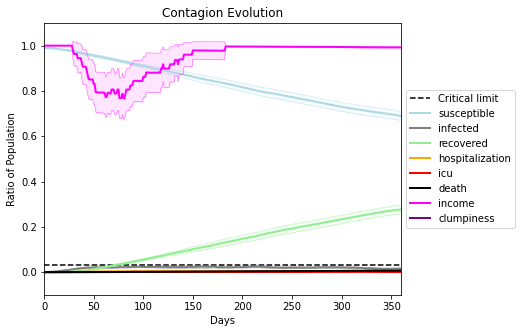

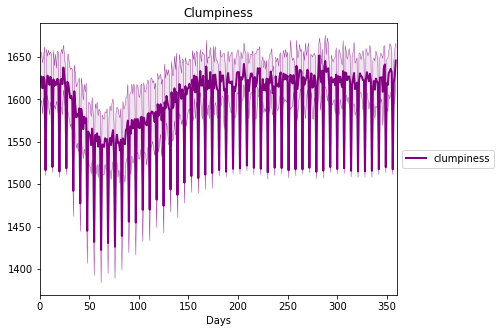

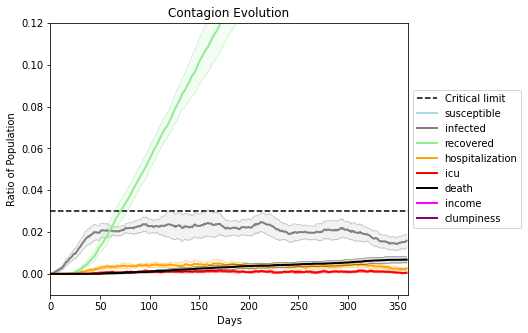

In [4]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1124, 2644, 4879, 3526, 1237, 5457, 1239, 3102, 2725, 2288, 7425, 185, 8375, 4841, 2858, 7278, 2000, 4487, 2232, 7850]
Average similarity between family members is 0.9684045532155295 at temperature -0.999
Average similarity between family and home is 0.9998594863383234 at temperature -1
Average similarity between students and their classroom is 0.9465782004138712 at temperature -0.999
Average classroom occupancy is 1.680722891566265 and number classrooms is 166
Average similarity between workers is 0.9645910281128337 at temperature -0.999
Average office occupancy is 3.492146596858639 and number offices is 191
Average friend similarity for adults: 0.8657082361803576 for kids: 0.7423029721089279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.6610222982130995
avg restaurant similarity 0.75330378263104
avg restaurant similarity 0.5641297541412872
avg restaurant similarity 0.5264574465299444
avg restaurant similarity 0.6260350353838982
avg restaurant similarity 0.6850411221349937
avg restaurant similarity 0.6041604079120549
avg restaurant similarity 0.6580284232645436
avg restaurant similarity 0.6017897875521889
avg restaurant similarity 0.6354210910896494
avg restaurant similarity 0.7152770910190244
avg restaurant similarity 0.5875784001167215
avg restaurant similarity 0.6928343204715518
avg restaurant similarity 0.6943871715786618
avg restaurant similarity 0.7107229281211425
avg restaurant similarity 0.5265883557533595
avg restaurant similarity 0.6386415882872083
avg restaurant similarity 0.759442705805456
avg restaurant similarity 0.6696812273504901
avg restaurant similarity 0.7056834547124539
avg restaurant similarity 0.7603123119793908
avg restaurant similarity 0.7221207071615684
avg restauran

avg restaurant similarity 0.9998020423810653
avg restaurant similarity 0.6320540029699155
avg restaurant similarity 0.6179915787054957
avg restaurant similarity 0.9997544020431407
avg restaurant similarity 0.5739139285988969
avg restaurant similarity 0.6280300059647969
avg restaurant similarity 0.70581724273666
avg restaurant similarity 0.6607144280065699
avg restaurant similarity 0.4658134402983697
avg restaurant similarity 0.655249255123875
avg restaurant similarity 0.7107229281211425
avg restaurant similarity 0.6676086365078736
avg restaurant similarity 0.5921095617514255
avg restaurant similarity 0.7515698942279727
avg restaurant similarity 0.7087951390207575
avg restaurant similarity 0.5067705521855193
avg restaurant similarity 0.6407262189798322
avg restaurant similarity 0.6515054773136602
avg restaurant similarity 0.8012400884816908
avg restaurant similarity 0.6307802916635945
avg restaurant similarity 0.7440872280911089
avg restaurant similarity 0.7338024344316169
avg restauran

Average friend similarity for adults: 0.8646978654758761 for kids: 0.7436584824463705
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.629006623363316
avg restaurant similarity 0.6451389196130566
avg restaurant similarity 0.6255750093909265
avg restaurant similarity 0.5822045693648846
avg restaurant similarity 0.6269959435085357
avg restaurant similarity 0.6435563292714873
avg restaurant similarity 0.5821194407795789
avg restaurant similarity 0.5296993837043933
avg restaurant similarity 0.7165244499543673
avg restaurant similarity 0.5948311273334768
avg restaurant similarity 0.6065801670461568
avg restaurant similarity 0.7595024377596574
avg restaurant similarity 0.6142535485668182
avg restaurant similarity 0.6525417200925315
avg restaurant similarity 0.7850969820826988
avg restaurant similarity 0.6127787838066158
avg restaurant similarity 0.5976712386514316
avg restaurant similarity 0.6200922725073507
avg restaurant similarity 0.6854618567376034
avg restaurant similarity 0.6143012073684885
avg restaurant similarity 0.6407279425535813
avg restaurant similarity 0.7205703546234246
avg restaur

avg restaurant similarity 0.5197674521933542
avg restaurant similarity 0.6404878875115354
avg restaurant similarity 0.685368940734926
avg restaurant similarity 0.7002524578812215
avg restaurant similarity 0.6954810117881455
avg restaurant similarity 0.6649772033923819
avg restaurant similarity 0.6549058909721556
avg restaurant similarity 0.6851404345556055
avg restaurant similarity 0.7051357569748992
avg restaurant similarity 0.6195017638568665
avg restaurant similarity 0.5653030373418989
avg restaurant similarity 0.42251535833787396
avg restaurant similarity 0.7819117673504644
avg restaurant similarity 0.5201228464909708
avg restaurant similarity 0.6145497330732501
avg restaurant similarity 0.5947109336343497
avg restaurant similarity 0.7149652330199634
avg restaurant similarity 0.5992246584949773
avg restaurant similarity 0.617427001995787
avg restaurant similarity 0.608328630402764
avg restaurant similarity 0.689980177277972
avg restaurant similarity 0.6259787491099876
avg restauran

Average similarity between workers is 0.9627501675507699 at temperature -0.999
Average office occupancy is 3.467741935483871 and number offices is 186
Average friend similarity for adults: 0.8608627100991607 for kids: 0.7394732919623228
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.4982649961174093
avg restaurant similarity 0.8327727224461197
avg restaurant similarity 0.6826105648859582
avg restaurant similarity 0.5631763947722683
avg restaurant similarity 0.6261704028311812
avg restaurant similarity 0.6701870259153828
avg restaurant similarity 0.7704388896507163
avg restaurant similarity 0.7040927146658016
avg restaurant similarity 0.5009039334661589
avg restaurant similarity 0.4966186841576597
avg restaurant similarity 0.5326167975977212
avg restaurant similarity 0.6871788928582835
avg restaurant similarity 0.5164299461205853
avg restaurant similarity 0.6483137779565735
avg restaurant similarity 0.6727899645512134
avg restaurant similarity 0.565910555108475
avg restaurant similarity 0.7551114878215405
avg restaurant similarity 0.5098746454720147
avg restaurant similarity 0.3470106925806479
avg restaurant similarity 0.5929509489736736
avg restaurant similarity 0.7811710863820465
avg restaurant similarity 0.764925799960994
avg restaura

avg restaurant similarity 0.8115643183230522
avg restaurant similarity 0.6760160300264042
avg restaurant similarity 0.6311648973129793
avg restaurant similarity 0.5445482110519124
avg restaurant similarity 0.6335377335589114
avg restaurant similarity 0.9997221952081123
avg restaurant similarity 0.7566831498804225
avg restaurant similarity 0.5044270730004295
avg restaurant similarity 0.6169598284216309
avg restaurant similarity 0.586045544382367
avg restaurant similarity 0.680988508483057
avg restaurant similarity 0.5975825142245266
avg restaurant similarity 0.6439662839323613
avg restaurant similarity 0.7761234426817624
avg restaurant similarity 0.6747045270926968
avg restaurant similarity 0.8109443535963164
avg restaurant similarity 0.8502812214333629
avg restaurant similarity 0.6326303519357214
avg restaurant similarity 0.693707848491782
avg restaurant similarity 0.6638826665682975
avg restaurant similarity 0.701848176789855
avg restaurant similarity 0.6922731622365957
avg restaurant

avg restaurant similarity 0.4448514952521805
avg restaurant similarity 0.999820134104798
avg restaurant similarity 0.6651582322891413
avg restaurant similarity 0.6646139390926971
avg restaurant similarity 0.6189220932735379
avg restaurant similarity 0.656471528161331
avg restaurant similarity 0.654451968993305
avg restaurant similarity 0.6416959069109666
avg restaurant similarity 0.6035181241610249
avg restaurant similarity 0.5390316651704717
avg restaurant similarity 0.7361067734936118
avg restaurant similarity 0.6895650876244509
avg restaurant similarity 0.5390316651704717
avg restaurant similarity 0.6272048752549902
avg restaurant similarity 0.7394791213832026
avg restaurant similarity 0.5509579915185978
avg restaurant similarity 0.6549086448416135
avg restaurant similarity 0.6809418951981697
avg restaurant similarity 0.8081677238714737
avg restaurant similarity 0.4995738235558002
avg restaurant similarity 0.7951328060208326
avg restaurant similarity 0.4248621754091131
avg restauran

avg restaurant similarity 0.473952238372145
avg restaurant similarity 0.6975469840606102
avg restaurant similarity 0.5158770740820481
avg restaurant similarity 0.6796463727182476
avg restaurant similarity 0.5267970409334138
avg restaurant similarity 0.769156835142133
avg restaurant similarity 0.7721863318583685
avg restaurant similarity 0.5074176232558723
avg restaurant similarity 0.6379580071353618
avg restaurant similarity 0.6146964937664322
avg restaurant similarity 0.8104129910844955
avg restaurant similarity 0.7249607112031969
avg restaurant similarity 0.6833553497616688
avg restaurant similarity 0.7897676999372772
avg restaurant similarity 0.5846987593932315
avg restaurant similarity 0.5698971195266811
avg restaurant similarity 0.7132307919768296
avg restaurant similarity 0.6565591775127476
avg restaurant similarity 0.6225260695557191
avg restaurant similarity 0.7185184716836492
avg restaurant similarity 0.40071921050836423
avg restaurant similarity 0.734995328748037
avg restaura

avg restaurant similarity 0.7784798023956138
avg restaurant similarity 0.574610838198913
avg restaurant similarity 0.7875460295169286
avg restaurant similarity 0.6685452345982396
avg restaurant similarity 0.6446849642093117
avg restaurant similarity 0.8042479943681102
avg restaurant similarity 0.5725840199972466
avg restaurant similarity 0.4362443458696379
avg restaurant similarity 0.6205502762398978
avg restaurant similarity 0.6747647107490291
avg restaurant similarity 0.6816798535128483
avg restaurant similarity 0.6145516772702149
avg restaurant similarity 0.5895033236090218
avg restaurant similarity 0.7302323009208291
avg restaurant similarity 0.6673448349730007
avg restaurant similarity 0.5630494025499061
avg restaurant similarity 0.6430044527597637
avg restaurant similarity 0.48177413374768513
avg restaurant similarity 0.6904269810349641
avg restaurant similarity 0.684043345305752
avg restaurant similarity 0.6766109297918019
avg restaurant similarity 0.7646207671447574
avg restaur

avg restaurant similarity 0.6829516992339013
avg restaurant similarity 0.4555582717953047
avg restaurant similarity 0.7789256488376869
avg restaurant similarity 0.6547445510201794
avg restaurant similarity 0.6793590370519715
avg restaurant similarity 0.841742422061559
avg restaurant similarity 0.5589036344609465
avg restaurant similarity 0.634863761157925
avg restaurant similarity 0.5616250687925981
avg restaurant similarity 0.5107110914316191
avg restaurant similarity 0.40324195534367724
avg restaurant similarity 0.7061702462236018
avg restaurant similarity 0.5338974252639471
avg restaurant similarity 0.6199413884194307
avg restaurant similarity 0.5406587061648662
avg restaurant similarity 0.8039565161899499
avg restaurant similarity 0.5600751305958382
avg restaurant similarity 0.648014561548847
avg restaurant similarity 0.7716250554286579
avg restaurant similarity 0.7745769347158532
avg restaurant similarity 0.8405660253087242
avg restaurant similarity 0.709831693636312
avg restauran

Average friend similarity for adults: 0.8471009199364441 for kids: 0.7331925267358881
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.6818283697483021
avg restaurant similarity 0.6236829131639207
avg restaurant similarity 0.8401950743178396
avg restaurant similarity 0.7663318158715687
avg restaurant similarity 0.4256999134198547
avg restaurant similarity 0.6922825398808234
avg restaurant similarity 0.7931184686873815
avg restaurant similarity 0.6827878824789815
avg restaurant similarity 0.5947508083333354
avg restaurant similarity 0.630794556553463
avg restaurant similarity 0.48532695539488063
avg restaurant similarity 0.5183530395494098
avg restaurant similarity 0.6242021776685878
avg restaurant similarity 0.6429868629786224
avg restaurant similarity 0.6908544509044591
avg restaurant similarity 0.6763651691241297
avg restaurant similarity 0.8195729775203703
avg restaurant similarity 0.7017605556275338
avg restaurant similarity 0.836100373438636
avg restaurant similarity 0.7144338272786811
avg restaurant similarity 0.5947750818754108
avg restaurant similarity 0.5988242652708776
avg restaur

avg restaurant similarity 0.6904213278487198
avg restaurant similarity 0.7566286311967175
avg restaurant similarity 0.3972598525041231
avg restaurant similarity 0.5694775873435992
avg restaurant similarity 0.8867512372587715
avg restaurant similarity 0.8804512819696311
avg restaurant similarity 0.5033116790647487
avg restaurant similarity 0.44359205045207917
avg restaurant similarity 0.7427886137305881
avg restaurant similarity 0.8519627559772105
avg restaurant similarity 0.6704760137058203
avg restaurant similarity 0.6197749143690563
avg restaurant similarity 0.7072341113086505
avg restaurant similarity 0.5499196116390279
avg restaurant similarity 0.7549133880381443
avg restaurant similarity 0.6584796167784263
avg restaurant similarity 0.4574541632977761
avg restaurant similarity 0.9997570987620185
avg restaurant similarity 0.6083908434726009
avg restaurant similarity 0.9996279809030956
avg restaurant similarity 0.7376674281050315
avg restaurant similarity 0.7657960447257814
avg resta

avg restaurant similarity 0.5649504838409327
avg restaurant similarity 0.5942464597776671
avg restaurant similarity 0.5884097380292249
avg restaurant similarity 0.642210842740205
avg restaurant similarity 0.5686186113794589
avg restaurant similarity 0.6588018226647497
avg restaurant similarity 0.732269005932817
avg restaurant similarity 0.5974994130739175
avg restaurant similarity 0.591762522951571
avg restaurant similarity 0.5935863721805396
avg restaurant similarity 0.6660278297068901
avg restaurant similarity 0.6129025185590328
avg restaurant similarity 0.5944949649917197
avg restaurant similarity 0.6217830248676355
avg restaurant similarity 0.6195990377073076
avg restaurant similarity 0.5469452868077347
avg restaurant similarity 0.24296032458702355
avg restaurant similarity 0.7488220054986607
avg restaurant similarity 0.8664217030167057
avg restaurant similarity 0.5636505007259854
avg restaurant similarity 0.6989648956680794
avg restaurant similarity 0.6864484941137947
avg restaura

avg restaurant similarity 0.6665393627962042
avg restaurant similarity 0.588420647291479
avg restaurant similarity 0.4333689340551513
avg restaurant similarity 0.5984579169254431
avg restaurant similarity 0.6686366083310598
avg restaurant similarity 0.45561477430288344
avg restaurant similarity 0.6315440307153429
avg restaurant similarity 0.6016624649809252
avg restaurant similarity 0.593068614637895
avg restaurant similarity 0.6921590311595833
avg restaurant similarity 0.5999123133700888
avg restaurant similarity 0.5564541677621159
avg restaurant similarity 0.5622394797927749
avg restaurant similarity 0.4472993563832868
avg restaurant similarity 0.6466231488944978
avg restaurant similarity 0.5657115933405492
avg restaurant similarity 0.6870005633758639
avg restaurant similarity 0.583067074952381
avg restaurant similarity 0.6519108500698375
avg restaurant similarity 0.6105373345183318
avg restaurant similarity 0.6554368208908722
avg restaurant similarity 0.7371605379320839
avg restaura

avg restaurant similarity 0.5943918471571725
avg restaurant similarity 0.3254608784924439
avg restaurant similarity 0.3925080802877754
avg restaurant similarity 0.6203717628021218
avg restaurant similarity 0.5630639338196092
avg restaurant similarity 0.6759239128182165
avg restaurant similarity 0.6303577318700864
avg restaurant similarity 0.5099588445550749
avg restaurant similarity 0.523161159533215
avg restaurant similarity 0.5110715381275608
avg restaurant similarity 0.6013469882335526
avg restaurant similarity 0.5670334567343759
avg restaurant similarity 0.4948657475286138
avg restaurant similarity 0.6639606849948154
avg restaurant similarity 0.5967960270691421
avg restaurant similarity 0.5241254894638372
avg restaurant similarity 0.6365207718070393
avg restaurant similarity 0.5147402909447034
avg restaurant similarity 0.6114415609108415
avg restaurant similarity 0.7157269906522009
avg restaurant similarity 0.5589987529072408
avg restaurant similarity 0.4274071941737729
avg restaur

avg restaurant similarity 0.597379379247322
avg restaurant similarity 0.620789356589153
avg restaurant similarity 0.44164329064254143
avg restaurant similarity 0.6571977084440394
avg restaurant similarity 0.44938186151008547
avg restaurant similarity 0.5783313014839192
avg restaurant similarity 0.5877285670170252
avg restaurant similarity 0.4986472761252197
avg restaurant similarity 0.4407782033254809
avg restaurant similarity 0.4754558908192814
avg restaurant similarity 0.7387020710973032
avg restaurant similarity 0.6416692567374743
avg restaurant similarity 0.5845939470181264
avg restaurant similarity 0.6956691098710177
avg restaurant similarity 0.4274518049297373
avg restaurant similarity 0.6382526500510909
avg restaurant similarity 0.5225965392465931
avg restaurant similarity 0.5904378805214416
avg restaurant similarity 0.5291032222682829
avg restaurant similarity 0.45207351783796157
avg restaurant similarity 0.6536871377281316
avg restaurant similarity 0.6111917101822482
avg resta

avg restaurant similarity 0.8121809747062982
avg restaurant similarity 0.5756103059494383
avg restaurant similarity 0.5956681262218761
avg restaurant similarity 0.7554467665060892
avg restaurant similarity 0.5664233503736738
avg restaurant similarity 0.6715312593663288
avg restaurant similarity 0.8547737173218122
avg restaurant similarity 0.7074645668311131
avg restaurant similarity 0.6665307107351188
avg restaurant similarity 0.5396364582158543
avg restaurant similarity 0.3690927263543068
avg restaurant similarity 0.7008298084864842
avg restaurant similarity 0.6706093677539886
avg restaurant similarity 0.6924439931038366
avg restaurant similarity 0.6459521011813808
avg restaurant similarity 0.673317163812524
avg restaurant similarity 0.768271855931939
avg restaurant similarity 0.6401293096145835
avg restaurant similarity 0.5995546447046654
avg restaurant similarity 0.5348961162642882
avg restaurant similarity 0.6639954179945835
avg restaurant similarity 0.78272937225582
avg restaurant

avg restaurant similarity 0.7767742610572294
avg restaurant similarity 0.6947055680834114
avg restaurant similarity 0.8622281026671448
avg restaurant similarity 0.7059962323644681
avg restaurant similarity 0.6557193971799694
avg restaurant similarity 0.7195426755986923
avg restaurant similarity 0.5315480719397091
avg restaurant similarity 0.5144375409139403
avg restaurant similarity 0.5998992711489687
avg restaurant similarity 0.6660816544604525
avg restaurant similarity 0.8289804842093249
avg restaurant similarity 0.6504305119973598
avg restaurant similarity 0.8180759508483764
avg restaurant similarity 0.6865394130898869
avg restaurant similarity 0.7604638964148671
avg restaurant similarity 0.620920067578862
avg restaurant similarity 0.45151504177795937
avg restaurant similarity 0.71833920275827
avg restaurant similarity 0.9178005391907654
avg restaurant similarity 0.32501353839398534
avg restaurant similarity 0.7874703954437842
avg restaurant similarity 0.5743777175312929
avg restaur

avg restaurant similarity 0.7331945470731971
avg restaurant similarity 0.7789801883486555
avg restaurant similarity 0.5982552728697749
avg restaurant similarity 0.6731763179390963
avg restaurant similarity 0.7502991043222643
avg restaurant similarity 0.6314458451000606
avg restaurant similarity 0.8063189942026275
avg restaurant similarity 0.5502150306992055
avg restaurant similarity 0.5487670470674434
avg restaurant similarity 0.9244255065781792
avg restaurant similarity 0.4424481393408012
avg restaurant similarity 0.6115441403705119
avg restaurant similarity 0.5613137857317105
avg restaurant similarity 0.4677043737685823
avg restaurant similarity 0.6218831142203095
avg restaurant similarity 0.5366094330511485
avg restaurant similarity 0.7087129900939378
avg restaurant similarity 0.9597321202326451
avg restaurant similarity 0.999600203507996
avg restaurant similarity 0.7709830187137862
avg restaurant similarity 0.5367140519166824
avg restaurant similarity 0.528973481030421
avg restaura

avg restaurant similarity 0.5895110531189314
avg restaurant similarity 0.634647833100795
avg restaurant similarity 0.42825444318341943
avg restaurant similarity 0.8093852034634699
avg restaurant similarity 0.7177480346732197
avg restaurant similarity 0.8318187925441732
avg restaurant similarity 0.7506608117350017
avg restaurant similarity 0.7110467190257296
avg restaurant similarity 0.6447282611434226
avg restaurant similarity 0.6833069650831459
avg restaurant similarity 0.5447821821439268
avg restaurant similarity 0.5389505138496299
avg restaurant similarity 0.4981601166914371
avg restaurant similarity 0.7516486478452741
avg restaurant similarity 0.8289621982041222
avg restaurant similarity 0.6828028160212011
avg restaurant similarity 0.5792999343735018
avg restaurant similarity 0.5387167947687539
avg restaurant similarity 0.7089564168407387
avg restaurant similarity 0.6724784977197853
avg restaurant similarity 0.7711869230664129
avg restaurant similarity 0.5463150837644273
avg restau

avg restaurant similarity 0.5950213900634038
avg restaurant similarity 0.5676335511399966
avg restaurant similarity 0.6475376185522428
avg restaurant similarity 0.8092662028651746
avg restaurant similarity 0.5286095633145657
avg restaurant similarity 0.6293383269427808
avg restaurant similarity 0.7155423934826882
avg restaurant similarity 0.9247102598886147
avg restaurant similarity 0.5954390949648798
avg restaurant similarity 0.5969271729282302
avg restaurant similarity 0.6076784208076146
avg restaurant similarity 0.6491965742349355
avg restaurant similarity 0.7128779427057874
avg restaurant similarity 0.5203926973798181
avg restaurant similarity 0.6382995460572488
avg restaurant similarity 0.6395364241694587
avg restaurant similarity 0.6263863130093988
avg restaurant similarity 0.7494256257535201
avg restaurant similarity 0.6911097763978279
avg restaurant similarity 0.7229908232764227
avg restaurant similarity 0.6863846840235156
avg restaurant similarity 0.5939504810061734
avg restau

avg restaurant similarity 0.925822002121723
avg restaurant similarity 0.4774540416901698
avg restaurant similarity 0.7512257687279412
avg restaurant similarity 0.4621221950987462
avg restaurant similarity 0.5908647884461228
avg restaurant similarity 0.5090309570933452
avg restaurant similarity 0.5376563881394183
avg restaurant similarity 0.6173718411962353
avg restaurant similarity 0.6965416893223758
avg restaurant similarity 0.7500634304219683
avg restaurant similarity 0.8087174191103268
avg restaurant similarity 0.42843410976466717
avg restaurant similarity 0.5805287736627468
avg restaurant similarity 0.3388136859847826
avg restaurant similarity 0.8453427605203205
avg restaurant similarity 0.6575791602919262
avg restaurant similarity 0.48063740540506555
avg restaurant similarity 0.5511437014727877
avg restaurant similarity 0.8216592994649102
avg restaurant similarity 0.5906342733412481
avg restaurant similarity 0.6392425591206922
avg restaurant similarity 0.8558654245827739
avg resta

avg restaurant similarity 0.6926918814837756
avg restaurant similarity 0.6054858438336771
avg restaurant similarity 0.5215508953979405
avg restaurant similarity 0.6923453786929479
avg restaurant similarity 0.6030524948774201
avg restaurant similarity 0.6837874554526446
avg restaurant similarity 0.6364143732999341
avg restaurant similarity 0.5260441440057855
avg restaurant similarity 0.5959386780400511
avg restaurant similarity 0.675358490186186
avg restaurant similarity 0.649474580768147
avg restaurant similarity 0.6523648120240483
avg restaurant similarity 0.7375585455844117
avg restaurant similarity 0.8843185356424211
avg restaurant similarity 0.4815458718738871
avg restaurant similarity 0.5126724458675588
avg restaurant similarity 0.5799002489341744
avg restaurant similarity 0.6482232841204927
avg restaurant similarity 0.48976129124942674
avg restaurant similarity 0.5317993202107327
avg restaurant similarity 0.4947527322401116
avg restaurant similarity 0.7311660183859605
avg restaur

avg restaurant similarity 0.6015765723544827
avg restaurant similarity 0.6853007874214525
avg restaurant similarity 0.6473530685811256
avg restaurant similarity 0.6728931506977284
avg restaurant similarity 0.6177575397750662
avg restaurant similarity 0.6700739216871826
avg restaurant similarity 0.9434478361163614
avg restaurant similarity 0.6016608353818034
avg restaurant similarity 0.691599807707795
avg restaurant similarity 0.6260014603385825
avg restaurant similarity 0.5988657503386133
avg restaurant similarity 0.6028513560761501
avg restaurant similarity 0.7718510523475456
avg restaurant similarity 0.7231676790809679
avg restaurant similarity 0.6452340243937476
avg restaurant similarity 0.59447694523847
avg restaurant similarity 0.6241686438231536
avg restaurant similarity 0.7584991548080704
avg restaurant similarity 0.7564787651340474
avg restaurant similarity 0.56222037091892
avg restaurant similarity 0.5831178107350988
avg restaurant similarity 0.7299976377024908
avg restaurant 

avg restaurant similarity 0.615015270296838
avg restaurant similarity 0.8575185088280266
avg restaurant similarity 0.4749226164964899
avg restaurant similarity 0.7309805337642832
avg restaurant similarity 0.7242719124688684
avg restaurant similarity 0.683762153428602
avg restaurant similarity 0.7781295420706957
avg restaurant similarity 0.6528996570187877
avg restaurant similarity 0.6292955673268784
avg restaurant similarity 0.7943857059419168
avg restaurant similarity 0.6566155931950189
avg restaurant similarity 0.564899192073832
avg restaurant similarity 0.9716389452173457
avg restaurant similarity 0.627462639966174
avg restaurant similarity 0.6973120129949457
avg restaurant similarity 0.6074854156391281
avg restaurant similarity 0.6713300663920939
avg restaurant similarity 0.6716892532306884
avg restaurant similarity 0.712480776545164
avg restaurant similarity 0.73148853698884
avg restaurant similarity 0.8243391435047278
avg restaurant similarity 0.6253212996129683
avg restaurant si

avg restaurant similarity 0.6502959328517163
avg restaurant similarity 0.740187105680266
avg restaurant similarity 0.571723950652225
avg restaurant similarity 0.5819500836398626
avg restaurant similarity 0.6863227740095788
avg restaurant similarity 0.7250893312524593
avg restaurant similarity 0.6666789880982842
avg restaurant similarity 0.6375162320071183
avg restaurant similarity 0.6663719933489678
avg restaurant similarity 0.6134494421584303
avg restaurant similarity 0.7294213452023938
avg restaurant similarity 0.7194535070016608
avg restaurant similarity 0.7032106566403756
avg restaurant similarity 0.7812498703212449
avg restaurant similarity 0.5986652280414545
avg restaurant similarity 0.5514642703060467
avg restaurant similarity 0.5901654420447187
avg restaurant similarity 0.6569243882491681
avg restaurant similarity 0.6022831934165305
avg restaurant similarity 0.6495965645920571
avg restaurant similarity 0.6645989512837758
avg restaurant similarity 0.6197394165623714
avg restaura

Average similarity between workers is 0.9801882615994637 at temperature -0.999
Average office occupancy is 3.5 and number offices is 184
Average friend similarity for adults: 0.8506209429659333 for kids: 0.7448035800333709
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocat

avg restaurant similarity 0.5827568016871553
avg restaurant similarity 0.8015592121236547
avg restaurant similarity 0.5854569795234487
avg restaurant similarity 0.5693385193331417
avg restaurant similarity 0.6874646280184615
avg restaurant similarity 0.44892478699062494
avg restaurant similarity 0.6436489539638237
avg restaurant similarity 0.5022120327413475
avg restaurant similarity 0.4552542711477057
avg restaurant similarity 0.6428511779299122
avg restaurant similarity 0.43786364198240835
avg restaurant similarity 0.5214469510512981
avg restaurant similarity 0.6006171663871885
avg restaurant similarity 0.5186648549163839
avg restaurant similarity 0.44104620198930633
avg restaurant similarity 0.7545888835414777
avg restaurant similarity 0.5353664002554677
avg restaurant similarity 0.5359724733833559
avg restaurant similarity 0.47997240629836097
avg restaurant similarity 0.7600152619361857
avg restaurant similarity 0.43797072608283305
avg restaurant similarity 0.7416078061325406
avg r

avg restaurant similarity 0.548531410601049
avg restaurant similarity 0.5623938463950251
avg restaurant similarity 0.657093372414136
avg restaurant similarity 0.5554571605840704
avg restaurant similarity 0.7014347270514651
avg restaurant similarity 0.5637301113999703
avg restaurant similarity 0.59665323720399
avg restaurant similarity 0.6488140465672692
avg restaurant similarity 0.5762153676540331
avg restaurant similarity 0.667690456477572
avg restaurant similarity 0.5923236999092722
avg restaurant similarity 0.4312120357641478
avg restaurant similarity 0.6229531960084154
avg restaurant similarity 0.5494382510134986
avg restaurant similarity 0.6820922256969815
avg restaurant similarity 0.6967272968288437
avg restaurant similarity 0.6691884997601539
avg restaurant similarity 0.5855037458865585
avg restaurant similarity 0.4864587159322415
avg restaurant similarity 0.5456327526113588
avg restaurant similarity 0.5301518521870424
avg restaurant similarity 0.6920873183901591
avg restaurant 

avg restaurant similarity 0.5784543838328511
avg restaurant similarity 0.6737294496644535
avg restaurant similarity 0.6217927775207792
avg restaurant similarity 0.46883855688629666
avg restaurant similarity 0.5869186671132132
avg restaurant similarity 0.5644030235676308
avg restaurant similarity 0.4807635644176711
avg restaurant similarity 0.5554166886806171
avg restaurant similarity 0.524407896548234
avg restaurant similarity 0.6114811629558828
avg restaurant similarity 0.7478950043128683
avg restaurant similarity 0.5655157328877191
avg restaurant similarity 0.5523431574220253
avg restaurant similarity 0.6187425432297792
avg restaurant similarity 0.5438584700772545
avg restaurant similarity 0.5650342781120364
avg restaurant similarity 0.47472241062891124
avg restaurant similarity 0.5821973159965849
avg restaurant similarity 0.39643864242045107
avg restaurant similarity 0.6175840910680518
avg restaurant similarity 0.5680625267640681
avg restaurant similarity 0.5426203238121856
avg rest

avg restaurant similarity 0.5133452899100246
avg restaurant similarity 0.6100547258234367
avg restaurant similarity 0.5385451566311807
avg restaurant similarity 0.4885974151518992
avg restaurant similarity 0.5435066215211999
avg restaurant similarity 0.4698598871680277
avg restaurant similarity 0.5533591074518098
avg restaurant similarity 0.5822031771421707
avg restaurant similarity 0.5496327135376546
avg restaurant similarity 0.5591315785048561
avg restaurant similarity 0.5567023477607962
avg restaurant similarity 0.6008362002427224
avg restaurant similarity 0.5238416473389375
avg restaurant similarity 0.4963247749665838
avg restaurant similarity 0.6351155778702825
avg restaurant similarity 0.5335997766684725
avg restaurant similarity 0.5204477731229943
avg restaurant similarity 0.7203377432558086
avg restaurant similarity 0.5283555177770435
avg restaurant similarity 0.6208690798982178
avg restaurant similarity 0.6206345340857551
avg restaurant similarity 0.5502162074939414
avg restau

Average friend similarity for adults: 0.866610626731714 for kids: 0.7365482600095693
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocate

avg restaurant similarity 0.7932555589187376
avg restaurant similarity 0.9797995053420157
avg restaurant similarity 0.816070531339577
avg restaurant similarity 0.7472620049703592
avg restaurant similarity 0.826497686385522
avg restaurant similarity 0.5787356766864086
avg restaurant similarity 0.7224360576651494
avg restaurant similarity 0.614771779979453
avg restaurant similarity 0.8713450466526198
avg restaurant similarity 0.8608503132784225
avg restaurant similarity 0.9138288158246084
avg restaurant similarity 0.6968920792229497
avg restaurant similarity 0.7111890125064269
avg restaurant similarity 0.9377419971592612
avg restaurant similarity 0.7708712060956231
avg restaurant similarity 0.8462224813092648
avg restaurant similarity 0.6372653598970297
avg restaurant similarity 0.703453326049536
avg restaurant similarity 0.9997636687206883
avg restaurant similarity 0.9158522084925464
avg restaurant similarity 0.29631466043493393
avg restaurant similarity 0.7800628333246596
avg restauran

avg restaurant similarity 0.9011770869383388
avg restaurant similarity 0.7242982660567584
avg restaurant similarity 0.7198825345793094
avg restaurant similarity 0.6292238647251921
avg restaurant similarity 0.9342165472302179
avg restaurant similarity 0.6122623214652819
avg restaurant similarity 0.8479040425916275
avg restaurant similarity 0.5851792826937103
avg restaurant similarity 0.6299236334868319
avg restaurant similarity 0.6365283612781104
avg restaurant similarity 0.7222183744021556
avg restaurant similarity 0.8024901765897909
avg restaurant similarity 0.8231849924948704
avg restaurant similarity 0.8695893851065997
avg restaurant similarity 0.7291932923499514
avg restaurant similarity 0.8292926209863146
avg restaurant similarity 0.7567314876283683
avg restaurant similarity 0.8786596245347759
avg restaurant similarity 0.7222974296719219
avg restaurant similarity 0.7167118317274137
avg restaurant similarity 0.6748235349109516
avg restaurant similarity 0.6705877115277848
avg restau

avg restaurant similarity 0.5241147163727821
avg restaurant similarity 0.6416836394764277
avg restaurant similarity 0.6501144388409787
avg restaurant similarity 0.5297253676004968
avg restaurant similarity 0.5736800836927141
avg restaurant similarity 0.6761112236551986
avg restaurant similarity 0.702362908872232
avg restaurant similarity 0.5399595370613555
avg restaurant similarity 0.6712433072152384
avg restaurant similarity 0.8370292602223167
avg restaurant similarity 0.6817551886931962
avg restaurant similarity 0.7147848848827804
avg restaurant similarity 0.6122163872142437
avg restaurant similarity 0.5330782507141069
avg restaurant similarity 0.497354811481914
avg restaurant similarity 0.5743339840405774
avg restaurant similarity 0.7041082510327892
avg restaurant similarity 0.570017205316474
avg restaurant similarity 0.7817065333695472
avg restaurant similarity 0.5831148394837811
avg restaurant similarity 0.7125148549738245
avg restaurant similarity 0.5340947276431594
avg restauran

avg restaurant similarity 0.5976130959655787
avg restaurant similarity 0.5706340297898698
avg restaurant similarity 0.6366629897248506
avg restaurant similarity 0.45946787303308323
avg restaurant similarity 0.6464631616691129
avg restaurant similarity 0.692233865099811
avg restaurant similarity 0.5396329228099634
avg restaurant similarity 0.8431502012766968
avg restaurant similarity 0.707142865914393
avg restaurant similarity 0.628435578756822
avg restaurant similarity 0.5700948115120661
avg restaurant similarity 0.7892286213089491
avg restaurant similarity 0.5228707278084497
avg restaurant similarity 0.743198386857472
avg restaurant similarity 0.4114418084435786
avg restaurant similarity 0.7117416110410087
avg restaurant similarity 0.7414651075515506
avg restaurant similarity 0.7727627467868197
avg restaurant similarity 0.8372934503582368
avg restaurant similarity 0.5467935937930276
avg restaurant similarity 0.6510124817871259
avg restaurant similarity 0.6912497871886977
avg restauran

avg restaurant similarity 0.7135863663470158
avg restaurant similarity 0.6137153160749257
avg restaurant similarity 0.9406246182057596
avg restaurant similarity 0.50196346607567
avg restaurant similarity 0.6235735180620613
avg restaurant similarity 0.5785382201109167
avg restaurant similarity 0.8662853403313399
avg restaurant similarity 0.6230910436948416
avg restaurant similarity 0.7709508368736989
avg restaurant similarity 0.6595646553449904
avg restaurant similarity 0.40532526028611726
avg restaurant similarity 0.6477726701047916
avg restaurant similarity 0.6372752131740627
avg restaurant similarity 0.7007557363396951
avg restaurant similarity 0.8372730873707478
avg restaurant similarity 0.5139580836870821
avg restaurant similarity 0.38171148161708335
avg restaurant similarity 0.4558244441352059
avg restaurant similarity 0.7436163563403592
avg restaurant similarity 0.7889080667750122
avg restaurant similarity 0.7335235366418404
avg restaurant similarity 0.6931756194953678
avg restau

avg restaurant similarity 0.6326943795616907
avg restaurant similarity 0.523750609278641
avg restaurant similarity 0.5873773578323381
avg restaurant similarity 0.8240165808139529
avg restaurant similarity 0.4569680113741481
avg restaurant similarity 0.6421916216378638
avg restaurant similarity 0.77079095081802
avg restaurant similarity 0.4801214211388281
avg restaurant similarity 0.6115645685363741
avg restaurant similarity 0.6955236485325291
avg restaurant similarity 0.7773106238376589
avg restaurant similarity 0.8294767446113209
avg restaurant similarity 0.6292791227858258
avg restaurant similarity 0.7344906168270071
avg restaurant similarity 0.6782970760221683
avg restaurant similarity 0.7237907569007351
avg restaurant similarity 0.6107053151621193
avg restaurant similarity 0.44246986819320555
avg restaurant similarity 0.7176860352907914
avg restaurant similarity 0.5953728719120991
avg restaurant similarity 0.4786220726740582
avg restaurant similarity 0.5046580976285111
avg restaura

avg restaurant similarity 0.7130425411109906
avg restaurant similarity 0.6927204903182251
avg restaurant similarity 0.6776182571827841
avg restaurant similarity 0.44850617134063075
avg restaurant similarity 0.40230770546819117
avg restaurant similarity 0.43798924405416234
avg restaurant similarity 0.8393936628242931
avg restaurant similarity 0.9997938913528279
avg restaurant similarity 0.6349720722434793
avg restaurant similarity 0.5230578026178494
avg restaurant similarity 0.617853753826855
avg restaurant similarity 0.6285222274156999
avg restaurant similarity 0.5839362695018174
avg restaurant similarity 0.7813915548903694
avg restaurant similarity 0.5845051815318107
avg restaurant similarity 0.7480020885622386
avg restaurant similarity 0.7919429641120711
avg restaurant similarity 0.935961200262297
avg restaurant similarity 0.54238633124156
avg restaurant similarity 0.5930034406457745
avg restaurant similarity 0.7241789624818046
avg restaurant similarity 0.5390029150618878
avg restaur

avg restaurant similarity 0.660571028316572
avg restaurant similarity 0.6832112991037338
avg restaurant similarity 0.7063175182246785
avg restaurant similarity 0.6105124441788241
avg restaurant similarity 0.7508091480956182
avg restaurant similarity 0.5025589998679871
avg restaurant similarity 0.5855034940467991
avg restaurant similarity 0.5639792268308876
avg restaurant similarity 0.6097366199153069
avg restaurant similarity 0.6858182880062422
avg restaurant similarity 0.7397175928456166
avg restaurant similarity 0.6821318188353351
avg restaurant similarity 0.5400551145738404
avg restaurant similarity 0.6336112097763982
avg restaurant similarity 0.8016965607922734
avg restaurant similarity 0.6072137238014121
avg restaurant similarity 0.5474246076858653
avg restaurant similarity 0.6808490951907621
avg restaurant similarity 0.6088834672468987
avg restaurant similarity 0.6476383091507034
avg restaurant similarity 0.6764300755213856
avg restaurant similarity 0.7909812257360168
avg restaur

avg restaurant similarity 0.661490372148196
avg restaurant similarity 0.48364623893106806
avg restaurant similarity 0.6911268324792403
avg restaurant similarity 0.49368400135170504
avg restaurant similarity 0.6184961180257608
avg restaurant similarity 0.8110106667727583
avg restaurant similarity 0.8485736639681968
avg restaurant similarity 0.3884812539077058
avg restaurant similarity 0.6171363630811019
avg restaurant similarity 0.5458677965782361
avg restaurant similarity 0.6822055797980568
avg restaurant similarity 0.5290090124500384
avg restaurant similarity 0.5832020716346913
avg restaurant similarity 0.6496888113888257
avg restaurant similarity 0.6466194514140937
avg restaurant similarity 0.5836320837586276
avg restaurant similarity 0.37028140648937974
avg restaurant similarity 0.5462795237694581
avg restaurant similarity 0.5442551833173465
avg restaurant similarity 0.702064999316562
avg restaurant similarity 0.6513183373287542
avg restaurant similarity 0.5655697653985857
avg resta

avg restaurant similarity 0.4945749452835597
avg restaurant similarity 0.7641296646295939
avg restaurant similarity 0.9994747524832497
avg restaurant similarity 0.5036807315856237
avg restaurant similarity 0.5505532102361487
avg restaurant similarity 0.6586691272192545
avg restaurant similarity 0.82323368679057
avg restaurant similarity 0.4285478274065709
avg restaurant similarity 0.5577375227166557
avg restaurant similarity 0.6095570683179947
avg restaurant similarity 0.5059884281600503
avg restaurant similarity 0.6836514461619669
avg restaurant similarity 0.5885499511647627
avg restaurant similarity 0.8967112605414302
avg restaurant similarity 0.5455343085682206
avg restaurant similarity 0.561187244225033
avg restaurant similarity 0.5787470964679391
avg restaurant similarity 0.7270888153155102
avg restaurant similarity 0.7331630713769526
avg restaurant similarity 0.44689511749482386
avg restaurant similarity 0.5333196687917182
avg restaurant similarity 0.7479425918645758
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

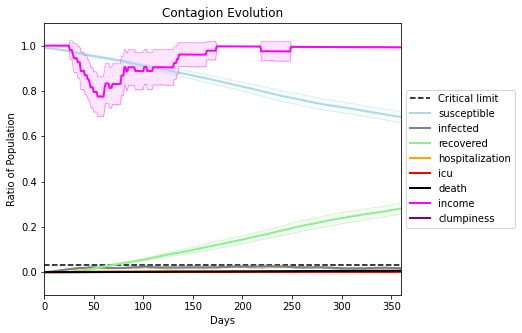

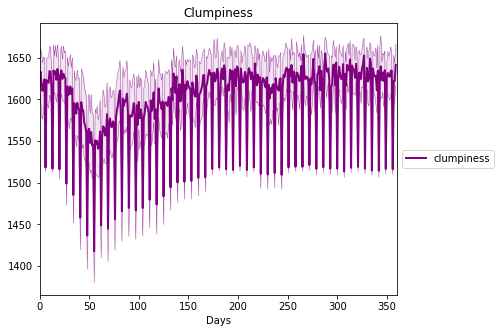

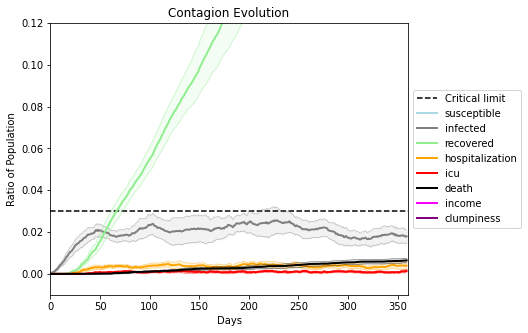

In [5]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.999
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2162, 3544, 123, 4944, 2363, 6933, 473, 4046, 7744, 1000, 1338, 425, 8836, 5306, 3428, 5288, 3419, 8807, 4350, 1205]
Average similarity between family members is 0.9708684423323991 at temperature -0.998
Average similarity between family and home is 0.9998441511791036 at temperature -1
Average similarity between students and their classroom is 0.9530166829322074 at temperature -0.998
Average classroom occupancy is 1.722972972972973 and number classrooms is 148
Average similarity between workers is 0.9502395049786335 at temperature -0.998
Average office occupancy is 3.6989247311827955 and number offices is 186
Average friend similarity for adults: 0.8581821922505153 for kids: 0.7239737098601272
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.6107440926828173
avg restaurant similarity 0.6624856416789754
avg restaurant similarity 0.5586328736513964
avg restaurant similarity 0.6497607892246133
avg restaurant similarity 0.6275918889922779
avg restaurant similarity 0.5285837277098655
avg restaurant similarity 0.5591948651384635
avg restaurant similarity 0.5959604826746645
avg restaurant similarity 0.65268451187021
avg restaurant similarity 0.6890727713237892
avg restaurant similarity 0.56544224335675
avg restaurant similarity 0.6186446441336189
avg restaurant similarity 0.6070635237565805
avg restaurant similarity 0.7867105539866449
avg restaurant similarity 0.6735450994226486
avg restaurant similarity 0.5072503774135827
avg restaurant similarity 0.522165335240839
avg restaurant similarity 0.6847217696979042
avg restaurant similarity 0.7743667867316283
avg restaurant similarity 0.787259080164327
avg restaurant similarity 0.6591067425324845
avg restaurant similarity 0.691315135327244
avg restaurant si

avg restaurant similarity 0.6940388694203291
avg restaurant similarity 0.6429245843000378
avg restaurant similarity 0.5911322252589464
avg restaurant similarity 0.7425807903045644
avg restaurant similarity 0.7108048153622454
avg restaurant similarity 0.5608431621273059
avg restaurant similarity 0.4836722096646507
avg restaurant similarity 0.6162625936183802
avg restaurant similarity 0.4550217812851073
avg restaurant similarity 0.8637446412458489
avg restaurant similarity 0.544819001982045
avg restaurant similarity 0.5136976834941114
avg restaurant similarity 0.5478668943896136
avg restaurant similarity 0.6214241346953162
avg restaurant similarity 0.5189986672226418
avg restaurant similarity 0.8191913571320028
avg restaurant similarity 0.5304451526516987
avg restaurant similarity 0.5905152040946066
avg restaurant similarity 0.5101911668099681
avg restaurant similarity 0.6960217449283747
avg restaurant similarity 0.4592421906762315
avg restaurant similarity 0.7636465736149919
avg restaur

Average similarity between workers is 0.9637479388552805 at temperature -0.998
Average office occupancy is 3.5319148936170213 and number offices is 188
Average friend similarity for adults: 0.8602528712735126 for kids: 0.7126672885157962
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.6278248825893609
avg restaurant similarity 0.708735080516367
avg restaurant similarity 0.6173008675068274
avg restaurant similarity 0.4322793370748217
avg restaurant similarity 0.663664928188429
avg restaurant similarity 0.6522703790050344
avg restaurant similarity 0.7126633127519686
avg restaurant similarity 0.6130165777747942
avg restaurant similarity 0.6877251597006632
avg restaurant similarity 0.5635411829815289
avg restaurant similarity 0.6964184034824682
avg restaurant similarity 0.6560085729892506
avg restaurant similarity 0.598916931871175
avg restaurant similarity 0.568716023365793
avg restaurant similarity 0.6125138024355893
avg restaurant similarity 0.5663095080812468
avg restaurant similarity 0.6030445170474374
avg restaurant similarity 0.6531023313253874
avg restaurant similarity 0.6026128984836109
avg restaurant similarity 0.6450962488194918
avg restaurant similarity 0.5448319434806083
avg restaurant similarity 0.587707378463616
avg restaurant 

avg restaurant similarity 0.71182787154605
avg restaurant similarity 0.5578638716931524
avg restaurant similarity 0.5296397467766825
avg restaurant similarity 0.6163235413319211
avg restaurant similarity 0.5866543421511735
avg restaurant similarity 0.481304283178318
avg restaurant similarity 0.5610708736992346
avg restaurant similarity 0.5703045032944275
avg restaurant similarity 0.45928669967224156
avg restaurant similarity 0.6966629923509682
avg restaurant similarity 0.5300461315502095
avg restaurant similarity 0.7005200235519792
avg restaurant similarity 0.5954665086424913
avg restaurant similarity 0.6799921757999637
avg restaurant similarity 0.7000053326678202
avg restaurant similarity 0.6247774914587515
avg restaurant similarity 0.7214330713842522
avg restaurant similarity 0.5255256008826675
avg restaurant similarity 0.6697303057577038
avg restaurant similarity 0.5754937305093091
avg restaurant similarity 0.5577494497745495
avg restaurant similarity 0.6294123793168364
avg restaura

Average similarity between workers is 0.967793792770921 at temperature -0.998
Average office occupancy is 3.5801104972375692 and number offices is 181
Average friend similarity for adults: 0.8497331954950041 for kids: 0.7455766733412712
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.7067057073246045
avg restaurant similarity 0.5717442822175144
avg restaurant similarity 0.5595990042580495
avg restaurant similarity 0.5934004330687116
avg restaurant similarity 0.8002301521998172
avg restaurant similarity 0.5624869449757818
avg restaurant similarity 0.8130001949354091
avg restaurant similarity 0.48809546800086456
avg restaurant similarity 0.5209211311109037
avg restaurant similarity 0.6185399267630323
avg restaurant similarity 0.7639599024195902
avg restaurant similarity 0.6875599537607037
avg restaurant similarity 0.6340546302597726
avg restaurant similarity 0.6721631526218427
avg restaurant similarity 0.5671025831064015
avg restaurant similarity 0.5818727440957745
avg restaurant similarity 0.7274030252466662
avg restaurant similarity 0.6899866665701246
avg restaurant similarity 0.6642905675010736
avg restaurant similarity 0.5089669098039256
avg restaurant similarity 0.5949137611281858
avg restaurant similarity 0.7092876444246456
avg resta

avg restaurant similarity 0.5694160379375054
avg restaurant similarity 0.6024411833960688
avg restaurant similarity 0.7302545052782339
avg restaurant similarity 0.6773026639476477
avg restaurant similarity 0.6166007504514421
avg restaurant similarity 0.4928564608395039
avg restaurant similarity 0.5505753037449211
avg restaurant similarity 0.60222943437652
avg restaurant similarity 0.6496131890885135
avg restaurant similarity 0.5485546842418262
avg restaurant similarity 0.6813281446244984
avg restaurant similarity 0.6536353481006074
avg restaurant similarity 0.7256037361142778
avg restaurant similarity 0.576583805760674
avg restaurant similarity 0.6363340793392989
avg restaurant similarity 0.5567047782192847
avg restaurant similarity 0.6578116009873755
avg restaurant similarity 0.6360767786854407
avg restaurant similarity 0.5968067023312184
avg restaurant similarity 0.49623685761965364
avg restaurant similarity 0.6374921170960469
avg restaurant similarity 0.542600273377554
avg restauran

Average friend similarity for adults: 0.8481103225843676 for kids: 0.7438540856162883
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.46386062743019013
avg restaurant similarity 0.6577805456443645
avg restaurant similarity 0.5696933904154227
avg restaurant similarity 0.6060314528797162
avg restaurant similarity 0.7148991933868847
avg restaurant similarity 0.512973790095683
avg restaurant similarity 0.6626146288095753
avg restaurant similarity 0.678452713733172
avg restaurant similarity 0.6646221922003652
avg restaurant similarity 0.4467625253804124
avg restaurant similarity 0.5967921825451815
avg restaurant similarity 0.5815194887459288
avg restaurant similarity 0.743170431056475
avg restaurant similarity 0.6165505670478355
avg restaurant similarity 0.5245975878750894
avg restaurant similarity 0.6040391772009986
avg restaurant similarity 0.5598020127350156
avg restaurant similarity 0.6290138349119299
avg restaurant similarity 0.5851891381946321
avg restaurant similarity 0.8152897075106635
avg restaurant similarity 0.8591215821942123
avg restaurant similarity 0.6575818632391097
avg restaura

avg restaurant similarity 0.6210038617937161
avg restaurant similarity 0.20178664913995328
avg restaurant similarity 0.5937622072906866
avg restaurant similarity 0.7908931592446695
avg restaurant similarity 0.830746556215395
avg restaurant similarity 0.6688636375887133
avg restaurant similarity 0.6722110821404236
avg restaurant similarity 0.6048994691298034
avg restaurant similarity 0.5838413522163357
avg restaurant similarity 0.6848666308762326
avg restaurant similarity 0.5216237399213436
avg restaurant similarity 0.9997865972271966
avg restaurant similarity 0.5202580000291253
avg restaurant similarity 0.39805575134609983
avg restaurant similarity 0.6696746042257534
avg restaurant similarity 0.7830666972780146
avg restaurant similarity 0.697881764550641
avg restaurant similarity 0.4337853363516516
avg restaurant similarity 0.5524900220484182
avg restaurant similarity 0.7424216253315559
avg restaurant similarity 0.6732966316001485
avg restaurant similarity 0.7198954811232462
avg restau

Average similarity between workers is 0.9722371273663858 at temperature -0.998
Average office occupancy is 3.510869565217391 and number offices is 184
Average friend similarity for adults: 0.8543234654790749 for kids: 0.7487026916926908
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5323933439884431
avg restaurant similarity 0.5825815222255197
avg restaurant similarity 0.7439004859494108
avg restaurant similarity 0.6857369223210336
avg restaurant similarity 0.7632071242506437
avg restaurant similarity 0.6948448374996912
avg restaurant similarity 0.7289226090168517
avg restaurant similarity 0.7394375320918354
avg restaurant similarity 0.6502835705969706
avg restaurant similarity 0.5881677859606724
avg restaurant similarity 0.4520425125846615
avg restaurant similarity 0.7781441053239734
avg restaurant similarity 0.6173330322007623
avg restaurant similarity 0.5970342710679992
avg restaurant similarity 0.7069740054552651
avg restaurant similarity 0.637622124141598
avg restaurant similarity 0.5751368802832596
avg restaurant similarity 0.7601043571770844
avg restaurant similarity 0.584755895947339
avg restaurant similarity 0.7340576190513537
avg restaurant similarity 0.6421212452321661
avg restaurant similarity 0.6386650138001274
avg restaura

avg restaurant similarity 0.582267340698507
avg restaurant similarity 0.6456392761920682
avg restaurant similarity 0.7804012214170732
avg restaurant similarity 0.6681674175591987
avg restaurant similarity 0.6702205405186148
avg restaurant similarity 0.7147913051479762
avg restaurant similarity 0.6205973396484208
avg restaurant similarity 0.6695327268169082
avg restaurant similarity 0.6340862568263099
avg restaurant similarity 0.611654571537813
avg restaurant similarity 0.4184767236715622
avg restaurant similarity 0.6174252171711083
avg restaurant similarity 0.6337391014521554
avg restaurant similarity 0.7989808584691807
avg restaurant similarity 0.6809281457380206
avg restaurant similarity 0.5816629441871403
avg restaurant similarity 0.5808835625823774
avg restaurant similarity 0.5604005623176854
avg restaurant similarity 0.3383420699790036
avg restaurant similarity 0.8481913248727843
avg restaurant similarity 0.5785497997067239
avg restaurant similarity 0.6065093822278814
avg restaura

Average similarity between workers is 0.9605434667633799 at temperature -0.998
Average office occupancy is 3.5401069518716577 and number offices is 187
Average friend similarity for adults: 0.8578790302125492 for kids: 0.7394403601537933
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.5842858763331282
avg restaurant similarity 0.6243668563636992
avg restaurant similarity 0.6696227081402074
avg restaurant similarity 0.7474187906046008
avg restaurant similarity 0.7740149004651778
avg restaurant similarity 0.7354228717120165
avg restaurant similarity 0.5911828223979902
avg restaurant similarity 0.6891496739704622
avg restaurant similarity 0.5920110448558886
avg restaurant similarity 0.7016184053909013
avg restaurant similarity 0.6854489161535658
avg restaurant similarity 0.8519684191978307
avg restaurant similarity 0.5974154746124568
avg restaurant similarity 0.5030695429097521
avg restaurant similarity 0.6278235310713691
avg restaurant similarity 0.5892154968436426
avg restaurant similarity 0.7089124847594412
avg restaurant similarity 0.6470299904408482
avg restaurant similarity 0.7007554615325641
avg restaurant similarity 0.6693286146404672
avg restaurant similarity 0.6992344484988493
avg restaurant similarity 0.6128572869654535
avg restau

avg restaurant similarity 0.8659438308820215
avg restaurant similarity 0.7446334449327762
avg restaurant similarity 0.6543037582337281
avg restaurant similarity 0.5036297654235786
avg restaurant similarity 0.7882035856178599
avg restaurant similarity 0.6130554099628864
avg restaurant similarity 0.5750929942880637
avg restaurant similarity 0.6865619666566317
avg restaurant similarity 0.7138514650373314
avg restaurant similarity 0.6548165252007764
avg restaurant similarity 0.7285594135818974
avg restaurant similarity 0.5040929494278013
avg restaurant similarity 0.8842451595478786
avg restaurant similarity 0.7089319730660749
avg restaurant similarity 0.7721755976927801
avg restaurant similarity 0.7871013504307403
avg restaurant similarity 0.7237195862118893
avg restaurant similarity 0.730861168167654
avg restaurant similarity 0.5675454648332411
avg restaurant similarity 0.876517028222031
avg restaurant similarity 0.7936857308672962
avg restaurant similarity 0.6465085985370127
avg restaura

Average friend similarity for adults: 0.8565262370956912 for kids: 0.7261133775993863
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.5051548502172489
avg restaurant similarity 0.6831719408060452
avg restaurant similarity 0.5607185412463189
avg restaurant similarity 0.5966111999567482
avg restaurant similarity 0.6755370614005555
avg restaurant similarity 0.6308023288139541
avg restaurant similarity 0.7816510472682099
avg restaurant similarity 0.6635154055020408
avg restaurant similarity 0.6404124728810487
avg restaurant similarity 0.5187448046523445
avg restaurant similarity 0.47375158012719276
avg restaurant similarity 0.6611872926444372
avg restaurant similarity 0.6646113137756107
avg restaurant similarity 0.6074915084941466
avg restaurant similarity 0.9235694181592309
avg restaurant similarity 0.6268182019359034
avg restaurant similarity 0.6495405059539802
avg restaurant similarity 0.6431474914301146
avg restaurant similarity 0.6449676809261734
avg restaurant similarity 0.7670881217923484
avg restaurant similarity 0.6388492258895734
avg restaurant similarity 0.7400670305423243
avg resta

avg restaurant similarity 0.6804566476394098
avg restaurant similarity 0.6466194559754311
avg restaurant similarity 0.5495281236357376
avg restaurant similarity 0.4905972239041818
avg restaurant similarity 0.6442780112452635
avg restaurant similarity 0.5783004390143283
avg restaurant similarity 0.5210667429953595
avg restaurant similarity 0.8412848579324582
avg restaurant similarity 0.5951056676023188
avg restaurant similarity 0.6135182292567414
avg restaurant similarity 0.6003075867305033
avg restaurant similarity 0.45451920733197093
avg restaurant similarity 0.6670325624288396
avg restaurant similarity 0.7444811435867166
avg restaurant similarity 0.8215184386844339
avg restaurant similarity 0.6096659028273208
avg restaurant similarity 0.5961755185621391
avg restaurant similarity 0.5487008136695365
avg restaurant similarity 0.4886257182901774
avg restaurant similarity 0.7865195305629094
avg restaurant similarity 0.5763368183190658
avg restaurant similarity 0.36436002406907303
avg rest

Average similarity between workers is 0.9719493711728221 at temperature -0.998
Average office occupancy is 3.542105263157895 and number offices is 190
Average friend similarity for adults: 0.8685608284100528 for kids: 0.7425633267036064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 pe

avg restaurant similarity 0.5406704530567412
avg restaurant similarity 0.6464233099598031
avg restaurant similarity 0.5894402325278798
avg restaurant similarity 0.6268003244857152
avg restaurant similarity 0.7478246340557485
avg restaurant similarity 0.5761664491285056
avg restaurant similarity 0.603642114181544
avg restaurant similarity 0.6386037132087801
avg restaurant similarity 0.6891525949234839
avg restaurant similarity 0.8552351500258585
avg restaurant similarity 0.7191611443937821
avg restaurant similarity 0.686451668315213
avg restaurant similarity 0.6507612897189228
avg restaurant similarity 0.7425405587992003
avg restaurant similarity 0.721093891585902
avg restaurant similarity 0.7677930675913583
avg restaurant similarity 0.7450843311047255
avg restaurant similarity 0.6093673145071916
avg restaurant similarity 0.706379063529118
avg restaurant similarity 0.700006165987328
avg restaurant similarity 0.5945326988178634
avg restaurant similarity 0.9398430485579193
avg restaurant 

avg restaurant similarity 0.5841954599309996
avg restaurant similarity 0.6372712884115815
avg restaurant similarity 0.7236161030120501
avg restaurant similarity 0.6904030786106523
avg restaurant similarity 0.7317160839978643
avg restaurant similarity 0.5848717590491829
avg restaurant similarity 0.6505409611933639
avg restaurant similarity 0.7234951253846965
avg restaurant similarity 0.6024325849073124
avg restaurant similarity 0.6411636902442323
avg restaurant similarity 0.7254402375472953
avg restaurant similarity 0.5998023165274244
avg restaurant similarity 0.720907139521984
avg restaurant similarity 0.6177430003315921
avg restaurant similarity 0.5399513687500426
avg restaurant similarity 0.8611594740111979
avg restaurant similarity 0.7194510163204425
avg restaurant similarity 0.6336686668779202
avg restaurant similarity 0.7005574633125126
avg restaurant similarity 0.7001705627680099
avg restaurant similarity 0.6748051952682805
avg restaurant similarity 0.7234532644507047
avg restaur

Average similarity between workers is 0.9637171452939702 at temperature -0.998
Average office occupancy is 3.6847826086956523 and number offices is 184
Average friend similarity for adults: 0.8667478614819857 for kids: 0.724877834266095
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5694255792043139
avg restaurant similarity 0.5954127981026115
avg restaurant similarity 0.7463766451225982
avg restaurant similarity 0.6424350734470916
avg restaurant similarity 0.6035130806725998
avg restaurant similarity 0.5719279825682448
avg restaurant similarity 0.5775957997782224
avg restaurant similarity 0.6264349220909682
avg restaurant similarity 0.6698763252739911
avg restaurant similarity 0.6487828589425257
avg restaurant similarity 0.6601670785284811
avg restaurant similarity 0.6831386351001537
avg restaurant similarity 0.7691868420963945
avg restaurant similarity 0.6164146204744011
avg restaurant similarity 0.6452975742553306
avg restaurant similarity 0.5927561611251934
avg restaurant similarity 0.5725776488644498
avg restaurant similarity 0.6169292949532641
avg restaurant similarity 0.6833044173249522
avg restaurant similarity 0.6229760759171727
avg restaurant similarity 0.6495291962774759
avg restaurant similarity 0.6704041520808915
avg restau

avg restaurant similarity 0.5567791394119459
avg restaurant similarity 0.5043582620389429
avg restaurant similarity 0.6327197632646165
avg restaurant similarity 0.47127113689070854
avg restaurant similarity 0.6180744177397721
avg restaurant similarity 0.5940431826784462
avg restaurant similarity 0.614243952616862
avg restaurant similarity 0.5765926501393098
avg restaurant similarity 0.634812253452679
avg restaurant similarity 0.45636376836562176
avg restaurant similarity 0.7601330337348864
avg restaurant similarity 0.560122464105732
avg restaurant similarity 0.7192555444669516
avg restaurant similarity 0.6804062969413026
avg restaurant similarity 0.6961468187982279
avg restaurant similarity 0.6588362329512629
avg restaurant similarity 0.5541508127674268
avg restaurant similarity 0.608845422943827
avg restaurant similarity 0.5419418560118541
avg restaurant similarity 0.6124747207129738
avg restaurant similarity 0.6804752363034784
avg restaurant similarity 0.5829821343700108
avg restaura

Average similarity between workers is 0.9584410609792361 at temperature -0.998
Average office occupancy is 3.5869565217391304 and number offices is 184
Average friend similarity for adults: 0.8581839575116613 for kids: 0.7531196811982981
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5528681398699998
avg restaurant similarity 0.7025079271405948
avg restaurant similarity 0.5487262520840848
avg restaurant similarity 0.6318010447874749
avg restaurant similarity 0.6616152000033333
avg restaurant similarity 0.7135591528266224
avg restaurant similarity 0.6394051492108087
avg restaurant similarity 0.7434847586753384
avg restaurant similarity 0.6777529178611966
avg restaurant similarity 0.7877345587408494
avg restaurant similarity 0.4442226602009622
avg restaurant similarity 0.6331658937741236
avg restaurant similarity 0.6714111005201291
avg restaurant similarity 0.7155970242038514
avg restaurant similarity 0.6436718685276294
avg restaurant similarity 0.5725533806329303
avg restaurant similarity 0.5480632824259667
avg restaurant similarity 0.6875802889074542
avg restaurant similarity 0.6951410814062081
avg restaurant similarity 0.702422855543479
avg restaurant similarity 0.6625922600000242
avg restaurant similarity 0.7132416406192854
avg restaur

avg restaurant similarity 0.644179046622995
avg restaurant similarity 0.6316175802880784
avg restaurant similarity 0.7799417341551765
avg restaurant similarity 0.4835876095888597
avg restaurant similarity 0.5309399580174994
avg restaurant similarity 0.6344733158877429
avg restaurant similarity 0.6926775066229556
avg restaurant similarity 0.8081562860850132
avg restaurant similarity 0.6750884605605587
avg restaurant similarity 0.7759167942470563
avg restaurant similarity 0.7588085511256827
avg restaurant similarity 0.7340954407933795
avg restaurant similarity 0.6337132846145714
avg restaurant similarity 0.5359111563594039
avg restaurant similarity 0.6176751428226259
avg restaurant similarity 0.8419932332317768
avg restaurant similarity 0.5925353021618572
avg restaurant similarity 0.7276151340895401
avg restaurant similarity 0.6963224746559923
avg restaurant similarity 0.7288418679407204
avg restaurant similarity 0.6420684064931003
avg restaurant similarity 0.6481891537264721
avg restaur

Average similarity between workers is 0.9637713881004407 at temperature -0.998
Average office occupancy is 3.5081081081081082 and number offices is 185
Average friend similarity for adults: 0.8554590610933254 for kids: 0.7514188525452549
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.7218006468762622
avg restaurant similarity 0.6853515624797044
avg restaurant similarity 0.7358217310024837
avg restaurant similarity 0.7961052816108563
avg restaurant similarity 0.7028674257552023
avg restaurant similarity 0.6687123711213419
avg restaurant similarity 0.6986866727207252
avg restaurant similarity 0.6674238835504018
avg restaurant similarity 0.8123317525072797
avg restaurant similarity 0.709662000200413
avg restaurant similarity 0.7312346510406392
avg restaurant similarity 0.8245141031616344
avg restaurant similarity 0.6218862729066982
avg restaurant similarity 0.6636664505864489
avg restaurant similarity 0.7609932603748669
avg restaurant similarity 0.7449409648562151
avg restaurant similarity 0.856746853619752
avg restaurant similarity 0.8145191117124445
avg restaurant similarity 0.7054825754054792
avg restaurant similarity 0.6419652672656565
avg restaurant similarity 0.6711402634596272
avg restaurant similarity 0.700850523947457
avg restauran

avg restaurant similarity 0.670411657928131
avg restaurant similarity 0.661999318323986
avg restaurant similarity 0.6936542347974481
avg restaurant similarity 0.7133581306040442
avg restaurant similarity 0.8033109935963402
avg restaurant similarity 0.7233712965767881
avg restaurant similarity 0.7031723973920162
avg restaurant similarity 0.7065606588047579
avg restaurant similarity 0.7012405009441636
avg restaurant similarity 0.748559828619087
avg restaurant similarity 0.7886066415202116
avg restaurant similarity 0.6525217288145414
avg restaurant similarity 0.9492216537679459
avg restaurant similarity 0.6463544540515821
avg restaurant similarity 0.6386112197870782
avg restaurant similarity 0.6860070838221447
avg restaurant similarity 0.6990344182085834
avg restaurant similarity 0.6801716540245675
avg restaurant similarity 0.6923744824700366
avg restaurant similarity 0.7061623944440822
avg restaurant similarity 0.5969187542912633
avg restaurant similarity 0.6827583322794475
avg restauran

Average similarity between workers is 0.9649000462901131 at temperature -0.998
Average office occupancy is 3.5828877005347595 and number offices is 187
Average friend similarity for adults: 0.8504588402121896 for kids: 0.7280682735070169
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6023151097689393
avg restaurant similarity 0.6142280109240716
avg restaurant similarity 0.6551279181901725
avg restaurant similarity 0.5409986505591283
avg restaurant similarity 0.693880076934347
avg restaurant similarity 0.6087541871382636
avg restaurant similarity 0.6199313699237257
avg restaurant similarity 0.6083168069210383
avg restaurant similarity 0.5217143920393789
avg restaurant similarity 0.6084118869633484
avg restaurant similarity 0.7576794101144781
avg restaurant similarity 0.6336798194150115
avg restaurant similarity 0.5239727138183043
avg restaurant similarity 0.5890642843702573
avg restaurant similarity 0.6473084362353679
avg restaurant similarity 0.5519772786148006
avg restaurant similarity 0.6171345223123347
avg restaurant similarity 0.49977075275791316
avg restaurant similarity 0.5940883998367025
avg restaurant similarity 0.4580349578246866
avg restaurant similarity 0.5678978817432848
avg restaurant similarity 0.5650987576514599
avg restau

avg restaurant similarity 0.5943181706767888
avg restaurant similarity 0.6500260692461538
avg restaurant similarity 0.6225591787330067
avg restaurant similarity 0.7686117613081745
avg restaurant similarity 0.5956526360573126
avg restaurant similarity 0.5892964856935312
avg restaurant similarity 0.6976988703139684
avg restaurant similarity 0.6527923418416072
avg restaurant similarity 0.5183166077892319
avg restaurant similarity 0.570393198101711
avg restaurant similarity 0.5316395223325873
avg restaurant similarity 0.6688838687767525
avg restaurant similarity 0.5602044868089144
avg restaurant similarity 0.5911657496988141
avg restaurant similarity 0.5574636281744381
avg restaurant similarity 0.6134852459631822
avg restaurant similarity 0.5113747238235614
avg restaurant similarity 0.6090540030986562
avg restaurant similarity 0.4595885034317755
avg restaurant similarity 0.5834076793833138
avg restaurant similarity 0.671876287882134
avg restaurant similarity 0.5794729738990463
avg restaura

Average similarity between workers is 0.9601414654745726 at temperature -0.998
Average office occupancy is 3.685082872928177 and number offices is 181
Average friend similarity for adults: 0.8676156824515084 for kids: 0.7401748013717854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.6675699200996776
avg restaurant similarity 0.6972550492812454
avg restaurant similarity 0.7237312832607705
avg restaurant similarity 0.6073413280790251
avg restaurant similarity 0.7537222670631063
avg restaurant similarity 0.5722066242722819
avg restaurant similarity 0.45291633245625396
avg restaurant similarity 0.6746716305188938
avg restaurant similarity 0.6825108700278747
avg restaurant similarity 0.6603760324312833
avg restaurant similarity 0.6290503633271991
avg restaurant similarity 0.8058241744099109
avg restaurant similarity 0.562281564673099
avg restaurant similarity 0.5316521529159327
avg restaurant similarity 0.6480878854590324
avg restaurant similarity 0.7455263425462031
avg restaurant similarity 0.6609196749889502
avg restaurant similarity 0.6415023052042186
avg restaurant similarity 0.616399401198552
avg restaurant similarity 0.6380339510419801
avg restaurant similarity 0.5896772417127661
avg restaurant similarity 0.6996955796575719
avg restaur

avg restaurant similarity 0.7266742167329461
avg restaurant similarity 0.6337090293012582
avg restaurant similarity 0.6501383675966189
avg restaurant similarity 0.6820407891024993
avg restaurant similarity 0.6652465923110112
avg restaurant similarity 0.6723491631165762
avg restaurant similarity 0.5975640211842798
avg restaurant similarity 0.5773961301424975
avg restaurant similarity 0.7279493803796026
avg restaurant similarity 0.7463808077740044
avg restaurant similarity 0.6632316260573935
avg restaurant similarity 0.5735942520100109
avg restaurant similarity 0.6068997300344825
avg restaurant similarity 0.750495309552982
avg restaurant similarity 0.6165693838746377
avg restaurant similarity 0.7023637168653047
avg restaurant similarity 0.6304781285692576
avg restaurant similarity 0.6741364697409952
avg restaurant similarity 0.8151630359539866
avg restaurant similarity 0.7197263794297152
avg restaurant similarity 0.796160068524574
avg restaurant similarity 0.4721179088923244
avg restaura

avg restaurant similarity 0.6148181763533171
avg restaurant similarity 0.5872782375431006
avg restaurant similarity 0.572087507429275
avg restaurant similarity 0.8656750276139535
avg restaurant similarity 0.6805213939593958
avg restaurant similarity 0.6641391866130153
avg restaurant similarity 0.6713995726732283
avg restaurant similarity 0.6307453523312748
avg restaurant similarity 0.46662662742310085
avg restaurant similarity 0.7042102126400999
avg restaurant similarity 0.6559029571389953
avg restaurant similarity 0.6812707024202282
avg restaurant similarity 0.7003091013649146
avg restaurant similarity 0.610882858722711
avg restaurant similarity 0.5638943099334924
avg restaurant similarity 0.5491391580976462
avg restaurant similarity 0.6484306618352937
avg restaurant similarity 0.6246277290089396
avg restaurant similarity 0.778937587693442
avg restaurant similarity 0.5909547013050187
avg restaurant similarity 0.7789270421094436
avg restaurant similarity 0.6471657820627348
avg restaura

avg restaurant similarity 0.6857609360385676
avg restaurant similarity 0.5533601983563136
avg restaurant similarity 0.6043034013026009
avg restaurant similarity 0.6119240391255091
avg restaurant similarity 0.518015833018338
avg restaurant similarity 0.7064716038186843
avg restaurant similarity 0.6884402453339078
avg restaurant similarity 0.5336819459680687
avg restaurant similarity 0.7269771843833809
avg restaurant similarity 0.5485854191042628
avg restaurant similarity 0.692537602027715
avg restaurant similarity 0.591464287137495
avg restaurant similarity 0.6231905533468677
avg restaurant similarity 0.6385360151926073
avg restaurant similarity 0.4699407888028375
avg restaurant similarity 0.5776464744596738
avg restaurant similarity 0.6309963265758064
avg restaurant similarity 0.6968151136277491
avg restaurant similarity 0.5256454194205786
avg restaurant similarity 0.6142887412408267
avg restaurant similarity 0.49187016883197965
avg restaurant similarity 0.5312956319150024
avg restaura

Average friend similarity for adults: 0.8639261111781749 for kids: 0.7455627495115972
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.5271678392223181
avg restaurant similarity 0.8794973140436948
avg restaurant similarity 0.6367056129700781
avg restaurant similarity 0.6074629535384106
avg restaurant similarity 0.5049266831844
avg restaurant similarity 0.7210758201734858
avg restaurant similarity 0.7066570475898821
avg restaurant similarity 0.5875132558968564
avg restaurant similarity 0.6021186931979844
avg restaurant similarity 0.5288006502916712
avg restaurant similarity 0.7343803812392652
avg restaurant similarity 0.573728227282638
avg restaurant similarity 0.7462751528820525
avg restaurant similarity 0.6913206940631698
avg restaurant similarity 0.8283166825286014
avg restaurant similarity 0.7530570276382728
avg restaurant similarity 0.6266098251167551
avg restaurant similarity 0.686951198450085
avg restaurant similarity 0.6052536552352247
avg restaurant similarity 0.6910854702142206
avg restaurant similarity 0.6209820753440088
avg restaurant similarity 0.6396174185291215
avg restaurant 

avg restaurant similarity 0.9997696655117454
avg restaurant similarity 0.6546996625673457
avg restaurant similarity 0.621201853567665
avg restaurant similarity 0.6702104601779341
avg restaurant similarity 0.4413407583908101
avg restaurant similarity 0.7346637387014846
avg restaurant similarity 0.953174916165315
avg restaurant similarity 0.6706507309113839
avg restaurant similarity 0.7983672984905209
avg restaurant similarity 0.692053123020673
avg restaurant similarity 0.6829731720995289
avg restaurant similarity 0.5788760973760859
avg restaurant similarity 0.6038518847974503
avg restaurant similarity 0.8431511469802999
avg restaurant similarity 0.5139890297867171
avg restaurant similarity 0.48428446650439644
avg restaurant similarity 0.7521970844663483
avg restaurant similarity 0.6671015566249754
avg restaurant similarity 0.5901688989669458
avg restaurant similarity 0.7470504380451306
avg restaurant similarity 0.8384781630463277
avg restaurant similarity 0.5264333082830481
avg restaura

avg restaurant similarity 0.4769912143329165
avg restaurant similarity 0.6767995304537967
avg restaurant similarity 0.5649434402747406
avg restaurant similarity 0.8072679816982813
avg restaurant similarity 0.6450584850523873
avg restaurant similarity 0.7306063693203673
avg restaurant similarity 0.6572908575685662
avg restaurant similarity 0.9997354896310804
avg restaurant similarity 0.47123576892720487
avg restaurant similarity 0.8607179248714678
avg restaurant similarity 0.6727647335738373
avg restaurant similarity 0.5209743240596146
avg restaurant similarity 0.5456205898442916
avg restaurant similarity 0.49556606300507566
avg restaurant similarity 0.804446224317354
avg restaurant similarity 0.6309826242700042
avg restaurant similarity 0.6631584152944111
avg restaurant similarity 0.7855346750009778
avg restaurant similarity 0.460996610079371
avg restaurant similarity 0.5356336159753464
avg restaurant similarity 0.4025938081150789
avg restaurant similarity 0.5386414449152894
avg restau

avg restaurant similarity 0.710514182241377
avg restaurant similarity 0.5428608541186071
avg restaurant similarity 0.5839563444720118
avg restaurant similarity 0.5086326487017372
avg restaurant similarity 0.4430593884092944
avg restaurant similarity 0.5157989718692325
avg restaurant similarity 0.4503994288950664
avg restaurant similarity 0.6809745001998118
avg restaurant similarity 0.6673308748715137
avg restaurant similarity 0.5864300460213846
avg restaurant similarity 0.5807019697800841
avg restaurant similarity 0.674752248623177
avg restaurant similarity 0.56581707429281
avg restaurant similarity 0.6699691010230034
avg restaurant similarity 0.41656340477575776
avg restaurant similarity 0.6375455400886174
avg restaurant similarity 0.7671070520676871
avg restaurant similarity 0.6169944543398285
avg restaurant similarity 0.45335989738217464
avg restaurant similarity 0.7071382367291316
avg restaurant similarity 0.5005127608448585
avg restaurant similarity 0.5762949445632466
avg restaura

avg restaurant similarity 0.642599650379974
avg restaurant similarity 0.7350593832146943
avg restaurant similarity 0.5835926024581033
avg restaurant similarity 0.6390623859982922
avg restaurant similarity 0.612175511856367
avg restaurant similarity 0.8669471945485894
avg restaurant similarity 0.7560773802483826
avg restaurant similarity 0.7149532562636396
avg restaurant similarity 0.5747524700884139
avg restaurant similarity 0.6849628520082903
avg restaurant similarity 0.7692209890327834
avg restaurant similarity 0.5467560247612568
avg restaurant similarity 0.7902855403113811
avg restaurant similarity 0.5906793463123357
avg restaurant similarity 0.7025616843593809
avg restaurant similarity 0.7037603100021612
avg restaurant similarity 0.6184687457322698
avg restaurant similarity 0.5784663543595318
avg restaurant similarity 0.6522218869160945
avg restaurant similarity 0.6980355680386787
avg restaurant similarity 0.5835410252824181
avg restaurant similarity 0.7193152459222764
avg restaura

avg restaurant similarity 0.606813854742186
avg restaurant similarity 0.7699383013957347
avg restaurant similarity 0.7455281431576147
avg restaurant similarity 0.6648487147333743
avg restaurant similarity 0.535116736728535
avg restaurant similarity 0.6873232875941548
avg restaurant similarity 0.6385694181361241
avg restaurant similarity 0.5566003385365426
avg restaurant similarity 0.6324619171383341
avg restaurant similarity 0.593120127784595
avg restaurant similarity 0.7936975854664028
avg restaurant similarity 0.6968532842467697
avg restaurant similarity 0.5396940419642106
avg restaurant similarity 0.6270501364326773
avg restaurant similarity 0.6489914513267939
avg restaurant similarity 0.7008766612736819
avg restaurant similarity 0.6867321801232874
avg restaurant similarity 0.7157103240389765
avg restaurant similarity 0.7969689791653402
avg restaurant similarity 0.4942591191082489
avg restaurant similarity 0.6411938571993717
avg restaurant similarity 0.6891009357125651
avg restauran

Average similarity between workers is 0.9683059336423833 at temperature -0.998
Average office occupancy is 3.494565217391304 and number offices is 184
Average friend similarity for adults: 0.8647482279350271 for kids: 0.7593697551453027
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.7160021307597313
avg restaurant similarity 0.6749979941890107
avg restaurant similarity 0.7124245198661298
avg restaurant similarity 0.6795286632050036
avg restaurant similarity 0.8661555435874149
avg restaurant similarity 0.6777986275121199
avg restaurant similarity 0.7997508492410402
avg restaurant similarity 0.7516063383559923
avg restaurant similarity 0.7678821613016916
avg restaurant similarity 0.65940896550103
avg restaurant similarity 0.8056824837493954
avg restaurant similarity 0.7847036337604009
avg restaurant similarity 0.6699852172810525
avg restaurant similarity 0.6139039243886195
avg restaurant similarity 0.7568706822141625
avg restaurant similarity 0.8043281482763713
avg restaurant similarity 0.5922208794352757
avg restaurant similarity 0.6131791294962221
avg restaurant similarity 0.7398244520368592
avg restaurant similarity 0.6194791257856834
avg restaurant similarity 0.6640621792619473
avg restaurant similarity 0.6560562817634141
avg restaura

avg restaurant similarity 0.6666269501927925
avg restaurant similarity 0.8240681237496429
avg restaurant similarity 0.7388850060906292
avg restaurant similarity 0.7917925977364968
avg restaurant similarity 0.8305733483177641
avg restaurant similarity 0.6615770920739577
avg restaurant similarity 0.6582140414106082
avg restaurant similarity 0.7542090905859534
avg restaurant similarity 0.687233706579149
avg restaurant similarity 0.6060178157085664
avg restaurant similarity 0.6160440324757943
avg restaurant similarity 0.6039908835312187
avg restaurant similarity 0.6589146538666544
avg restaurant similarity 0.734082791203545
avg restaurant similarity 0.5621902999684552
avg restaurant similarity 0.7486909443286967
avg restaurant similarity 0.7427212919750191
avg restaurant similarity 0.7721899494550493
avg restaurant similarity 0.7724555053298099
avg restaurant similarity 0.6033636373246114
avg restaurant similarity 0.8379072720503937
avg restaurant similarity 0.7116917318372916
avg restaura

avg restaurant similarity 0.7260525130894159
avg restaurant similarity 0.6658012282764415
avg restaurant similarity 0.7024759467403418
avg restaurant similarity 0.8030410973805234
avg restaurant similarity 0.7052889120313895
avg restaurant similarity 0.8568782670012689
avg restaurant similarity 0.7960538069267494
avg restaurant similarity 0.7952926949853634
avg restaurant similarity 0.795335648402271
avg restaurant similarity 0.842228410928972
avg restaurant similarity 0.580135959567976
avg restaurant similarity 0.4515377175451976
avg restaurant similarity 0.8464173211985953
avg restaurant similarity 0.7198961573799171
avg restaurant similarity 0.809196689086345
avg restaurant similarity 0.8264775591315427
avg restaurant similarity 0.7488169711167623
avg restaurant similarity 0.7152154466695986
avg restaurant similarity 0.7538077508366365
avg restaurant similarity 0.7862855983948657
avg restaurant similarity 0.579747513989554
avg restaurant similarity 0.8020397923709435
avg restaurant 

avg restaurant similarity 0.9998664316511119
avg restaurant similarity 0.6263646041489042
avg restaurant similarity 0.9996692158024207
avg restaurant similarity 0.7344723551635732
avg restaurant similarity 0.544016306489457
avg restaurant similarity 0.5232151970667374
avg restaurant similarity 0.9998658814456116
avg restaurant similarity 0.3607994462992624
avg restaurant similarity 0.844657477558821
avg restaurant similarity 0.8853928441510969
avg restaurant similarity 0.8047534775211036
avg restaurant similarity 0.5801634581675152
avg restaurant similarity 0.6378865568271577
avg restaurant similarity 0.7054081783083327
avg restaurant similarity 0.8894025954052136
avg restaurant similarity 0.6641264060369805
avg restaurant similarity 0.8045935605800083
avg restaurant similarity 0.6398983705474485
avg restaurant similarity 0.9028568031869244
avg restaurant similarity 0.834753106458165
avg restaurant similarity 0.9467568724728215
avg restaurant similarity 0.9997439170893078
avg restauran

avg restaurant similarity 0.6658051269782381
avg restaurant similarity 0.5396626809867674
avg restaurant similarity 0.6580200606337631
avg restaurant similarity 0.6535469657128442
avg restaurant similarity 0.6592269752854555
avg restaurant similarity 0.6910371849271593
avg restaurant similarity 0.6074804809942661
avg restaurant similarity 0.6422695498996929
avg restaurant similarity 0.7641266213477833
avg restaurant similarity 0.610785714272089
avg restaurant similarity 0.7508905398129915
avg restaurant similarity 0.5736663030284436
avg restaurant similarity 0.6476580813408005
avg restaurant similarity 0.7429038363140569
avg restaurant similarity 0.8245927636013916
avg restaurant similarity 0.7337034250987142
avg restaurant similarity 0.6891570995793187
avg restaurant similarity 0.6850201604751464
avg restaurant similarity 0.5804435019014187
avg restaurant similarity 0.6407745121638836
avg restaurant similarity 0.6990773240935506
avg restaurant similarity 0.7532624620750727
avg restaur

avg restaurant similarity 0.8374096884483389
avg restaurant similarity 0.6960314167873115
avg restaurant similarity 0.6905642252605249
avg restaurant similarity 0.6527594038723952
avg restaurant similarity 0.784880164326438
avg restaurant similarity 0.6536255697654527
avg restaurant similarity 0.89840139951736
avg restaurant similarity 0.6414043059448102
avg restaurant similarity 0.7892612574258797
avg restaurant similarity 0.6830056271993264
avg restaurant similarity 0.6000509984315899
avg restaurant similarity 0.7242076750842212
avg restaurant similarity 0.6627156276514634
avg restaurant similarity 0.5972246494490006
avg restaurant similarity 0.5203081991864491
avg restaurant similarity 0.7456874250696317
avg restaurant similarity 0.8209035861411179
avg restaurant similarity 0.6115957320851984
avg restaurant similarity 0.6566886570986442
avg restaurant similarity 0.6333712731328639
avg restaurant similarity 0.6404891934903911
avg restaurant similarity 0.6391557458452584
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

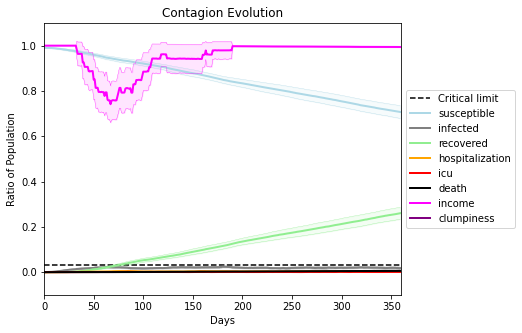

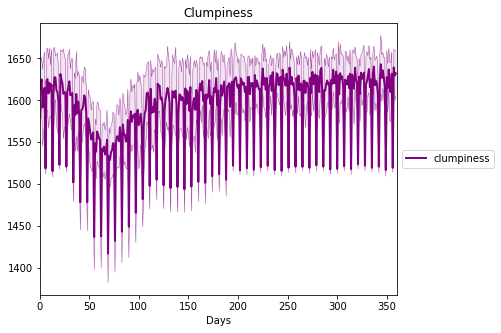

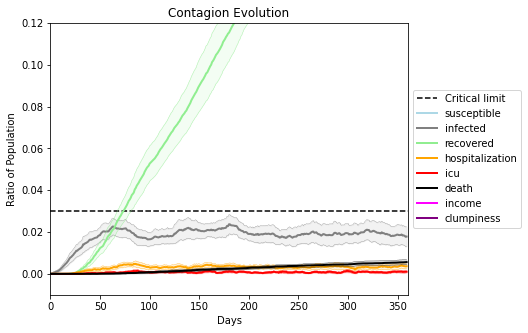

In [6]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.998
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3367, 241, 2040, 6756, 6836, 5247, 5097, 8915, 2903, 1704, 6956, 6012, 7914, 3353, 5583, 3206, 1092, 9819, 4156, 6867]
Average similarity between family members is 0.9564947427579508 at temperature -0.9975
Average similarity between family and home is 0.9998495698955131 at temperature -1
Average similarity between students and their classroom is 0.9465155716266633 at temperature -0.9975
Average classroom occupancy is 1.5491329479768785 and number classrooms is 173
Average similarity between workers is 0.9383223498590758 at temperature -0.9975
Average office occupancy is 3.4111675126903553 and number offices is 197
Average friend similarity for adults: 0.8681901114904851 for kids: 0.7301086728062116
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.5283794759605897
avg restaurant similarity 0.5575301027848738
avg restaurant similarity 0.37150706897266406
avg restaurant similarity 0.5701691179065496
avg restaurant similarity 0.44905989513433975
avg restaurant similarity 0.6043907970319616
avg restaurant similarity 0.6650216994624887
avg restaurant similarity 0.7384503637335097
avg restaurant similarity 0.6904737346977677
avg restaurant similarity 0.5574616173760979
avg restaurant similarity 0.360125300118119
avg restaurant similarity 0.5885579238795009
avg restaurant similarity 0.49278437770535605
avg restaurant similarity 0.6259460588488897
avg restaurant similarity 0.6486125284636114
avg restaurant similarity 0.5103513453085701
avg restaurant similarity 0.45578328177186267
avg restaurant similarity 0.5350246955616185
avg restaurant similarity 0.4854643927671747
avg restaurant similarity 0.6691354442584467
avg restaurant similarity 0.4422963216385206
avg restaurant similarity 0.5954454061813197
avg res

avg restaurant similarity 0.5171815693577592
avg restaurant similarity 0.6119081745376135
avg restaurant similarity 0.4984361338192982
avg restaurant similarity 0.5438952712367503
avg restaurant similarity 0.4557066746903617
avg restaurant similarity 0.7030095674162301
avg restaurant similarity 0.5018734485034462
avg restaurant similarity 0.6515015894397578
avg restaurant similarity 0.37915348904188695
avg restaurant similarity 0.5722504584255758
avg restaurant similarity 0.636116063032008
avg restaurant similarity 0.6665129120242279
avg restaurant similarity 0.5579304460782183
avg restaurant similarity 0.5771104918407539
avg restaurant similarity 0.5904156312544309
avg restaurant similarity 0.8579162227066865
avg restaurant similarity 0.5854341319392876
avg restaurant similarity 0.5537198617675165
avg restaurant similarity 0.6873125744584387
avg restaurant similarity 0.7009489545043716
avg restaurant similarity 0.5509052754965419
avg restaurant similarity 0.8426407454199938
avg restau

Average friend similarity for adults: 0.863531569866476 for kids: 0.719832570683107
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.6970395248008339
avg restaurant similarity 0.5860135154490975
avg restaurant similarity 0.6398751245754125
avg restaurant similarity 0.6788800028586027
avg restaurant similarity 0.5975152566568354
avg restaurant similarity 0.7411265876837718
avg restaurant similarity 0.4429466017636237
avg restaurant similarity 0.5711013177160327
avg restaurant similarity 0.5655862309615287
avg restaurant similarity 0.6366583332644882
avg restaurant similarity 0.7446366101463701
avg restaurant similarity 0.6945365355912099
avg restaurant similarity 0.5973984149225423
avg restaurant similarity 0.7023549392171298
avg restaurant similarity 0.6126990214517661
avg restaurant similarity 0.6451995242109448
avg restaurant similarity 0.6001080897695101
avg restaurant similarity 0.6957425537163813
avg restaurant similarity 0.6199570847155543
avg restaurant similarity 0.77455826194443
avg restaurant similarity 0.7019058715620055
avg restaurant similarity 0.6407870685421904
avg restaura

avg restaurant similarity 0.7127546944321326
avg restaurant similarity 0.6367166382821394
avg restaurant similarity 0.6797009399001358
avg restaurant similarity 0.5850619675710084
avg restaurant similarity 0.6193137438005664
avg restaurant similarity 0.5972976985965047
avg restaurant similarity 0.627016081001492
avg restaurant similarity 0.6457059507402333
avg restaurant similarity 0.6127528630651697
avg restaurant similarity 0.735973561867749
avg restaurant similarity 0.6140581096435694
avg restaurant similarity 0.6234442930454415
avg restaurant similarity 0.5806535521756531
avg restaurant similarity 0.6333121982064461
avg restaurant similarity 0.521308176619218
avg restaurant similarity 0.49639410073003776
avg restaurant similarity 0.6538076078705318
avg restaurant similarity 0.5313580228029517
avg restaurant similarity 0.6538711573164903
avg restaurant similarity 0.680139400383905
avg restaurant similarity 0.5727750537425901
avg restaurant similarity 0.8246640815574398
avg restauran

Average similarity between workers is 0.9441496031815154 at temperature -0.9975
Average office occupancy is 3.3636363636363638 and number offices is 187
Average friend similarity for adults: 0.8518017137185491 for kids: 0.7545710379045596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total o

avg restaurant similarity 0.5925391744393734
avg restaurant similarity 0.7488975251413861
avg restaurant similarity 0.5272268851836848
avg restaurant similarity 0.5662909364959429
avg restaurant similarity 0.5473245919481974
avg restaurant similarity 0.5453788120737368
avg restaurant similarity 0.6561364040516389
avg restaurant similarity 0.6696575741703158
avg restaurant similarity 0.534327863966868
avg restaurant similarity 0.7151435396754671
avg restaurant similarity 0.6836543721105899
avg restaurant similarity 0.6401622794382519
avg restaurant similarity 0.5643870323371829
avg restaurant similarity 0.5511902487984282
avg restaurant similarity 0.5070685730594268
avg restaurant similarity 0.5511661340490878
avg restaurant similarity 0.6688800389862979
avg restaurant similarity 0.6638326025491917
avg restaurant similarity 0.7590572036937169
avg restaurant similarity 0.7436068582362113
avg restaurant similarity 0.37962093035809263
avg restaurant similarity 0.5578934467601856
avg restau

avg restaurant similarity 0.687970095881123
avg restaurant similarity 0.789756275071981
avg restaurant similarity 0.5965241312596279
avg restaurant similarity 0.6518704586096224
avg restaurant similarity 0.5889383833611644
avg restaurant similarity 0.7297850821732854
avg restaurant similarity 0.5152462924205861
avg restaurant similarity 0.7520107255442594
avg restaurant similarity 0.5465571450721927
avg restaurant similarity 0.6177887553486519
avg restaurant similarity 0.7254583061688752
avg restaurant similarity 0.6650248662331573
avg restaurant similarity 0.6359751487506459
avg restaurant similarity 0.7225532467120557
avg restaurant similarity 0.6231332949956109
avg restaurant similarity 0.6205173571877995
avg restaurant similarity 0.49782348739344523
avg restaurant similarity 0.6856282719317354
avg restaurant similarity 0.9563108901231709
avg restaurant similarity 0.701737290499185
avg restaurant similarity 0.6883044612029428
avg restaurant similarity 0.4222350673570856
avg restaura

avg restaurant similarity 0.7032924430793951
avg restaurant similarity 0.6039977473631296
avg restaurant similarity 0.9493198643062043
avg restaurant similarity 0.7109484061264096
avg restaurant similarity 0.770776266349334
avg restaurant similarity 0.628189949408559
avg restaurant similarity 0.82027354988198
avg restaurant similarity 0.5920766282373927
avg restaurant similarity 0.7253324082950315
avg restaurant similarity 0.4614548057428922
avg restaurant similarity 0.34562710406387
avg restaurant similarity 0.542446273778277
avg restaurant similarity 0.6678679731151789
avg restaurant similarity 0.7215933112789055
avg restaurant similarity 0.6544421747561523
avg restaurant similarity 0.7443081601800903
avg restaurant similarity 0.7506860799728955
avg restaurant similarity 0.5155858454108523
avg restaurant similarity 0.5829298857661241
avg restaurant similarity 0.499119836887501
avg restaurant similarity 0.6711117366077093
avg restaurant similarity 0.9997438254192375
avg restaurant sim

avg restaurant similarity 0.6047097666960752
avg restaurant similarity 0.628048022530486
avg restaurant similarity 0.7691814140691227
avg restaurant similarity 0.9996705084125935
avg restaurant similarity 0.6179068465420041
avg restaurant similarity 0.7463943277701731
avg restaurant similarity 0.4257078993804507
avg restaurant similarity 0.6873019018043379
avg restaurant similarity 0.7971358897743188
avg restaurant similarity 0.6488461194042855
avg restaurant similarity 0.5265556555496789
avg restaurant similarity 0.7838139969241955
avg restaurant similarity 0.5117127159162895
avg restaurant similarity 0.7486902743860006
avg restaurant similarity 0.6645425567792111
avg restaurant similarity 0.5741547458678281
avg restaurant similarity 0.7759691895743486
avg restaurant similarity 0.6371189779024713
avg restaurant similarity 0.6562761866917839
avg restaurant similarity 0.7127224758737225
avg restaurant similarity 0.8983749291515779
avg restaurant similarity 0.5846281224983159
avg restaur

avg restaurant similarity 0.5723952256202343
avg restaurant similarity 0.6565860627886132
avg restaurant similarity 0.6112214406092107
avg restaurant similarity 0.6193518955339139
avg restaurant similarity 0.7432429873909762
avg restaurant similarity 0.6007968798331981
avg restaurant similarity 0.7211962435108359
avg restaurant similarity 0.6264162692249811
avg restaurant similarity 0.5970841845441826
avg restaurant similarity 0.5354752796663909
avg restaurant similarity 0.5643464435467302
avg restaurant similarity 0.6147947899353862
avg restaurant similarity 0.5368246122299657
avg restaurant similarity 0.5440164890707225
avg restaurant similarity 0.6109609112226397
avg restaurant similarity 0.6901308243315946
avg restaurant similarity 0.6203885242659983
avg restaurant similarity 0.5762231064141451
avg restaurant similarity 0.6465106014211465
avg restaurant similarity 0.6674800321824573
avg restaurant similarity 0.4479712117343637
avg restaurant similarity 0.6503541112754933
avg restau

avg restaurant similarity 0.6558517261015971
avg restaurant similarity 0.6665418391845277
avg restaurant similarity 0.5094300427837604
avg restaurant similarity 0.48932049416060286
avg restaurant similarity 0.5820746003324777
avg restaurant similarity 0.7658002692578116
avg restaurant similarity 0.6649183236172236
avg restaurant similarity 0.5065760991174415
avg restaurant similarity 0.6131578478694462
avg restaurant similarity 0.5633901096531972
avg restaurant similarity 0.5778228896106559
avg restaurant similarity 0.5640020188211832
avg restaurant similarity 0.5045277517117118
avg restaurant similarity 0.5514083602569251
avg restaurant similarity 0.7866224814473928
avg restaurant similarity 0.5264508620447177
avg restaurant similarity 0.8671751196041436
avg restaurant similarity 0.4535523705583811
avg restaurant similarity 0.5578862443571159
avg restaurant similarity 0.587967805385213
avg restaurant similarity 0.5330790980938029
avg restaurant similarity 0.7059804919114143
avg restau

Average similarity between workers is 0.9309720675817074 at temperature -0.9975
Average office occupancy is 3.312820512820513 and number offices is 195
Average friend similarity for adults: 0.8514009703221875 for kids: 0.7334343107611366
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.6430381244242211
avg restaurant similarity 0.7476992729063224
avg restaurant similarity 0.6605268064278588
avg restaurant similarity 0.6307386287636407
avg restaurant similarity 0.6328050825573139
avg restaurant similarity 0.7077342573649799
avg restaurant similarity 0.7088140049242133
avg restaurant similarity 0.7309676980193924
avg restaurant similarity 0.65518241871113
avg restaurant similarity 0.6528249653416259
avg restaurant similarity 0.6248892542411111
avg restaurant similarity 0.6658816906517787
avg restaurant similarity 0.6402635571611877
avg restaurant similarity 0.6396651316914009
avg restaurant similarity 0.5585409631082722
avg restaurant similarity 0.6674338688363839
avg restaurant similarity 0.5510364535440098
avg restaurant similarity 0.5795304431148134
avg restaurant similarity 0.6781049401981518
avg restaurant similarity 0.6560083110468367
avg restaurant similarity 0.5371178511145868
avg restaurant similarity 0.6670366878882548
avg restaura

avg restaurant similarity 0.5585916854440102
avg restaurant similarity 0.45632866624639123
avg restaurant similarity 0.6295487814092701
avg restaurant similarity 0.6896446863239187
avg restaurant similarity 0.6936588170100756
avg restaurant similarity 0.6859858204461154
avg restaurant similarity 0.6824260958907638
avg restaurant similarity 0.6922448935787809
avg restaurant similarity 0.546978043693487
avg restaurant similarity 0.6647304428404863
avg restaurant similarity 0.6010812857340575
avg restaurant similarity 0.7501667330809255
avg restaurant similarity 0.41289074095918377
avg restaurant similarity 0.5852606779885839
avg restaurant similarity 0.7490127787004952
avg restaurant similarity 0.6985631192821466
avg restaurant similarity 0.5504426191254749
avg restaurant similarity 0.6322558452243259
avg restaurant similarity 0.6030778159711351
avg restaurant similarity 0.5929559219146451
avg restaurant similarity 0.6488931695714713
avg restaurant similarity 0.6363614103084843
avg resta

Average friend similarity for adults: 0.8568021655704269 for kids: 0.7297214349085823
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.5360658663542894
avg restaurant similarity 0.5215716764933195
avg restaurant similarity 0.6697491019474676
avg restaurant similarity 0.6005396042371467
avg restaurant similarity 0.6098697047629177
avg restaurant similarity 0.6197485003708253
avg restaurant similarity 0.5776099482744291
avg restaurant similarity 0.6295393861610774
avg restaurant similarity 0.5113470367144352
avg restaurant similarity 0.6273438108075559
avg restaurant similarity 0.6752812893154206
avg restaurant similarity 0.5529209595164819
avg restaurant similarity 0.5868994749441735
avg restaurant similarity 0.47159113558029414
avg restaurant similarity 0.9995407623079835
avg restaurant similarity 0.6702099443057485
avg restaurant similarity 0.5576474944101996
avg restaurant similarity 0.5295739929783162
avg restaurant similarity 0.6888359853107274
avg restaurant similarity 0.5754035668080358
avg restaurant similarity 0.6114652924819065
avg restaurant similarity 0.5757757929848053
avg resta

avg restaurant similarity 0.4210950730772114
avg restaurant similarity 0.6517245401463312
avg restaurant similarity 0.5856042185662108
avg restaurant similarity 0.6621586970392974
avg restaurant similarity 0.6343353917161448
avg restaurant similarity 0.7789597275530464
avg restaurant similarity 0.5134248258186674
avg restaurant similarity 0.6097403972474965
avg restaurant similarity 0.736183754139303
avg restaurant similarity 0.9998527663456802
avg restaurant similarity 0.5054947210109659
avg restaurant similarity 0.5935127843809992
avg restaurant similarity 0.7105541392674282
avg restaurant similarity 0.7374366716182532
avg restaurant similarity 0.7272276894079757
avg restaurant similarity 0.6925142400698873
avg restaurant similarity 0.5654980678667935
avg restaurant similarity 0.39887136975513054
avg restaurant similarity 0.774459862420044
avg restaurant similarity 0.6881737540262158
avg restaurant similarity 0.47472112898980234
avg restaurant similarity 0.5334275718475628
avg restau

avg restaurant similarity 0.4713250097712219
avg restaurant similarity 0.500636239184358
avg restaurant similarity 0.48783936257040245
avg restaurant similarity 0.6586581618721556
avg restaurant similarity 0.6857349714485648
avg restaurant similarity 0.5491238763533303
avg restaurant similarity 0.5793353284691821
avg restaurant similarity 0.6237413081682981
avg restaurant similarity 0.6734297615632597
avg restaurant similarity 0.6123210539450094
avg restaurant similarity 0.467741322853496
avg restaurant similarity 0.5171748391001612
avg restaurant similarity 0.6881980670449467
avg restaurant similarity 0.7051798651223707
avg restaurant similarity 0.6777775502624056
avg restaurant similarity 0.5980936745738107
avg restaurant similarity 0.474251294940084
avg restaurant similarity 0.6683397132860432
avg restaurant similarity 0.5682617550191041
avg restaurant similarity 0.4951572153649826
avg restaurant similarity 0.533665658483448
avg restaurant similarity 0.6294875831167828
avg restauran

avg restaurant similarity 0.4649502108323264
avg restaurant similarity 0.5203271098547032
avg restaurant similarity 0.6149094576284234
avg restaurant similarity 0.5638626990444412
avg restaurant similarity 0.6544767226758763
avg restaurant similarity 0.7734518281752739
avg restaurant similarity 0.6909740916091859
avg restaurant similarity 0.4949546135253362
avg restaurant similarity 0.6386010874886584
avg restaurant similarity 0.5168891237958684
avg restaurant similarity 0.581318004400787
avg restaurant similarity 0.45436562619177795
avg restaurant similarity 0.47726365539705773
avg restaurant similarity 0.5023680258833676
avg restaurant similarity 0.5136164998684742
avg restaurant similarity 0.499083085459447
avg restaurant similarity 0.691445209648784
avg restaurant similarity 0.6588874529538369
avg restaurant similarity 0.48372674938156174
avg restaurant similarity 0.7573164952724932
avg restaurant similarity 0.5164639815731659
avg restaurant similarity 0.5428161095924697
avg restau

Average similarity between workers is 0.9412051869485263 at temperature -0.9975
Average office occupancy is 3.481865284974093 and number offices is 193
Average friend similarity for adults: 0.8591784664610724 for kids: 0.7260374732201141
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.4921778905396391
avg restaurant similarity 0.6140972052434297
avg restaurant similarity 0.5143900038950048
avg restaurant similarity 0.3621503488720417
avg restaurant similarity 0.6025645998472059
avg restaurant similarity 0.5294646697584494
avg restaurant similarity 0.5382821259964747
avg restaurant similarity 0.5953556760411407
avg restaurant similarity 0.6335101736208222
avg restaurant similarity 0.5858643980024697
avg restaurant similarity 0.49163384638361496
avg restaurant similarity 0.5352700318353265
avg restaurant similarity 0.4913281766877339
avg restaurant similarity 0.640690564233191
avg restaurant similarity 0.5191601780361539
avg restaurant similarity 0.3779015561847668
avg restaurant similarity 0.4422367508894209
avg restaurant similarity 0.6308257030486764
avg restaurant similarity 0.5722150844624548
avg restaurant similarity 0.5209313431063083
avg restaurant similarity 0.6899203408176127
avg restaurant similarity 0.5630676884035412
avg restau

avg restaurant similarity 0.6578156682249937
avg restaurant similarity 0.6913848861478163
avg restaurant similarity 0.4020016474316079
avg restaurant similarity 0.562332066995106
avg restaurant similarity 0.5554071579287556
avg restaurant similarity 0.6452640514144468
avg restaurant similarity 0.6424713543994244
avg restaurant similarity 0.6865090779870324
avg restaurant similarity 0.5151891298310006
avg restaurant similarity 0.4911021664200935
avg restaurant similarity 0.4708969085762648
avg restaurant similarity 0.547804791240524
avg restaurant similarity 0.6306772271991252
avg restaurant similarity 0.6103432922181403
avg restaurant similarity 0.4583488093317233
avg restaurant similarity 0.5220439212175418
avg restaurant similarity 0.5685391713836017
avg restaurant similarity 0.5170882629825436
avg restaurant similarity 0.5641721200697849
avg restaurant similarity 0.6836066609996823
avg restaurant similarity 0.4514332442369923
avg restaurant similarity 0.4945996395455746
avg restaura

Average friend similarity for adults: 0.8528918313695978 for kids: 0.7388746256622633
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.6611723026688566
avg restaurant similarity 0.8860765640843324
avg restaurant similarity 0.7057975587506181
avg restaurant similarity 0.5699142048952416
avg restaurant similarity 0.8556451087621003
avg restaurant similarity 0.8317762541380116
avg restaurant similarity 0.623933975036339
avg restaurant similarity 0.6393213227636538
avg restaurant similarity 0.7262283480020651
avg restaurant similarity 0.7127497716686004
avg restaurant similarity 0.7488931524034872
avg restaurant similarity 0.732222102328069
avg restaurant similarity 0.6914594035347313
avg restaurant similarity 0.7623720539631018
avg restaurant similarity 0.5766622493290654
avg restaurant similarity 0.7933540182300536
avg restaurant similarity 0.8444881126203593
avg restaurant similarity 0.6846494372185
avg restaurant similarity 0.9989968885105823
avg restaurant similarity 0.6589562210950543
avg restaurant similarity 0.6434396354444044
avg restaurant similarity 0.66219775465959
avg restaurant si

avg restaurant similarity 0.6162900549990267
avg restaurant similarity 0.6228468962707407
avg restaurant similarity 0.7115865895508396
avg restaurant similarity 0.599664882362012
avg restaurant similarity 0.7466428742618398
avg restaurant similarity 0.5941972384589
avg restaurant similarity 0.6413195158084988
avg restaurant similarity 0.9998400672846126
avg restaurant similarity 0.7533723185676384
avg restaurant similarity 0.685972557457486
avg restaurant similarity 0.6833832490499478
avg restaurant similarity 0.7947661163425137
avg restaurant similarity 0.7547384097976647
avg restaurant similarity 0.6667317946310769
avg restaurant similarity 0.734662037710645
avg restaurant similarity 0.757806490393781
avg restaurant similarity 0.7271242730319505
avg restaurant similarity 0.5808717136823843
avg restaurant similarity 0.7725204688077772
avg restaurant similarity 0.5998983268305065
avg restaurant similarity 0.6954064166681566
avg restaurant similarity 0.6837261985796755
avg restaurant si

avg restaurant similarity 0.396274718306836
avg restaurant similarity 0.744853997279616
avg restaurant similarity 0.6825614199655726
avg restaurant similarity 0.5623987558340393
avg restaurant similarity 0.5490308937150056
avg restaurant similarity 0.5073308226889727
avg restaurant similarity 0.623347244026744
avg restaurant similarity 0.6619619399107788
avg restaurant similarity 0.6351628628422368
avg restaurant similarity 0.7451817253661888
avg restaurant similarity 0.665930939929517
avg restaurant similarity 0.4492627028046655
avg restaurant similarity 0.5291769517243401
avg restaurant similarity 0.6066490676335901
avg restaurant similarity 0.35187963599095273
avg restaurant similarity 0.6560389736489086
avg restaurant similarity 0.5994405900780144
avg restaurant similarity 0.5412674378738788
avg restaurant similarity 0.6798508635168423
avg restaurant similarity 0.46731134236309024
avg restaurant similarity 0.8330565993850247
avg restaurant similarity 0.6990148579669675
avg restaura

avg restaurant similarity 0.3821128103342093
avg restaurant similarity 0.5219960729353136
avg restaurant similarity 0.6709479909790831
avg restaurant similarity 0.5593448337162852
avg restaurant similarity 0.5857208094100291
avg restaurant similarity 0.6430242324370774
avg restaurant similarity 0.6123799393410165
avg restaurant similarity 0.6552195207814769
avg restaurant similarity 0.6199856848646816
avg restaurant similarity 0.6541575889754392
avg restaurant similarity 0.39300925073469095
avg restaurant similarity 0.49228229211640845
avg restaurant similarity 0.6961819924830281
avg restaurant similarity 0.6575890744288149
avg restaurant similarity 0.5552856560598367
avg restaurant similarity 0.7077945868366329
avg restaurant similarity 0.47265771478239976
avg restaurant similarity 0.5782045668597583
avg restaurant similarity 0.5441670813432862
avg restaurant similarity 0.4001164842970716
avg restaurant similarity 0.778838014965348
avg restaurant similarity 0.6857444712762684
avg rest

Average similarity between workers is 0.9390818112639563 at temperature -0.9975
Average office occupancy is 3.481675392670157 and number offices is 191
Average friend similarity for adults: 0.8591391447273627 for kids: 0.7401860493811587
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5271022280364009
avg restaurant similarity 0.5814158827788761
avg restaurant similarity 0.5052970629266537
avg restaurant similarity 0.6409998071643294
avg restaurant similarity 0.6653970437620722
avg restaurant similarity 0.5922142858444341
avg restaurant similarity 0.6124122084289142
avg restaurant similarity 0.6381775273048086
avg restaurant similarity 0.6770843830077752
avg restaurant similarity 0.6138113766494717
avg restaurant similarity 0.6926371435988332
avg restaurant similarity 0.5876684811507211
avg restaurant similarity 0.5271756538996843
avg restaurant similarity 0.6341626455443512
avg restaurant similarity 0.5647311777865442
avg restaurant similarity 0.5523502093130169
avg restaurant similarity 0.30688237989550804
avg restaurant similarity 0.6642264681092418
avg restaurant similarity 0.5235795275233478
avg restaurant similarity 0.5730783086321342
avg restaurant similarity 0.6013196884914433
avg restaurant similarity 0.5055855254192763
avg resta

avg restaurant similarity 0.4986407038281122
avg restaurant similarity 0.5446316175688359
avg restaurant similarity 0.7181936197054161
avg restaurant similarity 0.5217158199702554
avg restaurant similarity 0.4316986454148317
avg restaurant similarity 0.729602343467194
avg restaurant similarity 0.7217354788141798
avg restaurant similarity 0.6513099320165238
avg restaurant similarity 0.6245121236214811
avg restaurant similarity 0.5773170841149413
avg restaurant similarity 0.59836941907913
avg restaurant similarity 0.5358849082446987
avg restaurant similarity 0.5190796554869123
avg restaurant similarity 0.6025574681544967
avg restaurant similarity 0.36865309955700576
avg restaurant similarity 0.6674095442682213
avg restaurant similarity 0.535834104165325
avg restaurant similarity 0.664148093895315
avg restaurant similarity 0.6195937823434747
avg restaurant similarity 0.4778137496396916
avg restaurant similarity 0.5923783437141883
avg restaurant similarity 0.7322623179205668
avg restaurant

Average friend similarity for adults: 0.8569487832205338 for kids: 0.7270028720746621
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated

avg restaurant similarity 0.5848336016057398
avg restaurant similarity 0.6137101769405047
avg restaurant similarity 0.6969095104685619
avg restaurant similarity 0.6498820315167069
avg restaurant similarity 0.5172361078709603
avg restaurant similarity 0.5582778563750506
avg restaurant similarity 0.6285830324207091
avg restaurant similarity 0.5264399132311481
avg restaurant similarity 0.6677375572189287
avg restaurant similarity 0.7069475782949711
avg restaurant similarity 0.5806500798967181
avg restaurant similarity 0.537125887468883
avg restaurant similarity 0.5406728184877047
avg restaurant similarity 0.5877396129989548
avg restaurant similarity 0.7286261836831727
avg restaurant similarity 0.7511516839465311
avg restaurant similarity 0.49491661327396264
avg restaurant similarity 0.8031706569294867
avg restaurant similarity 0.47885903639454747
avg restaurant similarity 0.45327421766539105
avg restaurant similarity 0.5694823478905806
avg restaurant similarity 0.6787664781044299
avg rest

avg restaurant similarity 0.5730626868174353
avg restaurant similarity 0.7083099378043792
avg restaurant similarity 0.6573733772498017
avg restaurant similarity 0.5639879034922827
avg restaurant similarity 0.733125039065566
avg restaurant similarity 0.6517873161842446
avg restaurant similarity 0.7097019356802826
avg restaurant similarity 0.7094650083467133
avg restaurant similarity 0.7819610424711689
avg restaurant similarity 0.6378500682096895
avg restaurant similarity 0.8369318778861207
avg restaurant similarity 0.8094700736715257
avg restaurant similarity 0.9996485504197874
avg restaurant similarity 0.7223523036452738
avg restaurant similarity 0.5143744984291294
avg restaurant similarity 0.5197206474701964
avg restaurant similarity 0.5606714508697744
avg restaurant similarity 0.6015850218452818
avg restaurant similarity 0.6157570595712786
avg restaurant similarity 0.5340528339131025
avg restaurant similarity 0.603097094991726
avg restaurant similarity 0.5932929575674176
avg restaura

avg restaurant similarity 0.741566168382046
avg restaurant similarity 0.578442507346323
avg restaurant similarity 0.580719880172293
avg restaurant similarity 0.5986246230657173
avg restaurant similarity 0.6178374007583892
avg restaurant similarity 0.5190404559973384
avg restaurant similarity 0.7591171435178939
avg restaurant similarity 0.7020465482830073
avg restaurant similarity 0.5421045336437825
avg restaurant similarity 0.5919604521989935
avg restaurant similarity 0.5583637467900998
avg restaurant similarity 0.5101533943137582
avg restaurant similarity 0.5433960676475779
avg restaurant similarity 0.650199127903061
avg restaurant similarity 0.4712170861471249
avg restaurant similarity 0.6425801167643009
avg restaurant similarity 0.7874020277693371
avg restaurant similarity 0.7569088380916108
avg restaurant similarity 0.7719174619649182
avg restaurant similarity 0.8363620843267714
avg restaurant similarity 0.581176762461276
avg restaurant similarity 0.5667552697494196
avg restaurant 

avg restaurant similarity 0.5519448429594382
avg restaurant similarity 0.4733829635089029
avg restaurant similarity 0.6131450924772073
avg restaurant similarity 0.6486505544524788
avg restaurant similarity 0.6776351454113426
avg restaurant similarity 0.6317477875708392
avg restaurant similarity 0.5032145599955977
avg restaurant similarity 0.5405223634518317
avg restaurant similarity 0.7731859571547884
avg restaurant similarity 0.7216792375105565
avg restaurant similarity 0.5699848984488158
avg restaurant similarity 0.6412394766335543
avg restaurant similarity 0.6497764879691398
avg restaurant similarity 0.46217677085466957
avg restaurant similarity 0.6010659869455307
avg restaurant similarity 0.7387921168904927
avg restaurant similarity 0.5676151400436179
avg restaurant similarity 0.5161618766042334
avg restaurant similarity 0.6323144381142384
avg restaurant similarity 0.7073589984401295
avg restaurant similarity 0.642825926127354
avg restaurant similarity 0.5577903172715214
avg restau

Average friend similarity for adults: 0.8556200392476689 for kids: 0.7294045944738536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.5961185726226028
avg restaurant similarity 0.6902912349124234
avg restaurant similarity 0.43251236341137606
avg restaurant similarity 0.9997712587331983
avg restaurant similarity 0.46830862842139187
avg restaurant similarity 0.7756568406366412
avg restaurant similarity 0.6334264374104878
avg restaurant similarity 0.8467847955362929
avg restaurant similarity 0.853911801084168
avg restaurant similarity 0.49975757814315763
avg restaurant similarity 0.4685262235753649
avg restaurant similarity 0.8963680993783422
avg restaurant similarity 0.5513009607941085
avg restaurant similarity 0.616879083956688
avg restaurant similarity 0.7205539868007472
avg restaurant similarity 0.8272672058166921
avg restaurant similarity 0.7237712017143042
avg restaurant similarity 0.4809775610091074
avg restaurant similarity 0.7236549550164612
avg restaurant similarity 0.9996780706771062
avg restaurant similarity 0.5737487693129373
avg restaurant similarity 0.6409934592705928
avg resta

avg restaurant similarity 0.5987799123283715
avg restaurant similarity 0.4807676274664823
avg restaurant similarity 0.6697075482483394
avg restaurant similarity 0.4261415666620342
avg restaurant similarity 0.6236336946523666
avg restaurant similarity 0.4963229361480976
avg restaurant similarity 0.6419175070058245
avg restaurant similarity 0.46221883420653453
avg restaurant similarity 0.8561292652584095
avg restaurant similarity 0.7726499192950556
avg restaurant similarity 0.699889143173096
avg restaurant similarity 0.6029847955417094
avg restaurant similarity 0.6117270190343885
avg restaurant similarity 0.5263411926697342
avg restaurant similarity 0.6666068850854249
avg restaurant similarity 0.6860317983183661
avg restaurant similarity 0.7089773794833725
avg restaurant similarity 0.5998334738586713
avg restaurant similarity 0.7389514399290084
avg restaurant similarity 0.4430262058326133
avg restaurant similarity 0.46420588319681977
avg restaurant similarity 0.5238773434095975
avg resta

avg restaurant similarity 0.7008136543303646
avg restaurant similarity 0.6792811651080257
avg restaurant similarity 0.5245079597954263
avg restaurant similarity 0.659141793589974
avg restaurant similarity 0.7242759815420808
avg restaurant similarity 0.6624335532313559
avg restaurant similarity 0.6251884851299628
avg restaurant similarity 0.5169346873245841
avg restaurant similarity 0.43688082745347134
avg restaurant similarity 0.5191413853749322
avg restaurant similarity 0.6158526981495387
avg restaurant similarity 0.6014694227613894
avg restaurant similarity 0.6363490189182202
avg restaurant similarity 0.5753319581673693
avg restaurant similarity 0.4369690541923732
avg restaurant similarity 0.5558798653711821
avg restaurant similarity 0.8630598957671339
avg restaurant similarity 0.47916139346888054
avg restaurant similarity 0.6812103763475349
avg restaurant similarity 0.42531180031435495
avg restaurant similarity 0.42364289263191834
avg restaurant similarity 0.7168836072351046
avg res

avg restaurant similarity 0.6252975948307193
avg restaurant similarity 0.4712835842169824
avg restaurant similarity 0.45307028091067814
avg restaurant similarity 0.6013824821084551
avg restaurant similarity 0.6497261826573211
avg restaurant similarity 0.6888131097657036
avg restaurant similarity 0.5783662402511321
avg restaurant similarity 0.4166705210810761
avg restaurant similarity 0.44164403155146487
avg restaurant similarity 0.45537066206244425
avg restaurant similarity 0.7879492042536014
avg restaurant similarity 0.5704249158899093
avg restaurant similarity 0.4511656945582796
avg restaurant similarity 0.4473242122384335
avg restaurant similarity 0.9052798284117856
avg restaurant similarity 0.4162561574255981
avg restaurant similarity 0.6233188531612079
avg restaurant similarity 0.5848435017431692
avg restaurant similarity 0.6823500285174315
avg restaurant similarity 0.5555087403653924
avg restaurant similarity 0.6925550546397019
avg restaurant similarity 0.4779224618367778
avg res

avg restaurant similarity 0.6778155012725797
avg restaurant similarity 0.6134877742167408
avg restaurant similarity 0.8121085253443997
avg restaurant similarity 0.6306089754010161
avg restaurant similarity 0.4902890793027307
avg restaurant similarity 0.6307779095538631
avg restaurant similarity 0.6757450807992262
avg restaurant similarity 0.6467331171997446
avg restaurant similarity 0.6427390528942152
avg restaurant similarity 0.8060636577723304
avg restaurant similarity 0.5830384668075859
avg restaurant similarity 0.5788097362389325
avg restaurant similarity 0.573544601774493
avg restaurant similarity 0.5284713185356733
avg restaurant similarity 0.6239678963994264
avg restaurant similarity 0.6272714122209253
avg restaurant similarity 0.553470919625426
avg restaurant similarity 0.6698684821935977
avg restaurant similarity 0.646490777200516
avg restaurant similarity 0.4909436276183024
avg restaurant similarity 0.6042079433889989
avg restaurant similarity 0.5689642245651078
avg restauran

avg restaurant similarity 0.6178482408730972
avg restaurant similarity 0.6091701601520453
avg restaurant similarity 0.6490023365327315
avg restaurant similarity 0.8171106420364985
avg restaurant similarity 0.712190510503747
avg restaurant similarity 0.5254972820118925
avg restaurant similarity 0.6166188638359782
avg restaurant similarity 0.5236665735319253
avg restaurant similarity 0.6357584068232706
avg restaurant similarity 0.6722509095864379
avg restaurant similarity 0.6392899437156716
avg restaurant similarity 0.5954672440597812
avg restaurant similarity 0.6249598679080579
avg restaurant similarity 0.537946560245606
avg restaurant similarity 0.49339724541850094
avg restaurant similarity 0.6645786091532192
avg restaurant similarity 0.6015311321262881
avg restaurant similarity 0.6126992604526531
avg restaurant similarity 0.6762484282865847
avg restaurant similarity 0.6228946911400078
avg restaurant similarity 0.6348312963236661
avg restaurant similarity 0.6542315246025612
avg restaur

Average similarity between workers is 0.943393079817213 at temperature -0.9975
Average office occupancy is 3.2974358974358973 and number offices is 195
Average friend similarity for adults: 0.8588399868719561 for kids: 0.7530725150491105
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 p

avg restaurant similarity 0.6291899795410119
avg restaurant similarity 0.6926190573135353
avg restaurant similarity 0.69998008686212
avg restaurant similarity 0.907914678571687
avg restaurant similarity 0.5220836308876428
avg restaurant similarity 0.34028235453332634
avg restaurant similarity 0.45238986613924237
avg restaurant similarity 0.5585021481221512
avg restaurant similarity 0.5783235924933071
avg restaurant similarity 0.5178080872017681
avg restaurant similarity 0.5288189415661037
avg restaurant similarity 0.5431799728664595
avg restaurant similarity 0.69075221796312
avg restaurant similarity 0.5594083983895437
avg restaurant similarity 0.5594083983895437
avg restaurant similarity 0.45151713348104905
avg restaurant similarity 0.5033687819243988
avg restaurant similarity 0.5096965805304033
avg restaurant similarity 0.9996639652598167
avg restaurant similarity 0.9105025821901602
avg restaurant similarity 0.7323461559331929
avg restaurant similarity 0.46920300846062934
avg restaur

avg restaurant similarity 0.48959312682651807
avg restaurant similarity 0.5329333327338843
avg restaurant similarity 0.7844118905417996
avg restaurant similarity 0.5541274874587908
avg restaurant similarity 0.47899784205265433
avg restaurant similarity 0.5829254902853453
avg restaurant similarity 0.5826946198085721
avg restaurant similarity 0.7986041954924914
avg restaurant similarity 0.5740561205730618
avg restaurant similarity 0.7882056397922416
avg restaurant similarity 0.5651333538260703
avg restaurant similarity 0.6236958434351311
avg restaurant similarity 0.9000721818723718
avg restaurant similarity 0.5590333056732615
avg restaurant similarity 0.6778893857796224
avg restaurant similarity 0.577180661431309
avg restaurant similarity 0.6234920927280886
avg restaurant similarity 0.47644052445789237
avg restaurant similarity 0.633506643540258
avg restaurant similarity 0.9068458854518056
avg restaurant similarity 0.2683026209468552
avg restaurant similarity 0.5814289417474774
avg resta

avg restaurant similarity 0.4513399669219619
avg restaurant similarity 0.6867058262630967
avg restaurant similarity 0.6231404564791352
avg restaurant similarity 0.325850272566235
avg restaurant similarity 0.6209531181219431
avg restaurant similarity 0.681558265252693
avg restaurant similarity 0.8175974773707669
avg restaurant similarity 0.7959111871230209
avg restaurant similarity 0.5828773041301304
avg restaurant similarity 0.6540492705217325
avg restaurant similarity 0.7177193449451854
avg restaurant similarity 0.5141311456680167
avg restaurant similarity 0.5879859280834755
avg restaurant similarity 0.7991715241489741
avg restaurant similarity 0.7203821250705758
avg restaurant similarity 0.58250546776156
avg restaurant similarity 0.6910296147771778
avg restaurant similarity 0.38135727222942
avg restaurant similarity 0.7430289204651508
avg restaurant similarity 0.6747349936972746
avg restaurant similarity 0.560729238820799
avg restaurant similarity 0.55030892164589
avg restaurant simi

avg restaurant similarity 0.5638376523639871
avg restaurant similarity 0.5041514578235932
avg restaurant similarity 0.6196194282950852
avg restaurant similarity 0.7368591449634466
avg restaurant similarity 0.7007601679404527
avg restaurant similarity 0.5215058857994901
avg restaurant similarity 0.2933636059941021
avg restaurant similarity 0.7917886201882871
avg restaurant similarity 0.9369655026429067
avg restaurant similarity 0.5986823431906595
avg restaurant similarity 0.45753233576270197
avg restaurant similarity 0.6384467191612085
avg restaurant similarity 0.4796807641864657
avg restaurant similarity 0.8104424976576869
avg restaurant similarity 0.7706285345069868
avg restaurant similarity 0.7442878339256375
avg restaurant similarity 0.5776221667737945
avg restaurant similarity 0.5484939761367242
avg restaurant similarity 0.803621919638712
avg restaurant similarity 0.5035560072376979
avg restaurant similarity 0.6510448232550539
avg restaurant similarity 0.42511379135241434
avg resta

avg restaurant similarity 0.4752988965080662
avg restaurant similarity 0.4601073503198032
avg restaurant similarity 0.6564267831765714
avg restaurant similarity 0.6362618941141649
avg restaurant similarity 0.5695664812036095
avg restaurant similarity 0.6004901410205088
avg restaurant similarity 0.5544990113583597
avg restaurant similarity 0.5951848247188116
avg restaurant similarity 0.48255953490376374
avg restaurant similarity 0.6981154943861557
avg restaurant similarity 0.6568456117283642
avg restaurant similarity 0.8580126658537832
avg restaurant similarity 0.6365724563852401
avg restaurant similarity 0.5180677983362018
avg restaurant similarity 0.7922684200516457
avg restaurant similarity 0.5828774068852401
avg restaurant similarity 0.46537035126396836
avg restaurant similarity 0.8580051050117138
avg restaurant similarity 0.6945323778226552
avg restaurant similarity 0.6862071141381237
avg restaurant similarity 0.7391335587354021
avg restaurant similarity 0.6197140926382521
avg rest

avg restaurant similarity 0.8228878524401869
avg restaurant similarity 0.2989888594365267
avg restaurant similarity 0.5414769733079249
avg restaurant similarity 0.6100700379430741
avg restaurant similarity 0.5805399807485135
avg restaurant similarity 0.8154660824612262
avg restaurant similarity 0.5146004665400915
avg restaurant similarity 0.45759283415369123
avg restaurant similarity 0.6300433787979568
avg restaurant similarity 0.725278473324595
avg restaurant similarity 0.650221262183982
avg restaurant similarity 0.4626500550981555
avg restaurant similarity 0.487680962381698
avg restaurant similarity 0.6133592054131873
avg restaurant similarity 0.6683384220556868
avg restaurant similarity 0.640267721380344
avg restaurant similarity 0.5274084894822281
avg restaurant similarity 0.5363782818290908
avg restaurant similarity 0.679740253402177
avg restaurant similarity 0.45890765261765853
avg restaurant similarity 0.6583071097715252
avg restaurant similarity 0.5624741494605869
avg restauran

(<function dict.items>, <function dict.items>, <function dict.items>)

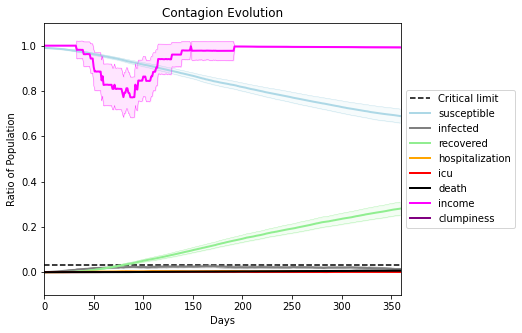

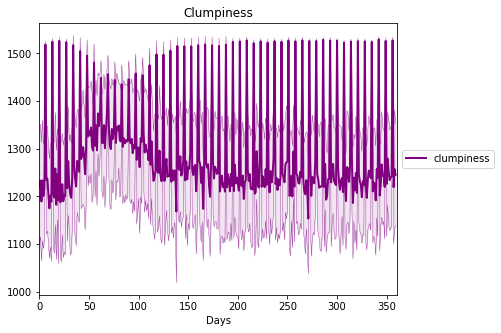

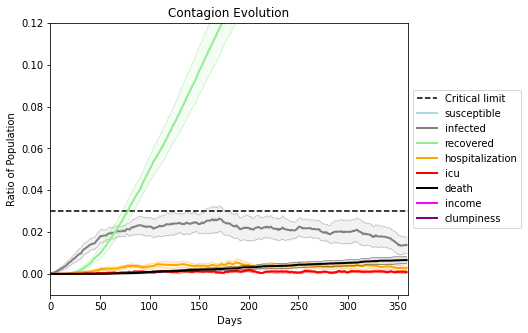

In [7]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9975
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6678, 6685, 7204, 2060, 5329, 3840, 2427, 1417, 8585, 1708, 8275, 6351, 5242, 9560, 4472, 1229, 2875, 6418, 8995, 6645]
Average similarity between family members is 0.9553452441399977 at temperature -0.997
Average similarity between family and home is 0.9998651182821373 at temperature -1
Average similarity between students and their classroom is 0.9322067813326109 at temperature -0.997
Average classroom occupancy is 1.695906432748538 and number classrooms is 171
Average similarity between workers is 0.917085511605787 at temperature -0.997
Average office occupancy is 3.49468085106383 and number offices is 188
Average friend similarity for adults: 0.8571045789702013 for kids: 0.7455509627402279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.5762701531814013
avg restaurant similarity 0.5735531129918546
avg restaurant similarity 0.6462362825076872
avg restaurant similarity 0.5884532721917911
avg restaurant similarity 0.703658000583893
avg restaurant similarity 0.6350745674935716
avg restaurant similarity 0.49198363124414884
avg restaurant similarity 0.6292731462333887
avg restaurant similarity 0.6995152507264792
avg restaurant similarity 0.5696490080922011
avg restaurant similarity 0.6104515812224881
avg restaurant similarity 0.6214147887258503
avg restaurant similarity 0.6358073870746865
avg restaurant similarity 0.45891122167269893
avg restaurant similarity 0.7149009134226976
avg restaurant similarity 0.6874653409410761
avg restaurant similarity 0.5207910811699145
avg restaurant similarity 0.4488233605228074
avg restaurant similarity 0.6509694454664067
avg restaurant similarity 0.5319990499026497
avg restaurant similarity 0.6798637557484728
avg restaurant similarity 0.6758856660501716
avg resta

avg restaurant similarity 0.766908069934468
avg restaurant similarity 0.6847679613783008
avg restaurant similarity 0.6196286587427456
avg restaurant similarity 0.48585039589570606
avg restaurant similarity 0.636314868207033
avg restaurant similarity 0.5265843125942578
avg restaurant similarity 0.7264923762489622
avg restaurant similarity 0.9537148026289167
avg restaurant similarity 0.6349483549526987
avg restaurant similarity 0.6018322978381923
avg restaurant similarity 0.7057927702489667
avg restaurant similarity 0.5720526091977006
avg restaurant similarity 0.7140878857321509
avg restaurant similarity 0.6738640513828447
avg restaurant similarity 0.6473885470192071
avg restaurant similarity 0.7368489667590316
avg restaurant similarity 0.7937567161554945
avg restaurant similarity 0.5487312791744586
avg restaurant similarity 0.623095085583295
avg restaurant similarity 0.563359375124262
avg restaurant similarity 0.553538879083953
avg restaurant similarity 0.6920443429354929
avg restaurant

Average friend similarity for adults: 0.8529042547165872 for kids: 0.7440735978041214
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.6700362186038573
avg restaurant similarity 0.7337963180400031
avg restaurant similarity 0.5557058125136372
avg restaurant similarity 0.6477126468242272
avg restaurant similarity 0.6589247456779159
avg restaurant similarity 0.4565402327326211
avg restaurant similarity 0.7573403955005648
avg restaurant similarity 0.7135024474163622
avg restaurant similarity 0.6197538561721128
avg restaurant similarity 0.6014689280504532
avg restaurant similarity 0.6509806278276016
avg restaurant similarity 0.9034930113910129
avg restaurant similarity 0.3850984235283183
avg restaurant similarity 0.3396094437897619
avg restaurant similarity 0.46045405968927716
avg restaurant similarity 0.49683057151968724
avg restaurant similarity 0.5662854454363467
avg restaurant similarity 0.5377988091083405
avg restaurant similarity 0.4672117459699457
avg restaurant similarity 0.5626403451269066
avg restaurant similarity 0.6962841704048691
avg restaurant similarity 0.7170982995335478
avg rest

avg restaurant similarity 0.39876559829149166
avg restaurant similarity 0.40495358546012333
avg restaurant similarity 0.6440920084429628
avg restaurant similarity 0.5192379414937929
avg restaurant similarity 0.5581810433693499
avg restaurant similarity 0.7929287916557388
avg restaurant similarity 0.6213320863574894
avg restaurant similarity 0.6526056162559853
avg restaurant similarity 0.5998431755393876
avg restaurant similarity 0.6551782047017357
avg restaurant similarity 0.6738109039080139
avg restaurant similarity 0.4728147813191667
avg restaurant similarity 0.6916170790081361
avg restaurant similarity 0.8676388365335493
avg restaurant similarity 0.36033390865314435
avg restaurant similarity 0.6851062410067367
avg restaurant similarity 0.4798568875156152
avg restaurant similarity 0.59717624120034
avg restaurant similarity 0.7075740276286233
avg restaurant similarity 0.5858096791536587
avg restaurant similarity 0.571807335587592
avg restaurant similarity 0.6030672224855074
avg restau

Average friend similarity for adults: 0.854384245321322 for kids: 0.7198401481681583
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated un

avg restaurant similarity 0.6635680337311681
avg restaurant similarity 0.750460912337897
avg restaurant similarity 0.6474286299712478
avg restaurant similarity 0.6527524203523598
avg restaurant similarity 0.6535956197659266
avg restaurant similarity 0.649467365557349
avg restaurant similarity 0.5766824457212247
avg restaurant similarity 0.788478513982346
avg restaurant similarity 0.7064396553724204
avg restaurant similarity 0.6389119515102041
avg restaurant similarity 0.45779405392513706
avg restaurant similarity 0.6392112187743543
avg restaurant similarity 0.7016415913875178
avg restaurant similarity 0.7940516979635382
avg restaurant similarity 0.6637922159321412
avg restaurant similarity 0.6463743763481736
avg restaurant similarity 0.6699423954134677
avg restaurant similarity 0.7765165154743628
avg restaurant similarity 0.4640576327508432
avg restaurant similarity 0.8703388047755084
avg restaurant similarity 0.6749059877799581
avg restaurant similarity 0.6474469001371527
avg restaura

avg restaurant similarity 0.6800154599027621
avg restaurant similarity 0.6178531306790854
avg restaurant similarity 0.5085037448983409
avg restaurant similarity 0.630933907412444
avg restaurant similarity 0.665491380062726
avg restaurant similarity 0.5281083987534356
avg restaurant similarity 0.7738706971079126
avg restaurant similarity 0.717360691469312
avg restaurant similarity 0.6751369288760849
avg restaurant similarity 0.752629544391243
avg restaurant similarity 0.6022177104636294
avg restaurant similarity 0.6907672262457923
avg restaurant similarity 0.7001560849976733
avg restaurant similarity 0.5733012774235241
avg restaurant similarity 0.7090248597229301
avg restaurant similarity 0.7585815617885429
avg restaurant similarity 0.512661568100694
avg restaurant similarity 0.684334220116828
avg restaurant similarity 0.720480776423073
avg restaurant similarity 0.8488727629603159
avg restaurant similarity 0.653826146052221
avg restaurant similarity 0.5981507126914541
avg restaurant sim

Average similarity between workers is 0.927020898494906 at temperature -0.997
Average office occupancy is 3.4607329842931938 and number offices is 191
Average friend similarity for adults: 0.8506535335720745 for kids: 0.7190416676536711
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.44795080161162165
avg restaurant similarity 0.41644026560198355
avg restaurant similarity 0.4622787932817226
avg restaurant similarity 0.4680113952767443
avg restaurant similarity 0.5620465520125184
avg restaurant similarity 0.7131414737236325
avg restaurant similarity 0.5445572465395221
avg restaurant similarity 0.3787854043956608
avg restaurant similarity 0.6088765222182575
avg restaurant similarity 0.5207440378125299
avg restaurant similarity 0.6210475265614114
avg restaurant similarity 0.5093773345120937
avg restaurant similarity 0.4526004406761934
avg restaurant similarity 0.5509550502938977
avg restaurant similarity 0.6547679745804181
avg restaurant similarity 0.42763578319186796
avg restaurant similarity 0.3765322931076291
avg restaurant similarity 0.1623468760216128
avg restaurant similarity 0.418972846504828
avg restaurant similarity 0.5573103755705877
avg restaurant similarity 0.4481437865277512
avg restaurant similarity 0.5546385289871342
avg rest

avg restaurant similarity 0.6736812362822447
avg restaurant similarity 0.45320057000875347
avg restaurant similarity 0.5342765468110701
avg restaurant similarity 0.5459475093391633
avg restaurant similarity 0.5350555306796094
avg restaurant similarity 0.5005098409592516
avg restaurant similarity 0.6460773399312083
avg restaurant similarity 0.6319054461362261
avg restaurant similarity 0.7013341788269466
avg restaurant similarity 0.42139411222055956
avg restaurant similarity 0.5687431518248299
avg restaurant similarity 0.586651548026518
avg restaurant similarity 0.5359458309304593
avg restaurant similarity 0.8712718239438308
avg restaurant similarity 0.6079247224652436
avg restaurant similarity 0.7755062477055576
avg restaurant similarity 0.540377404872519
avg restaurant similarity 0.4983460336295286
avg restaurant similarity 0.4865459800698831
avg restaurant similarity 0.5066124990821974
avg restaurant similarity 0.515395578958844
avg restaurant similarity 0.35854681875515115
avg restau

Average similarity between workers is 0.9364813033413268 at temperature -0.997
Average office occupancy is 3.423469387755102 and number offices is 196
Average friend similarity for adults: 0.8624934528808874 for kids: 0.7370468294972321
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 1

avg restaurant similarity 0.5718277959297828
avg restaurant similarity 0.5001821511356012
avg restaurant similarity 0.5967589934791353
avg restaurant similarity 0.40114526738808415
avg restaurant similarity 0.6786932918748598
avg restaurant similarity 0.5170390779372634
avg restaurant similarity 0.7262648841415478
avg restaurant similarity 0.5687732914958409
avg restaurant similarity 0.5823987623044354
avg restaurant similarity 0.5301833592473884
avg restaurant similarity 0.6445206296507823
avg restaurant similarity 0.5713820683210944
avg restaurant similarity 0.525931561815941
avg restaurant similarity 0.5826764944659878
avg restaurant similarity 0.7738133314458391
avg restaurant similarity 0.6068062932363159
avg restaurant similarity 0.5211918203671884
avg restaurant similarity 0.6300692110601377
avg restaurant similarity 0.6520701326538214
avg restaurant similarity 0.5633553974692825
avg restaurant similarity 0.606826565028456
avg restaurant similarity 0.6660876530043114
avg restaur

avg restaurant similarity 0.7008035037694711
avg restaurant similarity 0.5894024323734662
avg restaurant similarity 0.5285894838632712
avg restaurant similarity 0.5960854698428807
avg restaurant similarity 0.7187833703318935
avg restaurant similarity 0.7251367370389368
avg restaurant similarity 0.4585056460836868
avg restaurant similarity 0.4822853077785827
avg restaurant similarity 0.39643312033235983
avg restaurant similarity 0.6299391122382271
avg restaurant similarity 0.4697012506156423
avg restaurant similarity 0.6213333093296043
avg restaurant similarity 0.704064474623187
avg restaurant similarity 0.6907559989589515
avg restaurant similarity 0.5742853854519809
avg restaurant similarity 0.5431751177176815
avg restaurant similarity 0.4991511628514927
avg restaurant similarity 0.5783134605465919
avg restaurant similarity 0.5926596308472871
avg restaurant similarity 0.45435712020025354
avg restaurant similarity 0.610612741677785
avg restaurant similarity 0.6033953088032682
avg restau

Average similarity between workers is 0.9176335259992958 at temperature -0.997
Average office occupancy is 3.486772486772487 and number offices is 189
Average friend similarity for adults: 0.8526563136130696 for kids: 0.7250306974412055
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.766241174708005
avg restaurant similarity 0.7987019519864871
avg restaurant similarity 0.5509780679963024
avg restaurant similarity 0.6066940509381474
avg restaurant similarity 0.6229984098100032
avg restaurant similarity 0.4711337031832677
avg restaurant similarity 0.4927491896884966
avg restaurant similarity 0.5627434705090825
avg restaurant similarity 0.514071358683122
avg restaurant similarity 0.6107217481929754
avg restaurant similarity 0.6931860459269468
avg restaurant similarity 0.5685563632524177
avg restaurant similarity 0.5155089463928967
avg restaurant similarity 0.5854082757429139
avg restaurant similarity 0.487983136050487
avg restaurant similarity 0.5414505808275203
avg restaurant similarity 0.603642988766718
avg restaurant similarity 0.518516077039544
avg restaurant similarity 0.5813957453470869
avg restaurant similarity 0.532793455781624
avg restaurant similarity 0.36621630420428475
avg restaurant similarity 0.3076397558096887
avg restaurant 

avg restaurant similarity 0.5247736049672739
avg restaurant similarity 0.5216682877032075
avg restaurant similarity 0.4502981229879775
avg restaurant similarity 0.6235910708731699
avg restaurant similarity 0.6200230267482713
avg restaurant similarity 0.5869077154522298
avg restaurant similarity 0.5748000644818118
avg restaurant similarity 0.4821944758509492
avg restaurant similarity 0.6962041223488002
avg restaurant similarity 0.6756138851318234
avg restaurant similarity 0.6859524106210437
avg restaurant similarity 0.462330797046086
avg restaurant similarity 0.699124643514838
avg restaurant similarity 0.626652493746742
avg restaurant similarity 0.5729266392165863
avg restaurant similarity 0.8189790645691051
avg restaurant similarity 0.7751418991954723
avg restaurant similarity 0.6901603463738357
avg restaurant similarity 0.6283858026617627
avg restaurant similarity 0.6551747489688518
avg restaurant similarity 0.516924663050345
avg restaurant similarity 0.5808891487475148
avg restaurant

Average friend similarity for adults: 0.8491964380340458 for kids: 0.7410179161263567
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.5200286988930801
avg restaurant similarity 0.459265318235779
avg restaurant similarity 0.6409998588689662
avg restaurant similarity 0.7063902732086029
avg restaurant similarity 0.6922042777789386
avg restaurant similarity 0.6054309643570739
avg restaurant similarity 0.5549135612868049
avg restaurant similarity 0.620430374436126
avg restaurant similarity 0.5554158023625523
avg restaurant similarity 0.552385658918014
avg restaurant similarity 0.6542760011383161
avg restaurant similarity 0.6632134844487615
avg restaurant similarity 0.5885205881785757
avg restaurant similarity 0.569185672834993
avg restaurant similarity 0.44835188287763666
avg restaurant similarity 0.7276488779063919
avg restaurant similarity 0.6152648642646218
avg restaurant similarity 0.5363585205818712
avg restaurant similarity 0.6305896551727432
avg restaurant similarity 0.5467026885167778
avg restaurant similarity 0.5972366152476024
avg restaurant similarity 0.6005439595181656
avg restauran

avg restaurant similarity 0.4953530856626881
avg restaurant similarity 0.6068258532474815
avg restaurant similarity 0.5975964369266027
avg restaurant similarity 0.7270536625387769
avg restaurant similarity 0.5106122832389663
avg restaurant similarity 0.6584310911396793
avg restaurant similarity 0.5615097941269991
avg restaurant similarity 0.5146931427318031
avg restaurant similarity 0.49823961587393917
avg restaurant similarity 0.5877273204246487
avg restaurant similarity 0.5402994058104118
avg restaurant similarity 0.6013533984435993
avg restaurant similarity 0.4493138838954041
avg restaurant similarity 0.653183353756168
avg restaurant similarity 0.5625161713339312
avg restaurant similarity 0.5875183634695942
avg restaurant similarity 0.4265479317899962
avg restaurant similarity 0.5479110195934215
avg restaurant similarity 0.6017765420481934
avg restaurant similarity 0.5197442092879798
avg restaurant similarity 0.5790775637872209
avg restaurant similarity 0.9997328965221928
avg restau

Average similarity between workers is 0.9261256071997245 at temperature -0.997
Average office occupancy is 3.569948186528497 and number offices is 193
Average friend similarity for adults: 0.8709460631726477 for kids: 0.7322993791696246
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.6556080680979728
avg restaurant similarity 0.6997885462643475
avg restaurant similarity 0.5239068516059033
avg restaurant similarity 0.6864846412723239
avg restaurant similarity 0.6995490259314627
avg restaurant similarity 0.6201482824100242
avg restaurant similarity 0.66133024431803
avg restaurant similarity 0.7359592240289752
avg restaurant similarity 0.5827939070200884
avg restaurant similarity 0.615980882854324
avg restaurant similarity 0.591183801772635
avg restaurant similarity 0.6256464546111136
avg restaurant similarity 0.5669567657886427
avg restaurant similarity 0.6027676512677999
avg restaurant similarity 0.7078554717367516
avg restaurant similarity 0.3639231298901355
avg restaurant similarity 0.8018441689840552
avg restaurant similarity 0.6114289561289459
avg restaurant similarity 0.6534868559163122
avg restaurant similarity 0.7230134341556967
avg restaurant similarity 0.5725792217747913
avg restaurant similarity 0.5472184758356491
avg restaurant

avg restaurant similarity 0.7238253218697894
avg restaurant similarity 0.6263474875119383
avg restaurant similarity 0.7169954647963447
avg restaurant similarity 0.763144857093197
avg restaurant similarity 0.6365576451105698
avg restaurant similarity 0.6097553906301638
avg restaurant similarity 0.6944207948085446
avg restaurant similarity 0.6800452005168373
avg restaurant similarity 0.7310455939272206
avg restaurant similarity 0.8049818062924108
avg restaurant similarity 0.6231697092026832
avg restaurant similarity 0.611218047610344
avg restaurant similarity 0.7453570173596163
avg restaurant similarity 0.6828235529376655
avg restaurant similarity 0.7318168429040309
avg restaurant similarity 0.5071397218751702
avg restaurant similarity 0.644372771038191
avg restaurant similarity 0.8750934280111773
avg restaurant similarity 0.6382901634097281
avg restaurant similarity 0.5558979362934126
avg restaurant similarity 0.7979272965487076
avg restaurant similarity 0.591173596939741
avg restaurant

Average similarity between workers is 0.9191781126591376 at temperature -0.997
Average office occupancy is 3.507936507936508 and number offices is 189
Average friend similarity for adults: 0.8524858108859898 for kids: 0.7394328212936735
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5381334907286907
avg restaurant similarity 0.3694336675804389
avg restaurant similarity 0.48816482646881804
avg restaurant similarity 0.6599790761309339
avg restaurant similarity 0.45543541653962216
avg restaurant similarity 0.6237510698964646
avg restaurant similarity 0.44946068543471474
avg restaurant similarity 0.5532205780370488
avg restaurant similarity 0.35565257960321184
avg restaurant similarity 0.8798507098022929
avg restaurant similarity 0.6380534093679922
avg restaurant similarity 0.6358055264951986
avg restaurant similarity 0.48805912617705616
avg restaurant similarity 0.4615201439402977
avg restaurant similarity 0.6946264917631518
avg restaurant similarity 0.6637732627351587
avg restaurant similarity 0.42800042484267675
avg restaurant similarity 0.5735680639838214
avg restaurant similarity 0.6022444653249286
avg restaurant similarity 0.6449877973469458
avg restaurant similarity 0.6333934907347002
avg restaurant similarity 0.5402973860048111
avg 

avg restaurant similarity 0.4679957991857416
avg restaurant similarity 0.7527421120416496
avg restaurant similarity 0.5402058168965449
avg restaurant similarity 0.5577650317625993
avg restaurant similarity 0.6883772708811053
avg restaurant similarity 0.6729569549924217
avg restaurant similarity 0.4200948955150909
avg restaurant similarity 0.4945271290136614
avg restaurant similarity 0.461173452341932
avg restaurant similarity 0.4015737778477384
avg restaurant similarity 0.6464105401902478
avg restaurant similarity 0.594552567173773
avg restaurant similarity 0.45275613639079854
avg restaurant similarity 0.5501375030959056
avg restaurant similarity 0.5202888511995262
avg restaurant similarity 0.5420849747545088
avg restaurant similarity 0.5331815027743505
avg restaurant similarity 0.5584537109650125
avg restaurant similarity 0.5427599950244718
avg restaurant similarity 0.6637657221614064
avg restaurant similarity 0.49552895569088284
avg restaurant similarity 0.5680231787370322
avg restau

avg restaurant similarity 0.498176376011888
avg restaurant similarity 0.5844670156740337
avg restaurant similarity 0.6666203450949643
avg restaurant similarity 0.5858954675362953
avg restaurant similarity 0.5765568791865274
avg restaurant similarity 0.5772621076445243
avg restaurant similarity 0.6548273143918227
avg restaurant similarity 0.3443160518250705
avg restaurant similarity 0.5811503842434513
avg restaurant similarity 0.594943563410557
avg restaurant similarity 0.399881650520335
avg restaurant similarity 0.4295536165740639
avg restaurant similarity 0.6294170889079512
avg restaurant similarity 0.6056926845877592
avg restaurant similarity 0.7736581540715546
avg restaurant similarity 0.6153941153856926
avg restaurant similarity 0.6396505998249374
avg restaurant similarity 0.48668240982629385
avg restaurant similarity 0.6503240453865786
avg restaurant similarity 0.6528597888095529
avg restaurant similarity 0.5178837262533977
avg restaurant similarity 0.5703601683238206
avg restaura

avg restaurant similarity 0.8426943282297544
avg restaurant similarity 0.4805388929891681
avg restaurant similarity 0.7030363617488893
avg restaurant similarity 0.5001616421523911
avg restaurant similarity 0.8734588933860052
avg restaurant similarity 0.5474713111428692
avg restaurant similarity 0.6500274783339275
avg restaurant similarity 0.5124318685511519
avg restaurant similarity 0.5386529109023064
avg restaurant similarity 0.44775363440037447
avg restaurant similarity 0.6070208082229176
avg restaurant similarity 0.5862206418209158
avg restaurant similarity 0.8003962352519568
avg restaurant similarity 0.5700675167067307
avg restaurant similarity 0.46677392812009055
avg restaurant similarity 0.9116560982846329
avg restaurant similarity 0.6103662686283351
avg restaurant similarity 0.7519784627017999
avg restaurant similarity 0.0677980700652655
avg restaurant similarity 0.6110047888799739
avg restaurant similarity 0.6480940681346485
avg restaurant similarity 0.9998390862342008
avg rest

avg restaurant similarity 0.6859942884438944
avg restaurant similarity 0.5759315417520521
avg restaurant similarity 0.5668745810556663
avg restaurant similarity 0.4962225467285219
avg restaurant similarity 0.5094416911048575
avg restaurant similarity 0.4060685581308344
avg restaurant similarity 0.5961017530815499
avg restaurant similarity 0.6000999171221945
avg restaurant similarity 0.6853677304626815
avg restaurant similarity 0.49208141385694104
avg restaurant similarity 0.5360985679572695
avg restaurant similarity 0.6450072725583088
avg restaurant similarity 0.6404641495179233
avg restaurant similarity 0.6236969294465331
avg restaurant similarity 0.7147191332115324
avg restaurant similarity 0.5871531024754136
avg restaurant similarity 0.5789508290391085
avg restaurant similarity 0.5642447356016056
avg restaurant similarity 0.6729502727575817
avg restaurant similarity 0.660973180142591
avg restaurant similarity 0.5193419926374555
avg restaurant similarity 0.5545388486677897
avg restau

avg restaurant similarity 0.5669174007617115
avg restaurant similarity 0.3902782755807144
avg restaurant similarity 0.6117183758925009
avg restaurant similarity 0.5889643995591438
avg restaurant similarity 0.665031743306888
avg restaurant similarity 0.6530593798350489
avg restaurant similarity 0.5492063181063247
avg restaurant similarity 0.6673162139334646
avg restaurant similarity 0.6561046572291752
avg restaurant similarity 0.5069438694187004
avg restaurant similarity 0.6600901049938239
avg restaurant similarity 0.4592367288208269
avg restaurant similarity 0.6175545998178058
avg restaurant similarity 0.5438010937610246
avg restaurant similarity 0.7062148454741943
avg restaurant similarity 0.5099391297850748
avg restaurant similarity 0.6718277635436313
avg restaurant similarity 0.7792189726221581
avg restaurant similarity 0.6433906767834251
avg restaurant similarity 0.49547221946809594
avg restaurant similarity 0.6197257778154566
avg restaurant similarity 0.5486135058671887
avg restau

Average similarity between workers is 0.912997382461236 at temperature -0.997
Average office occupancy is 3.421875 and number offices is 192
Average friend similarity for adults: 0.8526370786632127 for kids: 0.7307918616748441
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people

avg restaurant similarity 0.6600881606172702
avg restaurant similarity 0.7462163052040138
avg restaurant similarity 0.5266093388627979
avg restaurant similarity 0.7638840251742035
avg restaurant similarity 0.5951024724312037
avg restaurant similarity 0.5526613676094161
avg restaurant similarity 0.6853464655226402
avg restaurant similarity 0.6142694978498364
avg restaurant similarity 0.6241482390179645
avg restaurant similarity 0.6644249086119974
avg restaurant similarity 0.4413429903028739
avg restaurant similarity 0.5628171084644334
avg restaurant similarity 0.5690692182091776
avg restaurant similarity 0.5485136034227146
avg restaurant similarity 0.6315571456011515
avg restaurant similarity 0.7013492692633053
avg restaurant similarity 0.5457665067199351
avg restaurant similarity 0.664966005118795
avg restaurant similarity 0.5079095691173503
avg restaurant similarity 0.7556780362253812
avg restaurant similarity 0.6830366490664
avg restaurant similarity 0.6028668144852758
avg restaurant

avg restaurant similarity 0.5877859514455391
avg restaurant similarity 0.7893478959502466
avg restaurant similarity 0.618948171916049
avg restaurant similarity 0.5640689617328074
avg restaurant similarity 0.6302413683789447
avg restaurant similarity 0.454921079826698
avg restaurant similarity 0.5675190339111384
avg restaurant similarity 0.7918228826648709
avg restaurant similarity 0.6896920975402215
avg restaurant similarity 0.8202546550952623
avg restaurant similarity 0.5950194915756297
avg restaurant similarity 0.5138386786031653
avg restaurant similarity 0.8207305094660349
avg restaurant similarity 0.6276680051266657
avg restaurant similarity 0.6118674075849908
avg restaurant similarity 0.5957080904035063
avg restaurant similarity 0.5785914385838579
avg restaurant similarity 0.5163437795366059
avg restaurant similarity 0.5860815734675825
avg restaurant similarity 0.6129921158105828
avg restaurant similarity 0.6722587106125558
avg restaurant similarity 0.5196545667926469
avg restaura

avg restaurant similarity 0.7231620605903967
avg restaurant similarity 0.7760307282719586
avg restaurant similarity 0.619367741141426
avg restaurant similarity 0.7240543651686194
avg restaurant similarity 0.6032420304047541
avg restaurant similarity 0.9993110491171465
avg restaurant similarity 0.5403871356550696
avg restaurant similarity 0.6869323462174085
avg restaurant similarity 0.7657216644898237
avg restaurant similarity 0.777440454509622
avg restaurant similarity 0.5598185909187624
avg restaurant similarity 0.7112177239406582
avg restaurant similarity 0.7864385347784292
avg restaurant similarity 0.5130913753883377
avg restaurant similarity 0.6234147735555746
avg restaurant similarity 0.5255193316845623
avg restaurant similarity 0.7009374057581054
avg restaurant similarity 0.5696928368531569
avg restaurant similarity 0.357950103197257
avg restaurant similarity 0.6335317270667469
avg restaurant similarity 0.5922619743921783
avg restaurant similarity 0.5452250960100842
avg restauran

avg restaurant similarity 0.7331949232249733
avg restaurant similarity 0.6864753212965636
avg restaurant similarity 0.7108599583341156
avg restaurant similarity 0.5733091138333611
avg restaurant similarity 0.5563854981278984
avg restaurant similarity 0.48841488746539213
avg restaurant similarity 0.5053398053878361
avg restaurant similarity 0.7759047102172721
avg restaurant similarity 0.8331020142972956
avg restaurant similarity 0.6453638279348303
avg restaurant similarity 0.6404086104014859
avg restaurant similarity 0.500522009305834
avg restaurant similarity 0.6536941917463152
avg restaurant similarity 0.3052557762767145
avg restaurant similarity 0.6379566083174489
avg restaurant similarity 0.7075465702284052
avg restaurant similarity 0.778985572099529
avg restaurant similarity 0.6345731244247
avg restaurant similarity 0.5144716892224326
avg restaurant similarity 0.6250375145215145
avg restaurant similarity 0.6200465737177133
avg restaurant similarity 0.6281414408379692
avg restaurant

avg restaurant similarity 0.578479491830007
avg restaurant similarity 0.43908285509121064
avg restaurant similarity 0.5118702450796805
avg restaurant similarity 0.5274044799474882
avg restaurant similarity 0.47335075410468536
avg restaurant similarity 0.6637805441217662
avg restaurant similarity 0.5275876489585483
avg restaurant similarity 0.5372499867563003
avg restaurant similarity 0.5704283794659368
avg restaurant similarity 0.4322199608904826
avg restaurant similarity 0.6157195821697959
avg restaurant similarity 0.4401626718805229
avg restaurant similarity 0.41591963785134317
avg restaurant similarity 0.5629078563500924
avg restaurant similarity 0.5660864847855795
avg restaurant similarity 0.634836065504547
avg restaurant similarity 0.4932584540005603
avg restaurant similarity 0.5526064126459374
avg restaurant similarity 0.637893458963569
avg restaurant similarity 0.6192564739534269
avg restaurant similarity 0.5342066014321134
avg restaurant similarity 0.6535478933035289
avg restau

avg restaurant similarity 0.5894529049028326
avg restaurant similarity 0.5430860639837263
avg restaurant similarity 0.6557539888822173
avg restaurant similarity 0.6193422470226223
avg restaurant similarity 0.6273612396932434
avg restaurant similarity 0.5482394750744088
avg restaurant similarity 0.5018054737771913
avg restaurant similarity 0.6123504062151676
avg restaurant similarity 0.5528163121339473
avg restaurant similarity 0.6012288371212736
avg restaurant similarity 0.5202517179832404
avg restaurant similarity 0.632318979040285
avg restaurant similarity 0.6036144646870378
avg restaurant similarity 0.587726128760249
avg restaurant similarity 0.5380126292673756
avg restaurant similarity 0.5677543400225632
avg restaurant similarity 0.5551306795617024
avg restaurant similarity 0.5813875416567561
avg restaurant similarity 0.5497190862696155
avg restaurant similarity 0.5272236760300281
avg restaurant similarity 0.601417938076604
avg restaurant similarity 0.5864873877986223
avg restauran

Average similarity between workers is 0.9170817304052232 at temperature -0.997
Average office occupancy is 3.3247422680412373 and number offices is 194
Average friend similarity for adults: 0.8522408849350095 for kids: 0.7467096546079546
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.5837847852399479
avg restaurant similarity 0.6189628455196645
avg restaurant similarity 0.6695520405438689
avg restaurant similarity 0.6708742097998819
avg restaurant similarity 0.2918170954676471
avg restaurant similarity 0.4875000164973975
avg restaurant similarity 0.5792058536445543
avg restaurant similarity 0.5360604938819933
avg restaurant similarity 0.5738123182678725
avg restaurant similarity 0.6842815518653539
avg restaurant similarity 0.4540829877686711
avg restaurant similarity 0.6215837896735654
avg restaurant similarity 0.42451119448959723
avg restaurant similarity 0.8293751314042437
avg restaurant similarity 0.6651167364875574
avg restaurant similarity 0.5452875622857087
avg restaurant similarity 0.7313931049342351
avg restaurant similarity 0.9997276409437726
avg restaurant similarity 0.5991295292195786
avg restaurant similarity 0.6336471812278978
avg restaurant similarity 0.5733261618016658
avg restaurant similarity 0.6651296764660201
avg resta

avg restaurant similarity 0.781006080931623
avg restaurant similarity 0.6144151309467817
avg restaurant similarity 0.5451194807908651
avg restaurant similarity 0.6371936359268249
avg restaurant similarity 0.7770813600205808
avg restaurant similarity 0.7229450304685583
avg restaurant similarity 0.7189679761801344
avg restaurant similarity 0.6853904249056157
avg restaurant similarity 0.6828493553188448
avg restaurant similarity 0.4946604282468706
avg restaurant similarity 0.6431374841381339
avg restaurant similarity 0.8010172304094871
avg restaurant similarity 0.47083384529655453
avg restaurant similarity 0.8162008251938074
avg restaurant similarity 0.4857671416061636
avg restaurant similarity 0.587244161494185
avg restaurant similarity 0.654635552959059
avg restaurant similarity 0.5514924422871331
avg restaurant similarity 0.7202973653507891
avg restaurant similarity 0.5632690774307784
avg restaurant similarity 0.6750370267439594
avg restaurant similarity 0.6014457625013055
avg restaura

Average similarity between workers is 0.918778091535965 at temperature -0.997
Average office occupancy is 3.61340206185567 and number offices is 194
Average friend similarity for adults: 0.8677136712139684 for kids: 0.7170561994529192
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.6185833578445225
avg restaurant similarity 0.5094139855500008
avg restaurant similarity 0.83118809024337
avg restaurant similarity 0.7180686380210237
avg restaurant similarity 0.676249178433087
avg restaurant similarity 0.7155947306137699
avg restaurant similarity 0.6227146879610372
avg restaurant similarity 0.4455342536906451
avg restaurant similarity 0.7386161883175951
avg restaurant similarity 0.597826089541581
avg restaurant similarity 0.5403304966487574
avg restaurant similarity 0.5609517513676111
avg restaurant similarity 0.5541662604657991
avg restaurant similarity 0.7063705700854479
avg restaurant similarity 0.6480664190903933
avg restaurant similarity 0.8055603665647253
avg restaurant similarity 0.6071090558774401
avg restaurant similarity 0.4668713035142309
avg restaurant similarity 0.6754381096914248
avg restaurant similarity 0.5534347229825172
avg restaurant similarity 0.5855145970090528
avg restaurant similarity 0.8948240930537463
avg restaurant

avg restaurant similarity 0.6812623967626253
avg restaurant similarity 0.5197641134889185
avg restaurant similarity 0.7189020982853794
avg restaurant similarity 0.4864189622361872
avg restaurant similarity 0.5965470933459561
avg restaurant similarity 0.7222630821463396
avg restaurant similarity 0.5540548482472446
avg restaurant similarity 0.6662180972032721
avg restaurant similarity 0.6588776148965965
avg restaurant similarity 0.5881547697767726
avg restaurant similarity 0.8025212165968768
avg restaurant similarity 0.6343082553123196
avg restaurant similarity 0.6818594741146655
avg restaurant similarity 0.5411658102773407
avg restaurant similarity 0.5875304036314581
avg restaurant similarity 0.4088624996792015
avg restaurant similarity 0.5180534406010955
avg restaurant similarity 0.725567593549729
avg restaurant similarity 0.7893461216336178
avg restaurant similarity 0.6021002069281598
avg restaurant similarity 0.7295806674595505
avg restaurant similarity 0.6461544923254181
avg restaur

Average similarity between workers is 0.9351265083292655 at temperature -0.997
Average office occupancy is 3.2512820512820513 and number offices is 195
Average friend similarity for adults: 0.847407927534277 for kids: 0.749845984187905
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 p

avg restaurant similarity 0.6843918543699763
avg restaurant similarity 0.6739031811069672
avg restaurant similarity 0.6129834410428491
avg restaurant similarity 0.707622470168377
avg restaurant similarity 0.6068025030157654
avg restaurant similarity 0.758934190189875
avg restaurant similarity 0.5604223205557471
avg restaurant similarity 0.515726248363615
avg restaurant similarity 0.5344612559122479
avg restaurant similarity 0.6224074696588029
avg restaurant similarity 0.5982236640991444
avg restaurant similarity 0.8323929514543108
avg restaurant similarity 0.5369405383244966
avg restaurant similarity 0.6048038839706505
avg restaurant similarity 0.6146257233822282
avg restaurant similarity 0.5231508424953153
avg restaurant similarity 0.7127714622190493
avg restaurant similarity 0.6438079951409159
avg restaurant similarity 0.6403616916391371
avg restaurant similarity 0.8168846016711274
avg restaurant similarity 0.7105132800161963
avg restaurant similarity 0.8362341638630311
avg restauran

avg restaurant similarity 0.4656282567506993
avg restaurant similarity 0.573547037538616
avg restaurant similarity 0.5160822076129268
avg restaurant similarity 0.6292974156224327
avg restaurant similarity 0.6661356126271802
avg restaurant similarity 0.56034580944742
avg restaurant similarity 0.5225431201563295
avg restaurant similarity 0.657452325342664
avg restaurant similarity 0.6094082774030686
avg restaurant similarity 0.8079137253039926
avg restaurant similarity 0.703384552908127
avg restaurant similarity 0.7997111580365754
avg restaurant similarity 0.40520347274655344
avg restaurant similarity 0.6212913590600296
avg restaurant similarity 0.6652801812290482
avg restaurant similarity 0.5202393497518861
avg restaurant similarity 0.6481493192046585
avg restaurant similarity 0.6567988308235196
avg restaurant similarity 0.564032779318903
avg restaurant similarity 0.5610344298598575
avg restaurant similarity 0.6478628319166052
avg restaurant similarity 0.6668439205334914
avg restaurant 

Average similarity between workers is 0.9196231923863857 at temperature -0.997
Average office occupancy is 3.359375 and number offices is 192
Average friend similarity for adults: 0.8494013998361729 for kids: 0.7338187355252331
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 peopl

avg restaurant similarity 0.6536008173060004
avg restaurant similarity 0.6311699103348888
avg restaurant similarity 0.4294120113504828
avg restaurant similarity 0.5384644746677788
avg restaurant similarity 0.6874749020680071
avg restaurant similarity 0.5736575255533305
avg restaurant similarity 0.56463745711958
avg restaurant similarity 0.6162533081625833
avg restaurant similarity 0.5145755764889272
avg restaurant similarity 0.6175923709455445
avg restaurant similarity 0.6644056755735288
avg restaurant similarity 0.6643512151906569
avg restaurant similarity 0.5505591189338859
avg restaurant similarity 0.6232465641655844
avg restaurant similarity 0.665506098319506
avg restaurant similarity 0.796182509453301
avg restaurant similarity 0.6330965509042643
avg restaurant similarity 0.6741362262295749
avg restaurant similarity 0.53394872959644
avg restaurant similarity 0.4594637460738137
avg restaurant similarity 0.6796762199878721
avg restaurant similarity 0.7217053044137057
avg restaurant s

avg restaurant similarity 0.6939901243883858
avg restaurant similarity 0.634938313647294
avg restaurant similarity 0.5886996723331983
avg restaurant similarity 0.6182245844678484
avg restaurant similarity 0.6149042057487032
avg restaurant similarity 0.5266573753873537
avg restaurant similarity 0.6239429059243644
avg restaurant similarity 0.6150037711888542
avg restaurant similarity 0.6142086669776178
avg restaurant similarity 0.608046525655933
avg restaurant similarity 0.5532705141679161
avg restaurant similarity 0.5604714451714563
avg restaurant similarity 0.6248456426146374
avg restaurant similarity 0.6303456012982345
avg restaurant similarity 0.31184693372223865
avg restaurant similarity 0.7399051548355621
avg restaurant similarity 0.6378706228534679
avg restaurant similarity 0.590139482415297
avg restaurant similarity 0.46472019463426417
avg restaurant similarity 0.5493086604314603
avg restaurant similarity 0.6130720919677441
avg restaurant similarity 0.43896010788101486
avg restau

avg restaurant similarity 0.5707891835020924
avg restaurant similarity 0.49819366564289824
avg restaurant similarity 0.5164638117093516
avg restaurant similarity 0.5795818213684979
avg restaurant similarity 0.6014374411987689
avg restaurant similarity 0.579469525642009
avg restaurant similarity 0.5287286545348164
avg restaurant similarity 0.6320100960773626
avg restaurant similarity 0.6397347311667387
avg restaurant similarity 0.298237194224291
avg restaurant similarity 0.5360684685228374
avg restaurant similarity 0.5738383074080999
avg restaurant similarity 0.6547128992797183
avg restaurant similarity 0.5251112927189908
avg restaurant similarity 0.5358636897677757
avg restaurant similarity 0.5534672291319467
avg restaurant similarity 0.6133492724986186
avg restaurant similarity 0.44986856880070347
avg restaurant similarity 0.5457123650925922
avg restaurant similarity 0.566858856376726
avg restaurant similarity 0.56615686409514
avg restaurant similarity 0.44065952577506007
avg restaura

avg restaurant similarity 0.3456046529001034
avg restaurant similarity 0.5384960662394469
avg restaurant similarity 0.5585720230812683
avg restaurant similarity 0.5357789643531157
avg restaurant similarity 0.5043190445499262
avg restaurant similarity 0.4703908990155461
avg restaurant similarity 0.6675898662763947
avg restaurant similarity 0.5087039692888609
avg restaurant similarity 0.5922456927106774
avg restaurant similarity 0.47021221538104896
avg restaurant similarity 0.46512882902112934
avg restaurant similarity 0.4005383108627755
avg restaurant similarity 0.547962348971542
avg restaurant similarity 0.6204327424823681
avg restaurant similarity 0.5484144342172045
avg restaurant similarity 0.5378022699548339
avg restaurant similarity 0.39495231229349975
avg restaurant similarity 0.47760500205785306
avg restaurant similarity 0.5086728362633796
avg restaurant similarity 0.48979877996204807
avg restaurant similarity 0.4101813521006578
avg restaurant similarity 0.5735732923646589
avg re

Average similarity between workers is 0.9271968945320849 at temperature -0.997
Average office occupancy is 3.4895833333333335 and number offices is 192
Average friend similarity for adults: 0.8614864021167198 for kids: 0.7360227722460542
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.7186190591913733
avg restaurant similarity 0.6364713000857853
avg restaurant similarity 0.7174671003271436
avg restaurant similarity 0.6616272045264947
avg restaurant similarity 0.7054842248596792
avg restaurant similarity 0.6073381585403043
avg restaurant similarity 0.5361567082177248
avg restaurant similarity 0.7270699719460123
avg restaurant similarity 0.6405979242513883
avg restaurant similarity 0.6560904772862833
avg restaurant similarity 0.7285608678711091
avg restaurant similarity 0.6514059684350235
avg restaurant similarity 0.7011263998820488
avg restaurant similarity 0.6465422380566624
avg restaurant similarity 0.5871991233132025
avg restaurant similarity 0.6261160466849317
avg restaurant similarity 0.6570573199188954
avg restaurant similarity 0.6797024239434989
avg restaurant similarity 0.5459669957152234
avg restaurant similarity 0.6837184258816645
avg restaurant similarity 0.6884240305720719
avg restaurant similarity 0.5912091988488304
avg restau

avg restaurant similarity 0.690686108831495
avg restaurant similarity 0.6845437160621995
avg restaurant similarity 0.7208642899158696
avg restaurant similarity 0.6055910201712992
avg restaurant similarity 0.6467830964434986
avg restaurant similarity 0.6614384117485168
avg restaurant similarity 0.5864366562531172
avg restaurant similarity 0.623488489044802
avg restaurant similarity 0.6313731587741724
avg restaurant similarity 0.6323570378548318
avg restaurant similarity 0.6134645328518527
avg restaurant similarity 0.6793608033819997
avg restaurant similarity 0.6963941345061448
avg restaurant similarity 0.5479112833853068
avg restaurant similarity 0.6275208575829514
avg restaurant similarity 0.6811286465501237
avg restaurant similarity 0.5662659231874281
avg restaurant similarity 0.7401781202186302
avg restaurant similarity 0.6135460625171588
avg restaurant similarity 0.6782683327909553
avg restaurant similarity 0.7007001555572484
avg restaurant similarity 0.5947607436216029
avg restaura

(<function dict.items>, <function dict.items>, <function dict.items>)

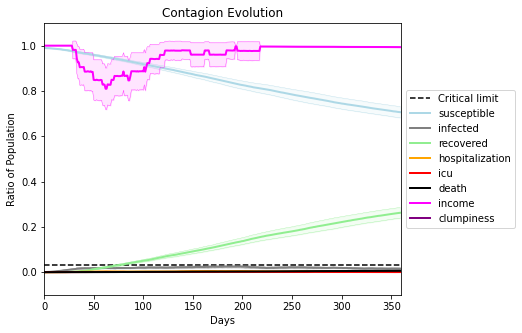

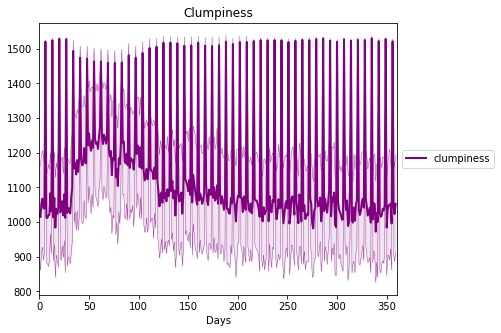

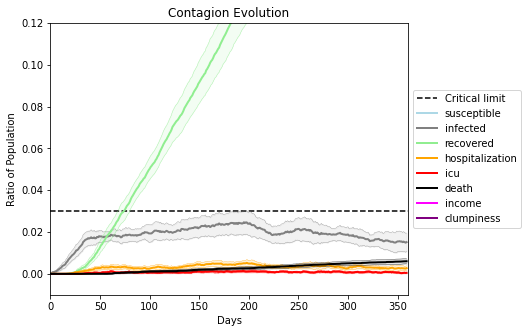

In [8]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.997
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9754, 6080, 3327, 4993, 5772, 6237, 5033, 2614, 2666, 3537, 6979, 7059, 9750, 8966, 4908, 8158, 3655, 3234, 3117, 5637]
Average similarity between family members is 0.9530288409500212 at temperature -0.996
Average similarity between family and home is 0.9998438240534971 at temperature -1
Average similarity between students and their classroom is 0.9238213684736574 at temperature -0.996
Average classroom occupancy is 1.6529411764705881 and number classrooms is 170
Average similarity between workers is 0.9185478026750735 at temperature -0.996
Average office occupancy is 3.3897435897435897 and number offices is 195
Average friend similarity for adults: 0.8509807654202856 for kids: 0.7181960334829348
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity 0.51459101064088
avg restaurant similarity 0.5510813337555776
avg restaurant similarity 0.5354295045277436
avg restaurant similarity 0.6437321255270013
avg restaurant similarity 0.5484794850247875
avg restaurant similarity 0.5815448406893582
avg restaurant similarity 0.6471543975078634
avg restaurant similarity 0.5033195202308205
avg restaurant similarity 0.5983763937743789
avg restaurant similarity 0.5604772373572178
avg restaurant similarity 0.6003996538417521
avg restaurant similarity 0.7844238532099889
avg restaurant similarity 0.214116449643104
avg restaurant similarity 0.5126539451297266
avg restaurant similarity 0.5322805495162403
avg restaurant similarity 0.5942735853713993
avg restaurant similarity 0.5122128690940396
avg restaurant similarity 0.7903567864783859
avg restaurant similarity 0.48562222568780106
avg restaurant similarity 0.4607785544991253
avg restaurant similarity 0.5567939928780928
avg restaurant similarity 0.6385530079707771
avg restaura

avg restaurant similarity 0.6292742540655198
avg restaurant similarity 0.6639812857178438
avg restaurant similarity 0.7764858489732619
avg restaurant similarity 0.7027109291614395
avg restaurant similarity 0.7775132660185543
avg restaurant similarity 0.599928377580451
avg restaurant similarity 0.641278750117935
avg restaurant similarity 0.5586241231125063
avg restaurant similarity 0.7502311768941696
avg restaurant similarity 0.7765927873719156
avg restaurant similarity 0.6870672196363197
avg restaurant similarity 0.40959258958500655
avg restaurant similarity 0.5947193931847289
avg restaurant similarity 0.6875744824056734
avg restaurant similarity 0.49701673157828563
avg restaurant similarity 0.47678594146997316
avg restaurant similarity 0.663050360912999
avg restaurant similarity 0.6201332198942414
avg restaurant similarity 0.5497562756677534
avg restaurant similarity 0.999729137296147
avg restaurant similarity 0.6514141578340251
avg restaurant similarity 0.7320642834941035
avg restaur

Average similarity between workers is 0.9292502156157885 at temperature -0.996
Average office occupancy is 3.5157894736842104 and number offices is 190
Average friend similarity for adults: 0.8590571039458159 for kids: 0.7336062218093028
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.5668016125196866
avg restaurant similarity 0.4353222998694385
avg restaurant similarity 0.6121496072824125
avg restaurant similarity 0.6541686229767348
avg restaurant similarity 0.46285202638383294
avg restaurant similarity 0.7703276620830849
avg restaurant similarity 0.48784223595566
avg restaurant similarity 0.24729151492942228
avg restaurant similarity 0.4737241464209446
avg restaurant similarity 0.8180910911456598
avg restaurant similarity 0.6777204055383204
avg restaurant similarity 0.5705000308294685
avg restaurant similarity 0.5382191300210856
avg restaurant similarity 0.5048121954661565
avg restaurant similarity 0.5118298528741423
avg restaurant similarity 0.37044201064326254
avg restaurant similarity 0.45145380276601027
avg restaurant similarity 0.5786304911821241
avg restaurant similarity 0.5269361045425222
avg restaurant similarity 0.648018935032788
avg restaurant similarity 0.5412048063988765
avg restaurant similarity 0.7255168774782413
avg resta

avg restaurant similarity 0.6773263669570556
avg restaurant similarity 0.5047273053669963
avg restaurant similarity 0.5443000087946289
avg restaurant similarity 0.6444347643843904
avg restaurant similarity 0.8159102261916491
avg restaurant similarity 0.5140747812990824
avg restaurant similarity 0.45805514485959836
avg restaurant similarity 0.40407098095327615
avg restaurant similarity 0.44500312582302665
avg restaurant similarity 0.6746428115514844
avg restaurant similarity 0.6368622466183542
avg restaurant similarity 0.665649697235457
avg restaurant similarity 0.6741402520676276
avg restaurant similarity 0.47229981693076084
avg restaurant similarity 0.47668100875378017
avg restaurant similarity 0.5714367486150571
avg restaurant similarity 0.3219380631926487
avg restaurant similarity 0.6236682754852843
avg restaurant similarity 0.5230438756122745
avg restaurant similarity 0.5336643010040331
avg restaurant similarity 0.48940419350877357
avg restaurant similarity 0.7371818725716202
avg r

Average similarity between workers is 0.9298689930445897 at temperature -0.996
Average office occupancy is 3.292929292929293 and number offices is 198
Average friend similarity for adults: 0.8601088418345008 for kids: 0.7482184534395813
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 

avg restaurant similarity 0.5140194021413573
avg restaurant similarity 0.52786738287448
avg restaurant similarity 0.44270128062379355
avg restaurant similarity 0.593045404817388
avg restaurant similarity 0.8021596559271661
avg restaurant similarity 0.5484684930591099
avg restaurant similarity 0.7064017304247925
avg restaurant similarity 0.5572950456685386
avg restaurant similarity 0.5880142995315011
avg restaurant similarity 0.5964886161919337
avg restaurant similarity 0.5502127295669755
avg restaurant similarity 0.6457614125309382
avg restaurant similarity 0.526300708179423
avg restaurant similarity 0.5662194847805305
avg restaurant similarity 0.6920665089465471
avg restaurant similarity 0.5667588174649286
avg restaurant similarity 0.8583883095686875
avg restaurant similarity 0.6768935847569307
avg restaurant similarity 0.6811684772684073
avg restaurant similarity 0.8549568608455914
avg restaurant similarity 0.5030965845353089
avg restaurant similarity 0.5529693273778704
avg restauran

avg restaurant similarity 0.5964106912410974
avg restaurant similarity 0.6011916777807862
avg restaurant similarity 0.5994155117211537
avg restaurant similarity 0.7201796103604595
avg restaurant similarity 0.7585800143346537
avg restaurant similarity 0.6171098863648706
avg restaurant similarity 0.5989545330815935
avg restaurant similarity 0.5087951201920239
avg restaurant similarity 0.6414384742710738
avg restaurant similarity 0.6250647919258465
avg restaurant similarity 0.6784309483964505
avg restaurant similarity 0.6074207067720486
avg restaurant similarity 0.5192336214380361
avg restaurant similarity 0.6687325434874001
avg restaurant similarity 0.5570483538612665
avg restaurant similarity 0.5832833803152102
avg restaurant similarity 0.6264387400380872
avg restaurant similarity 0.6792295706950546
avg restaurant similarity 0.6073159062565621
avg restaurant similarity 0.7425558897867894
avg restaurant similarity 0.6407288311400522
avg restaurant similarity 0.6225852678440364
avg restau

avg restaurant similarity 0.6794136242913451
avg restaurant similarity 0.564939990167929
avg restaurant similarity 0.8371941152375059
avg restaurant similarity 0.8176585171673829
avg restaurant similarity 0.9478640038387925
avg restaurant similarity 0.5169840667905228
avg restaurant similarity 0.6111002025892793
avg restaurant similarity 0.8310512603969187
avg restaurant similarity 0.563228651127415
avg restaurant similarity 0.5720562422661728
avg restaurant similarity 0.7333973513904756
avg restaurant similarity 0.41430853610695706
avg restaurant similarity 0.5384498036407929
avg restaurant similarity 0.6850076857049485
avg restaurant similarity 0.5408990105057295
avg restaurant similarity 0.5369265872833626
avg restaurant similarity 0.5944831126937482
avg restaurant similarity 0.6352169653114632
avg restaurant similarity 0.6308171832904257
avg restaurant similarity 0.4832690225724744
avg restaurant similarity 0.6562850385714308
avg restaurant similarity 0.673854743917454
avg restaura

avg restaurant similarity 0.39205650107509116
avg restaurant similarity 0.6974072873470107
avg restaurant similarity 0.7923601224458978
avg restaurant similarity 0.9294323872272904
avg restaurant similarity 0.45904147181146177
avg restaurant similarity 0.5265344123446676
avg restaurant similarity 0.4037500527343283
avg restaurant similarity 0.7802939120716412
avg restaurant similarity 0.5569834476500176
avg restaurant similarity 0.5419898937721362
avg restaurant similarity 0.6326438212418569
avg restaurant similarity 0.6186360199698336
avg restaurant similarity 0.5708933378586761
avg restaurant similarity 0.5666648259845537
avg restaurant similarity 0.7598267152872651
avg restaurant similarity 0.5390123571332747
avg restaurant similarity 0.7938352167937945
avg restaurant similarity 0.44369944929132127
avg restaurant similarity 0.49292761489538334
avg restaurant similarity 0.7357207837511643
avg restaurant similarity 0.41165759531376467
avg restaurant similarity 0.6543861302034363
avg r

avg restaurant similarity 0.6242839993049687
avg restaurant similarity 0.6099399325259517
avg restaurant similarity 0.6325959341558895
avg restaurant similarity 0.6265513350629565
avg restaurant similarity 0.5410112252460423
avg restaurant similarity 0.5819733820162616
avg restaurant similarity 0.7042050310087222
avg restaurant similarity 0.764333068413358
avg restaurant similarity 0.6922145731504489
avg restaurant similarity 0.7685625918349047
avg restaurant similarity 0.7162545263282333
avg restaurant similarity 0.6451663253183323
avg restaurant similarity 0.8317818681064224
avg restaurant similarity 0.6347694070999441
avg restaurant similarity 0.6955382243750975
avg restaurant similarity 0.7164294716447124
avg restaurant similarity 0.714132592481227
avg restaurant similarity 0.573877871202764
avg restaurant similarity 0.6041317604095507
avg restaurant similarity 0.6437501892072127
avg restaurant similarity 0.5971989098951976
avg restaurant similarity 0.6223605898973442
avg restauran

avg restaurant similarity 0.5267814211123572
avg restaurant similarity 0.6455045798940307
avg restaurant similarity 0.7170780809725414
avg restaurant similarity 0.7234597006142747
avg restaurant similarity 0.5688946582497145
avg restaurant similarity 0.5897255811743756
avg restaurant similarity 0.7759063415068407
avg restaurant similarity 0.7829489677478028
avg restaurant similarity 0.6207292785176425
avg restaurant similarity 0.7668528519623428
avg restaurant similarity 0.6328846052238223
avg restaurant similarity 0.6120883343039517
avg restaurant similarity 0.7576048032352518
avg restaurant similarity 0.5623342992615002
avg restaurant similarity 0.5292967714436275
avg restaurant similarity 0.7254014582558299
avg restaurant similarity 0.6928953332275612
avg restaurant similarity 0.5825907243949122
avg restaurant similarity 0.6526433523893344
avg restaurant similarity 0.6736131994000605
avg restaurant similarity 0.5946397816972849
avg restaurant similarity 0.7330374533260472
avg restau

Average similarity between workers is 0.939023534492822 at temperature -0.996
Average office occupancy is 3.2944162436548226 and number offices is 197
Average friend similarity for adults: 0.8629380741605955 for kids: 0.7432115965583885
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5538986104024449
avg restaurant similarity 0.48067135530216576
avg restaurant similarity 0.7851129495758954
avg restaurant similarity 0.6353651650029107
avg restaurant similarity 0.5786224665345056
avg restaurant similarity 0.5464481586769073
avg restaurant similarity 0.6715023218015747
avg restaurant similarity 0.5643280589735601
avg restaurant similarity 0.5847164464452558
avg restaurant similarity 0.6097664821254367
avg restaurant similarity 0.618959118485396
avg restaurant similarity 0.6651970240941113
avg restaurant similarity 0.6701009868030322
avg restaurant similarity 0.5559576477653916
avg restaurant similarity 0.6685784113120483
avg restaurant similarity 0.7192559846415216
avg restaurant similarity 0.6388087130778648
avg restaurant similarity 0.7252009660530415
avg restaurant similarity 0.5537777283443985
avg restaurant similarity 0.5890704609260679
avg restaurant similarity 0.6464258032149541
avg restaurant similarity 0.5725384829880535
avg restau

avg restaurant similarity 0.47620812777998
avg restaurant similarity 0.5852049502533283
avg restaurant similarity 0.723428937267854
avg restaurant similarity 0.7244504646859211
avg restaurant similarity 0.5978813491024509
avg restaurant similarity 0.4616602877924223
avg restaurant similarity 0.6241194332897455
avg restaurant similarity 0.7869350752584254
avg restaurant similarity 0.5971927481302487
avg restaurant similarity 0.544639749007071
avg restaurant similarity 0.7133337574784153
avg restaurant similarity 0.6373427521931245
avg restaurant similarity 0.6393532675182485
avg restaurant similarity 0.6916815061515467
avg restaurant similarity 0.5140492273493977
avg restaurant similarity 0.8282836840083829
avg restaurant similarity 0.7754300728038331
avg restaurant similarity 0.6493896529013335
avg restaurant similarity 0.5627515668043664
avg restaurant similarity 0.4831132374901337
avg restaurant similarity 0.6818083464658068
avg restaurant similarity 0.45615378295004105
avg restauran

Average friend similarity for adults: 0.8478658160136016 for kids: 0.7401137190284041
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.9997874730392935
avg restaurant similarity 0.6203123225394065
avg restaurant similarity 0.7200590087492305
avg restaurant similarity 0.6892442440917843
avg restaurant similarity 0.6178916797864638
avg restaurant similarity 0.5972695860197348
avg restaurant similarity 0.8497137633011072
avg restaurant similarity 0.6461250252169767
avg restaurant similarity 0.4921591883154056
avg restaurant similarity 0.5612407627804855
avg restaurant similarity 0.7515857658972243
avg restaurant similarity 0.648007431298506
avg restaurant similarity 0.7153624352993335
avg restaurant similarity 0.6961398344628522
avg restaurant similarity 0.512987883332998
avg restaurant similarity 0.6411304079863605
avg restaurant similarity 0.7608728969150151
avg restaurant similarity 0.7300531791785925
avg restaurant similarity 0.835251489922922
avg restaurant similarity 0.7305945181294619
avg restaurant similarity 0.9997564111919054
avg restaurant similarity 0.692764121157095
avg restaurant

avg restaurant similarity 0.6710230942558753
avg restaurant similarity 0.7436800659116298
avg restaurant similarity 0.7216622822870742
avg restaurant similarity 0.7947192619037812
avg restaurant similarity 0.5962625365955773
avg restaurant similarity 0.5844309266068828
avg restaurant similarity 0.6200336565219754
avg restaurant similarity 0.8099676610799219
avg restaurant similarity 0.7652744439769772
avg restaurant similarity 0.616218788948746
avg restaurant similarity 0.5838116404190876
avg restaurant similarity 0.6951501128274705
avg restaurant similarity 0.5392768408023193
avg restaurant similarity 0.5425431278178399
avg restaurant similarity 0.5374562358239818
avg restaurant similarity 0.6900641780219171
avg restaurant similarity 0.7558946266600947
avg restaurant similarity 0.7139991401848595
avg restaurant similarity 0.6423972705179362
avg restaurant similarity 0.6504094255405375
avg restaurant similarity 0.5955297835571655
avg restaurant similarity 0.47283796447473375
avg restau

avg restaurant similarity 0.7897820553716791
avg restaurant similarity 0.6164176190570363
avg restaurant similarity 0.7383712300481157
avg restaurant similarity 0.5222871912725937
avg restaurant similarity 0.7160313712283101
avg restaurant similarity 0.5499002988512285
avg restaurant similarity 0.5990720890064152
avg restaurant similarity 0.5168855679063834
avg restaurant similarity 0.6611456769370648
avg restaurant similarity 0.6448291363101551
avg restaurant similarity 0.5742756521842876
avg restaurant similarity 0.5753709612720734
avg restaurant similarity 0.5889475615866505
avg restaurant similarity 0.6318828073022935
avg restaurant similarity 0.6080800542720192
avg restaurant similarity 0.5891973025803736
avg restaurant similarity 0.6037826770954138
avg restaurant similarity 0.686956715380709
avg restaurant similarity 0.5559300954188874
avg restaurant similarity 0.7443243496428622
avg restaurant similarity 0.7202535535266092
avg restaurant similarity 0.5611755472672103
avg restaur

avg restaurant similarity 0.40201527506139856
avg restaurant similarity 0.5308531577527309
avg restaurant similarity 0.4641034651485625
avg restaurant similarity 0.5779014011809088
avg restaurant similarity 0.5276328564602889
avg restaurant similarity 0.41624340002088644
avg restaurant similarity 0.7402974998714201
avg restaurant similarity 0.5123668430213798
avg restaurant similarity 0.8064471023041535
avg restaurant similarity 0.6008673424068377
avg restaurant similarity 0.5662213917310538
avg restaurant similarity 0.6928561026470269
avg restaurant similarity 0.6508841098669365
avg restaurant similarity 0.7320661317024744
avg restaurant similarity 0.6447646692920379
avg restaurant similarity 0.7974290061665151
avg restaurant similarity 0.4858362567924259
avg restaurant similarity 0.666269099221049
avg restaurant similarity 0.6288246790267622
avg restaurant similarity 0.6944660006465689
avg restaurant similarity 0.6957170221194297
avg restaurant similarity 0.5911139205641578
avg resta

Average friend similarity for adults: 0.8593543707026079 for kids: 0.7408434435223702
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.6557155549605795
avg restaurant similarity 0.6585862222350096
avg restaurant similarity 0.8005632868609381
avg restaurant similarity 0.5291971866112021
avg restaurant similarity 0.5615832214901549
avg restaurant similarity 0.6979579901079076
avg restaurant similarity 0.49265200604861753
avg restaurant similarity 0.567647654429206
avg restaurant similarity 0.6097288462449344
avg restaurant similarity 0.5482163403254072
avg restaurant similarity 0.608414023283059
avg restaurant similarity 0.5132734807544164
avg restaurant similarity 0.485496927943579
avg restaurant similarity 0.806445760726106
avg restaurant similarity 0.687884464538635
avg restaurant similarity 0.6713112687228877
avg restaurant similarity 0.7134395752652574
avg restaurant similarity 0.5206021896724179
avg restaurant similarity 0.649341885155081
avg restaurant similarity 0.6539570358889657
avg restaurant similarity 0.7332137423922829
avg restaurant similarity 0.6668720751840814
avg restaurant 

avg restaurant similarity 0.7421360133838483
avg restaurant similarity 0.5837727175444019
avg restaurant similarity 0.6102969589768078
avg restaurant similarity 0.5290193037771628
avg restaurant similarity 0.44271128653525105
avg restaurant similarity 0.5401689218601398
avg restaurant similarity 0.5452363760437116
avg restaurant similarity 0.7196292924692255
avg restaurant similarity 0.7335454616021007
avg restaurant similarity 0.49320083637098117
avg restaurant similarity 0.9997634484223493
avg restaurant similarity 0.6238765157256225
avg restaurant similarity 0.9998716797465379
avg restaurant similarity 0.5883513955464766
avg restaurant similarity 0.5098437914681792
avg restaurant similarity 0.7299741661588206
avg restaurant similarity 0.7412045117998851
avg restaurant similarity 0.6954676676850843
avg restaurant similarity 0.8454594667781221
avg restaurant similarity 0.6186956346987449
avg restaurant similarity 0.5935089107232258
avg restaurant similarity 0.7608882863153559
avg rest

avg restaurant similarity 0.7097428856369432
avg restaurant similarity 0.707596888606118
avg restaurant similarity 0.9993881510622331
avg restaurant similarity 0.6820282077641422
avg restaurant similarity 0.8254673733308048
avg restaurant similarity 0.8327743215874324
avg restaurant similarity 0.7344669415777214
avg restaurant similarity 0.7394076850416696
avg restaurant similarity 0.664677154801609
avg restaurant similarity 0.5730666517998171
avg restaurant similarity 0.7434588766099229
avg restaurant similarity 0.7188083907533483
avg restaurant similarity 0.7807483904814161
avg restaurant similarity 0.6454003290820525
avg restaurant similarity 0.7642327014149177
avg restaurant similarity 0.7887614794406104
avg restaurant similarity 0.7664280855748477
avg restaurant similarity 0.6774687208030077
avg restaurant similarity 0.7831503722558124
avg restaurant similarity 0.8463084358903556
avg restaurant similarity 0.7607669676526172
avg restaurant similarity 0.8448937593215072
avg restaura

avg restaurant similarity 0.9240893270746128
avg restaurant similarity 0.6370844740862792
avg restaurant similarity 0.5609034391995089
avg restaurant similarity 0.7652113920577203
avg restaurant similarity 0.5417812179448187
avg restaurant similarity 0.758577266987839
avg restaurant similarity 0.7571996448404273
avg restaurant similarity 0.792243282454242
avg restaurant similarity 0.6434300557758612
avg restaurant similarity 0.7145286751317639
avg restaurant similarity 0.7264606523906487
avg restaurant similarity 0.6689733210559531
avg restaurant similarity 0.6532944067901482
avg restaurant similarity 0.7183613521459299
avg restaurant similarity 0.7597261268687021
avg restaurant similarity 0.6765619115392076
avg restaurant similarity 0.511320890449902
avg restaurant similarity 0.8283261427718529
avg restaurant similarity 0.8808688224890816
avg restaurant similarity 0.6998971967774626
avg restaurant similarity 0.7663401605093632
avg restaurant similarity 0.8746878392389945
avg restauran

Average friend similarity for adults: 0.8558135919575357 for kids: 0.7465456735733011
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.7730727099586029
avg restaurant similarity 0.5655733760277435
avg restaurant similarity 0.6369522603103348
avg restaurant similarity 0.674913272357128
avg restaurant similarity 0.6713154455737744
avg restaurant similarity 0.6764031417091967
avg restaurant similarity 0.8790198257809108
avg restaurant similarity 0.9167772933353637
avg restaurant similarity 0.5216843099513441
avg restaurant similarity 0.7484157105997706
avg restaurant similarity 0.7200780590223999
avg restaurant similarity 0.6218890829200391
avg restaurant similarity 0.5095296630148323
avg restaurant similarity 0.45851246792724376
avg restaurant similarity 0.4912667373440732
avg restaurant similarity 0.9012514625234135
avg restaurant similarity 0.8961113889174879
avg restaurant similarity 0.3701559416807202
avg restaurant similarity 0.7080603681437027
avg restaurant similarity 0.7399565492981433
avg restaurant similarity 0.48232230094977563
avg restaurant similarity 0.717440278536114
avg restau

avg restaurant similarity 0.533223164179527
avg restaurant similarity 0.5591358515152924
avg restaurant similarity 0.8551312698235121
avg restaurant similarity 0.5008517107321789
avg restaurant similarity 0.7472047275481379
avg restaurant similarity 0.6471150405638342
avg restaurant similarity 0.6272023571080382
avg restaurant similarity 0.47563039554004594
avg restaurant similarity 0.7356491683024288
avg restaurant similarity 0.5135294571809106
avg restaurant similarity 0.603577136541866
avg restaurant similarity 0.4096855014082844
avg restaurant similarity 0.6362137834322117
avg restaurant similarity 0.7139661984759136
avg restaurant similarity 0.6203008265653832
avg restaurant similarity 0.5912686766033612
avg restaurant similarity 0.8497561086625149
avg restaurant similarity 0.5689732083864273
avg restaurant similarity 0.5705247859489766
avg restaurant similarity 0.6883911555562001
avg restaurant similarity 0.5360343815839714
avg restaurant similarity 0.5627434108565301
avg restaur

avg restaurant similarity 0.7762303689200046
avg restaurant similarity 0.5959301866052753
avg restaurant similarity 0.4938216494403702
avg restaurant similarity 0.5438348431791906
avg restaurant similarity 0.6351885941844938
avg restaurant similarity 0.5485744515995027
avg restaurant similarity 0.5430660085843626
avg restaurant similarity 0.7663427411141647
avg restaurant similarity 0.7363350360503396
avg restaurant similarity 0.5080855550207735
avg restaurant similarity 0.6062427120906559
avg restaurant similarity 0.4643726090878949
avg restaurant similarity 0.49197942544744666
avg restaurant similarity 0.6355896308877
avg restaurant similarity 0.6465965918796237
avg restaurant similarity 0.5952988430610358
avg restaurant similarity 0.4922238052858868
avg restaurant similarity 0.5694688084026469
avg restaurant similarity 0.5942649467621985
avg restaurant similarity 0.5269459294598974
avg restaurant similarity 0.6740720327752605
avg restaurant similarity 0.5875210370593532
avg restaura

avg restaurant similarity 0.6769687676170186
avg restaurant similarity 0.6014382723888997
avg restaurant similarity 0.5940549971442707
avg restaurant similarity 0.5162273315820999
avg restaurant similarity 0.6662397893337654
avg restaurant similarity 0.5643382227818802
avg restaurant similarity 0.5872181633642766
avg restaurant similarity 0.4756867218583629
avg restaurant similarity 0.4980871923960758
avg restaurant similarity 0.7884838636766276
avg restaurant similarity 0.5788410633085641
avg restaurant similarity 0.48037611321974044
avg restaurant similarity 0.34569937588526006
avg restaurant similarity 0.4044472103954502
avg restaurant similarity 0.49570594416016717
avg restaurant similarity 0.43769355179217356
avg restaurant similarity 0.49381202074985325
avg restaurant similarity 0.5862844735875921
avg restaurant similarity 0.4815487335578381
avg restaurant similarity 0.5378312304139031
avg restaurant similarity 0.6441017950894686
avg restaurant similarity 0.493925642783846
avg re

Average friend similarity for adults: 0.8662791485191766 for kids: 0.7378392949833976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloc

avg restaurant similarity 0.5750025680701434
avg restaurant similarity 0.634318904086749
avg restaurant similarity 0.6053131143578656
avg restaurant similarity 0.5275127339437167
avg restaurant similarity 0.6463355026751548
avg restaurant similarity 0.6685000795051005
avg restaurant similarity 0.9490207378570867
avg restaurant similarity 0.7520011220418872
avg restaurant similarity 0.6504620489097156
avg restaurant similarity 0.6795798559625827
avg restaurant similarity 0.7910190274407063
avg restaurant similarity 0.7399567991249891
avg restaurant similarity 0.6551625180642071
avg restaurant similarity 0.7533485938964486
avg restaurant similarity 0.6242391704305748
avg restaurant similarity 0.5666523403606963
avg restaurant similarity 0.6859862855301133
avg restaurant similarity 0.4941421823715641
avg restaurant similarity 0.564885607675194
avg restaurant similarity 0.639983326182989
avg restaurant similarity 0.48848926707375667
avg restaurant similarity 0.6978412586796621
avg restaura

avg restaurant similarity 0.6098793626622153
avg restaurant similarity 0.6014731599981918
avg restaurant similarity 0.667530893622803
avg restaurant similarity 0.6559586916409218
avg restaurant similarity 0.7025134330604563
avg restaurant similarity 0.6303065473682951
avg restaurant similarity 0.5410585950330288
avg restaurant similarity 0.6178136144656245
avg restaurant similarity 0.6440591673003632
avg restaurant similarity 0.5215081163050806
avg restaurant similarity 0.6098527488328306
avg restaurant similarity 0.6436454188329311
avg restaurant similarity 0.6049552582136374
avg restaurant similarity 0.7592971292632731
avg restaurant similarity 0.6167003785739024
avg restaurant similarity 0.5337012858762542
avg restaurant similarity 0.7263762934110125
avg restaurant similarity 0.6468143095918311
avg restaurant similarity 0.7917349258848052
avg restaurant similarity 0.6728931193387168
avg restaurant similarity 0.5530129686242456
avg restaurant similarity 0.6158626264151961
avg restaur

Average similarity between workers is 0.9223302276764399 at temperature -0.996
Average office occupancy is 3.4410256410256412 and number offices is 195
Average friend similarity for adults: 0.8605153179731875 for kids: 0.725423488362113
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.7705234637268136
avg restaurant similarity 0.526261944053561
avg restaurant similarity 0.5368062473355308
avg restaurant similarity 0.724659325957769
avg restaurant similarity 0.5657756422651605
avg restaurant similarity 0.6387729689900427
avg restaurant similarity 0.6075393152868162
avg restaurant similarity 0.5534201822181948
avg restaurant similarity 0.6627950185309095
avg restaurant similarity 0.6489805458587046
avg restaurant similarity 0.5704346176801575
avg restaurant similarity 0.4802154079210598
avg restaurant similarity 0.6864107036334061
avg restaurant similarity 0.5736814860499299
avg restaurant similarity 0.6306446066836662
avg restaurant similarity 0.7040079807023637
avg restaurant similarity 0.6016809274287317
avg restaurant similarity 0.4646596771666831
avg restaurant similarity 0.5839663187033487
avg restaurant similarity 0.7961536450873417
avg restaurant similarity 0.5711411664082986
avg restaurant similarity 0.6512767945346348
avg restaura

avg restaurant similarity 0.7108541992248413
avg restaurant similarity 0.6747700521101119
avg restaurant similarity 0.4448856242144396
avg restaurant similarity 0.5999995525204717
avg restaurant similarity 0.6495987444706586
avg restaurant similarity 0.5028658210074837
avg restaurant similarity 0.5686994235402355
avg restaurant similarity 0.5713382569541353
avg restaurant similarity 0.5839089450551542
avg restaurant similarity 0.5401649112771707
avg restaurant similarity 0.532620581713461
avg restaurant similarity 0.5945527534698347
avg restaurant similarity 0.6937528573538118
avg restaurant similarity 0.5184935239711886
avg restaurant similarity 0.701122561451898
avg restaurant similarity 0.5054716245550266
avg restaurant similarity 0.8237532124655074
avg restaurant similarity 0.5385822757535464
avg restaurant similarity 0.48033301750051544
avg restaurant similarity 0.586395592069469
avg restaurant similarity 0.6419987843237063
avg restaurant similarity 0.7728850776948414
avg restaura

Average friend similarity for adults: 0.8575665023343275 for kids: 0.729502447672239
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated un

avg restaurant similarity 0.6470681253742974
avg restaurant similarity 0.6864172679096404
avg restaurant similarity 0.6355072641579999
avg restaurant similarity 0.6600666118615041
avg restaurant similarity 0.7741143720396293
avg restaurant similarity 0.625868829863952
avg restaurant similarity 0.8276959963500895
avg restaurant similarity 0.5095685216196755
avg restaurant similarity 0.8036730745941589
avg restaurant similarity 0.5083095919814513
avg restaurant similarity 0.6712852766687818
avg restaurant similarity 0.6781307642621237
avg restaurant similarity 0.6825126876399042
avg restaurant similarity 0.605789133630704
avg restaurant similarity 0.7754708578186167
avg restaurant similarity 0.6235764622934843
avg restaurant similarity 0.6058275384749381
avg restaurant similarity 0.7442507536829408
avg restaurant similarity 0.59463142227024
avg restaurant similarity 0.6128166922406283
avg restaurant similarity 0.5638568859094425
avg restaurant similarity 0.7544510182636743
avg restaurant

avg restaurant similarity 0.7936530895647966
avg restaurant similarity 0.7739348674094587
avg restaurant similarity 0.6237191978154918
avg restaurant similarity 0.6710043852283569
avg restaurant similarity 0.7029106889507045
avg restaurant similarity 0.6108019670924739
avg restaurant similarity 0.5229279690682767
avg restaurant similarity 0.7662293715015843
avg restaurant similarity 0.43817022682100376
avg restaurant similarity 0.5980153492708674
avg restaurant similarity 0.6557117662092322
avg restaurant similarity 0.7160973119284368
avg restaurant similarity 0.501056921061862
avg restaurant similarity 0.7689993533837164
avg restaurant similarity 0.8341198054470704
avg restaurant similarity 0.7568556567493997
avg restaurant similarity 0.5747474503644805
avg restaurant similarity 0.6321617473953558
avg restaurant similarity 0.6055268561355427
avg restaurant similarity 0.6002872883875577
avg restaurant similarity 0.6416913010756126
avg restaurant similarity 0.7173909630024028
avg restau

Average similarity between workers is 0.94379009911379 at temperature -0.996
Average office occupancy is 3.376237623762376 and number offices is 202
Average friend similarity for adults: 0.8620729098552846 for kids: 0.7077369603226049
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 pe

avg restaurant similarity 0.631724556998287
avg restaurant similarity 0.6644130763796398
avg restaurant similarity 0.5279721810759065
avg restaurant similarity 0.6718348282952228
avg restaurant similarity 0.3700071723862541
avg restaurant similarity 0.7161482585471287
avg restaurant similarity 0.5909507029532944
avg restaurant similarity 0.6306289789468511
avg restaurant similarity 0.5701011195622351
avg restaurant similarity 0.7164112732465776
avg restaurant similarity 0.49463973595143823
avg restaurant similarity 0.7144656450853347
avg restaurant similarity 0.6052413153061538
avg restaurant similarity 0.5145780075002522
avg restaurant similarity 0.5503355000823742
avg restaurant similarity 0.5594165324217153
avg restaurant similarity 0.5132142509065505
avg restaurant similarity 0.5126246533000546
avg restaurant similarity 0.5535024432912488
avg restaurant similarity 0.7851666738135535
avg restaurant similarity 0.7000491577309825
avg restaurant similarity 0.5708930644258428
avg restau

avg restaurant similarity 0.46382699236264924
avg restaurant similarity 0.6705330997802533
avg restaurant similarity 0.48336322020805333
avg restaurant similarity 0.5798467679673013
avg restaurant similarity 0.5505652928899634
avg restaurant similarity 0.7432860868180469
avg restaurant similarity 0.5134715327153646
avg restaurant similarity 0.5352360896704293
avg restaurant similarity 0.4909295028437074
avg restaurant similarity 0.5143698582927384
avg restaurant similarity 0.5208218765260818
avg restaurant similarity 0.5503517576868633
avg restaurant similarity 0.6237432321028422
avg restaurant similarity 0.4288872785696663
avg restaurant similarity 0.7783799227725446
avg restaurant similarity 0.5001979562635109
avg restaurant similarity 0.5293075635979438
avg restaurant similarity 0.48853800312012297
avg restaurant similarity 0.6279080289199331
avg restaurant similarity 0.5004401864860789
avg restaurant similarity 0.6666370861979792
avg restaurant similarity 0.35939628980321503
avg re

avg restaurant similarity 0.667016988466755
avg restaurant similarity 0.5150103839996456
avg restaurant similarity 0.6235459922916909
avg restaurant similarity 0.4229682421976607
avg restaurant similarity 0.5643297252428047
avg restaurant similarity 0.6764283441602511
avg restaurant similarity 0.825632494836458
avg restaurant similarity 0.7371122365209027
avg restaurant similarity 0.5395319248460141
avg restaurant similarity 0.6390188524736005
avg restaurant similarity 0.5132498028698419
avg restaurant similarity 0.433238094712324
avg restaurant similarity 0.6274732780577668
avg restaurant similarity 0.6583646567884885
avg restaurant similarity 0.6869941601214079
avg restaurant similarity 0.6259852915975482
avg restaurant similarity 0.6496012699076785
avg restaurant similarity 0.7403715515191216
avg restaurant similarity 0.4801667098098803
avg restaurant similarity 0.7301606822552287
avg restaurant similarity 0.7741842553796148
avg restaurant similarity 0.6616971036035183
avg restauran

avg restaurant similarity 0.8045709122603891
avg restaurant similarity 0.614830321225161
avg restaurant similarity 0.4934034150432144
avg restaurant similarity 0.6811693827945423
avg restaurant similarity 0.7164731072402627
avg restaurant similarity 0.44615833795782783
avg restaurant similarity 0.20599265536171105
avg restaurant similarity 0.5506922254479948
avg restaurant similarity 0.43495071395822305
avg restaurant similarity 0.6039625413795137
avg restaurant similarity 0.5963816858055953
avg restaurant similarity 0.5675424377177068
avg restaurant similarity 0.7778254133895697
avg restaurant similarity 0.5507801803707159
avg restaurant similarity 0.6740454505791461
avg restaurant similarity 0.7196842707153875
avg restaurant similarity 0.6577677145909783
avg restaurant similarity 0.5498991423712766
avg restaurant similarity 0.3649743916865538
avg restaurant similarity 0.484777262404446
avg restaurant similarity 0.6842833909925313
avg restaurant similarity 0.6078023190936531
avg resta

avg restaurant similarity 0.5101192714830988
avg restaurant similarity 0.5093036855277541
avg restaurant similarity 0.6232759855863876
avg restaurant similarity 0.5123318442319964
avg restaurant similarity 0.5446073697163061
avg restaurant similarity 0.737246744865554
avg restaurant similarity 0.6197883639795227
avg restaurant similarity 0.4168721228696009
avg restaurant similarity 0.4851482304708352
avg restaurant similarity 0.6464752249275264
avg restaurant similarity 0.5359379861097421
avg restaurant similarity 0.6609098945135652
avg restaurant similarity 0.5619689045686688
avg restaurant similarity 0.6501759745639248
avg restaurant similarity 0.653656498508883
avg restaurant similarity 0.629019275865825
avg restaurant similarity 0.5337015407850473
avg restaurant similarity 0.7990601129274115
avg restaurant similarity 0.8005593157930739
avg restaurant similarity 0.6240501853099171
avg restaurant similarity 0.6577961107385014
avg restaurant similarity 0.5565259818330284
avg restauran

avg restaurant similarity 0.6134762507113571
avg restaurant similarity 0.6577131525368153
avg restaurant similarity 0.45090930797914297
avg restaurant similarity 0.5990515573235017
avg restaurant similarity 0.5332419915907325
avg restaurant similarity 0.5584918656519867
avg restaurant similarity 0.5968112935219196
avg restaurant similarity 0.6456041821485018
avg restaurant similarity 0.42724531807152516
avg restaurant similarity 0.49671998044812793
avg restaurant similarity 0.5879032421311798
avg restaurant similarity 0.5029065010827659
avg restaurant similarity 0.6294101434374256
avg restaurant similarity 0.5487216636136265
avg restaurant similarity 0.5465177385795574
avg restaurant similarity 0.5272939116376888
avg restaurant similarity 0.522798078916097
avg restaurant similarity 0.8143630809516315
avg restaurant similarity 0.6135801357228104
avg restaurant similarity 0.6379908612309829
avg restaurant similarity 0.6221328887495297
avg restaurant similarity 0.7066428936740053
avg rest

Average similarity between workers is 0.9321752105424865 at temperature -0.996
Average office occupancy is 3.538860103626943 and number offices is 193
Average friend similarity for adults: 0.8593308727736495 for kids: 0.7247899449407141
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of

avg restaurant similarity 0.5127046486534591
avg restaurant similarity 0.7313649150168892
avg restaurant similarity 0.6972493780410063
avg restaurant similarity 0.7732396656311741
avg restaurant similarity 0.6446130248956872
avg restaurant similarity 0.5637570627350028
avg restaurant similarity 0.6133046608365933
avg restaurant similarity 0.680458906158898
avg restaurant similarity 0.778573931229555
avg restaurant similarity 0.7521081656094128
avg restaurant similarity 0.7055473935032486
avg restaurant similarity 0.7085945789979171
avg restaurant similarity 0.609856472036893
avg restaurant similarity 0.6401074290800574
avg restaurant similarity 0.5949410570987064
avg restaurant similarity 0.6329680292831614
avg restaurant similarity 0.7743527780110016
avg restaurant similarity 0.7050961705426283
avg restaurant similarity 0.607904457818865
avg restaurant similarity 0.6664393920353562
avg restaurant similarity 0.4698688700675668
avg restaurant similarity 0.6127032219864839
avg restaurant

avg restaurant similarity 0.623502942279036
avg restaurant similarity 0.5304763986817307
avg restaurant similarity 0.6684489536123528
avg restaurant similarity 0.7392340305881665
avg restaurant similarity 0.7069991004082253
avg restaurant similarity 0.5636311072463143
avg restaurant similarity 0.6770984409310088
avg restaurant similarity 0.7261993953570266
avg restaurant similarity 0.748522822201865
avg restaurant similarity 0.61211998985423
avg restaurant similarity 0.6265647145315579
avg restaurant similarity 0.6113645546824856
avg restaurant similarity 0.6832255270585768
avg restaurant similarity 0.7526686671151527
avg restaurant similarity 0.8258533948619423
avg restaurant similarity 0.6155071380564043
avg restaurant similarity 0.7296036341925558
avg restaurant similarity 0.6370731376464057
avg restaurant similarity 0.6019863038167544
avg restaurant similarity 0.6900663633007624
avg restaurant similarity 0.6024496711618468
avg restaurant similarity 0.7454607698292955
avg restaurant

Average friend similarity for adults: 0.8640768067316978 for kids: 0.7269635729742471
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.6993606881442674
avg restaurant similarity 0.4211577012129859
avg restaurant similarity 0.4600830351079095
avg restaurant similarity 0.5963718976678317
avg restaurant similarity 0.5012264549977876
avg restaurant similarity 0.564452365082948
avg restaurant similarity 0.518426072755581
avg restaurant similarity 0.6402551366882895
avg restaurant similarity 0.5073192375669241
avg restaurant similarity 0.7474278304336412
avg restaurant similarity 0.4681182636106395
avg restaurant similarity 0.5683791750356593
avg restaurant similarity 0.4913136558096819
avg restaurant similarity 0.6171854434186744
avg restaurant similarity 0.618729420008522
avg restaurant similarity 0.4373891062496318
avg restaurant similarity 0.6739874024710995
avg restaurant similarity 0.5276004800942597
avg restaurant similarity 0.7543213500279152
avg restaurant similarity 0.7115574934717891
avg restaurant similarity 0.48042807773054347
avg restaurant similarity 0.4226666898312044
avg restaura

avg restaurant similarity 0.7987805854510643
avg restaurant similarity 0.558416079214331
avg restaurant similarity 0.6717563269844011
avg restaurant similarity 0.530765042563387
avg restaurant similarity 0.46856607826153834
avg restaurant similarity 0.7773422336672846
avg restaurant similarity 0.5352038992624009
avg restaurant similarity 0.7015272536323608
avg restaurant similarity 0.6104652425138366
avg restaurant similarity 0.8927710327452005
avg restaurant similarity 0.5663452239099834
avg restaurant similarity 0.47984288184708623
avg restaurant similarity 0.5425973858179656
avg restaurant similarity 0.4546403330559533
avg restaurant similarity 0.5367744139986197
avg restaurant similarity 0.5426824069353221
avg restaurant similarity 0.43089502556353526
avg restaurant similarity 0.5430725434156943
avg restaurant similarity 0.690812220151503
avg restaurant similarity 0.7175395595515821
avg restaurant similarity 0.6940129987180665
avg restaurant similarity 0.544882187875848
avg restaur

(<function dict.items>, <function dict.items>, <function dict.items>)

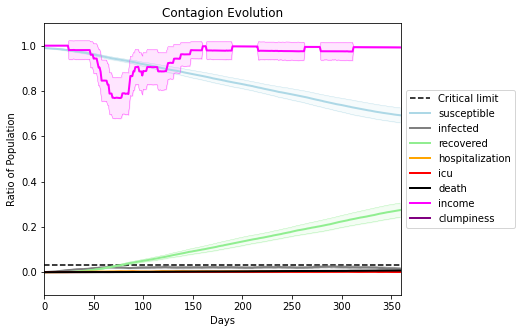

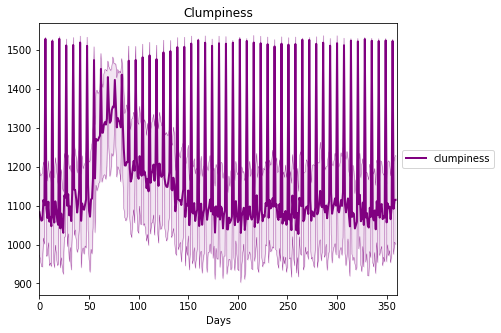

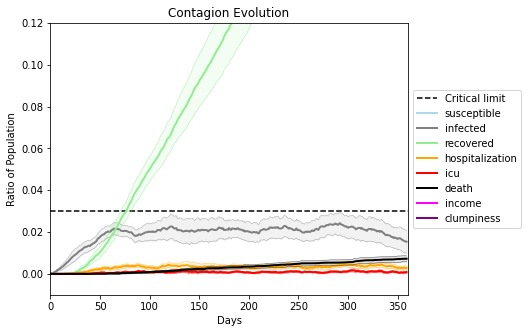

In [9]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.996
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[9795, 9054, 4743, 3639, 3794, 2284, 8373, 7037, 7123, 472, 9400, 4652, 2159, 377, 95, 9782, 105, 6290, 3082, 7539]
Average similarity between family members is 0.9528428862078158 at temperature -0.995
Average similarity between family and home is 0.9998542248383747 at temperature -1
Average similarity between students and their classroom is 0.8614173110624778 at temperature -0.995
Average classroom occupancy is 1.6746987951807228 and number classrooms is 166
Average similarity between workers is 0.8933254739959593 at temperature -0.995
Average office occupancy is 3.4285714285714284 and number offices is 196
Average friend similarity for adults: 0.8624010466515812 for kids: 0.7335637388760651
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.4953340877636675
avg restaurant similarity 0.5819473609331747
avg restaurant similarity 0.6779640393989673
avg restaurant similarity 0.42132376838315494
avg restaurant similarity 0.6569389671494401
avg restaurant similarity 0.5854154407455218
avg restaurant similarity 0.5301014813093425
avg restaurant similarity 0.5669141616501595
avg restaurant similarity 0.46182171374369635
avg restaurant similarity 0.561303157490359
avg restaurant similarity 0.31598374711372235
avg restaurant similarity 0.6530919276714529
avg restaurant similarity 0.45970233494873297
avg restaurant similarity 0.5278522658665753
avg restaurant similarity 0.7271810954656011
avg restaurant similarity 0.642251461620623
avg restaurant similarity 0.47156490774497856
avg restaurant similarity 0.61126831687951
avg restaurant similarity 0.4738926227498588
avg restaurant similarity 0.378645962144451
avg restaurant similarity 0.5338204912986135
avg restaurant similarity 0.57681319908031
avg restaura

avg restaurant similarity 0.620419253910791
avg restaurant similarity 0.6546850251866789
avg restaurant similarity 0.6688084225693492
avg restaurant similarity 0.3901571352240044
avg restaurant similarity 0.5894671098978884
avg restaurant similarity 0.4559013258476476
avg restaurant similarity 0.7471044975740332
avg restaurant similarity 0.6198400483805926
avg restaurant similarity 0.53779930171095
avg restaurant similarity 0.5474050352192967
avg restaurant similarity 0.5339192206237695
avg restaurant similarity 0.5615547578926399
avg restaurant similarity 0.6131162935370125
avg restaurant similarity 0.6995807670077876
avg restaurant similarity 0.5200418876719761
avg restaurant similarity 0.3604429653275906
avg restaurant similarity 0.6606315892714147
avg restaurant similarity 0.5112233966422819
avg restaurant similarity 0.8268742817150613
avg restaurant similarity 0.8722920460380716
avg restaurant similarity 0.43754424542980896
avg restaurant similarity 0.6435142535010645
avg restaura

Average friend similarity for adults: 0.8470296293222588 for kids: 0.7085708757290147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.46567873950917454
avg restaurant similarity 0.5459995380173759
avg restaurant similarity 0.40299854118734135
avg restaurant similarity 0.6062698992558996
avg restaurant similarity 0.6254820763119503
avg restaurant similarity 0.5504942990178422
avg restaurant similarity 0.5218844607872247
avg restaurant similarity 0.5112294072713209
avg restaurant similarity 0.9999083798461237
avg restaurant similarity 0.42358894197182745
avg restaurant similarity 0.5771863326599577
avg restaurant similarity 0.5600634632941872
avg restaurant similarity 0.6992620176815466
avg restaurant similarity 0.5102013784038704
avg restaurant similarity 0.6624189370889292
avg restaurant similarity 0.44719117445634105
avg restaurant similarity 0.4671317494362389
avg restaurant similarity 0.3965330856649456
avg restaurant similarity 0.48382862467830035
avg restaurant similarity 0.557800480263788
avg restaurant similarity 0.6159741662872374
avg restaurant similarity 0.6382248035656526
avg re

avg restaurant similarity 0.6961226230119696
avg restaurant similarity 0.5473164236154944
avg restaurant similarity 0.4420107177322647
avg restaurant similarity 0.4923304465866744
avg restaurant similarity 0.5481066403312617
avg restaurant similarity 0.44924893062002497
avg restaurant similarity 0.7639343596157455
avg restaurant similarity 0.4695811653475325
avg restaurant similarity 0.46581367992869216
avg restaurant similarity 0.5128738870950502
avg restaurant similarity 0.4469273690309198
avg restaurant similarity 0.46601476506759526
avg restaurant similarity 0.6008190113596534
avg restaurant similarity 0.7591292812261885
avg restaurant similarity 0.6073080905199917
avg restaurant similarity 0.4569072918627859
avg restaurant similarity 0.5830516618030059
avg restaurant similarity 0.473745449361059
avg restaurant similarity 0.47465841186088764
avg restaurant similarity 0.5787934929484709
avg restaurant similarity 0.5048828284707243
avg restaurant similarity 0.6980609060126128
avg res

Average similarity between workers is 0.8978462217982424 at temperature -0.995
Average office occupancy is 3.5303030303030303 and number offices is 198
Average friend similarity for adults: 0.8610157969181395 for kids: 0.7093924615622157
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 

avg restaurant similarity 0.7485881792431406
avg restaurant similarity 0.63725791868752
avg restaurant similarity 0.5968233796126442
avg restaurant similarity 0.4767001294237936
avg restaurant similarity 0.8185680659936466
avg restaurant similarity 0.6568015680126492
avg restaurant similarity 0.3809833733182463
avg restaurant similarity 0.6433614465592797
avg restaurant similarity 0.6836543648318893
avg restaurant similarity 0.655517456865487
avg restaurant similarity 0.5278727726794041
avg restaurant similarity 0.6210593910957105
avg restaurant similarity 0.6580385890215424
avg restaurant similarity 0.5089354053481657
avg restaurant similarity 0.765593073485698
avg restaurant similarity 0.46919634547024586
avg restaurant similarity 0.572916897296609
avg restaurant similarity 0.6385359440177794
avg restaurant similarity 0.520616492270185
avg restaurant similarity 0.5392002963657258
avg restaurant similarity 0.4538297047924509
avg restaurant similarity 0.6459048818317963
avg restaurant 

avg restaurant similarity 0.4348482894312447
avg restaurant similarity 0.2980909563187967
avg restaurant similarity 0.66424337051968
avg restaurant similarity 0.6612763224289306
avg restaurant similarity 0.5651361610952813
avg restaurant similarity 0.569145837151057
avg restaurant similarity 0.659059516142264
avg restaurant similarity 0.6858589188175166
avg restaurant similarity 0.5051884279551043
avg restaurant similarity 0.6010324740218677
avg restaurant similarity 0.6888966835700199
avg restaurant similarity 0.5917145496482645
avg restaurant similarity 0.6828958302236944
avg restaurant similarity 0.8635719847720166
avg restaurant similarity 0.5934897911294048
avg restaurant similarity 0.49355078198058766
avg restaurant similarity 0.6082196853354663
avg restaurant similarity 0.7637853230513739
avg restaurant similarity 0.5254867106349642
avg restaurant similarity 0.5881973628359232
avg restaurant similarity 0.5854527604544616
avg restaurant similarity 0.4785145781518506
avg restauran

avg restaurant similarity 0.5081086404554697
avg restaurant similarity 0.6289338789967831
avg restaurant similarity 0.5977182805964621
avg restaurant similarity 0.6479605460940268
avg restaurant similarity 0.6992571594087507
avg restaurant similarity 0.313086665993378
avg restaurant similarity 0.6991381425056792
avg restaurant similarity 0.503159740472497
avg restaurant similarity 0.8060636510039361
avg restaurant similarity 0.5431489621378267
avg restaurant similarity 0.5976654818140111
avg restaurant similarity 0.6691597790901201
avg restaurant similarity 0.5396020379615409
avg restaurant similarity 0.6515092123164721
avg restaurant similarity 0.6846373029814767
avg restaurant similarity 0.6549177456208443
avg restaurant similarity 0.6565715815534142
avg restaurant similarity 0.5917805333127019
avg restaurant similarity 0.6587126868460116
avg restaurant similarity 0.4538675936691943
avg restaurant similarity 0.6127686666210466
avg restaurant similarity 0.5217982064383051
avg restaura

avg restaurant similarity 0.40996287791997177
avg restaurant similarity 0.564441213680129
avg restaurant similarity 0.48072113004535444
avg restaurant similarity 0.6067948675399246
avg restaurant similarity 0.6975020927219806
avg restaurant similarity 0.7033659768398937
avg restaurant similarity 0.6338049602469529
avg restaurant similarity 0.41219217288155496
avg restaurant similarity 0.7492193708772171
avg restaurant similarity 0.384474017836339
avg restaurant similarity 0.44700057985545183
avg restaurant similarity 0.5010109469054789
avg restaurant similarity 0.5437766576188149
avg restaurant similarity 0.687022422208155
avg restaurant similarity 0.5193843299330007
avg restaurant similarity 0.6841825059219503
avg restaurant similarity 0.4614948043035345
avg restaurant similarity 0.5443654292356859
avg restaurant similarity 0.5429831192399934
avg restaurant similarity 0.43017020615402934
avg restaurant similarity 0.535334656468377
avg restaurant similarity 0.45726941125068277
avg rest

Average similarity between workers is 0.8905173287238474 at temperature -0.995
Average office occupancy is 3.394871794871795 and number offices is 195
Average friend similarity for adults: 0.8512508506182972 for kids: 0.7213395722001777
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.5184022824875949
avg restaurant similarity 0.5074062571724388
avg restaurant similarity 0.5757164207975188
avg restaurant similarity 0.6231824454865168
avg restaurant similarity 0.4326911347881277
avg restaurant similarity 0.5321237959262394
avg restaurant similarity 0.5843215457887465
avg restaurant similarity 0.6228474324863787
avg restaurant similarity 0.4603612095139228
avg restaurant similarity 0.6331560379823277
avg restaurant similarity 0.6085895580320216
avg restaurant similarity 0.5398066823562327
avg restaurant similarity 0.5591368515890397
avg restaurant similarity 0.5257001499222166
avg restaurant similarity 0.5786065471912395
avg restaurant similarity 0.41090964545799735
avg restaurant similarity 0.45676990937779854
avg restaurant similarity 0.5212156357582656
avg restaurant similarity 0.6077312989153413
avg restaurant similarity 0.4944385771313424
avg restaurant similarity 0.7014724459378672
avg restaurant similarity 0.45006707792197315
avg res

avg restaurant similarity 0.5271802158860731
avg restaurant similarity 0.5927140766119016
avg restaurant similarity 0.6508053897041057
avg restaurant similarity 0.5858726140454756
avg restaurant similarity 0.48723570140735384
avg restaurant similarity 0.7825097680473894
avg restaurant similarity 0.6240744003565772
avg restaurant similarity 0.4444884255086732
avg restaurant similarity 0.6771124792876246
avg restaurant similarity 0.7632172043606056
avg restaurant similarity 0.5785398208281496
avg restaurant similarity 0.4533269085912926
avg restaurant similarity 0.5098462330671482
avg restaurant similarity 0.332544206530346
avg restaurant similarity 0.6746042208996283
avg restaurant similarity 0.6315811809576605
avg restaurant similarity 0.5393664097534697
avg restaurant similarity 0.5938670917378892
avg restaurant similarity 0.6623925486277269
avg restaurant similarity 0.5155793541438658
avg restaurant similarity 0.49528187735862506
avg restaurant similarity 0.4743195476243961
avg resta

Average similarity between workers is 0.8917228914320903 at temperature -0.995
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.8558284098075939 for kids: 0.7302937325203364
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6927577638879387
avg restaurant similarity 0.6232887835048577
avg restaurant similarity 0.781447235153932
avg restaurant similarity 0.6391944199526803
avg restaurant similarity 0.5237536572381268
avg restaurant similarity 0.6108378514999147
avg restaurant similarity 0.5472404749129905
avg restaurant similarity 0.4862342969035665
avg restaurant similarity 0.5961793506437064
avg restaurant similarity 0.5930763589462871
avg restaurant similarity 0.660401129792268
avg restaurant similarity 0.6265894582696505
avg restaurant similarity 0.6382423706153683
avg restaurant similarity 0.6556040297665182
avg restaurant similarity 0.558461941960475
avg restaurant similarity 0.5846069523866847
avg restaurant similarity 0.49902284707676237
avg restaurant similarity 0.7011280638493932
avg restaurant similarity 0.6531311335542005
avg restaurant similarity 0.7205454822877657
avg restaurant similarity 0.7436327267157091
avg restaurant similarity 0.6688771412374976
avg restaura

avg restaurant similarity 0.4902534008748427
avg restaurant similarity 0.8187556829607868
avg restaurant similarity 0.4189434475783984
avg restaurant similarity 0.6311271588510138
avg restaurant similarity 0.7015331156197187
avg restaurant similarity 0.5826831126579805
avg restaurant similarity 0.734066896488676
avg restaurant similarity 0.6558787946332638
avg restaurant similarity 0.6566458479757674
avg restaurant similarity 0.6516771773571729
avg restaurant similarity 0.7188469854739215
avg restaurant similarity 0.6552599577792404
avg restaurant similarity 0.7498448274267723
avg restaurant similarity 0.6987841556413733
avg restaurant similarity 0.41880091793039953
avg restaurant similarity 0.6190855145817071
avg restaurant similarity 0.6547718778521302
avg restaurant similarity 0.5489712313461821
avg restaurant similarity 0.70666319184472
avg restaurant similarity 0.6780156354945729
avg restaurant similarity 0.6874437941446955
avg restaurant similarity 0.531056706880171
avg restauran

Average friend similarity for adults: 0.8508956451583609 for kids: 0.747514452079216
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.4707513111637647
avg restaurant similarity 0.664982871868378
avg restaurant similarity 0.6609887591892065
avg restaurant similarity 0.60757615657305
avg restaurant similarity 0.5133952440657473
avg restaurant similarity 0.5399007916959193
avg restaurant similarity 0.5779570375750869
avg restaurant similarity 0.6111498680604104
avg restaurant similarity 0.6564437229837251
avg restaurant similarity 0.5968853077347718
avg restaurant similarity 0.5291548271694173
avg restaurant similarity 0.6925923406874208
avg restaurant similarity 0.4645160980556495
avg restaurant similarity 0.7630212356052003
avg restaurant similarity 0.7336523436866428
avg restaurant similarity 0.4908474202190651
avg restaurant similarity 0.49761794346594335
avg restaurant similarity 0.6972657801655964
avg restaurant similarity 0.6864752823843825
avg restaurant similarity 0.6012667521933666
avg restaurant similarity 0.5451524582420981
avg restaurant similarity 0.5191922620708079
avg restaura

avg restaurant similarity 0.633234911539234
avg restaurant similarity 0.5744283828508191
avg restaurant similarity 0.674248337157478
avg restaurant similarity 0.5210702761562752
avg restaurant similarity 0.5193769792312433
avg restaurant similarity 0.5873663835559447
avg restaurant similarity 0.5037304226438163
avg restaurant similarity 0.5823373316367204
avg restaurant similarity 0.5064276326594827
avg restaurant similarity 0.4532177622011815
avg restaurant similarity 0.553440489639157
avg restaurant similarity 0.543978535873655
avg restaurant similarity 0.8414402810394979
avg restaurant similarity 0.5725628508607005
avg restaurant similarity 0.5480954208420017
avg restaurant similarity 0.4882908313795988
avg restaurant similarity 0.6768235057591961
avg restaurant similarity 0.6297912147215168
avg restaurant similarity 0.5984082574272823
avg restaurant similarity 0.5930184955546988
avg restaurant similarity 0.5862270672707509
avg restaurant similarity 0.7402828231170002
avg restaurant

Average friend similarity for adults: 0.8439750234071418 for kids: 0.7335599905293484
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.5184130354319251
avg restaurant similarity 0.41934342374968636
avg restaurant similarity 0.3641934810543873
avg restaurant similarity 0.49644171180759344
avg restaurant similarity 0.4452397920944263
avg restaurant similarity 0.5976599089213293
avg restaurant similarity 0.5211599662004199
avg restaurant similarity 0.5569284286913688
avg restaurant similarity 0.5951823642064727
avg restaurant similarity 0.4579840277666813
avg restaurant similarity 0.6850126840976777
avg restaurant similarity 0.5017095163680073
avg restaurant similarity 0.5442676911584102
avg restaurant similarity 0.7005024945900452
avg restaurant similarity 0.5247338346490816
avg restaurant similarity 0.6695567778744201
avg restaurant similarity 0.6421324799683861
avg restaurant similarity 0.47131304772020477
avg restaurant similarity 0.5230766261108881
avg restaurant similarity 0.576995609180458
avg restaurant similarity 0.5116514554050804
avg restaurant similarity 0.47071227877083643
avg res

avg restaurant similarity 0.6164765499987335
avg restaurant similarity 0.4919847619061988
avg restaurant similarity 0.6170701792523884
avg restaurant similarity 0.44731577638757813
avg restaurant similarity 0.602865005522321
avg restaurant similarity 0.49476906535650605
avg restaurant similarity 0.5395316783085893
avg restaurant similarity 0.5908480753974581
avg restaurant similarity 0.5096701807584588
avg restaurant similarity 0.5639489405774898
avg restaurant similarity 0.7345540530236291
avg restaurant similarity 0.7290788653400628
avg restaurant similarity 0.3898951286882871
avg restaurant similarity 0.5233268265923203
avg restaurant similarity 0.4815910533181006
avg restaurant similarity 0.5095954921543906
avg restaurant similarity 0.478819809930865
avg restaurant similarity 0.5854151133834571
avg restaurant similarity 0.6394281082746065
avg restaurant similarity 0.4802909293703603
avg restaurant similarity 0.5531699083230524
avg restaurant similarity 0.4799252807295654
avg restau

Average friend similarity for adults: 0.8419306085932465 for kids: 0.7239010321641207
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.5752268564136037
avg restaurant similarity 0.6276288819324228
avg restaurant similarity 0.5756979567155498
avg restaurant similarity 0.5564386752019215
avg restaurant similarity 0.5469615724670217
avg restaurant similarity 0.5019717570169082
avg restaurant similarity 0.5261688443278536
avg restaurant similarity 0.5440591983021454
avg restaurant similarity 0.6881499172242784
avg restaurant similarity 0.6296433864059348
avg restaurant similarity 0.6753485129309766
avg restaurant similarity 0.6919121182486987
avg restaurant similarity 0.6202480635322665
avg restaurant similarity 0.5297902643747963
avg restaurant similarity 0.5457688941946521
avg restaurant similarity 0.6281549188853186
avg restaurant similarity 0.4795741036005512
avg restaurant similarity 0.5187387700004452
avg restaurant similarity 0.6178304441301505
avg restaurant similarity 0.5774015065180067
avg restaurant similarity 0.5198696896200873
avg restaurant similarity 0.6104458565235444
avg restau

avg restaurant similarity 0.5017074567505303
avg restaurant similarity 0.7945224301638164
avg restaurant similarity 0.7247285504794501
avg restaurant similarity 0.6304333562347938
avg restaurant similarity 0.602373455555463
avg restaurant similarity 0.62587197829132
avg restaurant similarity 0.723466459917701
avg restaurant similarity 0.5068237052929057
avg restaurant similarity 0.729348961643292
avg restaurant similarity 0.48063142544700777
avg restaurant similarity 0.40386096615290723
avg restaurant similarity 0.5454584308425391
avg restaurant similarity 0.5387042767669425
avg restaurant similarity 0.4499222378707126
avg restaurant similarity 0.6075207798413359
avg restaurant similarity 0.5818630734694384
avg restaurant similarity 0.49111872361474584
avg restaurant similarity 0.6968419652795623
avg restaurant similarity 0.49253808298233276
avg restaurant similarity 0.659334101997085
avg restaurant similarity 0.6272775713566016
avg restaurant similarity 0.6580640225504713
avg restaura

Average friend similarity for adults: 0.8410474440126511 for kids: 0.755020004377047
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.584552288965805
avg restaurant similarity 0.6457619160931178
avg restaurant similarity 0.5092616632837413
avg restaurant similarity 0.5242112297117545
avg restaurant similarity 0.6688265026798467
avg restaurant similarity 0.3996395035619618
avg restaurant similarity 0.6469267658661928
avg restaurant similarity 0.6076253231019024
avg restaurant similarity 0.5505222079172822
avg restaurant similarity 0.5976521450459079
avg restaurant similarity 0.5593125856670189
avg restaurant similarity 0.5303298621210357
avg restaurant similarity 0.717235272945331
avg restaurant similarity 0.44151643590336487
avg restaurant similarity 0.5281854175212384
avg restaurant similarity 0.6635700920833019
avg restaurant similarity 0.6776226922368854
avg restaurant similarity 0.5799714085005652
avg restaurant similarity 0.7837905478018776
avg restaurant similarity 0.745406677682027
avg restaurant similarity 0.7425971929296857
avg restaurant similarity 0.44068411810596714
avg restaur

avg restaurant similarity 0.4930091658999367
avg restaurant similarity 0.5635930413419057
avg restaurant similarity 0.5254653776145651
avg restaurant similarity 0.6107519635223763
avg restaurant similarity 0.524545959482832
avg restaurant similarity 0.5391519156031344
avg restaurant similarity 0.5411957643687303
avg restaurant similarity 0.4977911948591292
avg restaurant similarity 0.5499281662224302
avg restaurant similarity 0.898861119431188
avg restaurant similarity 0.683647318294983
avg restaurant similarity 0.7405852878226473
avg restaurant similarity 0.6954438660688353
avg restaurant similarity 0.4725109603789997
avg restaurant similarity 0.6095060871296117
avg restaurant similarity 0.47182093990970553
avg restaurant similarity 0.49208041512545836
avg restaurant similarity 0.44740376128969894
avg restaurant similarity 0.5445529742344873
avg restaurant similarity 0.6155655343067086
avg restaurant similarity 0.9035612961125989
avg restaurant similarity 0.6922032869049501
avg restau

avg restaurant similarity 0.4492870033070372
avg restaurant similarity 0.7246549920962277
avg restaurant similarity 0.6307584594319651
avg restaurant similarity 0.696828125105604
avg restaurant similarity 0.6655981366616089
avg restaurant similarity 0.48327963868318785
avg restaurant similarity 0.49519248100487595
avg restaurant similarity 0.403638524766346
avg restaurant similarity 0.5050243222767883
avg restaurant similarity 0.5569380280499205
avg restaurant similarity 0.671212511921888
avg restaurant similarity 0.5323334183392241
avg restaurant similarity 0.6176764947290241
avg restaurant similarity 0.7272742423502169
avg restaurant similarity 0.582273197989674
avg restaurant similarity 0.5805080933009902
avg restaurant similarity 0.5539292709743314
avg restaurant similarity 0.289574644609364
avg restaurant similarity 0.6119726031992585
avg restaurant similarity 0.6066657978460404
avg restaurant similarity 0.5968429421018064
avg restaurant similarity 0.5239430087881161
avg restauran

avg restaurant similarity 0.6515668121370576
avg restaurant similarity 0.6574525028363015
avg restaurant similarity 0.6500832066085458
avg restaurant similarity 0.5238206887386953
avg restaurant similarity 0.41342137879914703
avg restaurant similarity 0.5178357358824534
avg restaurant similarity 0.440601506820666
avg restaurant similarity 0.6419728116967233
avg restaurant similarity 0.46064217139474606
avg restaurant similarity 0.6073729407340576
avg restaurant similarity 0.6886720331761802
avg restaurant similarity 0.6017279333901911
avg restaurant similarity 0.5796005773512646
avg restaurant similarity 0.6902695706696536
avg restaurant similarity 0.8439690968413678
avg restaurant similarity 0.4509200628187624
avg restaurant similarity 0.6737445039080271
avg restaurant similarity 0.8404106107218644
avg restaurant similarity 0.6393213661346179
avg restaurant similarity 0.36834659202609993
avg restaurant similarity 0.4400110888973422
avg restaurant similarity 0.6334593113726108
avg rest

Average friend similarity for adults: 0.8571880229197321 for kids: 0.7366851769360028
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.5304807287014617
avg restaurant similarity 0.49224524181882345
avg restaurant similarity 0.5284868826997899
avg restaurant similarity 0.5669126760973539
avg restaurant similarity 0.5977490031623163
avg restaurant similarity 0.46806680778272036
avg restaurant similarity 0.5941559283571473
avg restaurant similarity 0.5452722557338381
avg restaurant similarity 0.44913851711755104
avg restaurant similarity 0.5310526819022764
avg restaurant similarity 0.4315883928245257
avg restaurant similarity 0.67006516240262
avg restaurant similarity 0.6948607697798745
avg restaurant similarity 0.48996839450777885
avg restaurant similarity 0.5003542677297647
avg restaurant similarity 0.5822868052662851
avg restaurant similarity 0.5255569439301826
avg restaurant similarity 0.5441885533635449
avg restaurant similarity 0.5344408652064243
avg restaurant similarity 0.44045426624890616
avg restaurant similarity 0.6546973618258538
avg restaurant similarity 0.6143559891813473
avg res

avg restaurant similarity 0.5684568547679719
avg restaurant similarity 0.4553509436782017
avg restaurant similarity 0.5476991178363761
avg restaurant similarity 0.4893420663410674
avg restaurant similarity 0.4234518834976763
avg restaurant similarity 0.6177396767703606
avg restaurant similarity 0.3776314513596303
avg restaurant similarity 0.44511176997133034
avg restaurant similarity 0.47309352707502034
avg restaurant similarity 0.5000894921417587
avg restaurant similarity 0.4835223801117174
avg restaurant similarity 0.3998813640746848
avg restaurant similarity 0.5096864627492201
avg restaurant similarity 0.6686825433649147
avg restaurant similarity 0.4915278596580686
avg restaurant similarity 0.6305920285940689
avg restaurant similarity 0.4797093953180275
avg restaurant similarity 0.5980538476526207
avg restaurant similarity 0.42856959870766353
avg restaurant similarity 0.375219324411867
avg restaurant similarity 0.40234730574016186
avg restaurant similarity 0.48633834106059237
avg re

Average similarity between workers is 0.9047373266909382 at temperature -0.995
Average office occupancy is 3.601063829787234 and number offices is 188
Average friend similarity for adults: 0.8658819972356753 for kids: 0.7353238701478222
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.5059112168816383
avg restaurant similarity 0.6907809380103594
avg restaurant similarity 0.5206904407135998
avg restaurant similarity 0.6523661854649542
avg restaurant similarity 0.7514775637667124
avg restaurant similarity 0.7045939630357516
avg restaurant similarity 0.639359631278407
avg restaurant similarity 0.900025738357336
avg restaurant similarity 0.3490103280466263
avg restaurant similarity 0.7678219172804341
avg restaurant similarity 0.5615192105541689
avg restaurant similarity 0.504488016641563
avg restaurant similarity 0.626345370145381
avg restaurant similarity 0.782197050033689
avg restaurant similarity 0.665071990587403
avg restaurant similarity 0.8264272083861364
avg restaurant similarity 0.7534787602211844
avg restaurant similarity 0.6674441222839832
avg restaurant similarity 0.4886537473469451
avg restaurant similarity 0.673279961996057
avg restaurant similarity 0.6782758056897871
avg restaurant similarity 0.6457899008510127
avg restaurant si

avg restaurant similarity 0.7302955753371758
avg restaurant similarity 0.593346619139573
avg restaurant similarity 0.5375952369470061
avg restaurant similarity 0.5129304842337806
avg restaurant similarity 0.4994445194018046
avg restaurant similarity 0.5746534461105416
avg restaurant similarity 0.7294006877274387
avg restaurant similarity 0.7891775523012837
avg restaurant similarity 0.7041663077548164
avg restaurant similarity 0.563494043382206
avg restaurant similarity 0.4290231597719023
avg restaurant similarity 0.628677030343862
avg restaurant similarity 0.6300307997755371
avg restaurant similarity 0.7769105779468539
avg restaurant similarity 0.6623624350450176
avg restaurant similarity 0.7637172261192435
avg restaurant similarity 0.7585193059122659
avg restaurant similarity 0.5998434502380674
avg restaurant similarity 0.7019133991805342
avg restaurant similarity 0.45497070838135933
avg restaurant similarity 0.6466718331663539
avg restaurant similarity 0.6092039033099339
avg restaura

Average friend similarity for adults: 0.8521203300407781 for kids: 0.7432518101040562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.5097029110706575
avg restaurant similarity 0.6177840481447333
avg restaurant similarity 0.4954745036902499
avg restaurant similarity 0.6295129976970212
avg restaurant similarity 0.466508715340182
avg restaurant similarity 0.5868750757012244
avg restaurant similarity 0.5693610738560864
avg restaurant similarity 0.6276779717812111
avg restaurant similarity 0.6643532924681015
avg restaurant similarity 0.4623256423405021
avg restaurant similarity 0.5552989378419176
avg restaurant similarity 0.5441011672321341
avg restaurant similarity 0.6149021565037578
avg restaurant similarity 0.5363966275496875
avg restaurant similarity 0.4857313621718633
avg restaurant similarity 0.8215405940619087
avg restaurant similarity 0.6997452096108925
avg restaurant similarity 0.5710007921352377
avg restaurant similarity 0.6184831652896841
avg restaurant similarity 0.5532643680940655
avg restaurant similarity 0.6665359642253211
avg restaurant similarity 0.618506926066782
avg restaura

avg restaurant similarity 0.7484683058841002
avg restaurant similarity 0.455175424498969
avg restaurant similarity 0.5501425011805814
avg restaurant similarity 0.8324430840033634
avg restaurant similarity 0.510452292211555
avg restaurant similarity 0.49236965682889144
avg restaurant similarity 0.5993099682886953
avg restaurant similarity 0.5901713557541952
avg restaurant similarity 0.3630939551661152
avg restaurant similarity 0.5639613362465433
avg restaurant similarity 0.463532897434115
avg restaurant similarity 0.4763419242472172
avg restaurant similarity 0.6541138659973288
avg restaurant similarity 0.47092242783460203
avg restaurant similarity 0.5009831107585041
avg restaurant similarity 0.7197943065821294
avg restaurant similarity 0.6457841303446267
avg restaurant similarity 0.45974708658961655
avg restaurant similarity 0.5209095161594307
avg restaurant similarity 0.5982877439265205
avg restaurant similarity 0.4857117954056154
avg restaurant similarity 0.5518839295860324
avg restau

Average friend similarity for adults: 0.8491106152232949 for kids: 0.7200726962140371
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.5892717126622652
avg restaurant similarity 0.7344008820634498
avg restaurant similarity 0.5939688858993564
avg restaurant similarity 0.2857332310057686
avg restaurant similarity 0.6372068175550687
avg restaurant similarity 0.7437127760972091
avg restaurant similarity 0.6177441691079022
avg restaurant similarity 0.4814196364659067
avg restaurant similarity 0.5949623061565911
avg restaurant similarity 0.7293013532499877
avg restaurant similarity 0.6239164444593511
avg restaurant similarity 0.6350706726180982
avg restaurant similarity 0.42466094050378794
avg restaurant similarity 0.49836873093072587
avg restaurant similarity 0.49301831878079055
avg restaurant similarity 0.5549983802988465
avg restaurant similarity 0.6340421689776954
avg restaurant similarity 0.654903645850065
avg restaurant similarity 0.6380878719269303
avg restaurant similarity 0.7364721467497575
avg restaurant similarity 0.7669543484505624
avg restaurant similarity 0.5455247414287818
avg rest

avg restaurant similarity 0.6189011240788725
avg restaurant similarity 0.6013107329836682
avg restaurant similarity 0.6120733293765017
avg restaurant similarity 0.9997365448519132
avg restaurant similarity 0.7228789691844622
avg restaurant similarity 0.53316960472056
avg restaurant similarity 0.5891772245945136
avg restaurant similarity 0.4412235496141816
avg restaurant similarity 0.560576822508071
avg restaurant similarity 0.5411987554555665
avg restaurant similarity 0.7080358364363915
avg restaurant similarity 0.5502047705679888
avg restaurant similarity 0.7023434403610413
avg restaurant similarity 0.682969152984582
avg restaurant similarity 0.5467972444057416
avg restaurant similarity 0.559087203048652
avg restaurant similarity 0.6279221516486305
avg restaurant similarity 0.6164962941945354
avg restaurant similarity 0.5780602391752087
avg restaurant similarity 0.7402591622171778
avg restaurant similarity 0.4955074379849838
avg restaurant similarity 0.3625511723742178
avg restaurant 

avg restaurant similarity 0.6736517465671881
avg restaurant similarity 0.5356855180080126
avg restaurant similarity 0.503967130471079
avg restaurant similarity 0.6026874407285552
avg restaurant similarity 0.6654204240763023
avg restaurant similarity 0.5121380973058973
avg restaurant similarity 0.5299162305157104
avg restaurant similarity 0.7439557126939402
avg restaurant similarity 0.509993563994911
avg restaurant similarity 0.5816166105653358
avg restaurant similarity 0.43768571356121605
avg restaurant similarity 0.5255387408788547
avg restaurant similarity 0.6603531139518184
avg restaurant similarity 0.6244837068443428
avg restaurant similarity 0.4785491267060324
avg restaurant similarity 0.5695057544625381
avg restaurant similarity 0.6000912814113898
avg restaurant similarity 0.6999586671781959
avg restaurant similarity 0.638116510620935
avg restaurant similarity 0.6590977908794623
avg restaurant similarity 0.6664346778170891
avg restaurant similarity 0.5398982509105114
avg restaura

avg restaurant similarity 0.7714263555081186
avg restaurant similarity 0.6933125751453966
avg restaurant similarity 0.4745503256491933
avg restaurant similarity 0.5419513894062191
avg restaurant similarity 0.47124571393603015
avg restaurant similarity 0.5079409456526125
avg restaurant similarity 0.48028244310372176
avg restaurant similarity 0.45263150513082223
avg restaurant similarity 0.5125807900612543
avg restaurant similarity 0.379609324335895
avg restaurant similarity 0.5036872206630687
avg restaurant similarity 0.6647045586299056
avg restaurant similarity 0.558318828805908
avg restaurant similarity 0.4504205596934234
avg restaurant similarity 0.5048928312808231
avg restaurant similarity 0.66363790931671
avg restaurant similarity 0.6159837994848464
avg restaurant similarity 0.6618021418561132
avg restaurant similarity 0.5163434058665999
avg restaurant similarity 0.8917471582049069
avg restaurant similarity 0.7548899762581531
avg restaurant similarity 0.6822172897613253
avg restaur

Average similarity between workers is 0.9069084549401093 at temperature -0.995
Average office occupancy is 3.2613065326633164 and number offices is 199
Average friend similarity for adults: 0.8531822077600775 for kids: 0.7475472870184852
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.6155715259974789
avg restaurant similarity 0.5121411919135029
avg restaurant similarity 0.5572208687936501
avg restaurant similarity 0.5845098002064492
avg restaurant similarity 0.5263713852935554
avg restaurant similarity 0.4692446059158395
avg restaurant similarity 0.5312539463195995
avg restaurant similarity 0.5979528657780203
avg restaurant similarity 0.5102391448860455
avg restaurant similarity 0.43641215895581953
avg restaurant similarity 0.5795173787290776
avg restaurant similarity 0.45873111751269013
avg restaurant similarity 0.4780824250084208
avg restaurant similarity 0.45422476670674233
avg restaurant similarity 0.5289284144886327
avg restaurant similarity 0.3864097292839144
avg restaurant similarity 0.5294193740846884
avg restaurant similarity 0.49746340737788064
avg restaurant similarity 0.5506910010151765
avg restaurant similarity 0.6783802075634792
avg restaurant similarity 0.519104186562797
avg restaurant similarity 0.5370396212086892
avg res

avg restaurant similarity 0.5321361984724722
avg restaurant similarity 0.7433102357139412
avg restaurant similarity 0.47509908789873456
avg restaurant similarity 0.6540037182614671
avg restaurant similarity 0.5331553683900891
avg restaurant similarity 0.33038497175631515
avg restaurant similarity 0.5319355777419474
avg restaurant similarity 0.6150950453832895
avg restaurant similarity 0.6311648823271501
avg restaurant similarity 0.6347490643830936
avg restaurant similarity 0.6926770705782274
avg restaurant similarity 0.6847954122414545
avg restaurant similarity 0.6243108651011146
avg restaurant similarity 0.5593375552813986
avg restaurant similarity 0.4730593306833714
avg restaurant similarity 0.792048051218236
avg restaurant similarity 0.5493313030464949
avg restaurant similarity 0.4572898522134068
avg restaurant similarity 0.6419283428855641
avg restaurant similarity 0.655980959168415
avg restaurant similarity 0.6158818579195671
avg restaurant similarity 0.52661501349664
avg restaura

avg restaurant similarity 0.47687153067385785
avg restaurant similarity 0.442207851734431
avg restaurant similarity 0.569589226494138
avg restaurant similarity 0.4723780614288461
avg restaurant similarity 0.44085919968915555
avg restaurant similarity 0.49362244671531563
avg restaurant similarity 0.4751365204829139
avg restaurant similarity 0.6350014930912512
avg restaurant similarity 0.5564465099733693
avg restaurant similarity 0.5019913798505853
avg restaurant similarity 0.17466004224359546
avg restaurant similarity 0.555117342600082
avg restaurant similarity 0.5897055455277578
avg restaurant similarity 0.43575876121591167
avg restaurant similarity 0.8177987467324311
avg restaurant similarity 0.49399725523636234
avg restaurant similarity 0.5245187963242216
avg restaurant similarity 0.46549713996873526
avg restaurant similarity 0.6651047360678926
avg restaurant similarity 0.706562985247016
avg restaurant similarity 0.7138175705508663
avg restaurant similarity 0.5847811689552088
avg res

avg restaurant similarity 0.4795410134594321
avg restaurant similarity 0.7150881812401181
avg restaurant similarity 0.40931561787912246
avg restaurant similarity 0.6939020848978299
avg restaurant similarity 0.5834341111212707
avg restaurant similarity 0.5568733128626053
avg restaurant similarity 0.7251093963894569
avg restaurant similarity 0.489011265263038
avg restaurant similarity 0.7199513992788846
avg restaurant similarity 0.37622302281610476
avg restaurant similarity 0.6520335530041995
avg restaurant similarity 0.591938570153477
avg restaurant similarity 0.38044515440249366
avg restaurant similarity 0.5241902771132092
avg restaurant similarity 0.5832728779327975
avg restaurant similarity 0.5150554471816734
avg restaurant similarity 0.6024693021269892
avg restaurant similarity 0.6320717063491338
avg restaurant similarity 0.5648240700152124
avg restaurant similarity 0.4650733893789017
avg restaurant similarity 0.8130416966676638
avg restaurant similarity 0.4909381698930664
avg resta

avg restaurant similarity 0.6717656319362344
avg restaurant similarity 0.4564126117841621
avg restaurant similarity 0.5519694689958535
avg restaurant similarity 0.5511622952446229
avg restaurant similarity 0.6668631308930261
avg restaurant similarity 0.6040629407416399
avg restaurant similarity 0.4360363913119134
avg restaurant similarity 0.5741992455861367
avg restaurant similarity 0.5833315759656241
avg restaurant similarity 0.6162602675528387
avg restaurant similarity 0.7703970860388539
avg restaurant similarity 0.5094378849120239
avg restaurant similarity 0.6423115229823709
avg restaurant similarity 0.6856729816195829
avg restaurant similarity 0.5357585739940328
avg restaurant similarity 0.6987746015842863
avg restaurant similarity 0.5446739536527008
avg restaurant similarity 0.5687517207880115
avg restaurant similarity 0.7077079957072878
avg restaurant similarity 0.6151274511711775
avg restaurant similarity 0.7233134208416852
avg restaurant similarity 0.483847532063855
avg restaur

avg restaurant similarity 0.5464458622087555
avg restaurant similarity 0.5116052461598497
avg restaurant similarity 0.555730719944335
avg restaurant similarity 0.541624901118889
avg restaurant similarity 0.635476039577286
avg restaurant similarity 0.5603488801366303
avg restaurant similarity 0.6153710338940203
avg restaurant similarity 0.5455420389953971
avg restaurant similarity 0.5968134268614286
avg restaurant similarity 0.5614881316545429
avg restaurant similarity 0.7361791113725328
avg restaurant similarity 0.5464505682400722
avg restaurant similarity 0.5024052519126394
avg restaurant similarity 0.45614092404156187
avg restaurant similarity 0.45877130521018583
avg restaurant similarity 0.5299379968874365
avg restaurant similarity 0.7998109664157143
avg restaurant similarity 0.5860384582235074
avg restaurant similarity 0.399034785450834
avg restaurant similarity 0.45852492924185206
avg restaurant similarity 0.46611100592956545
avg restaurant similarity 0.522392423034739
avg restaur

Average friend similarity for adults: 0.8543682335886342 for kids: 0.7252198267156118
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocat

avg restaurant similarity 0.42199405572676846
avg restaurant similarity 0.49045295553031987
avg restaurant similarity 0.4847206514335871
avg restaurant similarity 0.4453008657009513
avg restaurant similarity 0.5813051647964975
avg restaurant similarity 0.5416174989978793
avg restaurant similarity 0.4310659601156802
avg restaurant similarity 0.501609958367204
avg restaurant similarity 0.6041948089127929
avg restaurant similarity 0.6037786876885979
avg restaurant similarity 0.4288690221384889
avg restaurant similarity 0.48111001473984655
avg restaurant similarity 0.6290000468827397
avg restaurant similarity 0.5617861456278125
avg restaurant similarity 0.5569111070526392
avg restaurant similarity 0.4054869233762149
avg restaurant similarity 0.593411815558479
avg restaurant similarity 0.553494687205651
avg restaurant similarity 0.5576793672976609
avg restaurant similarity 0.999579508811092
avg restaurant similarity 0.6182691517342658
avg restaurant similarity 0.723417685761459
avg restaura

avg restaurant similarity 0.5405266110135702
avg restaurant similarity 0.4346692170076116
avg restaurant similarity 0.4636067096913725
avg restaurant similarity 0.5685815418030715
avg restaurant similarity 0.5637713354073698
avg restaurant similarity 0.5044605923161855
avg restaurant similarity 0.32551651048834845
avg restaurant similarity 0.5474197445814155
avg restaurant similarity 0.7096313899456608
avg restaurant similarity 0.5598512491016756
avg restaurant similarity 0.5628266241535198
avg restaurant similarity 0.4905939849991822
avg restaurant similarity 0.5005881143361103
avg restaurant similarity 0.5965054120520801
avg restaurant similarity 0.49542538285193016
avg restaurant similarity 0.5435914244802229
avg restaurant similarity 0.4524123138880212
avg restaurant similarity 0.6470602579698611
avg restaurant similarity 0.5297767753961112
avg restaurant similarity 0.49100021866593824
avg restaurant similarity 0.19552699383913483
avg restaurant similarity 0.5828544660639138
avg re

(<function dict.items>, <function dict.items>, <function dict.items>)

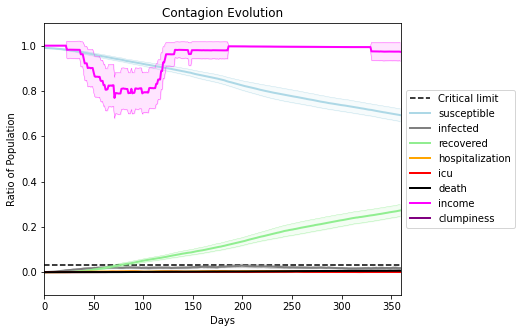

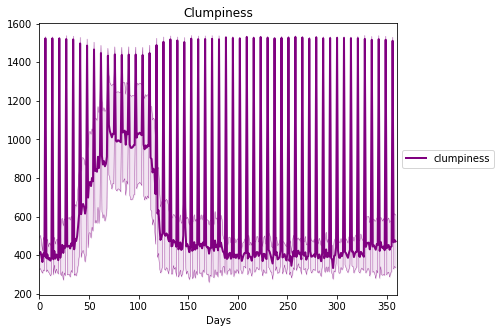

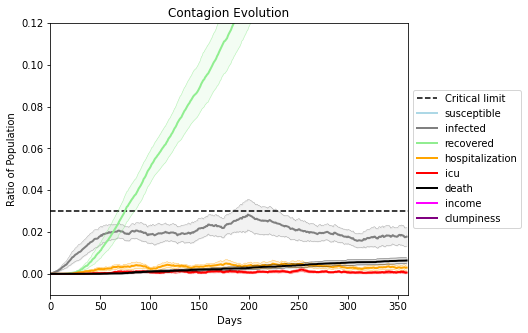

In [10]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.995
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5887, 6948, 8353, 8004, 4984, 2805, 8171, 4395, 2872, 5481, 5192, 9544, 2871, 4858, 7029, 5638, 1248, 8670, 3829, 8459]
Average similarity between family members is 0.934267819361464 at temperature -0.994
Average similarity between family and home is 0.9998459198713948 at temperature -1
Average similarity between students and their classroom is 0.8737309037305168 at temperature -0.994
Average classroom occupancy is 1.723756906077348 and number classrooms is 181
Average similarity between workers is 0.8853866276997236 at temperature -0.994
Average office occupancy is 3.3333333333333335 and number offices is 186
Average friend similarity for adults: 0.8440809973984437 for kids: 0.7375144675358458
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.4109466269500063
avg restaurant similarity 0.26729463050868263
avg restaurant similarity 0.5305083200193081
avg restaurant similarity 0.6311623039730688
avg restaurant similarity 0.47655233449620726
avg restaurant similarity 0.2986226867745145
avg restaurant similarity 0.7267448697717076
avg restaurant similarity 0.5858771755397375
avg restaurant similarity 0.7059960606065828
avg restaurant similarity 0.40829167542607797
avg restaurant similarity 0.43560774218569837
avg restaurant similarity 0.35624160302326435
avg restaurant similarity 0.6715948369158903
avg restaurant similarity 0.5124505214015712
avg restaurant similarity 0.7724974212184978
avg restaurant similarity 0.6314605016349736
avg restaurant similarity 0.4959170614344667
avg restaurant similarity 0.5785020192579169
avg restaurant similarity 0.5179120834700113
avg restaurant similarity 0.5118986837423481
avg restaurant similarity 0.4743488597993767
avg restaurant similarity 0.4591279005549165
avg r

avg restaurant similarity 0.5631426063534473
avg restaurant similarity 0.4439324692631599
avg restaurant similarity 0.6656159332183712
avg restaurant similarity 0.7195754268972023
avg restaurant similarity 0.41763618207877967
avg restaurant similarity 0.4625137657413936
avg restaurant similarity 0.4419112781299301
avg restaurant similarity 0.5126224429707428
avg restaurant similarity 0.39797071227810676
avg restaurant similarity 0.5459976150273353
avg restaurant similarity 0.522036973315072
avg restaurant similarity 0.560074423642086
avg restaurant similarity 0.5539219053542727
avg restaurant similarity 0.49723136502092613
avg restaurant similarity 0.7087923269497342
avg restaurant similarity 0.7763748235860498
avg restaurant similarity 0.6318110524530726
avg restaurant similarity 0.5571115475651327
avg restaurant similarity 0.3861333066732964
avg restaurant similarity 0.6933320504986628
avg restaurant similarity 0.45423466189084805
avg restaurant similarity 0.7157273335917642
avg rest

Average similarity between workers is 0.8915158122823927 at temperature -0.994
Average office occupancy is 3.3025641025641024 and number offices is 195
Average friend similarity for adults: 0.8464594190950183 for kids: 0.7366729786623512
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.535459228639636
avg restaurant similarity 0.5938526052461869
avg restaurant similarity 0.4992336647849719
avg restaurant similarity 0.4736043382269547
avg restaurant similarity 0.5882796700624877
avg restaurant similarity 0.5147294590689426
avg restaurant similarity 0.5543297164825628
avg restaurant similarity 0.5571641592430965
avg restaurant similarity 0.5584660548759264
avg restaurant similarity 0.493238935911903
avg restaurant similarity 0.4939283855312322
avg restaurant similarity 0.544836134978973
avg restaurant similarity 0.4599751713742341
avg restaurant similarity 0.5515327479427594
avg restaurant similarity 0.6400480829931994
avg restaurant similarity 0.4721260980697464
avg restaurant similarity 0.5896110027495416
avg restaurant similarity 0.4717384225175536
avg restaurant similarity 0.5325153721589017
avg restaurant similarity 0.45462804055380635
avg restaurant similarity 0.5444905193148821
avg restaurant similarity 0.5043640670038999
avg restaura

avg restaurant similarity 0.5172801376074586
avg restaurant similarity 0.5142942146674643
avg restaurant similarity 0.5022039662314632
avg restaurant similarity 0.43308016436208685
avg restaurant similarity 0.4378510234809065
avg restaurant similarity 0.5868380275781865
avg restaurant similarity 0.5315599178205116
avg restaurant similarity 0.525265464522843
avg restaurant similarity 0.48910606929015005
avg restaurant similarity 0.5195073556685024
avg restaurant similarity 0.6136397325619072
avg restaurant similarity 0.5262744896562587
avg restaurant similarity 0.7029530299808777
avg restaurant similarity 0.5888930697487615
avg restaurant similarity 0.5329439075692933
avg restaurant similarity 0.5022185271358521
avg restaurant similarity 0.5005348828411331
avg restaurant similarity 0.5177074475904453
avg restaurant similarity 0.49822968710958815
avg restaurant similarity 0.6337009227300632
avg restaurant similarity 0.5236101970955109
avg restaurant similarity 0.5427494487304712
avg rest

Average similarity between workers is 0.8876330948620281 at temperature -0.994
Average office occupancy is 3.3705583756345177 and number offices is 197
Average friend similarity for adults: 0.8560949261119992 for kids: 0.742608064669105
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 

avg restaurant similarity 0.6488254026322543
avg restaurant similarity 0.6023562168339767
avg restaurant similarity 0.5070874656504356
avg restaurant similarity 0.5652670891823363
avg restaurant similarity 0.5122868473137202
avg restaurant similarity 0.5650312167163445
avg restaurant similarity 0.7171207669755644
avg restaurant similarity 0.6056563233493455
avg restaurant similarity 0.5403237469512301
avg restaurant similarity 0.5368069732534724
avg restaurant similarity 0.6025420563981185
avg restaurant similarity 0.6112923264498603
avg restaurant similarity 0.6425760148146865
avg restaurant similarity 0.44582058480238
avg restaurant similarity 0.5767542885055226
avg restaurant similarity 0.5847618150074227
avg restaurant similarity 0.609254794885645
avg restaurant similarity 0.6462889855412429
avg restaurant similarity 0.613107881635381
avg restaurant similarity 0.4841072563786322
avg restaurant similarity 0.8277347366611209
avg restaurant similarity 0.597276321320079
avg restaurant 

avg restaurant similarity 0.5172666378891088
avg restaurant similarity 0.6326618412796163
avg restaurant similarity 0.7421936339648493
avg restaurant similarity 0.5712805115619141
avg restaurant similarity 0.5644407431245325
avg restaurant similarity 0.5482438664395289
avg restaurant similarity 0.657109110336357
avg restaurant similarity 0.6011141367988968
avg restaurant similarity 0.5726041883954528
avg restaurant similarity 0.5766683004448151
avg restaurant similarity 0.5635558280328324
avg restaurant similarity 0.5157041418413845
avg restaurant similarity 0.6154414606822207
avg restaurant similarity 0.7304018173654613
avg restaurant similarity 0.7721963957901425
avg restaurant similarity 0.6140633561068426
avg restaurant similarity 0.5885983613935668
avg restaurant similarity 0.6496194714486907
avg restaurant similarity 0.7067566168602611
avg restaurant similarity 0.7815218240397382
avg restaurant similarity 0.7262545623228365
avg restaurant similarity 0.6209931989196231
avg restaur

avg restaurant similarity 0.47443033265820095
avg restaurant similarity 0.6390292171443968
avg restaurant similarity 0.6048972089375376
avg restaurant similarity 0.6216042881785112
avg restaurant similarity 0.24286768985405235
avg restaurant similarity 0.7026007381552626
avg restaurant similarity 0.5329454083009828
avg restaurant similarity 0.39435520028103177
avg restaurant similarity 0.476733958372217
avg restaurant similarity 0.547047697936339
avg restaurant similarity 0.41829373263807934
avg restaurant similarity 0.5602636142047365
avg restaurant similarity 0.5639486170025877
avg restaurant similarity 0.5778909037302506
avg restaurant similarity 0.515604626653253
avg restaurant similarity 0.44185138736465723
avg restaurant similarity 0.7139494951239843
avg restaurant similarity 0.6454648616126957
avg restaurant similarity 0.612225279083277
avg restaurant similarity 0.5875444684946006
avg restaurant similarity 0.5467332433663553
avg restaurant similarity 0.6994957894789717
avg resta

avg restaurant similarity 0.8413254952017166
avg restaurant similarity 0.5800890820114724
avg restaurant similarity 0.6174998005149348
avg restaurant similarity 0.5588150644819588
avg restaurant similarity 0.5565795577708237
avg restaurant similarity 0.4235798710700358
avg restaurant similarity 0.4247530168111129
avg restaurant similarity 0.6784108845352352
avg restaurant similarity 0.6100748457249727
avg restaurant similarity 0.6154453638484098
avg restaurant similarity 0.4970293469097533
avg restaurant similarity 0.3603954005408897
avg restaurant similarity 0.743771572862773
avg restaurant similarity 0.6169671164906484
avg restaurant similarity 0.4794156535646774
avg restaurant similarity 0.6006326505260612
avg restaurant similarity 0.5946180003871955
avg restaurant similarity 0.7778819592076281
avg restaurant similarity 0.583253592711327
avg restaurant similarity 0.4929748959664128
avg restaurant similarity 0.6453841541270792
avg restaurant similarity 0.5120217604956855
avg restaura

Average similarity between workers is 0.8871493174007796 at temperature -0.994
Average office occupancy is 3.383419689119171 and number offices is 193
Average friend similarity for adults: 0.8476933258163902 for kids: 0.7330163724183155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6439997597711106
avg restaurant similarity 0.3589524663145201
avg restaurant similarity 0.5782328666238895
avg restaurant similarity 0.8428509254565159
avg restaurant similarity 0.6544663037380991
avg restaurant similarity 0.6220955186308541
avg restaurant similarity 0.66393202614845
avg restaurant similarity 0.5634464998404545
avg restaurant similarity 0.724816709933751
avg restaurant similarity 0.6033901173408995
avg restaurant similarity 0.3866055877295938
avg restaurant similarity 0.4424178284127519
avg restaurant similarity 0.7472180365121599
avg restaurant similarity 0.7261961317189982
avg restaurant similarity 0.6055303208593004
avg restaurant similarity 0.4790340088995804
avg restaurant similarity 0.8920462519610546
avg restaurant similarity 0.6058674863045161
avg restaurant similarity 0.6303420757172518
avg restaurant similarity 0.7628450402951923
avg restaurant similarity 0.5932022108908248
avg restaurant similarity 0.6570026390321088
avg restauran

avg restaurant similarity 0.5089605094064275
avg restaurant similarity 0.8548870344204702
avg restaurant similarity 0.5077851667624627
avg restaurant similarity 0.679764864702384
avg restaurant similarity 0.5222390069162747
avg restaurant similarity 0.5321722594557687
avg restaurant similarity 0.6820230727810311
avg restaurant similarity 0.4914142025332343
avg restaurant similarity 0.5091055464462715
avg restaurant similarity 0.38982453394199407
avg restaurant similarity 0.8681604764866804
avg restaurant similarity 0.7581453694451513
avg restaurant similarity 0.4069706030223972
avg restaurant similarity 0.529906317437621
avg restaurant similarity 0.3882932765937267
avg restaurant similarity 0.5360657726103893
avg restaurant similarity 0.7429254094582892
avg restaurant similarity 0.6729197185344233
avg restaurant similarity 0.8739716255951959
avg restaurant similarity 0.6008941810026555
avg restaurant similarity 0.6209328649504734
avg restaurant similarity 0.7550337413716293
avg restaur

avg restaurant similarity 0.8003130219680669
avg restaurant similarity 0.4599180187959677
avg restaurant similarity 0.639960095775613
avg restaurant similarity 0.7221295066424372
avg restaurant similarity 0.5683542495667852
avg restaurant similarity 0.518309304080961
avg restaurant similarity 0.6522544714184852
avg restaurant similarity 0.4734120153935112
avg restaurant similarity 0.6840431376643848
avg restaurant similarity 0.5300854413631876
avg restaurant similarity 0.5851839874323264
avg restaurant similarity 0.6277076167822447
avg restaurant similarity 0.5747901907068592
avg restaurant similarity 0.6176241401734284
avg restaurant similarity 0.7425877938130151
avg restaurant similarity 0.44277156275375257
avg restaurant similarity 0.5205911657653381
avg restaurant similarity 0.714905159245649
avg restaurant similarity 0.43559185461060584
avg restaurant similarity 0.5836386867996217
avg restaurant similarity 0.577808339328177
avg restaurant similarity 0.5430805799536048
avg restaura

avg restaurant similarity 0.7064620239139826
avg restaurant similarity 0.5135876251005018
avg restaurant similarity 0.5047660044747678
avg restaurant similarity 0.5960478871410033
avg restaurant similarity 0.5238750727864949
avg restaurant similarity 0.40181538766027425
avg restaurant similarity 0.5223344057467408
avg restaurant similarity 0.6931747607190197
avg restaurant similarity 0.5994486131391003
avg restaurant similarity 0.5425132962113747
avg restaurant similarity 0.577747549824808
avg restaurant similarity 0.6136754215575771
avg restaurant similarity 0.726635604944362
avg restaurant similarity 0.4200070948799905
avg restaurant similarity 0.5333386695192018
avg restaurant similarity 0.5366853607491894
avg restaurant similarity 0.5818179439167543
avg restaurant similarity 0.7699395764901409
avg restaurant similarity 0.5109428119664542
avg restaurant similarity 0.7446122678304078
avg restaurant similarity 0.5118407979251105
avg restaurant similarity 0.5858123709969508
avg restaur

avg restaurant similarity 0.6285184711722095
avg restaurant similarity 0.576205108724035
avg restaurant similarity 0.49125641934732683
avg restaurant similarity 0.5598549987293605
avg restaurant similarity 0.6171900677893637
avg restaurant similarity 0.570183168760052
avg restaurant similarity 0.5178811098995633
avg restaurant similarity 0.6395604502411928
avg restaurant similarity 0.5097373580393122
avg restaurant similarity 0.48564085293863896
avg restaurant similarity 0.5089560401297296
avg restaurant similarity 0.5833541041796777
avg restaurant similarity 0.5775337341569288
avg restaurant similarity 0.6368890273032597
avg restaurant similarity 0.5952187205951237
avg restaurant similarity 0.5787688876672885
avg restaurant similarity 0.5618971109429048
avg restaurant similarity 0.41542408959582866
avg restaurant similarity 0.5559893296622455
avg restaurant similarity 0.5751658351387416
avg restaurant similarity 0.4290540209066503
avg restaurant similarity 0.4988517071115926
avg resta

avg restaurant similarity 0.576721713729476
avg restaurant similarity 0.5030588843632707
avg restaurant similarity 0.6022542689252578
avg restaurant similarity 0.4711096663445073
avg restaurant similarity 0.6921681238571958
avg restaurant similarity 0.49217803164454654
avg restaurant similarity 0.2920316723341051
avg restaurant similarity 0.5347893786136374
avg restaurant similarity 0.5359554258709573
avg restaurant similarity 0.590102400606863
avg restaurant similarity 0.6568947041910727
avg restaurant similarity 0.4984134622786923
avg restaurant similarity 0.3568210666429167
avg restaurant similarity 0.5481338322210753
avg restaurant similarity 0.6742656507470817
avg restaurant similarity 0.4681721564478298
avg restaurant similarity 0.6561385749142554
avg restaurant similarity 0.5481256326384122
avg restaurant similarity 0.5505480692103046
avg restaurant similarity 0.7117781533385755
avg restaurant similarity 0.4485101927987216
avg restaurant similarity 0.6123108156259666
avg restaur

Average similarity between workers is 0.8864062474745743 at temperature -0.994
Average office occupancy is 3.4010416666666665 and number offices is 192
Average friend similarity for adults: 0.8469315927755869 for kids: 0.738829161825259
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5126820332166131
avg restaurant similarity 0.5172850935839551
avg restaurant similarity 0.6143646739171568
avg restaurant similarity 0.578954184037615
avg restaurant similarity 0.6184622817251191
avg restaurant similarity 0.509151543535434
avg restaurant similarity 0.5650977351111652
avg restaurant similarity 0.7180747235454047
avg restaurant similarity 0.4408486568035362
avg restaurant similarity 0.4660856213505962
avg restaurant similarity 0.4872983801682555
avg restaurant similarity 0.7111124071900891
avg restaurant similarity 0.7867494836729116
avg restaurant similarity 0.6462726506393329
avg restaurant similarity 0.6671682180702431
avg restaurant similarity 0.6688046843646153
avg restaurant similarity 0.5752969485616306
avg restaurant similarity 0.8047739531807335
avg restaurant similarity 0.5151042709951651
avg restaurant similarity 0.5590324755704005
avg restaurant similarity 0.8002607004285753
avg restaurant similarity 0.5591920725197682
avg restaura

avg restaurant similarity 0.4500197697381807
avg restaurant similarity 0.4207030853770583
avg restaurant similarity 0.6907002186199716
avg restaurant similarity 0.6262505629116748
avg restaurant similarity 0.5962882189999524
avg restaurant similarity 0.6355308240565731
avg restaurant similarity 0.5581450894986706
avg restaurant similarity 0.5755978731705286
avg restaurant similarity 0.5668565758947134
avg restaurant similarity 0.5870338167524436
avg restaurant similarity 0.502165868489695
avg restaurant similarity 0.5679735533451943
avg restaurant similarity 0.6096121781718883
avg restaurant similarity 0.5674972174411899
avg restaurant similarity 0.5531292024600332
avg restaurant similarity 0.39925196511475036
avg restaurant similarity 0.5043017812746204
avg restaurant similarity 0.43877046068165865
avg restaurant similarity 0.46900185599714433
avg restaurant similarity 0.6054616627446037
avg restaurant similarity 0.6510304117849085
avg restaurant similarity 0.4616285186218592
avg rest

Average friend similarity for adults: 0.854405871775717 for kids: 0.7313280486477828
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.5913050993472007
avg restaurant similarity 0.5955498391206889
avg restaurant similarity 0.7028704026604816
avg restaurant similarity 0.466820073791582
avg restaurant similarity 0.6188892845321249
avg restaurant similarity 0.6606519627682145
avg restaurant similarity 0.6975778012956747
avg restaurant similarity 0.6468981043396113
avg restaurant similarity 0.5652473617543117
avg restaurant similarity 0.7156874379862279
avg restaurant similarity 0.7345949216978831
avg restaurant similarity 0.6913258766512657
avg restaurant similarity 0.571055664506782
avg restaurant similarity 0.5662680365050622
avg restaurant similarity 0.6463760927406609
avg restaurant similarity 0.5652571569215186
avg restaurant similarity 0.5175881478837108
avg restaurant similarity 0.656495922859516
avg restaurant similarity 0.7034961583911857
avg restaurant similarity 0.5878243690867504
avg restaurant similarity 0.7511001672266094
avg restaurant similarity 0.5662499786789957
avg restauran

avg restaurant similarity 0.48906874245766047
avg restaurant similarity 0.4492034702108508
avg restaurant similarity 0.369866603237103
avg restaurant similarity 0.629706365409208
avg restaurant similarity 0.6521656357255116
avg restaurant similarity 0.27469215331331287
avg restaurant similarity 0.5744956037179507
avg restaurant similarity 0.7599229013569219
avg restaurant similarity 0.5649471932663206
avg restaurant similarity 0.44059542039955474
avg restaurant similarity 0.9998762908326648
avg restaurant similarity 0.5790635779643968
avg restaurant similarity 0.5182530963054314
avg restaurant similarity 0.6228796550460338
avg restaurant similarity 0.37781441876408106
avg restaurant similarity 0.8286022762832257
avg restaurant similarity 0.5986139023493647
avg restaurant similarity 0.5965752397947529
avg restaurant similarity 0.4828357446970109
avg restaurant similarity 0.5999548563658419
avg restaurant similarity 0.5483390766940277
avg restaurant similarity 0.49898045429928384
avg res

Average similarity between workers is 0.9067519263204344 at temperature -0.994
Average office occupancy is 3.3854166666666665 and number offices is 192
Average friend similarity for adults: 0.8548171361604545 for kids: 0.7328009764065246
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 

avg restaurant similarity 0.4741169803763458
avg restaurant similarity 0.7032363450640889
avg restaurant similarity 0.5197962648523924
avg restaurant similarity 0.6371399514095305
avg restaurant similarity 0.4776543348074474
avg restaurant similarity 0.5943077644888698
avg restaurant similarity 0.6230152902836613
avg restaurant similarity 0.6041667905265306
avg restaurant similarity 0.5390739398849955
avg restaurant similarity 0.6442572264638605
avg restaurant similarity 0.5695506523788345
avg restaurant similarity 0.817953311675184
avg restaurant similarity 0.7480482188625293
avg restaurant similarity 0.6078335477019076
avg restaurant similarity 0.3722803411725333
avg restaurant similarity 0.8271227077489509
avg restaurant similarity 0.8051697336587915
avg restaurant similarity 0.5589335993966668
avg restaurant similarity 0.6913175689318034
avg restaurant similarity 0.7198979011095734
avg restaurant similarity 0.5876166372737228
avg restaurant similarity 0.6693701760955056
avg restaur

avg restaurant similarity 0.5680128318821523
avg restaurant similarity 0.715169520236639
avg restaurant similarity 0.5677391680086852
avg restaurant similarity 0.5052368439493066
avg restaurant similarity 0.5293959428706113
avg restaurant similarity 0.5723442537687223
avg restaurant similarity 0.40414631281654456
avg restaurant similarity 0.4814261490664179
avg restaurant similarity 0.6823070091090901
avg restaurant similarity 0.7228001041134452
avg restaurant similarity 0.7270628979774032
avg restaurant similarity 0.4671307245993301
avg restaurant similarity 0.7200176153699084
avg restaurant similarity 0.42643117482996873
avg restaurant similarity 0.683324917397082
avg restaurant similarity 0.5780789108557223
avg restaurant similarity 0.7118714190881459
avg restaurant similarity 0.46008128880360954
avg restaurant similarity 0.6206252652716512
avg restaurant similarity 0.6161364618339445
avg restaurant similarity 0.6569834712759836
avg restaurant similarity 0.5948404887673538
avg resta

avg restaurant similarity 0.46033605950754375
avg restaurant similarity 0.6463184183156954
avg restaurant similarity 0.5017975289298465
avg restaurant similarity 0.6578767426697261
avg restaurant similarity 0.5481993477143215
avg restaurant similarity 0.56466148616792
avg restaurant similarity 0.5568123319674632
avg restaurant similarity 0.7414493469022284
avg restaurant similarity 0.3953245313656686
avg restaurant similarity 0.46250661993019265
avg restaurant similarity 0.7037207679445017
avg restaurant similarity 0.621418637312995
avg restaurant similarity 0.3382014687566482
avg restaurant similarity 0.6118265835004417
avg restaurant similarity 0.8282875428177486
avg restaurant similarity 0.7804143553223505
avg restaurant similarity 0.5327262291404786
avg restaurant similarity 0.6045711258677328
avg restaurant similarity 0.561456220658988
avg restaurant similarity 0.6077469445453534
avg restaurant similarity 0.6100820119948532
avg restaurant similarity 0.6598027410633153
avg restaura

avg restaurant similarity 0.6356915684705976
avg restaurant similarity 0.4851406412681811
avg restaurant similarity 0.6031118166731424
avg restaurant similarity 0.38215690101862326
avg restaurant similarity 0.42468777863520213
avg restaurant similarity 0.435416425799177
avg restaurant similarity 0.4540844227254903
avg restaurant similarity 0.5640228390577228
avg restaurant similarity 0.6835655072251761
avg restaurant similarity 0.5343375258588052
avg restaurant similarity 0.5706191950043588
avg restaurant similarity 0.9213889870823265
avg restaurant similarity 0.5818691380942165
avg restaurant similarity 0.4630932749762989
avg restaurant similarity 0.6760780561130044
avg restaurant similarity 0.7223198092393628
avg restaurant similarity 0.6804040059165251
avg restaurant similarity 0.3440136709899079
avg restaurant similarity 0.5737956495924849
avg restaurant similarity 0.574053297652802
avg restaurant similarity 0.5742457731173812
avg restaurant similarity 0.42433502252307354
avg resta

Average friend similarity for adults: 0.8485777890893775 for kids: 0.7339045403123126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.6334751402178401
avg restaurant similarity 0.7716135089311811
avg restaurant similarity 0.573376698688991
avg restaurant similarity 0.5357165095427089
avg restaurant similarity 0.8422956042181735
avg restaurant similarity 0.6630932043912123
avg restaurant similarity 0.5436883985612312
avg restaurant similarity 0.9996267279528899
avg restaurant similarity 0.599473234283935
avg restaurant similarity 0.5129141570945869
avg restaurant similarity 0.5670719681661821
avg restaurant similarity 0.5606978146662455
avg restaurant similarity 0.5880003164248055
avg restaurant similarity 0.6154110239711365
avg restaurant similarity 0.6699250297590804
avg restaurant similarity 0.45830355101186027
avg restaurant similarity 0.8478168655418558
avg restaurant similarity 0.34504975727185216
avg restaurant similarity 0.6167983094776287
avg restaurant similarity 0.7929432989779743
avg restaurant similarity 0.7415247252416379
avg restaurant similarity 0.5197352868351353
avg restau

avg restaurant similarity 0.7762352478224414
avg restaurant similarity 0.4675986690230565
avg restaurant similarity 0.6527410914546867
avg restaurant similarity 0.5384061869370198
avg restaurant similarity 0.6657863634294893
avg restaurant similarity 0.5441551449544167
avg restaurant similarity 0.40684206512405374
avg restaurant similarity 0.5475061316994437
avg restaurant similarity 0.488375743107124
avg restaurant similarity 0.8085401332907819
avg restaurant similarity 0.4991290945066457
avg restaurant similarity 0.72401271484231
avg restaurant similarity 0.8148859620850102
avg restaurant similarity 0.5621012522369137
avg restaurant similarity 0.9996575178613343
avg restaurant similarity 0.5357631962011568
avg restaurant similarity 0.7176320478767522
avg restaurant similarity 0.5890399038558944
avg restaurant similarity 0.7469210177891822
avg restaurant similarity 0.999832163766025
avg restaurant similarity 0.6051166974489907
avg restaurant similarity 0.3384370478229445
avg restauran

avg restaurant similarity 0.44095519104695735
avg restaurant similarity 0.5832668717780901
avg restaurant similarity 0.5945034973537894
avg restaurant similarity 0.557180659227124
avg restaurant similarity 0.5233085137760501
avg restaurant similarity 0.6978967401304617
avg restaurant similarity 0.4896692541346014
avg restaurant similarity 0.5768395740953236
avg restaurant similarity 0.5298851340413951
avg restaurant similarity 0.5509642526670518
avg restaurant similarity 0.6207426092136713
avg restaurant similarity 0.5500384253737021
avg restaurant similarity 0.46853269239972734
avg restaurant similarity 0.5806152064730566
avg restaurant similarity 0.632602666699208
avg restaurant similarity 0.5559984693611371
avg restaurant similarity 0.575872018538663
avg restaurant similarity 0.5466287471617227
avg restaurant similarity 0.5100886090859156
avg restaurant similarity 0.47189681103954345
avg restaurant similarity 0.39179444676832104
avg restaurant similarity 0.6497195610613485
avg resta

avg restaurant similarity 0.5091803709912116
avg restaurant similarity 0.39851385477084816
avg restaurant similarity 0.4662248756714509
avg restaurant similarity 0.41516347188888336
avg restaurant similarity 0.6127879719189511
avg restaurant similarity 0.4970729689478733
avg restaurant similarity 0.4874066333663187
avg restaurant similarity 0.48131558614146314
avg restaurant similarity 0.6980485817535257
avg restaurant similarity 0.4668695309781576
avg restaurant similarity 0.5256241013455435
avg restaurant similarity 0.6011391969009637
avg restaurant similarity 0.5643935120138549
avg restaurant similarity 0.5269215160834686
avg restaurant similarity 0.3578082362779629
avg restaurant similarity 0.5063377281883549
avg restaurant similarity 0.6704284337258279
avg restaurant similarity 0.6201117440638749
avg restaurant similarity 0.46598998885129717
avg restaurant similarity 0.4091719520496249
avg restaurant similarity 0.5742042502958896
avg restaurant similarity 0.739570113984483
avg res

Average similarity between workers is 0.8786259943777729 at temperature -0.994
Average office occupancy is 3.3857868020304567 and number offices is 197
Average friend similarity for adults: 0.8443501671465964 for kids: 0.7188852115737792
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.5265379669664617
avg restaurant similarity 0.37723738193448353
avg restaurant similarity 0.45070338623993333
avg restaurant similarity 0.48796623378337234
avg restaurant similarity 0.5036016560385995
avg restaurant similarity 0.5918098842173508
avg restaurant similarity 0.5689528725450888
avg restaurant similarity 0.6465244937946568
avg restaurant similarity 0.4136435277232411
avg restaurant similarity 0.47166521391496286
avg restaurant similarity 0.6279845511760075
avg restaurant similarity 0.608468090458498
avg restaurant similarity 0.4278300097174139
avg restaurant similarity 0.5188120350826433
avg restaurant similarity 0.5637079156449815
avg restaurant similarity 0.5943258936630996
avg restaurant similarity 0.4877352340769549
avg restaurant similarity 0.46047062894251345
avg restaurant similarity 0.4494663448521896
avg restaurant similarity 0.46289460510251706
avg restaurant similarity 0.6289776349076828
avg restaurant similarity 0.4686496947798461
avg r

avg restaurant similarity 0.5110451340342019
avg restaurant similarity 0.2950923778980062
avg restaurant similarity 0.6818787449228099
avg restaurant similarity 0.4280954496619701
avg restaurant similarity 0.6583192246464362
avg restaurant similarity 0.6792999492576877
avg restaurant similarity 0.5160434931988196
avg restaurant similarity 0.5147926717518649
avg restaurant similarity 0.5573579681105046
avg restaurant similarity 0.4853715266340929
avg restaurant similarity 0.46159328912491177
avg restaurant similarity 0.5403481655882039
avg restaurant similarity 0.5364702751336136
avg restaurant similarity 0.41820682246920365
avg restaurant similarity 0.6459873331721946
avg restaurant similarity 0.4932718659174328
avg restaurant similarity 0.3154599736387932
avg restaurant similarity 0.4666067186714021
avg restaurant similarity 0.6877356928513766
avg restaurant similarity 0.4246855846865041
avg restaurant similarity 0.49683662065332884
avg restaurant similarity 0.4704647366128431
avg res

avg restaurant similarity 0.5348765793326716
avg restaurant similarity 0.43683309278693583
avg restaurant similarity 0.6559866944066033
avg restaurant similarity 0.5549720185974935
avg restaurant similarity 0.461236035516709
avg restaurant similarity 0.6358230554898948
avg restaurant similarity 0.558558248464872
avg restaurant similarity 0.5345489416857545
avg restaurant similarity 0.5376189504663613
avg restaurant similarity 0.5946217356390108
avg restaurant similarity 0.6285563384116426
avg restaurant similarity 0.7257144927434409
avg restaurant similarity 0.5290057586748871
avg restaurant similarity 0.46252177492899893
avg restaurant similarity 0.6717877516338538
avg restaurant similarity 0.6305257381415209
avg restaurant similarity 0.5319030638956519
avg restaurant similarity 0.5202106406146603
avg restaurant similarity 0.5687792304103251
avg restaurant similarity 0.6027001353603397
avg restaurant similarity 0.5169995628602615
avg restaurant similarity 0.6400697068646953
avg restau

avg restaurant similarity 0.5467076322099581
avg restaurant similarity 0.6188476782353526
avg restaurant similarity 0.6106615272150239
avg restaurant similarity 0.5499629476143251
avg restaurant similarity 0.43798760257113295
avg restaurant similarity 0.5439175430090334
avg restaurant similarity 0.5791059136380806
avg restaurant similarity 0.5878719181683418
avg restaurant similarity 0.5265110914459751
avg restaurant similarity 0.4477603307034243
avg restaurant similarity 0.5324740963214413
avg restaurant similarity 0.5933121826569756
avg restaurant similarity 0.5622695989248221
avg restaurant similarity 0.508115929359436
avg restaurant similarity 0.714095949591975
avg restaurant similarity 0.6056463940392208
avg restaurant similarity 0.8041417252926986
avg restaurant similarity 0.8482333130778849
avg restaurant similarity 0.6667333865737451
avg restaurant similarity 0.595807731620368
avg restaurant similarity 0.4607140853765772
avg restaurant similarity 0.6563324120974195
avg restaura

Average similarity between workers is 0.8878918330399097 at temperature -0.994
Average office occupancy is 3.393782383419689 and number offices is 193
Average friend similarity for adults: 0.8481117296796223 for kids: 0.733991363428294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 p

avg restaurant similarity 0.6935474310621513
avg restaurant similarity 0.6398867406520039
avg restaurant similarity 0.32527698937086313
avg restaurant similarity 0.5603719854103489
avg restaurant similarity 0.2819402121493926
avg restaurant similarity 0.587574082982219
avg restaurant similarity 0.6743661105053359
avg restaurant similarity 0.9998523827344135
avg restaurant similarity 0.42128731633198474
avg restaurant similarity 0.6663368724337042
avg restaurant similarity 0.6121968354822894
avg restaurant similarity 0.41279645452647806
avg restaurant similarity 0.5688020476466964
avg restaurant similarity 0.5159861483893546
avg restaurant similarity 0.5997997436980175
avg restaurant similarity 0.5474922820887924
avg restaurant similarity 0.5758025893815533
avg restaurant similarity 0.6541177471496102
avg restaurant similarity 0.6093649984979378
avg restaurant similarity 0.6849361081443094
avg restaurant similarity 0.49899161631607075
avg restaurant similarity 0.6881835019772922
avg res

avg restaurant similarity 0.5177823292429515
avg restaurant similarity 0.5261687477885532
avg restaurant similarity 0.6442759456985231
avg restaurant similarity 0.551295502999651
avg restaurant similarity 0.4172099027803265
avg restaurant similarity 0.6037483668555428
avg restaurant similarity 0.7358101807896614
avg restaurant similarity 0.6263917829938984
avg restaurant similarity 0.5211644606824971
avg restaurant similarity 0.5164206937031607
avg restaurant similarity 0.5240489361397329
avg restaurant similarity 0.6562818778443958
avg restaurant similarity 0.7375577777869784
avg restaurant similarity 0.6496039471727841
avg restaurant similarity 0.5152656278415105
avg restaurant similarity 0.3987156785055056
avg restaurant similarity 0.5406392069690601
avg restaurant similarity 0.40055590265625185
avg restaurant similarity 0.35731863759578064
avg restaurant similarity 0.697388291006437
avg restaurant similarity 0.6206839705408451
avg restaurant similarity 0.5065194074257013
avg restau

avg restaurant similarity 0.4639815236170177
avg restaurant similarity 0.47906627339954433
avg restaurant similarity 0.5157003678896742
avg restaurant similarity 0.6132448104858976
avg restaurant similarity 0.5614288749944473
avg restaurant similarity 0.44003366626844354
avg restaurant similarity 0.4192938445752222
avg restaurant similarity 0.6711171327661059
avg restaurant similarity 0.5409284417732348
avg restaurant similarity 0.43702296043663225
avg restaurant similarity 0.5235786739354159
avg restaurant similarity 0.4625321916903445
avg restaurant similarity 0.5368688546811695
avg restaurant similarity 0.5908900685043597
avg restaurant similarity 0.5092227704360981
avg restaurant similarity 0.579463497049903
avg restaurant similarity 0.5275645497980802
avg restaurant similarity 0.539824316949068
avg restaurant similarity 0.5218189705800129
avg restaurant similarity 0.5008951666140705
avg restaurant similarity 0.641417766396165
avg restaurant similarity 0.6337710128469711
avg restau

avg restaurant similarity 0.44141902936044486
avg restaurant similarity 0.7963307684425971
avg restaurant similarity 0.5499043906764347
avg restaurant similarity 0.8459561475057678
avg restaurant similarity 0.6637601474623182
avg restaurant similarity 0.5007826188950643
avg restaurant similarity 0.5523009043046722
avg restaurant similarity 0.5512507437890714
avg restaurant similarity 0.5525731683378077
avg restaurant similarity 0.5671095640320168
avg restaurant similarity 0.4228401754062778
avg restaurant similarity 0.7727233309291818
avg restaurant similarity 0.29727404644810884
avg restaurant similarity 0.6825710529394305
avg restaurant similarity 0.5352993759449719
avg restaurant similarity 0.6605910226001839
avg restaurant similarity 0.5341766804673311
avg restaurant similarity 0.44811246059759846
avg restaurant similarity 0.4992003725621777
avg restaurant similarity 0.4784544816841427
avg restaurant similarity 0.6270019020973202
avg restaurant similarity 0.7074138097014457
avg res

Average friend similarity for adults: 0.8623771627419331 for kids: 0.7337639740367348
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.4768739318222657
avg restaurant similarity 0.5367925421197777
avg restaurant similarity 0.4338670203303038
avg restaurant similarity 0.7477011095818539
avg restaurant similarity 0.481179605919954
avg restaurant similarity 0.5844882215320351
avg restaurant similarity 0.6737286177489177
avg restaurant similarity 0.44225126057350117
avg restaurant similarity 0.470583622124941
avg restaurant similarity 0.4784850714611446
avg restaurant similarity 0.4882379300622867
avg restaurant similarity 0.4233639974565292
avg restaurant similarity 0.39497224158537514
avg restaurant similarity 0.5215468572082266
avg restaurant similarity 0.4941480047471721
avg restaurant similarity 0.5545167820468291
avg restaurant similarity 0.6625471357620958
avg restaurant similarity 0.5388887401613505
avg restaurant similarity 0.5704754974677713
avg restaurant similarity 0.462846962914367
avg restaurant similarity 0.5107510164492884
avg restaurant similarity 0.5203415104332032
avg restaur

avg restaurant similarity 0.7756491324773541
avg restaurant similarity 0.4815219777606846
avg restaurant similarity 0.6309709886456537
avg restaurant similarity 0.4735159674422748
avg restaurant similarity 0.630826677811117
avg restaurant similarity 0.5115548341864682
avg restaurant similarity 0.6816172377497817
avg restaurant similarity 0.3678882625433182
avg restaurant similarity 0.7389052360696295
avg restaurant similarity 0.6733751437729429
avg restaurant similarity 0.4762667919937542
avg restaurant similarity 0.4987796795470517
avg restaurant similarity 0.9985588449273366
avg restaurant similarity 0.30106365890325504
avg restaurant similarity 0.5564727207354662
avg restaurant similarity 0.4577788119528079
avg restaurant similarity 0.47076602135062146
avg restaurant similarity 0.45421107269574135
avg restaurant similarity 0.4839343468251697
avg restaurant similarity 0.47429477744741105
avg restaurant similarity 0.2905449673127489
avg restaurant similarity 0.7550764250814935
avg res

avg restaurant similarity 0.4491123182684111
avg restaurant similarity 0.5489615146772542
avg restaurant similarity 0.5192388772601194
avg restaurant similarity 0.6471911143101541
avg restaurant similarity 0.5906122974768239
avg restaurant similarity 0.7095324241968569
avg restaurant similarity 0.7750584521209624
avg restaurant similarity 0.4952676035184759
avg restaurant similarity 0.6474529720909632
avg restaurant similarity 0.520234177682591
avg restaurant similarity 0.6797917299663084
avg restaurant similarity 0.44918025432578995
avg restaurant similarity 0.6234010256598033
avg restaurant similarity 0.7766823677729496
avg restaurant similarity 0.6681863452891077
avg restaurant similarity 0.7425393686724551
avg restaurant similarity 0.5637107499877702
avg restaurant similarity 0.5656905773666872
avg restaurant similarity 0.5585544899746536
avg restaurant similarity 0.5141217984977778
avg restaurant similarity 0.6089541900100832
avg restaurant similarity 0.5748007131390065
avg restau

avg restaurant similarity 0.4612123651302669
avg restaurant similarity 0.6268025771118471
avg restaurant similarity 0.9574512268590724
avg restaurant similarity 0.580055123988304
avg restaurant similarity 0.550931538659059
avg restaurant similarity 0.6418024013479937
avg restaurant similarity 0.5870854615016468
avg restaurant similarity 0.5086683728287058
avg restaurant similarity 0.74021640729701
avg restaurant similarity 0.6421006707052528
avg restaurant similarity 0.6143470499019257
avg restaurant similarity 0.5954769603638053
avg restaurant similarity 0.48482509263951634
avg restaurant similarity 0.7145633188329914
avg restaurant similarity 0.9137740374282932
avg restaurant similarity 0.6688229050499171
avg restaurant similarity 0.6335986874086612
avg restaurant similarity 0.824366534130881
avg restaurant similarity 0.48216184965376446
avg restaurant similarity 0.5478977443619493
avg restaurant similarity 0.532717495969405
avg restaurant similarity 0.5572802141767265
avg restaurant

Average similarity between workers is 0.8847258519505435 at temperature -0.994
Average office occupancy is 3.402061855670103 and number offices is 194
Average friend similarity for adults: 0.852459205172883 for kids: 0.7326101061422471
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity 0.5212263446458678
avg restaurant similarity 0.5879621014786285
avg restaurant similarity 0.532907758836972
avg restaurant similarity 0.4869203447695325
avg restaurant similarity 0.5959247202695518
avg restaurant similarity 0.46786495981787024
avg restaurant similarity 0.5165851642266988
avg restaurant similarity 0.5240676922055211
avg restaurant similarity 0.5688897620192327
avg restaurant similarity 0.6245853439610652
avg restaurant similarity 0.5855038318666185
avg restaurant similarity 0.5819899013465487
avg restaurant similarity 0.6115260647684028
avg restaurant similarity 0.4520854935060505
avg restaurant similarity 0.6352420482600226
avg restaurant similarity 0.4818566565300551
avg restaurant similarity 0.58090187426638
avg restaurant similarity 0.5317933955283168
avg restaurant similarity 0.4960171752364806
avg restaurant similarity 0.4846610142395676
avg restaurant similarity 0.6102106317543606
avg restaurant similarity 0.5319776598025515
avg restaura

avg restaurant similarity 0.49085142677832005
avg restaurant similarity 0.45498473305785264
avg restaurant similarity 0.598582723093248
avg restaurant similarity 0.4968810976828875
avg restaurant similarity 0.6303267412331504
avg restaurant similarity 0.6670523663509962
avg restaurant similarity 0.4525456333229739
avg restaurant similarity 0.5333880522130326
avg restaurant similarity 0.6146342959423667
avg restaurant similarity 0.534910632699356
avg restaurant similarity 0.6994408900728927
avg restaurant similarity 0.507999353277191
avg restaurant similarity 0.4531792894687129
avg restaurant similarity 0.8112770475069221
avg restaurant similarity 0.5943225841172728
avg restaurant similarity 0.505029158397931
avg restaurant similarity 0.5432800746729816
avg restaurant similarity 0.6134765907278873
avg restaurant similarity 0.38422003155571804
avg restaurant similarity 0.4757900041938433
avg restaurant similarity 0.6125745957500061
avg restaurant similarity 0.4679106772527854
avg restaur

mean:
0.013298901098901101
median:
0.014
95% confidence interval for the mean:
(0.009910674743276598,0.016687127454525604)
using last of time series:
stats on recovered:
data: [0.212, 0.402, 0.433, 0.3116883116883117, 0.269, 0.303, 0.312, 0.202, 0.309, 0.419, 0.36, 0.322, 0.37, 0.21, 0.279, 0.155, 0.336, 0.284, 0.311, 0.302]
min:
0.155
max:
0.433
std:
0.07093785695713614
mean:
0.30508441558441557
median:
0.31
95% confidence interval for the mean:
(0.2710219968629449,0.3391468343058862)
using last of time series:
stats on hospitalization:
data: [0.002, 0.002, 0.004, 0.004995004995004995, 0.0, 0.006, 0.001, 0.001, 0.005, 0.007, 0.005, 0.0, 0.0, 0.001, 0.004, 0.0, 0.002, 0.0, 0.004, 0.002]
min:
0.0
max:
0.007
std:
0.002201426221544747
mean:
0.0025497502497502504
median:
0.002
95% confidence interval for the mean:
(0.0014926855883806228,0.003606814911119878)
using last of time series:
stats on icu:
data: [0.0, 0.001, 0.001, 0.001998001998001998, 0.0, 0.001, 0.0, 0.001, 0.001, 0.002, 0.002,

(<function dict.items>, <function dict.items>, <function dict.items>)

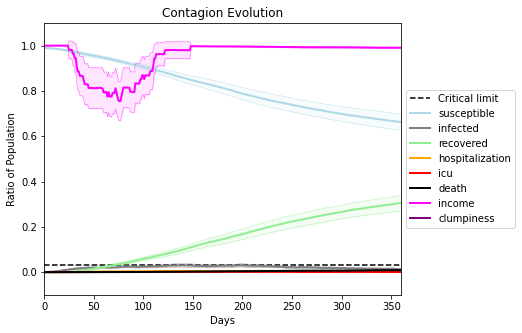

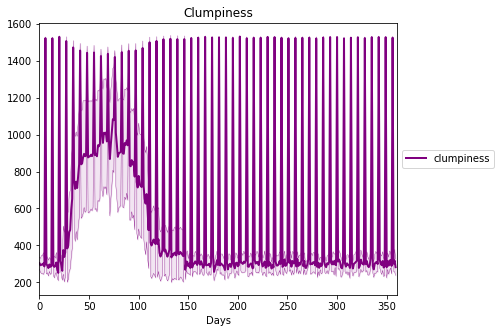

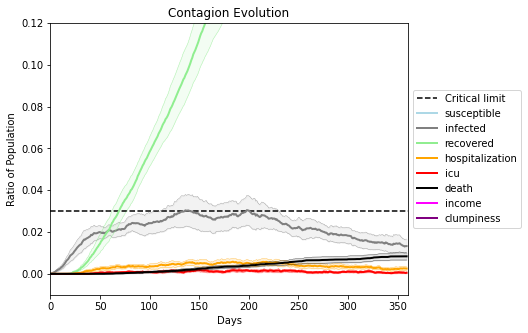

In [11]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.994
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[145, 701, 3271, 4366, 9637, 6139, 5463, 8095, 4340, 5036, 3654, 6633, 1319, 7260, 2813, 6574, 1908, 2818, 7276, 6103]
Average similarity between family members is 0.9367257216935541 at temperature -0.993
Average similarity between family and home is 0.9998573714789042 at temperature -1
Average similarity between students and their classroom is 0.8457565640089051 at temperature -0.993
Average classroom occupancy is 1.6724137931034482 and number classrooms is 174
Average similarity between workers is 0.8690780373405719 at temperature -0.993
Average office occupancy is 3.389473684210526 and number offices is 190
Average friend similarity for adults: 0.8486365320811952 for kids: 0.7284489402364467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.5839006116018185
avg restaurant similarity 0.596464194265529
avg restaurant similarity 0.5315528176407757
avg restaurant similarity 0.6267770923919683
avg restaurant similarity 0.5098748124310786
avg restaurant similarity 0.6150903024460669
avg restaurant similarity 0.4781950958728497
avg restaurant similarity 0.5590428607140018
avg restaurant similarity 0.5787306130737296
avg restaurant similarity 0.6117367912881891
avg restaurant similarity 0.5431385357463242
avg restaurant similarity 0.5010057026365244
avg restaurant similarity 0.5079625021220421
avg restaurant similarity 0.625992545679365
avg restaurant similarity 0.4931513237640231
avg restaurant similarity 0.560670287042241
avg restaurant similarity 0.5486086807994918
avg restaurant similarity 0.4969384828763137
avg restaurant similarity 0.6362994067252458
avg restaurant similarity 0.6105592114664279
avg restaurant similarity 0.4032467671540999
avg restaurant similarity 0.48044878703948235
avg restaura

avg restaurant similarity 0.37960517403514943
avg restaurant similarity 0.48995429646301986
avg restaurant similarity 0.6205322404294684
avg restaurant similarity 0.6211547231234942
avg restaurant similarity 0.5305637411250503
avg restaurant similarity 0.4697863948066924
avg restaurant similarity 0.5759125394562963
avg restaurant similarity 0.5665575461600264
avg restaurant similarity 0.6366968669818489
avg restaurant similarity 0.5045199089663628
avg restaurant similarity 0.555444843605018
avg restaurant similarity 0.50733737062787
avg restaurant similarity 0.5116731930213266
avg restaurant similarity 0.5500011357500968
avg restaurant similarity 0.5711617492384782
avg restaurant similarity 0.6704435771897164
avg restaurant similarity 0.487403462956312
avg restaurant similarity 0.6077969629660386
avg restaurant similarity 0.5189110197338799
avg restaurant similarity 0.5219414042130182
avg restaurant similarity 0.6749922388643206
avg restaurant similarity 0.5025476510043648
avg restaura

Average similarity between workers is 0.8698711021361336 at temperature -0.993
Average office occupancy is 3.316326530612245 and number offices is 196
Average friend similarity for adults: 0.841425420683732 for kids: 0.7299161506379678
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11

avg restaurant similarity 0.5392702738454589
avg restaurant similarity 0.412446120902417
avg restaurant similarity 0.45585110450401645
avg restaurant similarity 0.5767653006350039
avg restaurant similarity 0.5103375613670869
avg restaurant similarity 0.5364481828136308
avg restaurant similarity 0.5825314498955785
avg restaurant similarity 0.6017194015737973
avg restaurant similarity 0.5559382785621748
avg restaurant similarity 0.6306979956047342
avg restaurant similarity 0.5535733052017059
avg restaurant similarity 0.5441412247232424
avg restaurant similarity 0.547564940965981
avg restaurant similarity 0.7652938066268473
avg restaurant similarity 0.4868713013315011
avg restaurant similarity 0.5017112959064984
avg restaurant similarity 0.6085585585056774
avg restaurant similarity 0.7847032657175159
avg restaurant similarity 0.8311600101083623
avg restaurant similarity 0.4357373880092649
avg restaurant similarity 0.6374006984599477
avg restaurant similarity 0.4997363963917908
avg restaur

avg restaurant similarity 0.6229544249922983
avg restaurant similarity 0.5118482124789374
avg restaurant similarity 0.4316980231813835
avg restaurant similarity 0.9999376072381558
avg restaurant similarity 0.6317296630371605
avg restaurant similarity 0.6660731131753717
avg restaurant similarity 0.5373760120956913
avg restaurant similarity 0.6094102671611867
avg restaurant similarity 0.5319663861972194
avg restaurant similarity 0.6111711498058582
avg restaurant similarity 0.5703593844017051
avg restaurant similarity 0.5481660524473553
avg restaurant similarity 0.49995996472896603
avg restaurant similarity 0.522520569483323
avg restaurant similarity 0.6720478246566675
avg restaurant similarity 0.5702903240094158
avg restaurant similarity 0.5329136874756348
avg restaurant similarity 0.6258728962732694
avg restaurant similarity 0.6185515147325077
avg restaurant similarity 0.49679559541169277
avg restaurant similarity 0.5301014690286591
avg restaurant similarity 0.5086923641856502
avg resta

avg restaurant similarity 0.47208105972954295
avg restaurant similarity 0.4986264977044342
avg restaurant similarity 0.6334369312927296
avg restaurant similarity 0.5807745308015035
avg restaurant similarity 0.5712042031927008
avg restaurant similarity 0.6946197156998257
avg restaurant similarity 0.5197303304219296
avg restaurant similarity 0.6003671722449573
avg restaurant similarity 0.6466749151956319
avg restaurant similarity 0.6316942084846753
avg restaurant similarity 0.5693089001579296
avg restaurant similarity 0.6287295143657959
avg restaurant similarity 0.5578902987043446
avg restaurant similarity 0.5497520590706506
avg restaurant similarity 0.4397977122223248
avg restaurant similarity 0.7537795420512616
avg restaurant similarity 0.4417424243155853
avg restaurant similarity 0.6688780633894553
avg restaurant similarity 0.5306670971818602
avg restaurant similarity 0.5685998340307106
avg restaurant similarity 0.5001638922632771
avg restaurant similarity 0.5284626570237129
avg resta

avg restaurant similarity 0.5822715192049587
avg restaurant similarity 0.6142656031480336
avg restaurant similarity 0.4986106618191688
avg restaurant similarity 0.6616079223945773
avg restaurant similarity 0.6722557383779274
avg restaurant similarity 0.6765604198307829
avg restaurant similarity 0.5205909494770503
avg restaurant similarity 0.6531067575879185
avg restaurant similarity 0.3786388705222424
avg restaurant similarity 0.423363332519076
avg restaurant similarity 0.5786406492224119
avg restaurant similarity 0.5445692841587331
avg restaurant similarity 0.5685761845325016
avg restaurant similarity 0.5469826235897813
avg restaurant similarity 0.6304347544838813
avg restaurant similarity 0.45930531699307686
avg restaurant similarity 0.7466809768579864
avg restaurant similarity 0.5270119135746414
avg restaurant similarity 0.6488162840326075
avg restaurant similarity 0.6245755270036726
avg restaurant similarity 0.4008535932929741
avg restaurant similarity 0.5474122160101558
avg restau

avg restaurant similarity 0.4371490097237221
avg restaurant similarity 0.467716441653347
avg restaurant similarity 0.535543663545528
avg restaurant similarity 0.5632081598378426
avg restaurant similarity 0.6606232519172307
avg restaurant similarity 0.6516233658437394
avg restaurant similarity 0.7265534712431991
avg restaurant similarity 0.6391447409559471
avg restaurant similarity 0.3976208123191311
avg restaurant similarity 0.4618770683760811
avg restaurant similarity 0.5675778568602845
avg restaurant similarity 0.5002338304952931
avg restaurant similarity 0.6962933198392477
avg restaurant similarity 0.15304321303552376
avg restaurant similarity 0.6139053612267544
avg restaurant similarity 0.4756982479481275
avg restaurant similarity 0.48821961169307077
avg restaurant similarity 0.4645058494788143
avg restaurant similarity 0.6213534418065882
avg restaurant similarity 0.655368165894776
avg restaurant similarity 0.673170760236165
avg restaurant similarity 0.29169637802472337
avg restaur

avg restaurant similarity 0.3475928477511943
avg restaurant similarity 0.5222951111204857
avg restaurant similarity 0.46764798180063333
avg restaurant similarity 0.6676236643127199
avg restaurant similarity 0.5040253470756859
avg restaurant similarity 0.6095855928846262
avg restaurant similarity 0.3653941121492925
avg restaurant similarity 0.37885846424631603
avg restaurant similarity 0.5019893953347071
avg restaurant similarity 0.4271710710003872
avg restaurant similarity 0.6380194181355532
avg restaurant similarity 0.5770950045732878
avg restaurant similarity 0.5914666003882754
avg restaurant similarity 0.4472803380721839
avg restaurant similarity 0.5465528126697577
avg restaurant similarity 0.6410307229704784
avg restaurant similarity 0.5350865890015721
avg restaurant similarity 0.48555320069300745
avg restaurant similarity 0.672235820381417
avg restaurant similarity 0.4934441887604075
avg restaurant similarity 0.530904669400876
avg restaurant similarity 0.6127739135403898
avg resta

avg restaurant similarity 0.407008937609078
avg restaurant similarity 0.5146948905260778
avg restaurant similarity 0.38044654938001754
avg restaurant similarity 0.449189876406394
avg restaurant similarity 0.4659730150735382
avg restaurant similarity 0.472878016462281
avg restaurant similarity 0.6082169277504059
avg restaurant similarity 0.40350587099354673
avg restaurant similarity 0.49135036759072537
avg restaurant similarity 0.6250502646698938
avg restaurant similarity 0.5563235341796277
avg restaurant similarity 0.607347838753441
avg restaurant similarity 0.4878913059951962
avg restaurant similarity 0.7134427551933787
avg restaurant similarity 0.6439401838292844
avg restaurant similarity 0.5236676783798193
avg restaurant similarity 0.4779464651284406
avg restaurant similarity 0.4193605000618662
avg restaurant similarity 0.44894252943702573
avg restaurant similarity 0.5486769230879684
avg restaurant similarity 0.581515031537014
avg restaurant similarity 0.5668632837220435
avg restaur

avg restaurant similarity 0.5625219907068016
avg restaurant similarity 0.5428719241271452
avg restaurant similarity 0.19005523023312829
avg restaurant similarity 0.3790630406298171
avg restaurant similarity 0.5975212150189807
avg restaurant similarity 0.6434897998259492
avg restaurant similarity 0.47621968735833753
avg restaurant similarity 0.6906346536141377
avg restaurant similarity 0.4123240169835595
avg restaurant similarity 0.5226514656372543
avg restaurant similarity 0.5103602881721157
avg restaurant similarity 0.3053793356387204
avg restaurant similarity 0.3892464415885661
avg restaurant similarity 0.5290865900810185
avg restaurant similarity 0.6238377250070574
avg restaurant similarity 0.5322400106509569
avg restaurant similarity 0.6021237922184467
avg restaurant similarity 0.7671483607562679
avg restaurant similarity 0.4924764566564947
avg restaurant similarity 0.3229490682555301
avg restaurant similarity 0.29127934043741366
avg restaurant similarity 0.5372942144345277
avg res

Average similarity between workers is 0.8660034463807392 at temperature -0.993
Average office occupancy is 3.4764397905759163 and number offices is 191
Average friend similarity for adults: 0.8474976980769398 for kids: 0.7235887113694025
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5742996902136209
avg restaurant similarity 0.5623681333876357
avg restaurant similarity 0.4970261158172523
avg restaurant similarity 0.5191551630536557
avg restaurant similarity 0.6413787295711431
avg restaurant similarity 0.4451980344557134
avg restaurant similarity 0.4238853348551791
avg restaurant similarity 0.6539838892538505
avg restaurant similarity 0.45807548986381325
avg restaurant similarity 0.7421460897771589
avg restaurant similarity 0.5452136502996392
avg restaurant similarity 0.3986687504211831
avg restaurant similarity 0.34907159461973736
avg restaurant similarity 0.5909448169150013
avg restaurant similarity 0.2130859292123119
avg restaurant similarity 0.42204596406644396
avg restaurant similarity 0.5443499382413987
avg restaurant similarity 0.5305329452105845
avg restaurant similarity 0.5235872796711741
avg restaurant similarity 0.48083277573818106
avg restaurant similarity 0.38231963503387073
avg restaurant similarity 0.485026791353503
avg re

avg restaurant similarity 0.33370005737759967
avg restaurant similarity 0.5880666512666888
avg restaurant similarity 0.5225483975589457
avg restaurant similarity 0.619669647527004
avg restaurant similarity 0.5056377015788698
avg restaurant similarity 0.6090701325153521
avg restaurant similarity 0.653836058112459
avg restaurant similarity 0.44448860257308037
avg restaurant similarity 0.5911740036831884
avg restaurant similarity 0.6644631148929563
avg restaurant similarity 0.562060618594825
avg restaurant similarity 0.46299838769141427
avg restaurant similarity 0.5572790027438401
avg restaurant similarity 0.5366747392195501
avg restaurant similarity 0.36159942525958727
avg restaurant similarity 0.5413427544894632
avg restaurant similarity 0.5022312045870474
avg restaurant similarity 0.6885228027355738
avg restaurant similarity 0.5260521099988387
avg restaurant similarity 0.5177548986075429
avg restaurant similarity 0.6209068702452575
avg restaurant similarity 0.449726479030995
avg restau

avg restaurant similarity 0.5585089413369405
avg restaurant similarity 0.5829663562071757
avg restaurant similarity 0.44165044035128287
avg restaurant similarity 0.6940584368219775
avg restaurant similarity 0.43016804867442693
avg restaurant similarity 0.48908206294677137
avg restaurant similarity 0.47650614717085715
avg restaurant similarity 0.5666653977985865
avg restaurant similarity 0.43865126216665545
avg restaurant similarity 0.36134709549371646
avg restaurant similarity 0.4122239656207709
avg restaurant similarity 0.39573189218649246
avg restaurant similarity 0.6938620721308467
avg restaurant similarity 0.6470682310782816
avg restaurant similarity 0.6480140478495857
avg restaurant similarity 0.5191251976335183
avg restaurant similarity 0.49913331355066237
avg restaurant similarity 0.518405016403016
avg restaurant similarity 0.5515568811723456
avg restaurant similarity 0.5716606192757018
avg restaurant similarity 0.41262013991404745
avg restaurant similarity 0.6142981794610018
av

avg restaurant similarity 0.6726633523389727
avg restaurant similarity 0.6141361576142373
avg restaurant similarity 0.5679655587108089
avg restaurant similarity 0.5710480862908525
avg restaurant similarity 0.5239869002129758
avg restaurant similarity 0.5787192696812148
avg restaurant similarity 0.5450749925047352
avg restaurant similarity 0.47688625344185526
avg restaurant similarity 0.5212883703499404
avg restaurant similarity 0.5751440397366847
avg restaurant similarity 0.43886888205020425
avg restaurant similarity 0.596096588975137
avg restaurant similarity 0.6979957977602335
avg restaurant similarity 0.4817603874549062
avg restaurant similarity 0.40356215261035916
avg restaurant similarity 0.5620325540110329
avg restaurant similarity 0.3261654796529817
avg restaurant similarity 0.5420757839155647
avg restaurant similarity 0.5639032207368486
avg restaurant similarity 0.6481789320384812
avg restaurant similarity 0.5551848079290835
avg restaurant similarity 0.4024888563053023
avg rest

Average similarity between workers is 0.8749374818648719 at temperature -0.993
Average office occupancy is 3.288659793814433 and number offices is 194
Average friend similarity for adults: 0.8528260078222893 for kids: 0.7458101189576811
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.6061698942984123
avg restaurant similarity 0.5302674260771122
avg restaurant similarity 0.3889881415066374
avg restaurant similarity 0.5893610359212675
avg restaurant similarity 0.5354336887961267
avg restaurant similarity 0.4947736583973102
avg restaurant similarity 0.6146835117368203
avg restaurant similarity 0.6288338947019674
avg restaurant similarity 0.48294608502544345
avg restaurant similarity 0.6436422372622148
avg restaurant similarity 0.6068942505534742
avg restaurant similarity 0.9998562237834991
avg restaurant similarity 0.4169275512403023
avg restaurant similarity 0.7497394622162453
avg restaurant similarity 0.686140056160297
avg restaurant similarity 0.39799151717947545
avg restaurant similarity 0.55777023854833
avg restaurant similarity 0.6310504400156134
avg restaurant similarity 0.9996123877344735
avg restaurant similarity 0.5542604173440183
avg restaurant similarity 0.5478185491277703
avg restaurant similarity 0.48800431236822567
avg restau

avg restaurant similarity 0.4821641577338796
avg restaurant similarity 0.39647348847466
avg restaurant similarity 0.7572222498739491
avg restaurant similarity 0.4138666512973985
avg restaurant similarity 0.5108508905893847
avg restaurant similarity 0.6577385559500303
avg restaurant similarity 0.5625490289535621
avg restaurant similarity 0.43743472591367494
avg restaurant similarity 0.4579039275510961
avg restaurant similarity 0.5591665044279434
avg restaurant similarity 0.39185259323940425
avg restaurant similarity 0.46125784451453833
avg restaurant similarity 0.4634973179906245
avg restaurant similarity 0.547855491367654
avg restaurant similarity 0.6869278597974948
avg restaurant similarity 0.5650586239854556
avg restaurant similarity 0.5293636721874415
avg restaurant similarity 0.5078722312735761
avg restaurant similarity 0.5760107480594823
avg restaurant similarity 0.6024255864310336
avg restaurant similarity 0.43454436060132123
avg restaurant similarity 0.36737159250295714
avg rest

avg restaurant similarity 0.561820291217824
avg restaurant similarity 0.4970027031871164
avg restaurant similarity 0.6222282222484131
avg restaurant similarity 0.5294627497374979
avg restaurant similarity 0.8234976893275441
avg restaurant similarity 0.7273544127362914
avg restaurant similarity 0.5411272334516208
avg restaurant similarity 0.5359476699181372
avg restaurant similarity 0.6994034681930797
avg restaurant similarity 0.5583811070453528
avg restaurant similarity 0.5846887693268511
avg restaurant similarity 0.47693251572953604
avg restaurant similarity 0.4723614914633179
avg restaurant similarity 0.4033682062382039
avg restaurant similarity 0.508573274145182
avg restaurant similarity 0.5578083097368859
avg restaurant similarity 0.6049705088219828
avg restaurant similarity 0.5895607747884841
avg restaurant similarity 0.6465306087348871
avg restaurant similarity 0.4246304857531047
avg restaurant similarity 0.6367985861942643
avg restaurant similarity 0.6019285798010465
avg restaur

avg restaurant similarity 0.6039235675183493
avg restaurant similarity 0.49749460212347
avg restaurant similarity 0.45249514279503916
avg restaurant similarity 0.6009504207955718
avg restaurant similarity 0.6267105596310788
avg restaurant similarity 0.7452991333496793
avg restaurant similarity 0.5288423377816718
avg restaurant similarity 0.4175121120735506
avg restaurant similarity 0.43930169416339265
avg restaurant similarity 0.7618747384112567
avg restaurant similarity 0.5279031877096194
avg restaurant similarity 0.28381846239294756
avg restaurant similarity 0.7289166955281782
avg restaurant similarity 0.5534701309759896
avg restaurant similarity 0.7201698726153289
avg restaurant similarity 0.8469326113209987
avg restaurant similarity 0.6144818385269968
avg restaurant similarity 0.27713981910769636
avg restaurant similarity 0.7086176202731304
avg restaurant similarity 0.8710797327041163
avg restaurant similarity 0.6482832397676513
avg restaurant similarity 0.2689899174527757
avg rest

avg restaurant similarity 0.3856406277860414
avg restaurant similarity 0.6084406569649965
avg restaurant similarity 0.5004013320587898
avg restaurant similarity 0.5851655254692086
avg restaurant similarity 0.44887185662239926
avg restaurant similarity 0.3009792886742334
avg restaurant similarity 0.8837726524702246
avg restaurant similarity 0.13891305812028465
avg restaurant similarity 0.5800300346815951
avg restaurant similarity 0.4083779857635796
avg restaurant similarity 0.9997577084934083
avg restaurant similarity 0.5103308104474645
avg restaurant similarity 0.5554204298393998
avg restaurant similarity 0.6558539751161141
avg restaurant similarity 0.46962945421650515
avg restaurant similarity 0.29492642903485006
avg restaurant similarity 0.5937328638207557
avg restaurant similarity 0.8067132183102994
avg restaurant similarity 0.558335882985516
avg restaurant similarity 0.6072848023202589
avg restaurant similarity 0.6998787492084013
avg restaurant similarity 0.5339245789035224
avg res

avg restaurant similarity 0.6405315689576707
avg restaurant similarity 0.7216520000477874
avg restaurant similarity 0.48394925977309305
avg restaurant similarity 0.35909106822310355
avg restaurant similarity 0.5605129053724094
avg restaurant similarity 0.13891305812028465
avg restaurant similarity 0.3985634447684251
avg restaurant similarity 0.6266354257364297
avg restaurant similarity 0.6559895189746747
avg restaurant similarity 0.44360096106284136
avg restaurant similarity 0.5043246543406801
avg restaurant similarity 0.30904561648955087
avg restaurant similarity 0.9379605791805685
avg restaurant similarity 0.37956271235097533
avg restaurant similarity 0.575563296946205
avg restaurant similarity 0.45273484010613063
avg restaurant similarity 0.6041103107863939
avg restaurant similarity 0.2685549018079125
avg restaurant similarity 0.5675274474928564
avg restaurant similarity 0.40520782858688104
avg restaurant similarity 0.5344299038705319
avg restaurant similarity 0.5173492477992254
avg

avg restaurant similarity 0.5277429251522672
avg restaurant similarity 0.26920978820574953
avg restaurant similarity 0.420564868773292
avg restaurant similarity 0.6593827130730407
avg restaurant similarity 0.5359359003926042
avg restaurant similarity 0.6466648702137315
avg restaurant similarity 0.32197541596246987
avg restaurant similarity 0.5737588311703015
avg restaurant similarity 0.6454242998527621
avg restaurant similarity 0.7151629365369203
avg restaurant similarity 0.6147837934731469
avg restaurant similarity 0.5905775785769635
avg restaurant similarity 0.4696586550210617
avg restaurant similarity 0.8131452766067158
avg restaurant similarity 0.46529846646116735
avg restaurant similarity 0.4324742798105367
avg restaurant similarity 0.6485544078150414
avg restaurant similarity 0.5323423358033321
avg restaurant similarity 0.5606302890061848
avg restaurant similarity 0.38851148808557234
avg restaurant similarity 0.529405171731808
avg restaurant similarity 0.46844184962057045
avg res

avg restaurant similarity 0.5603330888265605
avg restaurant similarity 0.49948694051363207
avg restaurant similarity 0.5016984791725567
avg restaurant similarity 0.6596548561245922
avg restaurant similarity 0.5639932469994026
avg restaurant similarity 0.5219800152477642
avg restaurant similarity 0.7144269842272402
avg restaurant similarity 0.7339862199358194
avg restaurant similarity 0.6921685264740766
avg restaurant similarity 0.5540033359009162
avg restaurant similarity 0.5694891951275121
avg restaurant similarity 0.5824889817713921
avg restaurant similarity 0.4934177351139184
avg restaurant similarity 0.482168467159533
avg restaurant similarity 0.6725282037596894
avg restaurant similarity 0.82556513152832
avg restaurant similarity 0.48654632980480383
avg restaurant similarity 0.46874657476327614
avg restaurant similarity 0.46797308752497857
avg restaurant similarity 0.693887625056413
avg restaurant similarity 0.5289669862925339
avg restaurant similarity 0.38134137160699133
avg resta

Average similarity between workers is 0.8720701166737768 at temperature -0.993
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.8444051523368845 for kids: 0.7210362269283073
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.5261863486381997
avg restaurant similarity 0.6145591617758028
avg restaurant similarity 0.5665402151893979
avg restaurant similarity 0.7114401693007776
avg restaurant similarity 0.5742454306040263
avg restaurant similarity 0.46189438934769833
avg restaurant similarity 0.619336753988608
avg restaurant similarity 0.42170723926376885
avg restaurant similarity 0.5630276270271918
avg restaurant similarity 0.5153205734318032
avg restaurant similarity 0.7031681014360687
avg restaurant similarity 0.7003207159995982
avg restaurant similarity 0.5260343425839625
avg restaurant similarity 0.6185086200425401
avg restaurant similarity 0.5176245737967783
avg restaurant similarity 0.6156176264467094
avg restaurant similarity 0.5117157918135173
avg restaurant similarity 0.7293551156712461
avg restaurant similarity 0.6017463271025297
avg restaurant similarity 0.6486198457642096
avg restaurant similarity 0.3537646147400711
avg restaurant similarity 0.672889176155018
avg restau

avg restaurant similarity 0.7302742208800352
avg restaurant similarity 0.42020888171542453
avg restaurant similarity 0.7372324547055714
avg restaurant similarity 0.4786355746970686
avg restaurant similarity 0.5600311411030383
avg restaurant similarity 0.47131381686175966
avg restaurant similarity 0.5130541194930335
avg restaurant similarity 0.5914130533530849
avg restaurant similarity 0.5753162175936465
avg restaurant similarity 0.6185570147349878
avg restaurant similarity 0.5200865463696998
avg restaurant similarity 0.6153573743404354
avg restaurant similarity 0.6189353041961518
avg restaurant similarity 0.43326263765144124
avg restaurant similarity 0.7609886806352245
avg restaurant similarity 0.6683980009745167
avg restaurant similarity 0.560488591768938
avg restaurant similarity 0.7114216134280319
avg restaurant similarity 0.44626973200021164
avg restaurant similarity 0.5515004467634861
avg restaurant similarity 0.6731840190471238
avg restaurant similarity 0.45793133696404487
avg re

avg restaurant similarity 0.5602760869291673
avg restaurant similarity 0.6689688472123636
avg restaurant similarity 0.5525418361884623
avg restaurant similarity 0.41627260139355854
avg restaurant similarity 0.2974455811207638
avg restaurant similarity 0.5097195681177455
avg restaurant similarity 0.44345116976265975
avg restaurant similarity 0.385963151536784
avg restaurant similarity 0.5391349065132905
avg restaurant similarity 0.3973608651764752
avg restaurant similarity 0.6841299626498804
avg restaurant similarity 0.8557063297499944
avg restaurant similarity 0.8511746879796176
avg restaurant similarity 0.47908373197293036
avg restaurant similarity 0.48578098522578284
avg restaurant similarity 0.47719173827004346
avg restaurant similarity 0.6687292138113992
avg restaurant similarity 0.6751559480958308
avg restaurant similarity 0.4482757232863126
avg restaurant similarity 0.5447631330587134
avg restaurant similarity 0.5629340128416628
avg restaurant similarity 0.8170443451881768
avg re

avg restaurant similarity 0.5328112145276831
avg restaurant similarity 0.6144908823362932
avg restaurant similarity 0.48018134398420204
avg restaurant similarity 0.5376125814575272
avg restaurant similarity 0.6826950671378788
avg restaurant similarity 0.6067016719692193
avg restaurant similarity 0.5953415708771657
avg restaurant similarity 0.4854056790005389
avg restaurant similarity 0.5853517903805255
avg restaurant similarity 0.5741731241245387
avg restaurant similarity 0.7255220077884563
avg restaurant similarity 0.37387496332521164
avg restaurant similarity 0.5019964930331151
avg restaurant similarity 0.6208659041629907
avg restaurant similarity 0.5490620942657828
avg restaurant similarity 0.7631691531992626
avg restaurant similarity 0.504440787183269
avg restaurant similarity 0.39726958953130964
avg restaurant similarity 0.5348645080641108
avg restaurant similarity 0.6549621514250469
avg restaurant similarity 0.45537738677688344
avg restaurant similarity 0.7417713006474705
avg res

avg restaurant similarity 0.43941035450453414
avg restaurant similarity 0.5932317876816077
avg restaurant similarity 0.706675589244592
avg restaurant similarity 0.4234296554543552
avg restaurant similarity 0.28230151357528466
avg restaurant similarity 0.588891091650842
avg restaurant similarity 0.46075325424282654
avg restaurant similarity 0.4954210062369795
avg restaurant similarity 0.8075335701385508
avg restaurant similarity 0.2941911330431989
avg restaurant similarity 0.6922163967551243
avg restaurant similarity 0.4451877455997489
avg restaurant similarity 0.6013322721038589
avg restaurant similarity 0.7875241394143533
avg restaurant similarity 0.6428163247421231
avg restaurant similarity 0.6542244341074428
avg restaurant similarity 0.5324672289583825
avg restaurant similarity 0.7091094739438211
avg restaurant similarity 0.4245555989841366
avg restaurant similarity 0.46896410562766777
avg restaurant similarity 0.6779919315981342
avg restaurant similarity 0.6798087810873605
avg rest

avg restaurant similarity 0.6106529543222727
avg restaurant similarity 0.9995777658335234
avg restaurant similarity 0.6743128889757568
avg restaurant similarity 0.39971745359647703
avg restaurant similarity 0.6538516428291968
avg restaurant similarity 0.5170090731786205
avg restaurant similarity 0.49631869349861485
avg restaurant similarity 0.4446771030674562
avg restaurant similarity 0.6711185764757431
avg restaurant similarity 0.4577449143155465
avg restaurant similarity 0.563344067844019
avg restaurant similarity 0.5722725157622086
avg restaurant similarity 0.6121177905201358
avg restaurant similarity 0.5786042666251388
avg restaurant similarity 0.598021853872616
avg restaurant similarity 0.4148887085641803
avg restaurant similarity 0.24897508657615613
avg restaurant similarity 0.8296111709579449
avg restaurant similarity 0.8416077715222023
avg restaurant similarity 0.6401996434226487
avg restaurant similarity 0.5462825698662729
avg restaurant similarity 0.5287071988928075
avg resta

Average friend similarity for adults: 0.8397356709317235 for kids: 0.722985174352817
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated 

avg restaurant similarity 0.6420773643927383
avg restaurant similarity 0.4603010706688864
avg restaurant similarity 0.5087972205699934
avg restaurant similarity 0.5258907789298862
avg restaurant similarity 0.301780434726939
avg restaurant similarity 0.8632119384413156
avg restaurant similarity 0.5813578125223078
avg restaurant similarity 0.6608008177980509
avg restaurant similarity 0.6824268530875565
avg restaurant similarity 0.3983524031750167
avg restaurant similarity 0.6282313907960553
avg restaurant similarity 0.3909631544825872
avg restaurant similarity 0.5974304318891439
avg restaurant similarity 0.3723246208277473
avg restaurant similarity 0.5482891188193519
avg restaurant similarity 0.45237385912214395
avg restaurant similarity 0.2262698202380043
avg restaurant similarity 0.5471176992297024
avg restaurant similarity 0.49388676903102435
avg restaurant similarity 0.633943978499291
avg restaurant similarity 0.6142779386666646
avg restaurant similarity 0.643115409339988
avg restaur

avg restaurant similarity 0.20121359981561002
avg restaurant similarity 0.5635169029005631
avg restaurant similarity 0.6083019842056209
avg restaurant similarity 0.5216754053505434
avg restaurant similarity 0.5339032931176425
avg restaurant similarity 0.33735261297124747
avg restaurant similarity 0.5031967289034232
avg restaurant similarity 0.5246155868580281
avg restaurant similarity 0.5713097649759457
avg restaurant similarity 0.5695665093138924
avg restaurant similarity 0.5882764753633446
avg restaurant similarity 0.6208411261861436
avg restaurant similarity 0.6171646825779713
avg restaurant similarity 0.5806048826788957
avg restaurant similarity 0.579642297016208
avg restaurant similarity 0.5445639405924713
avg restaurant similarity 0.457054320979459
avg restaurant similarity 0.39509118354263245
avg restaurant similarity 0.6492364794089067
avg restaurant similarity 0.6850213383883095
avg restaurant similarity 0.40182268485881767
avg restaurant similarity 0.46770648628648454
avg res

avg restaurant similarity 0.4854832568372445
avg restaurant similarity 0.49874491153157374
avg restaurant similarity 0.578845626447677
avg restaurant similarity 0.38615368284356016
avg restaurant similarity 0.5940745649278163
avg restaurant similarity 0.4429695769870903
avg restaurant similarity 0.45998216573287043
avg restaurant similarity 0.5572852904352743
avg restaurant similarity 0.6158131624039331
avg restaurant similarity 0.6987726571685998
avg restaurant similarity 0.5694719192509223
avg restaurant similarity 0.5173642898619486
avg restaurant similarity 0.6444268911220888
avg restaurant similarity 0.44466872548325653
avg restaurant similarity 0.5545611319292403
avg restaurant similarity 0.4774253497728808
avg restaurant similarity 0.7938216339176108
avg restaurant similarity 0.6357698467053682
avg restaurant similarity 0.6268006656112572
avg restaurant similarity 0.48727851619339496
avg restaurant similarity 0.5963517064840983
avg restaurant similarity 0.5837390832143313
avg re

avg restaurant similarity 0.7171613618393238
avg restaurant similarity 0.45164214814790404
avg restaurant similarity 0.49632367713187225
avg restaurant similarity 0.4848862436145693
avg restaurant similarity 0.47984172301512884
avg restaurant similarity 0.7369815062946841
avg restaurant similarity 0.6911888245126098
avg restaurant similarity 0.4187529869484899
avg restaurant similarity 0.6150982511506654
avg restaurant similarity 0.5079325936509638
avg restaurant similarity 0.47617599676998923
avg restaurant similarity 0.4170776432227523
avg restaurant similarity 0.45436586851678146
avg restaurant similarity 0.6180432216364469
avg restaurant similarity 0.5493551994585081
avg restaurant similarity 0.6065729341212426
avg restaurant similarity 0.5489402033876682
avg restaurant similarity 0.5256284947076869
avg restaurant similarity 0.5743046920851423
avg restaurant similarity 0.5191828431345088
avg restaurant similarity 0.47984352990141027
avg restaurant similarity 0.5172134775000591
avg 

Average friend similarity for adults: 0.8457452163962982 for kids: 0.725085467892346
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated un

avg restaurant similarity 0.5612289477372202
avg restaurant similarity 0.4920237847026841
avg restaurant similarity 0.4142364229991043
avg restaurant similarity 0.5015188320879475
avg restaurant similarity 0.47099834539627944
avg restaurant similarity 0.5666612454396419
avg restaurant similarity 0.5168979065828658
avg restaurant similarity 0.5900958856687607
avg restaurant similarity 0.515192533096012
avg restaurant similarity 0.3526641984913938
avg restaurant similarity 0.4538604798272268
avg restaurant similarity 0.44365164550882213
avg restaurant similarity 0.555135772815663
avg restaurant similarity 0.6661569420258792
avg restaurant similarity 0.5084280101751476
avg restaurant similarity 0.6032851577944796
avg restaurant similarity 0.3931324604067234
avg restaurant similarity 0.5622354947217114
avg restaurant similarity 0.5835015137406914
avg restaurant similarity 0.4273741015142867
avg restaurant similarity 0.5018569629320446
avg restaurant similarity 0.6998886796287933
avg restau

avg restaurant similarity 0.664625418816663
avg restaurant similarity 0.37432887679956406
avg restaurant similarity 0.3320636317273241
avg restaurant similarity 0.4617178545895211
avg restaurant similarity 0.5012278535687066
avg restaurant similarity 0.45429714476435556
avg restaurant similarity 0.6067202836219459
avg restaurant similarity 0.3763944516361488
avg restaurant similarity 0.6885207234543411
avg restaurant similarity 0.497515462542342
avg restaurant similarity 0.5372638436101089
avg restaurant similarity 0.4972519961131072
avg restaurant similarity 0.4116344700879749
avg restaurant similarity 0.5829038095421252
avg restaurant similarity 0.49057743489504796
avg restaurant similarity 0.49014118642747895
avg restaurant similarity 0.4020657120023003
avg restaurant similarity 0.507707486509035
avg restaurant similarity 0.531879804550782
avg restaurant similarity 0.48289805515251516
avg restaurant similarity 0.5926694150617596
avg restaurant similarity 0.48947139798626077
avg rest

Average similarity between workers is 0.8688776956095894 at temperature -0.993
Average office occupancy is 3.3333333333333335 and number offices is 192
Average friend similarity for adults: 0.835371787220174 for kids: 0.7221154055890495
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 

avg restaurant similarity 0.4749335893706171
avg restaurant similarity 0.5060031925402735
avg restaurant similarity 0.5055180471301312
avg restaurant similarity 0.3644285778800837
avg restaurant similarity 0.6816769239840166
avg restaurant similarity 0.5624376233032459
avg restaurant similarity 0.47497542190312897
avg restaurant similarity 0.7141039610753037
avg restaurant similarity 0.4265688435757685
avg restaurant similarity 0.5017580048140695
avg restaurant similarity 0.4050349923502019
avg restaurant similarity 0.6254104561330429
avg restaurant similarity 0.483699910183846
avg restaurant similarity 0.5892387741620133
avg restaurant similarity 0.4818410016998804
avg restaurant similarity 0.5125966600190853
avg restaurant similarity 0.33644790408565495
avg restaurant similarity 0.6321179399065466
avg restaurant similarity 0.597787160084131
avg restaurant similarity 0.44152975584229465
avg restaurant similarity 0.5867932898002367
avg restaurant similarity 0.6146274279998614
avg resta

avg restaurant similarity 0.41168798718621935
avg restaurant similarity 0.5078188694465074
avg restaurant similarity 0.4376630179172375
avg restaurant similarity 0.5043103335672053
avg restaurant similarity 0.4668108105940315
avg restaurant similarity 0.491645403521676
avg restaurant similarity 0.53328443716377
avg restaurant similarity 0.43810476887592664
avg restaurant similarity 0.626377560583429
avg restaurant similarity 0.6202517351392399
avg restaurant similarity 0.5737490324158676
avg restaurant similarity 0.38427261972976445
avg restaurant similarity 0.47736516138010954
avg restaurant similarity 0.5176286091210253
avg restaurant similarity 0.5521269152705248
avg restaurant similarity 0.5808948453373355
avg restaurant similarity 0.468809396100284
avg restaurant similarity 0.3168909887159296
avg restaurant similarity 0.488691089927048
avg restaurant similarity 0.5684989953167573
avg restaurant similarity 0.38338089048443974
avg restaurant similarity 0.4908738480692147
avg restaur

Average friend similarity for adults: 0.8631107446496099 for kids: 0.7340529325679491
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.58397287101979
avg restaurant similarity 0.5252446425960474
avg restaurant similarity 0.5507461533538751
avg restaurant similarity 0.4872242529367513
avg restaurant similarity 0.5524429964122013
avg restaurant similarity 0.5247576515892323
avg restaurant similarity 0.5310910879407024
avg restaurant similarity 0.520664478259223
avg restaurant similarity 0.6293066451765438
avg restaurant similarity 0.4996564649323631
avg restaurant similarity 0.6540798639184077
avg restaurant similarity 0.6850046182228191
avg restaurant similarity 0.7468282440403153
avg restaurant similarity 0.6923117050328023
avg restaurant similarity 0.5861185721045686
avg restaurant similarity 0.6771146109853279
avg restaurant similarity 0.5541249712819083
avg restaurant similarity 0.542502752356909
avg restaurant similarity 0.5310765341872331
avg restaurant similarity 0.6542778366324399
avg restaurant similarity 0.6726768595819552
avg restaurant similarity 0.4437691201038076
avg restaurant

avg restaurant similarity 0.5382359399000883
avg restaurant similarity 0.6121023327249935
avg restaurant similarity 0.690226124366657
avg restaurant similarity 0.6811956038241306
avg restaurant similarity 0.6362201220310516
avg restaurant similarity 0.5357580109184311
avg restaurant similarity 0.4999928734212126
avg restaurant similarity 0.5750050705813603
avg restaurant similarity 0.6180559511579132
avg restaurant similarity 0.6781637403949887
avg restaurant similarity 0.7075842241783507
avg restaurant similarity 0.5639363008068102
avg restaurant similarity 0.4863541026812016
avg restaurant similarity 0.6243672823320479
avg restaurant similarity 0.6160742579196958
avg restaurant similarity 0.6509028768705084
avg restaurant similarity 0.6451706187592495
avg restaurant similarity 0.4622308370821931
avg restaurant similarity 0.7563542067063646
avg restaurant similarity 0.7240769606761924
avg restaurant similarity 0.5622736924596954
avg restaurant similarity 0.5677143503157952
avg restaur

Average similarity between workers is 0.8604828120156677 at temperature -0.993
Average office occupancy is 3.2717948717948717 and number offices is 195
Average friend similarity for adults: 0.8455375674397367 for kids: 0.7244032764469313
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6326513782865691
avg restaurant similarity 0.5595000347609026
avg restaurant similarity 0.5578817186525131
avg restaurant similarity 0.6441802172411908
avg restaurant similarity 0.4878698247306062
avg restaurant similarity 0.6927120261689524
avg restaurant similarity 0.484587555683363
avg restaurant similarity 0.6043507761469497
avg restaurant similarity 0.3989791353776054
avg restaurant similarity 0.5350224130757928
avg restaurant similarity 0.6582264343035713
avg restaurant similarity 0.5193830570711051
avg restaurant similarity 0.4204150982258577
avg restaurant similarity 0.4890058848152393
avg restaurant similarity 0.4449544585482032
avg restaurant similarity 0.5398566466193928
avg restaurant similarity 0.5367279908839008
avg restaurant similarity 0.42423339917741565
avg restaurant similarity 0.5767512422938297
avg restaurant similarity 0.5662850073893828
avg restaurant similarity 0.44716037286758975
avg restaurant similarity 0.4925372078883744
avg resta

avg restaurant similarity 0.47590055743988485
avg restaurant similarity 0.5581456833895339
avg restaurant similarity 0.7414202508238854
avg restaurant similarity 0.7739016510266197
avg restaurant similarity 0.5926075937784268
avg restaurant similarity 0.5594498222878889
avg restaurant similarity 0.4537584453940243
avg restaurant similarity 0.4330708938643158
avg restaurant similarity 0.536056376863303
avg restaurant similarity 0.47570409429000965
avg restaurant similarity 0.3686773999707852
avg restaurant similarity 0.6037801089491514
avg restaurant similarity 0.5499687871966151
avg restaurant similarity 0.5307264102204378
avg restaurant similarity 0.6519126082341982
avg restaurant similarity 0.6056655879479527
avg restaurant similarity 0.5850433552130256
avg restaurant similarity 0.46632014369379177
avg restaurant similarity 0.5715758141356443
avg restaurant similarity 0.5388597606478543
avg restaurant similarity 0.6797786009546827
avg restaurant similarity 0.7334478447810027
avg rest

(<function dict.items>, <function dict.items>, <function dict.items>)

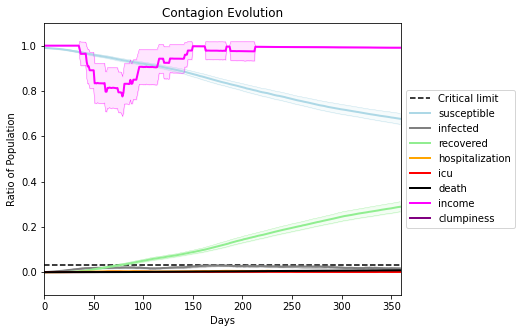

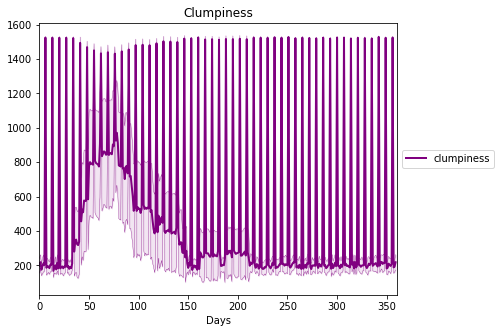

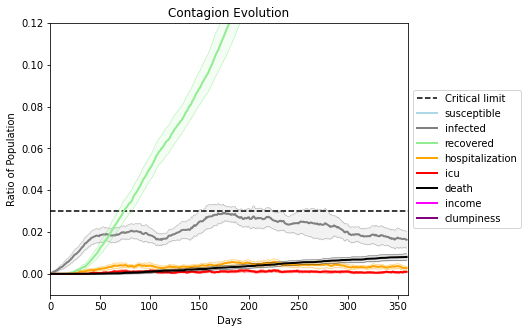

In [12]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.993
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[502, 4141, 3308, 3560, 7780, 9012, 807, 8393, 1683, 3000, 6831, 3071, 6136, 4001, 9213, 6132, 2515, 7468, 2297, 8916]
Average similarity between family members is 0.9179028591609255 at temperature -0.992
Average similarity between family and home is 0.9998582145435073 at temperature -1
Average similarity between students and their classroom is 0.8525866358205247 at temperature -0.992
Average classroom occupancy is 1.5549132947976878 and number classrooms is 173
Average similarity between workers is 0.8492925045880761 at temperature -0.992
Average office occupancy is 3.3613861386138613 and number offices is 202
Average friend similarity for adults: 0.845951117410236 for kids: 0.7175575174819201
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Building

avg restaurant similarity 0.4394675653876398
avg restaurant similarity 0.6318490820605889
avg restaurant similarity 0.5097529810754334
avg restaurant similarity 0.4814941060527355
avg restaurant similarity 0.5954810436423599
avg restaurant similarity 0.6027336344030298
avg restaurant similarity 0.3528221272076389
avg restaurant similarity 0.42620415838710013
avg restaurant similarity 0.4165902070486459
avg restaurant similarity 0.6746182541769861
avg restaurant similarity 0.6005679782366873
avg restaurant similarity 0.5657341722232874
avg restaurant similarity 0.4917840775725552
avg restaurant similarity 0.514646394525439
avg restaurant similarity 0.43003857671701695
avg restaurant similarity 0.4756916770409293
avg restaurant similarity 0.5736935151808062
avg restaurant similarity 0.7037132407383994
avg restaurant similarity 0.5005878284707685
avg restaurant similarity 0.4452450076580964
avg restaurant similarity 0.5231696022798824
avg restaurant similarity 0.5445861457920353
avg resta

avg restaurant similarity 0.6132469074920216
avg restaurant similarity 0.44785605490552666
avg restaurant similarity 0.506422680514381
avg restaurant similarity 0.6141703702273262
avg restaurant similarity 0.8792947028327321
avg restaurant similarity 0.479849740965917
avg restaurant similarity 0.5430771478042227
avg restaurant similarity 0.5608646772846457
avg restaurant similarity 0.5708115795653922
avg restaurant similarity 0.2518376158044452
avg restaurant similarity 0.38266273131840367
avg restaurant similarity 0.4953730803254014
avg restaurant similarity 0.5348774862206942
avg restaurant similarity 0.6213701400885119
avg restaurant similarity 0.5630894666355583
avg restaurant similarity 0.562983855375451
avg restaurant similarity 0.5622658555452349
avg restaurant similarity 0.4960875239512566
avg restaurant similarity 0.4999784964071461
avg restaurant similarity 0.4586183268672849
avg restaurant similarity 0.4547572853499524
avg restaurant similarity 0.24117421415735962
avg restau

Average friend similarity for adults: 0.8381013335016192 for kids: 0.7299740385702345
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.5134291666981126
avg restaurant similarity 0.5214294149712694
avg restaurant similarity 0.5812178312259312
avg restaurant similarity 0.4568000597089662
avg restaurant similarity 0.5375714491851413
avg restaurant similarity 0.48077006104251263
avg restaurant similarity 0.45306203268647316
avg restaurant similarity 0.4884917558259243
avg restaurant similarity 0.5325152402830879
avg restaurant similarity 0.5024446427294302
avg restaurant similarity 0.7737053700738545
avg restaurant similarity 0.5838208175998902
avg restaurant similarity 0.5786113876569895
avg restaurant similarity 0.4866944453116026
avg restaurant similarity 0.6449630171037304
avg restaurant similarity 0.4450760032029168
avg restaurant similarity 0.45375334668870726
avg restaurant similarity 0.5528150127844859
avg restaurant similarity 0.5774693460806142
avg restaurant similarity 0.7126562322214175
avg restaurant similarity 0.44516752385364294
avg restaurant similarity 0.47397992469915035
avg r

avg restaurant similarity 0.4239773403579943
avg restaurant similarity 0.7184764809981478
avg restaurant similarity 0.5869253991409424
avg restaurant similarity 0.7501437370162694
avg restaurant similarity 0.5081480318827655
avg restaurant similarity 0.5544373496599898
avg restaurant similarity 0.4440695941601916
avg restaurant similarity 0.2501476492356649
avg restaurant similarity 0.6141237520291616
avg restaurant similarity 0.6614588843524963
avg restaurant similarity 0.6438236768952755
avg restaurant similarity 0.4368544335215321
avg restaurant similarity 0.4380050161689514
avg restaurant similarity 0.430558494394663
avg restaurant similarity 0.5695185685126031
avg restaurant similarity 0.5754157421181137
avg restaurant similarity 0.3825003261763606
avg restaurant similarity 0.4761329777639214
avg restaurant similarity 0.45102297879619135
avg restaurant similarity 0.4774246911766936
avg restaurant similarity 0.745188606944222
avg restaurant similarity 0.7289391510668175
avg restaur

Average similarity between workers is 0.8531261183343439 at temperature -0.992
Average office occupancy is 3.345360824742268 and number offices is 194
Average friend similarity for adults: 0.8476451043787053 for kids: 0.7383982914379976
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 

avg restaurant similarity 0.4434208909067613
avg restaurant similarity 0.5562241241433413
avg restaurant similarity 0.42049084096937245
avg restaurant similarity 0.5804760572800317
avg restaurant similarity 0.5263188356945006
avg restaurant similarity 0.5771950163885772
avg restaurant similarity 0.5383855301390024
avg restaurant similarity 0.4675135078512876
avg restaurant similarity 0.5609606796549559
avg restaurant similarity 0.5637549311133888
avg restaurant similarity 0.6037715602872873
avg restaurant similarity 0.6543467087562268
avg restaurant similarity 0.6216862521732817
avg restaurant similarity 0.42023912707034994
avg restaurant similarity 0.575894222589668
avg restaurant similarity 0.5156452716975222
avg restaurant similarity 0.6189402864799896
avg restaurant similarity 0.3453322599979316
avg restaurant similarity 0.7063655608082953
avg restaurant similarity 0.6431482556845461
avg restaurant similarity 0.583408905543669
avg restaurant similarity 0.614125712169942
avg restaur

avg restaurant similarity 0.5866794382650747
avg restaurant similarity 0.34091414207532056
avg restaurant similarity 0.5145065838996834
avg restaurant similarity 0.4142270906734591
avg restaurant similarity 0.6432826541824727
avg restaurant similarity 0.37947773992001177
avg restaurant similarity 0.4722334186288683
avg restaurant similarity 0.5413947890608584
avg restaurant similarity 0.47301677600834025
avg restaurant similarity 0.5592239737858049
avg restaurant similarity 0.4938037276768612
avg restaurant similarity 0.5565066577091398
avg restaurant similarity 0.4582328365354039
avg restaurant similarity 0.4829493573317493
avg restaurant similarity 0.475217416407358
avg restaurant similarity 0.5246416550051529
avg restaurant similarity 0.5048702942124873
avg restaurant similarity 0.5693491402030685
avg restaurant similarity 0.5732292943848999
avg restaurant similarity 0.621350664827737
avg restaurant similarity 0.5692703630746474
avg restaurant similarity 0.43180705796689317
avg rest

avg restaurant similarity 0.5145542290764831
avg restaurant similarity 0.5388741405212956
avg restaurant similarity 0.5174373492756053
avg restaurant similarity 0.7012119095864024
avg restaurant similarity 0.5711090505093199
avg restaurant similarity 0.43159274343685616
avg restaurant similarity 0.40614562028482526
avg restaurant similarity 0.6102736105649063
avg restaurant similarity 0.5051527124186374
avg restaurant similarity 0.5353373752037609
avg restaurant similarity 0.5515956230110967
avg restaurant similarity 0.5569916861759162
avg restaurant similarity 0.5161046480955456
avg restaurant similarity 0.59995974394821
avg restaurant similarity 0.4226949356101226
avg restaurant similarity 0.4510745871868174
avg restaurant similarity 0.5867959111338094
avg restaurant similarity 0.5378025130487579
avg restaurant similarity 0.7555468201325752
avg restaurant similarity 0.5863160529724821
avg restaurant similarity 0.7099142294659945
avg restaurant similarity 0.4717628987153192
avg restau

avg restaurant similarity 0.43599378101747244
avg restaurant similarity 0.5320450232588118
avg restaurant similarity 0.5297907695705825
avg restaurant similarity 0.47960891090528057
avg restaurant similarity 0.8138560574159064
avg restaurant similarity 0.6423209640141417
avg restaurant similarity 0.5376670171667058
avg restaurant similarity 0.4293080921811736
avg restaurant similarity 0.6477842427485616
avg restaurant similarity 0.6104532574953301
avg restaurant similarity 0.5308161305067751
avg restaurant similarity 0.5620945072150555
avg restaurant similarity 0.5076741755665535
avg restaurant similarity 0.6323825005910482
avg restaurant similarity 0.5311025936600026
avg restaurant similarity 0.6538334348358636
avg restaurant similarity 0.46667704128745546
avg restaurant similarity 0.36408076383082344
avg restaurant similarity 0.766257541210555
avg restaurant similarity 0.5162479685772485
avg restaurant similarity 0.35355909478962977
avg restaurant similarity 0.39009289651422474
avg r

avg restaurant similarity 0.44521615706380097
avg restaurant similarity 0.5727732936065992
avg restaurant similarity 0.41331509424868107
avg restaurant similarity 0.3866868588851972
avg restaurant similarity 0.521013067389067
avg restaurant similarity 0.35890900353309396
avg restaurant similarity 0.44547887273224446
avg restaurant similarity 0.5255544680560201
avg restaurant similarity 0.6475593832541334
avg restaurant similarity 0.43273299657821385
avg restaurant similarity 0.4815030710055398
avg restaurant similarity 0.521808943489525
avg restaurant similarity 0.6029322436956831
avg restaurant similarity 0.555800685583436
avg restaurant similarity 0.48224356832783033
avg restaurant similarity 0.42624156046819417
avg restaurant similarity 0.5697594442184377
avg restaurant similarity 0.44977710157796785
avg restaurant similarity 0.49933097619723427
avg restaurant similarity 0.3950794701496323
avg restaurant similarity 0.5544105432522397
avg restaurant similarity 0.4575336776200079
avg 

avg restaurant similarity 0.3569875794382879
avg restaurant similarity 0.41743406654110077
avg restaurant similarity 0.4953056120926154
avg restaurant similarity 0.6303572062655682
avg restaurant similarity 0.505156467950746
avg restaurant similarity 0.5361014775650648
avg restaurant similarity 0.6901430242097235
avg restaurant similarity 0.5108232633713794
avg restaurant similarity 0.3741989805097056
avg restaurant similarity 0.3916117116591618
avg restaurant similarity 0.6121493408965899
avg restaurant similarity 0.5253515106415313
avg restaurant similarity 0.5879703019247532
avg restaurant similarity 0.6156025907022434
avg restaurant similarity 0.5467954683997893
avg restaurant similarity 0.4618286445945845
avg restaurant similarity 0.4446457458294059
avg restaurant similarity 0.6322586543428703
avg restaurant similarity 0.48022970759555655
avg restaurant similarity 0.695888805225748
avg restaurant similarity 0.6643095380573786
avg restaurant similarity 0.5006007416189425
avg restau

avg restaurant similarity 0.5588647666027496
avg restaurant similarity 0.43906415245756536
avg restaurant similarity 0.8610139703196006
avg restaurant similarity 0.6202992733884234
avg restaurant similarity 0.6262631600523993
avg restaurant similarity 0.690259285600849
avg restaurant similarity 0.46789239147203765
avg restaurant similarity 0.6173402851133621
avg restaurant similarity 0.6252329365298325
avg restaurant similarity 0.6507404986625651
avg restaurant similarity 0.64649117613683
avg restaurant similarity 0.6849060433819028
avg restaurant similarity 0.6258134741582385
avg restaurant similarity 0.6936112057544541
avg restaurant similarity 0.5145368835942951
avg restaurant similarity 0.401169482527482
avg restaurant similarity 0.3599349348480647
avg restaurant similarity 0.6603084085872059
avg restaurant similarity 0.41596543784708034
avg restaurant similarity 0.5181344858354472
avg restaurant similarity 0.2480382296400581
avg restaurant similarity 0.5106696336799696
avg restaur

avg restaurant similarity 0.41008032585211845
avg restaurant similarity 0.6963258839927127
avg restaurant similarity 0.4559340648036426
avg restaurant similarity 0.49267761518177594
avg restaurant similarity 0.6742119843824399
avg restaurant similarity 0.525487977789953
avg restaurant similarity 0.7300332172491486
avg restaurant similarity 0.5125849720202077
avg restaurant similarity 0.4658103722533254
avg restaurant similarity 0.5290158234898603
avg restaurant similarity 0.45100680729597215
avg restaurant similarity 0.6432301924171017
avg restaurant similarity 0.9046466073936529
avg restaurant similarity 0.6947837504601584
avg restaurant similarity 0.6086643006119572
avg restaurant similarity 0.4966515331100568
avg restaurant similarity 0.6805748077810618
avg restaurant similarity 0.5148595761593814
avg restaurant similarity 0.6819384036195038
avg restaurant similarity 0.6174927013303367
avg restaurant similarity 0.6385536038439187
avg restaurant similarity 0.7559920062576
avg restaur

Average friend similarity for adults: 0.8436370302498599 for kids: 0.7202466921472831
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.344469124859266
avg restaurant similarity 0.5771304797790011
avg restaurant similarity 0.7981553128275056
avg restaurant similarity 0.545948373813927
avg restaurant similarity 0.6442851194458744
avg restaurant similarity 0.4306064071303067
avg restaurant similarity 0.5784289153622344
avg restaurant similarity 0.5293103769234877
avg restaurant similarity 0.6223932010660325
avg restaurant similarity 0.4603244794937188
avg restaurant similarity 0.3327324504362559
avg restaurant similarity 0.6045226797115595
avg restaurant similarity 0.6191513819008846
avg restaurant similarity 0.5963044118052131
avg restaurant similarity 0.6515972623589711
avg restaurant similarity 0.6169648247611978
avg restaurant similarity 0.5479762231930406
avg restaurant similarity 0.6493979156537824
avg restaurant similarity 0.4554834831846794
avg restaurant similarity 0.4540705127839809
avg restaurant similarity 0.4923760855528523
avg restaurant similarity 0.3788773223673942
avg restaura

avg restaurant similarity 0.5502552159091785
avg restaurant similarity 0.581117073604184
avg restaurant similarity 0.6076280492524015
avg restaurant similarity 0.5557446082340948
avg restaurant similarity 0.6899651290761968
avg restaurant similarity 0.5860766069979848
avg restaurant similarity 0.4951181697538415
avg restaurant similarity 0.5950978168729245
avg restaurant similarity 0.45250097891169705
avg restaurant similarity 0.500356923697579
avg restaurant similarity 0.49888622021462375
avg restaurant similarity 0.57344890205974
avg restaurant similarity 0.5812836140202292
avg restaurant similarity 0.492066877778102
avg restaurant similarity 0.5450851709925012
avg restaurant similarity 0.5909189012169064
avg restaurant similarity 0.49848422335162895
avg restaurant similarity 0.4852573358279648
avg restaurant similarity 0.6262353762662903
avg restaurant similarity 0.6422702673223245
avg restaurant similarity 0.7110597475743841
avg restaurant similarity 0.5448024779038
avg restaurant 

Average similarity between workers is 0.8364985631851783 at temperature -0.992
Average office occupancy is 3.364102564102564 and number offices is 195
Average friend similarity for adults: 0.8351796941459121 for kids: 0.7136891094011103
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of

avg restaurant similarity 0.5393971291343787
avg restaurant similarity 0.43277098172432066
avg restaurant similarity 0.46516763301109226
avg restaurant similarity 0.4902139784810931
avg restaurant similarity 0.33680587715480503
avg restaurant similarity 0.4964382969940544
avg restaurant similarity 0.5211564842769694
avg restaurant similarity 0.41397058210351645
avg restaurant similarity 0.49273061491365383
avg restaurant similarity 0.5973958278470737
avg restaurant similarity 0.5616872385504702
avg restaurant similarity 0.4559987134917308
avg restaurant similarity 0.45805026486418027
avg restaurant similarity 0.528155627477091
avg restaurant similarity 0.50491959997818
avg restaurant similarity 0.5573826718338734
avg restaurant similarity 0.4196139867965743
avg restaurant similarity 0.5701575758726807
avg restaurant similarity 0.5299648043273258
avg restaurant similarity 0.6107730486324301
avg restaurant similarity 0.46836883667171114
avg restaurant similarity 0.4996209548415081
avg re

avg restaurant similarity 0.6343890740713519
avg restaurant similarity 0.5809051299630463
avg restaurant similarity 0.4617447988089203
avg restaurant similarity 0.48712712658362567
avg restaurant similarity 0.5861098747588761
avg restaurant similarity 0.43722244570799307
avg restaurant similarity 0.5574300446691322
avg restaurant similarity 0.5323388103446998
avg restaurant similarity 0.5844311556737187
avg restaurant similarity 0.4150970891192121
avg restaurant similarity 0.5113488739202618
avg restaurant similarity 0.48978701592552787
avg restaurant similarity 0.4398183004658668
avg restaurant similarity 0.3855975844520464
avg restaurant similarity 0.5160520076024128
avg restaurant similarity 0.4211071278524409
avg restaurant similarity 0.3563988737981945
avg restaurant similarity 0.49921937655819065
avg restaurant similarity 0.5586239522150267
avg restaurant similarity 0.4928282547184206
avg restaurant similarity 0.48094917287502637
avg restaurant similarity 0.4958338156431028
avg r

Average similarity between workers is 0.8552100941495673 at temperature -0.992
Average office occupancy is 3.350253807106599 and number offices is 197
Average friend similarity for adults: 0.8354839191272015 for kids: 0.7251376309907448
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.506013974893672
avg restaurant similarity 0.525904034810496
avg restaurant similarity 0.6523442091758962
avg restaurant similarity 0.48910590978421303
avg restaurant similarity 0.5440414851397801
avg restaurant similarity 0.3607174359509394
avg restaurant similarity 0.5624123701552093
avg restaurant similarity 0.5679769913129397
avg restaurant similarity 0.4910212289370049
avg restaurant similarity 0.5653230482292427
avg restaurant similarity 0.6598549978837445
avg restaurant similarity 0.48107173365816813
avg restaurant similarity 0.48137329736263446
avg restaurant similarity 0.49760333107398386
avg restaurant similarity 0.4910313424856843
avg restaurant similarity 0.6545363423934515
avg restaurant similarity 0.5902911652790194
avg restaurant similarity 0.6530998917787035
avg restaurant similarity 0.4847901254669032
avg restaurant similarity 0.5823561369141453
avg restaurant similarity 0.47259871646553026
avg restaurant similarity 0.5612301023698234
avg res

avg restaurant similarity 0.4314817889788719
avg restaurant similarity 0.5445032427526737
avg restaurant similarity 0.4997536919370521
avg restaurant similarity 0.4210920923662355
avg restaurant similarity 0.8081341794735991
avg restaurant similarity 0.5210637692751443
avg restaurant similarity 0.4855824363653822
avg restaurant similarity 0.39475481856893346
avg restaurant similarity 0.5511003706024321
avg restaurant similarity 0.5175904891564083
avg restaurant similarity 0.555802094494311
avg restaurant similarity 0.5399679431816987
avg restaurant similarity 0.5892359338061159
avg restaurant similarity 0.5590874044374223
avg restaurant similarity 0.6551264563583139
avg restaurant similarity 0.5754655954309205
avg restaurant similarity 0.37766223190878645
avg restaurant similarity 0.6209865328699168
avg restaurant similarity 0.45905675919320377
avg restaurant similarity 0.7193792435501213
avg restaurant similarity 0.5123399307683423
avg restaurant similarity 0.44682186285566045
avg res

Average similarity between workers is 0.8457306969467645 at temperature -0.992
Average office occupancy is 3.486910994764398 and number offices is 191
Average friend similarity for adults: 0.8461610045161977 for kids: 0.7181447138468591
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5112442590560894
avg restaurant similarity 0.4266103918966717
avg restaurant similarity 0.6010193604174827
avg restaurant similarity 0.4745411032077207
avg restaurant similarity 0.5199234229473721
avg restaurant similarity 0.5784437646289513
avg restaurant similarity 0.4332466904278128
avg restaurant similarity 0.4445789311035883
avg restaurant similarity 0.3958649988676393
avg restaurant similarity 0.5151967614887335
avg restaurant similarity 0.4141710504076559
avg restaurant similarity 0.45026856613506494
avg restaurant similarity 0.3888128293161353
avg restaurant similarity 0.6576596983703415
avg restaurant similarity 0.47239729792574725
avg restaurant similarity 0.4081045856346349
avg restaurant similarity 0.5624445616020436
avg restaurant similarity 0.40580493410274465
avg restaurant similarity 0.5459664071139883
avg restaurant similarity 0.4178054152547043
avg restaurant similarity 0.41753817784197095
avg restaurant similarity 0.4040669195321767
avg re

avg restaurant similarity 0.5348380693684749
avg restaurant similarity 0.5382890846056755
avg restaurant similarity 0.3713787909248096
avg restaurant similarity 0.44478126083227754
avg restaurant similarity 0.5564780498494245
avg restaurant similarity 0.49900668103642865
avg restaurant similarity 0.503195726598512
avg restaurant similarity 0.7218720143933149
avg restaurant similarity 0.4538982302393705
avg restaurant similarity 0.531248195429098
avg restaurant similarity 0.42516480341704477
avg restaurant similarity 0.41854116740326835
avg restaurant similarity 0.45792733792923973
avg restaurant similarity 0.4450709528289829
avg restaurant similarity 0.4486836995246758
avg restaurant similarity 0.3714865463062579
avg restaurant similarity 0.45562563699349484
avg restaurant similarity 0.39832873516135703
avg restaurant similarity 0.39440498052782125
avg restaurant similarity 0.4459804104285416
avg restaurant similarity 0.4660622528480259
avg restaurant similarity 0.4159664094822532
avg 

Average similarity between workers is 0.8442181392114545 at temperature -0.992
Average office occupancy is 3.217821782178218 and number offices is 202
Average friend similarity for adults: 0.839282349968277 for kids: 0.7234678407100346
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 p

avg restaurant similarity 0.47188631531992614
avg restaurant similarity 0.6717157509749453
avg restaurant similarity 0.5678445437873287
avg restaurant similarity 0.5822313581327997
avg restaurant similarity 0.6423998833431777
avg restaurant similarity 0.45647163083200654
avg restaurant similarity 0.45449597617906756
avg restaurant similarity 0.7331153282125317
avg restaurant similarity 0.47344760230454086
avg restaurant similarity 0.5670399799930507
avg restaurant similarity 0.5050203098061947
avg restaurant similarity 0.6030608339199053
avg restaurant similarity 0.5640696199067369
avg restaurant similarity 0.68362993973884
avg restaurant similarity 0.5700879725504214
avg restaurant similarity 0.5543928566384073
avg restaurant similarity 0.6224016130658965
avg restaurant similarity 0.6738515552035564
avg restaurant similarity 0.37370566898987456
avg restaurant similarity 0.4114169964484393
avg restaurant similarity 0.49682846115266643
avg restaurant similarity 0.4158442503395357
avg re

avg restaurant similarity 0.49425674011124204
avg restaurant similarity 0.6010017280667296
avg restaurant similarity 0.6226229076526717
avg restaurant similarity 0.7106829350555663
avg restaurant similarity 0.4578741017874406
avg restaurant similarity 0.5757206564724363
avg restaurant similarity 0.5906380407103115
avg restaurant similarity 0.6483058464194915
avg restaurant similarity 0.6042605589708011
avg restaurant similarity 0.5692664284917138
avg restaurant similarity 0.6077866122990118
avg restaurant similarity 0.4389429237167847
avg restaurant similarity 0.568504205468352
avg restaurant similarity 0.43222439453286793
avg restaurant similarity 0.668171333386895
avg restaurant similarity 0.7211348158685857
avg restaurant similarity 0.8502660945237328
avg restaurant similarity 0.6457482281729913
avg restaurant similarity 0.6702226961734747
avg restaurant similarity 0.5001287444052521
avg restaurant similarity 0.6073882089853121
avg restaurant similarity 0.6520966023348806
avg restau

Average similarity between workers is 0.8396819640493783 at temperature -0.992
Average office occupancy is 3.3789473684210525 and number offices is 190
Average friend similarity for adults: 0.8389994791251111 for kids: 0.7344519381587007
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 p

avg restaurant similarity 0.5302258025790598
avg restaurant similarity 0.5066883782684772
avg restaurant similarity 0.5520822877948798
avg restaurant similarity 0.08588044436083814
avg restaurant similarity 0.6566545935068535
avg restaurant similarity 0.6099614011789198
avg restaurant similarity 0.5385422590116856
avg restaurant similarity 0.4944552054945876
avg restaurant similarity 0.569166630117878
avg restaurant similarity 0.5045740261913666
avg restaurant similarity 0.536759573421907
avg restaurant similarity 0.5556470245480497
avg restaurant similarity 0.7884186600646846
avg restaurant similarity 0.5801590087575451
avg restaurant similarity 0.4862573722672921
avg restaurant similarity 0.4731839582630822
avg restaurant similarity 0.6715071954763289
avg restaurant similarity 0.48932253003669557
avg restaurant similarity 0.6329598057331405
avg restaurant similarity 0.5058743408530156
avg restaurant similarity 0.5935604092681221
avg restaurant similarity 0.457426692381014
avg restaur

avg restaurant similarity 0.6128992610186128
avg restaurant similarity 0.5827933053325546
avg restaurant similarity 0.5431651715190887
avg restaurant similarity 0.615863250131352
avg restaurant similarity 0.470823714369854
avg restaurant similarity 0.6427876256568228
avg restaurant similarity 0.6072150321542785
avg restaurant similarity 0.5977872431702809
avg restaurant similarity 0.7353281385502521
avg restaurant similarity 0.4208895500482464
avg restaurant similarity 0.3969049020065931
avg restaurant similarity 0.4966131871557362
avg restaurant similarity 0.6130686455389431
avg restaurant similarity 0.5188983043387376
avg restaurant similarity 0.3405120147921529
avg restaurant similarity 0.5700696177068827
avg restaurant similarity 0.6172856638329488
avg restaurant similarity 0.507001403364172
avg restaurant similarity 0.5220103125220702
avg restaurant similarity 0.5118133560237282
avg restaurant similarity 0.6554322938837875
avg restaurant similarity 0.7197954860658399
avg restauran

Average similarity between workers is 0.8522663741415576 at temperature -0.992
Average office occupancy is 3.3769633507853403 and number offices is 191
Average friend similarity for adults: 0.8459217804514997 for kids: 0.7190117577482321
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of

avg restaurant similarity 0.650468093542151
avg restaurant similarity 0.498305803808337
avg restaurant similarity 0.48336625482991935
avg restaurant similarity 0.6593161698580343
avg restaurant similarity 0.6531925855802306
avg restaurant similarity 0.6244986191575886
avg restaurant similarity 0.5576843065668812
avg restaurant similarity 0.5423945846118503
avg restaurant similarity 0.6426241192944327
avg restaurant similarity 0.5208644855051924
avg restaurant similarity 0.5763018597065407
avg restaurant similarity 0.4959983635998798
avg restaurant similarity 0.5134047912463079
avg restaurant similarity 0.5550578386831093
avg restaurant similarity 0.5010817062630714
avg restaurant similarity 0.6399695057422821
avg restaurant similarity 0.45269291426975394
avg restaurant similarity 0.476132622171854
avg restaurant similarity 0.6467568105656101
avg restaurant similarity 0.6954276558718991
avg restaurant similarity 0.6366181932105186
avg restaurant similarity 0.5316981622980913
avg restaur

avg restaurant similarity 0.6520949574650362
avg restaurant similarity 0.4877506602750253
avg restaurant similarity 0.5670556566392235
avg restaurant similarity 0.5843360429775938
avg restaurant similarity 0.5282353115632866
avg restaurant similarity 0.5564210389189458
avg restaurant similarity 0.6852890567536638
avg restaurant similarity 0.5648651625392256
avg restaurant similarity 0.5142857092424309
avg restaurant similarity 0.6150907534686425
avg restaurant similarity 0.5060642356120297
avg restaurant similarity 0.44592516059870063
avg restaurant similarity 0.2770125881821651
avg restaurant similarity 0.4345949504053024
avg restaurant similarity 0.4360899916909636
avg restaurant similarity 0.6250862459733179
avg restaurant similarity 0.592859872045218
avg restaurant similarity 0.6160578021305823
avg restaurant similarity 0.7051094823859804
avg restaurant similarity 0.6851126555321354
avg restaurant similarity 0.4827119037832092
avg restaurant similarity 0.6119465905985381
avg restau

Average similarity between workers is 0.8506675100006469 at temperature -0.992
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.8368394795497998 for kids: 0.7197189368733407
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8

avg restaurant similarity 0.5052037901054942
avg restaurant similarity 0.24403234505022375
avg restaurant similarity 0.49941603352333186
avg restaurant similarity 0.4461519324193228
avg restaurant similarity 0.35495025473512976
avg restaurant similarity 0.5872157967224819
avg restaurant similarity 0.44193026689580056
avg restaurant similarity 0.6226715874565599
avg restaurant similarity 0.4450996653729632
avg restaurant similarity 0.3959628067739684
avg restaurant similarity 0.6202310703778985
avg restaurant similarity 0.43256022432744357
avg restaurant similarity 0.4437474704329775
avg restaurant similarity 0.5053489096509599
avg restaurant similarity 0.49117314163911996
avg restaurant similarity 0.3402513714069655
avg restaurant similarity 0.48091446342596456
avg restaurant similarity 0.4764543991355677
avg restaurant similarity 0.403187285244369
avg restaurant similarity 0.4711789623077628
avg restaurant similarity 0.44700734533849446
avg restaurant similarity 0.5682121317980644
avg

avg restaurant similarity 0.5634279861177163
avg restaurant similarity 0.4973836597511047
avg restaurant similarity 0.5115898571713957
avg restaurant similarity 0.5758946899058103
avg restaurant similarity 0.4590337464349152
avg restaurant similarity 0.35419926088342985
avg restaurant similarity 0.48591582437386627
avg restaurant similarity 0.48365552477762114
avg restaurant similarity 0.6303090968112499
avg restaurant similarity 0.3643171385927083
avg restaurant similarity 0.46824149634088863
avg restaurant similarity 0.3334411040773401
avg restaurant similarity 0.4558557295781904
avg restaurant similarity 0.631569544698056
avg restaurant similarity 0.430038750233029
avg restaurant similarity 0.47238703598313125
avg restaurant similarity 0.3303589888955992
avg restaurant similarity 0.6561034355504837
avg restaurant similarity 0.46321940649605836
avg restaurant similarity 0.4534001932146172
avg restaurant similarity 0.3238063265524089
avg restaurant similarity 0.8193964208048301
avg re

avg restaurant similarity 0.4235590106375939
avg restaurant similarity 0.5444419212551339
avg restaurant similarity 0.6718729349309246
avg restaurant similarity 0.5268720716853011
avg restaurant similarity 0.5802154802397432
avg restaurant similarity 0.6906712864201002
avg restaurant similarity 0.5531646881566554
avg restaurant similarity 0.49419093549931503
avg restaurant similarity 0.5316928385582138
avg restaurant similarity 0.4845066642582432
avg restaurant similarity 0.6559555097824016
avg restaurant similarity 0.7631780085019612
avg restaurant similarity 0.5225117040517333
avg restaurant similarity 0.48706416510973605
avg restaurant similarity 0.520371737340851
avg restaurant similarity 0.6934579438211347
avg restaurant similarity 0.7784754885088794
avg restaurant similarity 0.6338665905734376
avg restaurant similarity 0.49817192969281104
avg restaurant similarity 0.5192561686239041
avg restaurant similarity 0.6176876062090461
avg restaurant similarity 0.524288298452215
avg resta

avg restaurant similarity 0.5834519114885275
avg restaurant similarity 0.5955133140198771
avg restaurant similarity 0.5489232994554126
avg restaurant similarity 0.71119031225855
avg restaurant similarity 0.466490431202788
avg restaurant similarity 0.7036784705281526
avg restaurant similarity 0.5866815402542098
avg restaurant similarity 0.5837862270019247
avg restaurant similarity 0.9997026651981312
avg restaurant similarity 0.45304851081230313
avg restaurant similarity 0.6545651713162856
avg restaurant similarity 0.6960524451971108
avg restaurant similarity 0.7946608512737079
avg restaurant similarity 0.3577424096223617
avg restaurant similarity 0.7181320082400924
avg restaurant similarity 0.4852940623448141
avg restaurant similarity 0.4014274289034605
avg restaurant similarity 0.45697829984916266
avg restaurant similarity 0.5373924399372716
avg restaurant similarity 0.5115646215551324
avg restaurant similarity 0.8859492757625865
avg restaurant similarity 0.6156574952481656
avg restaur

Average similarity between workers is 0.8437144678392114 at temperature -0.992
Average office occupancy is 3.5051020408163267 and number offices is 196
Average friend similarity for adults: 0.8464946906645203 for kids: 0.7059869342771555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 

avg restaurant similarity 0.5126708227002303
avg restaurant similarity 0.21275670538055247
avg restaurant similarity 0.6261427496135596
avg restaurant similarity 0.5259414801622633
avg restaurant similarity 0.524681628713674
avg restaurant similarity 0.39696591950861165
avg restaurant similarity 0.545987393649076
avg restaurant similarity 0.5585195028641046
avg restaurant similarity 0.6372516155777592
avg restaurant similarity 0.6648754460927099
avg restaurant similarity 0.5452233982539514
avg restaurant similarity 0.44548720072086656
avg restaurant similarity 0.7351383075169242
avg restaurant similarity 0.550738302439331
avg restaurant similarity 0.5794171036081766
avg restaurant similarity 0.571731476492285
avg restaurant similarity 0.4904620846873648
avg restaurant similarity 0.427269049002976
avg restaurant similarity 0.6497640655625443
avg restaurant similarity 0.653659630325076
avg restaurant similarity 0.5311523974189456
avg restaurant similarity 0.6390320799011228
avg restauran

avg restaurant similarity 0.5054689848303422
avg restaurant similarity 0.5503905036336767
avg restaurant similarity 0.4769503966872392
avg restaurant similarity 0.4679527285776313
avg restaurant similarity 0.4198607964161349
avg restaurant similarity 0.32549151371836055
avg restaurant similarity 0.5049446570918004
avg restaurant similarity 0.5192696999766334
avg restaurant similarity 0.604950122100729
avg restaurant similarity 0.47563482397845064
avg restaurant similarity 0.543515950538581
avg restaurant similarity 0.6451754135149299
avg restaurant similarity 0.51412581772451
avg restaurant similarity 0.325412193649115
avg restaurant similarity 0.7190448538114301
avg restaurant similarity 0.45405810649677086
avg restaurant similarity 0.640330191877374
avg restaurant similarity 0.6614851318406936
avg restaurant similarity 0.4902244203177705
avg restaurant similarity 0.677599593953558
avg restaurant similarity 0.5268056137805959
avg restaurant similarity 0.5313770876069713
avg restaurant

avg restaurant similarity 0.4949611385198316
avg restaurant similarity 0.48999192309457557
avg restaurant similarity 0.9042303744868458
avg restaurant similarity 0.5310706088536448
avg restaurant similarity 0.5668771844265107
avg restaurant similarity 0.6801761830571537
avg restaurant similarity 0.5302838695653721
avg restaurant similarity 0.616467173473471
avg restaurant similarity 0.7678603943940217
avg restaurant similarity 0.4267139838945552
avg restaurant similarity 0.6271310164217272
avg restaurant similarity 0.8083567942853254
avg restaurant similarity 0.47558538592011157
avg restaurant similarity 0.49634392028344215
avg restaurant similarity 0.6659064916027475
avg restaurant similarity 0.6112732194456401
avg restaurant similarity 0.5591681771275411
avg restaurant similarity 0.46874895464842115
avg restaurant similarity 0.7151454369095623
avg restaurant similarity 0.725953686275596
avg restaurant similarity 0.9998682552433602
avg restaurant similarity 0.3689621254968413
avg rest

avg restaurant similarity 0.5927810731920151
avg restaurant similarity 0.598239015451087
avg restaurant similarity 0.6849342388444064
avg restaurant similarity 0.5334720153097285
avg restaurant similarity 0.4571189634060564
avg restaurant similarity 0.7048246305276096
avg restaurant similarity 0.4194512343190015
avg restaurant similarity 0.5060130873541349
avg restaurant similarity 0.37315882561413843
avg restaurant similarity 0.49902294192666097
avg restaurant similarity 0.8300559730687403
avg restaurant similarity 0.5472306779279215
avg restaurant similarity 0.5156658260555222
avg restaurant similarity 0.4489501429801004
avg restaurant similarity 0.4782580271784901
avg restaurant similarity 0.5412467323386363
avg restaurant similarity 0.583322312239788
avg restaurant similarity 0.9997333562585423
avg restaurant similarity 0.7183951130532322
avg restaurant similarity 0.514233324932096
avg restaurant similarity 0.7730779525638735
avg restaurant similarity 0.4903302978318389
avg restaur

avg restaurant similarity 0.6066007814129578
avg restaurant similarity 0.48634762977882634
avg restaurant similarity 0.6768779430756362
avg restaurant similarity 0.5730851806100246
avg restaurant similarity 0.46024820630484614
avg restaurant similarity 0.5737456256507568
avg restaurant similarity 0.5119223311048368
avg restaurant similarity 0.42653447089230223
avg restaurant similarity 0.46772607884340744
avg restaurant similarity 0.7137979973159844
avg restaurant similarity 0.669712903751745
avg restaurant similarity 0.590313487001487
avg restaurant similarity 0.5461306584933397
avg restaurant similarity 0.5535892194670644
avg restaurant similarity 0.620879914950649
avg restaurant similarity 0.49313095619758535
avg restaurant similarity 0.7047459515978666
avg restaurant similarity 0.48154002441174154
avg restaurant similarity 0.6998791060785708
avg restaurant similarity 0.5670257973023469
avg restaurant similarity 0.6079789943309911
avg restaurant similarity 0.46791587764028325
avg re

avg restaurant similarity 0.4932980286315865
avg restaurant similarity 0.5888957343644418
avg restaurant similarity 0.6357747239815965
avg restaurant similarity 0.46936201387888
avg restaurant similarity 0.56146383053775
avg restaurant similarity 0.3418351066090469
avg restaurant similarity 0.44061199602812295
avg restaurant similarity 0.507118939023908
avg restaurant similarity 0.5546813577476306
avg restaurant similarity 0.49933443292543334
avg restaurant similarity 0.5696844149415248
avg restaurant similarity 0.35622500179850103
avg restaurant similarity 0.3933092273522043
avg restaurant similarity 0.5390372108998367
avg restaurant similarity 0.6032647415101673
avg restaurant similarity 0.5467982145163518
avg restaurant similarity 0.5729627875274177
avg restaurant similarity 0.3455463141704991
avg restaurant similarity 0.6580019702790969
avg restaurant similarity 0.6281308934078886
avg restaurant similarity 0.5736719850354111
avg restaurant similarity 0.5966224284038008
avg restaura

avg restaurant similarity 0.5205468733549818
avg restaurant similarity 0.3675601702865429
avg restaurant similarity 0.40167587172597213
avg restaurant similarity 0.3770806864868362
avg restaurant similarity 0.48912050270182583
avg restaurant similarity 0.40117302798980486
avg restaurant similarity 0.47366178516422874
avg restaurant similarity 0.5717269097568762
avg restaurant similarity 0.6322588679957711
avg restaurant similarity 0.5745007392364581
avg restaurant similarity 0.5012825086828937
avg restaurant similarity 0.6650481700810309
avg restaurant similarity 0.3598602206870616
avg restaurant similarity 0.3732986437716049
avg restaurant similarity 0.45559662613363294
avg restaurant similarity 0.48824139342879647
avg restaurant similarity 0.6404133744064426
avg restaurant similarity 0.35986559579436284
avg restaurant similarity 0.5197717030413123
avg restaurant similarity 0.47528447420603825
avg restaurant similarity 0.4735769096426911
avg restaurant similarity 0.5564907025432506
av

avg restaurant similarity 0.5528802069330926
avg restaurant similarity 0.5423172803851949
avg restaurant similarity 0.568091311974538
avg restaurant similarity 0.6095346337052813
avg restaurant similarity 0.6144707305679217
avg restaurant similarity 0.46491341876942044
avg restaurant similarity 0.5958962949087848
avg restaurant similarity 0.5404897720860423
avg restaurant similarity 0.42954909213186504
avg restaurant similarity 0.5665710877553329
avg restaurant similarity 0.4032697682025536
avg restaurant similarity 0.5553721782846063
avg restaurant similarity 0.4011539119876977
avg restaurant similarity 0.6655682035408964
avg restaurant similarity 0.5492289254407179
avg restaurant similarity 0.46939931615528885
avg restaurant similarity 0.6042473026971722
avg restaurant similarity 0.5695696190438413
avg restaurant similarity 0.5510871728622285
avg restaurant similarity 0.3255605287209059
avg restaurant similarity 0.5973402876881376
avg restaurant similarity 0.43112436090572104
avg res

avg restaurant similarity 0.4485257901398146
avg restaurant similarity 0.5141287112612295
avg restaurant similarity 0.46786691163052974
avg restaurant similarity 0.559895863926415
avg restaurant similarity 0.627270004023565
avg restaurant similarity 0.6586169209365046
avg restaurant similarity 0.4299811084698159
avg restaurant similarity 0.575700472173287
avg restaurant similarity 0.5771255701105577
avg restaurant similarity 0.4617824861937302
avg restaurant similarity 0.4831508411982998
avg restaurant similarity 0.6535570600612526
avg restaurant similarity 0.5478357210276221
avg restaurant similarity 0.6601807109944215
avg restaurant similarity 0.8328094742745165
avg restaurant similarity 0.7493908130503217
avg restaurant similarity 0.5581796755163736
avg restaurant similarity 0.5299928734497116
avg restaurant similarity 0.5993747725842853
avg restaurant similarity 0.4249243389961137
avg restaurant similarity 0.8559110711226859
avg restaurant similarity 0.6080864755419266
avg restaura

avg restaurant similarity 0.48505556304173403
avg restaurant similarity 0.4081659149316874
avg restaurant similarity 0.7168665730124205
avg restaurant similarity 0.481973428143768
avg restaurant similarity 0.6950211556809478
avg restaurant similarity 0.5216281525351795
avg restaurant similarity 0.5745948770555223
avg restaurant similarity 0.557312538223251
avg restaurant similarity 0.5641262785953849
avg restaurant similarity 0.7375180912606755
avg restaurant similarity 0.5753996629805882
avg restaurant similarity 0.6804428458643512
avg restaurant similarity 0.7547712327997057
avg restaurant similarity 0.5174152117997861
avg restaurant similarity 0.41747059959259325
avg restaurant similarity 0.6542739387085404
avg restaurant similarity 0.7244806045764373
avg restaurant similarity 0.5308355880538349
avg restaurant similarity 0.4841593170191174
avg restaurant similarity 0.7075967958951912
avg restaurant similarity 0.9997435609252975
avg restaurant similarity 0.47867647551065623
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

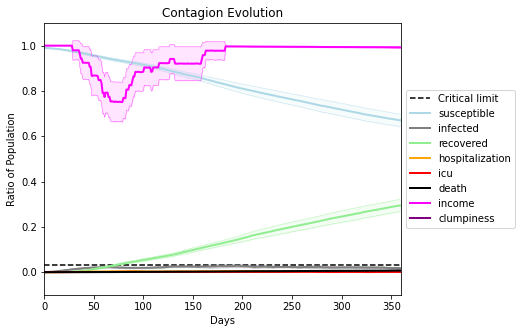

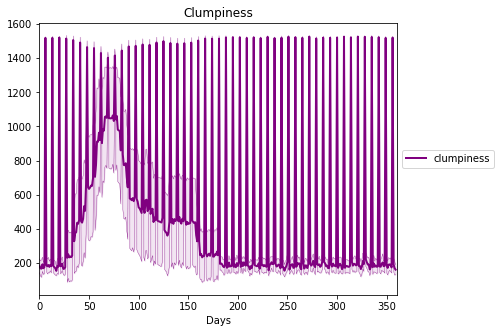

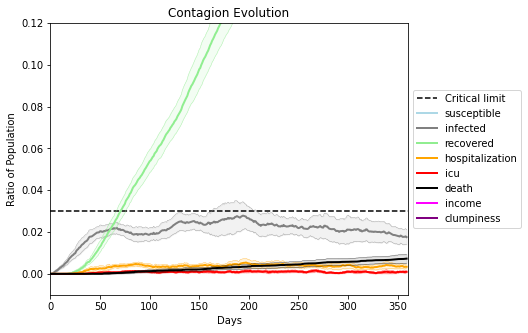

In [13]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.992
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[7660, 1272, 9698, 338, 5436, 1447, 8615, 7237, 4538, 7270, 7649, 6550, 4425, 3924, 4046, 9831, 3423, 4995, 5851, 3854]
Average similarity between family members is 0.9147929316460437 at temperature -0.991
Average similarity between family and home is 0.9998653198145729 at temperature -1
Average similarity between students and their classroom is 0.8003603009608015 at temperature -0.991
Average classroom occupancy is 1.6257309941520468 and number classrooms is 171
Average similarity between workers is 0.8200070946008209 at temperature -0.991
Average office occupancy is 3.5025906735751295 and number offices is 193
Average friend similarity for adults: 0.8381367047031967 for kids: 0.724908761417652
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Build

avg restaurant similarity 0.4226719147377544
avg restaurant similarity 0.41502583896346573
avg restaurant similarity 0.5878453935605776
avg restaurant similarity 0.607315413517956
avg restaurant similarity 0.4329500728662595
avg restaurant similarity 0.561676391218363
avg restaurant similarity 0.4000196549930765
avg restaurant similarity 0.5736121334955291
avg restaurant similarity 0.46034323805017724
avg restaurant similarity 0.5719304315792542
avg restaurant similarity 0.4220609895135727
avg restaurant similarity 0.44681389087096024
avg restaurant similarity 0.38294666703261837
avg restaurant similarity 0.46436520022074734
avg restaurant similarity 0.6014863022532333
avg restaurant similarity 0.46764962258586834
avg restaurant similarity 0.5228174905622202
avg restaurant similarity 0.43120122122086585
avg restaurant similarity 0.5002770169248884
avg restaurant similarity 0.5228516152764907
avg restaurant similarity 0.5275192349058951
avg restaurant similarity 0.5634131316750935
avg r

avg restaurant similarity 0.573730527895841
avg restaurant similarity 0.4335868619205841
avg restaurant similarity 0.49371888775097594
avg restaurant similarity 0.48764692422781064
avg restaurant similarity 0.6593985226255435
avg restaurant similarity 0.5746603473285823
avg restaurant similarity 0.6271759982466119
avg restaurant similarity 0.4019121795703424
avg restaurant similarity 0.5621277236229664
avg restaurant similarity 0.33621033563360064
avg restaurant similarity 0.4831562093308276
avg restaurant similarity 0.43514176557831985
avg restaurant similarity 0.48900461859888583
avg restaurant similarity 0.6257757037789597
avg restaurant similarity 0.46880258360218935
avg restaurant similarity 0.40686521121632896
avg restaurant similarity 0.6792882949667249
avg restaurant similarity 0.5162347204830676
avg restaurant similarity 0.5694922839587031
avg restaurant similarity 0.48712226994996977
avg restaurant similarity 0.6571139796194747
avg restaurant similarity 0.513497740108978
avg 

Average friend similarity for adults: 0.8383108661629338 for kids: 0.7105559322319164
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity 0.533759866677981
avg restaurant similarity 0.42414797951065286
avg restaurant similarity 0.5952951735482875
avg restaurant similarity 0.43828231224900516
avg restaurant similarity 0.6143535574405109
avg restaurant similarity 0.37973422170922355
avg restaurant similarity 0.5380737916300381
avg restaurant similarity 0.7738845685590539
avg restaurant similarity 0.4738696009272208
avg restaurant similarity 0.43429911313487113
avg restaurant similarity 0.47606972620941906
avg restaurant similarity 0.4629653089105614
avg restaurant similarity 0.48508952426039614
avg restaurant similarity 0.5068981732316405
avg restaurant similarity 0.6054265082155702
avg restaurant similarity 0.47405873572809293
avg restaurant similarity 0.48967928577307934
avg restaurant similarity 0.4870327353932309
avg restaurant similarity 0.43569376189509845
avg restaurant similarity 0.4547284684698434
avg restaurant similarity 0.5256627989412532
avg restaurant similarity 0.600160272640307
avg

avg restaurant similarity 0.5490174736780147
avg restaurant similarity 0.7283712933458084
avg restaurant similarity 0.47666638766428954
avg restaurant similarity 0.4908596726106002
avg restaurant similarity 0.5551864951614199
avg restaurant similarity 0.37342025738958856
avg restaurant similarity 0.5122037479023709
avg restaurant similarity 0.5181990162440403
avg restaurant similarity 0.5036339842904269
avg restaurant similarity 0.4746261393166899
avg restaurant similarity 0.4908376511809964
avg restaurant similarity 0.5296582759783287
avg restaurant similarity 0.49803810384682645
avg restaurant similarity 0.6050171121392226
avg restaurant similarity 0.5258771532291971
avg restaurant similarity 0.651968691293469
avg restaurant similarity 0.5598995098775599
avg restaurant similarity 0.4749284076158529
avg restaurant similarity 0.49260014200287894
avg restaurant similarity 0.4433658476210361
avg restaurant similarity 0.4185033517517526
avg restaurant similarity 0.5212377409308705
avg res

Average similarity between workers is 0.8467067845102055 at temperature -0.991
Average office occupancy is 3.397905759162304 and number offices is 191
Average friend similarity for adults: 0.8325429137191412 for kids: 0.7230380390386048
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.5432437690423383
avg restaurant similarity 0.5215126391930094
avg restaurant similarity 0.8231434801986142
avg restaurant similarity 0.36465376040028497
avg restaurant similarity 0.6885398391900066
avg restaurant similarity 0.5155294529309703
avg restaurant similarity 0.5236104612252427
avg restaurant similarity 0.5044669109017171
avg restaurant similarity 0.5880234179387659
avg restaurant similarity 0.49403087954616687
avg restaurant similarity 0.40692506162418357
avg restaurant similarity 0.45345730195500406
avg restaurant similarity 0.6290490888795846
avg restaurant similarity 0.6346443329859597
avg restaurant similarity 0.5323470766102812
avg restaurant similarity 0.41626306706964256
avg restaurant similarity 0.6349406005659539
avg restaurant similarity 0.5064520324314851
avg restaurant similarity 0.3937862184442831
avg restaurant similarity 0.5205946044020319
avg restaurant similarity 0.5514975914843047
avg restaurant similarity 0.5951372021036379
avg r

avg restaurant similarity 0.4640159771778277
avg restaurant similarity 0.4352788959687503
avg restaurant similarity 0.6694201885361002
avg restaurant similarity 0.5358550743929518
avg restaurant similarity 0.6291762624652545
avg restaurant similarity 0.4809591926967558
avg restaurant similarity 0.4324224807435522
avg restaurant similarity 0.56891737756568
avg restaurant similarity 0.5905462605981471
avg restaurant similarity 0.4266280346860969
avg restaurant similarity 0.44648982705793866
avg restaurant similarity 0.6177896454806299
avg restaurant similarity 0.5085468640574048
avg restaurant similarity 0.563610568020538
avg restaurant similarity 0.5639363262067646
avg restaurant similarity 0.594626186678756
avg restaurant similarity 0.44029587746143156
avg restaurant similarity 0.5432579207228727
avg restaurant similarity 0.6226481703837844
avg restaurant similarity 0.35428407327952943
avg restaurant similarity 0.7413909233299139
avg restaurant similarity 0.4985594108082294
avg restaur

Average friend similarity for adults: 0.836430931941555 for kids: 0.7161577629029673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.4591641140972403
avg restaurant similarity 0.6638100451258008
avg restaurant similarity 0.514456639007108
avg restaurant similarity 0.4012218317973912
avg restaurant similarity 0.5008573135843108
avg restaurant similarity 0.5473371359035886
avg restaurant similarity 0.7370584572150416
avg restaurant similarity 0.6272543791569987
avg restaurant similarity 0.430328249677206
avg restaurant similarity 0.40479319328435176
avg restaurant similarity 0.4746927020811835
avg restaurant similarity 0.45513387073107137
avg restaurant similarity 0.5718124873150422
avg restaurant similarity 0.5764399787305367
avg restaurant similarity 0.5376905127630532
avg restaurant similarity 0.5459613508961454
avg restaurant similarity 0.5122648108930571
avg restaurant similarity 0.3887602253914271
avg restaurant similarity 0.5397053127945404
avg restaurant similarity 0.6274563316217903
avg restaurant similarity 0.44324246294946196
avg restaurant similarity 0.544967880147039
avg restau

avg restaurant similarity 0.6031083301688968
avg restaurant similarity 0.6660566207578423
avg restaurant similarity 0.22817569017710793
avg restaurant similarity 0.4914750782053144
avg restaurant similarity 0.3624346043788015
avg restaurant similarity 0.5557496298243914
avg restaurant similarity 0.40876085610519586
avg restaurant similarity 0.33892728918533804
avg restaurant similarity 0.5650090279032147
avg restaurant similarity 0.34339552149393776
avg restaurant similarity 0.44649264373834996
avg restaurant similarity 0.5407656412951005
avg restaurant similarity 0.4467863785065774
avg restaurant similarity 0.4422343437026989
avg restaurant similarity 0.4639148671129492
avg restaurant similarity 0.5279317463793415
avg restaurant similarity 0.4943969023466885
avg restaurant similarity 0.3802368524497506
avg restaurant similarity 0.41325796555747796
avg restaurant similarity 0.5632817709301279
avg restaurant similarity 0.6827617802907551
avg restaurant similarity 0.3606530081339189
avg 

avg restaurant similarity 0.5315391786959099
avg restaurant similarity 0.5096467125410079
avg restaurant similarity 0.6170975789139505
avg restaurant similarity 0.7149923513358531
avg restaurant similarity 0.37119994763603764
avg restaurant similarity 0.5349144588840716
avg restaurant similarity 0.3966877555972888
avg restaurant similarity 0.6565798441611295
avg restaurant similarity 0.5089927181114994
avg restaurant similarity 0.4800392196681538
avg restaurant similarity 0.41779659109787304
avg restaurant similarity 0.5589327497226428
avg restaurant similarity 0.5374670103925152
avg restaurant similarity 0.5494733363355082
avg restaurant similarity 0.5021623272922614
avg restaurant similarity 0.5871293588915186
avg restaurant similarity 0.5830384728862901
avg restaurant similarity 0.5149294815358961
avg restaurant similarity 0.47163764597199354
avg restaurant similarity 0.7038258306002719
avg restaurant similarity 0.4319300331743801
avg restaurant similarity 0.5334401429969432
avg res

avg restaurant similarity 0.5484944875015189
avg restaurant similarity 0.4189328927476182
avg restaurant similarity 0.48521442733033726
avg restaurant similarity 0.5449389416833818
avg restaurant similarity 0.5684845300464563
avg restaurant similarity 0.42283975708861643
avg restaurant similarity 0.4972559133136382
avg restaurant similarity 0.44186775767514247
avg restaurant similarity 0.5296982431732007
avg restaurant similarity 0.46252623242511154
avg restaurant similarity 0.49307659639939305
avg restaurant similarity 0.5977799480895272
avg restaurant similarity 0.5825350896766506
avg restaurant similarity 0.6415075481429806
avg restaurant similarity 0.47659902565354817
avg restaurant similarity 0.6088650270317152
avg restaurant similarity 0.36123175166412763
avg restaurant similarity 0.4869417380294459
avg restaurant similarity 0.5229174360139415
avg restaurant similarity 0.04243423877019775
avg restaurant similarity 0.47766591034764644
avg restaurant similarity 0.4997085037274455
a

Average similarity between workers is 0.8418804496479696 at temperature -0.991
Average office occupancy is 3.2666666666666666 and number offices is 195
Average friend similarity for adults: 0.829821140276707 for kids: 0.737284606713367
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.29965385581170256
avg restaurant similarity 0.4070773058539097
avg restaurant similarity 0.47226805389309173
avg restaurant similarity 0.35341887208920036
avg restaurant similarity 0.7532853431588254
avg restaurant similarity 0.5343065810967446
avg restaurant similarity 0.3397518264630976
avg restaurant similarity 0.494303222520668
avg restaurant similarity 0.33663716851031644
avg restaurant similarity 0.6510513909554585
avg restaurant similarity 0.4164943568949248
avg restaurant similarity 0.5079196273025498
avg restaurant similarity 0.4584520718469716
avg restaurant similarity 0.029841968011131578
avg restaurant similarity 0.35557412498018687
avg restaurant similarity 0.5899150269861615
avg restaurant similarity 0.4160412945450024
avg restaurant similarity 0.5345047764200873
avg restaurant similarity 0.5320247402061473
avg restaurant similarity 0.4361289458573566
avg restaurant similarity 0.6090612610986732
avg restaurant similarity 0.4836568315483829
avg 

avg restaurant similarity 0.48091425450319353
avg restaurant similarity 0.3879240757529729
avg restaurant similarity 0.4908579039807118
avg restaurant similarity 0.4757591406402484
avg restaurant similarity 0.5494672839475296
avg restaurant similarity 0.5349336321468893
avg restaurant similarity 0.34642510808397514
avg restaurant similarity 0.48040146195266886
avg restaurant similarity 0.2977667605853876
avg restaurant similarity 0.48876591270508574
avg restaurant similarity 0.44180030056090797
avg restaurant similarity 0.7386388528255706
avg restaurant similarity 0.5013580221171842
avg restaurant similarity 0.517500539635172
avg restaurant similarity 0.3220620045541523
avg restaurant similarity 0.40887334590037666
avg restaurant similarity 0.4461059746147898
avg restaurant similarity 0.47061067937259277
avg restaurant similarity 0.6214266611895134
avg restaurant similarity 0.5721726330825307
avg restaurant similarity 0.4338190227066317
avg restaurant similarity 0.676064188222229
avg r

Average similarity between workers is 0.838856869495239 at temperature -0.991
Average office occupancy is 3.3316582914572863 and number offices is 199
Average friend similarity for adults: 0.840257392450717 for kids: 0.7255570766326008
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.5135056989193016
avg restaurant similarity 0.5483877177687448
avg restaurant similarity 0.7069346227188924
avg restaurant similarity 0.35514984250597725
avg restaurant similarity 0.5853216164119597
avg restaurant similarity 0.2064580660330091
avg restaurant similarity 0.6328254092449214
avg restaurant similarity 0.4606763287277832
avg restaurant similarity 0.7312913999375161
avg restaurant similarity 0.4735555142807087
avg restaurant similarity 0.6610016806149847
avg restaurant similarity 0.7063804769513712
avg restaurant similarity 0.35601624187612024
avg restaurant similarity 0.5921144020466663
avg restaurant similarity 0.6151387782755424
avg restaurant similarity 0.3118487778070283
avg restaurant similarity 0.44026827788348166
avg restaurant similarity 0.5222061768640984
avg restaurant similarity 0.5126975222677279
avg restaurant similarity 0.43699009168656594
avg restaurant similarity 0.6313880407942215
avg restaurant similarity 0.6640225683305522
avg re

avg restaurant similarity 0.3476459740276152
avg restaurant similarity 0.5767912436013128
avg restaurant similarity 0.4639707760205593
avg restaurant similarity 0.5893577156432996
avg restaurant similarity 0.33008807314406713
avg restaurant similarity 0.6687956561669537
avg restaurant similarity 0.5362983352437515
avg restaurant similarity 0.5516678682376362
avg restaurant similarity 0.5448333314260948
avg restaurant similarity 0.6139945318758474
avg restaurant similarity 0.44433337356107827
avg restaurant similarity 0.4420717005470045
avg restaurant similarity 0.5051080796314694
avg restaurant similarity 0.5616829026308234
avg restaurant similarity 0.18788737792802856
avg restaurant similarity 0.3482917770516362
avg restaurant similarity 0.4802355831522881
avg restaurant similarity 0.43825629248999554
avg restaurant similarity 0.437711789114672
avg restaurant similarity 0.608239728674611
avg restaurant similarity 0.4948879466178857
avg restaurant similarity 0.3379382656352607
avg rest

avg restaurant similarity 0.5445698495705471
avg restaurant similarity 0.4987006044770457
avg restaurant similarity 0.7058087431228245
avg restaurant similarity 0.5361407621976059
avg restaurant similarity 0.5262875558750789
avg restaurant similarity 0.5803126974371539
avg restaurant similarity 0.563939963510735
avg restaurant similarity 0.4512785854005522
avg restaurant similarity 0.5380190162702461
avg restaurant similarity 0.42184906156832486
avg restaurant similarity 0.5558733937596634
avg restaurant similarity 0.5441492931397183
avg restaurant similarity 0.6232615976117808
avg restaurant similarity 0.5457971016415663
avg restaurant similarity 0.7183286003379697
avg restaurant similarity 0.3575132504026959
avg restaurant similarity 0.6158173486845877
avg restaurant similarity 0.65626344523559
avg restaurant similarity 0.5930404196670568
avg restaurant similarity 0.49738356801823214
avg restaurant similarity 0.44647504968889157
avg restaurant similarity 0.0199610115194757
avg restau

avg restaurant similarity 0.4870315086900823
avg restaurant similarity 0.541182747671393
avg restaurant similarity 0.5370880362371645
avg restaurant similarity 0.5820771327071972
avg restaurant similarity 0.9229767793893519
avg restaurant similarity 0.8007781466730715
avg restaurant similarity 0.7293730486210176
avg restaurant similarity 0.3629416972659562
avg restaurant similarity 0.620901839835596
avg restaurant similarity 0.41258829172543865
avg restaurant similarity 0.4239465398539137
avg restaurant similarity 0.6057545227463166
avg restaurant similarity 0.41877423752887144
avg restaurant similarity 0.8381568782490572
avg restaurant similarity 0.4621937659165856
avg restaurant similarity 0.4535576329237867
avg restaurant similarity 0.6172674881211948
avg restaurant similarity 0.4878884411483432
avg restaurant similarity 0.8392877080883274
avg restaurant similarity 0.4241827629289925
avg restaurant similarity 0.5015501921943832
avg restaurant similarity 0.33857993388523244
avg resta

Average friend similarity for adults: 0.8357755711127394 for kids: 0.7223121095209362
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.3702583811286184
avg restaurant similarity 0.39544227708879803
avg restaurant similarity 0.49934587869405067
avg restaurant similarity 0.45185018630116264
avg restaurant similarity 0.6277985950320571
avg restaurant similarity 0.7347220162908309
avg restaurant similarity 0.6144090006452256
avg restaurant similarity 0.4017856113993473
avg restaurant similarity 0.544621699111889
avg restaurant similarity 0.3046004206994142
avg restaurant similarity 0.8023034953459138
avg restaurant similarity 0.5234062102995303
avg restaurant similarity 0.25115962623631266
avg restaurant similarity 0.3810316098625626
avg restaurant similarity 0.37153881640211195
avg restaurant similarity 0.7102820200941242
avg restaurant similarity 0.5695163733621096
avg restaurant similarity 0.5095955170953709
avg restaurant similarity 0.5619379749320588
avg restaurant similarity 0.43278251017398184
avg restaurant similarity 0.5686460135549248
avg restaurant similarity 0.4530820302655808
avg r

avg restaurant similarity 0.5589179893090699
avg restaurant similarity 0.4213960510617864
avg restaurant similarity 0.4027095240630668
avg restaurant similarity 0.44531175954095603
avg restaurant similarity 0.42364165013197325
avg restaurant similarity 0.37076749477219656
avg restaurant similarity 0.3973248881836932
avg restaurant similarity 0.3664958169398031
avg restaurant similarity 0.43404011224490163
avg restaurant similarity 0.2886816561792865
avg restaurant similarity 0.5380957710423636
avg restaurant similarity 0.4401995487475374
avg restaurant similarity 0.35752275748961526
avg restaurant similarity 0.38651595051046866
avg restaurant similarity 0.5139860674429932
avg restaurant similarity 0.52735920747889
avg restaurant similarity 0.525533200534346
avg restaurant similarity 0.4366053868505289
avg restaurant similarity 0.4306736592802148
avg restaurant similarity 0.43437577776966807
avg restaurant similarity 0.6048069251496917
avg restaurant similarity 0.4137539610322977
avg re

Average similarity between workers is 0.8418784898291302 at temperature -0.991
Average office occupancy is 3.311224489795918 and number offices is 196
Average friend similarity for adults: 0.8403724911159094 for kids: 0.7311174604701729
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 peop

avg restaurant similarity 0.4652894828712711
avg restaurant similarity 0.4613733072007671
avg restaurant similarity 0.49981569487919913
avg restaurant similarity 0.555997267876536
avg restaurant similarity 0.4131182842809772
avg restaurant similarity 0.7380130071220324
avg restaurant similarity 0.547365505558433
avg restaurant similarity 0.5179905725058855
avg restaurant similarity 0.6241367319719717
avg restaurant similarity 0.5212525288679096
avg restaurant similarity 0.47007734228925735
avg restaurant similarity 0.5701503608992716
avg restaurant similarity 0.4322949574990149
avg restaurant similarity 0.5305917828217518
avg restaurant similarity 0.5266170620272574
avg restaurant similarity 0.47774652776641385
avg restaurant similarity 0.6152943899689508
avg restaurant similarity 0.6376067417266726
avg restaurant similarity 0.48561385864103024
avg restaurant similarity 0.5821381381325271
avg restaurant similarity 0.4447724255534182
avg restaurant similarity 0.6262778297168314
avg rest

avg restaurant similarity 0.513853352484556
avg restaurant similarity 0.6187839838082864
avg restaurant similarity 0.2551793302716664
avg restaurant similarity 0.385615334510909
avg restaurant similarity 0.48596730419395423
avg restaurant similarity 0.5656656874297228
avg restaurant similarity 0.4446135781232061
avg restaurant similarity 0.5604531251143985
avg restaurant similarity 0.4051028027608914
avg restaurant similarity 0.5923630502388026
avg restaurant similarity 0.40358825668690806
avg restaurant similarity 0.42127878720604683
avg restaurant similarity 0.4348644083291929
avg restaurant similarity 0.40804411947946573
avg restaurant similarity 0.590877795320131
avg restaurant similarity 0.42603477561476905
avg restaurant similarity 0.40986985999444325
avg restaurant similarity 0.36080140482755957
avg restaurant similarity 0.6446421299063962
avg restaurant similarity 0.4135853986172237
avg restaurant similarity 0.5005460771395484
avg restaurant similarity 0.5826119306833853
avg re

avg restaurant similarity 0.9997533191541106
avg restaurant similarity 0.6647120773479881
avg restaurant similarity 0.44301983954244406
avg restaurant similarity 0.4264271233719843
avg restaurant similarity 0.5128481296190373
avg restaurant similarity 0.6727987674006953
avg restaurant similarity 0.6761211515766105
avg restaurant similarity 0.40714394209842086
avg restaurant similarity 0.562834282569495
avg restaurant similarity 0.5308516571929238
avg restaurant similarity 0.44062174111738683
avg restaurant similarity 0.37898682746782447
avg restaurant similarity 0.43109773616048175
avg restaurant similarity 0.33671328916415244
avg restaurant similarity 0.4985536175828104
avg restaurant similarity 0.43670447765887066
avg restaurant similarity 0.20440551020808925
avg restaurant similarity 0.6668417476979006
avg restaurant similarity 0.4937550990664431
avg restaurant similarity 0.5182999692387994
avg restaurant similarity 0.39492897448364556
avg restaurant similarity 0.4923185228316346
av

avg restaurant similarity 0.6118221548199672
avg restaurant similarity 0.5760438723852735
avg restaurant similarity 0.4513379638583608
avg restaurant similarity 0.5592680674417296
avg restaurant similarity 0.5556654845096256
avg restaurant similarity 0.37505721887750887
avg restaurant similarity 0.5545596590180328
avg restaurant similarity 0.5053887236980008
avg restaurant similarity 0.4736324870026842
avg restaurant similarity 0.7368131179504656
avg restaurant similarity 0.5136540213998005
avg restaurant similarity 0.4532513920954694
avg restaurant similarity 0.5470639525026206
avg restaurant similarity 0.3952327056779543
avg restaurant similarity 0.6284841770941464
avg restaurant similarity 0.5276518134785584
avg restaurant similarity 0.37611592475613637
avg restaurant similarity 0.6017717623814391
avg restaurant similarity 0.5082951994376034
avg restaurant similarity 0.5801730451690498
avg restaurant similarity 0.6465944868128392
avg restaurant similarity 0.5429286817793693
avg rest

Average similarity between workers is 0.8563256699846328 at temperature -0.991
Average office occupancy is 3.1928934010152283 and number offices is 197
Average friend similarity for adults: 0.8416580722352935 for kids: 0.734123037450319
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 pe

avg restaurant similarity 0.6211913171369177
avg restaurant similarity 0.511977806473081
avg restaurant similarity 0.6507422910531495
avg restaurant similarity 0.5016506472155482
avg restaurant similarity 0.5584824234218908
avg restaurant similarity 0.7080993401528657
avg restaurant similarity 0.7734532680458888
avg restaurant similarity 0.5328597199926554
avg restaurant similarity 0.6490096057633776
avg restaurant similarity 0.7406966478250715
avg restaurant similarity 0.4284575648486844
avg restaurant similarity 0.6266959082616577
avg restaurant similarity 0.48823508978708385
avg restaurant similarity 0.5198682918550784
avg restaurant similarity 0.6942007370456746
avg restaurant similarity 0.5296261135429406
avg restaurant similarity 0.7174110878916502
avg restaurant similarity 0.5804399319103326
avg restaurant similarity 0.565378375023918
avg restaurant similarity 0.5565187905512996
avg restaurant similarity 0.5013806289644419
avg restaurant similarity 0.45248982905886675
avg restau

avg restaurant similarity 0.405462523172205
avg restaurant similarity 0.5396809693966067
avg restaurant similarity 0.3157696469130374
avg restaurant similarity 0.44036777527766197
avg restaurant similarity 0.4769298971987916
avg restaurant similarity 0.5760435323421378
avg restaurant similarity 0.574574158804403
avg restaurant similarity 0.4819829261300659
avg restaurant similarity 0.44826413251070535
avg restaurant similarity 0.5818879484037535
avg restaurant similarity 0.21174159036687504
avg restaurant similarity 0.38908523275771106
avg restaurant similarity 0.4433334692579283
avg restaurant similarity 0.7119275479020648
avg restaurant similarity 0.1323625402076971
avg restaurant similarity 0.49139396107110717
avg restaurant similarity 0.6286466031462238
avg restaurant similarity 0.5459542160852356
avg restaurant similarity 0.4111110083012222
avg restaurant similarity 0.5631457226589855
avg restaurant similarity 0.7391503603051452
avg restaurant similarity 0.5785285495991519
avg res

avg restaurant similarity 0.43081014838160103
avg restaurant similarity 0.5305260339346892
avg restaurant similarity 0.555635021387864
avg restaurant similarity 0.5071611874007956
avg restaurant similarity 0.39934533623966095
avg restaurant similarity 0.4118239687866179
avg restaurant similarity 0.48534358366780433
avg restaurant similarity 0.37576926231669694
avg restaurant similarity 0.4749965103508594
avg restaurant similarity 0.4594818047259001
avg restaurant similarity 0.35087325856213125
avg restaurant similarity 0.43851705976996713
avg restaurant similarity 0.3667134836137992
avg restaurant similarity 0.6251815353146816
avg restaurant similarity 0.5869989858488103
avg restaurant similarity 0.6440578341900721
avg restaurant similarity 0.47843955315288494
avg restaurant similarity 0.4630084162324271
avg restaurant similarity 0.4808997731451102
avg restaurant similarity 0.5640211215215845
avg restaurant similarity 0.5800671649731532
avg restaurant similarity 0.44873415279606693
avg

avg restaurant similarity 0.5636407911790993
avg restaurant similarity 0.49119637444921316
avg restaurant similarity 0.3948483822517532
avg restaurant similarity 0.5364492755118926
avg restaurant similarity 0.6357957489318795
avg restaurant similarity 0.4923276268946183
avg restaurant similarity 0.39047811169846947
avg restaurant similarity 0.28767684543804073
avg restaurant similarity 0.25968221661564034
avg restaurant similarity 0.4952916501432793
avg restaurant similarity 0.3681348330379844
avg restaurant similarity 0.49542688703089965
avg restaurant similarity 0.4678984312180678
avg restaurant similarity 0.35582690166377723
avg restaurant similarity 0.6967409508112842
avg restaurant similarity 0.5904909437720931
avg restaurant similarity 0.40031822475541134
avg restaurant similarity 0.35418460201533714
avg restaurant similarity 0.37800230604872886
avg restaurant similarity 0.5463565932413413
avg restaurant similarity 0.5576543107901063
avg restaurant similarity 0.7512937197706131
a

Average similarity between workers is 0.8406158441487432 at temperature -0.991
Average office occupancy is 3.303664921465969 and number offices is 191
Average friend similarity for adults: 0.8294161703373852 for kids: 0.7274926021341395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity 0.5394355077817365
avg restaurant similarity 0.5057499204042475
avg restaurant similarity 0.4681815336384585
avg restaurant similarity 0.6124146751376467
avg restaurant similarity 0.5784812438041337
avg restaurant similarity 0.5085890715149893
avg restaurant similarity 0.4784954910615848
avg restaurant similarity 0.8403146160923185
avg restaurant similarity 0.4879174039054572
avg restaurant similarity 0.5006000209903454
avg restaurant similarity 0.47845961799977915
avg restaurant similarity 0.6200010809349803
avg restaurant similarity 0.4408325421881682
avg restaurant similarity 0.5428719465220414
avg restaurant similarity 0.5473818199648396
avg restaurant similarity 0.4746964757711969
avg restaurant similarity 0.6065807939946013
avg restaurant similarity 0.3699297057768559
avg restaurant similarity 0.456423322175254
avg restaurant similarity 0.4894917485938072
avg restaurant similarity 0.41526984147610674
avg restaurant similarity 0.620659807379296
avg restau

avg restaurant similarity 0.5346327332148936
avg restaurant similarity 0.567746069426869
avg restaurant similarity 0.4634148550105216
avg restaurant similarity 0.511133168541421
avg restaurant similarity 0.36752879739483524
avg restaurant similarity 0.44613954700272906
avg restaurant similarity 0.5447797916905195
avg restaurant similarity 0.42143833745963016
avg restaurant similarity 0.44231640546350964
avg restaurant similarity 0.5742482961313019
avg restaurant similarity 0.48130916437668053
avg restaurant similarity 0.5854259298482419
avg restaurant similarity 0.46339281259595033
avg restaurant similarity 0.5223416800084084
avg restaurant similarity 0.5217145862252894
avg restaurant similarity 0.5545440102993466
avg restaurant similarity 0.4859398215715216
avg restaurant similarity 0.6200378070865049
avg restaurant similarity 0.4449014784302469
avg restaurant similarity 0.49037907984058976
avg restaurant similarity 0.5575398179103479
avg restaurant similarity 0.5535213184002888
avg r

Average similarity between workers is 0.8490699266207494 at temperature -0.991
Average office occupancy is 3.4690721649484537 and number offices is 194
Average friend similarity for adults: 0.8469749784979991 for kids: 0.7295544988909568
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9

avg restaurant similarity 0.5511005619804477
avg restaurant similarity 0.48094113761615925
avg restaurant similarity 0.5258661112156683
avg restaurant similarity 0.5018711357659302
avg restaurant similarity 0.513922341604947
avg restaurant similarity 0.5825034809177452
avg restaurant similarity 0.6033244426466324
avg restaurant similarity 0.5710427026747451
avg restaurant similarity 0.5245230495839419
avg restaurant similarity 0.3099188233635915
avg restaurant similarity 0.5909180382345384
avg restaurant similarity 0.5497430387988779
avg restaurant similarity 0.6377107910097514
avg restaurant similarity 0.3729253690358439
avg restaurant similarity 0.5438577361773538
avg restaurant similarity 0.542751742635076
avg restaurant similarity 0.46750940843268074
avg restaurant similarity 0.4833660897504736
avg restaurant similarity 0.5159716994184647
avg restaurant similarity 0.7920244508196699
avg restaurant similarity 0.5832164766468731
avg restaurant similarity 0.45935574209472557
avg resta

avg restaurant similarity 0.46785271755859253
avg restaurant similarity 0.4574758525319996
avg restaurant similarity 0.6483445595437778
avg restaurant similarity 0.4829261639805072
avg restaurant similarity 0.4050373987743316
avg restaurant similarity 0.6041712832919817
avg restaurant similarity 0.5391242261301055
avg restaurant similarity 0.5045956369814312
avg restaurant similarity 0.8219399865478849
avg restaurant similarity 0.4785515922624719
avg restaurant similarity 0.5477383492604226
avg restaurant similarity 0.5363237076689289
avg restaurant similarity 0.5418267334218386
avg restaurant similarity 0.49511434102927393
avg restaurant similarity 0.5266940294139065
avg restaurant similarity 0.5999190214913869
avg restaurant similarity 0.47562683877390244
avg restaurant similarity 0.5391164231931828
avg restaurant similarity 0.3935794634936951
avg restaurant similarity 0.49829137912224974
avg restaurant similarity 0.5798041109881589
avg restaurant similarity 0.5003705066891734
avg re

avg restaurant similarity 0.5752985357565433
avg restaurant similarity 0.48608248582536806
avg restaurant similarity 0.7898594867797799
avg restaurant similarity 0.698187238884691
avg restaurant similarity 0.34200005015988
avg restaurant similarity 0.6851545713982506
avg restaurant similarity 0.23453381606168938
avg restaurant similarity 0.5853986733256421
avg restaurant similarity 0.44214063157676603
avg restaurant similarity 0.36483614401938885
avg restaurant similarity 0.5765549187608621
avg restaurant similarity 0.568328204201145
avg restaurant similarity 0.3641243037840658
avg restaurant similarity 0.5213702781469892
avg restaurant similarity 0.5551420928697257
avg restaurant similarity 0.5256345275456502
avg restaurant similarity 0.4636591228364491
avg restaurant similarity 0.566275901958216
avg restaurant similarity 0.5771078237066379
avg restaurant similarity 0.5480438897723718
avg restaurant similarity 0.6113842830040874
avg restaurant similarity 0.686386378806156
avg restaura

avg restaurant similarity 0.5586857390359896
avg restaurant similarity 0.42052470858693863
avg restaurant similarity 0.45237630114807675
avg restaurant similarity 0.5212397748106085
avg restaurant similarity 0.47235121929362867
avg restaurant similarity 0.47976683440441076
avg restaurant similarity 0.6122153963248796
avg restaurant similarity 0.5061202174034142
avg restaurant similarity 0.5039325813039054
avg restaurant similarity 0.5408713610750051
avg restaurant similarity 0.5292649675782092
avg restaurant similarity 0.5441633560331279
avg restaurant similarity 0.5338765893671326
avg restaurant similarity 0.5418565787843131
avg restaurant similarity 0.6998848920041931
avg restaurant similarity 0.6150959112418319
avg restaurant similarity 0.6229725980541977
avg restaurant similarity 0.5044000464698462
avg restaurant similarity 0.5687261251120391
avg restaurant similarity 0.4918010588377397
avg restaurant similarity 0.3726952592254188
avg restaurant similarity 0.6671162817978225
avg re

avg restaurant similarity 0.4051574466474798
avg restaurant similarity 0.3970126551258902
avg restaurant similarity 0.347877662815703
avg restaurant similarity 0.03398683452962614
avg restaurant similarity 0.391351444220277
avg restaurant similarity 0.44586102328089283
avg restaurant similarity 0.7149045073041499
avg restaurant similarity 0.518584758030917
avg restaurant similarity 0.41807160149653805
avg restaurant similarity 0.5676955223574109
avg restaurant similarity 0.618510657403237
avg restaurant similarity 0.5878759838017404
avg restaurant similarity 0.4938120681301429
avg restaurant similarity 0.43366218979345594
avg restaurant similarity 0.5925620629954955
avg restaurant similarity 0.502888385109346
avg restaurant similarity 0.5598265848317248
avg restaurant similarity 0.5905535299923926
avg restaurant similarity 0.5379929833530425
avg restaurant similarity 0.5011877409964379
avg restaurant similarity 0.6191853704336181
avg restaurant similarity 0.47080196974242455
avg restau

avg restaurant similarity 0.44560763155664784
avg restaurant similarity 0.4775820563706441
avg restaurant similarity 0.5195544808094915
avg restaurant similarity 0.5168704184411972
avg restaurant similarity 0.5590834490451725
avg restaurant similarity 0.5378976901330813
avg restaurant similarity 0.6816192753392636
avg restaurant similarity 0.5875649456294011
avg restaurant similarity 0.5236773803404098
avg restaurant similarity 0.4319285517025214
avg restaurant similarity 0.46340688695353033
avg restaurant similarity 0.5005847787363336
avg restaurant similarity 0.4508520706242969
avg restaurant similarity 0.6068768542091466
avg restaurant similarity 0.3733935715919152
avg restaurant similarity 0.4473659573370337
avg restaurant similarity 0.36002171747763556
avg restaurant similarity 0.9151375560914194
avg restaurant similarity 0.5530819189855205
avg restaurant similarity 0.48278429306761683
avg restaurant similarity 0.48848361910270655
avg restaurant similarity 0.540165764869934
avg re

Average similarity between workers is 0.8601474360282619 at temperature -0.991
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.8467324806936037 for kids: 0.7215797565854131
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 

avg restaurant similarity 0.5478423935738224
avg restaurant similarity 0.4847986231732359
avg restaurant similarity 0.5188744074606412
avg restaurant similarity 0.5070756183621742
avg restaurant similarity 0.5206060412845982
avg restaurant similarity 0.409140171503673
avg restaurant similarity 0.5893544464865288
avg restaurant similarity 0.4461490938114192
avg restaurant similarity 0.4997359423916111
avg restaurant similarity 0.43621694378167836
avg restaurant similarity 0.5535615004245894
avg restaurant similarity 0.45948577711107197
avg restaurant similarity 0.5641863814822394
avg restaurant similarity 0.4735738908426563
avg restaurant similarity 0.6627424832094665
avg restaurant similarity 0.5352172393970873
avg restaurant similarity 0.4533248901814494
avg restaurant similarity 0.4701052508629487
avg restaurant similarity 0.5136261422813415
avg restaurant similarity 0.5772095491118919
avg restaurant similarity 0.5730476156610232
avg restaurant similarity 0.5628919106315028
avg resta

avg restaurant similarity 0.5748810723080511
avg restaurant similarity 0.3569645567547248
avg restaurant similarity 0.5259422077095701
avg restaurant similarity 0.5945214545698362
avg restaurant similarity 0.5064703116356895
avg restaurant similarity 0.46286869166007466
avg restaurant similarity 0.5367068271975828
avg restaurant similarity 0.5226238445944685
avg restaurant similarity 0.4710223460576903
avg restaurant similarity 0.4823624257394049
avg restaurant similarity 0.5195555334461806
avg restaurant similarity 0.5524245137208837
avg restaurant similarity 0.5223144003752955
avg restaurant similarity 0.5234262196404038
avg restaurant similarity 0.4241596386909833
avg restaurant similarity 0.5977805479081769
avg restaurant similarity 0.47618926006934675
avg restaurant similarity 0.6262781071259621
avg restaurant similarity 0.4412380336375796
avg restaurant similarity 0.4878366824664536
avg restaurant similarity 0.4193365379955292
avg restaurant similarity 0.4112011328600876
avg rest

Average similarity between workers is 0.8508079601895189 at temperature -0.991
Average office occupancy is 3.4030612244897958 and number offices is 196
Average friend similarity for adults: 0.8476094407913124 for kids: 0.7283386954740005
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of

avg restaurant similarity 0.43405121431127464
avg restaurant similarity 0.43409078675424345
avg restaurant similarity 0.7474565196989027
avg restaurant similarity 0.42827188708561215
avg restaurant similarity 0.4286135070630947
avg restaurant similarity 0.40204193486760204
avg restaurant similarity 0.37385632897342663
avg restaurant similarity 0.38764127723985603
avg restaurant similarity 0.566367139995008
avg restaurant similarity 0.5265531332962345
avg restaurant similarity 0.4438795801450893
avg restaurant similarity 0.4218785020931061
avg restaurant similarity 0.6557285723754699
avg restaurant similarity 0.42335200061051487
avg restaurant similarity 0.4461733280518501
avg restaurant similarity 0.7012620191213963
avg restaurant similarity 0.5848932071986636
avg restaurant similarity 0.4484595961035825
avg restaurant similarity 0.511346972308831
avg restaurant similarity 0.4775191740739544
avg restaurant similarity 0.3320782657626049
avg restaurant similarity 0.48040846402960113
avg 

avg restaurant similarity 0.5984439914859481
avg restaurant similarity 0.6063588179757485
avg restaurant similarity 0.3157731895671639
avg restaurant similarity 0.6183833556685607
avg restaurant similarity 0.49887600453625175
avg restaurant similarity 0.47423385358302755
avg restaurant similarity 0.5514673068719329
avg restaurant similarity 0.5556180036337954
avg restaurant similarity 0.9997059719240489
avg restaurant similarity 0.6997584409997607
avg restaurant similarity 0.4289381397359129
avg restaurant similarity 0.5588475519753775
avg restaurant similarity 0.7975552232702043
avg restaurant similarity 0.46380410700877134
avg restaurant similarity 0.5436942959752187
avg restaurant similarity 0.512681321416403
avg restaurant similarity 0.614730160924152
avg restaurant similarity 0.6266307353617555
avg restaurant similarity 0.4952305924714965
avg restaurant similarity 0.5261835720627667
avg restaurant similarity 0.5334115642021655
avg restaurant similarity 0.47553740391550886
avg rest

avg restaurant similarity 0.6476866074099598
avg restaurant similarity 0.6316565077121714
avg restaurant similarity 0.5109562874197379
avg restaurant similarity 0.6557030417629206
avg restaurant similarity 0.4987001221302338
avg restaurant similarity 0.6033090508504177
avg restaurant similarity 0.43732052257740706
avg restaurant similarity 0.6396911878665568
avg restaurant similarity 0.5705908811878446
avg restaurant similarity 0.6328578700885805
avg restaurant similarity 0.5846578979550879
avg restaurant similarity 0.5338126690096933
avg restaurant similarity 0.48935549895465813
avg restaurant similarity 0.6568072490069894
avg restaurant similarity 0.43893138292111744
avg restaurant similarity 0.5133456036501558
avg restaurant similarity 0.5649361446180737
avg restaurant similarity 0.5661157884426475
avg restaurant similarity 0.6154938414576018
avg restaurant similarity 0.7395202367651345
avg restaurant similarity 0.5206928126904405
avg restaurant similarity 0.5513871730042904
avg res

avg restaurant similarity 0.4826793295697757
avg restaurant similarity 0.8050752719705538
avg restaurant similarity 0.576508861839547
avg restaurant similarity 0.7255722761176636
avg restaurant similarity 0.5325965276705144
avg restaurant similarity 0.29306895872635463
avg restaurant similarity 0.5709204385144113
avg restaurant similarity 0.5201248977649437
avg restaurant similarity 0.4843342704321733
avg restaurant similarity 0.5003043673073106
avg restaurant similarity 0.4748343281255962
avg restaurant similarity 0.4986902753997915
avg restaurant similarity 0.47883964905207094
avg restaurant similarity 0.4280520694642649
avg restaurant similarity 0.6197221568502943
avg restaurant similarity 0.4900079792377568
avg restaurant similarity 0.6501327089279608
avg restaurant similarity 0.4156356156865421
avg restaurant similarity 0.5763384344872104
avg restaurant similarity 0.6064434634778484
avg restaurant similarity 0.4721012609589209
avg restaurant similarity 0.7121683148812922
avg resta

(<function dict.items>, <function dict.items>, <function dict.items>)

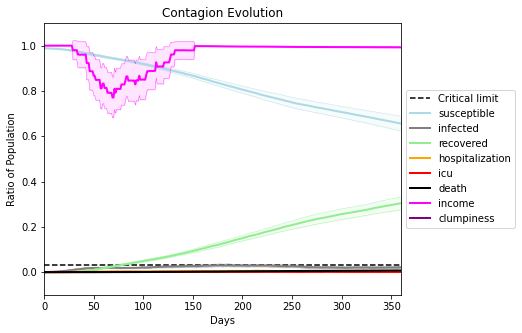

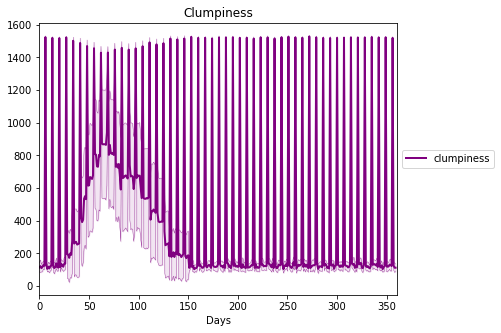

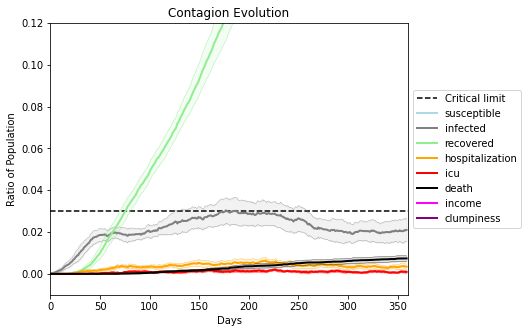

In [14]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.991
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8263, 751, 1955, 8160, 5856, 3161, 9233, 2513, 262, 8617, 9500, 8207, 4725, 8100, 4905, 6980, 5893, 2008, 3733, 1102]
Average similarity between family members is 0.9129533751911536 at temperature -0.99
Average similarity between family and home is 0.9998560447484595 at temperature -1
Average similarity between students and their classroom is 0.7846698100711352 at temperature -0.99
Average classroom occupancy is 1.6440677966101696 and number classrooms is 177
Average similarity between workers is 0.8329120261519355 at temperature -0.99
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.8415571395363455 for kids: 0.7300619382357294
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings


avg restaurant similarity 0.5382167371006631
avg restaurant similarity 0.49626595498003884
avg restaurant similarity 0.38985313436848673
avg restaurant similarity 0.5953010234010975
avg restaurant similarity 0.41324980619883067
avg restaurant similarity 0.5494379922661451
avg restaurant similarity 0.5513084899752511
avg restaurant similarity 0.48855741236280453
avg restaurant similarity 0.5901605660138558
avg restaurant similarity 0.5594784896064116
avg restaurant similarity 0.5583115996004436
avg restaurant similarity 0.4846250440597514
avg restaurant similarity 0.43296693985188217
avg restaurant similarity 0.481249915295074
avg restaurant similarity 0.6117130051207278
avg restaurant similarity 0.5942798646886908
avg restaurant similarity 0.4355719661959335
avg restaurant similarity 0.5092025946406091
avg restaurant similarity 0.6439467534440724
avg restaurant similarity 0.44963207940556155
avg restaurant similarity 0.4835500592105694
avg restaurant similarity 0.5343890978285286
avg r

avg restaurant similarity 0.48506891132637536
avg restaurant similarity 0.4182914300393637
avg restaurant similarity 0.4413402009927474
avg restaurant similarity 0.5012122914512087
avg restaurant similarity 0.6067732858459898
avg restaurant similarity 0.40176615859544196
avg restaurant similarity 0.5334098489270416
avg restaurant similarity 0.5506155841400796
avg restaurant similarity 0.33920720555733025
avg restaurant similarity 0.555993472228342
avg restaurant similarity 0.5166446194055725
avg restaurant similarity 0.6477280303421072
avg restaurant similarity 0.4949016674938245
avg restaurant similarity 0.4718714812423168
avg restaurant similarity 0.39969835520313307
avg restaurant similarity 0.6201170316387862
avg restaurant similarity 0.4548213608396235
avg restaurant similarity 0.48479199755549146
avg restaurant similarity 0.5042478262726288
avg restaurant similarity 0.5790519047730001
avg restaurant similarity 0.42217652854332666
avg restaurant similarity 0.572752722299038
avg re

Average similarity between workers is 0.8065982881924044 at temperature -0.99
Average office occupancy is 3.311224489795918 and number offices is 196
Average friend similarity for adults: 0.8176410991374898 for kids: 0.711087848950382
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 1

avg restaurant similarity 0.5698988938761533
avg restaurant similarity 0.4753477805635001
avg restaurant similarity 0.4270520631059939
avg restaurant similarity 0.5141999459272473
avg restaurant similarity 0.5320676134426415
avg restaurant similarity 0.4319023910991796
avg restaurant similarity 0.5271624363814468
avg restaurant similarity 0.47044551610184804
avg restaurant similarity 0.49411126311534853
avg restaurant similarity 0.5273491126710176
avg restaurant similarity 0.34311251575224005
avg restaurant similarity 0.4120684811867455
avg restaurant similarity 0.3644805490801529
avg restaurant similarity 0.4483073220107713
avg restaurant similarity 0.37080905722716107
avg restaurant similarity 0.5519120557388326
avg restaurant similarity 0.4256608841709901
avg restaurant similarity 0.4421289942805844
avg restaurant similarity 0.5041329047539362
avg restaurant similarity 0.4502251723878457
avg restaurant similarity 0.46031289318994834
avg restaurant similarity 0.4554156295882407
avg r

avg restaurant similarity 0.3500185288348692
avg restaurant similarity 0.4149547848107108
avg restaurant similarity 0.38185580195471425
avg restaurant similarity 0.3652782935598233
avg restaurant similarity 0.4735146178109763
avg restaurant similarity 0.5149511889406033
avg restaurant similarity 0.4507550962700813
avg restaurant similarity 0.36853059836622337
avg restaurant similarity 0.36261235206296377
avg restaurant similarity 0.46844667876107793
avg restaurant similarity 0.5023590659873929
avg restaurant similarity 0.40037434225129276
avg restaurant similarity 0.5091947899392857
avg restaurant similarity 0.4048975875038049
avg restaurant similarity 0.4491957092077654
avg restaurant similarity 0.5023892605509279
avg restaurant similarity 0.40676876948949886
avg restaurant similarity 0.4040021063135325
avg restaurant similarity 0.3921082133896834
avg restaurant similarity 0.43754202296250905
avg restaurant similarity 0.5650087916809686
avg restaurant similarity 0.37119001293320475
av

Average similarity between workers is 0.8124092635402018 at temperature -0.99
Average office occupancy is 3.3711340206185567 and number offices is 194
Average friend similarity for adults: 0.8171664050238918 for kids: 0.7143013794774907
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 

avg restaurant similarity 0.8624938940551405
avg restaurant similarity 0.5023479245621549
avg restaurant similarity 0.5251713914222874
avg restaurant similarity 0.43305756356165526
avg restaurant similarity 0.41610371547589653
avg restaurant similarity 0.6040710404393874
avg restaurant similarity 0.5479803152502991
avg restaurant similarity 0.4741105534441153
avg restaurant similarity 0.6771752267926521
avg restaurant similarity 0.8917159896933364
avg restaurant similarity 0.4564625149841023
avg restaurant similarity 0.49487109486481323
avg restaurant similarity 0.585128565824344
avg restaurant similarity 0.4430967850879297
avg restaurant similarity 0.8120028863334596
avg restaurant similarity 0.4162558136807913
avg restaurant similarity 0.3894265104376745
avg restaurant similarity 0.6269516230242146
avg restaurant similarity 0.40827544777099023
avg restaurant similarity 0.5864017544148725
avg restaurant similarity 0.5153610656912506
avg restaurant similarity 0.5439946736952005
avg res

avg restaurant similarity 0.4992512675305957
avg restaurant similarity 0.5170842063571334
avg restaurant similarity 0.45134988900629636
avg restaurant similarity 0.5837621522166626
avg restaurant similarity 0.6063433578143824
avg restaurant similarity 0.5170421457290113
avg restaurant similarity 0.6147132731134402
avg restaurant similarity 0.483324255929236
avg restaurant similarity 0.5884138996001789
avg restaurant similarity 0.5697240630788908
avg restaurant similarity 0.4926454995646492
avg restaurant similarity 0.44061462542558827
avg restaurant similarity 0.7241435641665351
avg restaurant similarity 0.42344537241873564
avg restaurant similarity 0.5217261451798166
avg restaurant similarity 0.5691614508428102
avg restaurant similarity 0.49093058457808286
avg restaurant similarity 0.5049291186574133
avg restaurant similarity 0.5227423312949012
avg restaurant similarity 0.4170414919780606
avg restaurant similarity 0.5229092706914236
avg restaurant similarity 0.4719027360427908
avg res

Average similarity between workers is 0.81572124338092 at temperature -0.99
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.8232075298970707 for kids: 0.7066266084749279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 pe

avg restaurant similarity 0.4864026226119768
avg restaurant similarity 0.5117955308758182
avg restaurant similarity 0.4710512028354114
avg restaurant similarity 0.5913377285779103
avg restaurant similarity 0.516232778717783
avg restaurant similarity 0.6459516224636039
avg restaurant similarity 0.42462401287241247
avg restaurant similarity 0.5752140028592698
avg restaurant similarity 0.6277006270473894
avg restaurant similarity 0.5682271499646876
avg restaurant similarity 0.4932553269092479
avg restaurant similarity 0.6509905388287585
avg restaurant similarity 0.5648118050273813
avg restaurant similarity 0.3468054123393259
avg restaurant similarity 0.6562761272221245
avg restaurant similarity 0.6494753070884074
avg restaurant similarity 0.4815697944590612
avg restaurant similarity 0.2392682610288612
avg restaurant similarity 0.40250133778664426
avg restaurant similarity 0.37118884756904236
avg restaurant similarity 0.37655968798020373
avg restaurant similarity 0.5178831377707301
avg res

avg restaurant similarity 0.46716758929505897
avg restaurant similarity 0.5040260949429639
avg restaurant similarity 0.3321212278840115
avg restaurant similarity 0.5909409959092947
avg restaurant similarity 0.3651688310498483
avg restaurant similarity 0.6146973729969446
avg restaurant similarity 0.3283497010427344
avg restaurant similarity 0.6141262531462736
avg restaurant similarity 0.5734091261564372
avg restaurant similarity 0.5786152437991862
avg restaurant similarity 0.49783107261089415
avg restaurant similarity 0.4912771112873419
avg restaurant similarity 0.35075527465647105
avg restaurant similarity 0.4826232248858349
avg restaurant similarity 0.5595215737285318
avg restaurant similarity 0.8057021463204516
avg restaurant similarity 0.43539181044099523
avg restaurant similarity 0.2819352940326576
avg restaurant similarity 0.5262039354756844
avg restaurant similarity 0.41000526221971656
avg restaurant similarity 0.6499587593210301
avg restaurant similarity 0.4828216700982516
avg r

Average similarity between workers is 0.8270917424559331 at temperature -0.99
Average office occupancy is 3.3385416666666665 and number offices is 192
Average friend similarity for adults: 0.8272165593175385 for kids: 0.7183270407476351
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.44684869242193476
avg restaurant similarity 0.6894936097734572
avg restaurant similarity 0.3506595235134021
avg restaurant similarity 0.5178945315432874
avg restaurant similarity 0.4300649595527592
avg restaurant similarity 0.33984709816352665
avg restaurant similarity 0.6555791085020986
avg restaurant similarity 0.4263449574401689
avg restaurant similarity 0.4719156957266012
avg restaurant similarity 0.2796217682250431
avg restaurant similarity 0.537572899699217
avg restaurant similarity 0.2727315945545311
avg restaurant similarity 0.2722207528369823
avg restaurant similarity 0.5579210603299326
avg restaurant similarity 0.52400739376656
avg restaurant similarity 0.37250310515276636
avg restaurant similarity 0.3918245866969659
avg restaurant similarity 0.5508578976141192
avg restaurant similarity 0.641144535012863
avg restaurant similarity 0.4256906640019514
avg restaurant similarity 0.5904930121874448
avg restaurant similarity 0.42553989542076803
avg restau

avg restaurant similarity 0.17911435110242735
avg restaurant similarity 0.5512399836291848
avg restaurant similarity 0.283579668998823
avg restaurant similarity 0.46027547459267737
avg restaurant similarity 0.4414989216131698
avg restaurant similarity 0.5990049952389408
avg restaurant similarity 0.5605960958816107
avg restaurant similarity 0.434365855040235
avg restaurant similarity 0.44945066701157976
avg restaurant similarity 0.46992795393122594
avg restaurant similarity 0.4751966705116285
avg restaurant similarity 0.5095449264091312
avg restaurant similarity 0.434747271769533
avg restaurant similarity 0.6625904559082271
avg restaurant similarity 0.4413703069800217
avg restaurant similarity 0.49307199033122834
avg restaurant similarity 0.41281932874869054
avg restaurant similarity 0.48335526932738004
avg restaurant similarity 0.37049401328858567
avg restaurant similarity 0.5317973582001655
avg restaurant similarity 0.4106741635736001
avg restaurant similarity 0.5442230008272437
avg r

avg restaurant similarity 0.6140249721838463
avg restaurant similarity 0.45544127067701085
avg restaurant similarity 0.5744318884662832
avg restaurant similarity 0.6328809586131043
avg restaurant similarity 0.4489103625098889
avg restaurant similarity 0.5130646567707247
avg restaurant similarity 0.6025803297801358
avg restaurant similarity 0.39991630216515
avg restaurant similarity 0.38205067488468314
avg restaurant similarity 0.37221846951570814
avg restaurant similarity 0.4230749006684192
avg restaurant similarity 0.4818134950704944
avg restaurant similarity 0.48990417135184194
avg restaurant similarity 0.6145424920018676
avg restaurant similarity 0.5129136835280373
avg restaurant similarity 0.51139617568202
avg restaurant similarity 0.7507607308282286
avg restaurant similarity 0.5705051275708561
avg restaurant similarity 0.5925417564679745
avg restaurant similarity 0.4998713022728318
avg restaurant similarity 0.7114155545793308
avg restaurant similarity 0.4536406098960826
avg restau

avg restaurant similarity 0.4655898575089224
avg restaurant similarity 0.5413043190844696
avg restaurant similarity 0.232860443897682
avg restaurant similarity 0.6046454974159292
avg restaurant similarity 0.718302253221714
avg restaurant similarity 0.5309638670397043
avg restaurant similarity 0.5602088561794808
avg restaurant similarity 0.7883793519923636
avg restaurant similarity 0.9994034192527559
avg restaurant similarity 0.5022805306208353
avg restaurant similarity 0.5445634207247627
avg restaurant similarity 0.5638861235843099
avg restaurant similarity 0.39773341735344286
avg restaurant similarity 0.4625976587362718
avg restaurant similarity 0.48004483719027274
avg restaurant similarity 0.3047713401335903
avg restaurant similarity 0.4222956988162649
avg restaurant similarity 0.39290989798379866
avg restaurant similarity 0.6671068705725252
avg restaurant similarity 0.4594641486017366
avg restaurant similarity 0.4603138953052568
avg restaurant similarity 0.651006966570507
avg restau

Average friend similarity for adults: 0.8327963404379116 for kids: 0.7130601650972316
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.48760221073710525
avg restaurant similarity 0.7354758936875399
avg restaurant similarity 0.7039660958673789
avg restaurant similarity 0.3830345910787866
avg restaurant similarity 0.6223619601678652
avg restaurant similarity 0.6241667303778026
avg restaurant similarity 0.49685549849694516
avg restaurant similarity 0.5346473018933878
avg restaurant similarity 0.34538782792878553
avg restaurant similarity 0.5168403892023757
avg restaurant similarity 0.6142880344508787
avg restaurant similarity 0.6837364541822348
avg restaurant similarity 0.638481651900176
avg restaurant similarity 0.3297365737548211
avg restaurant similarity 0.5563965515866379
avg restaurant similarity 0.5185561766971454
avg restaurant similarity 0.5512420403914197
avg restaurant similarity 0.5815502709722485
avg restaurant similarity 0.4000006226374618
avg restaurant similarity 0.42997803916092175
avg restaurant similarity 0.4922316526425316
avg restaurant similarity 0.46975400768072173
avg re

avg restaurant similarity 0.6777335047924045
avg restaurant similarity 0.24191329915517173
avg restaurant similarity 0.4511271608568827
avg restaurant similarity 0.5093970619105154
avg restaurant similarity 0.45982039952755405
avg restaurant similarity 0.37674234124592315
avg restaurant similarity 0.5116384604998147
avg restaurant similarity 0.3928014193080125
avg restaurant similarity 0.5165533773647752
avg restaurant similarity 0.6878534008539674
avg restaurant similarity 0.515455989135511
avg restaurant similarity 0.4457944122984048
avg restaurant similarity 0.6420417278508904
avg restaurant similarity 0.3676357707240386
avg restaurant similarity 0.7236813072759377
avg restaurant similarity 0.6340912020418598
avg restaurant similarity 0.35043166125544495
avg restaurant similarity 0.47699905985435226
avg restaurant similarity 0.370113794018643
avg restaurant similarity 0.5074715497094056
avg restaurant similarity 0.5807839157082791
avg restaurant similarity 0.3276067840907932
avg res

avg restaurant similarity 0.6739959626551152
avg restaurant similarity 0.5402435007302497
avg restaurant similarity 0.4879218926316993
avg restaurant similarity 0.5099255251320284
avg restaurant similarity 0.5427044256338104
avg restaurant similarity 0.5923799681154294
avg restaurant similarity 0.5638331072073112
avg restaurant similarity 0.48912620356835323
avg restaurant similarity 0.5451824679477782
avg restaurant similarity 0.47187056221634904
avg restaurant similarity 0.76507586446548
avg restaurant similarity 0.5815787915356027
avg restaurant similarity 0.5502756503263103
avg restaurant similarity 0.8314173326152176
avg restaurant similarity 0.4480309727302265
avg restaurant similarity 0.48112547290123603
avg restaurant similarity 0.5850872074256414
avg restaurant similarity 0.5905712423697724
avg restaurant similarity 0.5517979824054071
avg restaurant similarity 0.6604014764596848
avg restaurant similarity 0.4849147504248859
avg restaurant similarity 0.7029205914199678
avg resta

avg restaurant similarity 0.5461859133397233
avg restaurant similarity 0.40710173604091954
avg restaurant similarity 0.5755871365956508
avg restaurant similarity 0.623804229855865
avg restaurant similarity 0.478384692940784
avg restaurant similarity 0.5211657475798256
avg restaurant similarity 0.4837872323859441
avg restaurant similarity 0.5488179178275435
avg restaurant similarity 0.5937738405803026
avg restaurant similarity 0.648447578350425
avg restaurant similarity 0.6031065674537601
avg restaurant similarity 0.6207370254225801
avg restaurant similarity 0.6448829720320939
avg restaurant similarity 0.5948696074296211
avg restaurant similarity 0.5615409931194513
avg restaurant similarity 0.4288666623011463
avg restaurant similarity 0.6361266274680112
avg restaurant similarity 0.5809894473110412
avg restaurant similarity 0.5350356621858654
avg restaurant similarity 0.6576571662492678
avg restaurant similarity 0.49061830478272306
avg restaurant similarity 0.45359030739739
avg restauran

Average similarity between workers is 0.8095885734752329 at temperature -0.99
Average office occupancy is 3.4 and number offices is 195
Average friend similarity for adults: 0.8224227444793848 for kids: 0.6974470847056213
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people alloca

avg restaurant similarity 0.33587730566320767
avg restaurant similarity 0.4586125998321433
avg restaurant similarity 0.4835056454165576
avg restaurant similarity 0.5708333779326057
avg restaurant similarity 0.585930078142475
avg restaurant similarity 0.4852319646924616
avg restaurant similarity 0.3435739763521747
avg restaurant similarity 0.5847670169433337
avg restaurant similarity 0.3961965664184521
avg restaurant similarity 0.4617718167552085
avg restaurant similarity 0.4728633697844692
avg restaurant similarity 0.40896094160502655
avg restaurant similarity 0.20872633903872218
avg restaurant similarity 0.6294668539407346
avg restaurant similarity 0.44667613042806104
avg restaurant similarity 0.49313790718873873
avg restaurant similarity 0.5000267540525128
avg restaurant similarity 0.7577266673162896
avg restaurant similarity 0.5738887462866205
avg restaurant similarity 0.38567976812115295
avg restaurant similarity 0.3673349597527649
avg restaurant similarity 0.4358317944862418
avg r

avg restaurant similarity 0.4269592621118935
avg restaurant similarity 0.44529938343175046
avg restaurant similarity 0.8277820559024034
avg restaurant similarity 0.28287222969946024
avg restaurant similarity 0.5910160445118448
avg restaurant similarity 0.5020406336248728
avg restaurant similarity 0.5154991769041176
avg restaurant similarity 0.7463669540084791
avg restaurant similarity 0.3072510840883372
avg restaurant similarity 0.6874749863676594
avg restaurant similarity 0.39596068084304226
avg restaurant similarity 0.6137953708349956
avg restaurant similarity 0.557007926380425
avg restaurant similarity 0.40576985581105207
avg restaurant similarity 0.44596545801354764
avg restaurant similarity 0.49633142814173203
avg restaurant similarity 0.4790339007241004
avg restaurant similarity 0.4474064709277705
avg restaurant similarity 0.814748505928383
avg restaurant similarity 0.42946382605262046
avg restaurant similarity 0.3271871459893399
avg restaurant similarity 0.5328866217314406
avg r

avg restaurant similarity 0.3982658215918945
avg restaurant similarity 0.48189891820145014
avg restaurant similarity 0.4084651419044053
avg restaurant similarity 0.46626304153424236
avg restaurant similarity 0.44001969628711585
avg restaurant similarity 0.5487993618767915
avg restaurant similarity 0.5037338049561686
avg restaurant similarity 0.3359675592499063
avg restaurant similarity 0.4588861450288375
avg restaurant similarity 0.34369818775130984
avg restaurant similarity 0.6204119672389856
avg restaurant similarity 0.7657306634394621
avg restaurant similarity 0.7054417539664237
avg restaurant similarity 0.5592117642119557
avg restaurant similarity 0.5535224112914069
avg restaurant similarity 0.4736809203937927
avg restaurant similarity 0.44453700279401803
avg restaurant similarity 0.4558684400157637
avg restaurant similarity 0.5400784697132351
avg restaurant similarity 0.5019736374675615
avg restaurant similarity 0.6527309676864703
avg restaurant similarity 0.4079690711679532
avg r

avg restaurant similarity 0.7846101011283759
avg restaurant similarity 0.4763911225903103
avg restaurant similarity 0.4100212672805483
avg restaurant similarity 0.3975093976143167
avg restaurant similarity 0.30822488959493355
avg restaurant similarity 0.5432947097564333
avg restaurant similarity 0.6180648260377182
avg restaurant similarity 0.41200133634019315
avg restaurant similarity 0.4809593966709607
avg restaurant similarity 0.4384654561844412
avg restaurant similarity 0.7672527030511898
avg restaurant similarity 0.3217317636093344
avg restaurant similarity 0.6176870836647598
avg restaurant similarity 0.35300973855901835
avg restaurant similarity 0.35097213747747447
avg restaurant similarity 0.466076584155459
avg restaurant similarity 0.47419655612781025
avg restaurant similarity 0.5950561158118856
avg restaurant similarity 0.36540388494884574
avg restaurant similarity 0.6031438743217271
avg restaurant similarity 0.5179819573609524
avg restaurant similarity 0.6069093863877408
avg r

Average similarity between workers is 0.8333346419962421 at temperature -0.99
Average office occupancy is 3.46875 and number offices is 192
Average friend similarity for adults: 0.8361099633801821 for kids: 0.7305305307393692
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people 

avg restaurant similarity 0.4889135966796123
avg restaurant similarity 0.6029043873119216
avg restaurant similarity 0.4662880398229469
avg restaurant similarity 0.5245403842520583
avg restaurant similarity 0.49714761246614003
avg restaurant similarity 0.6726217148763317
avg restaurant similarity 0.43889701951675886
avg restaurant similarity 0.5567437766797996
avg restaurant similarity 0.5055856700370034
avg restaurant similarity 0.6093351717047975
avg restaurant similarity 0.6729401290275947
avg restaurant similarity 0.7986909008534155
avg restaurant similarity 0.6746047532116615
avg restaurant similarity 0.38528996502504204
avg restaurant similarity 0.6739625276641557
avg restaurant similarity 0.39380741793193863
avg restaurant similarity 0.5421940185678367
avg restaurant similarity 0.4371966729498494
avg restaurant similarity 0.4061273367684586
avg restaurant similarity 0.488123095680457
avg restaurant similarity 0.4618942302488403
avg restaurant similarity 0.4549209542104239
avg res

avg restaurant similarity 0.6344771378124046
avg restaurant similarity 0.5576221746649727
avg restaurant similarity 0.6545105516139155
avg restaurant similarity 0.424882930622108
avg restaurant similarity 0.5852022425326251
avg restaurant similarity 0.450248211393933
avg restaurant similarity 0.4526593310980902
avg restaurant similarity 0.5407992500006655
avg restaurant similarity 0.7696200636480487
avg restaurant similarity 0.504890544090469
avg restaurant similarity 0.39127116542459484
avg restaurant similarity 0.7169699479656828
avg restaurant similarity 0.7015919269408801
avg restaurant similarity 0.35485419263035295
avg restaurant similarity 0.44070148117229024
avg restaurant similarity 0.44343281124940476
avg restaurant similarity 0.3397641257558814
avg restaurant similarity 0.5255886027521276
avg restaurant similarity 0.5806067227674684
avg restaurant similarity 0.49406433494586777
avg restaurant similarity 0.45424869218303354
avg restaurant similarity 0.5722796660568633
avg res

avg restaurant similarity 0.49919708984802785
avg restaurant similarity 0.4539606068975714
avg restaurant similarity 0.562843219409998
avg restaurant similarity 0.4681490007817581
avg restaurant similarity 0.4887430914396641
avg restaurant similarity 0.5694668574911267
avg restaurant similarity 0.44926278773329925
avg restaurant similarity 0.5591497924277031
avg restaurant similarity 0.4606503130735078
avg restaurant similarity 0.5570662174659097
avg restaurant similarity 0.49995960771744874
avg restaurant similarity 0.4719627912677215
avg restaurant similarity 0.5269444428411317
avg restaurant similarity 0.5032550631695367
avg restaurant similarity 0.5086989454443306
avg restaurant similarity 0.49338168308065294
avg restaurant similarity 0.6411294481237414
avg restaurant similarity 0.519142536922661
avg restaurant similarity 0.43620272202679344
avg restaurant similarity 0.5155269210349612
avg restaurant similarity 0.4966063444700193
avg restaurant similarity 0.44021715932620964
avg re

avg restaurant similarity 0.6604748630133035
avg restaurant similarity 0.5850313582508037
avg restaurant similarity 0.5944243264498033
avg restaurant similarity 0.512501491613744
avg restaurant similarity 0.4090461415501016
avg restaurant similarity 0.5732561849964831
avg restaurant similarity 0.6724185987627586
avg restaurant similarity 0.6516884242818435
avg restaurant similarity 0.527294439699317
avg restaurant similarity 0.6551759690028156
avg restaurant similarity 0.6469662263447924
avg restaurant similarity 0.4539091091224766
avg restaurant similarity 0.741328103919295
avg restaurant similarity 0.460812700516786
avg restaurant similarity 0.5822393769275926
avg restaurant similarity 0.4629165186133205
avg restaurant similarity 0.5250200702575989
avg restaurant similarity 0.45819435606569636
avg restaurant similarity 0.4684067224465087
avg restaurant similarity 0.669134864010199
avg restaurant similarity 0.7264754595990279
avg restaurant similarity 0.3585943675158322
avg restaurant

Average similarity between workers is 0.822490335836467 at temperature -0.99
Average office occupancy is 3.350785340314136 and number offices is 191
Average friend similarity for adults: 0.8336133791345038 for kids: 0.7213112601115194
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 peop

avg restaurant similarity 0.5580621847796194
avg restaurant similarity 0.3574751607192025
avg restaurant similarity 0.6331335327089526
avg restaurant similarity 0.49815023110394824
avg restaurant similarity 0.46294039721437547
avg restaurant similarity 0.45686915446881243
avg restaurant similarity 0.7188275596955211
avg restaurant similarity 0.5442932329898252
avg restaurant similarity 0.5008461909464297
avg restaurant similarity 0.41017837616760927
avg restaurant similarity 0.5427596885130449
avg restaurant similarity 0.4387539037408821
avg restaurant similarity 0.4653785811347811
avg restaurant similarity 0.6240425927406851
avg restaurant similarity 0.5008058020011543
avg restaurant similarity 0.44237588438430464
avg restaurant similarity 0.741077232944494
avg restaurant similarity 0.7071958953913854
avg restaurant similarity 0.5271216497751628
avg restaurant similarity 0.48273831603148004
avg restaurant similarity 0.6213952554154885
avg restaurant similarity 0.47401452136073097
avg 

avg restaurant similarity 0.5858292093356586
avg restaurant similarity 0.594052724788502
avg restaurant similarity 0.44002549342377417
avg restaurant similarity 0.5963122607945259
avg restaurant similarity 0.5085848787310784
avg restaurant similarity 0.5318226062328842
avg restaurant similarity 0.5713573737782973
avg restaurant similarity 0.3460967166866062
avg restaurant similarity 0.9116612086192157
avg restaurant similarity 0.5301835525235818
avg restaurant similarity 0.8231295767685494
avg restaurant similarity 0.6115173745826756
avg restaurant similarity 0.6431301607638071
avg restaurant similarity 0.44067259698898714
avg restaurant similarity 0.3687533753238463
avg restaurant similarity 0.5052147122414562
avg restaurant similarity 0.6668368307435442
avg restaurant similarity 0.4322514185982919
avg restaurant similarity 0.4615739149581248
avg restaurant similarity 0.5283968694576109
avg restaurant similarity 0.344923253280744
avg restaurant similarity 0.370929423358314
avg restaur

avg restaurant similarity 0.5796377377529319
avg restaurant similarity 0.4055568351032552
avg restaurant similarity 0.6609048216412495
avg restaurant similarity 0.6335366181754901
avg restaurant similarity 0.4736359262675236
avg restaurant similarity 0.4501072813957159
avg restaurant similarity 0.6882825729260366
avg restaurant similarity 0.6610002052903369
avg restaurant similarity 0.47622161060592666
avg restaurant similarity 0.47734264288614564
avg restaurant similarity 0.43901824836523706
avg restaurant similarity 0.4677787935247287
avg restaurant similarity 0.6415336080769711
avg restaurant similarity 0.4901903478293666
avg restaurant similarity 0.5299671347115974
avg restaurant similarity 0.3667762306404781
avg restaurant similarity 0.6422257221775012
avg restaurant similarity 0.6300425285454556
avg restaurant similarity 0.48819225702211194
avg restaurant similarity 0.5385536573916426
avg restaurant similarity 0.5086362093303931
avg restaurant similarity 0.4631807337729299
avg re

avg restaurant similarity 0.7404008615453689
avg restaurant similarity 0.4923603479055311
avg restaurant similarity 0.5288101653362695
avg restaurant similarity 0.4540979216249155
avg restaurant similarity 0.3933209555905399
avg restaurant similarity 0.4849488316433677
avg restaurant similarity 0.5286145901386567
avg restaurant similarity 0.6141731000332394
avg restaurant similarity 0.4270425891501251
avg restaurant similarity 0.4903017935316244
avg restaurant similarity 0.3860398307193301
avg restaurant similarity 0.38855851667346175
avg restaurant similarity 0.5216398133087491
avg restaurant similarity 0.39617482344073846
avg restaurant similarity 0.6360309729830653
avg restaurant similarity 0.5424588012792076
avg restaurant similarity 0.5226562727702598
avg restaurant similarity 0.489047000265619
avg restaurant similarity 0.56300397719045
avg restaurant similarity 0.5335947266343019
avg restaurant similarity 0.5497143803678354
avg restaurant similarity 0.43792449417984924
avg restau

Average similarity between workers is 0.8229313177383525 at temperature -0.99
Average office occupancy is 3.3383838383838382 and number offices is 198
Average friend similarity for adults: 0.8359054797886707 for kids: 0.7249992467918637
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 pe

avg restaurant similarity 0.451148187581685
avg restaurant similarity 0.5426927343283184
avg restaurant similarity 0.5598587383913072
avg restaurant similarity 0.6658950931069952
avg restaurant similarity 0.4396055348756528
avg restaurant similarity 0.5831953777034349
avg restaurant similarity 0.6847612300595065
avg restaurant similarity 0.6370790173546084
avg restaurant similarity 0.347181499866577
avg restaurant similarity 0.5703557910846967
avg restaurant similarity 0.3684747609478142
avg restaurant similarity 0.9301127026041739
avg restaurant similarity 0.34213158223370155
avg restaurant similarity 0.6756928249589415
avg restaurant similarity 0.4807138339559412
avg restaurant similarity 0.6735710268692817
avg restaurant similarity 0.6984275107736878
avg restaurant similarity 0.4193276626828281
avg restaurant similarity 0.6868272346268224
avg restaurant similarity 0.5876733631445823
avg restaurant similarity 0.47201320549544723
avg restaurant similarity 0.5310085797397058
avg restau

avg restaurant similarity 0.5822660682149056
avg restaurant similarity 0.31463524389884373
avg restaurant similarity 0.673759058002655
avg restaurant similarity 0.8481564462394814
avg restaurant similarity 0.4965907017220322
avg restaurant similarity 0.5256636698397594
avg restaurant similarity 0.6114991267026463
avg restaurant similarity 0.5877427577221167
avg restaurant similarity 0.6726831052037647
avg restaurant similarity 0.6410445906093323
avg restaurant similarity 0.4411169207117845
avg restaurant similarity 0.7738049756406054
avg restaurant similarity 0.44959955785303524
avg restaurant similarity 0.4936076711603367
avg restaurant similarity 0.5109091229708106
avg restaurant similarity 0.6080290143918884
avg restaurant similarity 0.8817502007833113
avg restaurant similarity 0.4233054668427588
avg restaurant similarity 0.3407614733862472
avg restaurant similarity 0.4436069105330335
avg restaurant similarity 0.5182507268355641
avg restaurant similarity 0.5564237590144543
avg resta

avg restaurant similarity 0.48294765387622995
avg restaurant similarity 0.30784955331542585
avg restaurant similarity 0.39763319896835625
avg restaurant similarity 0.41065708007316404
avg restaurant similarity 0.5059175903809858
avg restaurant similarity 0.4709888837083009
avg restaurant similarity 0.5869162919738607
avg restaurant similarity 0.37381141304062243
avg restaurant similarity 0.5599064128765318
avg restaurant similarity 0.43767852548657266
avg restaurant similarity 0.48810436222422615
avg restaurant similarity 0.3498625797848797
avg restaurant similarity 0.4865388234224788
avg restaurant similarity 0.4435611508261537
avg restaurant similarity 0.5045632788730436
avg restaurant similarity 0.46214427414663894
avg restaurant similarity 0.40322867285753244
avg restaurant similarity 0.3960348933715391
avg restaurant similarity 0.38029700383285747
avg restaurant similarity 0.49756311045388607
avg restaurant similarity 0.5608977060311439
avg restaurant similarity 0.515422568323374


avg restaurant similarity 0.5907490714320575
avg restaurant similarity 0.4535042517928266
avg restaurant similarity 0.38757881500242064
avg restaurant similarity 0.3981178795003269
avg restaurant similarity 0.44296787779581276
avg restaurant similarity 0.5411498568266531
avg restaurant similarity 0.5694422974437625
avg restaurant similarity 0.4816048914836176
avg restaurant similarity 0.44247913018889434
avg restaurant similarity 0.3996137273274317
avg restaurant similarity 0.5229645836493405
avg restaurant similarity 0.49263790088736675
avg restaurant similarity 0.4824617553420735
avg restaurant similarity 0.4010204060770217
avg restaurant similarity 0.7015545658054131
avg restaurant similarity 0.3933019777772857
avg restaurant similarity 0.3930852392807642
avg restaurant similarity 0.5916165600492287
avg restaurant similarity 0.6537951188391863
avg restaurant similarity 0.5146669187563186
avg restaurant similarity 0.3879493106244483
avg restaurant similarity 0.38233907912390597
avg r

Average friend similarity for adults: 0.8245402198193286 for kids: 0.7153811051725154
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.5363902095802379
avg restaurant similarity 0.6236650921830587
avg restaurant similarity 0.5628053942484954
avg restaurant similarity 0.5784392498890526
avg restaurant similarity 0.3406586773433746
avg restaurant similarity 0.5096829967546683
avg restaurant similarity 0.5847854219809726
avg restaurant similarity 0.6472914949787734
avg restaurant similarity 0.5297300740560644
avg restaurant similarity 0.45438517083374286
avg restaurant similarity 0.5845475488455114
avg restaurant similarity 0.5541886709671624
avg restaurant similarity 0.5308674944332644
avg restaurant similarity 0.5087155345744759
avg restaurant similarity 0.49498379128281417
avg restaurant similarity 0.4713872672316556
avg restaurant similarity 0.8402834587657749
avg restaurant similarity 0.44593723752034364
avg restaurant similarity 0.4827450994736535
avg restaurant similarity 0.538971910444293
avg restaurant similarity 0.6378051300121327
avg restaurant similarity 0.42924383915759495
avg res

avg restaurant similarity 0.641058908615079
avg restaurant similarity 0.5948076082422672
avg restaurant similarity 0.31631236772543225
avg restaurant similarity 0.5200946215717497
avg restaurant similarity 0.47005812613556647
avg restaurant similarity 0.4700778727570281
avg restaurant similarity 0.546014248182579
avg restaurant similarity 0.4719127119252974
avg restaurant similarity 0.6598923976168454
avg restaurant similarity 0.5600555141134514
avg restaurant similarity 0.43465083103708785
avg restaurant similarity 0.5060081230341541
avg restaurant similarity 0.7179786688985909
avg restaurant similarity 0.7162451121074669
avg restaurant similarity 0.41322123536107086
avg restaurant similarity 0.35771516568551714
avg restaurant similarity 0.5243924978351285
avg restaurant similarity 0.42646314280113673
avg restaurant similarity 0.43948396530764766
avg restaurant similarity 0.46343671462406344
avg restaurant similarity 0.6364116887362418
avg restaurant similarity 0.6819463400416246
avg 

avg restaurant similarity 0.5755477408800838
avg restaurant similarity 0.5535147916130516
avg restaurant similarity 0.42233869591274725
avg restaurant similarity 0.5950956756639545
avg restaurant similarity 0.6863348507048167
avg restaurant similarity 0.455226610645703
avg restaurant similarity 0.524240905243774
avg restaurant similarity 0.41401946768115067
avg restaurant similarity 0.5705499332525252
avg restaurant similarity 0.4958322493894072
avg restaurant similarity 0.48047634744166445
avg restaurant similarity 0.49580220651734963
avg restaurant similarity 0.6925016224744527
avg restaurant similarity 0.510690389750767
avg restaurant similarity 0.7228215781948796
avg restaurant similarity 0.5507715178250562
avg restaurant similarity 0.5525165947207685
avg restaurant similarity 0.5300563893322211
avg restaurant similarity 0.54145079932427
avg restaurant similarity 0.9997263867701
avg restaurant similarity 0.4810404177776244
avg restaurant similarity 0.4323444756854913
avg restaurant

avg restaurant similarity 0.4042615679633517
avg restaurant similarity 0.5224694801620446
avg restaurant similarity 0.41588632171671147
avg restaurant similarity 0.489453265359695
avg restaurant similarity 0.6179228758894276
avg restaurant similarity 0.591027699422512
avg restaurant similarity 0.47026358651738365
avg restaurant similarity 0.4884505220743269
avg restaurant similarity 0.6113885397306494
avg restaurant similarity 0.35616439154525714
avg restaurant similarity 0.3501569725948772
avg restaurant similarity 0.4964429548311159
avg restaurant similarity 0.4826538299133791
avg restaurant similarity 0.645737535036168
avg restaurant similarity 0.7726324941766882
avg restaurant similarity 0.4780644301227572
avg restaurant similarity 0.3561650714432928
avg restaurant similarity 0.490934689053566
avg restaurant similarity 0.3841191270308233
avg restaurant similarity 0.6237800695068297
avg restaurant similarity 0.6456440752239748
avg restaurant similarity 0.5461245232019404
avg restaur

Average similarity between workers is 0.8190156491092678 at temperature -0.99
Average office occupancy is 3.416243654822335 and number offices is 197
Average friend similarity for adults: 0.8375227679008902 for kids: 0.7174560980335395
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 

avg restaurant similarity 0.6169574478927923
avg restaurant similarity 0.559534863880346
avg restaurant similarity 0.5034014895713314
avg restaurant similarity 0.6105592295781604
avg restaurant similarity 0.6541000627174383
avg restaurant similarity 0.7092175966084655
avg restaurant similarity 0.4582874457535874
avg restaurant similarity 0.6176066944052441
avg restaurant similarity 0.471880026515463
avg restaurant similarity 0.6597527669398963
avg restaurant similarity 0.5154879586514927
avg restaurant similarity 0.4816508206110029
avg restaurant similarity 0.5228125430153179
avg restaurant similarity 0.516267531816025
avg restaurant similarity 0.6435810963752827
avg restaurant similarity 0.5230179864636791
avg restaurant similarity 0.6175632321264
avg restaurant similarity 0.5436568458181784
avg restaurant similarity 0.64769414911325
avg restaurant similarity 0.572569536691612
avg restaurant similarity 0.8333710293153924
avg restaurant similarity 0.5394008717372359
avg restaurant simi

avg restaurant similarity 0.5414576577611485
avg restaurant similarity 0.6595862114311102
avg restaurant similarity 0.4285293057265425
avg restaurant similarity 0.7715324266579193
avg restaurant similarity 0.557106542564001
avg restaurant similarity 0.5348715199644474
avg restaurant similarity 0.5603586852117431
avg restaurant similarity 0.484556006329145
avg restaurant similarity 0.49371346378679254
avg restaurant similarity 0.524813781783502
avg restaurant similarity 0.5920501281341246
avg restaurant similarity 0.5305424593260494
avg restaurant similarity 0.6576230627795059
avg restaurant similarity 0.6531378486802542
avg restaurant similarity 0.41020151109751785
avg restaurant similarity 0.4526972796641015
avg restaurant similarity 0.618826443834485
avg restaurant similarity 0.36736477278457313
avg restaurant similarity 0.8548545294850949
avg restaurant similarity 0.6230916534905484
avg restaurant similarity 0.12153332716995825
avg restaurant similarity 0.511408307105446
avg restaur

Average friend similarity for adults: 0.8290790161244931 for kids: 0.7370820841261453
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated

avg restaurant similarity 0.4931242154640043
avg restaurant similarity 0.430511592413467
avg restaurant similarity 0.48341778539338665
avg restaurant similarity 0.650622940567864
avg restaurant similarity 0.5552219347680384
avg restaurant similarity 0.49725902231834596
avg restaurant similarity 0.5733582484692465
avg restaurant similarity 0.5810079248059372
avg restaurant similarity 0.3139564822647296
avg restaurant similarity 0.7947688722617033
avg restaurant similarity 0.44092950484635934
avg restaurant similarity 0.484562471074873
avg restaurant similarity 0.5838486935129186
avg restaurant similarity 0.6005227457502672
avg restaurant similarity 0.3464259099844589
avg restaurant similarity 0.368893973244578
avg restaurant similarity 0.6387174357972732
avg restaurant similarity 0.5976406613314116
avg restaurant similarity 0.37214045071921953
avg restaurant similarity 0.22368219502233216
avg restaurant similarity 0.798609478965242
avg restaurant similarity 0.3670077891901349
avg restau

avg restaurant similarity 0.8736014486203991
avg restaurant similarity 0.3249752288957676
avg restaurant similarity 0.43941574578247133
avg restaurant similarity 0.47813454284507995
avg restaurant similarity 0.5027279644382463
avg restaurant similarity 0.5879291743997329
avg restaurant similarity 0.46633898452049066
avg restaurant similarity 0.4919785372091475
avg restaurant similarity 0.7461444335419253
avg restaurant similarity 0.4040177662395205
avg restaurant similarity 0.4533917122941726
avg restaurant similarity 0.5196048735238048
avg restaurant similarity 0.5803136621950965
avg restaurant similarity 0.44397894279133193
avg restaurant similarity 0.26319595889956443
avg restaurant similarity 0.5238863805819015
avg restaurant similarity 0.3832560873358238
avg restaurant similarity 0.4664828577524188
avg restaurant similarity 0.4707882448638136
avg restaurant similarity 0.5507537876213303
avg restaurant similarity 0.42648754536303635
avg restaurant similarity 0.5353395441549118
avg 

(<function dict.items>, <function dict.items>, <function dict.items>)

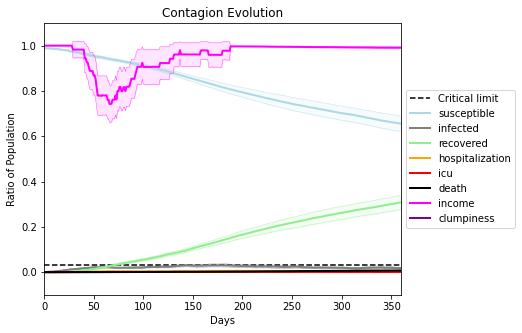

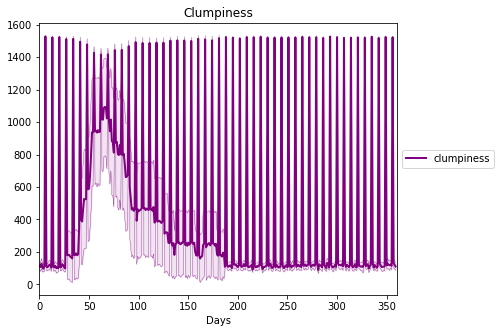

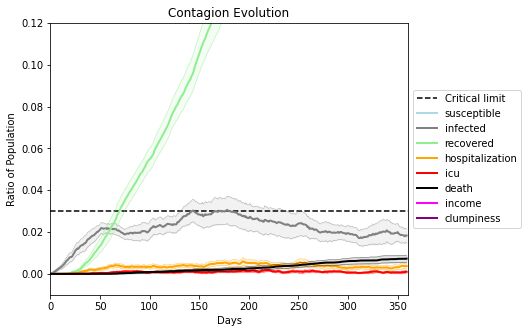

In [15]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.99
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], work_home_list = [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[7353, 8530, 6528, 8563, 2361, 7171, 4018, 3918, 6070, 1462, 6879, 9059, 9063, 5053, 9106, 6846, 2241, 8114, 516, 6718]
Average similarity between family members is 0.5524226245815339 at temperature -0.9
Average similarity between family and home is 0.9998532681204488 at temperature -1
Average similarity between students and their classroom is 0.2499608955350894 at temperature -0.9
Average classroom occupancy is 1.5691489361702127 and number classrooms is 188
Average similarity between workers is 0.43439304930630596 at temperature -0.9
Average office occupancy is 3.2 and number offices is 200
Average friend similarity for adults: 0.5939297390836139 for kids: 0.5051485187793927
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuild

avg restaurant similarity 0.0020456195902231467
avg restaurant similarity 0.10644390820351851
avg restaurant similarity 0.06381340746915144
avg restaurant similarity 0.37230544097092194
avg restaurant similarity 0.13310596670313157
avg restaurant similarity 0.2966402941794635
avg restaurant similarity -0.08924538740835737
avg restaurant similarity 0.21786156503579565
avg restaurant similarity 0.343787220228786
avg restaurant similarity 0.364374858087432
avg restaurant similarity 0.1807623052394369
avg restaurant similarity -0.042839882178288956
avg restaurant similarity 0.09948722819769872
avg restaurant similarity 0.2645802185193479
avg restaurant similarity 0.1139849531667722
avg restaurant similarity 0.11270681519243107
avg restaurant similarity 0.09082392912013146
avg restaurant similarity 0.038533238652457204
avg restaurant similarity -0.07726790875581895
avg restaurant similarity 0.14689818387624012
avg restaurant similarity 0.3079320252993556
avg restaurant similarity -0.0936327

avg restaurant similarity 0.06744039886818516
avg restaurant similarity 0.4083339136453178
avg restaurant similarity 0.20794235460713478
avg restaurant similarity 0.01518620302575284
avg restaurant similarity 0.17932580995477643
avg restaurant similarity 0.32319409289309564
avg restaurant similarity 0.01982649541639326
avg restaurant similarity 0.07726945357158939
avg restaurant similarity 0.2837198055621386
avg restaurant similarity 0.14610724901379007
avg restaurant similarity 0.380954150032042
avg restaurant similarity 0.28548179893276243
avg restaurant similarity 0.18495515749100364
avg restaurant similarity -0.1039497046306708
avg restaurant similarity 0.050113590141088994
avg restaurant similarity 0.15736928221571417
avg restaurant similarity -0.03957724540103639
avg restaurant similarity -0.01826964770542025
avg restaurant similarity 0.38071821464744654
avg restaurant similarity 0.16720802994258194
avg restaurant similarity 0.13425516083469194
avg restaurant similarity 0.1636280

avg restaurant similarity 0.3011784382822471
Average similarity between family members is 0.5357745078114197 at temperature -0.9
Average similarity between family and home is 0.9998531316738988 at temperature -1
Average similarity between students and their classroom is 0.25498416882608504 at temperature -0.9
Average classroom occupancy is 1.6842105263157894 and number classrooms is 190
Average similarity between workers is 0.43362494110208005 at temperature -0.9
Average office occupancy is 3.1625615763546797 and number offices is 203
Average friend similarity for adults: 0.5915079224793738 for kids: 0.5084664505725558
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 peop

avg restaurant similarity 0.08868130539166688
avg restaurant similarity -0.021273356711880936
avg restaurant similarity 0.1335939951484187
avg restaurant similarity -0.0030262037122626303
avg restaurant similarity 0.06995065053639585
avg restaurant similarity 0.017863920043075368
avg restaurant similarity -0.11454183701030932
avg restaurant similarity 0.18280318138317506
avg restaurant similarity 0.023309981246341854
avg restaurant similarity -0.09675503743667274
avg restaurant similarity -0.011295691162014353
avg restaurant similarity 0.07478964254356034
avg restaurant similarity 0.06768284125551181
avg restaurant similarity 0.246829017448424
avg restaurant similarity -0.052670122533556234
avg restaurant similarity -0.09229860396408085
avg restaurant similarity -0.028644259528814317
avg restaurant similarity 0.07784847837739042
avg restaurant similarity 0.06292045864637336
avg restaurant similarity 0.10447020447179052
avg restaurant similarity 0.12977418486817016
avg restaurant simila

avg restaurant similarity 0.051825939884837774
avg restaurant similarity 0.015076440710040315
avg restaurant similarity 0.07363073786936032
avg restaurant similarity -0.06373488554727066
avg restaurant similarity 0.25812515820969584
avg restaurant similarity 0.1033730400091453
avg restaurant similarity 0.0809808817381151
avg restaurant similarity 0.0789443600927008
avg restaurant similarity -0.10970973384328878
avg restaurant similarity 0.0043316923934462424
avg restaurant similarity 0.11039510179078178
avg restaurant similarity 0.12353450670634232
avg restaurant similarity -0.10726032241939071
avg restaurant similarity -0.18355318798268058
avg restaurant similarity 0.14134587264147733
avg restaurant similarity 0.03510375007107438
avg restaurant similarity -0.11680800932686851
avg restaurant similarity 0.062023106683560224
avg restaurant similarity 0.12358738923394785
avg restaurant similarity 0.1883013663215955
avg restaurant similarity 0.14976143584326004
avg restaurant similarity 0.

Average similarity between family members is 0.556929520853762 at temperature -0.9
Average similarity between family and home is 0.9998547358542881 at temperature -1
Average similarity between students and their classroom is 0.24206576306511668 at temperature -0.9
Average classroom occupancy is 1.5668449197860963 and number classrooms is 187
Average similarity between workers is 0.46636179357971924 at temperature -0.9
Average office occupancy is 3.2524752475247523 and number offices is 202
Average friend similarity for adults: 0.6052548961023729 for kids: 0.5102263874953522
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity -0.12509381812815507
avg restaurant similarity -0.01698673732460744
avg restaurant similarity 0.21051800473067261
avg restaurant similarity -0.0789822920354753
avg restaurant similarity 0.20772061179206577
avg restaurant similarity 0.2096940731942304
avg restaurant similarity 0.053931084848784706
avg restaurant similarity 0.0793878237920461
avg restaurant similarity 0.1312137057277358
avg restaurant similarity -0.00676050430820126
avg restaurant similarity -0.05269986435919207
avg restaurant similarity 0.1419991912418585
avg restaurant similarity 0.16123890934768512
avg restaurant similarity -0.06686039478433638
avg restaurant similarity -0.06887606381774009
avg restaurant similarity 0.10754458932354959
avg restaurant similarity 0.18128194242511525
avg restaurant similarity 0.007296698924490392
avg restaurant similarity 0.17170172470988715
avg restaurant similarity -0.0081450324816209
avg restaurant similarity 0.014942770450998843
avg restaurant similarity 0.3

avg restaurant similarity 0.24336936968207817
avg restaurant similarity 0.12023081641451325
avg restaurant similarity -0.20419234029029928
avg restaurant similarity 0.258224701953569
avg restaurant similarity -0.045238667771939765
avg restaurant similarity 0.32558518537344877
avg restaurant similarity -0.022168311551537825
avg restaurant similarity 0.32457083329390707
avg restaurant similarity 0.09497997156244259
avg restaurant similarity -0.07391640274084708
avg restaurant similarity -0.297043156941691
avg restaurant similarity 0.35526945817803324
avg restaurant similarity 0.15515428655970778
avg restaurant similarity 0.08976626291662164
avg restaurant similarity 0.07516535018141283
avg restaurant similarity 0.28870588050118645
avg restaurant similarity -0.17603353251494552
avg restaurant similarity 0.19875792426482292
avg restaurant similarity 0.03635836052572959
avg restaurant similarity 0.12091448449043513
avg restaurant similarity 0.04715907309433346
avg restaurant similarity -0.2

Average similarity between workers is 0.45201988755337885 at temperature -0.9
Average office occupancy is 3.196078431372549 and number offices is 204
Average friend similarity for adults: 0.6038511318112685 for kids: 0.5017623102068265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.03375978226456442
avg restaurant similarity 0.10394836121576473
avg restaurant similarity 0.0032837963295864747
avg restaurant similarity 0.35517286336631665
avg restaurant similarity -0.042882378933968776
avg restaurant similarity 0.35023569367414287
avg restaurant similarity -0.15936506396782363
avg restaurant similarity 0.3115102775468225
avg restaurant similarity 0.20211574931192652
avg restaurant similarity -0.006515868566660581
avg restaurant similarity -0.11451720916747196
avg restaurant similarity 0.10378427263606876
avg restaurant similarity 0.1484783552718953
avg restaurant similarity 0.28324381013870165
avg restaurant similarity -0.04652982101390183
avg restaurant similarity 0.033390254695151195
avg restaurant similarity 0.3490505847164322
avg restaurant similarity 0.18735492692759081
avg restaurant similarity 0.14746367932078014
avg restaurant similarity 0.37636475779412165
avg restaurant similarity 0.23650123422598
avg restaurant similarity 0.17

avg restaurant similarity 0.15064029115860217
avg restaurant similarity -0.09267621657002667
avg restaurant similarity 0.22176484291552115
avg restaurant similarity 0.0702581271205997
avg restaurant similarity 0.07910241043030197
avg restaurant similarity 0.1663153704329756
avg restaurant similarity 0.02209730080201533
avg restaurant similarity 0.4343478216125155
avg restaurant similarity 0.33830150570727807
avg restaurant similarity 0.3378650606201381
avg restaurant similarity 0.19294894422847617
avg restaurant similarity 0.2964092404543225
avg restaurant similarity -0.0928070198376254
avg restaurant similarity 0.563878829377711
avg restaurant similarity -0.03256212398703439
avg restaurant similarity 0.31625454122285435
avg restaurant similarity -0.11430066762929687
avg restaurant similarity 0.45509498532253295
avg restaurant similarity 0.19899730392274795
avg restaurant similarity 0.29890893548913205
avg restaurant similarity 0.18404978586424736
avg restaurant similarity 0.2834339974

avg restaurant similarity 0.11404453292059366
avg restaurant similarity 0.10092752145538074
avg restaurant similarity 0.056179880555860005
avg restaurant similarity 0.09108957435223822
avg restaurant similarity 0.1654635097444311
avg restaurant similarity 0.1174605176310487
avg restaurant similarity 0.15877467701021705
avg restaurant similarity -0.11472119908207132
avg restaurant similarity 0.050088720628006074
avg restaurant similarity 0.12207837447255987
avg restaurant similarity -0.04377547956448224
avg restaurant similarity 0.2642770699569901
avg restaurant similarity 0.1321407876742709
avg restaurant similarity 0.24347726065151612
avg restaurant similarity 0.1614406165222223
avg restaurant similarity 0.1606310224617033
avg restaurant similarity 0.17251338470162492
avg restaurant similarity 0.13570312287408795
avg restaurant similarity 0.21405935207836937
avg restaurant similarity 0.34543391175124244
avg restaurant similarity 0.11166499626620276
avg restaurant similarity 0.04476767

avg restaurant similarity 0.5122199878330664
avg restaurant similarity 0.2533653197753926
avg restaurant similarity -0.053470716004751534
avg restaurant similarity 0.12784613798653835
avg restaurant similarity 0.142116211618725
avg restaurant similarity 0.2718548591272494
avg restaurant similarity -0.137377582437995
avg restaurant similarity 0.05805604875287872
avg restaurant similarity 0.12559485097462553
avg restaurant similarity 0.10443024142615101
avg restaurant similarity 0.11337040834476732
avg restaurant similarity 0.2891853875079603
avg restaurant similarity 0.1366045355018047
avg restaurant similarity 0.04771194976499625
avg restaurant similarity 0.4544474928208679
avg restaurant similarity 0.10141474968578233
avg restaurant similarity 0.3886636726972902
avg restaurant similarity 0.2268984855601934
avg restaurant similarity 0.08520050744278819
avg restaurant similarity 0.17869848387625076
avg restaurant similarity 0.13093034840886322
avg restaurant similarity -0.09945249863200

avg restaurant similarity 0.31009727800941145
Average similarity between family members is 0.5575809477176443 at temperature -0.9
Average similarity between family and home is 0.9998492984157631 at temperature -1
Average similarity between students and their classroom is 0.25253706323616215 at temperature -0.9
Average classroom occupancy is 1.5754189944134078 and number classrooms is 179
Average similarity between workers is 0.45165360720823855 at temperature -0.9
Average office occupancy is 3.3069306930693068 and number offices is 202
Average friend similarity for adults: 0.6129105736185877 for kids: 0.5013735853904854
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18

avg restaurant similarity 0.07617541584619207
avg restaurant similarity 0.05962130346074266
avg restaurant similarity 0.264459848759993
avg restaurant similarity 0.035326853258737384
avg restaurant similarity 0.2863252913982145
avg restaurant similarity 0.16919126067425144
avg restaurant similarity 0.44494628259839375
avg restaurant similarity 0.24491380985336647
avg restaurant similarity 0.0035958096651390603
avg restaurant similarity 0.06598817071786707
avg restaurant similarity -0.030692923914013646
avg restaurant similarity 0.15110086041363152
avg restaurant similarity 0.3013011666052615
avg restaurant similarity 0.11745503303346402
avg restaurant similarity 0.2947160639552662
avg restaurant similarity 0.010794871192066922
avg restaurant similarity 0.012922422324208871
avg restaurant similarity 0.3218487359029433
avg restaurant similarity 0.1203986889269787
avg restaurant similarity 0.17753373910473677
avg restaurant similarity 0.16390985420316537
avg restaurant similarity 0.014766

avg restaurant similarity 0.017493160032644187
avg restaurant similarity 0.49945792232419484
avg restaurant similarity 0.23352721884613237
avg restaurant similarity 0.16422177968873708
avg restaurant similarity 0.3589005584550378
avg restaurant similarity 0.10619077320149214
avg restaurant similarity 0.3398430235079353
avg restaurant similarity 0.21825797265498623
avg restaurant similarity 0.17214412506761168
avg restaurant similarity 0.10743335210839514
avg restaurant similarity 0.22068768825529292
avg restaurant similarity 0.24485171604161812
avg restaurant similarity 0.05604878680494068
avg restaurant similarity 0.24722495054388766
avg restaurant similarity 0.195477497029425
avg restaurant similarity 0.08759140297361588
avg restaurant similarity 0.08381936619550608
avg restaurant similarity 0.21400784779930854
avg restaurant similarity 0.07252766490859214
avg restaurant similarity 0.14925045828355635
avg restaurant similarity 0.06797729927965993
avg restaurant similarity 0.488695555

Average similarity between family and home is 0.9998563811615491 at temperature -1
Average similarity between students and their classroom is 0.19196118654177904 at temperature -0.9
Average classroom occupancy is 1.6842105263157894 and number classrooms is 171
Average similarity between workers is 0.44246738301391414 at temperature -0.9
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.5966089768387216 for kids: 0.5029684429014645
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.06423528014577874
avg restaurant similarity 0.0838265628797236
avg restaurant similarity -0.028064937077154083
avg restaurant similarity 0.10759264132591902
avg restaurant similarity 0.06846252342374577
avg restaurant similarity -0.06229635783022584
avg restaurant similarity 0.14071275705975844
avg restaurant similarity -0.03722215870369697
avg restaurant similarity 0.27390132008740137
avg restaurant similarity 0.2886385498451163
avg restaurant similarity -0.06904857921658548
avg restaurant similarity -0.03812172687659654
avg restaurant similarity 0.19862722123319862
avg restaurant similarity 0.05221415762543412
avg restaurant similarity 0.13317240702351468
avg restaurant similarity -0.08653311730607832
avg restaurant similarity 0.020452634010899487
avg restaurant similarity 0.06772560995290296
avg restaurant similarity 0.0059150470907711455
avg restaurant similarity -0.0878453631965853
avg restaurant similarity 0.14756108213098784
avg restaurant similarity 

avg restaurant similarity 0.11057119750150037
avg restaurant similarity 0.021193381122784172
avg restaurant similarity 0.16147342039784326
avg restaurant similarity 0.018158085569672945
avg restaurant similarity 0.1805057203643857
avg restaurant similarity -0.07237646220321459
avg restaurant similarity 0.1486467322831707
avg restaurant similarity 0.21985016691290007
avg restaurant similarity 0.018700879025100446
avg restaurant similarity 0.07124440065172002
avg restaurant similarity -0.16134636768426375
avg restaurant similarity 0.05280303926147156
avg restaurant similarity 0.5935866951925148
avg restaurant similarity 0.09436747745678059
avg restaurant similarity 0.09562898413051812
avg restaurant similarity -0.15106686667033842
avg restaurant similarity -0.016990083142782123
avg restaurant similarity 0.033724612123361426
avg restaurant similarity 0.0880315812830607
avg restaurant similarity 0.10110899699409374
avg restaurant similarity -0.087584930328273
avg restaurant similarity 0.10

avg restaurant similarity 0.03668874280039426
avg restaurant similarity -0.09415437919191257
Average similarity between family members is 0.5438681066320105 at temperature -0.9
Average similarity between family and home is 0.9998587175297232 at temperature -1
Average similarity between students and their classroom is 0.2493823393772336 at temperature -0.9
Average classroom occupancy is 1.6282722513089005 and number classrooms is 191
Average similarity between workers is 0.4499992399750062 at temperature -0.9
Average office occupancy is 3.2777777777777777 and number offices is 198
Average friend similarity for adults: 0.5946822085745729 for kids: 0.5114043512821818
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.07199849110531809
avg restaurant similarity 0.2548891673753861
avg restaurant similarity -0.0017432182890686626
avg restaurant similarity -0.016885402037490185
avg restaurant similarity 0.0001145644368033318
avg restaurant similarity 0.18627560544621907
avg restaurant similarity 0.14660373046009212
avg restaurant similarity -0.007883191864690742
avg restaurant similarity 0.03900629047697698
avg restaurant similarity -0.007901693311130187
avg restaurant similarity -0.2572058527257222
avg restaurant similarity 0.1453418900742697
avg restaurant similarity -0.014671560276899637
avg restaurant similarity 0.06983274806960942
avg restaurant similarity 0.11359871408036351
avg restaurant similarity 0.3191070546865692
avg restaurant similarity 0.32604164737165914
avg restaurant similarity -0.03748909405310067
avg restaurant similarity 0.2597535025560959
avg restaurant similarity 0.16096257615337803
avg restaurant similarity -0.14486914831569603
avg restaurant similari

avg restaurant similarity 0.17796755725842173
avg restaurant similarity -0.026853590578055433
avg restaurant similarity 0.2674899294778893
avg restaurant similarity -0.3096890375807115
avg restaurant similarity 0.06925432896686876
avg restaurant similarity -0.09146377553275054
avg restaurant similarity 0.38801218511670427
avg restaurant similarity 0.26286949352735195
avg restaurant similarity -0.1269411292800343
avg restaurant similarity 0.12429716294329647
avg restaurant similarity 0.19376813905901763
avg restaurant similarity 0.9090852406855687
avg restaurant similarity 0.529970369174081
avg restaurant similarity -0.21840296472368625
avg restaurant similarity 0.1418049646071615
avg restaurant similarity 0.11309230537339028
avg restaurant similarity -0.17673967042276822
avg restaurant similarity -0.14997397964373974
avg restaurant similarity 0.18858280722465187
avg restaurant similarity 0.07278012344559044
avg restaurant similarity 0.28276850780454416
avg restaurant similarity -0.2522

Average similarity between workers is 0.4519158382934568 at temperature -0.9
Average office occupancy is 3.180904522613065 and number offices is 199
Average friend similarity for adults: 0.5964934413170211 for kids: 0.5192995430643886
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 1

avg restaurant similarity -0.0056869399481275585
avg restaurant similarity -0.18023717906755954
avg restaurant similarity 0.2649052091937868
avg restaurant similarity 0.19918250617631442
avg restaurant similarity -0.05347745906217334
avg restaurant similarity -0.02240203654558478
avg restaurant similarity 0.12281060000960174
avg restaurant similarity 0.17010938165389833
avg restaurant similarity 0.1719506473002291
avg restaurant similarity -0.07655461282363753
avg restaurant similarity -0.058572306638846466
avg restaurant similarity -0.09414224076881758
avg restaurant similarity 0.16460830755193231
avg restaurant similarity 0.1260657144993697
avg restaurant similarity -0.060581751782506375
avg restaurant similarity 0.046496342242645525
avg restaurant similarity -0.07148547305701464
avg restaurant similarity 0.19366166140372243
avg restaurant similarity -0.061694080484366025
avg restaurant similarity 0.047518968445323745
avg restaurant similarity -0.2230221849441938
avg restaurant simil

avg restaurant similarity 0.18470922618981414
avg restaurant similarity 0.15578244779807446
avg restaurant similarity 0.0786351604348453
avg restaurant similarity -0.01450898036383994
avg restaurant similarity 0.0694937768351092
avg restaurant similarity 0.16651537124478502
avg restaurant similarity 0.08469705797046104
avg restaurant similarity 0.24347655115161806
avg restaurant similarity 0.03611919365234319
avg restaurant similarity -0.16964632584394126
avg restaurant similarity 0.2362540862041088
avg restaurant similarity 0.054278781122446426
avg restaurant similarity 0.1563429833525778
avg restaurant similarity 0.10421128317069311
avg restaurant similarity 0.253812466628977
avg restaurant similarity -0.06081641579352864
avg restaurant similarity 0.19302633439935732
avg restaurant similarity 0.23051418032681592
avg restaurant similarity 0.017711191438887247
avg restaurant similarity -0.04646565409990007
avg restaurant similarity 0.1890734349963449
avg restaurant similarity -0.087952

avg restaurant similarity -0.011776413505419392
avg restaurant similarity -0.06387999293266196
avg restaurant similarity -0.018328457560812698
avg restaurant similarity 0.20207239378231742
avg restaurant similarity 0.19877254579219134
Average similarity between family members is 0.5663801182315028 at temperature -0.9
Average similarity between family and home is 0.9998601543595597 at temperature -1
Average similarity between students and their classroom is 0.21605094399273156 at temperature -0.9
Average classroom occupancy is 1.535294117647059 and number classrooms is 170
Average similarity between workers is 0.4435131990363817 at temperature -0.9
Average office occupancy is 3.438775510204082 and number offices is 196
Average friend similarity for adults: 0.5970093638377076 for kids: 0.4790259095652105
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people all

avg restaurant similarity 0.08665075041132798
avg restaurant similarity -0.041866572013564946
avg restaurant similarity 0.024513997707262727
avg restaurant similarity -0.09505254282981859
avg restaurant similarity 0.01961703117813507
avg restaurant similarity 0.3042748811129286
avg restaurant similarity 0.16420840793582578
avg restaurant similarity -0.011480994340455726
avg restaurant similarity 0.12261917645957296
avg restaurant similarity 0.1857058234677796
avg restaurant similarity 0.12565570936062248
avg restaurant similarity 0.13056251883788206
avg restaurant similarity 0.11483000831689018
avg restaurant similarity -0.06978625469241176
avg restaurant similarity -0.15651328104413237
avg restaurant similarity -0.017065150706554438
avg restaurant similarity -0.08610784357237967
avg restaurant similarity 0.08546628428121666
avg restaurant similarity 0.07424829597595849
avg restaurant similarity -0.06412657623597837
avg restaurant similarity 0.00017576876930991414
avg restaurant simila

avg restaurant similarity 0.0316507101608806
avg restaurant similarity 0.029277910885219013
avg restaurant similarity 0.3427097963431804
avg restaurant similarity -0.11818102992615481
avg restaurant similarity 0.19743724336099536
avg restaurant similarity 0.010722725777849974
avg restaurant similarity 0.2776086749067603
avg restaurant similarity -0.16456567842772343
avg restaurant similarity 0.02548610567998573
avg restaurant similarity 0.1939243846830978
avg restaurant similarity 0.20993988353722137
avg restaurant similarity 0.3000109745391525
avg restaurant similarity -0.14483689061293428
avg restaurant similarity -0.024538323511101794
avg restaurant similarity 0.24204615001677512
avg restaurant similarity 0.15505918966240093
avg restaurant similarity 0.17402904930046462
avg restaurant similarity 0.07753527529098693
avg restaurant similarity 0.11575195899954553
avg restaurant similarity 0.16707352942261963
avg restaurant similarity -0.032721909536478
avg restaurant similarity -0.2300

avg restaurant similarity 0.2556581736036317
Average similarity between family members is 0.5462988592110349 at temperature -0.9
Average similarity between family and home is 0.9998559887178143 at temperature -1
Average similarity between students and their classroom is 0.24365241230128845 at temperature -0.9
Average classroom occupancy is 1.713450292397661 and number classrooms is 171
Average similarity between workers is 0.4484051935703909 at temperature -0.9
Average office occupancy is 3.3010204081632653 and number offices is 196
Average friend similarity for adults: 0.5974867130912018 for kids: 0.49685701946883853
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peopl

avg restaurant similarity -0.009131452932842734
avg restaurant similarity 0.009592985539343466
avg restaurant similarity 0.08743501819789762
avg restaurant similarity -0.053917140826858195
avg restaurant similarity 0.07601177134826749
avg restaurant similarity -0.037133296619877
avg restaurant similarity -0.08425131163530256
avg restaurant similarity 0.16451462090812105
avg restaurant similarity -0.08420310167565188
avg restaurant similarity 0.013945074393200065
avg restaurant similarity 0.01991328329301305
avg restaurant similarity 0.09069399363582899
avg restaurant similarity 0.05698728843383965
avg restaurant similarity 0.02519805095732554
avg restaurant similarity 0.13820664848966055
avg restaurant similarity 0.2974070928851115
avg restaurant similarity 0.236360318901666
avg restaurant similarity -0.07252324487917965
avg restaurant similarity 0.13544909294354437
avg restaurant similarity -0.014868452611353769
avg restaurant similarity 0.09844445467198389
avg restaurant similarity 0

avg restaurant similarity -0.28100278380601584
avg restaurant similarity -0.02181616491282342
avg restaurant similarity -0.016562918858367616
avg restaurant similarity 0.22740497506466553
avg restaurant similarity -0.0688266315428144
avg restaurant similarity 0.11420170349564325
avg restaurant similarity -0.020682803367897018
avg restaurant similarity 0.016186023622029762
avg restaurant similarity 0.15848831726419105
avg restaurant similarity 0.30786881289415596
avg restaurant similarity -0.015995860011837726
avg restaurant similarity 0.2304298042549777
avg restaurant similarity 0.06624744015180659
avg restaurant similarity -0.21990399437125305
avg restaurant similarity 0.13362591950895733
avg restaurant similarity 0.04214376457195119
avg restaurant similarity 0.2656774474578266
avg restaurant similarity -0.040577277041522364
avg restaurant similarity -0.12682078832184515
avg restaurant similarity -0.11184973273752526
avg restaurant similarity 0.020912748909582925
avg restaurant simila

avg restaurant similarity 0.1273518886990053
Average similarity between family members is 0.5530518252431298 at temperature -0.9
Average similarity between family and home is 0.999859871102526 at temperature -1
Average similarity between students and their classroom is 0.26234653654293494 at temperature -0.9
Average classroom occupancy is 1.554945054945055 and number classrooms is 182
Average similarity between workers is 0.4538576013359918 at temperature -0.9
Average office occupancy is 3.2487804878048783 and number offices is 205
Average friend similarity for adults: 0.6065784871141149 for kids: 0.5084247263214285
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peopl

avg restaurant similarity 0.016966288148092017
avg restaurant similarity 0.1550481233847098
avg restaurant similarity 0.16984922799921415
avg restaurant similarity 0.0611754754592941
avg restaurant similarity -0.08601884046050245
avg restaurant similarity 0.13992237164113033
avg restaurant similarity 0.039052210783902384
avg restaurant similarity 0.12946030516282506
avg restaurant similarity 0.05070257248897541
avg restaurant similarity -0.09453119774013916
avg restaurant similarity 0.00854052369031277
avg restaurant similarity 0.21342479008419263
avg restaurant similarity 0.34767999786193704
avg restaurant similarity 0.05280607137201415
avg restaurant similarity 0.1217657183544621
avg restaurant similarity 0.3362099510917137
avg restaurant similarity 0.06329018236270238
avg restaurant similarity -0.0013438662861991872
avg restaurant similarity -0.13652705408067958
avg restaurant similarity -0.04562634793562804
avg restaurant similarity 0.1811323591741013
avg restaurant similarity -0.0

avg restaurant similarity 0.14778842187453192
avg restaurant similarity 0.041706818264375875
avg restaurant similarity -0.09096915468883063
avg restaurant similarity 0.07682126661690472
avg restaurant similarity -0.1300877900396788
avg restaurant similarity 0.01245264626471336
avg restaurant similarity 0.23921594916916708
avg restaurant similarity -0.07139805470761593
avg restaurant similarity 0.3300212073672556
avg restaurant similarity 0.11956161429302999
avg restaurant similarity 0.018082252441031857
avg restaurant similarity -0.07712695253931481
avg restaurant similarity -0.0065159410346887214
avg restaurant similarity -0.021632617324505027
avg restaurant similarity 0.11920839831676171
avg restaurant similarity -0.12017258485903219
avg restaurant similarity 0.033009309997849526
avg restaurant similarity 0.06464938490738546
avg restaurant similarity 0.03202265970357639
avg restaurant similarity 0.26838149754033974
avg restaurant similarity 0.17883883194770472
avg restaurant similari

Average similarity between students and their classroom is 0.243978112744354 at temperature -0.9
Average classroom occupancy is 1.793939393939394 and number classrooms is 165
Average similarity between workers is 0.4726554646060301 at temperature -0.9
Average office occupancy is 3.1359223300970873 and number offices is 206
Average friend similarity for adults: 0.6100535484312215 for kids: 0.4954034757024142
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in t

avg restaurant similarity -0.024210302698511023
avg restaurant similarity -0.05307414209580695
avg restaurant similarity 0.1769946538815691
avg restaurant similarity 0.10636629272972603
avg restaurant similarity 0.08890618622203016
avg restaurant similarity 0.12181588825170432
avg restaurant similarity 0.04863164554766967
avg restaurant similarity 0.09969745765199109
avg restaurant similarity 0.2089760825593711
avg restaurant similarity 0.06070449918572799
avg restaurant similarity 0.12795757736716568
avg restaurant similarity 0.14961659518019152
avg restaurant similarity 0.0832549967059533
avg restaurant similarity 0.14959382477772037
avg restaurant similarity 0.13591543172561107
avg restaurant similarity 0.1028901394005093
avg restaurant similarity -0.07098436870996219
avg restaurant similarity -0.016961093912916777
avg restaurant similarity 0.09339582574964553
avg restaurant similarity 0.06442107869536996
avg restaurant similarity 0.014158520473853853
avg restaurant similarity 0.219

avg restaurant similarity 0.21319947803398162
avg restaurant similarity 0.1405413775315327
avg restaurant similarity 0.12266652146837963
avg restaurant similarity -0.0029999612838643767
avg restaurant similarity 0.027620286795008504
avg restaurant similarity 0.31955087801102994
avg restaurant similarity 0.07480302516835406
avg restaurant similarity -0.04692440321912652
avg restaurant similarity -0.0647018155454336
avg restaurant similarity 0.059810739385640944
avg restaurant similarity 0.0005007143820038839
avg restaurant similarity 0.07724476004489242
avg restaurant similarity -0.059628066783451415
avg restaurant similarity -0.023270910091378723
avg restaurant similarity -0.07035532492805124
avg restaurant similarity 0.0792944358272234
avg restaurant similarity 0.38823134681445387
avg restaurant similarity -0.13160511738377967
avg restaurant similarity 0.10859093840497597
avg restaurant similarity 0.1634205566011698
avg restaurant similarity 0.03945643172260273
avg restaurant similari

Average similarity between family members is 0.5540777015463982 at temperature -0.9
Average similarity between family and home is 0.9998568874882712 at temperature -1
Average similarity between students and their classroom is 0.24448849507211914 at temperature -0.9
Average classroom occupancy is 1.5989583333333333 and number classrooms is 192
Average similarity between workers is 0.46563475814232763 at temperature -0.9
Average office occupancy is 3.2233502538071064 and number offices is 197
Average friend similarity for adults: 0.5952313659285111 for kids: 0.5144700224396138
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0

avg restaurant similarity 0.0048256635763866285
avg restaurant similarity 0.031963748912535124
avg restaurant similarity 0.014397360489475255
avg restaurant similarity -0.00817401467542516
avg restaurant similarity 0.06454086687668112
avg restaurant similarity 0.3531044981141709
avg restaurant similarity 0.10564338738855815
avg restaurant similarity 0.1594811064981606
avg restaurant similarity -0.10952585514152757
avg restaurant similarity 0.321812888895193
avg restaurant similarity 0.0010256905693902748
avg restaurant similarity 0.048429883930178254
avg restaurant similarity 0.003943866155971969
avg restaurant similarity 0.39168128184793943
avg restaurant similarity -0.03377045252846636
avg restaurant similarity 0.03680619569809233
avg restaurant similarity 0.1557981744481183
avg restaurant similarity 0.21779423785434682
avg restaurant similarity 0.11632830393051578
avg restaurant similarity 0.015393742605188044
avg restaurant similarity 0.2250770437647732
avg restaurant similarity 0.

avg restaurant similarity 0.09569574047891449
avg restaurant similarity -0.060352026831160734
avg restaurant similarity 0.09459643843732408
avg restaurant similarity -0.03525460534978139
avg restaurant similarity -0.025201749804108758
avg restaurant similarity 0.03243946428763479
avg restaurant similarity 0.016455099096864944
avg restaurant similarity 0.09463519301281341
avg restaurant similarity -0.09945626079279629
avg restaurant similarity 0.1268911257493064
avg restaurant similarity 0.26576422847219394
avg restaurant similarity 0.06841839686826824
avg restaurant similarity -0.012937568398327794
avg restaurant similarity 0.03740890234979327
avg restaurant similarity -0.005353084060171626
avg restaurant similarity 0.06550734401660632
avg restaurant similarity 0.122335783696717
avg restaurant similarity 0.24371928529318207
avg restaurant similarity -0.08713546275017908
avg restaurant similarity -0.11353539223253763
avg restaurant similarity -0.390073874800045
avg restaurant similarity

avg restaurant similarity 0.13502699764038587
avg restaurant similarity 0.07371648182941573
Average similarity between family members is 0.5586543882518108 at temperature -0.9
Average similarity between family and home is 0.9998523160431645 at temperature -1
Average similarity between students and their classroom is 0.25995622528693285 at temperature -0.9
Average classroom occupancy is 1.6145251396648044 and number classrooms is 179
Average similarity between workers is 0.45403127552799366 at temperature -0.9
Average office occupancy is 3.2118226600985222 and number offices is 203
Average friend similarity for adults: 0.6025453843621127 for kids: 0.49411227659472323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated

avg restaurant similarity 0.39259273274281603
avg restaurant similarity 0.440655052604892
avg restaurant similarity 0.30382962315556844
avg restaurant similarity 0.12676843480598451
avg restaurant similarity 0.12964604119839046
avg restaurant similarity 0.034738346931874234
avg restaurant similarity 0.10716031668332703
avg restaurant similarity 0.05924409328841812
avg restaurant similarity 0.07954581536110367
avg restaurant similarity 0.006293248371806603
avg restaurant similarity 0.0864708580054723
avg restaurant similarity -0.020696622479404552
avg restaurant similarity 0.13926563121679214
avg restaurant similarity 0.11501301906673729
avg restaurant similarity 0.28189748953937327
avg restaurant similarity 0.07022358757079415
avg restaurant similarity 0.3085361367858194
avg restaurant similarity 0.16292499779567246
avg restaurant similarity 0.20183469452658076
avg restaurant similarity 0.08922957080874311
avg restaurant similarity 0.21712084197377515
avg restaurant similarity -0.08846

avg restaurant similarity -0.007022550475330812
avg restaurant similarity 0.4560988217126476
avg restaurant similarity -0.022406170175531065
avg restaurant similarity 0.48831349334690255
avg restaurant similarity 0.06198968809055603
avg restaurant similarity 0.5149380846833602
avg restaurant similarity 0.41996533436135397
avg restaurant similarity -0.043675305211591194
avg restaurant similarity 0.10968055871183346
avg restaurant similarity -0.022218625739184112
avg restaurant similarity -0.0042476341690885116
avg restaurant similarity 0.017276101219228162
avg restaurant similarity 0.002265980536840382
avg restaurant similarity 0.4512220536021541
avg restaurant similarity 0.21003389469264955
avg restaurant similarity 0.13838513696730564
avg restaurant similarity 0.22857772769724227
avg restaurant similarity -0.1255110646126929
avg restaurant similarity 0.2823629657658663
avg restaurant similarity 0.12312934368718499
avg restaurant similarity -0.015354744652932925
avg restaurant similari

avg restaurant similarity 0.11163789158181078
avg restaurant similarity 0.15089851851157507
avg restaurant similarity 0.3947453938042711
avg restaurant similarity -0.06712850414940988
avg restaurant similarity 0.08318740915185853
avg restaurant similarity -0.051316631148560506
avg restaurant similarity 0.10789667552414493
avg restaurant similarity -0.06832138559941933
avg restaurant similarity 0.010624680472205595
avg restaurant similarity 0.10626420213592777
avg restaurant similarity -0.00820722241173111
avg restaurant similarity 0.1107082250742122
avg restaurant similarity 0.27439606712866377
avg restaurant similarity 0.31733856759044743
avg restaurant similarity -0.12646691410894534
avg restaurant similarity 0.3035929837947121
avg restaurant similarity -0.23733994773869435
avg restaurant similarity -0.02113833574121779
avg restaurant similarity 0.17899376323694868
avg restaurant similarity 0.17699528914934753
avg restaurant similarity 0.06530931311343623
avg restaurant similarity 0.

avg restaurant similarity 0.1294528169547354
avg restaurant similarity 0.08012478255677452
avg restaurant similarity 0.32985404312658595
avg restaurant similarity 0.2641080688169278
avg restaurant similarity 0.1034992633698375
avg restaurant similarity 0.01621470751710054
avg restaurant similarity 0.2041222429127735
avg restaurant similarity 0.48088080027346464
avg restaurant similarity 0.21915491718688415
avg restaurant similarity 0.1706156450667826
avg restaurant similarity 0.24456333446077086
avg restaurant similarity 0.16942705874496788
avg restaurant similarity 0.0784560658232322
avg restaurant similarity 0.08676241500271509
avg restaurant similarity 0.12460689894353782
avg restaurant similarity 0.46104437752673044
avg restaurant similarity -0.18425569531978656
avg restaurant similarity 0.17080438594181369
avg restaurant similarity 0.050106361696306806
avg restaurant similarity 0.12894620164234952
avg restaurant similarity 0.43177863094764957
avg restaurant similarity 0.0234859582

avg restaurant similarity 0.06871145514750786
avg restaurant similarity 0.012563839393191223
Average similarity between family members is 0.5535240796495454 at temperature -0.9
Average similarity between family and home is 0.9998574569139659 at temperature -1
Average similarity between students and their classroom is 0.23943856425924498 at temperature -0.9
Average classroom occupancy is 1.597883597883598 and number classrooms is 189
Average similarity between workers is 0.4495583326847225 at temperature -0.9
Average office occupancy is 3.2373737373737375 and number offices is 198
Average friend similarity for adults: 0.6079643074739026 for kids: 0.5197789830610555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated u

avg restaurant similarity 0.10421996159706706
avg restaurant similarity 0.25579000759368026
avg restaurant similarity -0.06464973205745139
avg restaurant similarity 0.27397397120118433
avg restaurant similarity 0.1895026349863098
avg restaurant similarity 0.270647718717028
avg restaurant similarity -0.1399712102507451
avg restaurant similarity 0.27583670641321806
avg restaurant similarity 0.10515195128684722
avg restaurant similarity 0.05717350235496829
avg restaurant similarity 0.09643055479362407
avg restaurant similarity 0.15577869249220466
avg restaurant similarity 0.2774163547851806
avg restaurant similarity 0.03396749647342752
avg restaurant similarity 0.27722920658112216
avg restaurant similarity -0.02435559417522259
avg restaurant similarity -0.024015214486706443
avg restaurant similarity 0.09791263342259499
avg restaurant similarity 0.3661481570474014
avg restaurant similarity 0.07033698047579842
avg restaurant similarity 0.21817330880372376
avg restaurant similarity 0.1434781

avg restaurant similarity 0.06898230471325095
avg restaurant similarity 0.2117505946620827
avg restaurant similarity 0.11710983444301093
avg restaurant similarity 0.15192600104211706
avg restaurant similarity -0.08099540710633608
avg restaurant similarity 0.048974300494122575
avg restaurant similarity 0.05868792680117207
avg restaurant similarity -0.20410440473399996
avg restaurant similarity 0.19098378654754422
avg restaurant similarity 0.21886128064311844
avg restaurant similarity 0.04348689697809899
avg restaurant similarity 0.030192342577864406
avg restaurant similarity 0.08096692873208687
avg restaurant similarity 0.046947407641934745
avg restaurant similarity 0.0544462155558623
avg restaurant similarity 0.19850708371893389
avg restaurant similarity 0.2582051255447184
avg restaurant similarity 0.2948744336615873
avg restaurant similarity 0.14188603506620573
avg restaurant similarity 0.1265162485267759
avg restaurant similarity -0.0812256900195822
avg restaurant similarity 0.148533

Average friend similarity for adults: 0.5979348390664664 for kids: 0.5103711742863485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.07450880171340238
avg restaurant similarity -0.16212662391569885
avg restaurant similarity 0.07577806898385184
avg restaurant similarity 0.282149383852324
avg restaurant similarity 0.19637141365927327
avg restaurant similarity 0.15781321519971067
avg restaurant similarity 0.1757052671402951
avg restaurant similarity 0.25925385535972184
avg restaurant similarity 0.21606007018476633
avg restaurant similarity 0.01451087675077567
avg restaurant similarity 0.06857546656181975
avg restaurant similarity 0.38895255473399953
avg restaurant similarity 0.0645738797619318
avg restaurant similarity 0.177795927896939
avg restaurant similarity 0.13894958227304227
avg restaurant similarity 0.34268583296158645
avg restaurant similarity 0.09418363438566517
avg restaurant similarity 0.16967191309018861
avg restaurant similarity 0.429945890641748
avg restaurant similarity 0.24350259448455588
avg restaurant similarity 0.2973386056045802
avg restaurant similarity 0.02770111557086

avg restaurant similarity 0.2778132287397928
avg restaurant similarity 0.18287674274558322
avg restaurant similarity 0.2692938514782063
avg restaurant similarity 0.2985807424154898
avg restaurant similarity 0.2389130053388221
avg restaurant similarity 0.2025683208674902
avg restaurant similarity 0.2621926664908811
avg restaurant similarity 0.28006567558076856
avg restaurant similarity 0.21899510537152894
avg restaurant similarity 0.10582607099986809
avg restaurant similarity 0.3016728537746077
avg restaurant similarity -0.008886515493096103
avg restaurant similarity 0.21440889777418426
avg restaurant similarity 0.054904269277908146
avg restaurant similarity 0.03822800508162623
avg restaurant similarity -0.025575471499251393
avg restaurant similarity 0.183286261843567
avg restaurant similarity 0.5174284587005973
avg restaurant similarity 0.0931210215906587
avg restaurant similarity 0.035499442546831295
avg restaurant similarity 0.1659196494421644
avg restaurant similarity 0.224199932342

avg restaurant similarity 0.23486943216396952
Average similarity between family members is 0.5430952461837589 at temperature -0.9
Average similarity between family and home is 0.9998454895531572 at temperature -1
Average similarity between students and their classroom is 0.204806166483899 at temperature -0.9
Average classroom occupancy is 1.5526315789473684 and number classrooms is 190
Average similarity between workers is 0.45209863385916177 at temperature -0.9
Average office occupancy is 3.26 and number offices is 200
Average friend similarity for adults: 0.5910167373493145 for kids: 0.5090584973149734
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated 

avg restaurant similarity 0.19794359693265948
avg restaurant similarity 0.0381723129326664
avg restaurant similarity 0.09035986435496511
avg restaurant similarity 0.1669243997815661
avg restaurant similarity 0.15035063695973494
avg restaurant similarity -0.34103835676110694
avg restaurant similarity 0.3927342167026878
avg restaurant similarity -0.003338956126260876
avg restaurant similarity 0.04856437606168429
avg restaurant similarity 0.4147278935717717
avg restaurant similarity -5.5388623080157374e-05
avg restaurant similarity 0.16414094953196876
avg restaurant similarity 0.10608177020473418
avg restaurant similarity 0.1369061362024675
avg restaurant similarity 0.07377045674664057
avg restaurant similarity 0.18318410049027617
avg restaurant similarity 0.06993271446629427
avg restaurant similarity 0.08610038026470053
avg restaurant similarity 0.1572478373537448
avg restaurant similarity 0.15885752284185128
avg restaurant similarity 0.0239278611616515
avg restaurant similarity 0.087114

avg restaurant similarity 0.3508073064169662
avg restaurant similarity 0.03044546559330679
avg restaurant similarity 0.11243102847675461
avg restaurant similarity -0.19278883688921433
avg restaurant similarity 0.10916196589912947
avg restaurant similarity 0.06854631033324882
avg restaurant similarity 0.18349509641605935
avg restaurant similarity 0.13090601757261078
avg restaurant similarity 0.09248379526289895
avg restaurant similarity -0.03929889222304653
avg restaurant similarity 0.10693960965648965
avg restaurant similarity -0.05210516641661061
avg restaurant similarity 0.1783698510635546
avg restaurant similarity -0.027898708852520313
avg restaurant similarity 0.09879897648107534
avg restaurant similarity -0.17453272937788739
avg restaurant similarity 0.23906669269564454
avg restaurant similarity -0.18803671941795316
avg restaurant similarity 0.010504167434818822
avg restaurant similarity -0.0721920695715268
avg restaurant similarity 0.18704145638107336
avg restaurant similarity 0.

avg restaurant similarity -0.08558105583379347
Average similarity between family members is 0.5383477798196235 at temperature -0.9
Average similarity between family and home is 0.9998529140884634 at temperature -1
Average similarity between students and their classroom is 0.22092043740834327 at temperature -0.9
Average classroom occupancy is 1.6011560693641618 and number classrooms is 173
Average similarity between workers is 0.4482639530658171 at temperature -0.9
Average office occupancy is 3.39 and number offices is 200
Average friend similarity for adults: 0.5956460376622615 for kids: 0.49608536430813915
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocat

avg restaurant similarity 0.2324018755741682
avg restaurant similarity 0.10638019302961808
avg restaurant similarity 0.32642960008687083
avg restaurant similarity 0.1093166510013562
avg restaurant similarity 0.018767374800973364
avg restaurant similarity 0.3379280153717108
avg restaurant similarity -0.08827315730988997
avg restaurant similarity 0.0862410993711195
avg restaurant similarity 0.15589831086322864
avg restaurant similarity 0.08167403420049013
avg restaurant similarity 0.09571933929820868
avg restaurant similarity 0.13588036130283668
avg restaurant similarity 0.22536810658357562
avg restaurant similarity -0.03820931439931269
avg restaurant similarity -0.02616629105422703
avg restaurant similarity 0.11798660276476285
avg restaurant similarity 0.08484251032954562
avg restaurant similarity 0.004493854002144988
avg restaurant similarity 0.010976079184459262
avg restaurant similarity 0.08634677581471761
avg restaurant similarity -0.1416007087053764
avg restaurant similarity 0.1653

avg restaurant similarity 0.02657672508979031
avg restaurant similarity 0.13546301275009506
avg restaurant similarity -0.14099210986766245
avg restaurant similarity 0.01420365579097988
avg restaurant similarity 0.1187499043299685
avg restaurant similarity 0.19981375543138236
avg restaurant similarity 0.16130285417641158
avg restaurant similarity 0.14617552818827206
avg restaurant similarity 0.3882026776810563
avg restaurant similarity 0.07085609454993465
avg restaurant similarity 0.2512834393593013
avg restaurant similarity 0.34236515180087457
avg restaurant similarity -0.5245618844613539
avg restaurant similarity 0.11174609424087889
avg restaurant similarity 0.1572739883367666
avg restaurant similarity -0.15625903779843234
avg restaurant similarity 0.09333001913437063
avg restaurant similarity 0.046217312930035254
avg restaurant similarity -0.03577494524059849
avg restaurant similarity 0.439887341200081
avg restaurant similarity 0.0022584651795814203
avg restaurant similarity 0.313957

(<function dict.items>, <function dict.items>, <function dict.items>)

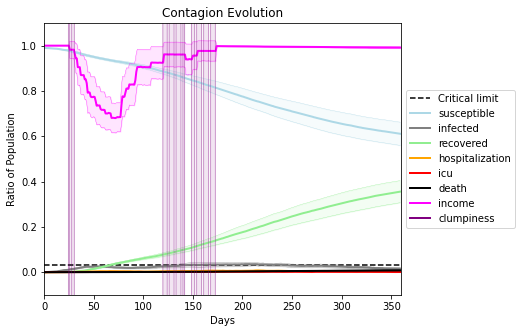

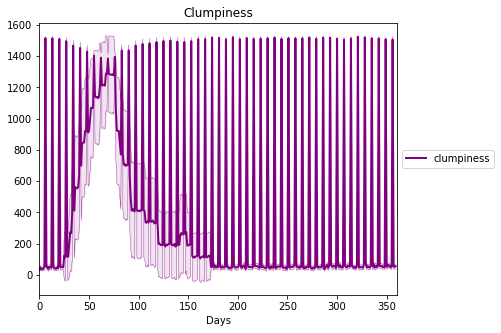

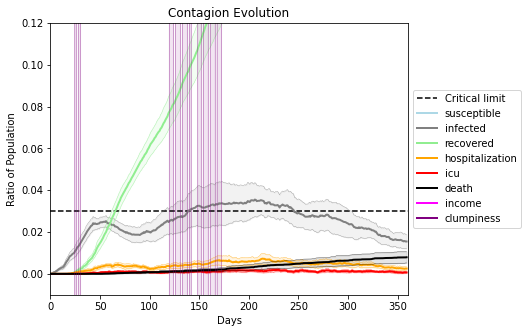

In [16]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.9
params.params['num_communities'] = 100
seeds = [2252]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs=20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],
              work_home_list = 
            
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6943, 3839, 2694, 3607, 1576, 6594, 2237, 4782, 9042, 6127, 1572, 8654, 3255, 3273, 5741, 1392, 7689, 3554, 8569, 6366]
Average similarity between family members is 0.4140324117857766 at temperature -0.8
Average similarity between family and home is 0.9998517729919251 at temperature -1
Average similarity between students and their classroom is 0.16826997451392714 at temperature -0.8
Average classroom occupancy is 1.6089385474860336 and number classrooms is 179
Average similarity between workers is 0.3020110705388781 at temperature -0.8
Average office occupancy is 3.3181818181818183 and number offices is 198
Average friend similarity for adults: 0.4999363940205022 for kids: 0.37724510547008433
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity -0.021534106356714492
avg restaurant similarity 0.14355689246653897
avg restaurant similarity 0.21933032908436667
avg restaurant similarity 0.3620024677255754
avg restaurant similarity 0.27029730925459117
avg restaurant similarity 0.039107721945443055
avg restaurant similarity 0.28081101792140817
avg restaurant similarity 0.16025545506065222
avg restaurant similarity 0.2906916827795231
avg restaurant similarity -0.04514028446915144
avg restaurant similarity 0.11032734660894342
avg restaurant similarity 0.006706226458314468
avg restaurant similarity 0.12077830632365591
avg restaurant similarity -0.09909710156959191
avg restaurant similarity 0.14562290414049905
avg restaurant similarity -0.10592597538900647
avg restaurant similarity 0.029868708957950463
avg restaurant similarity 0.14578682762702122
avg restaurant similarity 0.05337470842304247
avg restaurant similarity -0.014951598558814602
avg restaurant similarity 0.07823204121520105
avg restaurant similarity 

avg restaurant similarity 0.02703560752747702
avg restaurant similarity 0.0813237324804434
avg restaurant similarity 0.21473606210949372
avg restaurant similarity 0.11228422845231638
avg restaurant similarity 0.2365665571896193
avg restaurant similarity 0.15735109786625373
avg restaurant similarity 0.3249207825054512
avg restaurant similarity -0.05238428814325043
avg restaurant similarity 0.32750438074967414
avg restaurant similarity 0.24265824517784762
avg restaurant similarity 0.12193265646486894
avg restaurant similarity 0.03483552933659787
avg restaurant similarity -0.1854742027994941
avg restaurant similarity 0.22317085381792992
avg restaurant similarity 0.26251994650946564
avg restaurant similarity 0.17336418245154697
avg restaurant similarity 0.13556549685653635
avg restaurant similarity -0.007569842670054672
avg restaurant similarity 0.022185952625835975
avg restaurant similarity -0.038955025540108115
avg restaurant similarity 0.08386638140285461
avg restaurant similarity 0.029

Average similarity between students and their classroom is 0.17033589986161393 at temperature -0.8
Average classroom occupancy is 1.6486486486486487 and number classrooms is 185
Average similarity between workers is 0.3030397495185221 at temperature -0.8
Average office occupancy is 3.185 and number offices is 200
Average friend similarity for adults: 0.49765351893155013 for kids: 0.3967726094661758
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this distr

avg restaurant similarity 0.16010454293961446
avg restaurant similarity 0.20840910816531197
avg restaurant similarity 0.15339522547542994
avg restaurant similarity 0.042912265392739665
avg restaurant similarity 0.2875356584795291
avg restaurant similarity 0.10130696816777819
avg restaurant similarity 0.12891256589298836
avg restaurant similarity 0.11454056140313369
avg restaurant similarity 0.12025795623168525
avg restaurant similarity -0.04007747029244224
avg restaurant similarity -0.11293881404921466
avg restaurant similarity 0.236955480394929
avg restaurant similarity 0.23991943357970086
avg restaurant similarity -0.07060225527741987
avg restaurant similarity 0.15325201695851332
avg restaurant similarity 0.07687034425905781
avg restaurant similarity 0.11520002174208259
avg restaurant similarity 0.10756279974362666
avg restaurant similarity -0.1563221822717371
avg restaurant similarity 0.10640542454301798
avg restaurant similarity 0.0863008420119825
avg restaurant similarity 0.253028

avg restaurant similarity 0.15237708028472383
avg restaurant similarity -0.07251206750388538
avg restaurant similarity 0.1366540516125097
avg restaurant similarity 0.0536221697058695
avg restaurant similarity -0.14473816702788025
avg restaurant similarity 0.04146600199867877
avg restaurant similarity 0.14975830019169972
avg restaurant similarity 0.16118571342035867
avg restaurant similarity 0.06277093519145506
avg restaurant similarity -0.024260764985962024
avg restaurant similarity -0.21763643925733553
avg restaurant similarity 0.11599380742162013
avg restaurant similarity 0.16735861934831817
avg restaurant similarity 0.008178561778842755
avg restaurant similarity 0.10714291205546132
avg restaurant similarity 0.28066835465579254
avg restaurant similarity 0.1555233427223916
avg restaurant similarity -0.04104463703073246
avg restaurant similarity 0.1763049239981179
avg restaurant similarity 0.23488404286226505
avg restaurant similarity -0.06893924722809112
avg restaurant similarity 0.23

avg restaurant similarity -0.04813707166995106
avg restaurant similarity -0.09951206525777001
Average similarity between family members is 0.43885284479188386 at temperature -0.8
Average similarity between family and home is 0.9998461046946973 at temperature -1
Average similarity between students and their classroom is 0.17442651934674713 at temperature -0.8
Average classroom occupancy is 1.56 and number classrooms is 175
Average similarity between workers is 0.31767821766775173 at temperature -0.8
Average office occupancy is 3.335 and number offices is 200
Average friend similarity for adults: 0.5050064749851326 for kids: 0.3718159841292153
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 

avg restaurant similarity 0.13717944751575206
avg restaurant similarity 0.13672874907235702
avg restaurant similarity 0.10486637872576596
avg restaurant similarity 0.2174690593680482
avg restaurant similarity 0.16571363209507325
avg restaurant similarity 0.15111565968705318
avg restaurant similarity 0.18450316601133915
avg restaurant similarity 0.050619323321239584
avg restaurant similarity -0.04710082924996667
avg restaurant similarity 0.05240253455204196
avg restaurant similarity 0.04557522110397743
avg restaurant similarity 0.07197765540853616
avg restaurant similarity 0.08644696388796867
avg restaurant similarity 0.38385853163094436
avg restaurant similarity 0.19510778239150436
avg restaurant similarity 0.14266675125486
avg restaurant similarity 0.13509531553423484
avg restaurant similarity 0.20823522685614954
avg restaurant similarity 0.15193713240379844
avg restaurant similarity 0.16698118243781454
avg restaurant similarity 0.06456467429709047
avg restaurant similarity 0.11057425

avg restaurant similarity 0.13418005733452992
avg restaurant similarity 0.008460993387283636
avg restaurant similarity 0.16067324867636198
avg restaurant similarity 0.03064455941698635
avg restaurant similarity 0.15406238491554441
avg restaurant similarity 0.04582306834257136
avg restaurant similarity 0.1362074333256838
avg restaurant similarity 0.2821262544049559
avg restaurant similarity 0.07989887398456405
avg restaurant similarity -0.07349792956139228
avg restaurant similarity 0.3163515403046421
avg restaurant similarity 0.0868786834212324
avg restaurant similarity 0.1886677818131334
avg restaurant similarity 0.030407875798258627
avg restaurant similarity 0.18622936020875822
avg restaurant similarity 0.08960562530171128
avg restaurant similarity 0.21828415090565387
avg restaurant similarity 0.03785961883204608
avg restaurant similarity -0.1398147776370033
avg restaurant similarity 0.257082463161371
avg restaurant similarity 0.11266965197851676
avg restaurant similarity -0.022245437

Average similarity between students and their classroom is 0.18780885926181304 at temperature -0.8
Average classroom occupancy is 1.6214689265536724 and number classrooms is 177
Average similarity between workers is 0.30913542121860765 at temperature -0.8
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.49564821156393035 for kids: 0.39073675977208155
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this distri

avg restaurant similarity 0.08990225815229314
avg restaurant similarity -0.10254366746842561
avg restaurant similarity 0.01852053707626375
avg restaurant similarity -0.09686738904228367
avg restaurant similarity 0.23056226623398465
avg restaurant similarity 0.34857672378679155
avg restaurant similarity 0.062027318840974885
avg restaurant similarity 0.03628365551134802
avg restaurant similarity 0.03440579978589272
avg restaurant similarity 0.2672185322564954
avg restaurant similarity -0.020582929963142618
avg restaurant similarity 0.016419413095512925
avg restaurant similarity 0.0743884326934103
avg restaurant similarity 0.024212340215379775
avg restaurant similarity -0.15797283648987054
avg restaurant similarity 0.11893858159475425
avg restaurant similarity -0.0007769544168132377
avg restaurant similarity 0.2703834269402776
avg restaurant similarity -0.08769430386593347
avg restaurant similarity 0.027606904446062407
avg restaurant similarity 0.07770849448482138
avg restaurant similarit

avg restaurant similarity 0.16786304665384685
avg restaurant similarity 0.04428828979838981
avg restaurant similarity 0.0064943881276998475
avg restaurant similarity 0.07071229047363656
avg restaurant similarity 0.13089830333094032
avg restaurant similarity 0.23283172550470058
avg restaurant similarity -0.10254366746842561
avg restaurant similarity -0.08321972096027162
avg restaurant similarity 0.07001995839277436
avg restaurant similarity 0.27853045305243096
avg restaurant similarity 0.10066203320837651
avg restaurant similarity 0.08203115952959869
avg restaurant similarity -0.013572311257010087
avg restaurant similarity -0.18710457260050023
avg restaurant similarity -0.03709317208593092
avg restaurant similarity -0.006295753633737106
avg restaurant similarity -0.32347517273870563
avg restaurant similarity 0.5112328889401403
avg restaurant similarity 0.08408434718810867
avg restaurant similarity 0.19475753711464744
avg restaurant similarity 0.19258076397774743
avg restaurant similarit

Average similarity between workers is 0.2870299757763308 at temperature -0.8
Average office occupancy is 3.2893401015228427 and number offices is 197
Average friend similarity for adults: 0.48875746968811734 for kids: 0.39107142407848133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.05884413639121528
avg restaurant similarity 0.13159994996014007
avg restaurant similarity 0.31752081977695973
avg restaurant similarity 0.3647088925340503
avg restaurant similarity 0.007694934370439626
avg restaurant similarity -0.012983166565273596
avg restaurant similarity 0.1510518109876488
avg restaurant similarity 0.4102950975804327
avg restaurant similarity -0.0616512872602998
avg restaurant similarity -0.0985768107524227
avg restaurant similarity 0.2712000716978037
avg restaurant similarity 0.49742264341256703
avg restaurant similarity 0.14482014008514477
avg restaurant similarity 0.25092324085773815
avg restaurant similarity 0.25858512468923134
avg restaurant similarity -0.014301373873151224
avg restaurant similarity 0.17106292137240164
avg restaurant similarity 0.33024147309729124
avg restaurant similarity 0.3310119472515976
avg restaurant similarity 0.04100100438724618
avg restaurant similarity -0.035184882813825175
avg restaurant similarity 0.1257

avg restaurant similarity 0.028967632631332643
avg restaurant similarity 0.32624370490239657
avg restaurant similarity 0.03773625295992436
avg restaurant similarity 0.19670839590576117
avg restaurant similarity -0.3056178019771997
avg restaurant similarity 0.001920044130749543
avg restaurant similarity 0.13015092149317878
avg restaurant similarity -0.05208810624214591
avg restaurant similarity 0.10281017848139784
avg restaurant similarity 0.19695499331766994
avg restaurant similarity 0.2188357350915386
avg restaurant similarity 0.020854960179597235
avg restaurant similarity 0.12546733345584749
avg restaurant similarity 0.18115197754064125
avg restaurant similarity 0.40767283315435066
avg restaurant similarity 0.09119796268688485
avg restaurant similarity 0.26757963356209846
avg restaurant similarity 0.23135671553370943
avg restaurant similarity 0.45076812630432345
avg restaurant similarity 0.3578338485576022
avg restaurant similarity -0.054781552007521724
avg restaurant similarity 0.09

Average similarity between workers is 0.2996949385617288 at temperature -0.8
Average office occupancy is 3.28643216080402 and number offices is 199
Average friend similarity for adults: 0.5019540595755885 for kids: 0.3945793808003768
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12

avg restaurant similarity 0.162603496193301
avg restaurant similarity 0.0016577733462063572
avg restaurant similarity 0.14049799643959301
avg restaurant similarity 0.05115395790901684
avg restaurant similarity -0.1459471328462607
avg restaurant similarity 0.3654838313337623
avg restaurant similarity 0.09682056439571732
avg restaurant similarity -0.009857401962175098
avg restaurant similarity 0.2565539482799955
avg restaurant similarity 0.18558235943849885
avg restaurant similarity 0.11280630586784647
avg restaurant similarity 0.12061274827452195
avg restaurant similarity 0.13451842341735995
avg restaurant similarity 0.2714270686172465
avg restaurant similarity -0.1106117960056591
avg restaurant similarity 0.2979547392908388
avg restaurant similarity -0.036205116023154585
avg restaurant similarity 0.16894386840487474
avg restaurant similarity 0.2621426184383836
avg restaurant similarity 0.17201941364552525
avg restaurant similarity 0.14287277107882368
avg restaurant similarity 0.0660486

avg restaurant similarity 0.2063488722733525
avg restaurant similarity -0.03453251008808608
avg restaurant similarity -0.05257704473271105
avg restaurant similarity 0.010548704303306808
avg restaurant similarity 0.15288181978584955
avg restaurant similarity -0.03710040561427777
avg restaurant similarity 0.39939441446072116
avg restaurant similarity 0.05309917115774274
avg restaurant similarity 0.2798609829647303
avg restaurant similarity 0.2701055703707749
avg restaurant similarity 0.21511545376912464
avg restaurant similarity 0.06231638446049375
avg restaurant similarity 0.12097246550260164
avg restaurant similarity 0.1384238061364551
avg restaurant similarity 0.1425751473186866
avg restaurant similarity 0.20015202082996555
avg restaurant similarity 0.10190977942655362
avg restaurant similarity -0.0977040493958282
avg restaurant similarity 0.20587145950939725
avg restaurant similarity 0.19791660705511316
avg restaurant similarity 0.009361342442472859
avg restaurant similarity 0.087289

avg restaurant similarity 0.04717666423258736
avg restaurant similarity 0.34008215498580774
Average similarity between family members is 0.43713792857595696 at temperature -0.8
Average similarity between family and home is 0.9998640882129431 at temperature -1
Average similarity between students and their classroom is 0.16299179932748395 at temperature -0.8
Average classroom occupancy is 1.5469613259668509 and number classrooms is 181
Average similarity between workers is 0.2850092999392284 at temperature -0.8
Average office occupancy is 3.401015228426396 and number offices is 197
Average friend similarity for adults: 0.50205119156915 for kids: 0.37879934292810347
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated 

avg restaurant similarity 0.1782559963444167
avg restaurant similarity 0.02798176438848956
avg restaurant similarity 0.06109953116692467
avg restaurant similarity 0.10239828977991279
avg restaurant similarity 0.18377147178498948
avg restaurant similarity 0.015384595730488638
avg restaurant similarity -0.2944124399811816
avg restaurant similarity -0.012650296366144136
avg restaurant similarity 0.15030417513211938
avg restaurant similarity 0.13992373485153795
avg restaurant similarity -0.002644327245973448
avg restaurant similarity 0.34801710059876284
avg restaurant similarity 0.05057003064344042
avg restaurant similarity 0.1578986996519377
avg restaurant similarity 0.08223864519087887
avg restaurant similarity 0.29916219886616624
avg restaurant similarity 0.13604042042956951
avg restaurant similarity 0.3892051782615485
avg restaurant similarity 0.19498078250489898
avg restaurant similarity -0.14914489427482358
avg restaurant similarity -0.2345595211225202
avg restaurant similarity 0.246

avg restaurant similarity 0.16884224891066568
avg restaurant similarity 0.08640853106220692
avg restaurant similarity -0.024530861098615145
avg restaurant similarity 0.09981906904021674
avg restaurant similarity -0.2206417741735013
avg restaurant similarity 0.0020899673501411204
avg restaurant similarity 0.05303879690249904
avg restaurant similarity 0.03644673532749347
avg restaurant similarity 0.13657320471020043
avg restaurant similarity 0.02646434972378895
avg restaurant similarity 0.27841154289427483
avg restaurant similarity 0.11680663394658163
avg restaurant similarity 0.07902411659182339
avg restaurant similarity 0.21197095892101267
avg restaurant similarity -0.24965896180197267
avg restaurant similarity 0.16806931668795677
avg restaurant similarity 0.406696131999749
avg restaurant similarity 0.033099014729953635
avg restaurant similarity 0.13335612318912657
avg restaurant similarity 0.08549098041929011
avg restaurant similarity -0.3597391767159748
avg restaurant similarity 0.20

Average friend similarity for adults: 0.4990427111124183 for kids: 0.3911066785274673
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated uni

avg restaurant similarity 0.09142396607250873
avg restaurant similarity 0.08143213976560587
avg restaurant similarity 0.04278215630973913
avg restaurant similarity 0.16420223385988733
avg restaurant similarity 0.05580335734371524
avg restaurant similarity 0.047131404587907634
avg restaurant similarity -0.05150665927058462
avg restaurant similarity 0.16121742868074648
avg restaurant similarity -0.1115814794680835
avg restaurant similarity 0.02650609273555737
avg restaurant similarity 0.3341715716582104
avg restaurant similarity -0.08021931717129342
avg restaurant similarity 0.21119787397723483
avg restaurant similarity -0.14243998359380666
avg restaurant similarity 0.27754063893465597
avg restaurant similarity 0.07163908687044906
avg restaurant similarity 0.12852970566008798
avg restaurant similarity 0.09282199161533686
avg restaurant similarity -0.07248086133260298
avg restaurant similarity 0.16254080450042868
avg restaurant similarity -0.00364049275475882
avg restaurant similarity 0.0

avg restaurant similarity 0.2785540226178093
avg restaurant similarity -0.005263966226535678
avg restaurant similarity 0.129220179610197
avg restaurant similarity 0.06610394094432927
avg restaurant similarity 0.15505767196674253
avg restaurant similarity -0.041973630325945414
avg restaurant similarity -0.03261821684655303
avg restaurant similarity 0.18761897008137537
avg restaurant similarity 0.12421565006178485
avg restaurant similarity 0.17716685629252918
avg restaurant similarity 0.14130710169736793
avg restaurant similarity 0.10085210809670717
avg restaurant similarity 0.07547656459085622
avg restaurant similarity -0.037105353123223134
avg restaurant similarity -0.22997297938530503
avg restaurant similarity 0.04778455571224585
avg restaurant similarity 0.11904559046219584
avg restaurant similarity 0.022312956094570794
avg restaurant similarity -0.14831325483731891
avg restaurant similarity 0.1334035676096308
avg restaurant similarity 0.17645960649178696
avg restaurant similarity 0.

avg restaurant similarity 0.06330240070002574
avg restaurant similarity -0.0052538028794900625
avg restaurant similarity 0.1872075234392991
Average similarity between family members is 0.42339721374399636 at temperature -0.8
Average similarity between family and home is 0.9998407115055654 at temperature -1
Average similarity between students and their classroom is 0.1289521911139373 at temperature -0.8
Average classroom occupancy is 1.6728395061728396 and number classrooms is 162
Average similarity between workers is 0.2824477418788184 at temperature -0.8
Average office occupancy is 3.353233830845771 and number offices is 201
Average friend similarity for adults: 0.49008612622148806 for kids: 0.3574905237816286
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.23784675761272628
avg restaurant similarity 0.2803773907982256
avg restaurant similarity 0.3041970743301528
avg restaurant similarity 0.1920538301719322
avg restaurant similarity 0.17880804856740762
avg restaurant similarity 0.24475363158372473
avg restaurant similarity 0.3138970749172828
avg restaurant similarity 0.14707136957501668
avg restaurant similarity 0.11812507120695127
avg restaurant similarity 0.2467422063981511
avg restaurant similarity 0.15310855923647684
avg restaurant similarity 0.13660360039312916
avg restaurant similarity 0.23712644132508773
avg restaurant similarity 0.06991044621832522
avg restaurant similarity 0.24348865629893413
avg restaurant similarity 0.32379128991955475
avg restaurant similarity 0.23716224912808695
avg restaurant similarity -0.15138777200691486
avg restaurant similarity 0.04697337089381235
avg restaurant similarity -0.16993587422349524
avg restaurant similarity 0.2574617963514154
avg restaurant similarity 0.2102624200

avg restaurant similarity 0.11756317144674205
avg restaurant similarity 0.2597296694592565
avg restaurant similarity 0.1458452366196694
avg restaurant similarity 0.10384170869274338
avg restaurant similarity 0.07633508166559574
avg restaurant similarity 0.019438323044020954
avg restaurant similarity 0.04927171545589749
avg restaurant similarity 0.2572195626910019
avg restaurant similarity 0.13633824720812882
avg restaurant similarity 0.16298806149823147
avg restaurant similarity 0.2724493320579556
avg restaurant similarity 0.18741657739042816
avg restaurant similarity 0.14929785455282416
avg restaurant similarity 0.2698111267358489
avg restaurant similarity -0.004769999931930384
avg restaurant similarity 0.3851812319647455
avg restaurant similarity 0.2262636135122848
avg restaurant similarity 0.3903700074904675
avg restaurant similarity 0.3730878067899524
avg restaurant similarity 0.11818555207446318
avg restaurant similarity 0.30176376255976417
avg restaurant similarity 0.126626619657

avg restaurant similarity 0.08906455240450917
Average similarity between family members is 0.42226984626467784 at temperature -0.8
Average similarity between family and home is 0.999850693476829 at temperature -1
Average similarity between students and their classroom is 0.18569112109417465 at temperature -0.8
Average classroom occupancy is 1.633879781420765 and number classrooms is 183
Average similarity between workers is 0.277908657051846 at temperature -0.8
Average office occupancy is 3.23 and number offices is 200
Average friend similarity for adults: 0.4862389894110738 for kids: 0.386791065805392
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 2 people.
Total of 2 people allocated in t

avg restaurant similarity 0.0851548281069923
avg restaurant similarity 0.23315930631844944
avg restaurant similarity 0.08667530721857254
avg restaurant similarity 0.23839028376009894
avg restaurant similarity 0.1413550537102762
avg restaurant similarity 0.1720845748111451
avg restaurant similarity 0.16912898651508493
avg restaurant similarity 0.21275265154542725
avg restaurant similarity 0.18479315808037372
avg restaurant similarity 0.11693328899719292
avg restaurant similarity 0.10832681879338572
avg restaurant similarity 0.21039578503168777
avg restaurant similarity 0.08820045005515026
avg restaurant similarity 0.0886728531833635
avg restaurant similarity 0.11017637962823731
avg restaurant similarity 0.13635444205194922
avg restaurant similarity 0.1659886978494324
avg restaurant similarity 0.07283587601160534
avg restaurant similarity 0.12268541550455438
avg restaurant similarity 0.15481514500666568
avg restaurant similarity 0.14096589039100663
avg restaurant similarity 0.22853341474

avg restaurant similarity 0.04028094726371928
avg restaurant similarity 0.24453352034458117
avg restaurant similarity 0.13046361980016868
avg restaurant similarity 0.18792174500951295
avg restaurant similarity -0.05951965074033505
avg restaurant similarity 0.14661451714588836
avg restaurant similarity 0.08392044519956626
avg restaurant similarity 0.30107183479659316
avg restaurant similarity 0.04350964732089921
avg restaurant similarity 0.006423787084469834
avg restaurant similarity 0.15601660948056031
avg restaurant similarity 0.06664446354778095
avg restaurant similarity 0.3728221052650682
avg restaurant similarity 0.14620008318967403
avg restaurant similarity 0.0024406657764683287
avg restaurant similarity 0.4024309165396486
avg restaurant similarity 0.14624182601845062
avg restaurant similarity 0.1614251626624967
avg restaurant similarity 0.08931597531539068
avg restaurant similarity 0.08642170059034546
avg restaurant similarity 0.06608231965923068
avg restaurant similarity -0.0260

avg restaurant similarity 0.132717846048819
avg restaurant similarity 0.3176066855165741
Average similarity between family members is 0.41576783280396085 at temperature -0.8
Average similarity between family and home is 0.9998532702527845 at temperature -1
Average similarity between students and their classroom is 0.16556213970993763 at temperature -0.8
Average classroom occupancy is 1.6571428571428573 and number classrooms is 175
Average similarity between workers is 0.29201191256179243 at temperature -0.8
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.4989595797049424 for kids: 0.3778972286158573
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated uni

avg restaurant similarity 0.15104950389470426
avg restaurant similarity 0.019422106810159906
avg restaurant similarity 0.11602948799019801
avg restaurant similarity 0.32409462343296597
avg restaurant similarity -0.05018791868216131
avg restaurant similarity 0.07749017033317507
avg restaurant similarity -0.17641387812255288
avg restaurant similarity -0.09660512078828994
avg restaurant similarity 0.059820862174482736
avg restaurant similarity 0.22664274817676278
avg restaurant similarity 0.1179345606293165
avg restaurant similarity 0.3258535761968056
avg restaurant similarity 0.07875635227544726
avg restaurant similarity 0.05390105339488761
avg restaurant similarity 0.2771141176355669
avg restaurant similarity 0.14082682939795363
avg restaurant similarity -0.1699860852022937
avg restaurant similarity 0.08464279927433098
avg restaurant similarity 0.1536259466255461
avg restaurant similarity -0.08391995416000375
avg restaurant similarity -0.0567842643551232
avg restaurant similarity 0.0677

avg restaurant similarity 0.1798431940910162
avg restaurant similarity 0.11302199155730985
avg restaurant similarity 0.15596581936094753
avg restaurant similarity 0.05165194524865968
avg restaurant similarity 0.2299123756415079
avg restaurant similarity 0.22628771389426358
avg restaurant similarity 0.1886864853672812
avg restaurant similarity 0.008347358528012183
avg restaurant similarity 0.2002701959913145
avg restaurant similarity -0.035470792472252266
avg restaurant similarity 0.1731237148842061
avg restaurant similarity 0.11650318815166444
avg restaurant similarity -0.04889295954685391
avg restaurant similarity -0.04400866692922356
avg restaurant similarity -0.024461113819485795
avg restaurant similarity 0.4801674091083532
avg restaurant similarity 0.21049753186343492
avg restaurant similarity 0.1587593736892338
avg restaurant similarity 0.4463112070941421
avg restaurant similarity 0.06652123225577941
avg restaurant similarity -0.2849834067661907
avg restaurant similarity 0.1042604

avg restaurant similarity 0.19773672011672014
avg restaurant similarity 0.34197623074503486
avg restaurant similarity 0.13256548550451214
Average similarity between family members is 0.4351805976284341 at temperature -0.8
Average similarity between family and home is 0.9998523913466854 at temperature -1
Average similarity between students and their classroom is 0.19582846959830247 at temperature -0.8
Average classroom occupancy is 1.5957446808510638 and number classrooms is 188
Average similarity between workers is 0.29575877749713064 at temperature -0.8
Average office occupancy is 3.19 and number offices is 200
Average friend similarity for adults: 0.49339466644827706 for kids: 0.395241520713081
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capa

avg restaurant similarity 0.0670038480354412
avg restaurant similarity -0.3023311683074823
avg restaurant similarity 0.07978911073984514
avg restaurant similarity 0.03196635343474366
avg restaurant similarity 0.08534057602461181
avg restaurant similarity 0.005165081915001882
avg restaurant similarity 0.1263814764775979
avg restaurant similarity 0.031435831413127946
avg restaurant similarity 0.31341102624442524
avg restaurant similarity 0.1905698365818427
avg restaurant similarity 0.2050841030266485
avg restaurant similarity 0.03977702683274903
avg restaurant similarity 0.06525980170015148
avg restaurant similarity 0.14717278740258424
avg restaurant similarity 0.2512319888690245
avg restaurant similarity 0.38599936844231675
avg restaurant similarity 0.24304958932545753
avg restaurant similarity 0.08977286618696322
avg restaurant similarity 0.09054854530238843
avg restaurant similarity 0.2548503723882392
avg restaurant similarity 0.21988227064504762
avg restaurant similarity 0.1539373592

avg restaurant similarity 0.26119065917040407
avg restaurant similarity -0.11903823410515067
avg restaurant similarity -0.09193197016697936
avg restaurant similarity 0.036427971675633115
avg restaurant similarity 0.051591541761399906
avg restaurant similarity 0.08664735340482266
avg restaurant similarity 0.0968215473565336
avg restaurant similarity 0.38059808756610164
avg restaurant similarity -0.07261844790551698
avg restaurant similarity 0.2199485416155333
avg restaurant similarity -0.10988251159406398
avg restaurant similarity 0.2139476537516077
avg restaurant similarity 0.1419141201489598
avg restaurant similarity 0.0830053071923457
avg restaurant similarity 0.10013291842269928
avg restaurant similarity 0.05026971755533829
avg restaurant similarity 0.3820458947422426
avg restaurant similarity 0.1879384439423697
avg restaurant similarity 0.5658853433364004
avg restaurant similarity 0.1538748843811875
avg restaurant similarity 0.06021410785692627
avg restaurant similarity 0.755017993

Average similarity between family and home is 0.9998524209150886 at temperature -1
Average similarity between students and their classroom is 0.16970583152086116 at temperature -0.8
Average classroom occupancy is 1.5925925925925926 and number classrooms is 189
Average similarity between workers is 0.30322743818380216 at temperature -0.8
Average office occupancy is 3.2462311557788945 and number offices is 199
Average friend similarity for adults: 0.4919043538706935 for kids: 0.3865954227076763
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.015287049155169747
avg restaurant similarity -0.1114761732679812
avg restaurant similarity 0.13419636280017558
avg restaurant similarity 0.3317291030808151
avg restaurant similarity 0.26098526818107276
avg restaurant similarity 0.2532366842902403
avg restaurant similarity 0.08070336554477689
avg restaurant similarity 0.37663045171318127
avg restaurant similarity 0.2293479109185133
avg restaurant similarity 0.32829166619401884
avg restaurant similarity 0.08758521946117286
avg restaurant similarity 0.07411412774089288
avg restaurant similarity 0.05972520618492892
avg restaurant similarity 0.16977258202655587
avg restaurant similarity 0.1707626857259425
avg restaurant similarity 0.0213783235956802
avg restaurant similarity 0.10716030652065767
avg restaurant similarity -0.04584417243145386
avg restaurant similarity 0.1244495513854543
avg restaurant similarity 0.0020767286012799506
avg restaurant similarity -0.16053320162969806
avg restaurant similarity 0.2058636

avg restaurant similarity 0.1856675957116123
avg restaurant similarity 0.07088792517658418
avg restaurant similarity 0.2635156245882332
avg restaurant similarity -0.12490797646064886
avg restaurant similarity 0.06356110568337978
avg restaurant similarity 0.2096485034820315
avg restaurant similarity 0.3378302827832422
avg restaurant similarity 0.11438973057844126
avg restaurant similarity 0.14733192454578364
avg restaurant similarity 0.12643649079411576
avg restaurant similarity 0.023971776725073245
avg restaurant similarity 0.24391738831171164
avg restaurant similarity 0.2140441775320621
avg restaurant similarity 0.20926929689235035
avg restaurant similarity 0.2325719535358054
avg restaurant similarity 0.06140961050544908
avg restaurant similarity 0.2615232616559044
avg restaurant similarity 0.08516773306159753
avg restaurant similarity 0.12833012948097047
avg restaurant similarity 0.021821342565878823
avg restaurant similarity 0.0775689122772059
avg restaurant similarity 0.17282813172

Average similarity between family and home is 0.9998383400335147 at temperature -1
Average similarity between students and their classroom is 0.17449710801909618 at temperature -0.8
Average classroom occupancy is 1.651685393258427 and number classrooms is 178
Average similarity between workers is 0.2998765966100782 at temperature -0.8
Average office occupancy is 3.2562814070351758 and number offices is 199
Average friend similarity for adults: 0.4989020395403832 for kids: 0.3824086946759913
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.07153483603940476
avg restaurant similarity 0.07495336405733485
avg restaurant similarity 0.007273797526535184
avg restaurant similarity 0.21141993433069747
avg restaurant similarity -0.06935368917400996
avg restaurant similarity -0.14577111449302765
avg restaurant similarity -0.1967944211138214
avg restaurant similarity -0.011550185266009316
avg restaurant similarity 0.02515199181863334
avg restaurant similarity 0.014430518461201379
avg restaurant similarity -0.06142223161320662
avg restaurant similarity 0.18562186138708972
avg restaurant similarity 0.08183851044710466
avg restaurant similarity 0.13335673354277827
avg restaurant similarity 0.3493902589984906
avg restaurant similarity 0.15031874068029422
avg restaurant similarity 0.22229185139323177
avg restaurant similarity 0.138520522552771
avg restaurant similarity 0.09668727038766885
avg restaurant similarity 0.27220377154624764
avg restaurant similarity 0.021428540822578883
avg restaurant similarity 0.1

avg restaurant similarity 0.07533626879129762
avg restaurant similarity 0.13012958374313555
avg restaurant similarity 0.10287458961174394
avg restaurant similarity 0.029216110427140077
avg restaurant similarity 0.2435541514036734
avg restaurant similarity 0.08056268614013304
avg restaurant similarity 0.35403005223189776
avg restaurant similarity -0.021920382509072273
avg restaurant similarity 0.29313785466665915
avg restaurant similarity 0.10016166873507364
avg restaurant similarity 0.18739557410862281
avg restaurant similarity -0.19761388183664652
avg restaurant similarity 0.032583172574984255
avg restaurant similarity 0.18446118182109894
avg restaurant similarity -0.0751294557088141
avg restaurant similarity -0.15755391123612092
avg restaurant similarity 0.6916363158518308
avg restaurant similarity 0.21796238714753213
avg restaurant similarity 0.2955085798831918
avg restaurant similarity 0.0072220591347060305
avg restaurant similarity 0.049433507417753056
avg restaurant similarity 0.

Average similarity between family and home is 0.9998557607664293 at temperature -1
Average similarity between students and their classroom is 0.1769753597064072 at temperature -0.8
Average classroom occupancy is 1.6740331491712708 and number classrooms is 181
Average similarity between workers is 0.3024981101828526 at temperature -0.8
Average office occupancy is 3.1435643564356437 and number offices is 202
Average friend similarity for adults: 0.49603693819776623 for kids: 0.402816207833013
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity 0.05174299875988786
avg restaurant similarity -0.015985660638496775
avg restaurant similarity -0.06075910420063552
avg restaurant similarity 0.062467191379386985
avg restaurant similarity 0.0041570826110324385
avg restaurant similarity 0.18069329162131872
avg restaurant similarity 0.11328286875656396
avg restaurant similarity 0.21767841895490359
avg restaurant similarity 0.2796357194252564
avg restaurant similarity 0.2042648855572861
avg restaurant similarity -0.018893313106264933
avg restaurant similarity 0.04309649413334909
avg restaurant similarity 0.21147953736889935
avg restaurant similarity 0.14616026581048144
avg restaurant similarity -0.019415107930450426
avg restaurant similarity 0.0004010772806445073
avg restaurant similarity -0.014666568044381045
avg restaurant similarity -0.021350104725060336
avg restaurant similarity 0.09201757444277654
avg restaurant similarity 0.11092799806513413
avg restaurant similarity 0.20931168707648654
avg restaurant simil

avg restaurant similarity 0.09740562575493837
avg restaurant similarity 0.013910796918878941
avg restaurant similarity -0.17066039585433487
avg restaurant similarity -0.12198501106599509
avg restaurant similarity 0.1145064007711582
avg restaurant similarity 0.08623732881456296
avg restaurant similarity -0.08415734282103976
avg restaurant similarity 0.004081009526951808
avg restaurant similarity -0.10381205030173907
avg restaurant similarity 0.18709111793902283
avg restaurant similarity 0.06898976347310273
avg restaurant similarity 0.2129843423838502
avg restaurant similarity 0.21433486255011017
avg restaurant similarity 0.16634724666114073
avg restaurant similarity 0.039150956609837056
avg restaurant similarity 0.140490579484026
avg restaurant similarity 0.09036087662749925
avg restaurant similarity 0.0843124502947747
avg restaurant similarity -0.010849058368447814
avg restaurant similarity 0.07381082488673242
avg restaurant similarity 0.1004587357996245
avg restaurant similarity -0.03

Average similarity between family members is 0.429810428226414 at temperature -0.8
Average similarity between family and home is 0.999853847514317 at temperature -1
Average similarity between students and their classroom is 0.1385082729575151 at temperature -0.8
Average classroom occupancy is 1.5769230769230769 and number classrooms is 182
Average similarity between workers is 0.2809702893173389 at temperature -0.8
Average office occupancy is 3.2758620689655173 and number offices is 203
Average friend similarity for adults: 0.4899393250170364 for kids: 0.37633144973616434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) d

avg restaurant similarity 0.14423513494264106
avg restaurant similarity 0.035896822797295315
avg restaurant similarity 0.14661523955214076
avg restaurant similarity 0.0720820086261997
avg restaurant similarity 0.020968817021345343
avg restaurant similarity 0.11143937016753759
avg restaurant similarity 0.007468238017975561
avg restaurant similarity 0.09016819456515882
avg restaurant similarity 0.026331297588490093
avg restaurant similarity 0.12973368338331118
avg restaurant similarity 0.15651312262667588
avg restaurant similarity 0.09920448842390482
avg restaurant similarity 0.11609026842626716
avg restaurant similarity 0.1205367837748432
avg restaurant similarity 0.06470467995665805
avg restaurant similarity 0.20700431930361965
avg restaurant similarity 0.23627932496870466
avg restaurant similarity 0.03043949591527858
avg restaurant similarity -0.06714336640988143
avg restaurant similarity 0.13565899724631963
avg restaurant similarity -0.03755868130999699
avg restaurant similarity 0.17

avg restaurant similarity -0.04034533686421842
avg restaurant similarity 0.11665424433024073
avg restaurant similarity -0.028798970100195997
avg restaurant similarity 0.05008626010472913
avg restaurant similarity 0.009282755435790928
avg restaurant similarity 0.14934538936493558
avg restaurant similarity 0.0723265553313309
avg restaurant similarity -0.027693369850529018
avg restaurant similarity 0.1539529965766067
avg restaurant similarity 0.09077955665186359
avg restaurant similarity 0.16954437292857363
avg restaurant similarity 0.10542177341357835
avg restaurant similarity 0.14015037438102973
avg restaurant similarity 0.09063807091362835
avg restaurant similarity 0.0074167854159094175
avg restaurant similarity -0.1133789263610431
avg restaurant similarity -0.006021742167939027
avg restaurant similarity 0.16001908735867387
avg restaurant similarity 0.1449121445117018
avg restaurant similarity 0.08153643623841941
avg restaurant similarity 0.17961249410527635
avg restaurant similarity 0

avg restaurant similarity -0.006523698080376541
avg restaurant similarity 0.3460086405045725
avg restaurant similarity -0.2117124941182745
avg restaurant similarity 0.13260780382119502
Average similarity between family members is 0.43485880126060605 at temperature -0.8
Average similarity between family and home is 0.9998638839876285 at temperature -1
Average similarity between students and their classroom is 0.18327236561383212 at temperature -0.8
Average classroom occupancy is 1.5691489361702127 and number classrooms is 188
Average similarity between workers is 0.2942886067350913 at temperature -0.8
Average office occupancy is 3.1911764705882355 and number offices is 204
Average friend similarity for adults: 0.4916698572030953 for kids: 0.3723242129347596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.10974392818134168
avg restaurant similarity 0.10737888866717946
avg restaurant similarity 0.23308404774610034
avg restaurant similarity 0.13512496772600419
avg restaurant similarity 0.1519300687120784
avg restaurant similarity 0.010279330963570801
avg restaurant similarity 0.15170247046228116
avg restaurant similarity 0.0412466507977291
avg restaurant similarity -0.00048077725840574764
avg restaurant similarity 0.007396630933222476
avg restaurant similarity -0.08041978735823357
avg restaurant similarity 0.16894039786066886
avg restaurant similarity 0.10673586117269464
avg restaurant similarity 0.15555624381013297
avg restaurant similarity 0.06898088500842829
avg restaurant similarity 0.04585595698203375
avg restaurant similarity -0.01745214991300012
avg restaurant similarity 0.08636187523508093
avg restaurant similarity -0.004100324030282834
avg restaurant similarity 0.12082956129249801
avg restaurant similarity -0.022378944902756378
avg restaurant similarit

avg restaurant similarity 0.14023746880899146
avg restaurant similarity -0.1204203063258208
avg restaurant similarity 0.5308587170982545
avg restaurant similarity 0.12371341929641029
avg restaurant similarity 0.11265792275626456
avg restaurant similarity 0.21583957132454845
avg restaurant similarity 0.058699916886027756
avg restaurant similarity 0.1141851709559445
avg restaurant similarity -0.09140065741785151
avg restaurant similarity 0.31217474489038083
avg restaurant similarity 0.03222192837165622
avg restaurant similarity 0.09713018905072551
avg restaurant similarity 0.07251767279659788
avg restaurant similarity 0.33581896737319816
avg restaurant similarity 0.21312031979331458
avg restaurant similarity -0.162836549267061
avg restaurant similarity 0.0818516097657376
avg restaurant similarity 0.005988688833677954
avg restaurant similarity -0.058840846391101986
avg restaurant similarity 0.13173901119766163
avg restaurant similarity 0.2719564424381346
avg restaurant similarity 0.138466

Average friend similarity for adults: 0.4952146914887232 for kids: 0.391917271839198
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated un

avg restaurant similarity 0.05127973261202905
avg restaurant similarity 0.286822454668506
avg restaurant similarity 0.1052927578659855
avg restaurant similarity 0.27345188449838326
avg restaurant similarity 0.05683223933152213
avg restaurant similarity 0.22024313145025678
avg restaurant similarity 0.0841252648831633
avg restaurant similarity -0.039209212606324456
avg restaurant similarity 0.27503944253557444
avg restaurant similarity 0.19387645275160523
avg restaurant similarity 0.18785137973330246
avg restaurant similarity 0.14985814339324752
avg restaurant similarity -0.08187770148324629
avg restaurant similarity 0.2346445801339106
avg restaurant similarity -0.19791617426892016
avg restaurant similarity -0.019464364934546882
avg restaurant similarity 0.21509196087913793
avg restaurant similarity 0.15900998918761738
avg restaurant similarity 0.2959432563957243
avg restaurant similarity 0.31041219463522113
avg restaurant similarity 0.11320235462687638
avg restaurant similarity 0.270890

avg restaurant similarity -0.254403655595053
avg restaurant similarity 0.16842886581058525
avg restaurant similarity 0.19800053085023406
avg restaurant similarity 0.22847540659918078
avg restaurant similarity 0.2147015695618986
avg restaurant similarity 0.29548173947767853
avg restaurant similarity 0.21834786567031766
avg restaurant similarity -0.03116616773751673
avg restaurant similarity -0.17935130837242066
avg restaurant similarity 0.1319134291297004
avg restaurant similarity 0.1575810837579506
avg restaurant similarity 0.25502995792991706
avg restaurant similarity 0.7545754863855721
avg restaurant similarity 0.6558316987159603
avg restaurant similarity 0.23686576170161508
avg restaurant similarity -0.03973706088366354
avg restaurant similarity 0.3067648148540189
avg restaurant similarity 0.051086372267593445
avg restaurant similarity 0.0215921687535899
avg restaurant similarity 0.38831973570179623
avg restaurant similarity 0.12728215496053233
avg restaurant similarity 0.3284646513

avg restaurant similarity 0.13694579668492013
avg restaurant similarity -0.08264351658664801
avg restaurant similarity 0.08998671715518258
avg restaurant similarity 0.05886823431033758
avg restaurant similarity 0.15548242156708358
avg restaurant similarity 0.1351693148666989
avg restaurant similarity 0.10880939642801499
avg restaurant similarity -0.11359740093981137
avg restaurant similarity 0.05645894112859294
avg restaurant similarity 0.1274313262344099
avg restaurant similarity 0.09936295181112278
avg restaurant similarity 0.3017883493290183
avg restaurant similarity -0.2065723682861807
avg restaurant similarity -0.08035717944744357
avg restaurant similarity -0.25840836488853913
avg restaurant similarity 0.05368771734270289
avg restaurant similarity 0.14980559516720388
avg restaurant similarity 0.38845591543162666
avg restaurant similarity 0.15037416188566557
avg restaurant similarity 0.351594646122547
avg restaurant similarity 0.0850959955945508
avg restaurant similarity 0.06415773

avg restaurant similarity 0.4311227240368159
avg restaurant similarity 0.07765154134988395
avg restaurant similarity 0.30406215271117626
avg restaurant similarity 0.14478231775342304
avg restaurant similarity 0.22473206632821713
avg restaurant similarity 0.10070656752863807
avg restaurant similarity -0.04436221475813838
avg restaurant similarity 0.23382785977271256
avg restaurant similarity 0.29241964538536014
avg restaurant similarity 0.10063055573299412
avg restaurant similarity 0.006947695709390826
avg restaurant similarity -0.003958511339679541
avg restaurant similarity 0.34871324073068405
avg restaurant similarity 0.24761517297996918
avg restaurant similarity 0.11575532960109718
avg restaurant similarity 0.07812600428974185
avg restaurant similarity 0.05905983326354192
avg restaurant similarity 0.1520421404251241
avg restaurant similarity 0.25313288969418163
avg restaurant similarity 0.01702260482155051
avg restaurant similarity 0.05845292894270243
avg restaurant similarity 0.1437

avg restaurant similarity 0.02918058089445975
avg restaurant similarity 0.057696698421966564
avg restaurant similarity 0.0530938952150507
Average similarity between family members is 0.40267927091756106 at temperature -0.8
Average similarity between family and home is 0.9998367566791787 at temperature -1
Average similarity between students and their classroom is 0.18516084715434827 at temperature -0.8
Average classroom occupancy is 1.5108695652173914 and number classrooms is 184
Average similarity between workers is 0.2701333404988382 at temperature -0.8
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.48509550864958034 for kids: 0.36774842319572604
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.25034360186359594
avg restaurant similarity 0.010968431165120493
avg restaurant similarity 0.25553723632715086
avg restaurant similarity 0.05581581547922491
avg restaurant similarity 0.16964535909865885
avg restaurant similarity 0.2741759662924991
avg restaurant similarity 0.3211333834295762
avg restaurant similarity -0.006822692124312114
avg restaurant similarity 0.0438021086789617
avg restaurant similarity -0.013941121882112726
avg restaurant similarity 0.21059995179044397
avg restaurant similarity 0.24705706480493275
avg restaurant similarity 0.004893052520613366
avg restaurant similarity 0.09015200848133387
avg restaurant similarity 0.0739402935650438
avg restaurant similarity -0.13494658439959978
avg restaurant similarity 0.13133273723959177
avg restaurant similarity 0.06087869675593259
avg restaurant similarity 0.11205913653966298
avg restaurant similarity 0.3181615666285642
avg restaurant similarity 0.15392246494625544
avg restaurant similarity -0.029

avg restaurant similarity 0.1597865215126052
avg restaurant similarity -0.1199262671151143
avg restaurant similarity 0.1006042082713273
avg restaurant similarity 0.1824575130093009
avg restaurant similarity 0.16178345778965528
avg restaurant similarity -0.02583259127790825
avg restaurant similarity 0.1158478092001923
avg restaurant similarity -0.08284312631321612
avg restaurant similarity 0.23094269152704955
avg restaurant similarity 0.03264447217127371
avg restaurant similarity 0.16359252704706465
avg restaurant similarity 0.14350345541294673
avg restaurant similarity 0.15422816847681758
avg restaurant similarity -0.004593514745179189
avg restaurant similarity 0.08670730668970132
avg restaurant similarity 0.1325655768645257
avg restaurant similarity 0.0069162690850070995
avg restaurant similarity 0.2885860738193204
avg restaurant similarity -0.14333641897883914
avg restaurant similarity 0.14394603627158847
avg restaurant similarity 0.1330212125499286
avg restaurant similarity 0.018737

(<function dict.items>, <function dict.items>, <function dict.items>)

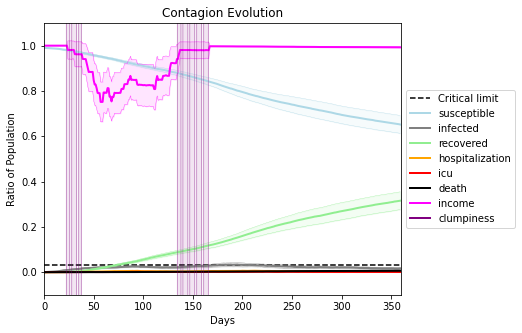

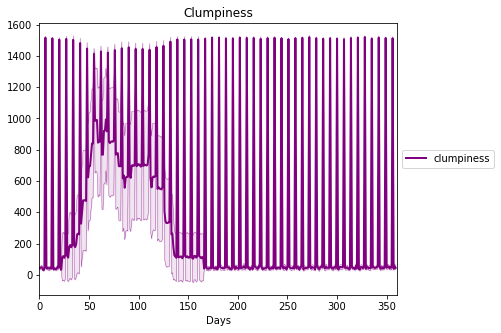

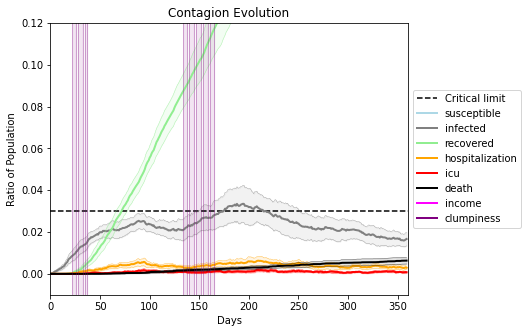

In [17]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.8
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[990, 3875, 2135, 5400, 8394, 1415, 5603, 9200, 4407, 3555, 5701, 2928, 9049, 5377, 3214, 7905, 3927, 3775, 6885, 1971]
Average similarity between family members is 0.3566934264967353 at temperature -0.7
Average similarity between family and home is 0.999860426643437 at temperature -1
Average similarity between students and their classroom is 0.20973814261667018 at temperature -0.7
Average classroom occupancy is 1.639344262295082 and number classrooms is 183
Average similarity between workers is 0.19011810849632743 at temperature -0.7
Average office occupancy is 3.176470588235294 and number offices is 204
Average friend similarity for adults: 0.43797827540492107 for kids: 0.32407797655913345
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.1739939103671839
avg restaurant similarity 0.15247555010372388
avg restaurant similarity 0.29148928452174727
avg restaurant similarity 0.010626410572792712
avg restaurant similarity 0.3264478372396311
avg restaurant similarity 0.14761385304988048
avg restaurant similarity -0.07904867205336184
avg restaurant similarity 0.1320302141026675
avg restaurant similarity 0.28522621675283094
avg restaurant similarity 0.04495204524224838
avg restaurant similarity 0.1791517569465277
avg restaurant similarity 0.16082625975847378
avg restaurant similarity 0.20888688935923488
avg restaurant similarity 0.2527095113009453
avg restaurant similarity 0.20176282909514726
avg restaurant similarity 0.18087864438217652
avg restaurant similarity 0.028086499633497464
avg restaurant similarity 0.0742433783995172
avg restaurant similarity 0.5563919175359607
avg restaurant similarity 0.292067153802742
avg restaurant similarity 0.18428127193491056
avg restaurant similarity 0.238853937474

avg restaurant similarity 0.43330643178861417
avg restaurant similarity 0.08289722954739431
avg restaurant similarity 0.184596462575526
avg restaurant similarity 0.49853912915127796
avg restaurant similarity 0.22208272850110095
avg restaurant similarity 0.23112001209680402
avg restaurant similarity 0.1570156036801353
avg restaurant similarity 0.012751418719516322
avg restaurant similarity 0.16364444738658865
avg restaurant similarity -0.08462991133077712
avg restaurant similarity 0.22892531070468605
avg restaurant similarity -0.016355866715781275
avg restaurant similarity 0.06351559491609916
avg restaurant similarity 0.20501260581119113
avg restaurant similarity 0.3027484522419286
avg restaurant similarity 0.10695924150936449
avg restaurant similarity 0.04269478202244529
avg restaurant similarity 0.24167331883591597
avg restaurant similarity 0.04436092209421168
avg restaurant similarity 0.18327296109838273
avg restaurant similarity 0.3001069575893416
avg restaurant similarity 0.0167773

Average similarity between family and home is 0.9998567148456687 at temperature -1
Average similarity between students and their classroom is 0.13843706027207764 at temperature -0.7
Average classroom occupancy is 1.670520231213873 and number classrooms is 173
Average similarity between workers is 0.1693859397673798 at temperature -0.7
Average office occupancy is 3.199004975124378 and number offices is 201
Average friend similarity for adults: 0.4183863612072266 for kids: 0.29090153669591323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.07602170869522883
avg restaurant similarity 0.2353632707079379
avg restaurant similarity 0.04996349432394107
avg restaurant similarity 0.2841653129743033
avg restaurant similarity 0.16055190359250632
avg restaurant similarity 0.043414617994719615
avg restaurant similarity 0.046991244417515746
avg restaurant similarity 0.12305096810474107
avg restaurant similarity 0.14379664238304568
avg restaurant similarity 0.3686495561644884
avg restaurant similarity 0.006324289178706005
avg restaurant similarity 0.2922546640731585
avg restaurant similarity 0.1424240260231605
avg restaurant similarity 0.09423446957473935
avg restaurant similarity 0.1116823153955583
avg restaurant similarity 0.11313760782252553
avg restaurant similarity 0.03220278094967582
avg restaurant similarity 0.07224955249486988
avg restaurant similarity 0.042845844107140374
avg restaurant similarity 0.19342875903351903
avg restaurant similarity 0.18191291602208753
avg restaurant similarity 0.17825920

avg restaurant similarity -0.09205478316005301
avg restaurant similarity 0.048009112636458434
avg restaurant similarity 0.15776756068309547
avg restaurant similarity 0.17269667401205574
avg restaurant similarity 0.05598534415423548
avg restaurant similarity -0.21504529319942864
avg restaurant similarity 0.08694996721446813
avg restaurant similarity 0.05416424736091692
avg restaurant similarity 0.07768800884949442
avg restaurant similarity -0.41483773767531507
avg restaurant similarity 0.21757245728683736
avg restaurant similarity 0.45701017329746796
avg restaurant similarity 0.09228680481064083
avg restaurant similarity -0.1048047370289203
avg restaurant similarity 0.2881800155727037
avg restaurant similarity 0.5367991629480444
avg restaurant similarity 0.00793333036288106
avg restaurant similarity -0.03337228349284897
avg restaurant similarity 0.13948612630132712
avg restaurant similarity 0.2535380754797755
avg restaurant similarity 0.14994103632001302
avg restaurant similarity 0.1248

Average similarity between workers is 0.15868837988030052 at temperature -0.7
Average office occupancy is 3.209756097560976 and number offices is 205
Average friend similarity for adults: 0.4211638288240608 for kids: 0.2997940912159364
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 peo

avg restaurant similarity 0.19968020122217844
avg restaurant similarity 0.16995744757286033
avg restaurant similarity 0.013560246737561343
avg restaurant similarity 0.25153341730723655
avg restaurant similarity 0.10794563085020231
avg restaurant similarity 0.3762013104641955
avg restaurant similarity -0.036517881051586494
avg restaurant similarity 0.21887879046130165
avg restaurant similarity -0.06727181210436362
avg restaurant similarity -0.09879959497827401
avg restaurant similarity 0.21618209915941988
avg restaurant similarity -0.00022737832256681037
avg restaurant similarity 0.6992079907038307
avg restaurant similarity 0.16320385507261076
avg restaurant similarity 0.04880881573818591
avg restaurant similarity 0.13631849836590473
avg restaurant similarity 0.0682997548683432
avg restaurant similarity 0.30489564202061975
avg restaurant similarity 0.19509537888867906
avg restaurant similarity 0.11160854267217682
avg restaurant similarity 0.001147339646472706
avg restaurant similarity 0

avg restaurant similarity 0.10739497507501804
avg restaurant similarity 0.18180839265652618
avg restaurant similarity 0.2512982855911161
avg restaurant similarity 0.1844458781031101
avg restaurant similarity 0.040160833016744564
avg restaurant similarity 0.3743077027620844
avg restaurant similarity -0.004929658821882315
avg restaurant similarity 0.0325172303032762
avg restaurant similarity 0.054975577219079357
avg restaurant similarity 0.23426521641773349
avg restaurant similarity 0.3604196284425253
avg restaurant similarity 0.3764499687258905
avg restaurant similarity 0.0938635958445909
avg restaurant similarity 0.1643320584478474
avg restaurant similarity -0.012505567698376005
avg restaurant similarity -0.15534429241841055
avg restaurant similarity 0.14657776903721276
avg restaurant similarity 0.24154559956020571
avg restaurant similarity 0.06884855766842748
avg restaurant similarity 0.2066870359445415
avg restaurant similarity 0.27750194244105947
avg restaurant similarity 0.12232661

avg restaurant similarity 0.024884984362441544
avg restaurant similarity 0.08803391139162252
avg restaurant similarity -0.06071427518651695
avg restaurant similarity 0.03428346591874272
avg restaurant similarity 0.004092284375726493
avg restaurant similarity 0.14633447582487655
avg restaurant similarity 0.1272517246768949
avg restaurant similarity -0.0045133390079330205
avg restaurant similarity 0.1619566188292083
avg restaurant similarity 0.36665248271151674
avg restaurant similarity 0.17249359238461565
avg restaurant similarity 0.2492773132778431
avg restaurant similarity 0.061081024701690814
avg restaurant similarity -0.0060238991392012955
avg restaurant similarity 0.5732134942977669
avg restaurant similarity 0.11158782952882805
avg restaurant similarity 0.15782907138519106
avg restaurant similarity -0.008276235206260876
avg restaurant similarity -0.424974487094267
avg restaurant similarity -0.1635302081579246
avg restaurant similarity -0.003260732096101454
avg restaurant similarity

avg restaurant similarity 0.41484502889802694
avg restaurant similarity 0.15224395650156403
avg restaurant similarity -0.013731097597692993
avg restaurant similarity -0.047998248316316244
avg restaurant similarity 0.1773340890132236
avg restaurant similarity 0.3549829137570987
avg restaurant similarity -0.15819934098304758
avg restaurant similarity 0.01583039817363576
avg restaurant similarity 0.041889202846171626
avg restaurant similarity 0.4094964653528373
avg restaurant similarity 0.10198430862839417
avg restaurant similarity 0.03850220786543526
avg restaurant similarity -0.02081075726270698
avg restaurant similarity 0.11037562876252681
avg restaurant similarity -0.2239358001325249
avg restaurant similarity 0.15845067349370112
avg restaurant similarity 0.31101272317345896
avg restaurant similarity 0.08076980325838343
avg restaurant similarity 0.052991898563041234
avg restaurant similarity 0.08053481921084975
avg restaurant similarity 0.4461743101904223
avg restaurant similarity -0.0

Average friend similarity for adults: 0.4274755592712321 for kids: 0.28374004684693466
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.22134272166635635
avg restaurant similarity -0.0362776872645451
avg restaurant similarity 0.08978685661333675
avg restaurant similarity 0.07667034809072631
avg restaurant similarity 0.08106352974326773
avg restaurant similarity 0.24423709911447264
avg restaurant similarity 0.13230347570119086
avg restaurant similarity 0.15401175599253009
avg restaurant similarity 0.0028337423940466124
avg restaurant similarity -0.002799253683166643
avg restaurant similarity 0.11543893835567824
avg restaurant similarity 0.16358225252658487
avg restaurant similarity 0.017269690424097178
avg restaurant similarity 0.0645951966365405
avg restaurant similarity 0.1964436755798296
avg restaurant similarity -0.059795592638918524
avg restaurant similarity 0.11031812780135412
avg restaurant similarity -0.10141355082123067
avg restaurant similarity 0.15047567569424505
avg restaurant similarity 0.22150913509895204
avg restaurant similarity 0.1617172963757169
avg restaurant similarity 0.0

avg restaurant similarity 0.11887241582733582
avg restaurant similarity -0.17187672663870726
avg restaurant similarity 0.013355794251311753
avg restaurant similarity 0.07843556426406333
avg restaurant similarity 0.05427157766445142
avg restaurant similarity -0.0024771690880722452
avg restaurant similarity 0.050664835203715355
avg restaurant similarity 0.21728790586347513
avg restaurant similarity -0.04637949208964679
avg restaurant similarity 0.15938294296012426
avg restaurant similarity 0.07080888843613292
avg restaurant similarity 0.08168650898265083
avg restaurant similarity 0.07990140866151657
avg restaurant similarity 0.08985386104746738
avg restaurant similarity 0.012923594544524408
avg restaurant similarity 0.2223130399890846
avg restaurant similarity 0.1897066652833178
avg restaurant similarity 0.06662271394994453
avg restaurant similarity 0.04699549698835309
avg restaurant similarity 0.10278006423331183
avg restaurant similarity -0.23840514832696036
avg restaurant similarity 0

Average similarity between workers is 0.18421145826879518 at temperature -0.7
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.42997974404543954 for kids: 0.31974082948718135
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people alloc

avg restaurant similarity 0.0081769664009409
avg restaurant similarity 0.012688857264440875
avg restaurant similarity -0.02953396705865227
avg restaurant similarity 0.18180179877006522
avg restaurant similarity 0.1551715707347125
avg restaurant similarity 0.06319258086754012
avg restaurant similarity 0.1938421131083392
avg restaurant similarity 0.09165598586614605
avg restaurant similarity 0.2923761854288081
avg restaurant similarity -0.0641637502540017
avg restaurant similarity 0.13333261684067577
avg restaurant similarity 0.4848529023443576
avg restaurant similarity 0.16095916838719962
avg restaurant similarity 0.315819731806773
avg restaurant similarity 0.2311778173837458
avg restaurant similarity 0.025694899941117663
avg restaurant similarity 0.1343715032275903
avg restaurant similarity 0.1624029305752369
avg restaurant similarity 0.0014933937351814292
avg restaurant similarity 0.13187699598352445
avg restaurant similarity 0.2846411208221845
avg restaurant similarity 0.326162706090

avg restaurant similarity 0.014072635921965618
avg restaurant similarity 0.08435922742758128
avg restaurant similarity 0.30557073348208114
avg restaurant similarity 0.3028118225865263
avg restaurant similarity 0.23158051986522268
avg restaurant similarity 0.16873123289327205
avg restaurant similarity 0.34918643746632
avg restaurant similarity -0.034552964695615696
avg restaurant similarity 0.18716923485136017
avg restaurant similarity 0.3778966414946733
avg restaurant similarity -0.035039552902794806
avg restaurant similarity 0.2964069341631461
avg restaurant similarity 0.17267048611943156
avg restaurant similarity 0.3616185405515037
avg restaurant similarity 0.09061621334786717
avg restaurant similarity 0.276523393949141
avg restaurant similarity 0.03726781141080726
avg restaurant similarity 0.19755560031394642
avg restaurant similarity -0.030090801777615882
avg restaurant similarity 0.10882101134093022
avg restaurant similarity 0.009804852237866002
avg restaurant similarity 0.0181685

avg restaurant similarity 0.12186410491092642
Average similarity between family members is 0.3500787662232973 at temperature -0.7
Average similarity between family and home is 0.9998553302262547 at temperature -1
Average similarity between students and their classroom is 0.17287448456870105 at temperature -0.7
Average classroom occupancy is 1.7065868263473054 and number classrooms is 167
Average similarity between workers is 0.16126771796953432 at temperature -0.7
Average office occupancy is 3.3034825870646767 and number offices is 201
Average friend similarity for adults: 0.4332519312124725 for kids: 0.298256586076367
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 peop

avg restaurant similarity 0.2210218008486263
avg restaurant similarity 0.07203919222671203
avg restaurant similarity -0.021797394265220454
avg restaurant similarity 0.0746157138727339
avg restaurant similarity -0.1410118767547849
avg restaurant similarity 0.13190983327941982
avg restaurant similarity -0.0009472916723049846
avg restaurant similarity -0.06029213916494032
avg restaurant similarity 0.12882169914675606
avg restaurant similarity -0.04075528346759158
avg restaurant similarity 0.033662309711450976
avg restaurant similarity 0.09844928036241664
avg restaurant similarity 0.11026370299043897
avg restaurant similarity 0.06044439908871488
avg restaurant similarity 0.10852468081113273
avg restaurant similarity -0.008164650174971458
avg restaurant similarity 0.1583196261800074
avg restaurant similarity 0.38773508024380593
avg restaurant similarity -0.04802862156631029
avg restaurant similarity 0.060946043839487325
avg restaurant similarity 0.45360527191803557
avg restaurant similarity

avg restaurant similarity 0.05978850469469358
avg restaurant similarity 0.10016746191824183
avg restaurant similarity -0.07260391087723948
avg restaurant similarity 0.17088435043291833
avg restaurant similarity -0.0570949485201393
avg restaurant similarity 0.23156387354050198
avg restaurant similarity 0.04439210372933367
avg restaurant similarity 0.25695790791215933
avg restaurant similarity -0.1449958856129399
avg restaurant similarity 0.05192275608526979
avg restaurant similarity 0.3599398837944084
avg restaurant similarity 0.21007306751766347
avg restaurant similarity -0.006647338727031503
avg restaurant similarity -0.026010488887679133
avg restaurant similarity -0.020387120339037182
avg restaurant similarity 0.027690050746730626
avg restaurant similarity 0.10663084161493801
avg restaurant similarity -0.07520940251757247
avg restaurant similarity -0.03601449902743137
avg restaurant similarity -0.17067379942419098
avg restaurant similarity 0.06773107762043104
avg restaurant similarit

Average friend similarity for adults: 0.4225111517405582 for kids: 0.3024237298732835
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity -0.2295979309184992
avg restaurant similarity 0.12337786175118214
avg restaurant similarity -0.012933591299055405
avg restaurant similarity 0.011223627453616618
avg restaurant similarity 0.09847358212143616
avg restaurant similarity 0.2841774559950093
avg restaurant similarity 0.14444988704034953
avg restaurant similarity 0.07587484777279044
avg restaurant similarity 0.05643340003618773
avg restaurant similarity 0.13288535268174143
avg restaurant similarity 0.1969817982514244
avg restaurant similarity 0.1143623919157112
avg restaurant similarity -0.17666146318106213
avg restaurant similarity 0.21516874689605556
avg restaurant similarity 0.1303959088497299
avg restaurant similarity 0.36932269923492733
avg restaurant similarity -0.14076148243003828
avg restaurant similarity 0.021132035298640894
avg restaurant similarity 0.11160544857015695
avg restaurant similarity 0.07040273685126641
avg restaurant similarity 0.048517138349397776
avg restaurant similarity -0.07

avg restaurant similarity -0.2984442069960348
avg restaurant similarity 0.21492048298544864
avg restaurant similarity -0.03919344686081929
avg restaurant similarity -0.005768564126426827
avg restaurant similarity 0.36818084977355314
avg restaurant similarity 0.03175527354500432
avg restaurant similarity 0.2890609488527654
avg restaurant similarity 0.3605097291178265
avg restaurant similarity -0.0317441793324666
avg restaurant similarity 0.228724310276478
avg restaurant similarity 0.13481636996098242
avg restaurant similarity -0.02400520714736039
avg restaurant similarity 0.08323760847432948
avg restaurant similarity 0.17543407795453028
avg restaurant similarity 0.025077390146823975
avg restaurant similarity 0.20289852320156437
avg restaurant similarity 0.1666601978025647
avg restaurant similarity -0.04235916098234631
avg restaurant similarity -0.034876436462348864
avg restaurant similarity 0.14539721595062854
avg restaurant similarity -0.01014138799741332
avg restaurant similarity -0.0

Average similarity between family members is 0.3669923182488994 at temperature -0.7
Average similarity between family and home is 0.9998525485726646 at temperature -1
Average similarity between students and their classroom is 0.1779560114726992 at temperature -0.7
Average classroom occupancy is 1.6607142857142858 and number classrooms is 168
Average similarity between workers is 0.1689170691743902 at temperature -0.7
Average office occupancy is 3.282178217821782 and number offices is 202
Average friend similarity for adults: 0.42164537208456376 for kids: 0.2893273889362381
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0

avg restaurant similarity -0.08986143492566143
avg restaurant similarity 0.1488735884231516
avg restaurant similarity -0.012085681320468195
avg restaurant similarity -0.11463691713905336
avg restaurant similarity 0.11019463404430133
avg restaurant similarity 0.18965405825079001
avg restaurant similarity 0.06423647525382385
avg restaurant similarity 0.1800588377047174
avg restaurant similarity -0.09675449594059103
avg restaurant similarity 0.1453744100291196
avg restaurant similarity -0.07050021987777517
avg restaurant similarity -0.15642296181558307
avg restaurant similarity 0.17344118473046113
avg restaurant similarity 0.08647945775958213
avg restaurant similarity 0.051894661995910266
avg restaurant similarity -0.035444796864649165
avg restaurant similarity 0.011214758874032393
avg restaurant similarity 0.09760395109408382
avg restaurant similarity -0.0646882366227283
avg restaurant similarity 0.2000164268860505
avg restaurant similarity -0.017511945266447553
avg restaurant similarity

avg restaurant similarity 0.21930665931884538
avg restaurant similarity -0.036868347753557566
avg restaurant similarity 0.11631187184367939
avg restaurant similarity 0.11702760030603603
avg restaurant similarity -0.06250485503418339
avg restaurant similarity 0.11129935303387782
avg restaurant similarity -0.20731305947947784
avg restaurant similarity 0.30990864467041773
avg restaurant similarity 0.28343960586730493
avg restaurant similarity 0.1669992944879462
avg restaurant similarity -0.041601695270513994
avg restaurant similarity -0.11934967033571822
avg restaurant similarity 0.42683268327221713
avg restaurant similarity 0.12631752563589557
avg restaurant similarity -0.04357598235843152
avg restaurant similarity -0.03278457167677144
avg restaurant similarity 0.0807507685888579
avg restaurant similarity -0.09775298265231282
avg restaurant similarity 0.11013289536205098
avg restaurant similarity 0.22036153603264252
avg restaurant similarity -0.0811387248459405
avg restaurant similarity 

Average similarity between family members is 0.3333278120470685 at temperature -0.7
Average similarity between family and home is 0.9998549339277585 at temperature -1
Average similarity between students and their classroom is 0.16398345879285364 at temperature -0.7
Average classroom occupancy is 1.6529411764705881 and number classrooms is 170
Average similarity between workers is 0.17440558389385113 at temperature -0.7
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.4281644827530867 for kids: 0.29634942282417
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) di

avg restaurant similarity -0.024439067303074137
avg restaurant similarity 0.3268712436754213
avg restaurant similarity 0.13655035544259253
avg restaurant similarity 0.22946328386411102
avg restaurant similarity 0.2288900275016874
avg restaurant similarity 0.12514638064121641
avg restaurant similarity -0.1050167419414442
avg restaurant similarity 0.21170292637302918
avg restaurant similarity 0.06058640371735406
avg restaurant similarity 0.280546693241159
avg restaurant similarity 0.34821540778180227
avg restaurant similarity 0.032997061259639575
avg restaurant similarity 0.029548124426641467
avg restaurant similarity 0.13268973960152877
avg restaurant similarity 0.0604844852778169
avg restaurant similarity 0.1062596597324468
avg restaurant similarity 0.07300612841709
avg restaurant similarity 0.14293952952612282
avg restaurant similarity 0.06895135378363579
avg restaurant similarity -0.03226719605955436
avg restaurant similarity 0.08694221614175635
avg restaurant similarity 0.0798021810

avg restaurant similarity 0.08449597093808905
avg restaurant similarity -0.0030081078995982152
avg restaurant similarity 0.2636385822795496
avg restaurant similarity 0.2516797189377679
avg restaurant similarity 0.10110195692488633
avg restaurant similarity 0.09021199252999364
avg restaurant similarity 0.1633948815273039
avg restaurant similarity 0.04282654219229913
avg restaurant similarity 0.0931493872458161
avg restaurant similarity 0.19771066244776717
avg restaurant similarity -0.0020215295595135147
avg restaurant similarity 0.11924000323060502
avg restaurant similarity 0.21381636433684642
avg restaurant similarity 0.09734688045985636
avg restaurant similarity 0.07009694232879378
avg restaurant similarity 0.03369437705740397
avg restaurant similarity -0.030944981217939795
avg restaurant similarity 0.29225679724016573
avg restaurant similarity 0.25228827146471877
avg restaurant similarity 0.023787312671224036
avg restaurant similarity 0.2948098042504564
avg restaurant similarity 0.08

Average similarity between family members is 0.3499977783464937 at temperature -0.7
Average similarity between family and home is 0.9998494502689274 at temperature -1
Average similarity between students and their classroom is 0.17819956128961276 at temperature -0.7
Average classroom occupancy is 1.6222222222222222 and number classrooms is 180
Average similarity between workers is 0.1948082505107217 at temperature -0.7
Average office occupancy is 3.202970297029703 and number offices is 202
Average friend similarity for adults: 0.4284282236228675 for kids: 0.28253444801618754
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.08517547787248991
avg restaurant similarity 0.12983539299698144
avg restaurant similarity 0.11714081063040307
avg restaurant similarity -0.0639759704770639
avg restaurant similarity -0.04114459318079158
avg restaurant similarity -0.10959669545507553
avg restaurant similarity 0.1795961541412237
avg restaurant similarity 0.11848335537257625
avg restaurant similarity -0.15041943805132532
avg restaurant similarity 0.004800720785886485
avg restaurant similarity 0.08924589454896402
avg restaurant similarity -0.23715800870846274
avg restaurant similarity -0.10665811810807105
avg restaurant similarity 0.33643994221170803
avg restaurant similarity 0.01116623114269416
avg restaurant similarity -0.10423031511881967
avg restaurant similarity 0.08227502887693387
avg restaurant similarity 0.215484537793154
avg restaurant similarity 0.07727520912539317
avg restaurant similarity 0.08285460929312358
avg restaurant similarity -0.12298476066549278
avg restaurant similarity 0.0

avg restaurant similarity 0.02051786173706403
avg restaurant similarity 0.09180473734627977
avg restaurant similarity 0.013020805112567325
avg restaurant similarity 0.18077831217612844
avg restaurant similarity 0.28775603275740447
avg restaurant similarity 0.10070976327723372
avg restaurant similarity -0.08965976476442117
avg restaurant similarity 0.09282225385479081
avg restaurant similarity -0.054127506213467035
avg restaurant similarity -0.04924209407576006
avg restaurant similarity -0.13798233952167627
avg restaurant similarity 0.10601654945928196
avg restaurant similarity 0.10610150085364069
avg restaurant similarity 0.05437244191931296
avg restaurant similarity 0.15689984581610333
avg restaurant similarity -0.08117951634454963
avg restaurant similarity -0.10488439468252254
avg restaurant similarity 0.14603842925059993
avg restaurant similarity 0.2624235489183012
avg restaurant similarity 0.000532884247323151
avg restaurant similarity 0.11818156017534998
avg restaurant similarity 

Average similarity between students and their classroom is 0.19094292581971772 at temperature -0.7
Average classroom occupancy is 1.5932203389830508 and number classrooms is 177
Average similarity between workers is 0.18041740120674837 at temperature -0.7
Average office occupancy is 3.33 and number offices is 200
Average friend similarity for adults: 0.42529535040540767 for kids: 0.28687106807031676
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this dist

avg restaurant similarity -0.024395920328279464
avg restaurant similarity 0.0899819175215954
avg restaurant similarity 0.06525897605221555
avg restaurant similarity 0.11716346263440865
avg restaurant similarity 0.21989382356907386
avg restaurant similarity 0.3102180904436711
avg restaurant similarity 0.0963851927974037
avg restaurant similarity 0.021942646591780343
avg restaurant similarity 0.1483722310732155
avg restaurant similarity 0.20593759833352757
avg restaurant similarity 0.2491662300448228
avg restaurant similarity 0.05736669555126896
avg restaurant similarity 0.24436543968596494
avg restaurant similarity -0.10446350546494235
avg restaurant similarity -0.04845735245410433
avg restaurant similarity 0.02175729560418276
avg restaurant similarity -0.009713686918899752
avg restaurant similarity 0.23352437367955986
avg restaurant similarity 0.06866341688378454
avg restaurant similarity 0.12221714229997645
avg restaurant similarity 0.20049131187994887
avg restaurant similarity 0.1974

avg restaurant similarity 0.21141354563200632
avg restaurant similarity -0.02439658483487378
avg restaurant similarity 0.06686942254167398
avg restaurant similarity 0.033799883705681884
avg restaurant similarity 0.11724794827827996
avg restaurant similarity -0.04363545336912978
avg restaurant similarity 0.17961147684161
avg restaurant similarity 0.08015841988792086
avg restaurant similarity 0.16342846842570072
avg restaurant similarity 0.22639498495444826
avg restaurant similarity 0.24413532162202486
avg restaurant similarity 0.16839785963190143
avg restaurant similarity 0.18499293529149952
avg restaurant similarity 0.2064420492930762
avg restaurant similarity 0.5725592811293825
avg restaurant similarity 0.11927957930584236
avg restaurant similarity 0.0013310287511601377
avg restaurant similarity 0.1315748385329886
avg restaurant similarity 0.18473393030144403
avg restaurant similarity -0.1371363905014261
avg restaurant similarity -0.20368686464706265
avg restaurant similarity -0.11424

avg restaurant similarity 0.09330120859908125
avg restaurant similarity 0.11686300711149737
avg restaurant similarity 0.3184361187387803
Average similarity between family members is 0.34258964753443294 at temperature -0.7
Average similarity between family and home is 0.9998552411387641 at temperature -1
Average similarity between students and their classroom is 0.1662598045035558 at temperature -0.7
Average classroom occupancy is 1.580110497237569 and number classrooms is 181
Average similarity between workers is 0.17892374462573649 at temperature -0.7
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.417383226142199 for kids: 0.2828944131967117
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (ea

avg restaurant similarity 0.11147779944415381
avg restaurant similarity 0.006844151875517834
avg restaurant similarity 0.1259807506858593
avg restaurant similarity -0.0035403853794864987
avg restaurant similarity 0.2281294827287172
avg restaurant similarity 0.08821116388460262
avg restaurant similarity 0.09486852342268334
avg restaurant similarity 0.11865875262181967
avg restaurant similarity 0.10395611658665234
avg restaurant similarity -0.0025851215962836736
avg restaurant similarity -0.04348089462176203
avg restaurant similarity 0.17139489593275237
avg restaurant similarity -0.05192346975231081
avg restaurant similarity 0.042473172561652964
avg restaurant similarity 0.013253810130448471
avg restaurant similarity -0.08110186179833843
avg restaurant similarity -0.006602249269948303
avg restaurant similarity 0.10080058390166757
avg restaurant similarity 0.031512224608091645
avg restaurant similarity 0.12235694739218579
avg restaurant similarity 0.14594279558437728
avg restaurant simila

avg restaurant similarity -0.10490418076405805
avg restaurant similarity 0.05909163450169056
avg restaurant similarity -0.12078829801117456
avg restaurant similarity -0.06967416901249936
avg restaurant similarity 0.094337996592862
avg restaurant similarity 0.3738627749799239
avg restaurant similarity 0.22273073499292106
avg restaurant similarity 0.1419339720480365
avg restaurant similarity -0.027181113492451846
avg restaurant similarity 0.030977878396381015
avg restaurant similarity 0.17702462348924228
avg restaurant similarity 0.19608014634476462
avg restaurant similarity 0.0347618680004345
avg restaurant similarity 0.09395862894229122
avg restaurant similarity 0.16623122495545914
avg restaurant similarity -0.009544237108114754
avg restaurant similarity 0.1538579241159284
avg restaurant similarity 0.08243076043027626
avg restaurant similarity -0.024580390098250082
avg restaurant similarity 0.20766037663283385
avg restaurant similarity 0.1060920606394706
avg restaurant similarity 0.012

avg restaurant similarity -0.10397871688567549
avg restaurant similarity 0.03296682527919609
avg restaurant similarity -0.057193915742259585
avg restaurant similarity 0.10270382049826113
Average similarity between family members is 0.34830917177238124 at temperature -0.7
Average similarity between family and home is 0.9998430247147413 at temperature -1
Average similarity between students and their classroom is 0.16339270182911464 at temperature -0.7
Average classroom occupancy is 1.5344827586206897 and number classrooms is 174
Average similarity between workers is 0.17575405546819403 at temperature -0.7
Average office occupancy is 3.376237623762376 and number offices is 202
Average friend similarity for adults: 0.43036336148236787 for kids: 0.2731498280243147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.13367570792361083
avg restaurant similarity 0.2641796994493202
avg restaurant similarity 0.14975947970081593
avg restaurant similarity 0.10496899047318893
avg restaurant similarity 0.1921378226964069
avg restaurant similarity 0.04346165429720702
avg restaurant similarity -0.09101188718139985
avg restaurant similarity 0.18545119385154366
avg restaurant similarity 0.10754203259029384
avg restaurant similarity 0.0986070197999048
avg restaurant similarity -0.023351196010658794
avg restaurant similarity 0.12168048521663362
avg restaurant similarity 0.03915659738225878
avg restaurant similarity 0.11675304165760514
avg restaurant similarity 0.13365402148023062
avg restaurant similarity -0.029868290862475062
avg restaurant similarity -0.07705086603067274
avg restaurant similarity 0.1614385983361278
avg restaurant similarity 0.06135634340482756
avg restaurant similarity 0.19255415670566917
avg restaurant similarity 0.09561056779295396
avg restaurant similarity 0.0964

avg restaurant similarity 0.2841803750041823
avg restaurant similarity -0.005363256107898842
avg restaurant similarity 0.15971998039216775
avg restaurant similarity 0.11551258603448215
avg restaurant similarity 0.13425343833712494
avg restaurant similarity 0.23330891748560342
avg restaurant similarity 0.36627290238147164
avg restaurant similarity 0.2850097917493867
avg restaurant similarity 0.1528218215874288
avg restaurant similarity 0.026873386302061902
avg restaurant similarity 0.09638537481511684
avg restaurant similarity 0.08259609738120617
avg restaurant similarity 0.10130694792481457
avg restaurant similarity 0.004055833729932816
avg restaurant similarity -0.0272259235610713
avg restaurant similarity -0.0009078469802571952
avg restaurant similarity 0.23420237937824434
avg restaurant similarity -0.010763165764753621
avg restaurant similarity 0.17339155498902697
avg restaurant similarity -0.04169792991149975
avg restaurant similarity 0.0826521371109024
avg restaurant similarity -0

avg restaurant similarity 0.20572248924596398
Average similarity between family members is 0.33522304718222434 at temperature -0.7
Average similarity between family and home is 0.9998597300908161 at temperature -1
Average similarity between students and their classroom is 0.19866863119317735 at temperature -0.7
Average classroom occupancy is 1.6108108108108108 and number classrooms is 185
Average similarity between workers is 0.1771554547038514 at temperature -0.7
Average office occupancy is 3.217821782178218 and number offices is 202
Average friend similarity for adults: 0.42483283398295557 for kids: 0.3031704730712027
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 p

avg restaurant similarity 0.15592510188511102
avg restaurant similarity 0.22693757889514235
avg restaurant similarity 0.0864008334571928
avg restaurant similarity 0.3275959947365925
avg restaurant similarity 0.35261645411309783
avg restaurant similarity 0.019971286489365414
avg restaurant similarity -0.02467021919052478
avg restaurant similarity -0.08990105064535597
avg restaurant similarity 0.12972184854581087
avg restaurant similarity -0.06949112031671846
avg restaurant similarity 0.07770626251206844
avg restaurant similarity 0.03406024767060523
avg restaurant similarity 0.0900000509911324
avg restaurant similarity -0.017752615343014266
avg restaurant similarity 0.02960920570194643
avg restaurant similarity 0.149970505836114
avg restaurant similarity 0.2175993209790983
avg restaurant similarity -0.04974049914887896
avg restaurant similarity 0.09399886964216872
avg restaurant similarity -0.17844848415994122
avg restaurant similarity 0.26142519000894443
avg restaurant similarity 0.1801

avg restaurant similarity 0.2560956530042219
avg restaurant similarity -0.10894273739065446
avg restaurant similarity 0.058712943083024466
avg restaurant similarity 0.005497255534620138
avg restaurant similarity -0.015765935408257013
avg restaurant similarity 0.2548647723398267
avg restaurant similarity 0.04275499282980282
avg restaurant similarity 0.1046593680147109
avg restaurant similarity 0.035018771165304725
avg restaurant similarity 0.3304841831958747
avg restaurant similarity -0.08602438365504635
avg restaurant similarity -0.040798900332970796
avg restaurant similarity 0.07770629711626849
avg restaurant similarity -0.08579451534608984
avg restaurant similarity 0.05547388659295482
avg restaurant similarity 0.02123475998181719
avg restaurant similarity -0.006956701449895454
avg restaurant similarity 0.04393763062573831
avg restaurant similarity -0.0011337125259494895
avg restaurant similarity 0.18246798867666453
avg restaurant similarity -0.0009750883865010781
avg restaurant simil

avg restaurant similarity 0.1085687942994266
Average similarity between family members is 0.34500448750940427 at temperature -0.7
Average similarity between family and home is 0.9998507529232833 at temperature -1
Average similarity between students and their classroom is 0.14858854858052006 at temperature -0.7
Average classroom occupancy is 1.60752688172043 and number classrooms is 186
Average similarity between workers is 0.1562407623336551 at temperature -0.7
Average office occupancy is 3.295 and number offices is 200
Average friend similarity for adults: 0.41319092918863787 for kids: 0.29461110418905323
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people alloca

avg restaurant similarity 0.03889961910704986
avg restaurant similarity 0.19130663696846567
avg restaurant similarity 0.12428112296228873
avg restaurant similarity 0.09613023213835917
avg restaurant similarity 0.00027828440975519707
avg restaurant similarity 0.38301017144463356
avg restaurant similarity 0.0696201454488543
avg restaurant similarity 0.3807579224450547
avg restaurant similarity 0.1478948882468753
avg restaurant similarity 0.0454598555573347
avg restaurant similarity 0.07168456674722613
avg restaurant similarity -0.034435035963271764
avg restaurant similarity 0.21771692649596006
avg restaurant similarity 0.15164887476866198
avg restaurant similarity -0.09988867943616399
avg restaurant similarity 0.18239743148567245
avg restaurant similarity 0.05194910872210394
avg restaurant similarity -0.20707399772971102
avg restaurant similarity 0.032674993720414575
avg restaurant similarity 0.0526499096393706
avg restaurant similarity 0.06009232912868555
avg restaurant similarity -0.03

avg restaurant similarity 0.05674824521869972
avg restaurant similarity 0.2954419252583733
avg restaurant similarity 0.12886149232247535
avg restaurant similarity -0.07578155912420897
avg restaurant similarity 0.2516418343685818
avg restaurant similarity 0.14829349047716528
avg restaurant similarity 0.08606968957675527
avg restaurant similarity 0.3205390355094911
avg restaurant similarity 0.10126858279594016
avg restaurant similarity 0.11382434712629431
avg restaurant similarity 0.20308253784427918
avg restaurant similarity -0.035750325059941586
avg restaurant similarity 0.516598631318026
avg restaurant similarity 0.3169537000322898
avg restaurant similarity 0.12942445989776097
avg restaurant similarity -0.07810927487386232
avg restaurant similarity -0.03198700471059301
avg restaurant similarity 0.07900642518144488
avg restaurant similarity 0.23991977085248747
avg restaurant similarity 0.11383790292789046
avg restaurant similarity 0.284257470832736
avg restaurant similarity 0.021520705

Average similarity between students and their classroom is 0.14533062146059517 at temperature -0.7
Average classroom occupancy is 1.5901639344262295 and number classrooms is 183
Average similarity between workers is 0.18925604621624365 at temperature -0.7
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.42796225464170057 for kids: 0.3036996823348539
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in

avg restaurant similarity 0.09153000478114465
avg restaurant similarity -0.19126404016357815
avg restaurant similarity 0.018570741538525788
avg restaurant similarity 0.15416361985023905
avg restaurant similarity 0.15572701987997295
avg restaurant similarity 0.17557776556149368
avg restaurant similarity 0.25001963134583244
avg restaurant similarity 0.13124489527023156
avg restaurant similarity 0.03782127221128922
avg restaurant similarity 0.05072744538888305
avg restaurant similarity 0.11116495340542087
avg restaurant similarity 0.18774035851732884
avg restaurant similarity -0.053777565472519745
avg restaurant similarity 0.11700679912595904
avg restaurant similarity 0.19947364505089388
avg restaurant similarity 0.18241755430169088
avg restaurant similarity -0.026140439568225173
avg restaurant similarity 0.10664324058086452
avg restaurant similarity 0.25799978113071087
avg restaurant similarity 0.1172617144403969
avg restaurant similarity 0.2137783462116505
avg restaurant similarity 0.06

avg restaurant similarity 0.0034729363399329527
avg restaurant similarity 0.16366057366376233
avg restaurant similarity 0.13916928460504774
avg restaurant similarity 0.10712966589819838
avg restaurant similarity -0.07275937543586079
avg restaurant similarity 0.09771529053497616
avg restaurant similarity 0.09187962761750024
avg restaurant similarity 0.09640637305399799
avg restaurant similarity 0.5019303481948766
avg restaurant similarity 0.3884070727370379
avg restaurant similarity 0.06987207236188404
avg restaurant similarity 0.037744721314860744
avg restaurant similarity 0.172136189279051
avg restaurant similarity 0.1589242287686027
avg restaurant similarity 0.04291379198584326
avg restaurant similarity 0.16635627190604124
avg restaurant similarity 0.012567893646052833
avg restaurant similarity 0.017834844947829824
avg restaurant similarity -0.16305170044112766
avg restaurant similarity 0.43223415507433954
avg restaurant similarity 0.08074064007882252
avg restaurant similarity -0.035

avg restaurant similarity 0.15283353642746147
avg restaurant similarity 0.09685381447072411
Average similarity between family members is 0.36707103106295647 at temperature -0.7
Average similarity between family and home is 0.99984872201367 at temperature -1
Average similarity between students and their classroom is 0.20102049459781363 at temperature -0.7
Average classroom occupancy is 1.615819209039548 and number classrooms is 177
Average similarity between workers is 0.16708610280549352 at temperature -0.7
Average office occupancy is 3.303030303030303 and number offices is 198
Average friend similarity for adults: 0.4303520153840254 for kids: 0.3130717992685933
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated u

avg restaurant similarity 0.1780272188477727
avg restaurant similarity 0.16409604647602638
avg restaurant similarity 0.07740357826680172
avg restaurant similarity 0.13121272002130527
avg restaurant similarity 0.266242836142712
avg restaurant similarity 0.0596672090192049
avg restaurant similarity -0.10050017091484895
avg restaurant similarity 0.1904195506086357
avg restaurant similarity 0.27105981663585016
avg restaurant similarity 0.1452557896685036
avg restaurant similarity 0.1921067902734251
avg restaurant similarity 0.15127794849000048
avg restaurant similarity 0.14393477867264132
avg restaurant similarity 0.10330755914594884
avg restaurant similarity 0.11449448538076595
avg restaurant similarity -0.04884494830387345
avg restaurant similarity 0.1910478808193661
avg restaurant similarity 0.20881402731089474
avg restaurant similarity 0.326449953588973
avg restaurant similarity 0.024948871240398487
avg restaurant similarity 0.10530706614191743
avg restaurant similarity 0.1929188597267

avg restaurant similarity 0.2674431276855849
avg restaurant similarity 0.13707062105774026
avg restaurant similarity 0.0023887469801023298
avg restaurant similarity 0.14065869102233805
avg restaurant similarity 0.19155188399805476
avg restaurant similarity 0.03782614959247748
avg restaurant similarity 0.07668349284986634
avg restaurant similarity 0.07356940233312771
avg restaurant similarity 0.09534590930619995
avg restaurant similarity 0.08010779944908991
avg restaurant similarity 0.020057443217350063
avg restaurant similarity 0.23030549867605232
avg restaurant similarity -0.05811586799050024
avg restaurant similarity 0.2844108184510506
avg restaurant similarity 0.117671387159624
avg restaurant similarity 0.23389944171047564
avg restaurant similarity -0.03187360681519374
avg restaurant similarity -0.06572888912127006
avg restaurant similarity 0.08584031759448196
avg restaurant similarity 0.21347823077917083
avg restaurant similarity 0.08675495350738414
avg restaurant similarity 0.1741

Average similarity between students and their classroom is 0.1372557490969384 at temperature -0.7
Average classroom occupancy is 1.6944444444444444 and number classrooms is 180
Average similarity between workers is 0.1694575305860761 at temperature -0.7
Average office occupancy is 3.196969696969697 and number offices is 198
Average friend similarity for adults: 0.42148265421707554 for kids: 0.29860246454267414
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in 

avg restaurant similarity 0.17023725346555732
avg restaurant similarity 0.20877158097923368
avg restaurant similarity 0.04153018066662283
avg restaurant similarity -0.12604702274052462
avg restaurant similarity 0.16930913615247475
avg restaurant similarity 0.05262650695729183
avg restaurant similarity 0.1332687248452589
avg restaurant similarity -0.02118195306133555
avg restaurant similarity 0.0717721690358068
avg restaurant similarity 0.028367417268127533
avg restaurant similarity 0.03110481651099965
avg restaurant similarity -0.09937746590979486
avg restaurant similarity 0.07339832469182499
avg restaurant similarity 0.15161408901360268
avg restaurant similarity 0.29593052393843017
avg restaurant similarity 0.20742304149046276
avg restaurant similarity 0.04785510588816758
avg restaurant similarity 0.024783842098476887
avg restaurant similarity 0.22633573812105215
avg restaurant similarity -0.09058486337548069
avg restaurant similarity -0.046608322724736556
avg restaurant similarity -0

avg restaurant similarity 0.22194287697148535
avg restaurant similarity -0.053736338973417896
avg restaurant similarity 0.1082536037873922
avg restaurant similarity 0.08641530579911584
avg restaurant similarity 0.3458251254859522
avg restaurant similarity 0.0044969272863447304
avg restaurant similarity 0.07825952260749715
avg restaurant similarity 0.1252762466340863
avg restaurant similarity 0.00367105880490734
avg restaurant similarity 0.14204329761089415
avg restaurant similarity 0.13489326868359464
avg restaurant similarity 0.0342640791846332
avg restaurant similarity 0.3257091624595917
avg restaurant similarity -0.04488430349718252
avg restaurant similarity -0.2407225749517528
avg restaurant similarity 0.04184611117714332
avg restaurant similarity 0.12565355994062619
avg restaurant similarity 0.054677409091010945
avg restaurant similarity 0.028291196894920212
avg restaurant similarity 0.1692732861755983
avg restaurant similarity 0.14073600711616185
avg restaurant similarity 0.03524

avg restaurant similarity 0.018735458781044805
Average similarity between family members is 0.3571906775453823 at temperature -0.7
Average similarity between family and home is 0.9998633301652486 at temperature -1
Average similarity between students and their classroom is 0.14666536746420797 at temperature -0.7
Average classroom occupancy is 1.6333333333333333 and number classrooms is 180
Average similarity between workers is 0.19436225843153804 at temperature -0.7
Average office occupancy is 3.20873786407767 and number offices is 206
Average friend similarity for adults: 0.4289840225155341 for kids: 0.29464208511430884
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10

avg restaurant similarity 0.1171450845277067
avg restaurant similarity 0.22079871017518665
avg restaurant similarity 0.09236749850474456
avg restaurant similarity 0.10610271166282681
avg restaurant similarity 0.06862123441893266
avg restaurant similarity 0.12743347390643175
avg restaurant similarity 0.04436605698631124
avg restaurant similarity 0.04098146682031173
avg restaurant similarity 0.1347599178061235
avg restaurant similarity 0.1881301723572127
avg restaurant similarity 0.2107647234607176
avg restaurant similarity 0.1016582846376636
avg restaurant similarity 0.10502867095963837
avg restaurant similarity 0.10045995762665588
avg restaurant similarity 0.11962449301301743
avg restaurant similarity 0.0854692579973469
avg restaurant similarity 0.10212314790892464
avg restaurant similarity 0.005499849943265999
avg restaurant similarity 0.19484441756761506
avg restaurant similarity 0.04693183853921068
avg restaurant similarity -0.0614950281686428
avg restaurant similarity -0.0017501503

avg restaurant similarity 0.024680770673788533
avg restaurant similarity 0.12098441492728905
avg restaurant similarity 0.01137181466145745
avg restaurant similarity 0.22359427574007465
avg restaurant similarity -0.04476435829250251
avg restaurant similarity 0.17599559747698193
avg restaurant similarity -0.3999842630162763
avg restaurant similarity 0.10061577434932434
avg restaurant similarity 0.14440854538883857
avg restaurant similarity 0.09400713661880113
avg restaurant similarity 0.05195562922295746
avg restaurant similarity 0.11502693560865622
avg restaurant similarity 0.01784828270353224
avg restaurant similarity 0.10457002834451372
avg restaurant similarity 0.08256103520719271
avg restaurant similarity 0.041568536115582005
avg restaurant similarity -0.015057465613638583
avg restaurant similarity 0.14342163237404054
avg restaurant similarity 0.19719976022967226
avg restaurant similarity 0.052878352049044924
avg restaurant similarity 0.05572488023064059
avg restaurant similarity 0.

avg restaurant similarity 0.02996528956716792
avg restaurant similarity 0.11365144128000952
avg restaurant similarity 0.019096772597074506
avg restaurant similarity 0.2755342645300123
using average of time series:
stats on susceptible:
data: [0.7579166666666667, 0.7264694444444444, 0.8091833333333335, 0.7451194444444444, 0.8786305555555556, 0.8377055555555556, 0.8574841824841825, 0.7085581085581085, 0.8168888888888889, 0.8360833333333334, 0.8735361111111112, 0.840511111111111, 0.8157176157176157, 0.8414194444444445, 0.8583666001330671, 0.8158460856065647, 0.8208972222222223, 0.849288888888889, 0.8341844089598581, 0.8021555555555556]
min:
0.7085581085581085
max:
0.8786305555555556
std:
0.046112652967302485
mean:
0.8162981278507477
median:
0.8275408155910402
95% confidence interval for the mean:
(0.7941560931022323,0.8384401625992631)
using average of time series:
stats on infected:
data: [0.03141666666666667, 0.033155555555555556, 0.023533333333333333, 0.032288888888888895, 0.0137277777

mean:
0.04987843473891379
median:
0.04397752247752247
95% confidence interval for the mean:
(0.041520442988052235,0.058236426489775346)
using peak of time series:
stats on recovered:
data: [0.454, 0.494, 0.341, 0.485, 0.203, 0.295, 0.25774225774225773, 0.4565434565434565, 0.298, 0.287, 0.219, 0.257, 0.30569430569430567, 0.25, 0.2465069860279441, 0.3912175648702595, 0.289, 0.304, 0.2714570858283433, 0.383]
min:
0.203
max:
0.494
std:
0.086950201312244
mean:
0.32440808283532835
median:
0.2965
95% confidence interval for the mean:
(0.28265697430094683,0.36615919136970987)
using peak of time series:
stats on hospitalization:
data: [0.013, 0.013, 0.012, 0.016, 0.006, 0.008, 0.01098901098901099, 0.01998001998001998, 0.011, 0.007, 0.009, 0.008, 0.00999000999000999, 0.011, 0.00998003992015968, 0.012974051896207584, 0.011, 0.011, 0.006986027944111776, 0.011]
min:
0.006
max:
0.01998001998001998
std:
0.003158238862522276
mean:
0.010894958035976
median:
0.011
95% confidence interval for the mean:
(

(<function dict.items>, <function dict.items>, <function dict.items>)

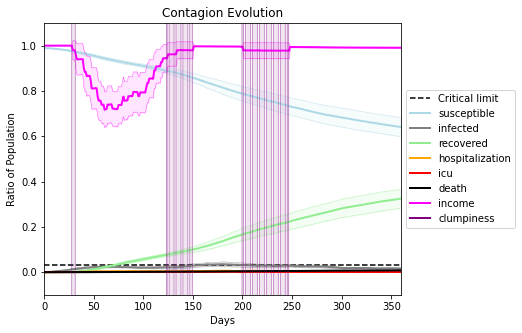

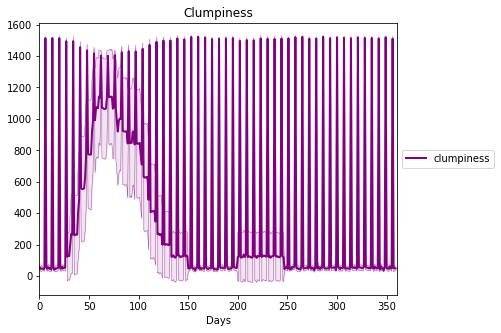

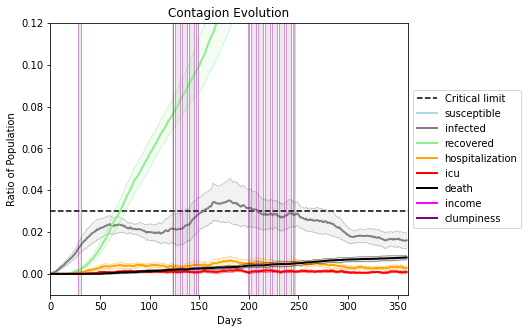

In [18]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.7
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
              [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
], listeners = listeners)

Save these seeds if you want to rerun a scenario
[8145, 8067, 522, 5379, 7992, 935, 6003, 2070, 7201, 9203, 9554, 7674, 5338, 3497, 1883, 8690, 3816, 1364, 622, 8325]
Average similarity between family members is 0.2889662963047657 at temperature -0.6
Average similarity between family and home is 0.9998606068121354 at temperature -1
Average similarity between students and their classroom is 0.17443102605602143 at temperature -0.6
Average classroom occupancy is 1.541237113402062 and number classrooms is 194
Average similarity between workers is 0.1649852560288665 at temperature -0.6
Average office occupancy is 3.190954773869347 and number offices is 199
Average friend similarity for adults: 0.3667241785382178 for kids: 0.22789042134571344
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homo

avg restaurant similarity 0.03197383544676772
avg restaurant similarity 0.11585057766301145
avg restaurant similarity 0.12835046150696544
avg restaurant similarity 0.15648519530765861
avg restaurant similarity 0.20735436666304796
avg restaurant similarity 0.0195570504302355
avg restaurant similarity 0.18449317298509746
avg restaurant similarity -0.06540703961474176
avg restaurant similarity 0.2031161308947121
avg restaurant similarity 0.2585741536839496
avg restaurant similarity -0.2588505835025547
avg restaurant similarity 0.0422099504719502
avg restaurant similarity 0.12030855046729017
avg restaurant similarity 0.15591533851527936
avg restaurant similarity 0.042500399694417025
avg restaurant similarity 0.23869167743720515
avg restaurant similarity -0.0065045149708643
avg restaurant similarity 0.3022023407165805
avg restaurant similarity 0.210313371252637
avg restaurant similarity -0.08133602520011197
avg restaurant similarity 0.07562253302798168
avg restaurant similarity 0.0694000067

avg restaurant similarity -0.19872198859811685
avg restaurant similarity 0.3258382439677381
avg restaurant similarity -0.08059216894457023
avg restaurant similarity 0.05943824338716853
avg restaurant similarity 0.2851182762036924
avg restaurant similarity -0.12684682264912434
avg restaurant similarity 0.049632933425340434
avg restaurant similarity 0.04787761604864911
avg restaurant similarity 0.23557598211114503
avg restaurant similarity 0.08363365146897522
avg restaurant similarity 0.3007583739458908
avg restaurant similarity 0.02372958754667074
avg restaurant similarity 0.3548682173867783
avg restaurant similarity 0.20127786258519353
avg restaurant similarity -0.05079238564972034
avg restaurant similarity -0.03247488541329897
avg restaurant similarity -0.09582062273540247
avg restaurant similarity -0.08514462854319739
avg restaurant similarity 0.14688724760606062
avg restaurant similarity 0.16492090212651786
avg restaurant similarity -0.001155819136463688
avg restaurant similarity 0.

Average similarity between family and home is 0.9998553195839681 at temperature -1
Average similarity between students and their classroom is 0.18760844775721772 at temperature -0.6
Average classroom occupancy is 1.7100591715976332 and number classrooms is 169
Average similarity between workers is 0.15804296445553906 at temperature -0.6
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.3853358706932194 for kids: 0.23759985437687908
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.0020535238355932034
avg restaurant similarity 0.4106884339907559
avg restaurant similarity 0.12914644643547682
avg restaurant similarity -0.0825612673581045
avg restaurant similarity 0.24844496145565814
avg restaurant similarity 0.22470537457284226
avg restaurant similarity 0.07772780893323207
avg restaurant similarity 0.0826094360231046
avg restaurant similarity 0.18827494086773114
avg restaurant similarity -0.06556205975699253
avg restaurant similarity 0.01969898603367039
avg restaurant similarity 0.06871822134283492
avg restaurant similarity 0.18279609062187807
avg restaurant similarity 0.15269858443557485
avg restaurant similarity -0.007886857525993121
avg restaurant similarity 0.05224372457817875
avg restaurant similarity -0.04903424993692624
avg restaurant similarity -0.12718017303414497
avg restaurant similarity 0.10181656185010936
avg restaurant similarity -0.00012666781200737498
avg restaurant similarity 0.0928853468716613
avg restaurant similarity 

avg restaurant similarity 0.1397243915884113
avg restaurant similarity 0.21155636069553266
avg restaurant similarity -0.10032921559516476
avg restaurant similarity 0.08689077050144936
avg restaurant similarity 0.2098258914134272
avg restaurant similarity 0.1058202322895957
avg restaurant similarity 0.07665573803595707
avg restaurant similarity 0.21482434962280225
avg restaurant similarity -0.05214656488647384
avg restaurant similarity 0.1808641612171656
avg restaurant similarity 0.07347755291747442
avg restaurant similarity 0.36580031847592553
avg restaurant similarity 0.1988224486453648
avg restaurant similarity 0.16235425366291262
avg restaurant similarity 0.06207021522169915
avg restaurant similarity 0.05464729170003198
avg restaurant similarity 0.1820368784757243
avg restaurant similarity -0.12182179202422788
avg restaurant similarity 0.23753086477139163
avg restaurant similarity 0.24502700951680004
avg restaurant similarity 0.08330093708402787
avg restaurant similarity 0.305196885

Average similarity between students and their classroom is 0.16832804228314288 at temperature -0.6
Average classroom occupancy is 1.680232558139535 and number classrooms is 172
Average similarity between workers is 0.1529448596553499 at temperature -0.6
Average office occupancy is 3.176470588235294 and number offices is 204
Average friend similarity for adults: 0.37648347950457495 for kids: 0.22251046202623134
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in 

avg restaurant similarity -0.04646703675391123
avg restaurant similarity 0.17531653096595062
avg restaurant similarity 0.1398280502817157
avg restaurant similarity 0.09723407279744721
avg restaurant similarity 0.20146295999026737
avg restaurant similarity 0.1719771503894196
avg restaurant similarity 0.09093874417515785
avg restaurant similarity -0.028141430996849418
avg restaurant similarity -0.03019753017917836
avg restaurant similarity 0.34122530002025137
avg restaurant similarity -0.0864808910360651
avg restaurant similarity 0.08632028629423139
avg restaurant similarity 0.1699509922955177
avg restaurant similarity 0.2569795461621775
avg restaurant similarity 0.02657180551619177
avg restaurant similarity -0.15824965578007524
avg restaurant similarity 0.3446254190060912
avg restaurant similarity 0.02721008747607041
avg restaurant similarity 0.15990050012138016
avg restaurant similarity 0.053853196216175105
avg restaurant similarity 0.05382484565883263
avg restaurant similarity 0.10038

avg restaurant similarity 0.1230614157384114
avg restaurant similarity 0.2718026795420394
avg restaurant similarity 0.2968356161378627
avg restaurant similarity 0.5349289512504053
avg restaurant similarity -0.15609380549423044
avg restaurant similarity -0.0341986152453867
avg restaurant similarity 0.22783448980682414
avg restaurant similarity 0.0945342632077436
avg restaurant similarity -0.00870132828719462
avg restaurant similarity 0.07109436226440288
avg restaurant similarity 0.21912162356897766
avg restaurant similarity 0.15992073599988907
avg restaurant similarity 0.12288832274655097
avg restaurant similarity 0.09556376818586418
avg restaurant similarity 0.16934655443194244
avg restaurant similarity 0.10749420447389894
avg restaurant similarity -0.035988758205554396
avg restaurant similarity 0.07396315114844403
avg restaurant similarity 0.04148390527414543
avg restaurant similarity 0.25815157509014003
avg restaurant similarity 0.11034915619789398
avg restaurant similarity 0.1355286

avg restaurant similarity 0.19949539008769435
avg restaurant similarity 0.17581207461768014
avg restaurant similarity 0.17940551360127585
avg restaurant similarity 0.04470086118892043
Average similarity between family members is 0.2853904909430009 at temperature -0.6
Average similarity between family and home is 0.9998603295478234 at temperature -1
Average similarity between students and their classroom is 0.1679420688771865 at temperature -0.6
Average classroom occupancy is 1.5657142857142856 and number classrooms is 175
Average similarity between workers is 0.16407964897182606 at temperature -0.6
Average office occupancy is 3.315270935960591 and number offices is 203
Average friend similarity for adults: 0.3713887286770414 for kids: 0.22507101867815918
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.07205705795521981
avg restaurant similarity -0.06705386284385728
avg restaurant similarity 0.017500102734125313
avg restaurant similarity 0.16132986769241706
avg restaurant similarity -0.11352858727258511
avg restaurant similarity 0.04620618396336413
avg restaurant similarity 0.025516742960559946
avg restaurant similarity 0.16522251792608109
avg restaurant similarity 0.29520693160037903
avg restaurant similarity 0.005678840442198227
avg restaurant similarity 0.12758148858350712
avg restaurant similarity 0.28371209591741825
avg restaurant similarity -0.26782280988243934
avg restaurant similarity 0.15389428911260292
avg restaurant similarity -0.0494592841489083
avg restaurant similarity -0.08024668419391763
avg restaurant similarity 0.18433762586888416
avg restaurant similarity 0.16342786808787052
avg restaurant similarity 0.03736061646061514
avg restaurant similarity 0.194188627150269
avg restaurant similarity 0.07815761423890208
avg restaurant similarity 0.0

avg restaurant similarity 0.37761050956776976
avg restaurant similarity 0.01848777392619678
avg restaurant similarity 0.10998478290273722
avg restaurant similarity 0.3910933888424598
avg restaurant similarity -0.007869929962106443
avg restaurant similarity 0.4601634275051515
avg restaurant similarity 0.1718391010053914
avg restaurant similarity -0.04845803772505292
avg restaurant similarity -0.01554698887268394
avg restaurant similarity 0.09841334624666996
avg restaurant similarity -0.054206988256952846
avg restaurant similarity 0.1180405159256661
avg restaurant similarity -0.07013984832581013
avg restaurant similarity 0.15307864405909322
avg restaurant similarity -0.13616095052619553
avg restaurant similarity 0.010812802163117616
avg restaurant similarity 0.3347828423461121
avg restaurant similarity -0.04261846192742362
avg restaurant similarity 0.15743210662874405
avg restaurant similarity 0.08756834913563653
avg restaurant similarity 0.13817954291977655
avg restaurant similarity 0.3

Average similarity between family and home is 0.9998373698880935 at temperature -1
Average similarity between students and their classroom is 0.14523741561683856 at temperature -0.6
Average classroom occupancy is 1.6488095238095237 and number classrooms is 168
Average similarity between workers is 0.14927229209883502 at temperature -0.6
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.36688861015046254 for kids: 0.21115141837932233
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.0828323078358334
avg restaurant similarity 0.24690748009615082
avg restaurant similarity 0.20379190299425548
avg restaurant similarity -0.03236968317502621
avg restaurant similarity 0.15133581325633486
avg restaurant similarity 0.30007478042716124
avg restaurant similarity 0.03779049603305542
avg restaurant similarity -0.05934583800835287
avg restaurant similarity -0.03244682793056623
avg restaurant similarity -0.09857986463461604
avg restaurant similarity 0.03419683356696124
avg restaurant similarity 0.043956516938157664
avg restaurant similarity 0.11892509245423043
avg restaurant similarity 0.1586374201218691
avg restaurant similarity 0.0437703608173562
avg restaurant similarity 0.023682301204757665
avg restaurant similarity 0.002010701126902391
avg restaurant similarity 0.1550072659395585
avg restaurant similarity -0.1056844724318649
avg restaurant similarity -0.1430319848711929
avg restaurant similarity -0.002705521976613177
avg restaurant similarity 0.3

avg restaurant similarity -0.02554734653131504
avg restaurant similarity 0.11015379023604611
avg restaurant similarity 0.04229138012582522
avg restaurant similarity 0.11317979323231767
avg restaurant similarity 0.15096785803627766
avg restaurant similarity 0.12260438237203299
avg restaurant similarity 0.14785461435616445
avg restaurant similarity 0.05811076095256562
avg restaurant similarity 0.00359773279861871
avg restaurant similarity 0.3990292109850819
avg restaurant similarity 0.17323831554008656
avg restaurant similarity -0.03673154179610991
avg restaurant similarity 0.10605177088702714
avg restaurant similarity 0.19234184013778047
avg restaurant similarity 0.013742779135584799
avg restaurant similarity 0.03723805046452163
avg restaurant similarity 0.4651441447652536
avg restaurant similarity 0.06834305354784397
avg restaurant similarity 0.7153186599619048
avg restaurant similarity -0.11324071946713402
avg restaurant similarity 0.6081233082554014
avg restaurant similarity -0.05322

Average similarity between students and their classroom is 0.17782426358465087 at temperature -0.6
Average classroom occupancy is 1.5585106382978724 and number classrooms is 188
Average similarity between workers is 0.12841799294010603 at temperature -0.6
Average office occupancy is 3.263681592039801 and number offices is 201
Average friend similarity for adults: 0.37345311878663096 for kids: 0.23665422500682232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated i

avg restaurant similarity -0.004558737332491746
avg restaurant similarity 0.05014743582722836
avg restaurant similarity 0.1613995016765265
avg restaurant similarity 0.1607035392354308
avg restaurant similarity -0.043034393464592376
avg restaurant similarity 0.3867518707062794
avg restaurant similarity -0.05394402376131415
avg restaurant similarity 0.1116938791518768
avg restaurant similarity 0.28994252923848984
avg restaurant similarity 0.0027498335536331256
avg restaurant similarity 0.20616172066184502
avg restaurant similarity 0.21181058669611716
avg restaurant similarity 0.03851397252859305
avg restaurant similarity 0.26178522743067634
avg restaurant similarity 0.2478555668584081
avg restaurant similarity 0.175715457450971
avg restaurant similarity 0.3058796709799054
avg restaurant similarity 0.12774607536363597
avg restaurant similarity -0.0006971171813595148
avg restaurant similarity -0.13502362997759923
avg restaurant similarity 0.28851335593003347
avg restaurant similarity 0.258

avg restaurant similarity 0.0888245187873358
avg restaurant similarity 0.2941486901184055
avg restaurant similarity 0.1944447830084602
avg restaurant similarity 0.06383738883069458
avg restaurant similarity 0.10097015117473333
avg restaurant similarity -0.040840055772163576
avg restaurant similarity 0.17403616378344078
avg restaurant similarity 0.0016737498594269757
avg restaurant similarity 0.06814222643920873
avg restaurant similarity 0.09117184520984549
avg restaurant similarity -0.10861751453146928
avg restaurant similarity -0.04346228030736286
avg restaurant similarity 0.015462689061738021
avg restaurant similarity 0.20390735015202316
avg restaurant similarity 0.1822272164327465
avg restaurant similarity 0.014581475722599324
avg restaurant similarity 0.011229140666438153
avg restaurant similarity 0.13385641746349558
avg restaurant similarity 0.12702615233050113
avg restaurant similarity 0.05336314772876842
avg restaurant similarity 0.08773275204960927
avg restaurant similarity 0.2

Average similarity between family and home is 0.9998570627957102 at temperature -1
Average similarity between students and their classroom is 0.20377042063649162 at temperature -0.6
Average classroom occupancy is 1.5465116279069768 and number classrooms is 172
Average similarity between workers is 0.1799128948405071 at temperature -0.6
Average office occupancy is 3.3497536945812807 and number offices is 203
Average friend similarity for adults: 0.38937098826306277 for kids: 0.23197920247650844
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.2629481361081472
avg restaurant similarity 0.1035712410895211
avg restaurant similarity -0.01984096293609857
avg restaurant similarity 0.06729324620023582
avg restaurant similarity 0.30751899052065407
avg restaurant similarity 0.13048514821211063
avg restaurant similarity 0.6253833285710259
avg restaurant similarity -0.01542160954500201
avg restaurant similarity 0.13910376295720966
avg restaurant similarity 0.15318047756567632
avg restaurant similarity 0.25441573062569733
avg restaurant similarity 0.01886684057177151
avg restaurant similarity 0.12813227403101798
avg restaurant similarity 0.20573902380016107
avg restaurant similarity 0.18593532073178287
avg restaurant similarity -0.13073405410361444
avg restaurant similarity 0.24901159634783776
avg restaurant similarity 0.04378940915506978
avg restaurant similarity 0.12498131271136469
avg restaurant similarity 0.1149806717220109
avg restaurant similarity -0.03739884457933481
avg restaurant similarity 0.112137

avg restaurant similarity 0.11640986622056697
avg restaurant similarity 0.11000474643960295
avg restaurant similarity 0.10514548581377005
avg restaurant similarity 0.07550340273040017
avg restaurant similarity 0.28754778798547814
avg restaurant similarity 0.20905056927829682
avg restaurant similarity 0.04179969387518936
avg restaurant similarity 0.20763044402328212
avg restaurant similarity 0.4911326530839736
avg restaurant similarity 0.11830783741897001
avg restaurant similarity 0.3147963566791071
avg restaurant similarity -0.14345349414319675
avg restaurant similarity 0.04319937402973719
avg restaurant similarity 0.04674235233573279
avg restaurant similarity 0.09101591819114031
avg restaurant similarity 0.05703910660024416
avg restaurant similarity 0.010844141778717054
avg restaurant similarity 0.05335382041656657
avg restaurant similarity 0.12101393707179953
avg restaurant similarity 0.17025082837659677
avg restaurant similarity -0.2530148710367938
avg restaurant similarity 0.336898

Average similarity between family members is 0.3036447185791344 at temperature -0.6
Average similarity between family and home is 0.9998676252392326 at temperature -1
Average similarity between students and their classroom is 0.19157273703758101 at temperature -0.6
Average classroom occupancy is 1.6149732620320856 and number classrooms is 187
Average similarity between workers is 0.15837874107047598 at temperature -0.6
Average office occupancy is 3.206896551724138 and number offices is 203
Average friend similarity for adults: 0.3698649922690956 for kids: 0.24064174239057945
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.09650053864565994
avg restaurant similarity 0.3845706382419358
avg restaurant similarity 0.2705223719449454
avg restaurant similarity 0.012145342062408679
avg restaurant similarity 0.12230344895363207
avg restaurant similarity 0.11302579732407579
avg restaurant similarity 0.14581352425053007
avg restaurant similarity 0.2221571211307927
avg restaurant similarity 0.2506338917677032
avg restaurant similarity 0.08380468699997508
avg restaurant similarity 0.0772629103111156
avg restaurant similarity 0.03306861765634081
avg restaurant similarity -0.022790198985292626
avg restaurant similarity 0.12223112267031337
avg restaurant similarity 0.4848638847240353
avg restaurant similarity 0.1936540078954009
avg restaurant similarity 0.047003663642249775
avg restaurant similarity 0.05551958386165867
avg restaurant similarity 0.16535272317673372
avg restaurant similarity 0.00596037195673689
avg restaurant similarity 0.16384380903763532
avg restaurant similarity 0.207796754

avg restaurant similarity 0.05762793379912105
avg restaurant similarity -0.06763660220700407
avg restaurant similarity 0.03144738859850077
avg restaurant similarity 0.03391317304067909
avg restaurant similarity 0.27867650849365266
avg restaurant similarity 0.14730570679156044
avg restaurant similarity -0.13495485462505877
avg restaurant similarity 0.1277579770383833
avg restaurant similarity 0.030541900288004485
avg restaurant similarity 0.3112181052173118
avg restaurant similarity 0.09197739309737543
avg restaurant similarity 0.30823918925281046
avg restaurant similarity -0.07944479904589814
avg restaurant similarity 0.21927381669450136
avg restaurant similarity 0.01734255107425428
avg restaurant similarity 0.1725427182887719
avg restaurant similarity 0.2427002757518369
avg restaurant similarity 0.07995327817390559
avg restaurant similarity 0.027865982556696263
avg restaurant similarity 0.06344966729821826
avg restaurant similarity -0.0734105235139309
avg restaurant similarity 0.28559

Average similarity between family and home is 0.9998515321546646 at temperature -1
Average similarity between students and their classroom is 0.1545626771464888 at temperature -0.6
Average classroom occupancy is 1.6577540106951871 and number classrooms is 187
Average similarity between workers is 0.15381795694646433 at temperature -0.6
Average office occupancy is 3.3520408163265305 and number offices is 196
Average friend similarity for adults: 0.37494016967508514 for kids: 0.2327775887234632
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity -0.1154544860198382
avg restaurant similarity -0.03873546931312142
avg restaurant similarity 0.09489136483381695
avg restaurant similarity 0.1711870957054218
avg restaurant similarity -0.11172319532915881
avg restaurant similarity 0.005778920984990765
avg restaurant similarity 0.2845239939039874
avg restaurant similarity 0.24729313853521953
avg restaurant similarity 0.11168209206671312
avg restaurant similarity 0.04245284519782443
avg restaurant similarity 0.22788751440449548
avg restaurant similarity 0.06702024449763813
avg restaurant similarity 0.042825460167043576
avg restaurant similarity 0.06913324708052379
avg restaurant similarity 0.34459680660728753
avg restaurant similarity 0.18703515069430354
avg restaurant similarity 0.13657999127440779
avg restaurant similarity 0.04439866391461445
avg restaurant similarity 0.16884350415196014
avg restaurant similarity -0.040553731681931895
avg restaurant similarity 0.10556463538358371
avg restaurant similarity 0.41

avg restaurant similarity 0.09533355553388673
avg restaurant similarity 0.06099590921076177
avg restaurant similarity -0.01147687809781703
avg restaurant similarity 0.2400061514563434
avg restaurant similarity 0.05466792784001149
avg restaurant similarity 0.09325806302593823
avg restaurant similarity -0.07929004364864335
avg restaurant similarity 0.04821570809635526
avg restaurant similarity -0.04459602387409334
avg restaurant similarity 0.2684213991926437
avg restaurant similarity -0.04967847089709922
avg restaurant similarity 0.14030351360036358
avg restaurant similarity -0.030240794343274785
avg restaurant similarity -0.12347784782817328
avg restaurant similarity 0.045198500453694355
avg restaurant similarity 0.004774134030503098
avg restaurant similarity 0.03950604745696607
avg restaurant similarity 0.11062535670732136
avg restaurant similarity 0.09240636696203781
avg restaurant similarity 0.21358324959367625
avg restaurant similarity 0.07589725175659927
avg restaurant similarity -

avg restaurant similarity 0.1432451568897153
avg restaurant similarity 0.04729159095171065
avg restaurant similarity -0.029206674440434455
Average similarity between family members is 0.30800206482431824 at temperature -0.6
Average similarity between family and home is 0.9998593304811828 at temperature -1
Average similarity between students and their classroom is 0.12913917254828977 at temperature -0.6
Average classroom occupancy is 1.6402439024390243 and number classrooms is 164
Average similarity between workers is 0.1707705269442026 at temperature -0.6
Average office occupancy is 3.400990099009901 and number offices is 202
Average friend similarity for adults: 0.3791921915423371 for kids: 0.2163436320179064
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity -0.05142108180518378
avg restaurant similarity 0.1435539867128095
avg restaurant similarity -0.022220683319843004
avg restaurant similarity 0.1537743789661533
avg restaurant similarity 0.018890827427986066
avg restaurant similarity 0.2861631277920202
avg restaurant similarity 0.1530045121634145
avg restaurant similarity 0.3127590839163413
avg restaurant similarity 0.1236958323919593
avg restaurant similarity -0.19802008667274398
avg restaurant similarity -0.13823818961899198
avg restaurant similarity 0.30579762823449264
avg restaurant similarity 0.057096507314131836
avg restaurant similarity -0.008988675470815744
avg restaurant similarity 0.19754638379709785
avg restaurant similarity 0.16626788598008374
avg restaurant similarity 0.4962039823801287
avg restaurant similarity 0.1323105298103928
avg restaurant similarity 0.4123010424381774
avg restaurant similarity 0.09343212772876115
avg restaurant similarity 0.4372642378626904
avg restaurant similarity 0.3578493

avg restaurant similarity 0.4192444435795535
avg restaurant similarity 0.0309970731993571
avg restaurant similarity 0.08092711447987218
avg restaurant similarity 0.27172073702844923
avg restaurant similarity 0.22472828260122102
avg restaurant similarity -0.14329390114910545
avg restaurant similarity 0.10174025880952041
avg restaurant similarity -0.03659498262246112
avg restaurant similarity 0.05567353290384764
avg restaurant similarity 0.10034520157750498
avg restaurant similarity 0.10903398282519548
avg restaurant similarity 0.5611766334817037
avg restaurant similarity 0.6772296775904156
avg restaurant similarity -0.09417470915314582
avg restaurant similarity 0.014354382231477444
avg restaurant similarity 0.09417287960338955
avg restaurant similarity 0.11374647399040244
avg restaurant similarity 0.18401362972454627
avg restaurant similarity -0.003256777094017745
avg restaurant similarity -0.03384223260324239
avg restaurant similarity 0.7581409179104672
avg restaurant similarity 0.2825

avg restaurant similarity 0.1266974420074086
avg restaurant similarity 0.18934381248366267
avg restaurant similarity 0.12437493957865382
avg restaurant similarity 0.0927697968618105
avg restaurant similarity 0.18689174499517439
avg restaurant similarity 0.14698608969265678
avg restaurant similarity 0.20762550646917477
avg restaurant similarity -0.04705373708943497
avg restaurant similarity 0.10250331768149142
avg restaurant similarity 0.24537449942118217
avg restaurant similarity 0.07340887388183451
avg restaurant similarity 0.12196082042863948
avg restaurant similarity 0.17198024157168482
avg restaurant similarity 0.17451802146130732
avg restaurant similarity 0.012096457200627908
avg restaurant similarity 0.06292762930971656
avg restaurant similarity 0.1707736079038567
avg restaurant similarity 0.1932324207919689
avg restaurant similarity 0.1429997033493399
avg restaurant similarity -0.020313384148682133
avg restaurant similarity 0.08591287046484804
avg restaurant similarity 0.1601970

avg restaurant similarity 0.19009090037517581
avg restaurant similarity -0.06679088426331083
avg restaurant similarity 0.1275353135897317
avg restaurant similarity -0.05762499208329281
avg restaurant similarity 0.19280973110709368
avg restaurant similarity 0.18545247113780303
avg restaurant similarity 0.18756492839243455
avg restaurant similarity -0.002247522067000518
avg restaurant similarity 0.18170351453568734
avg restaurant similarity 0.10431900292592772
avg restaurant similarity 0.03649834254233082
avg restaurant similarity 0.009153841280918788
avg restaurant similarity 0.09746907674583356
avg restaurant similarity 0.0631476063139583
avg restaurant similarity 0.05331048636442011
avg restaurant similarity 0.034582072422517415
avg restaurant similarity 0.29470702154246203
avg restaurant similarity 0.2763457490814915
avg restaurant similarity -0.03101256425134893
avg restaurant similarity 0.0014591453898397944
avg restaurant similarity 0.1138173823741834
avg restaurant similarity 0.1

avg restaurant similarity 0.050477418478804194
avg restaurant similarity 0.06964655756883154
avg restaurant similarity -0.04689359028455913
Average similarity between family members is 0.2827114233207106 at temperature -0.6
Average similarity between family and home is 0.9998597063632276 at temperature -1
Average similarity between students and their classroom is 0.16324313338050922 at temperature -0.6
Average classroom occupancy is 1.5942857142857143 and number classrooms is 175
Average similarity between workers is 0.1537008480354948 at temperature -0.6
Average office occupancy is 3.215686274509804 and number offices is 204
Average friend similarity for adults: 0.37373563889950107 for kids: 0.20735635081177675
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.16966283624959502
avg restaurant similarity 0.035039719722109494
avg restaurant similarity 0.20126491464360927
avg restaurant similarity 0.046841897179157946
avg restaurant similarity 0.025917021226647283
avg restaurant similarity 0.11493129416075383
avg restaurant similarity 0.1804560652939864
avg restaurant similarity 0.06143101894906124
avg restaurant similarity 0.4488238317679911
avg restaurant similarity 0.22172708818205308
avg restaurant similarity -0.030246480741091895
avg restaurant similarity -0.04561699895171334
avg restaurant similarity 0.11420896398647296
avg restaurant similarity -0.055922736633339125
avg restaurant similarity -0.00796717345314475
avg restaurant similarity 0.12353257736233497
avg restaurant similarity 0.10966156314372844
avg restaurant similarity 0.011390021216634016
avg restaurant similarity 0.21010841821701065
avg restaurant similarity -0.07539031565205538
avg restaurant similarity 0.13447263295509654
avg restaurant similarity

avg restaurant similarity -0.08277161360798455
avg restaurant similarity 0.05595081052587888
avg restaurant similarity 0.19834572311553544
avg restaurant similarity -0.05736398639078201
avg restaurant similarity 0.1070447800123144
avg restaurant similarity 0.12628712833323097
avg restaurant similarity 0.18301270382907459
avg restaurant similarity -0.009263060079181207
avg restaurant similarity 0.08881224165499872
avg restaurant similarity 0.11040666243183175
avg restaurant similarity 0.035165579618698324
avg restaurant similarity 0.16981877881157065
avg restaurant similarity 0.10892611247881086
avg restaurant similarity -0.050646561451015475
avg restaurant similarity -0.07657766406543312
avg restaurant similarity 0.03034519445237
avg restaurant similarity 0.20782369784476945
avg restaurant similarity 0.08631788932039128
avg restaurant similarity 0.010417405136907936
avg restaurant similarity 0.2089493848571825
avg restaurant similarity -0.07177300790999001
avg restaurant similarity 0.0

avg restaurant similarity 0.08405112409174957
Average similarity between family members is 0.3099049596686207 at temperature -0.6
Average similarity between family and home is 0.9998516764975954 at temperature -1
Average similarity between students and their classroom is 0.18998950050830649 at temperature -0.6
Average classroom occupancy is 1.5307262569832403 and number classrooms is 179
Average similarity between workers is 0.16445683707707487 at temperature -0.6
Average office occupancy is 3.4846938775510203 and number offices is 196
Average friend similarity for adults: 0.3889433127321424 for kids: 0.2216729828631516
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 peo

avg restaurant similarity 0.24498565607793096
avg restaurant similarity 0.06079487552966833
avg restaurant similarity 0.27322215423046436
avg restaurant similarity 0.033127726565443785
avg restaurant similarity 0.2710557001380596
avg restaurant similarity 0.1179237622452961
avg restaurant similarity 0.2881206456677025
avg restaurant similarity -0.033579562163594256
avg restaurant similarity -0.14411522180930716
avg restaurant similarity 0.22390927956595214
avg restaurant similarity 0.23814706601676514
avg restaurant similarity 0.11087169686928851
avg restaurant similarity 0.12611807143406054
avg restaurant similarity 0.0635488686352697
avg restaurant similarity 0.0359094355967157
avg restaurant similarity 0.1833736830646992
avg restaurant similarity 0.17233976607567553
avg restaurant similarity -0.0006227002514020696
avg restaurant similarity 0.1860120206538022
avg restaurant similarity 0.0601382492109474
avg restaurant similarity 0.2854200376004402
avg restaurant similarity 0.17438791

avg restaurant similarity -0.14194421824282932
avg restaurant similarity 0.2261056455723929
avg restaurant similarity 0.2674789849652483
avg restaurant similarity 0.1669535792837118
avg restaurant similarity 0.051354726494135416
avg restaurant similarity -0.1457299172846045
avg restaurant similarity 0.1724587590296464
avg restaurant similarity 0.06324402362278864
avg restaurant similarity -0.14032694739492507
avg restaurant similarity 0.13711960718901983
avg restaurant similarity 0.004508398118577395
avg restaurant similarity 0.05087031305929894
avg restaurant similarity 0.017360495205580063
avg restaurant similarity 0.1705008485877688
avg restaurant similarity 0.37792149950858495
avg restaurant similarity 0.1890946130242514
avg restaurant similarity 0.05518190422105388
avg restaurant similarity -0.025768050277086122
avg restaurant similarity 0.46391164197455564
avg restaurant similarity 0.14929006612731652
avg restaurant similarity 0.35707906635382597
avg restaurant similarity 0.16989

avg restaurant similarity 0.22706767018192175
avg restaurant similarity 0.06349398842157074
avg restaurant similarity 0.1751733552083217
Average similarity between family members is 0.29264122757752736 at temperature -0.6
Average similarity between family and home is 0.9998550150336513 at temperature -1
Average similarity between students and their classroom is 0.2090517451473933 at temperature -0.6
Average classroom occupancy is 1.6898395721925135 and number classrooms is 187
Average similarity between workers is 0.14249967362202864 at temperature -0.6
Average office occupancy is 3.2346938775510203 and number offices is 196
Average friend similarity for adults: 0.36661208200721845 for kids: 0.24269666318340843
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.18817441342412364
avg restaurant similarity 0.029575821210277093
avg restaurant similarity 0.647226367646519
avg restaurant similarity -0.07091139005156154
avg restaurant similarity -0.07876406526847304
avg restaurant similarity 0.2721928454558647
avg restaurant similarity 0.19914512598962436
avg restaurant similarity 0.31080570272703484
avg restaurant similarity 0.0978188593360658
avg restaurant similarity 0.19786876789348054
avg restaurant similarity 0.07973911055597842
avg restaurant similarity -0.04377112871282335
avg restaurant similarity 0.045547413082851346
avg restaurant similarity 0.10040609987790468
avg restaurant similarity -0.2508639696663857
avg restaurant similarity 0.4818413595691896
avg restaurant similarity 0.2219095908969139
avg restaurant similarity 0.07001535581224666
avg restaurant similarity 0.2940708333943503
avg restaurant similarity 0.05915841167349764
avg restaurant similarity 0.2073114639905529
avg restaurant similarity 0.098574963

avg restaurant similarity -0.004140612631360539
avg restaurant similarity -0.19069681946061073
avg restaurant similarity 0.1264296818394294
avg restaurant similarity 0.09864951182167152
avg restaurant similarity 0.15472862205753923
avg restaurant similarity -0.1588009519586343
avg restaurant similarity 0.6347912466285554
avg restaurant similarity 0.166205076968733
avg restaurant similarity 0.34203467906277535
avg restaurant similarity 0.09457270699032749
avg restaurant similarity 0.1494828081156512
avg restaurant similarity 0.04578213095557917
avg restaurant similarity 0.09380352800742965
avg restaurant similarity -0.08148087833539605
avg restaurant similarity 0.3604798244643194
avg restaurant similarity 0.08756079655731218
avg restaurant similarity 0.12157104733196435
avg restaurant similarity 0.3957315318298229
avg restaurant similarity -0.060728933864155454
avg restaurant similarity 0.005359001478281528
avg restaurant similarity -0.07841911499071699
avg restaurant similarity 0.15316

avg restaurant similarity -0.24897858015100754
avg restaurant similarity 0.1576723617484883
avg restaurant similarity -0.06555936607287423
avg restaurant similarity 0.48217811457913795
avg restaurant similarity -0.08106301991149845
avg restaurant similarity 0.27224686444765955
avg restaurant similarity 0.16503380984473875
avg restaurant similarity -0.01737931315663402
avg restaurant similarity -0.00040135932562083515
avg restaurant similarity -0.027259208387467787
avg restaurant similarity -0.05854998682482513
avg restaurant similarity 0.2647737388221091
avg restaurant similarity 0.04278687023452119
avg restaurant similarity -0.00394731182673842
avg restaurant similarity 0.12259100304836294
avg restaurant similarity 0.013683899213895283
avg restaurant similarity 0.2382931482094251
avg restaurant similarity 0.05371803968980668
avg restaurant similarity 0.01934053772749584
avg restaurant similarity 0.07041393708461911
avg restaurant similarity 0.1374008928363439
avg restaurant similarity

avg restaurant similarity -0.002419762372348623
avg restaurant similarity 0.09745131350394384
avg restaurant similarity 0.05072937768677726
avg restaurant similarity 0.008566259441082899
avg restaurant similarity -0.010218553440242348
avg restaurant similarity 0.2280940244836414
avg restaurant similarity 0.008408761940197962
avg restaurant similarity 0.3038114548154039
avg restaurant similarity 0.1483885408138836
avg restaurant similarity 0.19981139261091924
avg restaurant similarity 0.5521785265395501
avg restaurant similarity 0.10386957619548065
avg restaurant similarity 0.15880511926573485
avg restaurant similarity 0.029549903732681973
avg restaurant similarity 0.05482306355062709
avg restaurant similarity -0.1450494835942177
avg restaurant similarity -0.04523836332224091
avg restaurant similarity 0.0714223870768437
avg restaurant similarity 0.10594938132682008
avg restaurant similarity 0.024771987776307337
avg restaurant similarity 0.14168830117405445
avg restaurant similarity 0.41

Average friend similarity for adults: 0.3775700579911 for kids: 0.24222165351048983
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocat

avg restaurant similarity 0.190152033050925
avg restaurant similarity 0.1464530078721235
avg restaurant similarity 0.11541963217958254
avg restaurant similarity 0.08935696300097265
avg restaurant similarity 0.10514453832797906
avg restaurant similarity -0.13259591406531218
avg restaurant similarity 0.33517968352329314
avg restaurant similarity 0.17021441975962984
avg restaurant similarity 0.25080585554843726
avg restaurant similarity 0.12476132301257188
avg restaurant similarity -0.1254949981279917
avg restaurant similarity 0.09450117295062499
avg restaurant similarity 0.2767122591979867
avg restaurant similarity 0.2900903841437382
avg restaurant similarity 0.2324087060164376
avg restaurant similarity 0.23708965019217818
avg restaurant similarity 0.23226044282615346
avg restaurant similarity 0.045021276151393515
avg restaurant similarity 0.2831960613993212
avg restaurant similarity 0.32697611769313
avg restaurant similarity -0.016445416677566067
avg restaurant similarity 0.413359862893

avg restaurant similarity 0.12948331423555207
avg restaurant similarity 0.20542282773270593
avg restaurant similarity 0.07333249026004877
avg restaurant similarity 0.15941367147575083
avg restaurant similarity 0.06413635877263442
avg restaurant similarity 0.08239951079622139
avg restaurant similarity 0.00447031855232146
avg restaurant similarity 0.05087266284710086
avg restaurant similarity -0.1834813635467726
avg restaurant similarity 0.18153800662025746
avg restaurant similarity 0.19578953997767726
avg restaurant similarity 0.11269781289496156
avg restaurant similarity -0.047475967397991814
avg restaurant similarity 0.17577947643746533
avg restaurant similarity 0.1952011855466359
avg restaurant similarity 0.39706217236973723
avg restaurant similarity 0.18480865851786415
avg restaurant similarity -0.040017510358714516
avg restaurant similarity -0.04476728768454401
avg restaurant similarity 0.2087838141668493
avg restaurant similarity -0.056564000719061425
avg restaurant similarity 0.0

avg restaurant similarity -0.20531239703683357
avg restaurant similarity -0.07687471256504785
avg restaurant similarity 0.018678661439491297
avg restaurant similarity 0.15061419491053415
avg restaurant similarity 0.025483509122529585
avg restaurant similarity 0.45864507940604027
avg restaurant similarity 0.27752294450036125
avg restaurant similarity -0.010901235296520468
avg restaurant similarity 0.025365308372994402
avg restaurant similarity 0.07488875414712405
avg restaurant similarity 0.03378192173552704
avg restaurant similarity 0.23518564904229172
avg restaurant similarity -0.028438083492932666
avg restaurant similarity -0.13228093354613707
avg restaurant similarity 0.13407434988718522
avg restaurant similarity -0.007865700406825922
avg restaurant similarity 0.11719404281187014
avg restaurant similarity 0.18572721679194573
avg restaurant similarity -0.09314049742824408
avg restaurant similarity 0.27003110045132767
avg restaurant similarity 0.004310332888280781
avg restaurant simil

avg restaurant similarity -0.008619106576905485
avg restaurant similarity 0.25250211188326943
avg restaurant similarity 0.44658688629684185
avg restaurant similarity 0.2853051517862783
avg restaurant similarity -0.06987955446830972
avg restaurant similarity 0.23584815642316512
avg restaurant similarity 0.03907333032095868
avg restaurant similarity 0.15116898672162812
avg restaurant similarity 0.1350640219431843
avg restaurant similarity 0.08536724164532966
avg restaurant similarity 0.21930857150639202
avg restaurant similarity 0.1171095636914689
avg restaurant similarity -0.06449033157845993
avg restaurant similarity 0.13715720539882117
avg restaurant similarity -0.1096745866203513
avg restaurant similarity -0.06062090248136328
avg restaurant similarity -0.08297933703020684
avg restaurant similarity 0.024647010466880725
avg restaurant similarity 0.03849857305954617
avg restaurant similarity -0.1967848660795512
avg restaurant similarity -0.0114148715601608
avg restaurant similarity 0.03

Average similarity between workers is 0.1419705714035483 at temperature -0.6
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.3740127276826028 for kids: 0.2251259185957762
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated 

avg restaurant similarity 0.1232726727631367
avg restaurant similarity 0.19360311169069472
avg restaurant similarity -0.10054007014774068
avg restaurant similarity 0.05630607749893127
avg restaurant similarity 0.09546916654275188
avg restaurant similarity -0.3284555010281043
avg restaurant similarity 0.05092399443550934
avg restaurant similarity 0.10544866750900124
avg restaurant similarity 0.2730694885208609
avg restaurant similarity 0.22998336414109372
avg restaurant similarity 0.01307817885898629
avg restaurant similarity 0.07026675326119143
avg restaurant similarity 0.04984696421829111
avg restaurant similarity 0.09012090551937534
avg restaurant similarity 0.22960201188618276
avg restaurant similarity 0.36367795396587804
avg restaurant similarity 0.050659174803117546
avg restaurant similarity 0.10454537290293187
avg restaurant similarity 0.042834849328976764
avg restaurant similarity -0.09445118768828933
avg restaurant similarity 0.1493019142925924
avg restaurant similarity -0.0156

avg restaurant similarity 0.19546317323108348
avg restaurant similarity 0.01835355374147357
avg restaurant similarity 0.09611200293568013
avg restaurant similarity 0.15904074580198543
avg restaurant similarity 0.27555696687294023
avg restaurant similarity 0.2682535736121247
avg restaurant similarity 0.18986001082550027
avg restaurant similarity 0.18435226902212834
avg restaurant similarity 0.006316466123036356
avg restaurant similarity 0.34750324949268996
avg restaurant similarity -0.023024645696959885
avg restaurant similarity 0.2714094031997298
avg restaurant similarity 0.22062109126254337
avg restaurant similarity 0.1992724352813054
avg restaurant similarity 0.08865615184495591
avg restaurant similarity -0.18559950435157396
avg restaurant similarity -0.16177198042193325
avg restaurant similarity 0.24888111346168298
avg restaurant similarity 0.24930853502392286
avg restaurant similarity 0.06400989612678097
avg restaurant similarity 0.19604624666342318
avg restaurant similarity 0.0977

Average friend similarity for adults: 0.3636859053806359 for kids: 0.23442897377952596
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocate

avg restaurant similarity 0.08087682127384932
avg restaurant similarity 0.35718053950497414
avg restaurant similarity 0.11611106644263605
avg restaurant similarity 0.16347526874390744
avg restaurant similarity 0.12485713777379873
avg restaurant similarity 0.11119809599356757
avg restaurant similarity 0.19094758715050056
avg restaurant similarity -0.12834442925187414
avg restaurant similarity -0.011020703116520817
avg restaurant similarity -0.08196113939634958
avg restaurant similarity 0.009561799325593996
avg restaurant similarity -0.040165397419407285
avg restaurant similarity 0.2984557380758334
avg restaurant similarity 0.09203627772925373
avg restaurant similarity 0.27172080507998536
avg restaurant similarity 0.19076659331055432
avg restaurant similarity -0.013689310373721066
avg restaurant similarity 0.19078540532629637
avg restaurant similarity 0.10129383909298423
avg restaurant similarity 0.24856156052594708
avg restaurant similarity 0.010449300235681979
avg restaurant similarity

avg restaurant similarity 0.15617605442743285
avg restaurant similarity 0.1315034089350414
avg restaurant similarity 0.1093732542933374
avg restaurant similarity 0.23458298779381942
avg restaurant similarity 0.2826374043559789
avg restaurant similarity 0.11099320900728997
avg restaurant similarity 0.008795357344963992
avg restaurant similarity -0.06568949292678423
avg restaurant similarity 0.10817538908488389
avg restaurant similarity 0.081191783067567
avg restaurant similarity 0.1746447124818123
avg restaurant similarity 0.2369900494594713
avg restaurant similarity 0.11165488568662654
avg restaurant similarity 0.10180091086848941
avg restaurant similarity 0.0036061172858774617
avg restaurant similarity 0.138393247469469
avg restaurant similarity 0.056788741670751285
avg restaurant similarity -0.02693610539016993
avg restaurant similarity -0.02834146668560059
avg restaurant similarity 0.1782708055748228
avg restaurant similarity -0.12691701595723318
avg restaurant similarity 0.00736849

Average similarity between family members is 0.29602615734498283 at temperature -0.6
Average similarity between family and home is 0.999844345451126 at temperature -1
Average similarity between students and their classroom is 0.16421693955962452 at temperature -0.6
Average classroom occupancy is 1.546448087431694 and number classrooms is 183
Average similarity between workers is 0.15805382191256379 at temperature -0.6
Average office occupancy is 3.36 and number offices is 200
Average friend similarity for adults: 0.37925741017582876 for kids: 0.22060309663628858
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district 

avg restaurant similarity -0.05772988569083562
avg restaurant similarity 0.11821665067823063
avg restaurant similarity 0.10667080555283973
avg restaurant similarity 0.14250208834803063
avg restaurant similarity -0.05177030524422314
avg restaurant similarity 0.15557908371234952
avg restaurant similarity 0.21255596215768802
avg restaurant similarity 0.0331144905344468
avg restaurant similarity 0.07265217501437014
avg restaurant similarity 0.13366686756825635
avg restaurant similarity 0.19014922095375103
avg restaurant similarity 0.21405539404705895
avg restaurant similarity 0.24701316112838706
avg restaurant similarity -0.003469426991638174
avg restaurant similarity 0.12545003061108312
avg restaurant similarity 0.1503779443698488
avg restaurant similarity 0.06779625357198579
avg restaurant similarity 0.08142042162115
avg restaurant similarity -0.013152280494140666
avg restaurant similarity 0.11560967256136462
avg restaurant similarity 0.140500753726392
avg restaurant similarity 0.0914607

avg restaurant similarity 0.1052139957026763
avg restaurant similarity -0.027886772781771155
avg restaurant similarity 0.2392817218038358
avg restaurant similarity 0.06638907266712142
avg restaurant similarity 0.15423040086186132
avg restaurant similarity -0.12140738355016861
avg restaurant similarity 0.3540423123718273
avg restaurant similarity 0.12674846149825666
avg restaurant similarity 0.1599389185037685
avg restaurant similarity 0.183441728529786
avg restaurant similarity 0.2312510989844818
avg restaurant similarity 0.054478984017793865
avg restaurant similarity 0.036525385307765584
avg restaurant similarity -0.008044853488360898
avg restaurant similarity -0.20395447109012205
avg restaurant similarity -0.018902177398866904
avg restaurant similarity 0.43853894468290744
avg restaurant similarity 0.11723565115551862
avg restaurant similarity 0.054210981031231675
avg restaurant similarity -0.005694862104830703
avg restaurant similarity -0.02267108567421282
avg restaurant similarity 0

avg restaurant similarity 0.09556167190219905
using average of time series:
stats on susceptible:
data: [0.8027417387447328, 0.8438805555555556, 0.834975, 0.8710333333333333, 0.8011666666666667, 0.8761277777777778, 0.8738777777777778, 0.7393861111111112, 0.861213888888889, 0.727425, 0.8671138888888889, 0.8579305555555554, 0.72775, 0.8503277777777778, 0.7155166666666667, 0.7537222222222223, 0.81118041694389, 0.7981694444444445, 0.9197333333333334, 0.7588916666666667]
min:
0.7155166666666667
max:
0.9197333333333334
std:
0.0587041807221661
mean:
0.8146081911177644
median:
0.823077708471945
95% confidence interval for the mean:
(0.7864200491265627,0.8427963331089661)
using average of time series:
stats on infected:
data: [0.023866156575737416, 0.020422222222222224, 0.018919444444444447, 0.014136111111111111, 0.025602777777777773, 0.01543888888888889, 0.01743888888888889, 0.030763888888888886, 0.015827777777777777, 0.032147222222222216, 0.015408333333333335, 0.013211111111111111, 0.03593888

(<function dict.items>, <function dict.items>, <function dict.items>)

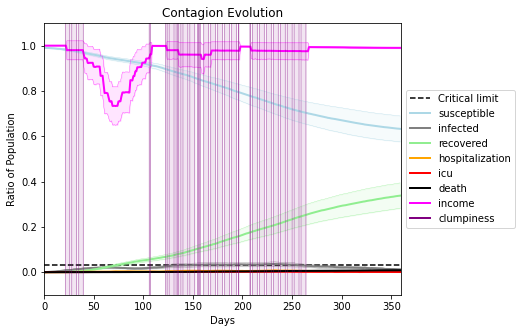

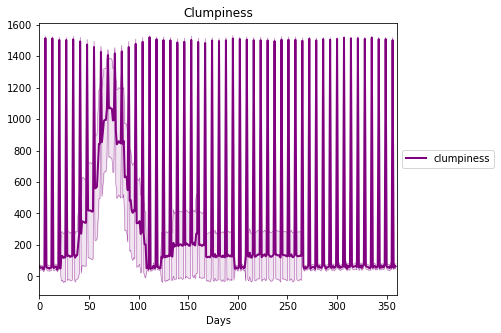

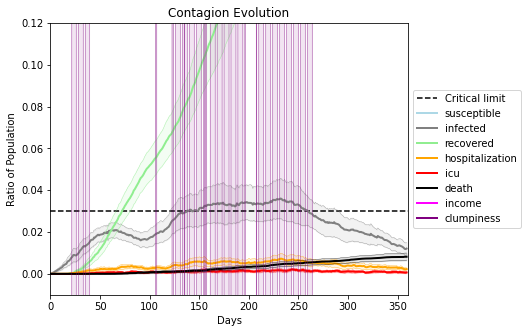

In [19]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.6
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6086, 8497, 7029, 6579, 941, 3105, 4324, 3139, 6791, 9110, 4223, 3848, 4335, 3815, 412, 6936, 3054, 7753, 5936, 1616]
Average similarity between family members is 0.26377891819612576 at temperature -0.5
Average similarity between family and home is 0.9998641996163222 at temperature -1
Average similarity between students and their classroom is 0.16914785979772615 at temperature -0.5
Average classroom occupancy is 1.6170212765957446 and number classrooms is 188
Average similarity between workers is 0.1537787365407734 at temperature -0.5
Average office occupancy is 3.1584158415841586 and number offices is 202
Average friend similarity for adults: 0.3215935295936405 for kids: 0.2202974277133308
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.07974190001980311
avg restaurant similarity 0.14276653122439598
avg restaurant similarity 0.1401758391128104
avg restaurant similarity 0.14901630532930907
avg restaurant similarity 0.1348132992842235
avg restaurant similarity 0.08924586761365456
avg restaurant similarity 0.09126501513170246
avg restaurant similarity 0.04166164359827905
avg restaurant similarity 0.008081060326114208
avg restaurant similarity 0.10134126986706522
avg restaurant similarity 0.0004371795811964896
avg restaurant similarity 0.02239620851286279
avg restaurant similarity 0.11837808864106238
avg restaurant similarity 0.040612498438598474
avg restaurant similarity 0.223872476180999
avg restaurant similarity 0.16090429446760185
avg restaurant similarity 0.13067769323450334
avg restaurant similarity -0.029127829759859274
avg restaurant similarity 0.1343668168513092
avg restaurant similarity 0.15212530042265032
avg restaurant similarity 0.12381894838583378
avg restaurant similarity 0.23652

avg restaurant similarity 0.11095576298690515
avg restaurant similarity -0.021340107644010255
avg restaurant similarity 0.07714192250530036
avg restaurant similarity 0.19868935582327174
avg restaurant similarity 0.03793009680359669
avg restaurant similarity -0.13865663340243783
avg restaurant similarity 0.19501017599901396
avg restaurant similarity 0.08523686615198611
avg restaurant similarity 0.022235619320781594
avg restaurant similarity 0.06922312304465099
avg restaurant similarity 0.00469064989293607
avg restaurant similarity 0.11266031479951023
avg restaurant similarity 0.04237345393063752
avg restaurant similarity 0.015106538826550822
avg restaurant similarity 0.245341139635552
avg restaurant similarity 0.3461929570996039
avg restaurant similarity 0.01743944479950069
avg restaurant similarity 0.3168928257454231
avg restaurant similarity 0.18374022733051149
avg restaurant similarity 0.026406564381983633
avg restaurant similarity 0.20131059443022234
avg restaurant similarity 0.1600

avg restaurant similarity 0.23107078714339402
avg restaurant similarity 0.12899222772781074
avg restaurant similarity 0.1422400283528899
avg restaurant similarity 0.08494461242078684
Average similarity between family members is 0.2454849502708668 at temperature -0.5
Average similarity between family and home is 0.9998533893524667 at temperature -1
Average similarity between students and their classroom is 0.1838803324053119 at temperature -0.5
Average classroom occupancy is 1.658682634730539 and number classrooms is 167
Average similarity between workers is 0.16251597531430464 at temperature -0.5
Average office occupancy is 3.3668341708542715 and number offices is 199
Average friend similarity for adults: 0.3322514619553921 for kids: 0.22337026964061266
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.2784531242117624
avg restaurant similarity 0.040929500572508104
avg restaurant similarity 0.07323166779565055
avg restaurant similarity -0.14910870713365862
avg restaurant similarity 0.08726258112466972
avg restaurant similarity 0.06419864660372444
avg restaurant similarity -0.14681754860195118
avg restaurant similarity 0.1766414883964864
avg restaurant similarity 0.11904261158134773
avg restaurant similarity 0.16506713751808305
avg restaurant similarity 0.28815819601793663
avg restaurant similarity 0.08078604440234942
avg restaurant similarity 0.13014089274512491
avg restaurant similarity 0.2095533447613277
avg restaurant similarity 0.13595371388430702
avg restaurant similarity 0.08062429882807501
avg restaurant similarity 0.23894138628173991
avg restaurant similarity 0.2528539592245941
avg restaurant similarity 0.10862822190508653
avg restaurant similarity 0.15568566162688152
avg restaurant similarity 0.11774342321207894
avg restaurant similarity 0.1250556

avg restaurant similarity 0.34433075325774964
avg restaurant similarity 0.06945120740404505
avg restaurant similarity 0.11661962737946413
avg restaurant similarity 0.04841261756975959
avg restaurant similarity 0.2034858970123484
avg restaurant similarity 0.0601069227735311
avg restaurant similarity 0.00436609456605353
avg restaurant similarity 0.22861763413643432
avg restaurant similarity 0.19476423598780862
avg restaurant similarity -0.04975327715546432
avg restaurant similarity 0.20083008072682756
avg restaurant similarity 0.14162945938548907
avg restaurant similarity 0.11252640356062141
avg restaurant similarity 0.20331171120662875
avg restaurant similarity 0.07775676389044603
avg restaurant similarity 0.1396333353901641
avg restaurant similarity 0.15046730229746663
avg restaurant similarity 0.14351632575982878
avg restaurant similarity -0.0011447229818633258
avg restaurant similarity 0.11860255881418692
avg restaurant similarity 0.008081444639872001
avg restaurant similarity 0.1668

avg restaurant similarity 0.19799383495144207
avg restaurant similarity 0.03242576967251666
avg restaurant similarity 0.2815929826322809
Average similarity between family members is 0.2521732129135682 at temperature -0.5
Average similarity between family and home is 0.999852251118651 at temperature -1
Average similarity between students and their classroom is 0.17100211881937014 at temperature -0.5
Average classroom occupancy is 1.569060773480663 and number classrooms is 181
Average similarity between workers is 0.13417596600080015 at temperature -0.5
Average office occupancy is 3.308457711442786 and number offices is 201
Average friend similarity for adults: 0.32109355045407867 for kids: 0.20820050890544822
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.07141318589908313
avg restaurant similarity 0.0956046034390844
avg restaurant similarity -0.01801255770551491
avg restaurant similarity 0.27750447408157614
avg restaurant similarity 0.13587313610904844
avg restaurant similarity -0.11977044008040101
avg restaurant similarity 0.006991755699742581
avg restaurant similarity 0.15150349386537837
avg restaurant similarity -0.022993349158239654
avg restaurant similarity 0.33612974897882997
avg restaurant similarity 0.30431051360766276
avg restaurant similarity 0.18052040259357408
avg restaurant similarity 0.1263002895558253
avg restaurant similarity 0.1477093407413806
avg restaurant similarity 0.10238208533632273
avg restaurant similarity 0.07963958152645871
avg restaurant similarity -0.002935658709487391
avg restaurant similarity 0.06883741693510372
avg restaurant similarity 0.20084350579550297
avg restaurant similarity 0.09089268866808049
avg restaurant similarity -0.005688540356609739
avg restaurant similarity 0.

avg restaurant similarity 0.1620592574595485
avg restaurant similarity 0.11454626596922098
avg restaurant similarity -0.10186502225672951
avg restaurant similarity -0.008548831799519315
avg restaurant similarity 0.24534708100146288
avg restaurant similarity 0.023984083446422364
avg restaurant similarity -0.1891722618000888
avg restaurant similarity -0.0380424605172179
avg restaurant similarity 0.11805216790083169
avg restaurant similarity 0.19134691089490163
avg restaurant similarity -0.04747002240301081
avg restaurant similarity 0.031868082315508604
avg restaurant similarity 0.07601984241689576
avg restaurant similarity 0.1899187115741829
avg restaurant similarity 0.06100315699398726
avg restaurant similarity 0.07200796919440729
avg restaurant similarity 0.15185089863496368
avg restaurant similarity 0.0804503980587042
avg restaurant similarity 0.5936223014762874
avg restaurant similarity 0.11150851116005878
avg restaurant similarity 0.09380935032618273
avg restaurant similarity -0.086

avg restaurant similarity 0.23480748911558819
avg restaurant similarity 0.14794919753257843
avg restaurant similarity -0.0194361073353317
Average similarity between family members is 0.24320180136332178 at temperature -0.5
Average similarity between family and home is 0.9998565397503849 at temperature -1
Average similarity between students and their classroom is 0.16965439906256308 at temperature -0.5
Average classroom occupancy is 1.6473988439306357 and number classrooms is 173
Average similarity between workers is 0.146998610123317 at temperature -0.5
Average office occupancy is 3.264705882352941 and number offices is 204
Average friend similarity for adults: 0.3257047548866351 for kids: 0.20881084501551475
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (e

avg restaurant similarity 0.09787353001167211
avg restaurant similarity 0.06984017092960665
avg restaurant similarity 0.16867861299154976
avg restaurant similarity -0.019690957799460385
avg restaurant similarity -0.01246713313564144
avg restaurant similarity -0.008648230274865882
avg restaurant similarity 0.09483205392056122
avg restaurant similarity 0.08984426649913127
avg restaurant similarity 0.19171509429914754
avg restaurant similarity 0.11995365324150531
avg restaurant similarity 0.1577936346968818
avg restaurant similarity 0.10499583325121553
avg restaurant similarity 0.002020720212733866
avg restaurant similarity 0.20008321994011372
avg restaurant similarity 0.09893248269489978
avg restaurant similarity 0.09354211189787336
avg restaurant similarity 0.12879266385784763
avg restaurant similarity 0.09155965117820432
avg restaurant similarity 0.10497118238510363
avg restaurant similarity 0.015218936892534691
avg restaurant similarity -0.008606704230254565
avg restaurant similarity 

avg restaurant similarity 0.08987344229781602
avg restaurant similarity 0.1437687810565843
avg restaurant similarity 0.026055864026079855
avg restaurant similarity 0.10141605435083459
avg restaurant similarity -0.044086817540126055
avg restaurant similarity 0.09044673119723647
avg restaurant similarity 0.11426717735245832
avg restaurant similarity 0.04679981248287947
avg restaurant similarity 0.2338015965291715
avg restaurant similarity -0.015150176502660501
avg restaurant similarity -0.01500888273503995
avg restaurant similarity 0.12238975091138382
avg restaurant similarity 0.0823859087969585
avg restaurant similarity 0.034566458160888505
avg restaurant similarity 0.14527580909859622
avg restaurant similarity 0.2084087543181773
avg restaurant similarity 0.17188091490435492
avg restaurant similarity 0.20573731929768316
avg restaurant similarity 0.06067936528947604
avg restaurant similarity 0.07524997878096883
avg restaurant similarity -0.011595828226151374
avg restaurant similarity 0.1

avg restaurant similarity 0.04768108484410319
avg restaurant similarity 0.09945946954139749
Average similarity between family members is 0.2615708508821582 at temperature -0.5
Average similarity between family and home is 0.9998519942462343 at temperature -1
Average similarity between students and their classroom is 0.19716078791235458 at temperature -0.5
Average classroom occupancy is 1.6402116402116402 and number classrooms is 189
Average similarity between workers is 0.1476477941153961 at temperature -0.5
Average office occupancy is 3.1584158415841586 and number offices is 202
Average friend similarity for adults: 0.31881083138653293 for kids: 0.21752532751792195
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated

avg restaurant similarity 0.08193193327161684
avg restaurant similarity -0.02430243605151829
avg restaurant similarity 0.2670538829251166
avg restaurant similarity -0.034218493700060366
avg restaurant similarity 0.15741055020419442
avg restaurant similarity 0.09224958125031006
avg restaurant similarity -0.03158610697079398
avg restaurant similarity -0.008381171486287189
avg restaurant similarity 0.2879040139437982
avg restaurant similarity 0.009771302646217473
avg restaurant similarity -0.00842229488172383
avg restaurant similarity 0.023390210178802228
avg restaurant similarity -0.003553506877888986
avg restaurant similarity 0.0738015897135492
avg restaurant similarity -0.07425234798891053
avg restaurant similarity 0.1673969122914904
avg restaurant similarity 0.18422638039021497
avg restaurant similarity 0.23120704333970363
avg restaurant similarity 0.1041886704443981
avg restaurant similarity 0.1265060290839543
avg restaurant similarity 0.14215840493911278
avg restaurant similarity 0.

avg restaurant similarity 0.22595361314748735
avg restaurant similarity 0.09517707850408832
avg restaurant similarity 0.026853394316192086
avg restaurant similarity 0.2671923071242893
avg restaurant similarity 0.06823493258911184
avg restaurant similarity -0.006565866186657027
avg restaurant similarity -0.04411957536155941
avg restaurant similarity 0.1423485115815725
avg restaurant similarity 0.2925445428696726
avg restaurant similarity 0.17185303400791455
avg restaurant similarity 0.08070455597702349
avg restaurant similarity 0.28646915484091784
avg restaurant similarity 0.1371224325957164
avg restaurant similarity 0.1515298151747165
avg restaurant similarity -0.17195085280056452
avg restaurant similarity 0.10071464405858173
avg restaurant similarity 0.0376358409669774
avg restaurant similarity 0.08679502614478238
avg restaurant similarity 0.14079914712447253
avg restaurant similarity -0.07158607419660286
avg restaurant similarity 0.10326474499306702
avg restaurant similarity 0.032527

Average similarity between family members is 0.27295195679476825 at temperature -0.5
Average similarity between family and home is 0.9998571893004978 at temperature -1
Average similarity between students and their classroom is 0.1883148120316411 at temperature -0.5
Average classroom occupancy is 1.7049180327868851 and number classrooms is 183
Average similarity between workers is 0.14577598045190088 at temperature -0.5
Average office occupancy is 3.116751269035533 and number offices is 197
Average friend similarity for adults: 0.30686958845777834 for kids: 0.2131537848544264
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.12668083634290955
avg restaurant similarity 0.43878233651732323
avg restaurant similarity 0.08105383616321779
avg restaurant similarity 0.02769729635290198
avg restaurant similarity -0.09241096398923171
avg restaurant similarity 0.17872615630519237
avg restaurant similarity 0.012155361596374425
avg restaurant similarity 0.08599469948008108
avg restaurant similarity 0.078493332709557
avg restaurant similarity 0.22555359327514882
avg restaurant similarity 0.11559534300723462
avg restaurant similarity 0.1726891348458447
avg restaurant similarity -0.0701780834453244
avg restaurant similarity 0.08213584619685427
avg restaurant similarity -0.08665972367539952
avg restaurant similarity -0.047835429025253604
avg restaurant similarity 0.08666477501748512
avg restaurant similarity 0.007136555593896521
avg restaurant similarity 0.0945416694291657
avg restaurant similarity 0.12121119139825388
avg restaurant similarity -0.03443337417469584
avg restaurant similarity 0.292

avg restaurant similarity -0.08911118212033323
avg restaurant similarity 0.28572449280044687
avg restaurant similarity -0.182838611870716
avg restaurant similarity 0.05831090773316056
avg restaurant similarity 0.29983811815192285
avg restaurant similarity 0.00824289922835021
avg restaurant similarity 0.2247848194255946
avg restaurant similarity -0.027378745369846545
avg restaurant similarity 0.04280458711078554
avg restaurant similarity 0.1669605782695257
avg restaurant similarity 0.06942102266422259
avg restaurant similarity 0.08017636339511292
avg restaurant similarity -0.1222313256127096
avg restaurant similarity -0.09183602098243934
avg restaurant similarity 0.18581086871866404
avg restaurant similarity 0.09310837859980974
avg restaurant similarity -0.0784060819970188
avg restaurant similarity 0.07760870422429308
avg restaurant similarity 0.23393869809432966
avg restaurant similarity -0.030726341813089628
avg restaurant similarity 0.2681307474337299
avg restaurant similarity 0.0399

avg restaurant similarity -0.028565739520228083
Average similarity between family members is 0.23374557876804217 at temperature -0.5
Average similarity between family and home is 0.9998579359780756 at temperature -1
Average similarity between students and their classroom is 0.1876352079073665 at temperature -0.5
Average classroom occupancy is 1.550561797752809 and number classrooms is 178
Average similarity between workers is 0.15085591948292507 at temperature -0.5
Average office occupancy is 3.303921568627451 and number offices is 204
Average friend similarity for adults: 0.3265047905617035 for kids: 0.22895964130911903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.16139421125360923
avg restaurant similarity 0.15735713887632863
avg restaurant similarity 0.17004928884018236
avg restaurant similarity 0.013511059052623647
avg restaurant similarity 0.06297074768213361
avg restaurant similarity -0.5121315231766104
avg restaurant similarity 0.06232678890333797
avg restaurant similarity 0.35572707954210425
avg restaurant similarity 0.013349488250677475
avg restaurant similarity -0.37618926634668304
avg restaurant similarity 0.08608338513364895
avg restaurant similarity 0.26526511566282257
avg restaurant similarity -0.06727776531365376
avg restaurant similarity 0.01784213693158511
avg restaurant similarity 0.08200260524209296
avg restaurant similarity 0.11648696787808167
avg restaurant similarity 0.1347144871679305
avg restaurant similarity -0.0334396443435331
avg restaurant similarity 0.23451926909240295
avg restaurant similarity 0.30027839079599494
avg restaurant similarity 0.08984001625981389
avg restaurant similarity 0.052

avg restaurant similarity -0.0196229419347374
avg restaurant similarity 0.21709809110130254
avg restaurant similarity 0.12086009267621513
avg restaurant similarity 0.21267893705330346
avg restaurant similarity 0.020527511456006998
avg restaurant similarity 0.04091362196693355
avg restaurant similarity -0.2099117128440231
avg restaurant similarity 0.07586016151658488
avg restaurant similarity 0.2713574847323187
avg restaurant similarity 0.03360421189136542
avg restaurant similarity 0.21390985311394584
avg restaurant similarity 0.1528852907966168
avg restaurant similarity 0.23144468587636835
avg restaurant similarity 0.055673027082878704
avg restaurant similarity 0.055188218758930575
avg restaurant similarity 0.018040289964511094
avg restaurant similarity 0.11564522725689515
avg restaurant similarity 0.18100388093696113
avg restaurant similarity 0.24139574126376317
avg restaurant similarity 0.062305660264170885
avg restaurant similarity -0.017818194288892378
avg restaurant similarity 0.1

avg restaurant similarity 0.17851693448844294
avg restaurant similarity 0.12941540601314133
Average similarity between family members is 0.25377669495418337 at temperature -0.5
Average similarity between family and home is 0.9998597460119091 at temperature -1
Average similarity between students and their classroom is 0.15547982124274645 at temperature -0.5
Average classroom occupancy is 1.6774193548387097 and number classrooms is 186
Average similarity between workers is 0.15458091791100897 at temperature -0.5
Average office occupancy is 3.133663366336634 and number offices is 202
Average friend similarity for adults: 0.31138371837460876 for kids: 0.20801496378236953
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 alloca

avg restaurant similarity 0.0667021657686384
avg restaurant similarity 0.11247896958592833
avg restaurant similarity 0.03560158423490932
avg restaurant similarity -0.0280121567074191
avg restaurant similarity 0.12192733859005586
avg restaurant similarity 0.1948816808987399
avg restaurant similarity 0.03530367098114478
avg restaurant similarity 0.1409318852920684
avg restaurant similarity 0.29611502379652627
avg restaurant similarity 0.09756297392392532
avg restaurant similarity 0.06919031335987236
avg restaurant similarity 0.09054336366847662
avg restaurant similarity -0.025887441843257353
avg restaurant similarity 0.2496044786063054
avg restaurant similarity -0.07688602218819623
avg restaurant similarity 0.15084414728479906
avg restaurant similarity 0.2574059699363543
avg restaurant similarity 0.10470383073314724
avg restaurant similarity 0.22219743502092004
avg restaurant similarity 0.09443910869977275
avg restaurant similarity 0.0662895300882496
avg restaurant similarity 0.207877652

avg restaurant similarity 0.1920657985533627
avg restaurant similarity 0.23701711271976938
avg restaurant similarity 0.17341930129491145
avg restaurant similarity 0.09210451643869869
avg restaurant similarity -0.012974737895729484
avg restaurant similarity 0.16719950091619867
avg restaurant similarity 0.038380934343005116
avg restaurant similarity 0.15371314580320286
avg restaurant similarity 0.04411282211174469
avg restaurant similarity 0.0704336093719699
avg restaurant similarity 0.04837856882099784
avg restaurant similarity 0.19822143579911528
avg restaurant similarity 0.13816567339589517
avg restaurant similarity 0.07762350311611377
avg restaurant similarity -0.00935821505831004
avg restaurant similarity -0.07587869160581413
avg restaurant similarity 0.35632343969828767
avg restaurant similarity 0.17382358835601405
avg restaurant similarity -0.011386723734065038
avg restaurant similarity 0.12939657847260527
avg restaurant similarity 0.07667683032052458
avg restaurant similarity 0.0

avg restaurant similarity 0.13108632446668284
avg restaurant similarity 0.005907778567560596
avg restaurant similarity 0.12479592892916594
Average similarity between family members is 0.24869895143142184 at temperature -0.5
Average similarity between family and home is 0.9998553965522797 at temperature -1
Average similarity between students and their classroom is 0.17957353142837493 at temperature -0.5
Average classroom occupancy is 1.6610169491525424 and number classrooms is 177
Average similarity between workers is 0.1581829104746318 at temperature -0.5
Average office occupancy is 3.156862745098039 and number offices is 204
Average friend similarity for adults: 0.31758854611476645 for kids: 0.21415323998258207
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.1138381070012936
avg restaurant similarity 0.03698520702990753
avg restaurant similarity 0.029809484279674545
avg restaurant similarity 0.02244419837114277
avg restaurant similarity 0.23809046437166692
avg restaurant similarity 0.06701019527025621
avg restaurant similarity 0.13732210675344075
avg restaurant similarity 0.09515601121516377
avg restaurant similarity -0.07808909627534605
avg restaurant similarity 0.11910566914586132
avg restaurant similarity 0.10244913642630404
avg restaurant similarity 0.24290680807590057
avg restaurant similarity 0.17480626562777288
avg restaurant similarity -0.034474857192260774
avg restaurant similarity 0.29279454384655657
avg restaurant similarity 0.028049463776508993
avg restaurant similarity -0.07939470687080863
avg restaurant similarity -0.006453360077349422
avg restaurant similarity 0.30974976501128576
avg restaurant similarity -0.012197689165688743
avg restaurant similarity 0.04348208843197634
avg restaurant similarity

avg restaurant similarity 0.2478224012456592
avg restaurant similarity 0.18821927290238882
avg restaurant similarity 0.14658346597714203
avg restaurant similarity 0.11902620793696794
avg restaurant similarity 0.08815644902752859
avg restaurant similarity -0.20193404754558883
avg restaurant similarity 0.2026111619598888
avg restaurant similarity 0.028943915561018208
avg restaurant similarity 0.10347274523043143
avg restaurant similarity 0.25775113545724243
avg restaurant similarity -0.13498822565639534
avg restaurant similarity -0.11783039897352482
avg restaurant similarity -0.04571629635502964
avg restaurant similarity 0.3989160698310778
avg restaurant similarity 0.04675051653242462
avg restaurant similarity 0.18852608415189395
avg restaurant similarity 0.04933118020795028
avg restaurant similarity 0.1718184861326982
avg restaurant similarity 0.12614528916842266
avg restaurant similarity 0.1966467894040268
avg restaurant similarity 0.06918731570191695
avg restaurant similarity 0.106579

Average friend similarity for adults: 0.32972001374104015 for kids: 0.21337528877174014
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 alloc

avg restaurant similarity 0.14081685037085087
avg restaurant similarity 0.2389873531804444
avg restaurant similarity 0.1856694868511045
avg restaurant similarity 0.09141502034755432
avg restaurant similarity 0.20875913082945677
avg restaurant similarity 0.024359525520062313
avg restaurant similarity 0.26931613293080864
avg restaurant similarity 0.10900154830858266
avg restaurant similarity 0.16054702926106257
avg restaurant similarity 0.10333527576186866
avg restaurant similarity 0.1054155598825464
avg restaurant similarity 0.13909862477358356
avg restaurant similarity 0.24512048837578
avg restaurant similarity 0.131302870634256
avg restaurant similarity 0.06606581261865245
avg restaurant similarity 0.07562067741481421
avg restaurant similarity 0.14668734051830465
avg restaurant similarity -0.05934743290606494
avg restaurant similarity 0.24236445079838875
avg restaurant similarity -0.033003632790252764
avg restaurant similarity 0.04020171948968504
avg restaurant similarity 0.0804293936

avg restaurant similarity -0.018585854699629045
avg restaurant similarity 0.004529489817439602
avg restaurant similarity -0.07348742834164557
avg restaurant similarity 0.028459308211063072
avg restaurant similarity 0.12210721103849863
avg restaurant similarity 0.024161333303546993
avg restaurant similarity 0.12309746428659447
avg restaurant similarity -0.18928212013236806
avg restaurant similarity 0.06709422561413081
avg restaurant similarity 0.33533119451802
avg restaurant similarity 0.10567588500842057
avg restaurant similarity 0.11523335370567027
avg restaurant similarity 0.28852162885718174
avg restaurant similarity 0.19192005631727152
avg restaurant similarity 0.15726928084888983
avg restaurant similarity 0.07853629146608437
avg restaurant similarity 0.0380655795327589
avg restaurant similarity 0.06819603462438881
avg restaurant similarity 0.30665897804329595
avg restaurant similarity 0.15568036419170708
avg restaurant similarity 0.04004718016587215
avg restaurant similarity 0.228

Average similarity between family members is 0.260443492187235 at temperature -0.5
Average similarity between family and home is 0.9998431445153381 at temperature -1
Average similarity between students and their classroom is 0.1694820801064595 at temperature -0.5
Average classroom occupancy is 1.6823529411764706 and number classrooms is 170
Average similarity between workers is 0.13886172434826766 at temperature -0.5
Average office occupancy is 3.3959390862944163 and number offices is 197
Average friend similarity for adults: 0.330737511371933 for kids: 0.21140925741702837
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0

avg restaurant similarity 0.14454516000829096
avg restaurant similarity 0.13891919580439377
avg restaurant similarity 0.19380687387101633
avg restaurant similarity 0.2992468292664979
avg restaurant similarity 0.023341257099774054
avg restaurant similarity 0.09312964900988074
avg restaurant similarity 0.10413402352699615
avg restaurant similarity -0.0014357806121630123
avg restaurant similarity -0.0005188992483741629
avg restaurant similarity -0.012018798239030909
avg restaurant similarity 0.10328701054401009
avg restaurant similarity -0.03961086364573404
avg restaurant similarity 0.10856289379486987
avg restaurant similarity 0.03895670927180395
avg restaurant similarity 0.05599907295948355
avg restaurant similarity 0.1671673720459446
avg restaurant similarity 0.13657751765912546
avg restaurant similarity 0.2072043835408927
avg restaurant similarity 0.36180315143162817
avg restaurant similarity 0.13155926552019961
avg restaurant similarity 0.024407375004586652
avg restaurant similarity 

avg restaurant similarity 0.0023226728516293834
avg restaurant similarity -0.059097384823277394
avg restaurant similarity -0.003946277566547959
avg restaurant similarity 0.09989616593099243
avg restaurant similarity 0.1350818446674461
avg restaurant similarity 0.34764710091644435
avg restaurant similarity 0.1235854336750673
avg restaurant similarity 0.06506313188487095
avg restaurant similarity 0.015212021919792462
avg restaurant similarity 0.0987516511941771
avg restaurant similarity -0.07493887289748644
avg restaurant similarity 0.09477472497441998
avg restaurant similarity 0.12302790573950542
avg restaurant similarity 0.09328666435098278
avg restaurant similarity 0.13916812582951435
avg restaurant similarity 0.2275818967967534
avg restaurant similarity 0.13183242871419304
avg restaurant similarity -0.07475010913869538
avg restaurant similarity 0.16340186164303955
avg restaurant similarity 0.3986668868667733
avg restaurant similarity 0.046325928348619
avg restaurant similarity 0.0769

avg restaurant similarity -0.13784549225326037
avg restaurant similarity 0.16342561560115548
avg restaurant similarity 0.06755491156502252
Average similarity between family members is 0.23524941473778982 at temperature -0.5
Average similarity between family and home is 0.9998628150062415 at temperature -1
Average similarity between students and their classroom is 0.17229759733149153 at temperature -0.5
Average classroom occupancy is 1.5963855421686748 and number classrooms is 166
Average similarity between workers is 0.16194766834757152 at temperature -0.5
Average office occupancy is 3.49746192893401 and number offices is 197
Average friend similarity for adults: 0.33028883089968325 for kids: 0.21415937604752852
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.3063472148921022
avg restaurant similarity 0.14794067858426124
avg restaurant similarity 0.07480562940154885
avg restaurant similarity 0.1455800559458293
avg restaurant similarity -0.012151973835872886
avg restaurant similarity 0.2255925917726077
avg restaurant similarity -0.08914530729081596
avg restaurant similarity -0.029686844162336898
avg restaurant similarity 0.06262132934210853
avg restaurant similarity -0.028168819042014702
avg restaurant similarity -0.006416243228242397
avg restaurant similarity -0.056591268889164124
avg restaurant similarity -0.015363690136341836
avg restaurant similarity 0.09547743414311327
avg restaurant similarity 0.10246407228848789
avg restaurant similarity 0.10611244472708488
avg restaurant similarity 0.14159104016588966
avg restaurant similarity 0.040661740011194936
avg restaurant similarity 0.10608426619863214
avg restaurant similarity -0.08987805224966369
avg restaurant similarity -0.051409899481687206
avg restaurant simil

avg restaurant similarity 0.1345789704744521
avg restaurant similarity 0.5997000689519866
avg restaurant similarity -0.061783964513563806
avg restaurant similarity -0.0773217138729489
avg restaurant similarity 0.028081743215341747
avg restaurant similarity 0.07075125677043757
avg restaurant similarity 0.21368155220383825
avg restaurant similarity -0.022289163851414943
avg restaurant similarity -0.0216480425552953
avg restaurant similarity 0.0893640394200933
avg restaurant similarity 0.1231840829851245
avg restaurant similarity -0.0384962225230952
avg restaurant similarity 0.06890561420033535
avg restaurant similarity 0.14439568901360522
avg restaurant similarity 0.22546607031911722
avg restaurant similarity -0.009076141081308116
avg restaurant similarity 0.1775439875315736
avg restaurant similarity 0.023422818527555164
avg restaurant similarity 0.12510243757639808
avg restaurant similarity -0.03622020060196905
avg restaurant similarity 0.18757954669772867
avg restaurant similarity 0.12

avg restaurant similarity 0.13388534507842834
avg restaurant similarity 0.016574280742221302
avg restaurant similarity -0.034785246225169056
avg restaurant similarity -0.04140521103404754
Average similarity between family members is 0.25680465755745724 at temperature -0.5
Average similarity between family and home is 0.9998551067601466 at temperature -1
Average similarity between students and their classroom is 0.14683014112184556 at temperature -0.5
Average classroom occupancy is 1.5909090909090908 and number classrooms is 176
Average similarity between workers is 0.1708258832604853 at temperature -0.5
Average office occupancy is 3.2390243902439027 and number offices is 205
Average friend similarity for adults: 0.33047205213551784 for kids: 0.2076628435829614
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) dist

avg restaurant similarity 0.2137836289381464
avg restaurant similarity -0.012281382095579517
avg restaurant similarity 0.11833066057488031
avg restaurant similarity 0.08494410018105421
avg restaurant similarity 0.2780119106735931
avg restaurant similarity 0.14961588261580022
avg restaurant similarity 0.016162019485906468
avg restaurant similarity -0.04126923714886377
avg restaurant similarity 0.20443733098361438
avg restaurant similarity 0.07604870162496002
avg restaurant similarity 0.2979417380502609
avg restaurant similarity 0.055011309575765464
avg restaurant similarity 0.07805756977206053
avg restaurant similarity 0.05519636838143778
avg restaurant similarity 0.14544615226672256
avg restaurant similarity 0.08671941030490299
avg restaurant similarity 0.03462818963855507
avg restaurant similarity -0.0079523698656394
avg restaurant similarity -0.23845671950135594
avg restaurant similarity 0.025853618484873338
avg restaurant similarity 0.14882957091141932
avg restaurant similarity 0.19

avg restaurant similarity 0.018769577147408827
avg restaurant similarity 0.2305498917884148
avg restaurant similarity -0.036776750320096335
avg restaurant similarity 0.28838699971744547
avg restaurant similarity 0.41900820416333273
avg restaurant similarity 0.0011424022662509942
avg restaurant similarity -0.02317166057066091
avg restaurant similarity 0.2934434111349212
avg restaurant similarity 0.015255846297487151
avg restaurant similarity 0.12048578291608553
avg restaurant similarity 0.1654779563875369
avg restaurant similarity 0.045157976536595826
avg restaurant similarity 0.13074443080293535
avg restaurant similarity 0.20518164669991645
avg restaurant similarity 0.1966523615385918
avg restaurant similarity 0.04036244691139684
avg restaurant similarity -0.07207667160525676
avg restaurant similarity 0.07356579816480112
avg restaurant similarity 0.18411216353021204
avg restaurant similarity 0.17921741030166508
avg restaurant similarity 0.3371980875510026
avg restaurant similarity -0.0

Average similarity between family members is 0.2403228420860883 at temperature -0.5
Average similarity between family and home is 0.9998554645204925 at temperature -1
Average similarity between students and their classroom is 0.1655009569510466 at temperature -0.5
Average classroom occupancy is 1.6174863387978142 and number classrooms is 183
Average similarity between workers is 0.1647853161058427 at temperature -0.5
Average office occupancy is 3.235 and number offices is 200
Average friend similarity for adults: 0.3243161867679967 for kids: 0.20324777113464032
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district w

avg restaurant similarity 0.07523194185499292
avg restaurant similarity 0.013513474348633753
avg restaurant similarity 0.06806281266122167
avg restaurant similarity -0.008492297965599707
avg restaurant similarity -0.06313400371388006
avg restaurant similarity 0.1936104337368567
avg restaurant similarity 0.17024926238126653
avg restaurant similarity 0.12391046895992017
avg restaurant similarity 0.006443666524617
avg restaurant similarity 0.12310156040795543
avg restaurant similarity -0.11268788710501014
avg restaurant similarity 0.3149262589935324
avg restaurant similarity 0.04249506355467096
avg restaurant similarity 0.02332961142975393
avg restaurant similarity 0.20035652553890557
avg restaurant similarity 0.13382407454310172
avg restaurant similarity 0.03847316000742225
avg restaurant similarity 0.21988276385247552
avg restaurant similarity 0.1597859440959357
avg restaurant similarity 0.3094125259816193
avg restaurant similarity 0.06054060678110977
avg restaurant similarity -0.116585

avg restaurant similarity -0.0426366146512695
avg restaurant similarity -0.05617257117216059
avg restaurant similarity 0.054346380078619784
avg restaurant similarity 0.032458722679463106
avg restaurant similarity 0.08878446422805955
avg restaurant similarity -0.01663329325877323
avg restaurant similarity 0.28534397703062303
avg restaurant similarity 0.30807607357693195
avg restaurant similarity -0.06752620693024566
avg restaurant similarity 0.22662357865659705
avg restaurant similarity 0.22462771570059847
avg restaurant similarity 0.15202934256181308
avg restaurant similarity 0.3261236296455772
avg restaurant similarity 0.220946954910156
avg restaurant similarity 0.2207922414771031
avg restaurant similarity 0.2480457168886009
avg restaurant similarity 0.15651369317025093
avg restaurant similarity 0.1926401818213926
avg restaurant similarity 0.2843926764828902
avg restaurant similarity 0.030298394427651643
avg restaurant similarity 0.0562794072311424
avg restaurant similarity 0.15672466

avg restaurant similarity 0.090412701172059
avg restaurant similarity 0.10518253351235583
avg restaurant similarity 0.015414720618752417
avg restaurant similarity 0.09709640986046096
avg restaurant similarity 0.01823867048441509
avg restaurant similarity 0.007652064752376541
avg restaurant similarity 0.1827526985566095
avg restaurant similarity 0.11236465950009104
avg restaurant similarity 0.04297728793118158
avg restaurant similarity 0.10453887871370014
avg restaurant similarity 0.4250983085414717
avg restaurant similarity 0.08115500703371019
avg restaurant similarity 0.22035777624553854
avg restaurant similarity 0.00910306708729056
avg restaurant similarity -0.020485425970803505
avg restaurant similarity 0.05158481931696318
avg restaurant similarity 0.2703896820633612
avg restaurant similarity 0.1456640185022349
avg restaurant similarity 0.01689929530843302
avg restaurant similarity 0.1772538266659
avg restaurant similarity 0.18209837170219578
avg restaurant similarity 0.169131567842

avg restaurant similarity 0.0812204606137092
avg restaurant similarity 0.009216796080559416
avg restaurant similarity 0.18903738159660088
avg restaurant similarity 0.12565561795444077
avg restaurant similarity 0.2552771417963312
avg restaurant similarity 0.24865028589940072
avg restaurant similarity -0.162402848056988
avg restaurant similarity 0.08188094520495744
avg restaurant similarity 0.029909687238163736
avg restaurant similarity 0.24827283622038543
avg restaurant similarity 0.14475664963191662
avg restaurant similarity 0.06128913995833695
avg restaurant similarity 0.12003743494527595
avg restaurant similarity 0.5474150314116877
avg restaurant similarity 0.3494372266048953
avg restaurant similarity 0.038815249344728756
avg restaurant similarity 0.0772008824849688
avg restaurant similarity 0.003873414227697197
avg restaurant similarity 0.054678797392973065
avg restaurant similarity -0.06494322788967838
avg restaurant similarity 0.20836452392746516
avg restaurant similarity -0.01241

avg restaurant similarity 0.012326546046580011
avg restaurant similarity 0.09129309654474901
Average similarity between family members is 0.2641978425043491 at temperature -0.5
Average similarity between family and home is 0.999861148162142 at temperature -1
Average similarity between students and their classroom is 0.17805849429701986 at temperature -0.5
Average classroom occupancy is 1.6235955056179776 and number classrooms is 178
Average similarity between workers is 0.16072337532026446 at temperature -0.5
Average office occupancy is 3.2281553398058254 and number offices is 206
Average friend similarity for adults: 0.33078668818669466 for kids: 0.21664014542294208
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocate

avg restaurant similarity 0.1590201388884094
avg restaurant similarity 0.1309756159179478
avg restaurant similarity 0.175235618576192
avg restaurant similarity 0.1348520039904455
avg restaurant similarity 0.1265168245730947
avg restaurant similarity 0.010551602090064628
avg restaurant similarity 0.12188423947295537
avg restaurant similarity 0.11597200933779984
avg restaurant similarity 0.06739270666624457
avg restaurant similarity 0.04275904215800904
avg restaurant similarity 0.011978619744839913
avg restaurant similarity 0.062398629660362415
avg restaurant similarity -0.08946480311184643
avg restaurant similarity 0.004751400570243204
avg restaurant similarity 0.18852089595197563
avg restaurant similarity 0.09133387182688472
avg restaurant similarity 0.05692376888967302
avg restaurant similarity 0.04029965405978986
avg restaurant similarity 0.07133249453616779
avg restaurant similarity 0.05010485775882451
avg restaurant similarity 0.10127576718608482
avg restaurant similarity 0.1641997

avg restaurant similarity 0.2203002422685052
avg restaurant similarity 0.10516144808222747
avg restaurant similarity 0.13289007064240715
avg restaurant similarity 0.227749891248866
avg restaurant similarity -0.061235943582349614
avg restaurant similarity 0.18312293549806796
avg restaurant similarity -0.03323932720676259
avg restaurant similarity 0.01693269000709228
avg restaurant similarity 0.18795480181320184
avg restaurant similarity 0.07727807072023359
avg restaurant similarity 0.017071252756446848
avg restaurant similarity 0.1426234565545935
avg restaurant similarity 0.21126960274986484
avg restaurant similarity 0.08910405130376513
avg restaurant similarity 0.014856374662845328
avg restaurant similarity 0.2043345448523222
avg restaurant similarity 0.009898883134465521
avg restaurant similarity 0.018751281317601343
avg restaurant similarity 0.07015204751664389
avg restaurant similarity -0.06422397796932973
avg restaurant similarity -0.1210548031641979
avg restaurant similarity -0.15

avg restaurant similarity 0.06952022863166132
avg restaurant similarity 0.02397067468366461
Average similarity between family members is 0.2582561872808292 at temperature -0.5
Average similarity between family and home is 0.9998517322103027 at temperature -1
Average similarity between students and their classroom is 0.16577382919826872 at temperature -0.5
Average classroom occupancy is 1.5621621621621622 and number classrooms is 185
Average similarity between workers is 0.16492089997166326 at temperature -0.5
Average office occupancy is 3.251231527093596 and number offices is 203
Average friend similarity for adults: 0.3276608620351698 for kids: 0.2141260594509343
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated u

avg restaurant similarity 0.01650485721151578
avg restaurant similarity 0.16955800346190303
avg restaurant similarity 0.2446391770037527
avg restaurant similarity 0.1681792827210385
avg restaurant similarity 0.1290580656990372
avg restaurant similarity 0.19506387775093947
avg restaurant similarity 0.09642311890659386
avg restaurant similarity 0.1503497318046587
avg restaurant similarity 0.05978594761884307
avg restaurant similarity 0.3451017054524823
avg restaurant similarity 0.03992166922442249
avg restaurant similarity 0.1841034048114445
avg restaurant similarity 0.17136155653325172
avg restaurant similarity 0.21625519565822904
avg restaurant similarity 0.06579836597336335
avg restaurant similarity 0.2370954279556321
avg restaurant similarity -0.02195092760175612
avg restaurant similarity 0.12161758304757553
avg restaurant similarity 0.15091588355650795
avg restaurant similarity 0.05874787342001316
avg restaurant similarity 0.15105527730590435
avg restaurant similarity 0.096167609791

avg restaurant similarity -0.07150712752603244
avg restaurant similarity 0.24598324134504057
avg restaurant similarity 0.0833928721208057
avg restaurant similarity 0.1512493232159274
avg restaurant similarity 0.19509883757494742
avg restaurant similarity 0.08982520354408881
avg restaurant similarity 0.048863719239125684
avg restaurant similarity 0.0968940117520369
avg restaurant similarity -0.13690810543067516
avg restaurant similarity 0.15451235460799626
avg restaurant similarity 0.32680949686821364
avg restaurant similarity 0.231242650642518
avg restaurant similarity 0.22770982826323963
avg restaurant similarity 0.17675215296365912
avg restaurant similarity 0.16924092379255518
avg restaurant similarity -0.07137403700087802
avg restaurant similarity -0.020054084845412268
avg restaurant similarity 0.06174063615830088
avg restaurant similarity 0.2355513687050676
avg restaurant similarity 0.3628387643962631
avg restaurant similarity 0.24282985154540437
avg restaurant similarity 0.3434378

avg restaurant similarity -0.009987650792994246
avg restaurant similarity 0.04929539039408499
Average similarity between family members is 0.2530388442952495 at temperature -0.5
Average similarity between family and home is 0.9998585480519832 at temperature -1
Average similarity between students and their classroom is 0.20903816423055832 at temperature -0.5
Average classroom occupancy is 1.47979797979798 and number classrooms is 198
Average similarity between workers is 0.1675265672349697 at temperature -0.5
Average office occupancy is 3.2413793103448274 and number offices is 203
Average friend similarity for adults: 0.3315963814931651 for kids: 0.22436955837124134
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocate

avg restaurant similarity 0.18357869183361628
avg restaurant similarity -0.03161947654186397
avg restaurant similarity 0.02702672878955812
avg restaurant similarity -0.04270633497868856
avg restaurant similarity 0.21247002368318663
avg restaurant similarity -0.048693887780989265
avg restaurant similarity 0.2302988883224296
avg restaurant similarity 0.1605291542606581
avg restaurant similarity 0.1689987314229374
avg restaurant similarity 0.024766542976889815
avg restaurant similarity 0.2857462412276935
avg restaurant similarity -0.02106938238095443
avg restaurant similarity 0.09208162103594651
avg restaurant similarity 0.03001636056672266
avg restaurant similarity -0.068600203701318
avg restaurant similarity -0.1088200466998863
avg restaurant similarity 0.31579122512597835
avg restaurant similarity 0.24833542136995362
avg restaurant similarity 0.07360940392674754
avg restaurant similarity 0.15148542787048608
avg restaurant similarity 0.04881389209631055
avg restaurant similarity 0.20657

avg restaurant similarity 0.13707065228765355
avg restaurant similarity 0.29531824896619513
avg restaurant similarity 0.2787448802309917
avg restaurant similarity -0.07025719067581791
avg restaurant similarity 0.0008939585750880677
avg restaurant similarity 0.00047640277033107054
avg restaurant similarity -0.04935137688749853
avg restaurant similarity 0.011897021435996243
avg restaurant similarity 0.2754986500378901
avg restaurant similarity 0.1991284952917292
avg restaurant similarity 0.33891717136076527
avg restaurant similarity 0.06232154072049998
avg restaurant similarity 0.06941695336067397
avg restaurant similarity 0.056118443399791496
avg restaurant similarity 0.072354453535954
avg restaurant similarity 0.38043209865361205
avg restaurant similarity 0.15688516483661005
avg restaurant similarity -0.02196282850283965
avg restaurant similarity 0.048808656793598935
avg restaurant similarity -0.2866510142486255
avg restaurant similarity 0.09116322146785204
avg restaurant similarity 0.

avg restaurant similarity 0.07642042269832564
avg restaurant similarity 0.1160226396236609
avg restaurant similarity -0.005039779532272516
avg restaurant similarity -0.1736955854225225
avg restaurant similarity 0.07118919195290326
Average similarity between family members is 0.25380159026987037 at temperature -0.5
Average similarity between family and home is 0.9998418083992457 at temperature -1
Average similarity between students and their classroom is 0.1460005638826053 at temperature -0.5
Average classroom occupancy is 1.5698924731182795 and number classrooms is 186
Average similarity between workers is 0.16398016275420085 at temperature -0.5
Average office occupancy is 3.3115577889447234 and number offices is 199
Average friend similarity for adults: 0.3144832754198854 for kids: 0.21128515620592153
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people alloc

avg restaurant similarity -0.012291051704467508
avg restaurant similarity 0.17229274738574635
avg restaurant similarity -0.007238361348823752
avg restaurant similarity 0.02263190311250141
avg restaurant similarity -0.09836570127335281
avg restaurant similarity 0.14180361020360877
avg restaurant similarity 0.07162101391076509
avg restaurant similarity 0.004824599976478682
avg restaurant similarity 0.020878798056509426
avg restaurant similarity 0.05240694432625998
avg restaurant similarity 0.20352417542172166
avg restaurant similarity -0.1261292754508886
avg restaurant similarity 0.0022668302297777186
avg restaurant similarity 0.058597677480627754
avg restaurant similarity 0.15119610326060737
avg restaurant similarity 0.28747685058744415
avg restaurant similarity -0.007491191634953036
avg restaurant similarity 0.1272041937626634
avg restaurant similarity 0.04616705840595058
avg restaurant similarity 0.04248314545218279
avg restaurant similarity 0.14172177371586442
avg restaurant similari

avg restaurant similarity -0.08668376722153003
avg restaurant similarity -0.030877202679057737
avg restaurant similarity 0.059830750769873084
avg restaurant similarity 0.12562953030974847
avg restaurant similarity -0.010333579633164287
avg restaurant similarity 0.12231430420775226
avg restaurant similarity 0.3026713742224498
avg restaurant similarity 0.18464262267248946
avg restaurant similarity -0.00773702072982115
avg restaurant similarity -0.030934383371673313
avg restaurant similarity 0.06288096157483908
avg restaurant similarity 0.009596933314069352
avg restaurant similarity -0.14684782249164396
avg restaurant similarity 0.07162017448339383
avg restaurant similarity 0.08036451446180172
avg restaurant similarity 0.34780711385243757
avg restaurant similarity -0.09205450126650615
avg restaurant similarity 0.18258694643214665
avg restaurant similarity 0.08067221323983315
avg restaurant similarity -0.05197028434892858
avg restaurant similarity 0.10614714041550313
avg restaurant similar

avg restaurant similarity 0.06013969293031933
avg restaurant similarity 0.14606618777152347
avg restaurant similarity 0.0734593923339831
avg restaurant similarity 0.12982618044106323
avg restaurant similarity -0.0006466532069721818
Average similarity between family members is 0.2208343955204906 at temperature -0.5
Average similarity between family and home is 0.999865264830889 at temperature -1
Average similarity between students and their classroom is 0.1644978740825106 at temperature -0.5
Average classroom occupancy is 1.6994535519125684 and number classrooms is 183
Average similarity between workers is 0.1543847304821706 at temperature -0.5
Average office occupancy is 3.2110552763819094 and number offices is 199
Average friend similarity for adults: 0.32271607838652305 for kids: 0.21856989623477793
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allo

avg restaurant similarity 0.17468325184416622
avg restaurant similarity -0.09068033747133875
avg restaurant similarity 0.18800824747461936
avg restaurant similarity 0.08428780626845639
avg restaurant similarity 0.06379423565567353
avg restaurant similarity 0.19576512849298297
avg restaurant similarity 0.019923299459733194
avg restaurant similarity 0.07527133880547875
avg restaurant similarity 0.11583583183336067
avg restaurant similarity 0.4903724975205434
avg restaurant similarity -0.052356406321227206
avg restaurant similarity 0.10291562707766462
avg restaurant similarity 0.12038411076368952
avg restaurant similarity 0.12306111936921264
avg restaurant similarity 0.06651311231681901
avg restaurant similarity -0.017404893703144173
avg restaurant similarity -0.1569901709532773
avg restaurant similarity 0.4446461474395772
avg restaurant similarity 0.15180714658056274
avg restaurant similarity 0.2706447170445285
avg restaurant similarity 0.23225252170029637
avg restaurant similarity 0.280

avg restaurant similarity -0.10619616218866536
avg restaurant similarity 0.2818042329932653
avg restaurant similarity 0.23775658096739888
avg restaurant similarity 0.07071024642093916
avg restaurant similarity -0.23426205790093926
avg restaurant similarity 0.2831453975342561
avg restaurant similarity 0.15940323735961928
avg restaurant similarity 0.11256882954525269
avg restaurant similarity 0.02496438266768652
avg restaurant similarity 0.04506398701135786
avg restaurant similarity -0.14935884211663952
avg restaurant similarity 0.03046849760956391
avg restaurant similarity 0.12056386002455385
avg restaurant similarity 0.09319237264754207
avg restaurant similarity 0.17944112489882744
avg restaurant similarity 0.24708136799072436
avg restaurant similarity -0.016768135066356177
avg restaurant similarity 0.07630835777264869
avg restaurant similarity 0.24041365632447667
avg restaurant similarity 0.030886193850250716
avg restaurant similarity -0.058496339313865074
avg restaurant similarity -0

(<function dict.items>, <function dict.items>, <function dict.items>)

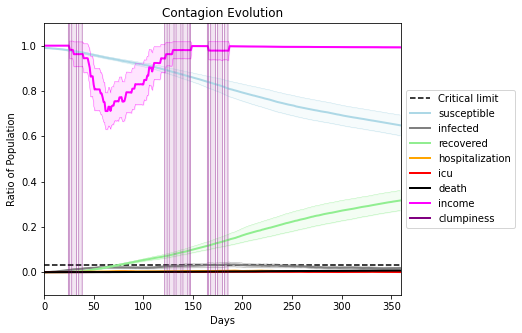

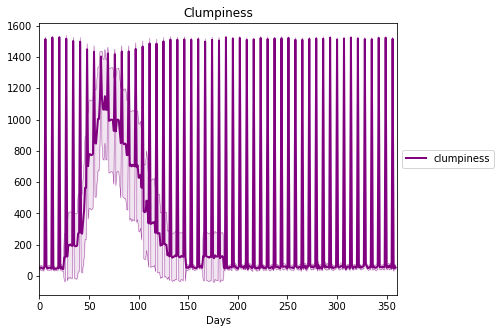

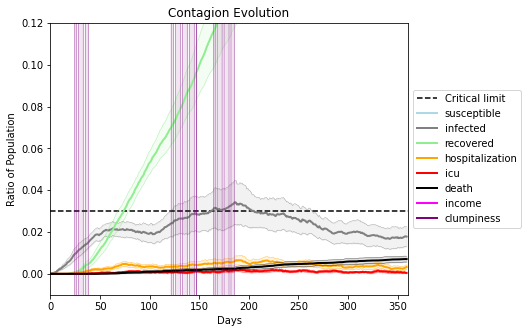

In [20]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.5
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2323, 758, 3336, 2897, 4327, 8026, 3479, 3335, 9268, 3172, 6227, 60, 3209, 3869, 8891, 5799, 4962, 6337, 1723, 7999]
Average similarity between family members is 0.22869516575243018 at temperature -0.4
Average similarity between family and home is 0.9998525140518717 at temperature -1
Average similarity between students and their classroom is 0.1682762938657514 at temperature -0.4
Average classroom occupancy is 1.6035502958579881 and number classrooms is 169
Average similarity between workers is 0.1501106566933729 at temperature -0.4
Average office occupancy is 3.3768844221105527 and number offices is 199
Average friend similarity for adults: 0.28596894230161507 for kids: 0.21754118657210428
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity 0.057962369406735985
avg restaurant similarity 0.17820903779085898
avg restaurant similarity 0.031585222091106174
avg restaurant similarity 0.15954975113579603
avg restaurant similarity -0.003072131217122043
avg restaurant similarity 0.09446898155104914
avg restaurant similarity 0.08668819900409434
avg restaurant similarity -0.11352262806286385
avg restaurant similarity 0.3364745247452888
avg restaurant similarity 0.06691102362709833
avg restaurant similarity -0.007785412907577472
avg restaurant similarity -0.00461927350197634
avg restaurant similarity 0.035247671326013946
avg restaurant similarity 0.20791565307533957
avg restaurant similarity 0.22897348107646462
avg restaurant similarity 0.15486429645398878
avg restaurant similarity 0.2546895151255684
avg restaurant similarity 0.2087215382046285
avg restaurant similarity -0.09977836870863069
avg restaurant similarity 0.038035762268611766
avg restaurant similarity 0.3865389958248473
avg restaurant similarity 0

avg restaurant similarity 0.21525977054153642
avg restaurant similarity 0.054910260305983075
avg restaurant similarity 0.06142183290690167
avg restaurant similarity 0.21659490881071838
avg restaurant similarity 0.15446529326911554
avg restaurant similarity 0.12392268471964842
avg restaurant similarity 0.16675999452011667
avg restaurant similarity 0.1505895420380085
avg restaurant similarity 0.06866018807972234
avg restaurant similarity 0.20636494437397673
avg restaurant similarity 0.27584814725417917
avg restaurant similarity 0.19115222720119998
avg restaurant similarity 0.24469681416781763
avg restaurant similarity 0.022170323322341822
avg restaurant similarity 0.15040630447859588
avg restaurant similarity 0.21367665430333357
avg restaurant similarity 0.10714354166645351
avg restaurant similarity 0.3013903199517163
avg restaurant similarity 0.011787953390550287
avg restaurant similarity 0.043927452844725406
avg restaurant similarity 0.1957226457648248
avg restaurant similarity 0.16780

Average similarity between family members is 0.21752603019932493 at temperature -0.4
Average similarity between family and home is 0.9998388948139355 at temperature -1
Average similarity between students and their classroom is 0.17889453164706612 at temperature -0.4
Average classroom occupancy is 1.6881720430107527 and number classrooms is 186
Average similarity between workers is 0.17377593847711445 at temperature -0.4
Average office occupancy is 3.2124352331606216 and number offices is 193
Average friend similarity for adults: 0.2717358199274104 for kids: 0.2077183829919712
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.1656502934771372
avg restaurant similarity 0.16159778514601675
avg restaurant similarity 0.06419328712944991
avg restaurant similarity 0.18689918318348334
avg restaurant similarity 0.23369511437187063
avg restaurant similarity 0.010341733023972781
avg restaurant similarity 0.1305105476181669
avg restaurant similarity 0.13612865528605064
avg restaurant similarity 0.01996910334096906
avg restaurant similarity 0.3652258150877961
avg restaurant similarity 0.2153410219601464
avg restaurant similarity 0.07696240229047029
avg restaurant similarity 0.08378971128251221
avg restaurant similarity -0.009690849911844813
avg restaurant similarity 0.06191191075249487
avg restaurant similarity 0.20459669002140948
avg restaurant similarity 0.045989065489464936
avg restaurant similarity 0.08291529068713535
avg restaurant similarity 0.0424356881807203
avg restaurant similarity 0.17835450617779228
avg restaurant similarity 0.3315502486703986
avg restaurant similarity 0.11927240

avg restaurant similarity 0.019649432198656017
avg restaurant similarity 0.27212629599048316
avg restaurant similarity 0.08941294494224351
avg restaurant similarity 0.1991275129612314
avg restaurant similarity -0.007320238342259058
avg restaurant similarity 0.17763055876312542
avg restaurant similarity 0.1912553852002214
avg restaurant similarity 0.13216691144305287
avg restaurant similarity 0.2458134773310896
avg restaurant similarity 0.07755297946786983
avg restaurant similarity 0.17847476494558226
avg restaurant similarity 0.16103233075302573
avg restaurant similarity 0.11661589881157312
avg restaurant similarity 0.2346059687922813
avg restaurant similarity 0.04749345529929624
avg restaurant similarity -0.010228600251119125
avg restaurant similarity 0.14673264220339183
avg restaurant similarity -0.14585792965895836
avg restaurant similarity 0.14927795053508022
avg restaurant similarity 0.1882635013494707
avg restaurant similarity 0.011810378505614505
avg restaurant similarity 0.1029

avg restaurant similarity -0.021131900213371642
avg restaurant similarity 0.08880994101886838
avg restaurant similarity 0.11430811615590133
Average similarity between family members is 0.2437450209270634 at temperature -0.4
Average similarity between family and home is 0.9998439348434478 at temperature -1
Average similarity between students and their classroom is 0.14104011136625175 at temperature -0.4
Average classroom occupancy is 1.6277777777777778 and number classrooms is 180
Average similarity between workers is 0.16565545536350357 at temperature -0.4
Average office occupancy is 3.2238805970149254 and number offices is 201
Average friend similarity for adults: 0.2794854312058291 for kids: 0.2070358507002414
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity -0.20610612382309101
avg restaurant similarity 0.10955612622947175
avg restaurant similarity 0.07956970875553358
avg restaurant similarity 0.24095056096067075
avg restaurant similarity 0.07358183741730481
avg restaurant similarity 0.0028040096560308044
avg restaurant similarity 0.14391803263609929
avg restaurant similarity -0.007189477278073793
avg restaurant similarity 0.0742676743082019
avg restaurant similarity 0.10231740896700162
avg restaurant similarity 0.17318216709506645
avg restaurant similarity 0.18881737538853927
avg restaurant similarity 0.08504413869899421
avg restaurant similarity 0.09196212792365067
avg restaurant similarity 0.11258335927855935
avg restaurant similarity 0.03492835485209954
avg restaurant similarity 0.048615401858284876
avg restaurant similarity 0.20183379972729962
avg restaurant similarity 0.027660963893887194
avg restaurant similarity 0.03112177387548962
avg restaurant similarity 0.06675095645595468
avg restaurant similarity -0

avg restaurant similarity -0.015223605240681967
avg restaurant similarity 0.09859664222596547
avg restaurant similarity 0.07225294885814294
avg restaurant similarity 0.0732043556463517
avg restaurant similarity 0.20668149837754285
avg restaurant similarity -0.033913542559038314
avg restaurant similarity 0.16468847547165588
avg restaurant similarity 0.0608589199147669
avg restaurant similarity 0.11331362894741655
avg restaurant similarity 0.3308782185093783
avg restaurant similarity -0.014099303646560564
avg restaurant similarity 0.10090801057436549
avg restaurant similarity 0.31674586991741904
avg restaurant similarity -0.05061298315721154
avg restaurant similarity -0.00963254073288132
avg restaurant similarity 0.11240697290097776
avg restaurant similarity -0.19815676924153236
avg restaurant similarity 0.3393318697107761
avg restaurant similarity 0.2796914886529799
avg restaurant similarity 0.0217909523458112
avg restaurant similarity 0.07282500813873648
avg restaurant similarity 0.026

avg restaurant similarity 0.13748622034787716
avg restaurant similarity -0.01175730894642778
avg restaurant similarity -0.018604122568256637
avg restaurant similarity 0.11656210849868838
avg restaurant similarity 0.2076345116868461
avg restaurant similarity 0.03844079271962009
avg restaurant similarity 0.20584744960077422
avg restaurant similarity -0.137599472536503
avg restaurant similarity 0.21071384279537916
avg restaurant similarity 0.030303725245314595
avg restaurant similarity 0.1667099187436638
avg restaurant similarity 0.06829808501088862
avg restaurant similarity -0.07083259051016039
avg restaurant similarity 0.08291268647560811
avg restaurant similarity 0.24191057916417988
avg restaurant similarity 0.09617330961507443
avg restaurant similarity -0.10780637925425668
avg restaurant similarity 0.15697560905825442
avg restaurant similarity -0.5714845861836029
avg restaurant similarity 0.1369865432926763
avg restaurant similarity 0.24892303293137644
avg restaurant similarity 0.1053

avg restaurant similarity 0.15640691915414281
avg restaurant similarity 0.2874964061688062
avg restaurant similarity 0.07864537105838489
avg restaurant similarity 0.1974165110837468
avg restaurant similarity 0.33365611235760706
avg restaurant similarity -0.315542249565937
avg restaurant similarity 0.09079702370765251
avg restaurant similarity -0.04808371315690978
avg restaurant similarity 0.07362447465828141
avg restaurant similarity 0.4000221998194459
avg restaurant similarity 0.2399948105387925
avg restaurant similarity -0.3748206001758552
avg restaurant similarity 0.07331724119716762
avg restaurant similarity 0.3278103718304501
avg restaurant similarity -0.18408633275609257
avg restaurant similarity 0.08093955179843201
avg restaurant similarity 0.1438856868496817
avg restaurant similarity -0.02858221997982638
avg restaurant similarity 0.1728604922085046
avg restaurant similarity -0.08506431889362372
avg restaurant similarity 0.10638452607041106
avg restaurant similarity 0.1026237641

Average similarity between family members is 0.2309325784899496 at temperature -0.4
Average similarity between family and home is 0.9998565245494921 at temperature -1
Average similarity between students and their classroom is 0.16757095965839938 at temperature -0.4
Average classroom occupancy is 1.6529411764705881 and number classrooms is 170
Average similarity between workers is 0.15912562638152816 at temperature -0.4
Average office occupancy is 3.2463054187192117 and number offices is 203
Average friend similarity for adults: 0.2805876871686528 for kids: 0.22217299959417586
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (

avg restaurant similarity 0.04864803445225637
avg restaurant similarity 0.04913584262685793
avg restaurant similarity 0.009711559273860568
avg restaurant similarity 0.11634378041078866
avg restaurant similarity 0.19220990902139345
avg restaurant similarity 0.0529346118871057
avg restaurant similarity 0.25802841249823844
avg restaurant similarity 0.0003681856094227924
avg restaurant similarity 0.30690945989596563
avg restaurant similarity 0.09002248138222643
avg restaurant similarity -0.1271379825051639
avg restaurant similarity 0.35837002525112144
avg restaurant similarity 0.17313821439052762
avg restaurant similarity 0.1350418229280659
avg restaurant similarity 0.17033520983368278
avg restaurant similarity 0.116245575757658
avg restaurant similarity 0.29050490405026597
avg restaurant similarity 0.25886387685754225
avg restaurant similarity -0.07540185024924174
avg restaurant similarity 0.09177342603750055
avg restaurant similarity -0.03256840504795425
avg restaurant similarity 0.22752

avg restaurant similarity 0.13279685484772888
avg restaurant similarity 0.10355473764875697
avg restaurant similarity 0.23666924373760417
avg restaurant similarity 0.1540078815226207
avg restaurant similarity 0.07671953337417992
avg restaurant similarity 0.2578276838011372
avg restaurant similarity 0.10512394251780993
avg restaurant similarity 0.01779298955857392
avg restaurant similarity 0.23884587772328986
avg restaurant similarity 0.08617983010860981
avg restaurant similarity 0.07924989737478766
avg restaurant similarity 0.25539243462223854
avg restaurant similarity 0.39985876732534026
avg restaurant similarity 0.11220079922560096
avg restaurant similarity 0.1659710153586918
avg restaurant similarity 0.3130169165134839
avg restaurant similarity -0.029361626188155677
avg restaurant similarity -0.10358511925989411
avg restaurant similarity -0.0024011026341884513
avg restaurant similarity 0.12478796204936
avg restaurant similarity 0.22372126329558303
avg restaurant similarity 0.2881945

avg restaurant similarity 0.10584461418281461
Average similarity between family members is 0.21007982103823572 at temperature -0.4
Average similarity between family and home is 0.9998482515777326 at temperature -1
Average similarity between students and their classroom is 0.1873307359240889 at temperature -0.4
Average classroom occupancy is 1.5307262569832403 and number classrooms is 179
Average similarity between workers is 0.14952429759140448 at temperature -0.4
Average office occupancy is 3.3819095477386933 and number offices is 199
Average friend similarity for adults: 0.2849211874923572 for kids: 0.20204078232925402
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 

avg restaurant similarity 0.012629779847434592
avg restaurant similarity 0.15938223642990457
avg restaurant similarity 0.06744289832182425
avg restaurant similarity 0.050662221619989206
avg restaurant similarity 0.16868985999753758
avg restaurant similarity -0.12518321852399153
avg restaurant similarity -0.08070749061549902
avg restaurant similarity 0.08403951693713459
avg restaurant similarity -0.12083816249427991
avg restaurant similarity 0.05152733819050186
avg restaurant similarity 0.1974430866292928
avg restaurant similarity 0.1423868008594139
avg restaurant similarity -0.06856151958058884
avg restaurant similarity 0.04341197301450964
avg restaurant similarity 0.04171686540888119
avg restaurant similarity 0.03473193616918046
avg restaurant similarity 0.3169481777520447
avg restaurant similarity 0.07181609938403391
avg restaurant similarity 0.34743671266142806
avg restaurant similarity 0.14295237021554497
avg restaurant similarity -0.07874537672368793
avg restaurant similarity -0.1

avg restaurant similarity 0.5533206245592996
avg restaurant similarity -0.02225916238066056
avg restaurant similarity 0.1973794777889705
avg restaurant similarity 0.12358107809403757
avg restaurant similarity 0.13955359706212436
avg restaurant similarity 0.24631373592929331
avg restaurant similarity 0.08306106801879377
avg restaurant similarity -0.001619936865626885
avg restaurant similarity -0.023645002214231447
avg restaurant similarity 0.1367619179153772
avg restaurant similarity 0.16068469568528437
avg restaurant similarity 0.015540744527068134
avg restaurant similarity 0.05958801207197615
avg restaurant similarity 0.15515554420647765
avg restaurant similarity 0.13851722026064076
avg restaurant similarity 0.06956125223683453
avg restaurant similarity -0.0385949857707168
avg restaurant similarity 0.08186673740001847
avg restaurant similarity -0.02884335221727859
avg restaurant similarity 0.15849367293162347
avg restaurant similarity 0.027897771296434757
avg restaurant similarity -0.

Average similarity between workers is 0.15154558981410687 at temperature -0.4
Average office occupancy is 3.1497584541062804 and number offices is 207
Average friend similarity for adults: 0.2851936834426411 for kids: 0.23472075064824113
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13

avg restaurant similarity -0.1544016646069792
avg restaurant similarity 0.07187812684695143
avg restaurant similarity 0.12350178509248182
avg restaurant similarity 0.11445232786869527
avg restaurant similarity 0.08091815144915111
avg restaurant similarity 0.13043592931896048
avg restaurant similarity 0.09030554739680408
avg restaurant similarity -0.032782879384015175
avg restaurant similarity 0.18273543203539877
avg restaurant similarity 0.10547939740086676
avg restaurant similarity 0.09864989312970654
avg restaurant similarity -0.11134573905396923
avg restaurant similarity 0.0980110434680808
avg restaurant similarity 0.19322307633488864
avg restaurant similarity 0.030707127214703946
avg restaurant similarity 0.05700056858438557
avg restaurant similarity 0.021482199327567758
avg restaurant similarity -0.01738984720423509
avg restaurant similarity -0.039713529185131574
avg restaurant similarity 0.0601236168076969
avg restaurant similarity 0.1595166369402719
avg restaurant similarity 0.2

avg restaurant similarity 0.11471985699303933
avg restaurant similarity 0.2659427428949259
avg restaurant similarity 0.2187532887191919
avg restaurant similarity 0.011763088211675135
avg restaurant similarity 0.09352304794745737
avg restaurant similarity 0.021942407810154017
avg restaurant similarity 0.19594105288406352
avg restaurant similarity 0.16323085719157981
avg restaurant similarity 0.016288282689079153
avg restaurant similarity -0.019546636251005677
avg restaurant similarity 0.30822107412219696
avg restaurant similarity 0.044274454139263404
avg restaurant similarity 0.025092949431409266
avg restaurant similarity 0.17020348785716735
avg restaurant similarity -0.08409580788038463
avg restaurant similarity 0.11171723897555752
avg restaurant similarity 0.1286637934262292
avg restaurant similarity 0.28340180284540145
avg restaurant similarity 0.2537097058682259
avg restaurant similarity 0.03167659712972388
avg restaurant similarity -0.058370748912200225
avg restaurant similarity 0.

avg restaurant similarity 0.034410188416298726
avg restaurant similarity -0.02888805865034801
avg restaurant similarity 0.31170292175833825
Average similarity between family members is 0.20946268490599929 at temperature -0.4
Average similarity between family and home is 0.9998598297503681 at temperature -1
Average similarity between students and their classroom is 0.14042976019115078 at temperature -0.4
Average classroom occupancy is 1.6184971098265897 and number classrooms is 173
Average similarity between workers is 0.15497754030926625 at temperature -0.4
Average office occupancy is 3.4153846153846152 and number offices is 195
Average friend similarity for adults: 0.2848597691469193 for kids: 0.2103082659520594
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.05655928802658295
avg restaurant similarity 0.17709354534847196
avg restaurant similarity 0.27269123002189277
avg restaurant similarity 0.15833598607092375
avg restaurant similarity -0.025936674752647843
avg restaurant similarity 0.2700571645817576
avg restaurant similarity 0.3181910327593157
avg restaurant similarity 0.19352350759066045
avg restaurant similarity 0.06945091767177683
avg restaurant similarity 0.20603449740757313
avg restaurant similarity -0.09096419093234566
avg restaurant similarity 0.04539252571211065
avg restaurant similarity 0.15963612630420204
avg restaurant similarity 0.06410528859779448
avg restaurant similarity 0.13510303069262874
avg restaurant similarity 0.06140805219526417
avg restaurant similarity 0.1231509448975974
avg restaurant similarity 0.1306819069011887
avg restaurant similarity 0.1376688669615805
avg restaurant similarity 0.399023267662415
avg restaurant similarity 0.1096931201610097
avg restaurant similarity 0.26782084433

avg restaurant similarity 0.15499219534929065
avg restaurant similarity 0.30819904462991116
avg restaurant similarity 0.012514480870702057
avg restaurant similarity 0.14179844228413802
avg restaurant similarity 0.04251431770333522
avg restaurant similarity 0.26712662915025365
avg restaurant similarity -0.011164714409128626
avg restaurant similarity 0.09028173436818174
avg restaurant similarity 0.15966356295407932
avg restaurant similarity 0.05636508329898059
avg restaurant similarity 0.20654297931978108
avg restaurant similarity 0.1653475592442164
avg restaurant similarity 0.29869471580223905
avg restaurant similarity 0.06185171872074999
avg restaurant similarity -0.08920261393386164
avg restaurant similarity 0.4760349698839364
avg restaurant similarity 0.15238354971637755
avg restaurant similarity 0.15192284692303576
avg restaurant similarity 0.07055706023414211
avg restaurant similarity 0.02189982810757451
avg restaurant similarity 0.19306174616331664
avg restaurant similarity 0.1238

Average similarity between family and home is 0.9998580520791863 at temperature -1
Average similarity between students and their classroom is 0.1799547484925262 at temperature -0.4
Average classroom occupancy is 1.6432432432432433 and number classrooms is 185
Average similarity between workers is 0.13064629191893373 at temperature -0.4
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.2783017041905323 for kids: 0.21306253755289467
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 all

avg restaurant similarity 0.06507692889778945
avg restaurant similarity -0.025790525346216064
avg restaurant similarity 0.1080064515837577
avg restaurant similarity 0.24963313853038793
avg restaurant similarity 0.17369163764817017
avg restaurant similarity 0.18170912079223356
avg restaurant similarity 0.2231864782592555
avg restaurant similarity 0.04813373194176274
avg restaurant similarity 0.16080058882248696
avg restaurant similarity 0.29885886964193725
avg restaurant similarity 0.11521856798167852
avg restaurant similarity 0.1816955467798359
avg restaurant similarity 0.23461998703168152
avg restaurant similarity 0.0941043198750542
avg restaurant similarity 0.22479530533137404
avg restaurant similarity -0.18220543019722485
avg restaurant similarity 0.3074121640711397
avg restaurant similarity 0.2284416052957864
avg restaurant similarity 0.05794221997224242
avg restaurant similarity 0.0650831342745327
avg restaurant similarity 0.22571576334840984
avg restaurant similarity 0.5115262013

avg restaurant similarity 0.2726885733075254
avg restaurant similarity 0.039138835279721396
avg restaurant similarity 0.11653034930518871
avg restaurant similarity 0.15313179399485438
avg restaurant similarity -0.09625731787431507
avg restaurant similarity 0.09733441983723157
avg restaurant similarity -0.12439444170798346
avg restaurant similarity 0.10268887378584672
avg restaurant similarity 0.11386986746514656
avg restaurant similarity 0.24289704286511343
avg restaurant similarity 0.2357704252590717
avg restaurant similarity 0.07950325014509509
avg restaurant similarity 0.4126742201572573
avg restaurant similarity 0.031918733292889905
avg restaurant similarity 0.002647258700604659
avg restaurant similarity 0.055728654337373826
avg restaurant similarity 0.08973892004514727
avg restaurant similarity 0.23971981374421134
avg restaurant similarity 0.3196254052312024
avg restaurant similarity 0.12692360163585437
avg restaurant similarity 0.26239231576142313
avg restaurant similarity 0.2749

avg restaurant similarity -0.09109879876243668
Average similarity between family members is 0.21917428692663748 at temperature -0.4
Average similarity between family and home is 0.9998542530716916 at temperature -1
Average similarity between students and their classroom is 0.18620848014758687 at temperature -0.4
Average classroom occupancy is 1.4972375690607735 and number classrooms is 181
Average similarity between workers is 0.1740170964345277 at temperature -0.4
Average office occupancy is 3.3596059113300494 and number offices is 203
Average friend similarity for adults: 0.2891700216215487 for kids: 0.2191743786838073
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 pe

avg restaurant similarity 0.10680709923677116
avg restaurant similarity 0.04841758546490969
avg restaurant similarity -0.06759733047639933
avg restaurant similarity 0.2709267670095836
avg restaurant similarity 0.2594738478771683
avg restaurant similarity 0.21262931005836597
avg restaurant similarity 0.13501097562794354
avg restaurant similarity -0.007342168896274225
avg restaurant similarity -0.0029509099169206876
avg restaurant similarity 0.07396283178832862
avg restaurant similarity 0.22848225000142539
avg restaurant similarity 0.19462635312205165
avg restaurant similarity 0.12489780352219008
avg restaurant similarity -0.1757590258738041
avg restaurant similarity 0.06595830669446913
avg restaurant similarity 0.025162907175880718
avg restaurant similarity 0.22850411536876605
avg restaurant similarity 0.1922163937308476
avg restaurant similarity 0.13792007744663343
avg restaurant similarity 0.1335215827096559
avg restaurant similarity 0.10163837362623944
avg restaurant similarity 0.096

avg restaurant similarity 0.01411742687391491
avg restaurant similarity 0.41743285461499163
avg restaurant similarity 0.11249758893642246
avg restaurant similarity 0.07168492674590767
avg restaurant similarity -0.04909335875568369
avg restaurant similarity 0.11541602395340055
avg restaurant similarity 0.22408698469029006
avg restaurant similarity 0.013978559087082178
avg restaurant similarity 0.3959348143500265
avg restaurant similarity 0.05792307835787891
avg restaurant similarity 0.011150551803247576
avg restaurant similarity 0.1670764653931318
avg restaurant similarity 0.12970943677008306
avg restaurant similarity 0.347855183131194
avg restaurant similarity -0.09897094548483903
avg restaurant similarity -0.06930779527615563
avg restaurant similarity -0.1314918648621849
avg restaurant similarity -0.016818218162910632
avg restaurant similarity -0.017220377188067362
avg restaurant similarity 0.3962434681717787
avg restaurant similarity 0.056032577744965756
avg restaurant similarity 0.0

Average similarity between family and home is 0.9998473063750748 at temperature -1
Average similarity between students and their classroom is 0.1664764614556746 at temperature -0.4
Average classroom occupancy is 1.664804469273743 and number classrooms is 179
Average similarity between workers is 0.15958212116681292 at temperature -0.4
Average office occupancy is 3.212871287128713 and number offices is 202
Average friend similarity for adults: 0.2807903662099345 for kids: 0.21345349803043295
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity -0.05892105994764747
avg restaurant similarity 0.019530253076816797
avg restaurant similarity 0.21474532747203043
avg restaurant similarity 0.0904087872187697
avg restaurant similarity 0.28223415345200603
avg restaurant similarity 0.04541290331590092
avg restaurant similarity 0.04264743167737018
avg restaurant similarity 0.09978290244687822
avg restaurant similarity -0.1270348245733929
avg restaurant similarity -0.07298662011862883
avg restaurant similarity 0.005352288060843803
avg restaurant similarity 0.2324235623769935
avg restaurant similarity -0.0013160366886445646
avg restaurant similarity -0.07578121170759794
avg restaurant similarity -0.12381658329483003
avg restaurant similarity 0.08013950989439371
avg restaurant similarity 0.06672679960987128
avg restaurant similarity 0.16853456095093408
avg restaurant similarity 0.3208754096872057
avg restaurant similarity 0.04218503091200228
avg restaurant similarity -0.10497474425871174
avg restaurant similarity -

avg restaurant similarity 0.04570108148794963
avg restaurant similarity 0.20453557711017833
avg restaurant similarity 0.30984419396792356
avg restaurant similarity -0.1445969909905441
avg restaurant similarity -0.026408891873879743
avg restaurant similarity -0.04330806402148388
avg restaurant similarity -0.2676304631737721
avg restaurant similarity -0.06001624947020724
avg restaurant similarity 0.11330989466608324
avg restaurant similarity -0.09215208405980797
avg restaurant similarity 0.25250979113817124
avg restaurant similarity 0.46235400250168535
avg restaurant similarity 0.20461376900963893
avg restaurant similarity 0.07962567745754431
avg restaurant similarity 0.14706995999413638
avg restaurant similarity -0.11461115430693423
avg restaurant similarity 0.013199326822839632
avg restaurant similarity 0.2291142067478697
avg restaurant similarity 0.16817223107671286
avg restaurant similarity 0.0876372125042676
avg restaurant similarity -0.035541116028763996
avg restaurant similarity 0

avg restaurant similarity 0.0016122075867390673
Average similarity between family members is 0.21112993629241017 at temperature -0.4
Average similarity between family and home is 0.9998488720672825 at temperature -1
Average similarity between students and their classroom is 0.1471074143993218 at temperature -0.4
Average classroom occupancy is 1.6193181818181819 and number classrooms is 176
Average similarity between workers is 0.15458709605257293 at temperature -0.4
Average office occupancy is 3.242574257425743 and number offices is 202
Average friend similarity for adults: 0.28402403601534243 for kids: 0.21540185612142562
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 

avg restaurant similarity 0.0694188597757694
avg restaurant similarity -0.04219171251592736
avg restaurant similarity 0.33331852043027715
avg restaurant similarity 0.012755638406581326
avg restaurant similarity -0.061375283761292046
avg restaurant similarity 0.0251397002152044
avg restaurant similarity -0.004883441074346711
avg restaurant similarity -0.07530150330791631
avg restaurant similarity 0.06183785851798999
avg restaurant similarity 0.001088919957676341
avg restaurant similarity 0.06495573053142266
avg restaurant similarity 0.06830974166772222
avg restaurant similarity 0.11870242464942389
avg restaurant similarity 0.10006765860935876
avg restaurant similarity -0.011692579290312555
avg restaurant similarity -0.020082019852123257
avg restaurant similarity 0.10512722089427586
avg restaurant similarity 0.00954465994459324
avg restaurant similarity 0.21826406784139485
avg restaurant similarity -0.004942852309611402
avg restaurant similarity 0.0788851025023486
avg restaurant similari

avg restaurant similarity 0.2879692872806628
avg restaurant similarity 0.1291147445872513
avg restaurant similarity 0.044406271171682325
avg restaurant similarity -0.02085873074554656
avg restaurant similarity 0.021265912485967743
avg restaurant similarity 0.11396906372751049
avg restaurant similarity 0.09811352098746154
avg restaurant similarity 0.023162751756437866
avg restaurant similarity 0.11962010431677367
avg restaurant similarity 0.17335250708578306
avg restaurant similarity 0.0909698156082773
avg restaurant similarity 0.2264441283997721
avg restaurant similarity 0.18776171980280093
avg restaurant similarity 0.05997259634000794
avg restaurant similarity 0.25873981484996955
avg restaurant similarity 0.06008427018507958
avg restaurant similarity 0.13110489341417725
avg restaurant similarity 0.05347446058348574
avg restaurant similarity -0.06410037482195151
avg restaurant similarity 0.10596703891170037
avg restaurant similarity 0.00034749971064755233
avg restaurant similarity 0.13

avg restaurant similarity 0.14595371092450304
avg restaurant similarity 0.08205025699802997
avg restaurant similarity -0.2747346153254691
avg restaurant similarity 0.03716099685889776
avg restaurant similarity -0.08321401584934067
Average similarity between family members is 0.21592368745958665 at temperature -0.4
Average similarity between family and home is 0.9998561200951479 at temperature -1
Average similarity between students and their classroom is 0.17998455008809278 at temperature -0.4
Average classroom occupancy is 1.4944444444444445 and number classrooms is 180
Average similarity between workers is 0.14908885676309802 at temperature -0.4
Average office occupancy is 3.34 and number offices is 200
Average friend similarity for adults: 0.2894824025805182 for kids: 0.22705408262100377
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in thi

avg restaurant similarity -0.05237352487910504
avg restaurant similarity -0.012163345940328418
avg restaurant similarity 0.25907618047992625
avg restaurant similarity 0.07967586714339597
avg restaurant similarity 0.1546141291408062
avg restaurant similarity -0.1463293629090584
avg restaurant similarity -0.07467672742481882
avg restaurant similarity 0.1095237941560066
avg restaurant similarity -0.003790840432611492
avg restaurant similarity -0.19761503551445483
avg restaurant similarity 0.16114072483274708
avg restaurant similarity 0.12763566172449212
avg restaurant similarity 0.2434992567008841
avg restaurant similarity 0.0801976575231704
avg restaurant similarity 0.12265584547395986
avg restaurant similarity 0.16216579515887608
avg restaurant similarity 0.10562133443686464
avg restaurant similarity 0.09561522789399331
avg restaurant similarity 0.04083959896576861
avg restaurant similarity 0.027588614426927543
avg restaurant similarity 0.07083902660936524
avg restaurant similarity 0.04

avg restaurant similarity -0.21723159893336594
avg restaurant similarity 0.4927217373170565
avg restaurant similarity 0.15419845616988256
avg restaurant similarity 0.2811539298130283
avg restaurant similarity 0.1629802758131064
avg restaurant similarity 0.25853372527423274
avg restaurant similarity -0.017505799541131347
avg restaurant similarity 0.007399381218653314
avg restaurant similarity 0.3015867027740807
avg restaurant similarity 0.2030682273772286
avg restaurant similarity 0.1412313926503745
avg restaurant similarity 0.13661271080751117
avg restaurant similarity 0.4091960475052224
avg restaurant similarity 0.44697224812587316
avg restaurant similarity -0.08475820182464838
avg restaurant similarity 0.1737529961480286
avg restaurant similarity -0.045777019073431874
avg restaurant similarity -0.00621952972252135
avg restaurant similarity 0.011408570160887276
avg restaurant similarity 0.23190871393846366
avg restaurant similarity 0.2439167835615297
avg restaurant similarity 0.134204

avg restaurant similarity 0.040816584425665256
avg restaurant similarity 0.1980336044758606
avg restaurant similarity 0.25967520220198426
avg restaurant similarity -0.12890607808855473
avg restaurant similarity 0.020204935082865052
avg restaurant similarity 0.15930745097477844
avg restaurant similarity 0.2576512024386527
avg restaurant similarity 0.07243538190230014
avg restaurant similarity 0.18603037810348957
avg restaurant similarity 0.31067894658133854
avg restaurant similarity 0.2195141744484892
avg restaurant similarity 0.1745842187352233
avg restaurant similarity 0.26732088487290545
avg restaurant similarity 0.19446158657366294
avg restaurant similarity 0.03826523954766004
avg restaurant similarity 0.20561427392540615
avg restaurant similarity 0.2993400030094383
avg restaurant similarity 0.22579449454371234
avg restaurant similarity -0.21513227899761617
avg restaurant similarity 0.138831199899338
avg restaurant similarity 0.168095567123224
avg restaurant similarity -0.0538574548

avg restaurant similarity 0.02312985174093005
avg restaurant similarity 0.17956121810595566
avg restaurant similarity 0.03221559426669052
avg restaurant similarity 0.1903566439493419
avg restaurant similarity 0.35613147166150017
avg restaurant similarity 0.11756877533595013
avg restaurant similarity -0.006321565439497639
avg restaurant similarity -0.06742949024805348
avg restaurant similarity 0.3270752208916114
avg restaurant similarity 0.11310701013936085
avg restaurant similarity 0.20851006060731944
avg restaurant similarity 0.2198493527126154
avg restaurant similarity 0.3387437711664466
avg restaurant similarity 0.0741750268700692
avg restaurant similarity 0.3093572518405179
avg restaurant similarity 0.08680826169335637
avg restaurant similarity -0.16660440117891007
avg restaurant similarity 0.1332152405543445
avg restaurant similarity 0.27185595118733513
avg restaurant similarity 0.07909574683616283
avg restaurant similarity 0.13281558238338062
avg restaurant similarity 0.213848719

avg restaurant similarity -0.020106148396483656
Average similarity between family members is 0.20077112374987768 at temperature -0.4
Average similarity between family and home is 0.9998597704201787 at temperature -1
Average similarity between students and their classroom is 0.13700465503390244 at temperature -0.4
Average classroom occupancy is 1.56 and number classrooms is 200
Average similarity between workers is 0.14855248800227877 at temperature -0.4
Average office occupancy is 3.156862745098039 and number offices is 204
Average friend similarity for adults: 0.272731533607378 for kids: 0.2096717503730499
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocat

avg restaurant similarity 0.28464301348511817
avg restaurant similarity 0.04999752808009166
avg restaurant similarity 0.21205608350660568
avg restaurant similarity 0.19361999463742538
avg restaurant similarity 0.00541664178118046
avg restaurant similarity 0.1936547720174062
avg restaurant similarity 0.11568253159450652
avg restaurant similarity 0.059960306895501914
avg restaurant similarity 0.2236348231111062
avg restaurant similarity 0.12082597524818502
avg restaurant similarity 0.09564115017460614
avg restaurant similarity 0.48821039691476736
avg restaurant similarity 0.09551539838902187
avg restaurant similarity 0.21685184412907607
avg restaurant similarity 0.20195922264266364
avg restaurant similarity 0.20391451014860734
avg restaurant similarity 0.1917087353232349
avg restaurant similarity 0.3672019273035909
avg restaurant similarity 0.08512132055670209
avg restaurant similarity 0.24613308369825154
avg restaurant similarity 0.24997742616992658
avg restaurant similarity -0.04964001

avg restaurant similarity 0.1353906601467221
avg restaurant similarity 0.021066117925921696
avg restaurant similarity 0.21928011384292906
avg restaurant similarity 0.25068112411966753
avg restaurant similarity 0.12153365571928854
avg restaurant similarity 0.23333302801504882
avg restaurant similarity 0.14381265281310196
avg restaurant similarity 0.1687412667494154
avg restaurant similarity 0.12902568676110468
avg restaurant similarity 0.019687602437537238
avg restaurant similarity 0.3035499132214251
avg restaurant similarity -0.3740459617501165
avg restaurant similarity 0.137924678135685
avg restaurant similarity -0.02867735606498001
avg restaurant similarity 0.007675169627240579
avg restaurant similarity 0.14541236395366003
avg restaurant similarity -0.12569567771317902
avg restaurant similarity -0.003230420580144907
avg restaurant similarity -0.020606574774037517
avg restaurant similarity 0.3759931263150293
avg restaurant similarity 0.3142843035148859
avg restaurant similarity -0.011

Average similarity between family and home is 0.9998605019908143 at temperature -1
Average similarity between students and their classroom is 0.19021777270727952 at temperature -0.4
Average classroom occupancy is 1.543956043956044 and number classrooms is 182
Average similarity between workers is 0.15556603373726424 at temperature -0.4
Average office occupancy is 3.3 and number offices is 200
Average friend similarity for adults: 0.2907742868899566 for kids: 0.233293059648521
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allo

avg restaurant similarity 0.33045708613872116
avg restaurant similarity 0.0679035832824288
avg restaurant similarity 0.12730388437679718
avg restaurant similarity 0.04222531736842193
avg restaurant similarity 0.11464262496645616
avg restaurant similarity 0.024488214653806892
avg restaurant similarity 0.17477423866837558
avg restaurant similarity 0.04705433892802504
avg restaurant similarity 0.006871677381662082
avg restaurant similarity 0.37511086609405353
avg restaurant similarity 0.1110890937067921
avg restaurant similarity 0.07028335002711825
avg restaurant similarity 0.12918081505889842
avg restaurant similarity 0.07289586664009551
avg restaurant similarity 0.11203422228664761
avg restaurant similarity 0.10599414231779665
avg restaurant similarity 0.06420206150477897
avg restaurant similarity 0.13691966272037182
avg restaurant similarity 0.22583947042441557
avg restaurant similarity 0.05937811392667175
avg restaurant similarity 0.22133808524407494
avg restaurant similarity 0.050368

avg restaurant similarity 0.0999695955181686
avg restaurant similarity 0.23153369246315128
avg restaurant similarity 0.17217834190655518
avg restaurant similarity 0.07640214256907858
avg restaurant similarity 0.23676550756556186
avg restaurant similarity 0.3331790516169763
avg restaurant similarity 0.03841182995543518
avg restaurant similarity 0.03315126205499113
avg restaurant similarity 0.09659374806906178
avg restaurant similarity 0.09470161174278516
avg restaurant similarity 0.18051306971065953
avg restaurant similarity 0.28597211921787
avg restaurant similarity 0.0752462222973609
avg restaurant similarity 0.3225972766525051
avg restaurant similarity 0.17943389720719302
avg restaurant similarity 0.18976847764359167
avg restaurant similarity 0.1705531873053422
avg restaurant similarity -0.007586233784294046
avg restaurant similarity 0.11350566022156104
avg restaurant similarity 0.033899018810392534
avg restaurant similarity 0.06983892703188758
avg restaurant similarity 0.08974783668

avg restaurant similarity -0.058509850684835336
avg restaurant similarity -0.03809690972112883
avg restaurant similarity 0.10394879167524991
Average similarity between family members is 0.21228405694091007 at temperature -0.4
Average similarity between family and home is 0.9998550844427028 at temperature -1
Average similarity between students and their classroom is 0.1366260506873194 at temperature -0.4
Average classroom occupancy is 1.540983606557377 and number classrooms is 183
Average similarity between workers is 0.15226860011410842 at temperature -0.4
Average office occupancy is 3.431472081218274 and number offices is 197
Average friend similarity for adults: 0.28597220877131035 for kids: 0.21395240998384338
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 unit

avg restaurant similarity 0.180187173288219
avg restaurant similarity 0.1470854627355312
avg restaurant similarity 0.15211058813868908
avg restaurant similarity -0.0009641587805431876
avg restaurant similarity 0.21591653937742863
avg restaurant similarity 0.06937588538807682
avg restaurant similarity 0.11269268046072253
avg restaurant similarity 0.10092305693665625
avg restaurant similarity -0.04416485222981164
avg restaurant similarity 0.02283533913317218
avg restaurant similarity -0.14888591750718194
avg restaurant similarity 0.2172342922655546
avg restaurant similarity 0.012939576373180403
avg restaurant similarity 0.023929170273323874
avg restaurant similarity 0.19402352082323446
avg restaurant similarity -0.4024876191876398
avg restaurant similarity -0.1813022684460285
avg restaurant similarity 0.44837321466983165
avg restaurant similarity 0.16029501790328438
avg restaurant similarity 0.034741351647835365
avg restaurant similarity -0.016208487215025207
avg restaurant similarity 0.

avg restaurant similarity -0.11573109124520957
avg restaurant similarity 0.06719034084537728
avg restaurant similarity -0.03128518511791736
avg restaurant similarity 0.16113411315446607
avg restaurant similarity 0.04996183739887708
avg restaurant similarity -0.1284892283865852
avg restaurant similarity -0.0036159916921623065
avg restaurant similarity 0.15357473162799795
avg restaurant similarity 0.15207463984595726
avg restaurant similarity 0.10026779697770109
avg restaurant similarity -0.04911042464658843
avg restaurant similarity 0.09044007418953993
avg restaurant similarity 0.09949199253962379
avg restaurant similarity 0.08964590439164274
avg restaurant similarity 0.22272298433260138
avg restaurant similarity -0.0498588068317972
avg restaurant similarity 0.017852590160985584
avg restaurant similarity 0.11036521999051907
avg restaurant similarity 0.1443072438383743
avg restaurant similarity -0.07649142875933432
avg restaurant similarity 0.03963841195289428
avg restaurant similarity 0

Average similarity between family members is 0.21960698776731533 at temperature -0.4
Average similarity between family and home is 0.9998518890761816 at temperature -1
Average similarity between students and their classroom is 0.16218673679552817 at temperature -0.4
Average classroom occupancy is 1.5945945945945945 and number classrooms is 185
Average similarity between workers is 0.18769860848511521 at temperature -0.4
Average office occupancy is 3.1970443349753697 and number offices is 203
Average friend similarity for adults: 0.2821230449887146 for kids: 0.2072910180831642
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.18277917122106532
avg restaurant similarity 0.06916908677422104
avg restaurant similarity 0.17483909400941988
avg restaurant similarity -0.0003818674173177254
avg restaurant similarity -0.05616081148556969
avg restaurant similarity -0.0014950242675422648
avg restaurant similarity 0.15798765523521233
avg restaurant similarity 0.11605277614733128
avg restaurant similarity 0.4342554153638535
avg restaurant similarity -0.1663778619209541
avg restaurant similarity 0.02069485986822083
avg restaurant similarity 0.042550141353450206
avg restaurant similarity 0.3118847107794287
avg restaurant similarity 0.048886330062890476
avg restaurant similarity 0.04492204703700174
avg restaurant similarity 0.1294536113534075
avg restaurant similarity 0.18332752387943918
avg restaurant similarity 0.013648829017577895
avg restaurant similarity 0.10123203519233313
avg restaurant similarity 0.0442425191083437
avg restaurant similarity 0.09977258729412106
avg restaurant similarity 0.

avg restaurant similarity 0.12090685537192067
avg restaurant similarity 0.058407240574391436
avg restaurant similarity 0.2970821964539245
avg restaurant similarity 0.4839771535961483
avg restaurant similarity 0.15685238645324498
avg restaurant similarity 0.16280739176933512
avg restaurant similarity 0.332964381899628
avg restaurant similarity 0.11096620617943001
avg restaurant similarity 0.06774516306905604
avg restaurant similarity 0.1006193396592148
avg restaurant similarity 0.1040517809685622
avg restaurant similarity 0.006799457618079739
avg restaurant similarity 0.14983551660381547
avg restaurant similarity 0.18279070059203567
avg restaurant similarity 0.0598761399580074
avg restaurant similarity 0.20454102587265552
avg restaurant similarity -0.16110078854475396
avg restaurant similarity 0.12904298892807423
avg restaurant similarity 0.032922346779736426
avg restaurant similarity -0.02116070954439169
avg restaurant similarity 0.014451624601029297
avg restaurant similarity 0.2350701

Average similarity between students and their classroom is 0.19324822966853342 at temperature -0.4
Average classroom occupancy is 1.6284153005464481 and number classrooms is 183
Average similarity between workers is 0.16819435913488953 at temperature -0.4
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.2781150843185625 for kids: 0.22446357710223874
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 16 people.
Total of 16 people allocated

avg restaurant similarity 0.1356277717267566
avg restaurant similarity 0.06396360700849167
avg restaurant similarity 0.15863063808684733
avg restaurant similarity 0.1636499068479309
avg restaurant similarity 0.11551742658670744
avg restaurant similarity 0.20402507959422825
avg restaurant similarity 0.10215873479757992
avg restaurant similarity 0.007454518541191424
avg restaurant similarity 0.06563965604836162
avg restaurant similarity -0.022243732833901343
avg restaurant similarity 0.22621760616786593
avg restaurant similarity 0.11663846705528955
avg restaurant similarity 0.21051357041680235
avg restaurant similarity 0.17907637284751055
avg restaurant similarity 0.22686353043228633
avg restaurant similarity -0.021071512296619327
avg restaurant similarity 0.038659793511629646
avg restaurant similarity 0.09905545213400568
avg restaurant similarity 0.062251954486469946
avg restaurant similarity 0.1344139570217312
avg restaurant similarity 0.17477625503803718
avg restaurant similarity -0.2

avg restaurant similarity 0.37418247101630586
avg restaurant similarity 0.11669591622444435
avg restaurant similarity 0.10508249065124708
avg restaurant similarity 0.19795859206557595
avg restaurant similarity 0.16613169241551531
avg restaurant similarity 0.46190510960737957
avg restaurant similarity 0.017885317883571818
avg restaurant similarity 0.2640479178089944
avg restaurant similarity 0.33181509858812697
avg restaurant similarity 0.16218503637016027
avg restaurant similarity 0.08230693689733874
avg restaurant similarity 0.26658920908885525
avg restaurant similarity 0.057297954077396525
avg restaurant similarity 0.29442270027987333
avg restaurant similarity 0.010382176483807043
avg restaurant similarity 0.3418029000151488
avg restaurant similarity 0.047914425988037405
avg restaurant similarity 0.2868424367064398
avg restaurant similarity 0.25297999078764893
avg restaurant similarity 0.16749755221965923
avg restaurant similarity 0.13718742849273355
avg restaurant similarity 0.31857

avg restaurant similarity -0.008533589799579503
Average similarity between family members is 0.20315451998353018 at temperature -0.4
Average similarity between family and home is 0.999860078819776 at temperature -1
Average similarity between students and their classroom is 0.17281171702473927 at temperature -0.4
Average classroom occupancy is 1.6464088397790055 and number classrooms is 181
Average similarity between workers is 0.14702042343869487 at temperature -0.4
Average office occupancy is 3.321608040201005 and number offices is 199
Average friend similarity for adults: 0.2790343218767007 for kids: 0.19933082415121434
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.38466583576796043
avg restaurant similarity 0.06869972000279424
avg restaurant similarity 0.047238842277237736
avg restaurant similarity 0.2784616431357234
avg restaurant similarity 0.33755610024962485
avg restaurant similarity -0.07171539182926284
avg restaurant similarity -0.03419422266724809
avg restaurant similarity 0.0948384920879258
avg restaurant similarity 0.2532722524114901
avg restaurant similarity -0.04519533054476238
avg restaurant similarity 0.3573142681288291
avg restaurant similarity 0.2856778171431309
avg restaurant similarity 0.34166220925649593
avg restaurant similarity 0.1276125931278621
avg restaurant similarity 0.037541124487598346
avg restaurant similarity 0.05140370812874228
avg restaurant similarity 0.351124639441467
avg restaurant similarity 0.23517306035759353
avg restaurant similarity 0.17474856592374063
avg restaurant similarity 0.01944047905509866
avg restaurant similarity 0.3476401461041061
avg restaurant similarity 0.0761317855

avg restaurant similarity 0.3583246772140295
avg restaurant similarity 0.21946078533314944
avg restaurant similarity 0.07826569265511439
avg restaurant similarity 0.16563068773857495
avg restaurant similarity 0.20480371958574975
avg restaurant similarity 0.20968866855299007
avg restaurant similarity 0.10926105448337646
avg restaurant similarity 0.32602910077000125
avg restaurant similarity -0.023235945271042342
avg restaurant similarity 0.20871032906108966
avg restaurant similarity 0.20901687649384595
avg restaurant similarity 0.5004520087055291
avg restaurant similarity 0.2772578886703586
avg restaurant similarity 0.458943643034513
avg restaurant similarity 0.4074182959691401
avg restaurant similarity -0.06825224194226023
avg restaurant similarity -0.025866232807682566
avg restaurant similarity -0.09059322792853872
avg restaurant similarity -0.09124737611514755
avg restaurant similarity 0.1894611993140695
avg restaurant similarity 0.15200348507896286
avg restaurant similarity 0.188621

(<function dict.items>, <function dict.items>, <function dict.items>)

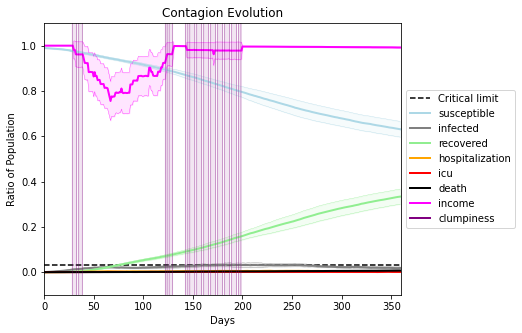

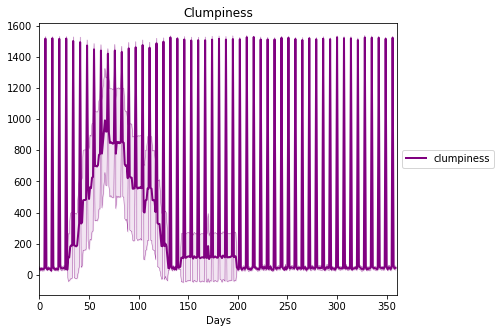

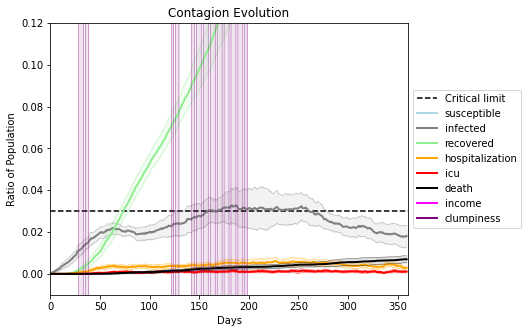

In [21]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.4
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[3985, 8496, 9808, 5451, 5901, 8640, 1247, 5687, 424, 1839, 8862, 5986, 8051, 9676, 2397, 6250, 3496, 8323, 5615, 6246]
Average similarity between family members is 0.2143933211123716 at temperature -0.3
Average similarity between family and home is 0.9998652695603643 at temperature -1
Average similarity between students and their classroom is 0.15234421950691754 at temperature -0.3
Average classroom occupancy is 1.5804597701149425 and number classrooms is 174
Average similarity between workers is 0.13865142289230245 at temperature -0.3
Average office occupancy is 3.3 and number offices is 200
Average friend similarity for adults: 0.2478485066584594 for kids: 0.21247346416693563
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.11012790165919786
avg restaurant similarity 0.06842791865492465
avg restaurant similarity 0.2275889423584591
avg restaurant similarity -0.044666974165574684
avg restaurant similarity -0.086681438818876
avg restaurant similarity 0.07167133842789677
avg restaurant similarity 0.12438053591482871
avg restaurant similarity -0.10909160559726738
avg restaurant similarity 0.37883144585921225
avg restaurant similarity 0.11017163970800194
avg restaurant similarity 0.06473681712515504
avg restaurant similarity 0.013125551284247352
avg restaurant similarity -0.022871472880157603
avg restaurant similarity 0.15395094488068145
avg restaurant similarity 0.19400404157438694
avg restaurant similarity 0.21836107063546425
avg restaurant similarity 0.07281798871710722
avg restaurant similarity 0.05231334886029341
avg restaurant similarity -0.020767812704820636
avg restaurant similarity 0.03689615351832018
avg restaurant similarity -0.3745007313173432
avg restaurant similarity -0

avg restaurant similarity -0.12209067968175187
avg restaurant similarity 0.23362159140801508
avg restaurant similarity 0.15935754402196836
avg restaurant similarity 0.094255605618972
avg restaurant similarity 0.19617988385804092
avg restaurant similarity -0.00324019850651118
avg restaurant similarity 0.1609093975765896
avg restaurant similarity 0.044490163199674214
avg restaurant similarity 0.07094212939120355
avg restaurant similarity 0.10583937658986929
avg restaurant similarity 0.303504027033433
avg restaurant similarity 0.1848661983684033
avg restaurant similarity -0.04242912352614191
avg restaurant similarity 0.026779892885454376
avg restaurant similarity -0.09709726599341838
avg restaurant similarity 0.1452174791222649
avg restaurant similarity 0.03994012310441621
avg restaurant similarity 0.20172456945147846
avg restaurant similarity -0.064485637152004
avg restaurant similarity 0.06554009290850188
avg restaurant similarity 0.22759619789697533
avg restaurant similarity 0.00359234

avg restaurant similarity 0.16782114537247242
avg restaurant similarity -0.024943402781846716
Average similarity between family members is 0.2147931075106291 at temperature -0.3
Average similarity between family and home is 0.9998513366227723 at temperature -1
Average similarity between students and their classroom is 0.187763692479997 at temperature -0.3
Average classroom occupancy is 1.5384615384615385 and number classrooms is 182
Average similarity between workers is 0.1480450526299112 at temperature -0.3
Average office occupancy is 3.1951219512195124 and number offices is 205
Average friend similarity for adults: 0.24285501387990335 for kids: 0.21566120709626485
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated

avg restaurant similarity -0.1565873793738616
avg restaurant similarity 0.026672635107356624
avg restaurant similarity 0.07710567141303892
avg restaurant similarity -0.045451510356883856
avg restaurant similarity -0.007168575678488435
avg restaurant similarity -0.05131951546386808
avg restaurant similarity 0.08374413174801469
avg restaurant similarity 0.2389619135867799
avg restaurant similarity 0.21696508272273482
avg restaurant similarity 0.033937819067402133
avg restaurant similarity -0.06596144942110932
avg restaurant similarity 0.048166095271117745
avg restaurant similarity 0.09879578845101225
avg restaurant similarity -0.028123577700645892
avg restaurant similarity -0.010675461421666643
avg restaurant similarity 0.008874983420850654
avg restaurant similarity 0.3473938685216211
avg restaurant similarity 0.15371189691134582
avg restaurant similarity -0.01996910672088333
avg restaurant similarity 0.11791089671709161
avg restaurant similarity 0.008978261685174235
avg restaurant simil

avg restaurant similarity -0.026149928879641467
avg restaurant similarity -0.16898680714216385
avg restaurant similarity -0.1261721588659628
avg restaurant similarity 0.16475929349995477
avg restaurant similarity 0.056678071382849846
avg restaurant similarity 0.02413036094204643
avg restaurant similarity 0.010895320222339211
avg restaurant similarity 0.07440484416461686
avg restaurant similarity 0.2021821371522501
avg restaurant similarity -0.10336421639343925
avg restaurant similarity 0.07203419256420436
avg restaurant similarity -0.002931004818930985
avg restaurant similarity 0.38448714933948275
avg restaurant similarity -0.03404325152369654
avg restaurant similarity 0.1554534418277325
avg restaurant similarity -0.020948146852839206
avg restaurant similarity 0.16070598799011337
avg restaurant similarity 0.003507061176521437
avg restaurant similarity -0.023757931338442284
avg restaurant similarity 0.04979650700408229
avg restaurant similarity 0.04804399863329227
avg restaurant similar

avg restaurant similarity 0.14391055107440956
avg restaurant similarity 0.475834828691056
avg restaurant similarity 0.2716491070838631
Average similarity between family members is 0.1921862605108454 at temperature -0.3
Average similarity between family and home is 0.9998601631622727 at temperature -1
Average similarity between students and their classroom is 0.17352916660499867 at temperature -0.3
Average classroom occupancy is 1.4943181818181819 and number classrooms is 176
Average similarity between workers is 0.15944488363198162 at temperature -0.3
Average office occupancy is 3.3781094527363185 and number offices is 201
Average friend similarity for adults: 0.24581570748771978 for kids: 0.21889401432632546
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.003574092905916208
avg restaurant similarity -0.05018148208953304
avg restaurant similarity -0.08826971431333176
avg restaurant similarity 0.12707707876485205
avg restaurant similarity 0.22575989157383136
avg restaurant similarity 0.213359216400023
avg restaurant similarity 0.19434852407602737
avg restaurant similarity 0.2803181830533013
avg restaurant similarity 0.12175707156324807
avg restaurant similarity -0.11261134672533063
avg restaurant similarity -0.12367459947214209
avg restaurant similarity 0.23004281621143133
avg restaurant similarity -0.037560155003748916
avg restaurant similarity 0.06699066053958472
avg restaurant similarity 0.1899347103390135
avg restaurant similarity 0.21563721636457234
avg restaurant similarity -0.021453527566225365
avg restaurant similarity 0.2507657099144307
avg restaurant similarity 0.23876589597153455
avg restaurant similarity 0.04501620419047264
avg restaurant similarity 0.05937476173085131
avg restaurant similarity 0.13

avg restaurant similarity 0.08198495300995089
avg restaurant similarity 0.03140642659991547
avg restaurant similarity 0.10938585315193357
avg restaurant similarity 0.04384902279243183
avg restaurant similarity 0.1517305402371858
avg restaurant similarity 0.12909250744562722
avg restaurant similarity -0.038851421603174334
avg restaurant similarity 0.05545140978621053
avg restaurant similarity -0.15694121752670984
avg restaurant similarity -0.16628730544709475
avg restaurant similarity 0.4069803505407812
avg restaurant similarity 0.14371053434868766
avg restaurant similarity 0.14704337664527145
avg restaurant similarity -0.006301977142927999
avg restaurant similarity 0.0989365213616718
avg restaurant similarity 0.03621499452710181
avg restaurant similarity -0.0031961687059147035
avg restaurant similarity 0.07712479084356404
avg restaurant similarity 0.03923868479222998
avg restaurant similarity 0.0671957961837115
avg restaurant similarity -0.07474389028380189
avg restaurant similarity 0.

Average similarity between family and home is 0.9998561601476443 at temperature -1
Average similarity between students and their classroom is 0.18096191249483665 at temperature -0.3
Average classroom occupancy is 1.5728643216080402 and number classrooms is 199
Average similarity between workers is 0.15060855203064777 at temperature -0.3
Average office occupancy is 3.1029411764705883 and number offices is 204
Average friend similarity for adults: 0.2437226770323141 for kids: 0.20616891214424823
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 20 people.
Total of 20 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5

avg restaurant similarity 0.09014450640860655
avg restaurant similarity 0.16921384552104213
avg restaurant similarity 0.2304486801016482
avg restaurant similarity 0.0025532851761951997
avg restaurant similarity 0.10343819694625865
avg restaurant similarity 0.36274417445303747
avg restaurant similarity 0.08079427610600359
avg restaurant similarity 0.2096651994720974
avg restaurant similarity 0.014841396110691457
avg restaurant similarity 0.44378187598977004
avg restaurant similarity 0.08115898671553315
avg restaurant similarity 0.21796775571726582
avg restaurant similarity -0.04628107389934055
avg restaurant similarity 0.11702187458895998
avg restaurant similarity 0.16854646679567434
avg restaurant similarity 0.3215767353329424
avg restaurant similarity 0.511181533228331
avg restaurant similarity 0.04442967079430567
avg restaurant similarity 0.08716675155921
avg restaurant similarity 0.0992860974282918
avg restaurant similarity 0.11660883506003275
avg restaurant similarity 0.44434114731

avg restaurant similarity -0.007000260457876786
avg restaurant similarity 0.28894270563744306
avg restaurant similarity 0.19452975586157095
avg restaurant similarity -0.012532456359576219
avg restaurant similarity 0.14239350657908198
avg restaurant similarity 0.15757574814100622
avg restaurant similarity -0.1291647865929142
avg restaurant similarity 0.0584785412198177
avg restaurant similarity 0.2520795794751405
avg restaurant similarity 0.17388508380336548
avg restaurant similarity 0.04393161024554574
avg restaurant similarity 0.19735237096764768
avg restaurant similarity 0.29461508023709276
avg restaurant similarity -0.09859135718655851
avg restaurant similarity 0.04665253404308501
avg restaurant similarity 0.0459299943954907
avg restaurant similarity 0.15121405403662322
avg restaurant similarity 0.061695415086740146
avg restaurant similarity -0.00508368191983008
avg restaurant similarity 0.22290778584324605
avg restaurant similarity 0.10762371410052585
avg restaurant similarity -0.1

Average friend similarity for adults: 0.2507990704488537 for kids: 0.217430805531626
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.17226141854052862
avg restaurant similarity -0.0032424493488023066
avg restaurant similarity -0.06706162173017934
avg restaurant similarity 0.10905479322161127
avg restaurant similarity -0.03801014447587527
avg restaurant similarity 0.07933452129091663
avg restaurant similarity 0.06596709719009078
avg restaurant similarity -0.11160494763938167
avg restaurant similarity -0.01674745220747229
avg restaurant similarity 0.05755631260969937
avg restaurant similarity 0.1157614444451154
avg restaurant similarity 0.006082614599518056
avg restaurant similarity -0.0807728932234585
avg restaurant similarity 0.1188888711195965
avg restaurant similarity -0.13205488245071714
avg restaurant similarity -0.005443066649521084
avg restaurant similarity 0.09982296349037158
avg restaurant similarity 0.04950197920092105
avg restaurant similarity 0.24925739410009418
avg restaurant similarity 0.18414528519437176
avg restaurant similarity 0.09724113139518734
avg restaurant similarity

avg restaurant similarity 0.09666037870386976
avg restaurant similarity 0.05007286855303855
avg restaurant similarity 0.16404356950445004
avg restaurant similarity 0.10472962577476137
avg restaurant similarity -0.05516518336794713
avg restaurant similarity -0.005321842832067307
avg restaurant similarity 0.1882465312746418
avg restaurant similarity 0.12102735904271802
avg restaurant similarity -0.10669951783463096
avg restaurant similarity 0.00040395926164175797
avg restaurant similarity 0.05615343155148205
avg restaurant similarity -0.1347043870021413
avg restaurant similarity 0.021358957738773807
avg restaurant similarity 0.08281605316721898
avg restaurant similarity 0.07659012104004717
avg restaurant similarity 0.22341161298499626
avg restaurant similarity 0.08640206757070866
avg restaurant similarity 0.05801493216165177
avg restaurant similarity 0.2250685664948422
avg restaurant similarity 0.03936962555056055
avg restaurant similarity 0.3231820554694186
avg restaurant similarity 0.0

Average similarity between family members is 0.18473277437005328 at temperature -0.3
Average similarity between family and home is 0.9998573515385586 at temperature -1
Average similarity between students and their classroom is 0.15354236297539375 at temperature -0.3
Average classroom occupancy is 1.6836158192090396 and number classrooms is 177
Average similarity between workers is 0.15467286369065428 at temperature -0.3
Average office occupancy is 3.1584158415841586 and number offices is 202
Average friend similarity for adults: 0.23315784890809996 for kids: 0.21122009540515965
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (

avg restaurant similarity 0.13207620071317763
avg restaurant similarity -0.16016132755903156
avg restaurant similarity 0.017425819126829382
avg restaurant similarity -0.11930127939436125
avg restaurant similarity 0.2606425253806301
avg restaurant similarity -0.1960424765691402
avg restaurant similarity -0.04778234675108916
avg restaurant similarity -0.02015254171566721
avg restaurant similarity 0.020910894761984426
avg restaurant similarity 0.17918145734048668
avg restaurant similarity -0.004568013166193891
avg restaurant similarity -0.0805197795855799
avg restaurant similarity 0.19808001311811915
avg restaurant similarity 0.05187741730955596
avg restaurant similarity 0.13211635237914954
avg restaurant similarity 0.07668947766914046
avg restaurant similarity 0.21168654414305665
avg restaurant similarity 0.016847604873171527
avg restaurant similarity 0.07196062157587198
avg restaurant similarity 0.12302106810920854
avg restaurant similarity 0.1194151741634662
avg restaurant similarity -

avg restaurant similarity 0.34711022358219695
avg restaurant similarity 0.1277884667613507
avg restaurant similarity 0.16874147395505484
avg restaurant similarity 0.05593477007087838
avg restaurant similarity 0.19783148749384402
avg restaurant similarity -0.03719033130812645
avg restaurant similarity -0.006094488879949955
avg restaurant similarity 0.24661909553567796
avg restaurant similarity 0.08136098720453548
avg restaurant similarity 0.08771338856729458
avg restaurant similarity 0.10287334221741694
avg restaurant similarity 0.41885066118965475
avg restaurant similarity 0.21796152919779388
avg restaurant similarity 0.2142256179688109
avg restaurant similarity -0.0034588930105730136
avg restaurant similarity -0.009638128192823997
avg restaurant similarity 0.30444502573234533
avg restaurant similarity 0.057411622541620654
avg restaurant similarity 0.004353446094865604
avg restaurant similarity 0.07774410780979824
avg restaurant similarity -0.017920644006125083
avg restaurant similarit

avg restaurant similarity 0.0059135124303399955
avg restaurant similarity 0.09544602262054332
avg restaurant similarity 0.08550526079350587
avg restaurant similarity 0.0646704616409267
Average similarity between family members is 0.20115248145936387 at temperature -0.3
Average similarity between family and home is 0.9998568739233802 at temperature -1
Average similarity between students and their classroom is 0.1628657487493301 at temperature -0.3
Average classroom occupancy is 1.6057142857142856 and number classrooms is 175
Average similarity between workers is 0.14430910542320563 at temperature -0.3
Average office occupancy is 3.341708542713568 and number offices is 199
Average friend similarity for adults: 0.24920365752587556 for kids: 0.21911763736101705
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) distric

avg restaurant similarity 0.1213935847416612
avg restaurant similarity 0.014382044209869731
avg restaurant similarity 0.33994512775039015
avg restaurant similarity -0.05297340321816403
avg restaurant similarity 0.034514941179107396
avg restaurant similarity 0.0351230409222513
avg restaurant similarity 0.16103882730978308
avg restaurant similarity -0.1362313654353642
avg restaurant similarity 0.15613367585504578
avg restaurant similarity -0.15433319646159407
avg restaurant similarity 0.21243647518311745
avg restaurant similarity 0.0188940863032764
avg restaurant similarity 0.3268690318167876
avg restaurant similarity 0.08389889372874655
avg restaurant similarity 0.10463181135619544
avg restaurant similarity 0.14969849477969693
avg restaurant similarity -0.14600011053384107
avg restaurant similarity -0.07946504184098066
avg restaurant similarity 0.12560978889695015
avg restaurant similarity 0.16133849757464258
avg restaurant similarity 0.06191992960002403
avg restaurant similarity -0.073

avg restaurant similarity -0.009448688909600952
avg restaurant similarity -0.0019518720121319416
avg restaurant similarity 0.03615764334674981
avg restaurant similarity 0.2911524653016275
avg restaurant similarity -0.11500572222008308
avg restaurant similarity 0.08009093638291728
avg restaurant similarity 0.004357032007804212
avg restaurant similarity 0.18939645092726826
avg restaurant similarity 0.501999276294317
avg restaurant similarity 0.044377692112320795
avg restaurant similarity 0.08440354387073169
avg restaurant similarity 0.09101422420480275
avg restaurant similarity 0.011034835466691345
avg restaurant similarity 0.076762232016449
avg restaurant similarity 0.05048025386571631
avg restaurant similarity 0.13601132982920594
avg restaurant similarity 0.09591494711841957
avg restaurant similarity 0.22137638357629352
avg restaurant similarity 0.015021463022146813
avg restaurant similarity 0.11308719647919908
avg restaurant similarity -0.0036945956492689044
avg restaurant similarity 

Average similarity between workers is 0.16044348479342702 at temperature -0.3
Average office occupancy is 3.2233009708737863 and number offices is 206
Average friend similarity for adults: 0.25028738688153723 for kids: 0.2167307853306143
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 p

avg restaurant similarity -0.18346402954109914
avg restaurant similarity -0.1110669750702451
avg restaurant similarity 0.252714025092962
avg restaurant similarity -0.08496431720338933
avg restaurant similarity 0.014733020464288232
avg restaurant similarity 0.11130762301094439
avg restaurant similarity 0.1269303000650434
avg restaurant similarity 0.055297177172534226
avg restaurant similarity -0.37125103290539746
avg restaurant similarity 0.2329485521734293
avg restaurant similarity -0.16808362881204555
avg restaurant similarity -0.1166252131511077
avg restaurant similarity 0.12451400480725275
avg restaurant similarity -0.07234217956988168
avg restaurant similarity 0.09259288776427581
avg restaurant similarity 0.0900928700313534
avg restaurant similarity 0.469449019544541
avg restaurant similarity 0.21048958885233174
avg restaurant similarity 0.21949393282444832
avg restaurant similarity 0.12694838112778709
avg restaurant similarity 0.14359763115496482
avg restaurant similarity -0.05348

avg restaurant similarity 0.04654830175963362
avg restaurant similarity -0.04982022007675245
avg restaurant similarity -0.10130415080251319
avg restaurant similarity 0.08506974870104818
avg restaurant similarity -0.02292249187876143
avg restaurant similarity 0.08745707042870374
avg restaurant similarity 0.033993183141560544
avg restaurant similarity 0.07769445526080053
avg restaurant similarity 0.04495543943860345
avg restaurant similarity -0.053405652874820436
avg restaurant similarity 0.08292699204838706
avg restaurant similarity 0.15058268742343245
avg restaurant similarity 0.09502731816070994
avg restaurant similarity 0.08934176212389759
avg restaurant similarity 0.09695702381519061
avg restaurant similarity 0.32771231303319
avg restaurant similarity 0.1405512785717606
avg restaurant similarity 0.04242078340986456
avg restaurant similarity 0.26365366077500535
avg restaurant similarity 0.16852286721777057
avg restaurant similarity -0.23703062153762397
avg restaurant similarity 0.168

Average similarity between family members is 0.17225095218038342 at temperature -0.3
Average similarity between family and home is 0.9998637803240232 at temperature -1
Average similarity between students and their classroom is 0.1256983876845098 at temperature -0.3
Average classroom occupancy is 1.5865921787709498 and number classrooms is 179
Average similarity between workers is 0.1549084272631792 at temperature -0.3
Average office occupancy is 3.1941747572815533 and number offices is 206
Average friend similarity for adults: 0.22850460040264026 for kids: 0.20439931928807065
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.11761182416431785
avg restaurant similarity -0.12715615548618697
avg restaurant similarity 0.0314534173755507
avg restaurant similarity -0.016762266494239328
avg restaurant similarity 0.19967248822854952
avg restaurant similarity 0.13939478831984428
avg restaurant similarity 0.02897739702655046
avg restaurant similarity 0.09369129080798794
avg restaurant similarity 0.17835848607785726
avg restaurant similarity 0.22727410640535894
avg restaurant similarity 0.09187527779569055
avg restaurant similarity 0.07333747586751052
avg restaurant similarity 0.1247201149087214
avg restaurant similarity -0.013070209361361058
avg restaurant similarity 0.01149256235988884
avg restaurant similarity 0.0700256419306801
avg restaurant similarity 0.03149918978563719
avg restaurant similarity 0.026787278916493334
avg restaurant similarity 0.20361152649887704
avg restaurant similarity -0.00993765345977342
avg restaurant similarity 0.15559367628238494
avg restaurant similarity -0.0

avg restaurant similarity -0.007912893378871364
avg restaurant similarity 0.042301421418136025
avg restaurant similarity 0.1108179508125228
avg restaurant similarity 0.0032093701326039773
avg restaurant similarity 0.08395246329077322
avg restaurant similarity -0.03178302541892673
avg restaurant similarity 0.06226026836665017
avg restaurant similarity 0.22686484358123937
avg restaurant similarity 0.09177586345236881
avg restaurant similarity 0.07000968828630737
avg restaurant similarity 0.011481853090423884
avg restaurant similarity 0.0408097666929372
avg restaurant similarity 0.21704800713132233
avg restaurant similarity 0.04776858971064257
avg restaurant similarity -0.18537657444214073
avg restaurant similarity 0.14308417875251261
avg restaurant similarity -0.05329981588119662
avg restaurant similarity -0.06912358104983675
avg restaurant similarity 0.26624648709961624
avg restaurant similarity 0.14601988873436814
avg restaurant similarity 0.020688149377904037
avg restaurant similarity

avg restaurant similarity -0.10430779100512495
avg restaurant similarity -0.0932053394687166
avg restaurant similarity 0.12721167138745398
Average similarity between family members is 0.1898718181072858 at temperature -0.3
Average similarity between family and home is 0.9998512603133575 at temperature -1
Average similarity between students and their classroom is 0.18548524152675724 at temperature -0.3
Average classroom occupancy is 1.5502958579881656 and number classrooms is 169
Average similarity between workers is 0.15348486241095144 at temperature -0.3
Average office occupancy is 3.4271356783919598 and number offices is 199
Average friend similarity for adults: 0.25451195217252676 for kids: 0.21495860769604655
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.254096885205805
avg restaurant similarity -0.028477861313958894
avg restaurant similarity 0.20931020729576588
avg restaurant similarity 0.16951505124650373
avg restaurant similarity 0.12316177310027922
avg restaurant similarity 0.007446933982079521
avg restaurant similarity 0.027775233187571323
avg restaurant similarity 0.24306810640862878
avg restaurant similarity 0.04502083935267751
avg restaurant similarity 0.18123102830241888
avg restaurant similarity 0.059459469014822734
avg restaurant similarity 0.24456331617196278
avg restaurant similarity 0.0554414747859425
avg restaurant similarity -0.020087625313086624
avg restaurant similarity 0.10227738290594415
avg restaurant similarity 0.12947023112538214
avg restaurant similarity 0.306345030627552
avg restaurant similarity 0.16460742726509175
avg restaurant similarity 0.0752581305475406
avg restaurant similarity 0.03160973950120374
avg restaurant similarity 0.22290870347673633
avg restaurant similarity 0.21368

avg restaurant similarity 0.2099651106313212
avg restaurant similarity 0.046976941699889425
avg restaurant similarity 0.0017317243123788257
avg restaurant similarity 0.16211650849871861
avg restaurant similarity 0.1899937019094122
avg restaurant similarity -0.08931495079732986
avg restaurant similarity 0.04407557555130987
avg restaurant similarity 0.02591934325604109
avg restaurant similarity 0.18413255857966082
avg restaurant similarity 0.07068150102384753
avg restaurant similarity 0.22423100467996698
avg restaurant similarity 0.011618131701190887
avg restaurant similarity -0.03257140373362988
avg restaurant similarity 0.1959654881187478
avg restaurant similarity -0.02066215103276528
avg restaurant similarity 0.08323738655612134
avg restaurant similarity 0.15037008788557074
avg restaurant similarity 0.08050655115504618
avg restaurant similarity 0.050956396285386
avg restaurant similarity -0.021191642890704052
avg restaurant similarity 0.18964160987520862
avg restaurant similarity 0.19

avg restaurant similarity 0.1588003871484123
Average similarity between family members is 0.19102501324345592 at temperature -0.3
Average similarity between family and home is 0.9998397129514175 at temperature -1
Average similarity between students and their classroom is 0.16225096730312716 at temperature -0.3
Average classroom occupancy is 1.6818181818181819 and number classrooms is 176
Average similarity between workers is 0.1778691864113372 at temperature -0.3
Average office occupancy is 3.1782178217821784 and number offices is 202
Average friend similarity for adults: 0.2343049666994674 for kids: 0.2142459066100552
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 peop

avg restaurant similarity 0.021191543555526396
avg restaurant similarity -0.11934124381871378
avg restaurant similarity -0.06974864430678884
avg restaurant similarity 0.02304199730406714
avg restaurant similarity 0.28303461099796395
avg restaurant similarity -0.05032129618835126
avg restaurant similarity 0.12726398223703922
avg restaurant similarity 0.2014160124889165
avg restaurant similarity -0.017335949579681185
avg restaurant similarity -0.022765130122412124
avg restaurant similarity 0.14632704504711147
avg restaurant similarity -0.14647065145631166
avg restaurant similarity 0.022334778148810148
avg restaurant similarity 0.02346846647707854
avg restaurant similarity 0.1592151117792718
avg restaurant similarity 0.02246127884232212
avg restaurant similarity 0.030660517833430625
avg restaurant similarity 0.25008712265007216
avg restaurant similarity 0.09080183194177083
avg restaurant similarity 0.06457334046815683
avg restaurant similarity 0.20804905680533894
avg restaurant similarity

avg restaurant similarity -0.1284501243702757
avg restaurant similarity -0.16670088432009303
avg restaurant similarity 0.16036234755271472
avg restaurant similarity 0.06422779905305127
avg restaurant similarity 0.07126797045693956
avg restaurant similarity -0.10393705231725807
avg restaurant similarity 0.07596445987574127
avg restaurant similarity 0.10477331063915729
avg restaurant similarity 0.054419803435964025
avg restaurant similarity -0.008995076341739731
avg restaurant similarity -0.06976653764303208
avg restaurant similarity 0.180236069789841
avg restaurant similarity -0.09641458742664377
avg restaurant similarity 0.032741325181451106
avg restaurant similarity 0.03700935007271277
avg restaurant similarity 0.11444983511736376
avg restaurant similarity 0.16705086462212773
avg restaurant similarity 0.10205652029694233
avg restaurant similarity 0.026569451638622277
avg restaurant similarity 0.09596623556221058
avg restaurant similarity -0.02971987550550088
avg restaurant similarity 

avg restaurant similarity 0.10594670385818138
Average similarity between family members is 0.20918358184134203 at temperature -0.3
Average similarity between family and home is 0.9998561962982936 at temperature -1
Average similarity between students and their classroom is 0.1639745597180466 at temperature -0.3
Average classroom occupancy is 1.494186046511628 and number classrooms is 172
Average similarity between workers is 0.16415311441884353 at temperature -0.3
Average office occupancy is 3.405940594059406 and number offices is 202
Average friend similarity for adults: 0.24557502984654872 for kids: 0.20608793078531956
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 p

avg restaurant similarity 0.20840831558716177
avg restaurant similarity -0.07596442963167324
avg restaurant similarity 0.3169385972120442
avg restaurant similarity -0.009588540258594588
avg restaurant similarity 0.05695899325622036
avg restaurant similarity -0.08790541898877549
avg restaurant similarity 0.013967740429024746
avg restaurant similarity -0.08491091239799298
avg restaurant similarity -0.05416100682935936
avg restaurant similarity -0.0067712143267636676
avg restaurant similarity -0.018836337893007923
avg restaurant similarity 0.1474008264776372
avg restaurant similarity 0.09451110964229086
avg restaurant similarity 0.1278644695890023
avg restaurant similarity 0.1682462007479708
avg restaurant similarity 0.26631399640160364
avg restaurant similarity -0.00720031916436872
avg restaurant similarity 0.08412380028028103
avg restaurant similarity -0.06502758463591557
avg restaurant similarity 0.0032192416565467044
avg restaurant similarity 0.44501765838242346
avg restaurant similar

avg restaurant similarity 0.24672788297195236
avg restaurant similarity -0.10663991295209387
avg restaurant similarity -0.006595596676683986
avg restaurant similarity -0.024254782685170305
avg restaurant similarity -0.003994970661534004
avg restaurant similarity 0.08015143559722974
avg restaurant similarity 0.0015693969285650242
avg restaurant similarity 0.045320584280069715
avg restaurant similarity 0.02943849024368858
avg restaurant similarity 0.03536834583400336
avg restaurant similarity 0.04237762872097037
avg restaurant similarity 0.2744763767595234
avg restaurant similarity 0.05175554015921988
avg restaurant similarity 0.3566452820080445
avg restaurant similarity 0.12701968143600606
avg restaurant similarity 0.054036779118051874
avg restaurant similarity 0.060953302145268576
avg restaurant similarity 0.4109748453127669
avg restaurant similarity 0.10743701531433389
avg restaurant similarity 0.09190053948819568
avg restaurant similarity 0.014623218082699138
avg restaurant similarit

Average similarity between family members is 0.20385319027733984 at temperature -0.3
Average similarity between family and home is 0.9998477662426322 at temperature -1
Average similarity between students and their classroom is 0.16711336225488874 at temperature -0.3
Average classroom occupancy is 1.6022099447513811 and number classrooms is 181
Average similarity between workers is 0.1603829538212802 at temperature -0.3
Average office occupancy is 3.314720812182741 and number offices is 197
Average friend similarity for adults: 0.24253421805747202 for kids: 0.2126484455995152
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) 

avg restaurant similarity -0.043593184535143395
avg restaurant similarity 0.029691915052657496
avg restaurant similarity 0.2912877329032897
avg restaurant similarity 0.307861659932107
avg restaurant similarity 8.550968570955053e-05
avg restaurant similarity 0.00268297841639119
avg restaurant similarity 0.061389973954308695
avg restaurant similarity -0.14088107900306496
avg restaurant similarity 0.20670504694088934
avg restaurant similarity 0.1445976075550835
avg restaurant similarity 0.08519881972329325
avg restaurant similarity 0.0008062048014985992
avg restaurant similarity 0.22687268953693
avg restaurant similarity 0.0668731270751274
avg restaurant similarity 0.3547340784602644
avg restaurant similarity 0.1882416675268123
avg restaurant similarity -0.0241642924342438
avg restaurant similarity 0.027708128759575845
avg restaurant similarity -0.05318527228392043
avg restaurant similarity 0.10793162168161824
avg restaurant similarity 0.12989007358786117
avg restaurant similarity 0.15266

avg restaurant similarity 0.04615224735872279
avg restaurant similarity 0.049668263297954374
avg restaurant similarity 0.06755415628722108
avg restaurant similarity -0.2253244398780363
avg restaurant similarity 0.2772732823981696
avg restaurant similarity 0.014756085033804671
avg restaurant similarity 0.15641228931748408
avg restaurant similarity 0.14458390022697562
avg restaurant similarity -0.1527640802205191
avg restaurant similarity 0.010585959061876864
avg restaurant similarity -0.10935568989485843
avg restaurant similarity 0.3066851719099528
avg restaurant similarity 0.21348837585058786
avg restaurant similarity 0.19460279251348578
avg restaurant similarity 0.006813691282742548
avg restaurant similarity -0.13787158188888626
avg restaurant similarity 0.13837982630519652
avg restaurant similarity 0.0005696285813723001
avg restaurant similarity -0.006200781054421485
avg restaurant similarity -0.028822518832758284
avg restaurant similarity 0.1231389791228888
avg restaurant similarity

avg restaurant similarity 0.012776954197136712
avg restaurant similarity 0.09131678013653308
avg restaurant similarity 0.04070160927227851
Average similarity between family members is 0.20035153309857207 at temperature -0.3
Average similarity between family and home is 0.9998570114945264 at temperature -1
Average similarity between students and their classroom is 0.14590181222989512 at temperature -0.3
Average classroom occupancy is 1.6203208556149733 and number classrooms is 187
Average similarity between workers is 0.16328955174875828 at temperature -0.3
Average office occupancy is 3.2525252525252526 and number offices is 198
Average friend similarity for adults: 0.2406221528625891 for kids: 0.20769830901885042
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.12213389993097162
avg restaurant similarity 0.17970352475806664
avg restaurant similarity 0.23044893319012058
avg restaurant similarity -0.016303683141728708
avg restaurant similarity 0.035124590560062605
avg restaurant similarity -0.2013950492397244
avg restaurant similarity -0.0004470671345183737
avg restaurant similarity -0.0499325270535852
avg restaurant similarity 0.2568525827780319
avg restaurant similarity 0.09148804082551448
avg restaurant similarity -0.11500912085286079
avg restaurant similarity 0.13698838635681568
avg restaurant similarity 0.06716199020404547
avg restaurant similarity 0.17128554397624335
avg restaurant similarity 0.03136596799208604
avg restaurant similarity 0.06167848979086304
avg restaurant similarity -0.056118292826684485
avg restaurant similarity 0.12740580245858196
avg restaurant similarity 0.10308658075806584
avg restaurant similarity -0.022635361376926375
avg restaurant similarity 0.05162746460588865
avg restaurant similarit

avg restaurant similarity 0.07197792390878946
avg restaurant similarity 0.21948455212377052
avg restaurant similarity 0.03574697852257037
avg restaurant similarity 0.4242414523094102
avg restaurant similarity -0.09190975764658668
avg restaurant similarity 0.39949372460586374
avg restaurant similarity -0.06238984074665418
avg restaurant similarity 0.0012899679241106035
avg restaurant similarity -0.104724514174363
avg restaurant similarity 0.041104738866334284
avg restaurant similarity 0.022002332858512847
avg restaurant similarity 0.051211599366010545
avg restaurant similarity 0.20674966830726618
avg restaurant similarity 0.1591208605532078
avg restaurant similarity 0.1362039478593428
avg restaurant similarity 0.12849458993279275
avg restaurant similarity 0.08043927216456935
avg restaurant similarity 0.06899576779620749
avg restaurant similarity -0.11060282348397175
avg restaurant similarity 0.18641865321799256
avg restaurant similarity 0.38308917691221467
avg restaurant similarity 0.17

avg restaurant similarity 0.218406633068316
avg restaurant similarity 0.070154848639827
avg restaurant similarity -0.07915432786255457
avg restaurant similarity 0.010570377426850797
Average similarity between family members is 0.2051323731830665 at temperature -0.3
Average similarity between family and home is 0.9998597340152848 at temperature -1
Average similarity between students and their classroom is 0.18170622119961594 at temperature -0.3
Average classroom occupancy is 1.572972972972973 and number classrooms is 185
Average similarity between workers is 0.1518617066647717 at temperature -0.3
Average office occupancy is 3.2686567164179103 and number offices is 201
Average friend similarity for adults: 0.2385420973374074 for kids: 0.21686513620286785
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.015615656246192664
avg restaurant similarity 0.22836053981731308
avg restaurant similarity -0.24996835625266908
avg restaurant similarity 0.11185210593407807
avg restaurant similarity -0.022832158955814995
avg restaurant similarity 0.11222736743691966
avg restaurant similarity 0.16741506730586855
avg restaurant similarity 0.08469469350378156
avg restaurant similarity 0.10497793620038309
avg restaurant similarity 0.07077389727307429
avg restaurant similarity -0.018914666073230568
avg restaurant similarity 0.005993288951118977
avg restaurant similarity 0.19455769133744674
avg restaurant similarity -0.029746443332155408
avg restaurant similarity 0.04720357313058247
avg restaurant similarity 0.13851247068970843
avg restaurant similarity 0.1984064066788005
avg restaurant similarity -0.0635581872798328
avg restaurant similarity 0.0851796627279001
avg restaurant similarity 0.07287265358550905
avg restaurant similarity -0.07304324273269215
avg restaurant similarity 

avg restaurant similarity 0.23262849147831532
avg restaurant similarity 0.19883443243697657
avg restaurant similarity 0.34087961778401543
avg restaurant similarity 0.19741943097750939
avg restaurant similarity 0.15456255985670975
avg restaurant similarity 0.04732479797854246
avg restaurant similarity 0.07109070354871114
avg restaurant similarity 0.13337596714761402
avg restaurant similarity 0.16403995328150123
avg restaurant similarity 0.25072762229424456
avg restaurant similarity 0.29365451193651537
avg restaurant similarity 0.16087973889789303
avg restaurant similarity 0.2886858667293077
avg restaurant similarity 0.11237684659262515
avg restaurant similarity 0.03493283376793364
avg restaurant similarity -0.12283408656195831
avg restaurant similarity 0.20743559041455234
avg restaurant similarity -0.13396303968377443
avg restaurant similarity 0.16397425137845884
avg restaurant similarity 0.14539205729764734
avg restaurant similarity -0.0028948958303190962
avg restaurant similarity 0.38

Average similarity between students and their classroom is 0.19801152236093297 at temperature -0.3
Average classroom occupancy is 1.6184971098265897 and number classrooms is 173
Average similarity between workers is 0.16387857271835404 at temperature -0.3
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.2490085383036465 for kids: 0.2268413679557832
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated 

avg restaurant similarity 0.12638793298127485
avg restaurant similarity 0.08564168506860491
avg restaurant similarity -0.20370297744162794
avg restaurant similarity 0.23403051751475912
avg restaurant similarity 0.17356104691307894
avg restaurant similarity 0.11947905017132274
avg restaurant similarity 0.13262049859601008
avg restaurant similarity 0.119367845705717
avg restaurant similarity 0.10796919544778442
avg restaurant similarity 0.09998098846138323
avg restaurant similarity -0.07638171676391742
avg restaurant similarity 0.004538141229344881
avg restaurant similarity -0.12434806688588806
avg restaurant similarity 0.13844642240175853
avg restaurant similarity 0.017111361569131733
avg restaurant similarity -0.15483904594617307
avg restaurant similarity -0.10790567007542065
avg restaurant similarity 0.22336151541149443
avg restaurant similarity 0.012760488140693336
avg restaurant similarity 0.13221354105850755
avg restaurant similarity -0.1263871698323027
avg restaurant similarity 0.

avg restaurant similarity -0.22028690026122646
avg restaurant similarity 0.07533436033994288
avg restaurant similarity -0.08877463086879317
avg restaurant similarity 0.0776717457123989
avg restaurant similarity 0.08312983527558752
avg restaurant similarity 0.12088849276894527
avg restaurant similarity 0.027349070526976094
avg restaurant similarity 0.1563244180797946
avg restaurant similarity 0.010806636645643464
avg restaurant similarity 0.07418870321598421
avg restaurant similarity -0.08243256145925766
avg restaurant similarity 0.13153959839315096
avg restaurant similarity -0.03060279757445024
avg restaurant similarity 0.1121099173963558
avg restaurant similarity -0.07595461940561488
avg restaurant similarity 0.09189966048684578
avg restaurant similarity -0.02063226150612378
avg restaurant similarity -0.10429152051091573
avg restaurant similarity 0.2292246521718162
avg restaurant similarity 0.10426574102644116
avg restaurant similarity -0.09023854595493293
avg restaurant similarity -0

Average similarity between students and their classroom is 0.12928145140081626 at temperature -0.3
Average classroom occupancy is 1.5953757225433527 and number classrooms is 173
Average similarity between workers is 0.15455763238839307 at temperature -0.3
Average office occupancy is 3.3686868686868685 and number offices is 198
Average friend similarity for adults: 0.24070610767560136 for kids: 0.2225424719318588
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in 

avg restaurant similarity 0.15780156966671577
avg restaurant similarity 0.11524954373316619
avg restaurant similarity -0.01738717163282106
avg restaurant similarity 0.16750837700314847
avg restaurant similarity 0.19008123793846318
avg restaurant similarity 0.202230368968851
avg restaurant similarity 0.0809856527923476
avg restaurant similarity 0.03090900042944572
avg restaurant similarity 0.10228741758259052
avg restaurant similarity 0.18479083934869514
avg restaurant similarity 0.11443342946526014
avg restaurant similarity 0.2434392521348209
avg restaurant similarity -0.08120450411977591
avg restaurant similarity 0.04899569668899805
avg restaurant similarity 0.14878572293888323
avg restaurant similarity 0.06411617868672567
avg restaurant similarity -0.023858965428638856
avg restaurant similarity -0.011960431270774473
avg restaurant similarity 0.13725718109341023
avg restaurant similarity -0.03962422205265232
avg restaurant similarity 0.0479457767497514
avg restaurant similarity 0.0665

avg restaurant similarity 0.053848369996797506
avg restaurant similarity 0.02031319434653287
avg restaurant similarity 0.0928700206385001
avg restaurant similarity -0.11479915157820479
avg restaurant similarity -0.05713842474892533
avg restaurant similarity 0.16607610965156458
avg restaurant similarity 0.07016200457588932
avg restaurant similarity 0.10140212512801071
avg restaurant similarity -0.0014156381137839403
avg restaurant similarity 0.04996161814806441
avg restaurant similarity 0.07213321045616417
avg restaurant similarity 0.02904967694072158
avg restaurant similarity -0.10632218880793683
avg restaurant similarity 0.23804094287350466
avg restaurant similarity 0.06176674115154744
avg restaurant similarity 0.11277633474639084
avg restaurant similarity 0.1846231324488682
avg restaurant similarity 0.05410103016718455
avg restaurant similarity 0.18317374951294818
avg restaurant similarity 0.17148286509991112
avg restaurant similarity 0.085701667438723
avg restaurant similarity -0.04

avg restaurant similarity 0.4199703159567263
avg restaurant similarity 0.19260251848207927
avg restaurant similarity 0.10265908248085467
avg restaurant similarity -0.34366526941737363
avg restaurant similarity 0.002808896680434235
avg restaurant similarity 0.09816899357749988
avg restaurant similarity -0.16197435036401808
avg restaurant similarity -0.05390250820547147
avg restaurant similarity -0.004096736735349912
avg restaurant similarity -0.14029270460804924
avg restaurant similarity 0.17011922990894668
avg restaurant similarity 0.06097078355517663
avg restaurant similarity -0.021693679887170164
avg restaurant similarity -0.24053267247942206
avg restaurant similarity 0.18124128317864394
avg restaurant similarity 0.10333942712586204
avg restaurant similarity 0.10174200385929129
avg restaurant similarity 0.28012843752380967
avg restaurant similarity -0.07905523996153095
avg restaurant similarity -0.03150699935532657
avg restaurant similarity 0.04930789746408782
avg restaurant similari

avg restaurant similarity 0.2293426486351118
avg restaurant similarity -0.07266562883295051
avg restaurant similarity 0.006171651629400522
avg restaurant similarity 0.03442737104043858
avg restaurant similarity 0.09250330192513251
avg restaurant similarity 0.488887243812241
avg restaurant similarity -0.06355120844343566
avg restaurant similarity 0.2315990890086777
avg restaurant similarity -0.0563375835956418
avg restaurant similarity -0.28715693866536285
avg restaurant similarity 0.4095258945017005
avg restaurant similarity -0.03150699935532657
avg restaurant similarity 0.3477336911772796
avg restaurant similarity 0.19232206333133103
avg restaurant similarity 0.2346638108786533
avg restaurant similarity 0.13673552125407648
avg restaurant similarity 0.37536254165964317
avg restaurant similarity 0.03950762757076623
avg restaurant similarity 0.01663382649313528
avg restaurant similarity 0.08735806084773419
avg restaurant similarity 0.15584218491666713
avg restaurant similarity 0.09262080

avg restaurant similarity 0.257310942098907
avg restaurant similarity 0.12743929512341484
avg restaurant similarity 0.12728378827541365
avg restaurant similarity 0.049062910252565796
avg restaurant similarity 0.3022610831873794
avg restaurant similarity 0.07129650849692282
avg restaurant similarity -0.04501097863365289
avg restaurant similarity 0.05510701939084474
avg restaurant similarity 0.35823638169861577
avg restaurant similarity 0.14580070724217645
avg restaurant similarity -0.06993182223916303
avg restaurant similarity 0.2010053649363651
avg restaurant similarity -0.145344290505354
avg restaurant similarity 0.26191903418426526
avg restaurant similarity 0.2839209391977506
avg restaurant similarity -0.04699207985417824
avg restaurant similarity 0.13666073185601366
avg restaurant similarity 0.08997239191969758
avg restaurant similarity -0.07018041810880382
avg restaurant similarity 0.05007633448015827
avg restaurant similarity 0.05098654181804555
avg restaurant similarity 0.2438189

avg restaurant similarity 0.3303361418771899
avg restaurant similarity 0.011701387383859063
avg restaurant similarity 0.15117275433101052
avg restaurant similarity -0.05506012192605382
avg restaurant similarity 0.007841667295082436
avg restaurant similarity 0.10817482864154858
avg restaurant similarity 0.026183857282111842
avg restaurant similarity -0.08600123968059674
avg restaurant similarity 0.0656519722992968
avg restaurant similarity 0.3063844595071284
avg restaurant similarity -0.010933190627655652
avg restaurant similarity 0.06254042132145746
avg restaurant similarity 0.0013869690953466518
avg restaurant similarity -0.06648224818259414
avg restaurant similarity 0.28724479681843085
avg restaurant similarity 0.2205531419598605
avg restaurant similarity 0.1087191723404421
avg restaurant similarity 0.3088554252398867
avg restaurant similarity 0.08873045140340259
avg restaurant similarity -0.0076759691562830745
avg restaurant similarity -0.011938030990583147
avg restaurant similarity

Average similarity between family members is 0.19493044856949954 at temperature -0.3
Average similarity between family and home is 0.9998550021519116 at temperature -1
Average similarity between students and their classroom is 0.16641193757635875 at temperature -0.3
Average classroom occupancy is 1.6457142857142857 and number classrooms is 175
Average similarity between workers is 0.14626234528249407 at temperature -0.3
Average office occupancy is 3.288557213930348 and number offices is 201
Average friend similarity for adults: 0.24195034380832245 for kids: 0.21858457360461694
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.17908910047841586
avg restaurant similarity 0.019306105469653265
avg restaurant similarity 0.07813786327337466
avg restaurant similarity 0.1461077815785118
avg restaurant similarity -0.04922642115471325
avg restaurant similarity -0.010427226123071058
avg restaurant similarity 0.3085468369612883
avg restaurant similarity 0.16015198601268832
avg restaurant similarity 0.011059786175682929
avg restaurant similarity 0.009179062028007704
avg restaurant similarity 0.007482544798224411
avg restaurant similarity 0.15705753064166997
avg restaurant similarity 0.13736250958530677
avg restaurant similarity -0.1264135489935478
avg restaurant similarity 0.0665075854440063
avg restaurant similarity 0.3603888538310621
avg restaurant similarity 0.06341790700052916
avg restaurant similarity -0.056852498777672435
avg restaurant similarity -0.010816102042324043
avg restaurant similarity -0.08405240149188824
avg restaurant similarity 0.10003266636580609
avg restaurant similarity 

avg restaurant similarity -0.12328405192232098
avg restaurant similarity -0.1762690538717692
avg restaurant similarity 0.20426587109717043
avg restaurant similarity -0.13181502061632716
avg restaurant similarity -0.03631095671077464
avg restaurant similarity 0.26017409069444714
avg restaurant similarity 0.19785843162530728
avg restaurant similarity -0.020507000313126956
avg restaurant similarity 0.08231941759862474
avg restaurant similarity 0.10877527927113761
avg restaurant similarity -0.21543570362955844
avg restaurant similarity 0.11694213271808847
avg restaurant similarity 0.049920643956333
avg restaurant similarity -0.3331292470218422
avg restaurant similarity 0.1918713766880501
avg restaurant similarity 0.2263289335881995
avg restaurant similarity 0.5290873956622506
avg restaurant similarity 0.15820249617077303
avg restaurant similarity 0.14757831722280637
avg restaurant similarity 0.16746851430461798
avg restaurant similarity 0.636389317400772
avg restaurant similarity 0.0019291

(<function dict.items>, <function dict.items>, <function dict.items>)

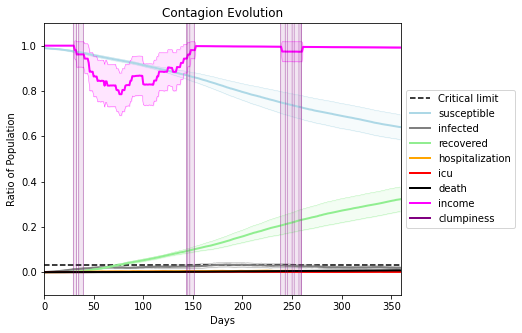

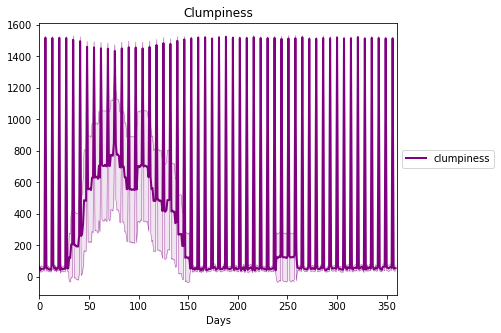

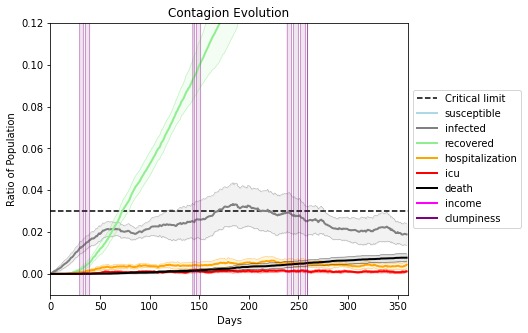

In [22]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.3
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[6424, 1199, 1703, 8648, 8988, 3403, 4032, 941, 7286, 2553, 9782, 7134, 1470, 7442, 3521, 5902, 9412, 2781, 5026, 3963]
Average similarity between family members is 0.18252469230965915 at temperature -0.2
Average similarity between family and home is 0.9998623994116596 at temperature -1
Average similarity between students and their classroom is 0.13006405711142396 at temperature -0.2
Average classroom occupancy is 1.7797619047619047 and number classrooms is 168
Average similarity between workers is 0.15248584854295116 at temperature -0.2
Average office occupancy is 3.3333333333333335 and number offices is 195
Average friend similarity for adults: 0.21191739615053323 for kids: 0.2100023637690279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildi

avg restaurant similarity 0.23869028094388356
avg restaurant similarity 0.3261072857347846
avg restaurant similarity 0.1924846020183313
avg restaurant similarity 0.13842795343913064
avg restaurant similarity 0.12355305752176467
avg restaurant similarity 0.016263009114213713
avg restaurant similarity 0.15221654569837348
avg restaurant similarity 0.16798569006347974
avg restaurant similarity 0.1263735293099611
avg restaurant similarity 0.059828276201834944
avg restaurant similarity 0.12766009088591254
avg restaurant similarity 0.05139939903144929
avg restaurant similarity 0.03669395314404562
avg restaurant similarity 0.1261377137344254
avg restaurant similarity -0.0813235729510455
avg restaurant similarity -0.020698088463573128
avg restaurant similarity 0.12318360595554108
avg restaurant similarity -0.15716548701502775
avg restaurant similarity 0.007451311637918651
avg restaurant similarity 0.3140690910373771
avg restaurant similarity -0.015211420209544888
avg restaurant similarity 0.085

avg restaurant similarity 0.02207973459019107
avg restaurant similarity 0.1593758143339205
avg restaurant similarity -0.1712426702593989
avg restaurant similarity 0.20171008785674094
avg restaurant similarity 0.22400820780276418
avg restaurant similarity 0.12625001770983854
avg restaurant similarity 0.16603305152081374
avg restaurant similarity -0.33948333666803576
avg restaurant similarity 0.14830626555684162
avg restaurant similarity 0.06193963984430779
avg restaurant similarity 0.021050787420440795
avg restaurant similarity 0.24062583618268532
avg restaurant similarity 0.3318550061082507
avg restaurant similarity 0.05863304468930931
avg restaurant similarity 0.12989358978299767
avg restaurant similarity 0.2849500357798891
avg restaurant similarity 0.07357264352769784
avg restaurant similarity 0.2997303321717779
avg restaurant similarity -0.1482870396245024
avg restaurant similarity 0.15855869165390463
avg restaurant similarity 0.1017572792091465
avg restaurant similarity 0.121618589

Average similarity between family members is 0.17225204220001555 at temperature -0.2
Average similarity between family and home is 0.9998532189837688 at temperature -1
Average similarity between students and their classroom is 0.22811060052724771 at temperature -0.2
Average classroom occupancy is 1.5617283950617284 and number classrooms is 162
Average similarity between workers is 0.15785134425898845 at temperature -0.2
Average office occupancy is 3.4527363184079602 and number offices is 201
Average friend similarity for adults: 0.2133619982191134 for kids: 0.20910498326350527
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.09503345175903939
avg restaurant similarity 0.010129004630496388
avg restaurant similarity 0.23436367148998283
avg restaurant similarity 0.061428837738216356
avg restaurant similarity 0.03643984498303199
avg restaurant similarity 0.0039140914636222705
avg restaurant similarity 0.025250783932178004
avg restaurant similarity -0.13741334839258185
avg restaurant similarity 0.012742287162936728
avg restaurant similarity 0.0394656475232721
avg restaurant similarity 0.04947332887812931
avg restaurant similarity 0.05491281695578966
avg restaurant similarity -0.07160541224831975
avg restaurant similarity -0.01481805819724278
avg restaurant similarity 0.21457226114445233
avg restaurant similarity 0.23190245242078664
avg restaurant similarity 0.1281775888912172
avg restaurant similarity 0.2117831837980877
avg restaurant similarity 0.24398401189960928
avg restaurant similarity 0.36242568445084233
avg restaurant similarity 0.12297818503658897
avg restaurant similarity 0.

avg restaurant similarity 0.0660429402849853
avg restaurant similarity 0.13466995417242023
avg restaurant similarity 0.0997811968106621
avg restaurant similarity 0.07395519705762338
avg restaurant similarity 0.18704301463401973
avg restaurant similarity 0.08409849324117051
avg restaurant similarity -0.08604287946306079
avg restaurant similarity -0.08523423414526538
avg restaurant similarity 0.12494570708770077
avg restaurant similarity 0.019642607287830162
avg restaurant similarity 0.11844538259397301
avg restaurant similarity 0.07967010483504067
avg restaurant similarity -0.002640388592769239
avg restaurant similarity -0.01636527504748322
avg restaurant similarity 0.10706902055081374
avg restaurant similarity 0.10887800086189073
avg restaurant similarity 0.02071488026247105
avg restaurant similarity 0.06943316219815804
avg restaurant similarity 0.12888053414053088
avg restaurant similarity 0.1967967474602479
avg restaurant similarity -0.17428731454021293
avg restaurant similarity 0.09

avg restaurant similarity 0.07210660248927471
Average similarity between family members is 0.17352249704083844 at temperature -0.2
Average similarity between family and home is 0.999851061014956 at temperature -1
Average similarity between students and their classroom is 0.1843663337658363 at temperature -0.2
Average classroom occupancy is 1.5888888888888888 and number classrooms is 180
Average similarity between workers is 0.15023255361296797 at temperature -0.2
Average office occupancy is 3.2587064676616917 and number offices is 201
Average friend similarity for adults: 0.22281911536896679 for kids: 0.22319924349791384
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 

avg restaurant similarity 0.03583999399165154
avg restaurant similarity 0.44580736814973776
avg restaurant similarity 0.04522141360239349
avg restaurant similarity -0.1376602890713784
avg restaurant similarity 0.13846063435596184
avg restaurant similarity -0.059927791461699235
avg restaurant similarity 0.0528094488053507
avg restaurant similarity 0.22467017918718718
avg restaurant similarity -0.1803149706628502
avg restaurant similarity 0.16841190964738145
avg restaurant similarity 0.31339911391475905
avg restaurant similarity 0.004958553976422665
avg restaurant similarity 0.08132403597595776
avg restaurant similarity 0.11206289510137576
avg restaurant similarity 0.19094995031515666
avg restaurant similarity -0.010974305453825092
avg restaurant similarity 0.05786843771215333
avg restaurant similarity -0.08292858372939772
avg restaurant similarity 0.11721423724961157
avg restaurant similarity 0.20741079219725606
avg restaurant similarity -0.007024861400962423
avg restaurant similarity 0

avg restaurant similarity 0.19295955407975443
avg restaurant similarity 0.27793674179418076
avg restaurant similarity 0.0611435583381512
avg restaurant similarity 0.06506053816884988
avg restaurant similarity 0.03678729958507425
avg restaurant similarity 0.15509488730892507
avg restaurant similarity 0.16614890018312348
avg restaurant similarity 0.09731499633135723
avg restaurant similarity -0.14207988563323168
avg restaurant similarity 0.09328901954161009
avg restaurant similarity 0.08045407988594507
avg restaurant similarity -0.1409679448245144
avg restaurant similarity 0.15777680582704384
avg restaurant similarity 0.10640607513644201
avg restaurant similarity -0.17378783495271036
avg restaurant similarity -0.06815883967129889
avg restaurant similarity 0.09083576128449682
avg restaurant similarity 0.11018508308818972
avg restaurant similarity -0.06551461202861517
avg restaurant similarity -0.053282871075779906
avg restaurant similarity -0.022730166298383894
avg restaurant similarity 0

Average similarity between family members is 0.1683536044135789 at temperature -0.2
Average similarity between family and home is 0.9998511434152215 at temperature -1
Average similarity between students and their classroom is 0.22200293565828277 at temperature -0.2
Average classroom occupancy is 1.5625 and number classrooms is 176
Average similarity between workers is 0.16215170139452353 at temperature -0.2
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.20980158713561436 for kids: 0.22271772352986538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district

avg restaurant similarity -0.0056536219818781736
avg restaurant similarity 0.19690613960842693
avg restaurant similarity -0.023274479914716033
avg restaurant similarity 0.10564416779957893
avg restaurant similarity 0.21123653705439435
avg restaurant similarity 0.053865386804549456
avg restaurant similarity 0.09354935906223882
avg restaurant similarity 0.13135205019054522
avg restaurant similarity 0.1037830149111798
avg restaurant similarity 0.13009260231290667
avg restaurant similarity -0.04170301159240872
avg restaurant similarity 0.007888615229880797
avg restaurant similarity 0.17111106352567373
avg restaurant similarity 0.017532123297008827
avg restaurant similarity 0.20671428869255026
avg restaurant similarity 0.01713075319755846
avg restaurant similarity 0.1307942348409759
avg restaurant similarity 0.12383952272704601
avg restaurant similarity 0.26549327886001517
avg restaurant similarity 0.16368551873791448
avg restaurant similarity -0.015333883701843973
avg restaurant similarity

avg restaurant similarity 0.04285547031414762
avg restaurant similarity 0.1018191774743759
avg restaurant similarity 0.21764186893174073
avg restaurant similarity -0.04782637843235529
avg restaurant similarity 0.05773407010673763
avg restaurant similarity -0.009588348744799378
avg restaurant similarity -0.32591146616372924
avg restaurant similarity 0.10162150125076275
avg restaurant similarity 0.09507948110645148
avg restaurant similarity 0.15950188660022688
avg restaurant similarity 0.18149949416142164
avg restaurant similarity -0.048521947948591354
avg restaurant similarity 0.14786520376543844
avg restaurant similarity 0.10025575841721741
avg restaurant similarity -0.03359730069927118
avg restaurant similarity 0.07103149760212225
avg restaurant similarity 0.21154124531116136
avg restaurant similarity -0.25057338593110434
avg restaurant similarity -0.00417286921328109
avg restaurant similarity 0.13259821997589077
avg restaurant similarity 0.1853323524579522
avg restaurant similarity 0

avg restaurant similarity -0.007441597976191261
avg restaurant similarity 0.06321244516999264
Average similarity between family members is 0.15791062658856828 at temperature -0.2
Average similarity between family and home is 0.9998530463340055 at temperature -1
Average similarity between students and their classroom is 0.1766980882224746 at temperature -0.2
Average classroom occupancy is 1.5642458100558658 and number classrooms is 179
Average similarity between workers is 0.14170336704526953 at temperature -0.2
Average office occupancy is 3.3692307692307693 and number offices is 195
Average friend similarity for adults: 0.20703122961042303 for kids: 0.20631223598350765
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allo

avg restaurant similarity 0.04251815041791694
avg restaurant similarity 0.22157623158076842
avg restaurant similarity 0.3179593609302384
avg restaurant similarity 0.2973041490886214
avg restaurant similarity 0.19581343961435277
avg restaurant similarity 0.07235855434556716
avg restaurant similarity 0.22516247602889394
avg restaurant similarity 0.027297854245550163
avg restaurant similarity 0.3189371570490724
avg restaurant similarity 0.2732858336241442
avg restaurant similarity 0.16990538356115814
avg restaurant similarity 0.22274927777886677
avg restaurant similarity 0.11424044484409518
avg restaurant similarity 0.11969161097032062
avg restaurant similarity 0.10459413052885023
avg restaurant similarity 0.16917630195624495
avg restaurant similarity 0.2346903307450165
avg restaurant similarity 0.1287965180563014
avg restaurant similarity 0.09049231480852504
avg restaurant similarity 0.2948106384868445
avg restaurant similarity 0.10011983273814626
avg restaurant similarity 0.191637275404

avg restaurant similarity 0.18372216011489378
avg restaurant similarity 0.00881520294212359
avg restaurant similarity 0.10620931054841395
avg restaurant similarity 0.19597321827394829
avg restaurant similarity 0.08062345373800393
avg restaurant similarity 0.19168428556554343
avg restaurant similarity 0.13215599710652928
avg restaurant similarity 0.14310992087754187
avg restaurant similarity 0.1379312756435794
avg restaurant similarity -0.02668321305974068
avg restaurant similarity 0.041773703711239035
avg restaurant similarity 0.11803457190860835
avg restaurant similarity 0.1129061396242126
avg restaurant similarity 0.018517006505595224
avg restaurant similarity 0.08952546515999521
avg restaurant similarity 0.05612502933422565
avg restaurant similarity 0.2499907158630397
avg restaurant similarity 0.0878584519619416
avg restaurant similarity 0.21389331006067255
avg restaurant similarity 0.13314872257192537
avg restaurant similarity 0.14931253966027147
avg restaurant similarity 0.3826797

Average similarity between family members is 0.1806444059674558 at temperature -0.2
Average similarity between family and home is 0.9998521869060518 at temperature -1
Average similarity between students and their classroom is 0.18434775588313948 at temperature -0.2
Average classroom occupancy is 1.6477272727272727 and number classrooms is 176
Average similarity between workers is 0.16785051981869115 at temperature -0.2
Average office occupancy is 3.1902439024390246 and number offices is 205
Average friend similarity for adults: 0.21872955673376587 for kids: 0.22891741562622384
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.07853664127440399
avg restaurant similarity -0.015710136727561927
avg restaurant similarity 0.005524458083791661
avg restaurant similarity 0.3538817782780552
avg restaurant similarity 0.1396649954369338
avg restaurant similarity 0.2796301615473301
avg restaurant similarity 0.06491707602636035
avg restaurant similarity 0.2213509481585589
avg restaurant similarity -0.012891067266571216
avg restaurant similarity 0.21147629482657623
avg restaurant similarity -0.10172997660558732
avg restaurant similarity 0.014904456538322989
avg restaurant similarity -0.04554736310904948
avg restaurant similarity -0.020137106262970494
avg restaurant similarity 0.21974526545546064
avg restaurant similarity -0.11697550937710337
avg restaurant similarity 0.19706964014013328
avg restaurant similarity -0.007994644144612869
avg restaurant similarity -0.010878886747100098
avg restaurant similarity 0.1718372443508706
avg restaurant similarity 0.40531368989355726
avg restaurant similarit

avg restaurant similarity 0.08582445898130542
avg restaurant similarity 0.03404568865157968
avg restaurant similarity 0.14902613721974625
avg restaurant similarity -0.34069851420925895
avg restaurant similarity 0.13668470545833777
avg restaurant similarity 0.13131473592995707
avg restaurant similarity -0.017718451682239168
avg restaurant similarity 0.10435674683851126
avg restaurant similarity 0.0461860463077233
avg restaurant similarity -0.10564579736049276
avg restaurant similarity 0.21365977204490416
avg restaurant similarity 0.07653324823018794
avg restaurant similarity 0.27989735753259
avg restaurant similarity 0.349257333449503
avg restaurant similarity 0.00030386599625821243
avg restaurant similarity 0.049104091297747565
avg restaurant similarity 0.27899332195800114
avg restaurant similarity -0.1337393198387006
avg restaurant similarity 0.2907600950473764
avg restaurant similarity 0.04748868547363661
avg restaurant similarity 0.051534068696433614
avg restaurant similarity 0.1088

Average similarity between family and home is 0.9998572936343768 at temperature -1
Average similarity between students and their classroom is 0.17952173457636172 at temperature -0.2
Average classroom occupancy is 1.5473684210526315 and number classrooms is 190
Average similarity between workers is 0.14478563795657062 at temperature -0.2
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.20304549521059415 for kids: 0.21891624426853443
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity 0.2061593460212726
avg restaurant similarity 0.020408461301712102
avg restaurant similarity 0.1494262521325094
avg restaurant similarity 0.10199630570911893
avg restaurant similarity 0.011775255558673751
avg restaurant similarity 0.1339981236854382
avg restaurant similarity 0.17958833160590879
avg restaurant similarity -0.20912409427628315
avg restaurant similarity 0.09928497066885253
avg restaurant similarity 0.025166345838956997
avg restaurant similarity 0.21512256907925445
avg restaurant similarity 0.16898102995966002
avg restaurant similarity 0.03965729745061684
avg restaurant similarity -0.08606907216470297
avg restaurant similarity 0.3342542732969755
avg restaurant similarity 0.08932126578510989
avg restaurant similarity 0.08401637903013165
avg restaurant similarity -0.0030401668215972086
avg restaurant similarity 0.25927683840991084
avg restaurant similarity 0.3519757647402792
avg restaurant similarity 0.023829383186961026
avg restaurant similarity 0.23

avg restaurant similarity 0.06199500772863469
avg restaurant similarity -0.062018454518652504
avg restaurant similarity 0.26634608265274023
avg restaurant similarity 0.07562842816135287
avg restaurant similarity 0.0723526254751277
avg restaurant similarity 0.20848373069679021
avg restaurant similarity 0.2287684964577458
avg restaurant similarity 0.4445937141643105
avg restaurant similarity 0.2422109144875331
avg restaurant similarity 0.0793061851104061
avg restaurant similarity 0.13961589221048853
avg restaurant similarity -0.007294397530910109
avg restaurant similarity -0.09723325801916215
avg restaurant similarity -0.09839067012046583
avg restaurant similarity 0.17510856726061344
avg restaurant similarity 0.32994282883782056
avg restaurant similarity -0.06939476829197991
avg restaurant similarity 0.032930192908460824
avg restaurant similarity 0.02003589620332964
avg restaurant similarity -0.04327669322950869
avg restaurant similarity 0.19817780596716983
avg restaurant similarity 0.70

Average friend similarity for adults: 0.20996236343848534 for kids: 0.21246196548751092
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloc

avg restaurant similarity 0.082495949211482
avg restaurant similarity 0.07971290317725237
avg restaurant similarity 0.13816803991729024
avg restaurant similarity -0.08696882951649641
avg restaurant similarity 0.09219208565497311
avg restaurant similarity -0.010940332660535424
avg restaurant similarity 0.11876019566553958
avg restaurant similarity -0.011179901097450278
avg restaurant similarity 0.01582938322322378
avg restaurant similarity -0.010487226149588528
avg restaurant similarity 0.01205467326405741
avg restaurant similarity 0.18960572245101423
avg restaurant similarity -0.005502385606041638
avg restaurant similarity 0.192491294951699
avg restaurant similarity 0.15850402065542393
avg restaurant similarity -0.06505018966290745
avg restaurant similarity 0.07048678242349224
avg restaurant similarity 0.13022033195682509
avg restaurant similarity 0.2238921653819476
avg restaurant similarity 0.024879374955501778
avg restaurant similarity -0.016173743114781595
avg restaurant similarity 

avg restaurant similarity 0.18144075702228685
avg restaurant similarity 0.11432221130373309
avg restaurant similarity 0.13078567649034245
avg restaurant similarity 0.02205399824168167
avg restaurant similarity -0.015697215094329812
avg restaurant similarity -0.12381307308035275
avg restaurant similarity 0.16731542523269166
avg restaurant similarity -0.12188207884537273
avg restaurant similarity -0.05790570712058517
avg restaurant similarity 0.06778920733602571
avg restaurant similarity -0.09968906683885773
avg restaurant similarity -0.09113755152528899
avg restaurant similarity 0.1474280285095929
avg restaurant similarity 0.005885691440286685
avg restaurant similarity 0.06953826225157646
avg restaurant similarity 0.1932053416129989
avg restaurant similarity -0.0454337174916983
avg restaurant similarity 0.04989290946079802
avg restaurant similarity 0.15111366018245712
avg restaurant similarity 0.3317823320031488
avg restaurant similarity 0.11941297640236949
avg restaurant similarity 0.0

avg restaurant similarity 0.10484395951377612
avg restaurant similarity 0.053687925642170314
avg restaurant similarity 0.0831456822982263
Average similarity between family members is 0.1731052422401893 at temperature -0.2
Average similarity between family and home is 0.9998582020013034 at temperature -1
Average similarity between students and their classroom is 0.17753597839110147 at temperature -0.2
Average classroom occupancy is 1.4945652173913044 and number classrooms is 184
Average similarity between workers is 0.15067537524527103 at temperature -0.2
Average office occupancy is 3.2211538461538463 and number offices is 208
Average friend similarity for adults: 0.2150035228832013 for kids: 0.21770598137188685
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.462555091974914
avg restaurant similarity 0.20003744211160548
avg restaurant similarity 0.20986471621785652
avg restaurant similarity 0.019684677810744827
avg restaurant similarity 0.041787236475964905
avg restaurant similarity 0.2750113052839642
avg restaurant similarity 0.23352846350586556
avg restaurant similarity -0.06657271743562389
avg restaurant similarity 0.16130360070562239
avg restaurant similarity 0.12021120514924025
avg restaurant similarity 0.32151768206047243
avg restaurant similarity 0.18577384328143925
avg restaurant similarity 0.16334565425988098
avg restaurant similarity 0.11966043074373436
avg restaurant similarity -0.1210087602114318
avg restaurant similarity -0.1660267446804937
avg restaurant similarity -0.037508305951843596
avg restaurant similarity 0.13726194713131157
avg restaurant similarity 0.035966433374263855
avg restaurant similarity 0.27111348225093973
avg restaurant similarity 0.14247388407170372
avg restaurant similarity 0.087

avg restaurant similarity 0.13769856235173988
avg restaurant similarity 0.16236601090489822
avg restaurant similarity 0.0647585124404777
avg restaurant similarity 0.10897352913619399
avg restaurant similarity -0.03746667351575543
avg restaurant similarity 0.10026356324016503
avg restaurant similarity 0.14018487341332986
avg restaurant similarity 0.0948446340307027
avg restaurant similarity 0.00041987132152597473
avg restaurant similarity 0.1455909901641378
avg restaurant similarity 0.1351681860056473
avg restaurant similarity 0.041930290645849855
avg restaurant similarity 0.29742400947762176
avg restaurant similarity 0.011022641318418056
avg restaurant similarity 0.17880695369971222
avg restaurant similarity 0.01714723125573636
avg restaurant similarity 0.17930095241112787
avg restaurant similarity 0.008390475524402021
avg restaurant similarity 0.19477138858571008
avg restaurant similarity 0.28815995819448764
avg restaurant similarity 0.1128940787915309
avg restaurant similarity 0.1192

Average similarity between workers is 0.15546333151715083 at temperature -0.2
Average office occupancy is 3.142156862745098 and number offices is 204
Average friend similarity for adults: 0.2055968532116043 for kids: 0.2081791502730914
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14

avg restaurant similarity 0.022529729188602854
avg restaurant similarity -0.05531159786936246
avg restaurant similarity 0.15733660275789618
avg restaurant similarity 0.0936185172423197
avg restaurant similarity 0.0365216473799189
avg restaurant similarity 0.05699559628627345
avg restaurant similarity 0.08102567661377233
avg restaurant similarity 0.012528709878938296
avg restaurant similarity 0.20652935752132728
avg restaurant similarity -0.02897102947405074
avg restaurant similarity 0.23182550155511017
avg restaurant similarity 0.17033853608771654
avg restaurant similarity 0.053987381302862555
avg restaurant similarity 0.06441084184609054
avg restaurant similarity 0.06109601882371537
avg restaurant similarity 0.12449734957238022
avg restaurant similarity 0.06786455525426731
avg restaurant similarity 0.13347407619341567
avg restaurant similarity 0.24728267147099986
avg restaurant similarity -0.0497561852716613
avg restaurant similarity -0.01311800827739249
avg restaurant similarity -0.0

avg restaurant similarity 0.15593906247615097
avg restaurant similarity 0.12384100776975285
avg restaurant similarity 0.12856842329441323
avg restaurant similarity 0.15121374081121494
avg restaurant similarity 0.06094354907756211
avg restaurant similarity 0.006169110010606874
avg restaurant similarity 0.15850639120532461
avg restaurant similarity 0.043927748217571776
avg restaurant similarity 0.09319186201059368
avg restaurant similarity 0.19499405203474948
avg restaurant similarity 0.024646907674606304
avg restaurant similarity 0.09963369283421908
avg restaurant similarity 0.17761827876015462
avg restaurant similarity 0.10263762166461494
avg restaurant similarity 0.05393381590427031
avg restaurant similarity 0.055299219299691324
avg restaurant similarity 0.10815007501416735
avg restaurant similarity -0.020629749804421078
avg restaurant similarity -0.06373881868147932
avg restaurant similarity 0.135709063472563
avg restaurant similarity 0.003128531761681482
avg restaurant similarity 0.

avg restaurant similarity 0.03327334812943018
avg restaurant similarity -0.1360483090160768
avg restaurant similarity 0.20845788284492406
Average similarity between family members is 0.16958476174787232 at temperature -0.2
Average similarity between family and home is 0.999851490414216 at temperature -1
Average similarity between students and their classroom is 0.1937006496696045 at temperature -0.2
Average classroom occupancy is 1.5517241379310345 and number classrooms is 174
Average similarity between workers is 0.13988811525678896 at temperature -0.2
Average office occupancy is 3.388059701492537 and number offices is 201
Average friend similarity for adults: 0.21231783733866658 for kids: 0.22193297738882953
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (

avg restaurant similarity 0.20487857988559907
avg restaurant similarity 0.04655288403543824
avg restaurant similarity 0.0689791950018444
avg restaurant similarity -0.029006439762674457
avg restaurant similarity -0.018965794841002276
avg restaurant similarity -0.10857861909386862
avg restaurant similarity -0.05873632466554969
avg restaurant similarity 0.17457458705110568
avg restaurant similarity 0.04704419561027266
avg restaurant similarity -0.02917112200878802
avg restaurant similarity 0.13482652500962153
avg restaurant similarity 0.055548844040945705
avg restaurant similarity 0.16601611770996205
avg restaurant similarity -0.013692081667587952
avg restaurant similarity 0.1657364124141023
avg restaurant similarity 0.07359213583338624
avg restaurant similarity 0.10259889632055398
avg restaurant similarity 0.0695416438354577
avg restaurant similarity 0.08524452783520244
avg restaurant similarity 0.07188465295387424
avg restaurant similarity 0.08104996342679559
avg restaurant similarity 0

avg restaurant similarity 0.04741926473670762
avg restaurant similarity 0.06549966026685683
avg restaurant similarity 0.2703704873121241
avg restaurant similarity 0.19007645315775712
avg restaurant similarity 0.06259831706095839
avg restaurant similarity 0.31633607630781024
avg restaurant similarity -0.00488060232139661
avg restaurant similarity 0.0223898045051512
avg restaurant similarity -0.08801179553367991
avg restaurant similarity 0.13219363534269543
avg restaurant similarity -0.11380773712967812
avg restaurant similarity -0.002134923616759331
avg restaurant similarity -0.05121726030214108
avg restaurant similarity 0.2646369400564207
avg restaurant similarity 0.28304390730008294
avg restaurant similarity 0.10313897246264345
avg restaurant similarity 0.3131571132446568
avg restaurant similarity 0.24505889946289441
avg restaurant similarity 0.1398227941989538
avg restaurant similarity -0.09650822993118321
avg restaurant similarity 0.13964414587595192
avg restaurant similarity 0.0458

Average similarity between workers is 0.1538602359110895 at temperature -0.2
Average office occupancy is 3.2167487684729066 and number offices is 203
Average friend similarity for adults: 0.21068980085477684 for kids: 0.2160934791876833
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 

avg restaurant similarity 0.07004942243872243
avg restaurant similarity 0.22206434919859527
avg restaurant similarity 0.16971560005879735
avg restaurant similarity -0.021077671560967307
avg restaurant similarity 0.023510839790038707
avg restaurant similarity 0.13396419478158597
avg restaurant similarity 0.012753677896328244
avg restaurant similarity 0.14689983050325364
avg restaurant similarity 0.07310595830616448
avg restaurant similarity -0.01199385859445537
avg restaurant similarity 0.0597244293400731
avg restaurant similarity 0.15620249244911608
avg restaurant similarity 0.2352074173440569
avg restaurant similarity 0.15524559873971758
avg restaurant similarity 0.08502709427788956
avg restaurant similarity 0.07435656822326997
avg restaurant similarity 0.005704522184471325
avg restaurant similarity 0.11950783381603514
avg restaurant similarity 0.029703030503630424
avg restaurant similarity 0.1256537478027155
avg restaurant similarity 0.2561727284164555
avg restaurant similarity -0.04

avg restaurant similarity 0.1318338066575787
avg restaurant similarity 0.0633296550936813
avg restaurant similarity 0.06562178512952249
avg restaurant similarity 0.08079422090120825
avg restaurant similarity 0.07848735537352555
avg restaurant similarity 0.1392536065325054
avg restaurant similarity 0.11214504189221365
avg restaurant similarity 0.15935942218394503
avg restaurant similarity 0.04548783887893456
avg restaurant similarity 0.1738213626108996
avg restaurant similarity -0.004895477927300775
avg restaurant similarity -0.04976523482130846
avg restaurant similarity 0.08162707795033823
avg restaurant similarity 0.14633839787848066
avg restaurant similarity -0.30932525566888247
avg restaurant similarity 0.2325487098112918
avg restaurant similarity 0.0570038253152828
avg restaurant similarity 0.1896894919419607
avg restaurant similarity -0.10395840643292771
avg restaurant similarity -0.04366806367521256
avg restaurant similarity 0.25609539350301014
avg restaurant similarity 0.0875376

avg restaurant similarity 0.19489687824904656
Average similarity between family members is 0.17362860124795135 at temperature -0.2
Average similarity between family and home is 0.9998550673004488 at temperature -1
Average similarity between students and their classroom is 0.1938740036912392 at temperature -0.2
Average classroom occupancy is 1.6723163841807909 and number classrooms is 177
Average similarity between workers is 0.17117754353563996 at temperature -0.2
Average office occupancy is 3.2254901960784315 and number offices is 204
Average friend similarity for adults: 0.22315431225763432 for kids: 0.21622020950028814
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6

avg restaurant similarity 0.17861828026015408
avg restaurant similarity -0.10995840590638994
avg restaurant similarity 0.38309849586962696
avg restaurant similarity 0.09612713225714946
avg restaurant similarity 0.17247813780388277
avg restaurant similarity 0.060861899003508364
avg restaurant similarity 0.17598811664505615
avg restaurant similarity 0.04587834642209058
avg restaurant similarity 0.15587407163092531
avg restaurant similarity 0.344200369544733
avg restaurant similarity 0.009248564336497817
avg restaurant similarity 0.547241864028939
avg restaurant similarity -0.0008211917281317852
avg restaurant similarity 0.17280765792764474
avg restaurant similarity 0.18236892366825908
avg restaurant similarity 6.500823507793394e-05
avg restaurant similarity -0.04666461456884189
avg restaurant similarity 0.11643758829041582
avg restaurant similarity 0.18985910418054536
avg restaurant similarity 0.13867108677553955
avg restaurant similarity 0.011890201619433743
avg restaurant similarity 0.

avg restaurant similarity 0.0625994485383751
avg restaurant similarity 0.16818589980387855
avg restaurant similarity 0.2465006143707694
avg restaurant similarity -0.09296941501332394
avg restaurant similarity 0.024974161577078685
avg restaurant similarity 0.09713978813255056
avg restaurant similarity -0.04024226076834923
avg restaurant similarity 0.12058261642574172
avg restaurant similarity 0.09561710413359592
avg restaurant similarity 0.23823317167368677
avg restaurant similarity 0.17742853787584445
avg restaurant similarity 0.19728880266638216
avg restaurant similarity 0.24603652478741722
avg restaurant similarity 0.5134366526853325
avg restaurant similarity 0.10538054016630445
avg restaurant similarity 0.4552231754175661
avg restaurant similarity 0.1188625698793165
avg restaurant similarity 0.356574884108641
avg restaurant similarity 0.005283318204512648
avg restaurant similarity 0.20696570845547962
avg restaurant similarity -0.07897962359715506
avg restaurant similarity 0.40405076

Average similarity between family and home is 0.9998540049610832 at temperature -1
Average similarity between students and their classroom is 0.17558077535713354 at temperature -0.2
Average classroom occupancy is 1.5363128491620113 and number classrooms is 179
Average similarity between workers is 0.16010953093202634 at temperature -0.2
Average office occupancy is 3.386934673366834 and number offices is 199
Average friend similarity for adults: 0.21144416199289656 for kids: 0.20930674539137176
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.24302826427507715
avg restaurant similarity 0.04071163472454732
avg restaurant similarity 0.22216014960016706
avg restaurant similarity 0.002600137863439836
avg restaurant similarity 0.11420496860127055
avg restaurant similarity 0.19016653348200036
avg restaurant similarity 0.11895950524604075
avg restaurant similarity 0.13723059383766537
avg restaurant similarity 0.2639240870345271
avg restaurant similarity 0.23534130533986156
avg restaurant similarity 0.09373604573494722
avg restaurant similarity 0.016896501018570535
avg restaurant similarity 0.10401810289843481
avg restaurant similarity 0.30448742852124916
avg restaurant similarity -0.00591787251183003
avg restaurant similarity 0.06151510147694607
avg restaurant similarity 0.13971646322651204
avg restaurant similarity 0.23285215165825432
avg restaurant similarity 0.2269502128205102
avg restaurant similarity 0.19987744239333796
avg restaurant similarity 0.018017501687684834
avg restaurant similarity 0.0464

avg restaurant similarity 0.22690392699034564
avg restaurant similarity -0.030566665894265252
avg restaurant similarity 0.2780775578808007
avg restaurant similarity 0.1441587292553458
avg restaurant similarity 0.0531081050101187
avg restaurant similarity 0.15219677698793302
avg restaurant similarity 0.06475897678759468
avg restaurant similarity 0.10692805261824707
avg restaurant similarity 0.012193541799658664
avg restaurant similarity 0.02350538207021119
avg restaurant similarity 0.103161058647085
avg restaurant similarity 0.25597578907481205
avg restaurant similarity 0.17268786652804788
avg restaurant similarity 0.090485546012632
avg restaurant similarity 0.10306170228229802
avg restaurant similarity 0.0802864495596546
avg restaurant similarity 0.07525785155713959
avg restaurant similarity 0.05098554772416656
avg restaurant similarity 0.07677285229876334
avg restaurant similarity 0.12641761350360384
avg restaurant similarity 0.21136296927013543
avg restaurant similarity 0.09608950573

avg restaurant similarity 0.17015518303132746
avg restaurant similarity 0.20562354419353396
Average similarity between family members is 0.18458210490671226 at temperature -0.2
Average similarity between family and home is 0.9998592700893731 at temperature -1
Average similarity between students and their classroom is 0.17462163241394366 at temperature -0.2
Average classroom occupancy is 1.5027932960893855 and number classrooms is 179
Average similarity between workers is 0.16911057103580754 at temperature -0.2
Average office occupancy is 3.2660098522167487 and number offices is 203
Average friend similarity for adults: 0.21314449022775486 for kids: 0.2196918111739867
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 alloca

avg restaurant similarity 0.1558524639757385
avg restaurant similarity 0.013937652750730844
avg restaurant similarity 0.166399104916938
avg restaurant similarity 0.06902393347413296
avg restaurant similarity 0.07635703431802532
avg restaurant similarity -0.04472098313525374
avg restaurant similarity -0.052402628150083466
avg restaurant similarity 0.4231720732489727
avg restaurant similarity -0.04694558072209658
avg restaurant similarity -0.11082759206493682
avg restaurant similarity 0.11492482955705079
avg restaurant similarity 0.05226514065848737
avg restaurant similarity 0.1375202354531424
avg restaurant similarity 0.09197764627441611
avg restaurant similarity 0.045164591459929015
avg restaurant similarity -0.058779269345997136
avg restaurant similarity 0.17345460420753128
avg restaurant similarity -0.08352232115404246
avg restaurant similarity 0.22252091248355804
avg restaurant similarity 0.09198628793266032
avg restaurant similarity 0.106943259524644
avg restaurant similarity 0.075

avg restaurant similarity 0.14043150252487932
avg restaurant similarity 0.032583345818555036
avg restaurant similarity -0.04786997166046979
avg restaurant similarity 0.013926249365113455
avg restaurant similarity 0.14402063362383755
avg restaurant similarity -0.04833976158381554
avg restaurant similarity -0.11447781906856362
avg restaurant similarity 0.07771619794405898
avg restaurant similarity 0.2152195130448294
avg restaurant similarity 0.07748011936975087
avg restaurant similarity 0.11160574567058121
avg restaurant similarity 0.21363226803052013
avg restaurant similarity 0.14023667187551664
avg restaurant similarity 0.2300745750015847
avg restaurant similarity 0.3267964398176484
avg restaurant similarity 0.14089569143149797
avg restaurant similarity -0.04152808814419704
avg restaurant similarity 0.0432883505774784
avg restaurant similarity -0.12541809361038425
avg restaurant similarity 0.13248323804496273
avg restaurant similarity 0.04521132390729811
avg restaurant similarity -0.09

avg restaurant similarity -0.014260520518322948
avg restaurant similarity -0.10493707421625535
avg restaurant similarity 0.029850802289248555
avg restaurant similarity 0.26833519470132466
Average similarity between family members is 0.19642593876807118 at temperature -0.2
Average similarity between family and home is 0.9998587861875431 at temperature -1
Average similarity between students and their classroom is 0.12649127555670878 at temperature -0.2
Average classroom occupancy is 1.6428571428571428 and number classrooms is 182
Average similarity between workers is 0.1119296754998787 at temperature -0.2
Average office occupancy is 3.195 and number offices is 200
Average friend similarity for adults: 0.21417393178810026 for kids: 0.20856874832966196
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Bu

avg restaurant similarity 0.15032608399857722
avg restaurant similarity -0.013461855829634451
avg restaurant similarity 0.08073145149362876
avg restaurant similarity -0.11152327909749142
avg restaurant similarity 0.15479480869537093
avg restaurant similarity 0.18208072514308335
avg restaurant similarity 0.114071466289825
avg restaurant similarity 0.05401272069550851
avg restaurant similarity 0.03859297872875134
avg restaurant similarity 0.11741958235064694
avg restaurant similarity 0.16634675186645775
avg restaurant similarity 0.12036965613234767
avg restaurant similarity 0.11030365053690291
avg restaurant similarity 0.26471095665315125
avg restaurant similarity 0.12345013487247217
avg restaurant similarity 0.008952503971002612
avg restaurant similarity -0.016636347515449547
avg restaurant similarity 0.28274135983938725
avg restaurant similarity 0.20717788094477765
avg restaurant similarity 0.01954630467935467
avg restaurant similarity 0.06484710893218412
avg restaurant similarity 0.11

avg restaurant similarity 0.006400906383932764
avg restaurant similarity 0.31291724768208873
avg restaurant similarity 0.0009799010961971805
avg restaurant similarity 0.140444750117476
avg restaurant similarity 0.1753413169366043
avg restaurant similarity 0.14105420782670935
avg restaurant similarity 0.24510651525877822
avg restaurant similarity -0.21785735205103882
avg restaurant similarity 0.04464312102605635
avg restaurant similarity 0.08673359901870355
avg restaurant similarity 0.08954653156583024
avg restaurant similarity 0.11227076894196295
avg restaurant similarity -0.05467064104910527
avg restaurant similarity 0.0994339462854383
avg restaurant similarity -0.022368116704218677
avg restaurant similarity 0.24643498252695817
avg restaurant similarity 0.1898729661542433
avg restaurant similarity 0.13850985358637363
avg restaurant similarity -0.07021421287912383
avg restaurant similarity -0.0077422398609465004
avg restaurant similarity 0.07120439683618741
avg restaurant similarity 0.

Average similarity between family and home is 0.9998489758048059 at temperature -1
Average similarity between students and their classroom is 0.1679324366098004 at temperature -0.2
Average classroom occupancy is 1.532258064516129 and number classrooms is 186
Average similarity between workers is 0.14924605757052764 at temperature -0.2
Average office occupancy is 3.1658536585365855 and number offices is 205
Average friend similarity for adults: 0.21049397451345686 for kids: 0.21810019478677617
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.2581601372001263
avg restaurant similarity 0.17547549955365485
avg restaurant similarity 0.19026899030919753
avg restaurant similarity 0.05363788758685395
avg restaurant similarity -0.02503638049721475
avg restaurant similarity 0.15775667281333658
avg restaurant similarity 0.08450362028146378
avg restaurant similarity 0.11546293428932851
avg restaurant similarity -0.07105062428544555
avg restaurant similarity -0.06361432924560541
avg restaurant similarity 0.15101252590144176
avg restaurant similarity -0.2830571261451682
avg restaurant similarity 0.05315010419980778
avg restaurant similarity 0.05727759133465062
avg restaurant similarity 0.26977622891919606
avg restaurant similarity 0.17641874066625177
avg restaurant similarity 0.04642642713564772
avg restaurant similarity 0.28518194322787316
avg restaurant similarity -0.1665227236218537
avg restaurant similarity 0.13031445820977794
avg restaurant similarity 0.16687909137583948
avg restaurant similarity 0.1430

avg restaurant similarity 0.034657981308994674
avg restaurant similarity 0.005368885635592141
avg restaurant similarity 0.12933107938682029
avg restaurant similarity 0.021549891413802424
avg restaurant similarity -0.06718759639282641
avg restaurant similarity -0.1061068047786081
avg restaurant similarity 0.16317199667938245
avg restaurant similarity 0.3285055846135585
avg restaurant similarity 0.07581966629737256
avg restaurant similarity 0.11338774370363779
avg restaurant similarity -0.07917055779979511
avg restaurant similarity -0.1871049438729504
avg restaurant similarity 0.3607149122721297
avg restaurant similarity 0.1816280342971309
avg restaurant similarity -0.020637148129579164
avg restaurant similarity 0.09243022692122747
avg restaurant similarity 0.061998060343028204
avg restaurant similarity 0.17342228480601343
avg restaurant similarity -0.10711458701873125
avg restaurant similarity 0.1825039422453336
avg restaurant similarity 0.1424665277137182
avg restaurant similarity 0.40

avg restaurant similarity -0.13012911120274268
Average similarity between family members is 0.19599562110683746 at temperature -0.2
Average similarity between family and home is 0.9998375035538641 at temperature -1
Average similarity between students and their classroom is 0.15574085654607941 at temperature -0.2
Average classroom occupancy is 1.5172413793103448 and number classrooms is 174
Average similarity between workers is 0.1714599594427098 at temperature -0.2
Average office occupancy is 3.4079601990049753 and number offices is 201
Average friend similarity for adults: 0.21533360800918985 for kids: 0.21763171004744866
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 1

avg restaurant similarity 0.08421008256958083
avg restaurant similarity 0.15849570181484246
avg restaurant similarity 0.05924495252090558
avg restaurant similarity 0.1876575877146673
avg restaurant similarity 0.06779865912013629
avg restaurant similarity 0.08431369963804336
avg restaurant similarity 0.17982837694280512
avg restaurant similarity 0.0839515453241706
avg restaurant similarity -0.052404057943042995
avg restaurant similarity -0.062461238493573615
avg restaurant similarity -0.07830934814340773
avg restaurant similarity -0.005756221714306814
avg restaurant similarity 0.13592485232940096
avg restaurant similarity 0.08362991467372641
avg restaurant similarity 0.13045700750785336
avg restaurant similarity 0.06792101769442904
avg restaurant similarity 0.17606602575155128
avg restaurant similarity -0.07395686966529626
avg restaurant similarity 0.09953685710375441
avg restaurant similarity 0.08130029957554377
avg restaurant similarity 0.030408198176690188
avg restaurant similarity 0

avg restaurant similarity 0.0627573124852904
avg restaurant similarity 0.40179514444501657
avg restaurant similarity 0.0804840048968669
avg restaurant similarity 0.035332619707936885
avg restaurant similarity -0.022659518286945374
avg restaurant similarity 0.25080840483355876
avg restaurant similarity -0.13300274547616253
avg restaurant similarity 0.020604757322643264
avg restaurant similarity 0.04680529919062903
avg restaurant similarity -0.14463598204288056
avg restaurant similarity 0.08776558914958972
avg restaurant similarity 0.09444573710701018
avg restaurant similarity 0.08411628235470692
avg restaurant similarity 0.21278304617421337
avg restaurant similarity 0.22956732505099936
avg restaurant similarity 0.02756017974341538
avg restaurant similarity 0.08048069380962214
avg restaurant similarity 0.04440188296536263
avg restaurant similarity 0.05597750295544224
avg restaurant similarity 0.0986351238527118
avg restaurant similarity 0.16975465531184733
avg restaurant similarity 0.109

Average similarity between family and home is 0.9998451611728506 at temperature -1
Average similarity between students and their classroom is 0.19200457790289274 at temperature -0.2
Average classroom occupancy is 1.6290322580645162 and number classrooms is 186
Average similarity between workers is 0.15038907418787506 at temperature -0.2
Average office occupancy is 3.123152709359606 and number offices is 203
Average friend similarity for adults: 0.20786280240896765 for kids: 0.21959297133687283
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for

avg restaurant similarity -0.1194827110792872
avg restaurant similarity -0.04373691287340666
avg restaurant similarity 0.1298992053793513
avg restaurant similarity 0.22154247386530168
avg restaurant similarity 0.1926509852012678
avg restaurant similarity 0.2439890405805718
avg restaurant similarity 0.2228894466481055
avg restaurant similarity 0.29056585323425493
avg restaurant similarity 0.18399961516108754
avg restaurant similarity -0.0034731048112489568
avg restaurant similarity 0.03264996023350386
avg restaurant similarity 0.16418054568154983
avg restaurant similarity 0.14491974285169662
avg restaurant similarity -0.0030333391079473693
avg restaurant similarity 0.08235770718737345
avg restaurant similarity 0.18605867366884568
avg restaurant similarity 0.148875889425343
avg restaurant similarity 0.23845403080769692
avg restaurant similarity 0.220642729112944
avg restaurant similarity 0.16854980033643976
avg restaurant similarity 0.09662514552050498
avg restaurant similarity 0.3207486

avg restaurant similarity 0.16544161872897026
avg restaurant similarity 0.01129283287243257
avg restaurant similarity 0.029017570832696682
avg restaurant similarity 0.110148826859679
avg restaurant similarity 0.07523815722344765
avg restaurant similarity 0.2118591540259967
avg restaurant similarity 0.15335211574659185
avg restaurant similarity 0.07730128405308483
avg restaurant similarity 0.3048693703825192
avg restaurant similarity -0.030516016773572713
avg restaurant similarity 0.25299604543683774
avg restaurant similarity 0.7020074972881707
avg restaurant similarity 0.20409303240872506
avg restaurant similarity -0.026761892411316213
avg restaurant similarity 0.19924449288285587
avg restaurant similarity 0.1270407358412078
avg restaurant similarity 0.01857184771068684
avg restaurant similarity -0.04198074413824217
avg restaurant similarity 0.16708625698572568
avg restaurant similarity 0.03538050236139434
avg restaurant similarity 0.1562466061615574
avg restaurant similarity 0.0504146

avg restaurant similarity -0.08359808884141252
avg restaurant similarity 0.2853715788731275
Average similarity between family members is 0.19198778672076564 at temperature -0.2
Average similarity between family and home is 0.9998555934392334 at temperature -1
Average similarity between students and their classroom is 0.16891003787764758 at temperature -0.2
Average classroom occupancy is 1.664804469273743 and number classrooms is 179
Average similarity between workers is 0.12746885534914995 at temperature -0.2
Average office occupancy is 3.1732673267326734 and number offices is 202
Average friend similarity for adults: 0.21331637144531448 for kids: 0.211189440611125
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.18420906586339159
avg restaurant similarity -0.17732823831265856
avg restaurant similarity 0.0816133069009319
avg restaurant similarity 0.10658983294037719
avg restaurant similarity -0.08271816807859446
avg restaurant similarity 0.06039271937291787
avg restaurant similarity -0.011094922087106532
avg restaurant similarity 0.0022059048816515953
avg restaurant similarity -0.02140120737749646
avg restaurant similarity 0.09044093090393883
avg restaurant similarity 0.1523934345126642
avg restaurant similarity -0.08231907774191413
avg restaurant similarity -0.053525317550260486
avg restaurant similarity 0.37741093631175987
avg restaurant similarity -0.0718450503215492
avg restaurant similarity 0.043335592659619324
avg restaurant similarity 0.3720858980542797
avg restaurant similarity 0.06431387886548755
avg restaurant similarity 0.022607309621384186
avg restaurant similarity -0.03605763535839131
avg restaurant similarity 0.21441608707949092
avg restaurant similarit

avg restaurant similarity 0.3340228444125416
avg restaurant similarity -0.0482348077574911
avg restaurant similarity -0.0872761623292084
avg restaurant similarity 0.0028132676092370193
avg restaurant similarity 0.27159663675244844
avg restaurant similarity -0.1483978774462115
avg restaurant similarity 0.015555538404458563
avg restaurant similarity 0.04980235300460754
avg restaurant similarity 0.08794417286828035
avg restaurant similarity 0.07944199094909671
avg restaurant similarity -0.05089880189540558
avg restaurant similarity -0.057017790130410174
avg restaurant similarity 0.07274053894710962
avg restaurant similarity 0.08133114410176841
avg restaurant similarity 0.21673677043856018
avg restaurant similarity 0.2539644495657035
avg restaurant similarity -0.036183870812633634
avg restaurant similarity -0.12514430845418714
avg restaurant similarity 0.04840641287062942
avg restaurant similarity 0.1913822876466525
avg restaurant similarity 0.08342334512051043
avg restaurant similarity -0

using average of time series:
stats on susceptible:
data: [0.7089638888888888, 0.8831638888888887, 0.8502166666666666, 0.8621055555555555, 0.8114385614385614, 0.8539222222222224, 0.7835222222222222, 0.7919722222222223, 0.8515833333333335, 0.8729083333333334, 0.7906374501992032, 0.8059666666666666, 0.8305166666666667, 0.8767583333333334, 0.8859777777777778, 0.8696466157084302, 0.7509333333333333, 0.8819083333333333, 0.8671472222222222, 0.9080555555555555]
min:
0.7089638888888888
max:
0.9080555555555555
std:
0.05011989851969768
mean:
0.8368672424784208
median:
0.8527527777777779
95% confidence interval for the mean:
(0.8128010380160119,0.8609334469408297)
using average of time series:
stats on infected:
data: [0.03435, 0.016141666666666665, 0.018330555555555555, 0.01647222222222222, 0.0264957264957265, 0.017936111111111108, 0.029491666666666663, 0.025669444444444443, 0.01962222222222222, 0.013252777777777778, 0.027744577246569275, 0.023491666666666668, 0.02299722222222222, 0.014144444444

(<function dict.items>, <function dict.items>, <function dict.items>)

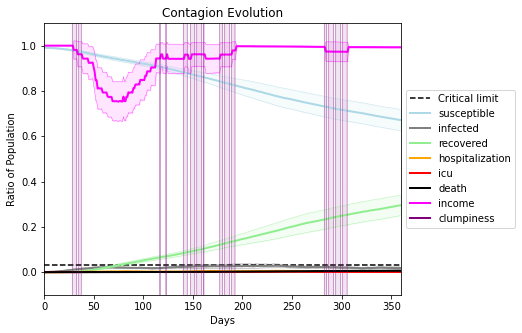

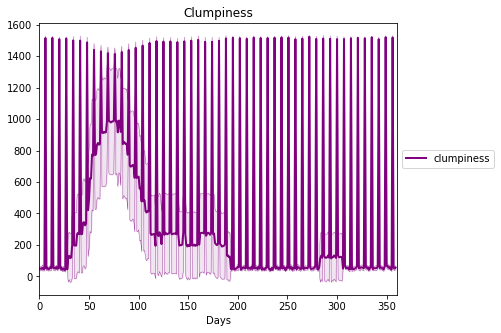

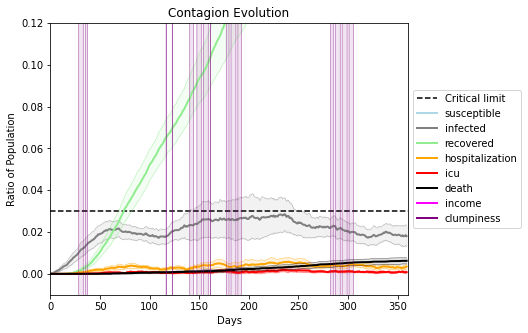

In [23]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.2
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[5343, 461, 5236, 1488, 1060, 6221, 5443, 1851, 9921, 346, 709, 1825, 5212, 8777, 6629, 5040, 765, 4060, 6995, 9760]
Average similarity between family members is 0.18148205937536216 at temperature -0.1
Average similarity between family and home is 0.9998615197123307 at temperature -1
Average similarity between students and their classroom is 0.170792130597678 at temperature -0.1
Average classroom occupancy is 1.707182320441989 and number classrooms is 181
Average similarity between workers is 0.16029161557431798 at temperature -0.1
Average office occupancy is 3.222772277227723 and number offices is 202
Average friend similarity for adults: 0.21165017646304632 for kids: 0.2104379847296476
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homog

avg restaurant similarity 0.07212966677642248
avg restaurant similarity -0.016252999980471094
avg restaurant similarity -0.15497882601103824
avg restaurant similarity 0.11240699609573956
avg restaurant similarity 0.04605888128636557
avg restaurant similarity -0.16680132128707456
avg restaurant similarity 0.10978939316976208
avg restaurant similarity -0.07351445000651247
avg restaurant similarity 0.0821508273917745
avg restaurant similarity 0.12410798718037395
avg restaurant similarity 0.00032938748116696087
avg restaurant similarity 0.022477823470553018
avg restaurant similarity 0.08695667433585028
avg restaurant similarity 0.19440167796444502
avg restaurant similarity 0.24733681739520624
avg restaurant similarity 0.18151967853253737
avg restaurant similarity -0.0510317482103432
avg restaurant similarity 0.04551809568805195
avg restaurant similarity 0.022537548123731068
avg restaurant similarity 0.14268713776723463
avg restaurant similarity 0.166489567171998
avg restaurant similarity 0

avg restaurant similarity 0.3076827884885198
avg restaurant similarity -0.016553486322932933
avg restaurant similarity 0.2146439874693581
avg restaurant similarity 0.1551639111904139
avg restaurant similarity -0.12658790559573324
avg restaurant similarity 0.24390055522398096
avg restaurant similarity -0.03564165249703377
avg restaurant similarity 0.04549254323888881
avg restaurant similarity 0.04755636222824135
avg restaurant similarity 0.09871709330049931
avg restaurant similarity 0.0901367872411242
avg restaurant similarity -0.08307939207425033
avg restaurant similarity 0.1839398832018719
avg restaurant similarity -0.039130232107525614
avg restaurant similarity 0.3025643445602821
avg restaurant similarity -0.032992535762855206
avg restaurant similarity 0.17219090841670578
avg restaurant similarity 0.15840254829180234
avg restaurant similarity 0.11733226297059869
avg restaurant similarity 0.0024304087125673127
avg restaurant similarity 0.3042816367189279
avg restaurant similarity 0.22

Average similarity between workers is 0.16928788580961676 at temperature -0.1
Average office occupancy is 3.2222222222222223 and number offices is 207
Average friend similarity for adults: 0.20491995677580654 for kids: 0.2093405852920358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 6 people.
Total of

avg restaurant similarity 0.21123986053157454
avg restaurant similarity 0.045681465697210696
avg restaurant similarity -0.05895229812518681
avg restaurant similarity 0.08912304496943643
avg restaurant similarity 0.3534590076147125
avg restaurant similarity 0.12971540886886915
avg restaurant similarity 0.08811940685692339
avg restaurant similarity -0.022937582574216617
avg restaurant similarity 0.028675493527097255
avg restaurant similarity 0.15943399591049556
avg restaurant similarity 0.014662831667182913
avg restaurant similarity 0.0026966309848538614
avg restaurant similarity -0.11100457844505393
avg restaurant similarity 0.06498760646835029
avg restaurant similarity 0.18893051969735594
avg restaurant similarity 0.02927531493382075
avg restaurant similarity 0.1842979413513518
avg restaurant similarity 0.05503479381464704
avg restaurant similarity 0.23358036622723663
avg restaurant similarity -0.1159449590070536
avg restaurant similarity 0.158610158375031
avg restaurant similarity 0.1

avg restaurant similarity 0.1509175496891088
avg restaurant similarity 0.2678851400725513
avg restaurant similarity 0.31195852403735663
avg restaurant similarity 0.3761651592862289
avg restaurant similarity 0.040771011331266975
avg restaurant similarity 0.09589514237496982
avg restaurant similarity -0.04386031854767211
avg restaurant similarity 0.13536079641684487
avg restaurant similarity 0.03818021714670151
avg restaurant similarity -0.21457323595306563
avg restaurant similarity -0.11410727048430164
avg restaurant similarity -0.16386576643333886
avg restaurant similarity -0.20853455837663387
avg restaurant similarity 0.25116044312543834
avg restaurant similarity -0.12338977072627554
avg restaurant similarity 0.2624696929073732
avg restaurant similarity 0.12282100590841555
avg restaurant similarity 0.1861336968000453
avg restaurant similarity 0.24397491104957114
avg restaurant similarity 0.21641546544406665
avg restaurant similarity 0.10984197470565014
avg restaurant similarity 0.2899

Average friend similarity for adults: 0.21189101142685446 for kids: 0.22657482369019968
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.06341889955596666
avg restaurant similarity 0.2379910639658126
avg restaurant similarity 0.01378075679021624
avg restaurant similarity 0.18583371930498024
avg restaurant similarity -0.0023402203055093882
avg restaurant similarity 0.17056667639051362
avg restaurant similarity -0.16671847990678942
avg restaurant similarity 0.17391988254366272
avg restaurant similarity 0.05538713268926739
avg restaurant similarity 0.0809635191252632
avg restaurant similarity 0.10510172015850536
avg restaurant similarity 0.07074360325440733
avg restaurant similarity 0.11956662872805435
avg restaurant similarity 0.21090009511991398
avg restaurant similarity 0.09858344366163001
avg restaurant similarity 0.1199581844253388
avg restaurant similarity -0.09096207556335131
avg restaurant similarity -0.042025019624363794
avg restaurant similarity 0.09896468111605011
avg restaurant similarity 0.08799911470195673
avg restaurant similarity 0.35737563802615185
avg restaurant similarity 0.12

avg restaurant similarity -0.2840350015782498
avg restaurant similarity 0.034289460203394045
avg restaurant similarity 0.1311147494326414
avg restaurant similarity 0.01193296832314846
avg restaurant similarity 0.0023867922860633345
avg restaurant similarity 0.08872642038511268
avg restaurant similarity 0.09593556474612032
avg restaurant similarity 0.035002807574528505
avg restaurant similarity -0.20398415902878644
avg restaurant similarity 0.13149953026479005
avg restaurant similarity 0.12455781077128512
avg restaurant similarity -0.033093764692597026
avg restaurant similarity 0.03672945730343299
avg restaurant similarity -0.12271848362843078
avg restaurant similarity 0.03262079445243836
avg restaurant similarity -0.021446294921347787
avg restaurant similarity 0.11061338620269028
avg restaurant similarity 0.13997429138752202
avg restaurant similarity 0.1418589925867739
avg restaurant similarity 0.07723437247418968
avg restaurant similarity 0.1087400985784765
avg restaurant similarity 0

avg restaurant similarity -0.05600635965860823
avg restaurant similarity 0.21600392608340943
avg restaurant similarity 0.06381905492694
avg restaurant similarity 0.038674047569927796
avg restaurant similarity 0.07561813000789819
avg restaurant similarity 0.09755877497997396
Average similarity between family members is 0.16699431647035293 at temperature -0.1
Average similarity between family and home is 0.9998495832675534 at temperature -1
Average similarity between students and their classroom is 0.1728006251181275 at temperature -0.1
Average classroom occupancy is 1.5894736842105264 and number classrooms is 190
Average similarity between workers is 0.15192785726414956 at temperature -0.1
Average office occupancy is 3.269035532994924 and number offices is 197
Average friend similarity for adults: 0.21170000431202593 for kids: 0.21513555931752842
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with 

avg restaurant similarity 0.18514460174953054
avg restaurant similarity 0.05409048531986796
avg restaurant similarity 0.16931606062582763
avg restaurant similarity 0.14435191645838077
avg restaurant similarity 0.11360964761499982
avg restaurant similarity 0.08414278869096962
avg restaurant similarity 0.2031285995236774
avg restaurant similarity 0.15219754805177402
avg restaurant similarity 0.05200620949775933
avg restaurant similarity 0.21428608741363794
avg restaurant similarity -0.002868049167021894
avg restaurant similarity 0.2340837909339819
avg restaurant similarity 0.18641520805807515
avg restaurant similarity -0.013767937344490094
avg restaurant similarity -0.030649696850497805
avg restaurant similarity 0.005717599618363591
avg restaurant similarity 0.020919811975504677
avg restaurant similarity 0.16378247560120854
avg restaurant similarity 0.12352479184438647
avg restaurant similarity -0.019510161716523533
avg restaurant similarity 0.09278785823593856
avg restaurant similarity 

avg restaurant similarity -0.18790228358424393
avg restaurant similarity 0.20356678924114213
avg restaurant similarity 0.1352549337539176
avg restaurant similarity 0.05039303120458167
avg restaurant similarity 0.26903762938111747
avg restaurant similarity -0.08480880541332433
avg restaurant similarity 0.03085474936023745
avg restaurant similarity 0.11575503516216587
avg restaurant similarity 0.09617652421759604
avg restaurant similarity 0.004470203795573517
avg restaurant similarity -0.05994267626109177
avg restaurant similarity 0.20691211977091695
avg restaurant similarity 0.14854064107478637
avg restaurant similarity 0.008079668132123874
avg restaurant similarity 0.02019668131392284
avg restaurant similarity 0.053950844727543946
avg restaurant similarity 0.04735927255077454
avg restaurant similarity 0.057230267411559545
avg restaurant similarity 0.15933242138081147
avg restaurant similarity 0.12762810793419865
avg restaurant similarity 0.08346960229484858
avg restaurant similarity 0.

avg restaurant similarity -0.25410542553010157
avg restaurant similarity 0.06619534142369882
avg restaurant similarity 0.2186173834302029
Average similarity between family members is 0.15087512881145734 at temperature -0.1
Average similarity between family and home is 0.9998603541550846 at temperature -1
Average similarity between students and their classroom is 0.16538270788859413 at temperature -0.1
Average classroom occupancy is 1.7329545454545454 and number classrooms is 176
Average similarity between workers is 0.13453177312103345 at temperature -0.1
Average office occupancy is 3.142156862745098 and number offices is 204
Average friend similarity for adults: 0.19803605751349643 for kids: 0.20050287293287178
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units

avg restaurant similarity 0.0037874291264060798
avg restaurant similarity 0.0948301121003297
avg restaurant similarity 0.13193271137904908
avg restaurant similarity 0.034258928880998095
avg restaurant similarity 0.08765010174375422
avg restaurant similarity 0.380152416314859
avg restaurant similarity 0.2032304616420712
avg restaurant similarity -0.12363545442659662
avg restaurant similarity 0.22574704552141092
avg restaurant similarity -0.33409815373087015
avg restaurant similarity -0.0565035091221871
avg restaurant similarity -0.12555038073500865
avg restaurant similarity 0.15654770769102738
avg restaurant similarity 0.029113863747335062
avg restaurant similarity -0.06759709489315083
avg restaurant similarity -0.10431170164191027
avg restaurant similarity 0.06224422355069657
avg restaurant similarity 0.5295383141933292
avg restaurant similarity 0.16057860709152852
avg restaurant similarity -0.028149094183398934
avg restaurant similarity -0.09553138826691701
avg restaurant similarity 0

avg restaurant similarity 0.09516125370535719
avg restaurant similarity -0.13128775160404668
avg restaurant similarity -0.22858866393589122
avg restaurant similarity 0.20386708154840227
avg restaurant similarity 0.11210946990441933
avg restaurant similarity -0.03316632633715485
avg restaurant similarity -0.19365233360971024
avg restaurant similarity 0.2181763735544587
avg restaurant similarity 0.10338107105450162
avg restaurant similarity 0.19636206599531378
avg restaurant similarity 0.024489420401956206
avg restaurant similarity 0.07588179570559611
avg restaurant similarity 0.21885582007364648
avg restaurant similarity 0.2979547702006886
avg restaurant similarity 0.30247514751149684
avg restaurant similarity 0.08222314150135616
avg restaurant similarity 0.00795846374879687
avg restaurant similarity 0.08030731024528708
avg restaurant similarity -0.16197530138392138
avg restaurant similarity -0.05565066075763317
avg restaurant similarity -0.009545254038451627
avg restaurant similarity -

avg restaurant similarity 0.04027949824918634
avg restaurant similarity 0.0330128368979285
avg restaurant similarity 0.07440182061552655
avg restaurant similarity -0.12496856450993099
avg restaurant similarity 0.059641091087083806
avg restaurant similarity 0.17376050569416873
avg restaurant similarity 0.2936185518478883
avg restaurant similarity 0.13075102125308766
avg restaurant similarity 0.12806734538280565
avg restaurant similarity 0.1139156481730038
avg restaurant similarity 0.601032724329307
avg restaurant similarity 0.2739529053193826
avg restaurant similarity 0.11119288067930075
avg restaurant similarity 0.08905929123528537
avg restaurant similarity 0.23516157309710695
avg restaurant similarity 0.0018634729886927012
avg restaurant similarity 0.03722731817311068
avg restaurant similarity 0.10720662032583139
avg restaurant similarity 0.057604068792920876
avg restaurant similarity 0.0220477678246219
avg restaurant similarity 0.24390021838843748
avg restaurant similarity -0.0106677

avg restaurant similarity -0.16505388986741187
avg restaurant similarity 0.10038333378827664
avg restaurant similarity 0.47317506719965263
avg restaurant similarity 0.06631157313002126
avg restaurant similarity 0.13029364723488346
avg restaurant similarity -0.04612975786802977
avg restaurant similarity 0.030098056981794977
avg restaurant similarity -0.09542295731930256
avg restaurant similarity 0.17723674421329383
avg restaurant similarity -0.058082165363508985
avg restaurant similarity -0.1783110219894259
avg restaurant similarity 0.040079411864357734
avg restaurant similarity -0.011929612885057542
avg restaurant similarity 0.21303112307006078
avg restaurant similarity 0.13991425888535922
avg restaurant similarity -0.23220514045363058
avg restaurant similarity 0.20455289499982926
avg restaurant similarity -0.1108639776345604
avg restaurant similarity 0.13891976577256693
avg restaurant similarity 0.13417354283385033
avg restaurant similarity -0.13104111622413053
avg restaurant similari

avg restaurant similarity 0.08290503617383364
avg restaurant similarity 0.08758232181635654
Average similarity between family members is 0.1626593791995952 at temperature -0.1
Average similarity between family and home is 0.9998641023666609 at temperature -1
Average similarity between students and their classroom is 0.17975380699866508 at temperature -0.1
Average classroom occupancy is 1.6296296296296295 and number classrooms is 189
Average similarity between workers is 0.16993750049122675 at temperature -0.1
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.2136628996176802 for kids: 0.21593626439363184
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with 

avg restaurant similarity 0.13658358096494821
avg restaurant similarity 0.048174755917683394
avg restaurant similarity 0.09176609175938337
avg restaurant similarity 0.08544322203765936
avg restaurant similarity 0.10089985566816505
avg restaurant similarity 0.12092250485871608
avg restaurant similarity 0.2264651001767738
avg restaurant similarity 0.18242761459250886
avg restaurant similarity 0.13898951406956275
avg restaurant similarity 0.13151772910258822
avg restaurant similarity 0.06538578968443881
avg restaurant similarity 0.07002838555382503
avg restaurant similarity 0.053043943795899044
avg restaurant similarity 0.05022206870499198
avg restaurant similarity 0.14037698736428178
avg restaurant similarity -0.06703913368890478
avg restaurant similarity -0.0014780015633964947
avg restaurant similarity -0.136657670962527
avg restaurant similarity 0.09158124045378407
avg restaurant similarity 0.0835301118283788
avg restaurant similarity 0.15036456677284782
avg restaurant similarity 0.102

avg restaurant similarity 0.20864469098090582
avg restaurant similarity 0.1310070848601103
avg restaurant similarity 0.08929186057052846
avg restaurant similarity 0.03616379783728774
avg restaurant similarity 0.006424790850838212
avg restaurant similarity 0.25899444985453846
avg restaurant similarity 0.26416686107476145
avg restaurant similarity 0.3327109061156833
avg restaurant similarity 0.0902251089481727
avg restaurant similarity 0.2636681258047212
avg restaurant similarity 0.16197372511415614
avg restaurant similarity 0.30756811558653563
avg restaurant similarity 0.0689989609071733
avg restaurant similarity 0.1237941110331325
avg restaurant similarity 0.2194001595701539
avg restaurant similarity 0.5782782385833123
avg restaurant similarity -0.07377464857959147
avg restaurant similarity -0.08148090116679997
avg restaurant similarity 0.13541042273616388
avg restaurant similarity -0.001751667668698798
avg restaurant similarity -0.14397101209548482
avg restaurant similarity 0.29045569

avg restaurant similarity 0.030800901508862204
avg restaurant similarity 0.07903698927809767
avg restaurant similarity 0.020140379276996256
Average similarity between family members is 0.14876225685368322 at temperature -0.1
Average similarity between family and home is 0.9998580340496235 at temperature -1
Average similarity between students and their classroom is 0.15939354388129037 at temperature -0.1
Average classroom occupancy is 1.6032608695652173 and number classrooms is 184
Average similarity between workers is 0.17093578787251687 at temperature -0.1
Average office occupancy is 3.3401015228426396 and number offices is 197
Average friend similarity for adults: 0.2045900758028596 for kids: 0.21777129978828338
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity -0.02718130760115875
avg restaurant similarity 0.23579444903454524
avg restaurant similarity 0.0037494184778359197
avg restaurant similarity -0.06324544153093208
avg restaurant similarity 0.0757814980736056
avg restaurant similarity -0.1254391012417316
avg restaurant similarity 0.20954061038863342
avg restaurant similarity 0.11062827057901213
avg restaurant similarity 0.14573155019158324
avg restaurant similarity 0.04658968227700233
avg restaurant similarity 0.185372053706643
avg restaurant similarity -0.03774488106059848
avg restaurant similarity 0.001458369058202038
avg restaurant similarity -0.026700810800255752
avg restaurant similarity 0.22367371635255945
avg restaurant similarity -0.09437737711941269
avg restaurant similarity 0.17909045393236392
avg restaurant similarity -9.740961597350106e-05
avg restaurant similarity 0.14014516619155717
avg restaurant similarity -0.07238970046650886
avg restaurant similarity 0.04708926629090466
avg restaurant similarit

avg restaurant similarity 0.030735755089092688
avg restaurant similarity -0.048842971625416086
avg restaurant similarity 0.07196963838593366
avg restaurant similarity 0.16590770161483567
avg restaurant similarity 0.11880826306016798
avg restaurant similarity 0.1555515934975504
avg restaurant similarity -0.21759519508084355
avg restaurant similarity 0.0507059606820295
avg restaurant similarity 0.016402767492562607
avg restaurant similarity 0.15037390954077687
avg restaurant similarity 0.22825748327306983
avg restaurant similarity 0.175926461633799
avg restaurant similarity -0.04162181755505141
avg restaurant similarity 0.17087227634740138
avg restaurant similarity 0.020268165575686718
avg restaurant similarity 0.009214557753989093
avg restaurant similarity 0.25959739516671326
avg restaurant similarity -0.04249176035045127
avg restaurant similarity -0.02374678531212933
avg restaurant similarity 0.09928474082082646
avg restaurant similarity 0.3147599171276821
avg restaurant similarity 0.0

avg restaurant similarity 0.18762628555724453
avg restaurant similarity 0.09912858514076181
Average similarity between family members is 0.1490287317562563 at temperature -0.1
Average similarity between family and home is 0.9998588685243719 at temperature -1
Average similarity between students and their classroom is 0.1934916961259903 at temperature -0.1
Average classroom occupancy is 1.5106382978723405 and number classrooms is 188
Average similarity between workers is 0.18192825458539558 at temperature -0.1
Average office occupancy is 3.282828282828283 and number offices is 198
Average friend similarity for adults: 0.20459232486147477 for kids: 0.21328485174326808
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 21 people.
Total of 21 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocate

avg restaurant similarity 0.10533470940283776
avg restaurant similarity 0.0024819721679563023
avg restaurant similarity 0.10093723071135323
avg restaurant similarity 0.10163470856857648
avg restaurant similarity -0.06907649421937638
avg restaurant similarity 0.009754515644075023
avg restaurant similarity 0.05654083215852601
avg restaurant similarity -0.018905944393396733
avg restaurant similarity 0.023604810414539504
avg restaurant similarity -0.021775922733828043
avg restaurant similarity 0.0223274296333606
avg restaurant similarity 0.047973892445144495
avg restaurant similarity 0.08178632109166042
avg restaurant similarity 0.10902429792980871
avg restaurant similarity 0.08957901106159863
avg restaurant similarity 0.23341844723664307
avg restaurant similarity -0.041295214973704156
avg restaurant similarity -0.021491872374641473
avg restaurant similarity -0.19536307582750279
avg restaurant similarity 0.21328965064867306
avg restaurant similarity 0.03871564788356089
avg restaurant simil

avg restaurant similarity 0.16287107043334267
avg restaurant similarity 0.0885780802115795
avg restaurant similarity 0.03365393083207302
avg restaurant similarity 0.26544998371738304
avg restaurant similarity 0.16689004849362038
avg restaurant similarity 0.08832231068461054
avg restaurant similarity 0.19771430225578104
avg restaurant similarity 0.2133320180976347
avg restaurant similarity 0.3205561579948153
avg restaurant similarity 0.10104959477336162
avg restaurant similarity 0.14712360388573284
avg restaurant similarity 0.1479315552369158
avg restaurant similarity 0.2715253133578712
avg restaurant similarity 0.20272501711744004
avg restaurant similarity -0.023015732639055125
avg restaurant similarity 0.19063215016496504
avg restaurant similarity 0.00803922591162388
avg restaurant similarity -0.015872204156781713
avg restaurant similarity 0.18738250661102376
avg restaurant similarity -0.08105994615310881
avg restaurant similarity -0.17212946798063464
avg restaurant similarity 0.29960

Average similarity between students and their classroom is 0.19399435563369166 at temperature -0.1
Average classroom occupancy is 1.7076023391812865 and number classrooms is 171
Average similarity between workers is 0.16332538075654326 at temperature -0.1
Average office occupancy is 3.1666666666666665 and number offices is 204
Average friend similarity for adults: 0.21820788542035316 for kids: 0.22421192859282738
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated 

avg restaurant similarity 0.00815703362367413
avg restaurant similarity -0.0025213482124646787
avg restaurant similarity -0.01111853921274055
avg restaurant similarity 0.12718788027033875
avg restaurant similarity 0.029434587424884057
avg restaurant similarity 0.047545320866146
avg restaurant similarity 0.05155686379062978
avg restaurant similarity 0.16470179832951845
avg restaurant similarity 0.0025872885829352488
avg restaurant similarity -0.04978987489575199
avg restaurant similarity 0.12380822315094013
avg restaurant similarity 0.005228241334727778
avg restaurant similarity 0.00978242359662892
avg restaurant similarity 0.07558373928157473
avg restaurant similarity 0.008052240696309998
avg restaurant similarity 0.03478659846638908
avg restaurant similarity 0.13354974621103524
avg restaurant similarity 0.052365333733207425
avg restaurant similarity 0.050230740944447655
avg restaurant similarity 0.1566420967349046
avg restaurant similarity 0.03102288976660952
avg restaurant similarity

avg restaurant similarity 0.025893350303227813
avg restaurant similarity 0.15397979273074552
avg restaurant similarity 0.13272574411340257
avg restaurant similarity -0.058752221402240366
avg restaurant similarity 0.2968554851173319
avg restaurant similarity 0.03415670090687452
avg restaurant similarity 0.19632960715999398
avg restaurant similarity 0.1348050515400528
avg restaurant similarity 0.1771534870620256
avg restaurant similarity 0.21516980079201833
avg restaurant similarity 0.21122996708518413
avg restaurant similarity -0.009511673473235442
avg restaurant similarity -0.030208285330461108
avg restaurant similarity 0.10480974290128911
avg restaurant similarity 0.12597449654749326
avg restaurant similarity 0.15005027491676187
avg restaurant similarity 0.19190734559148118
avg restaurant similarity 0.03174924055902044
avg restaurant similarity 0.15566070311081653
avg restaurant similarity 0.40769155352771697
avg restaurant similarity 0.336467422930958
avg restaurant similarity -0.068

Average similarity between family members is 0.16988878942322183 at temperature -0.1
Average similarity between family and home is 0.999851285387903 at temperature -1
Average similarity between students and their classroom is 0.20402272668187546 at temperature -0.1
Average classroom occupancy is 1.6022099447513811 and number classrooms is 181
Average similarity between workers is 0.15950277186952103 at temperature -0.1
Average office occupancy is 3.277227722772277 and number offices is 202
Average friend similarity for adults: 0.20921096003116557 for kids: 0.21109941665045096
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.16210659801059019
avg restaurant similarity 0.07418811806582529
avg restaurant similarity 0.04809977198850926
avg restaurant similarity 0.24720414953806338
avg restaurant similarity 0.11887660289863233
avg restaurant similarity 0.018720002443464757
avg restaurant similarity -0.027857278596683282
avg restaurant similarity 0.06369639392317138
avg restaurant similarity 0.15703221496677816
avg restaurant similarity -0.012838711077066006
avg restaurant similarity 0.01111663630632634
avg restaurant similarity 0.10467933665147068
avg restaurant similarity 0.10175621933046293
avg restaurant similarity 0.12138005510276932
avg restaurant similarity 0.023247813852265868
avg restaurant similarity 0.06397148150380315
avg restaurant similarity -0.09088345059437976
avg restaurant similarity 0.17356025560521382
avg restaurant similarity -0.10827191861918044
avg restaurant similarity 0.158023065360579
avg restaurant similarity 0.03287647741941878
avg restaurant similarity 0.

avg restaurant similarity 0.04600499244781696
avg restaurant similarity 0.10843018528621215
avg restaurant similarity 0.13295403604283335
avg restaurant similarity 0.04228711445833148
avg restaurant similarity 0.028706031077079218
avg restaurant similarity 0.18746594418581802
avg restaurant similarity 0.06379320499164028
avg restaurant similarity 0.3759406743053419
avg restaurant similarity 0.017699792444898048
avg restaurant similarity 0.0398782260396479
avg restaurant similarity -0.023423901383920576
avg restaurant similarity 0.014665212588207521
avg restaurant similarity 0.08145984298484982
avg restaurant similarity -0.14310246688226877
avg restaurant similarity -0.095769477856137
avg restaurant similarity -0.07362839576144824
avg restaurant similarity -0.07616459132397478
avg restaurant similarity -0.050217331335973545
avg restaurant similarity -0.18146844537437323
avg restaurant similarity 0.13503968858585205
avg restaurant similarity 0.016315068327170165
avg restaurant similarity

avg restaurant similarity 0.12519300313965306
avg restaurant similarity 0.01846918934480076
avg restaurant similarity -0.35352311684907034
Average similarity between family members is 0.13835295741167492 at temperature -0.1
Average similarity between family and home is 0.9998567238189433 at temperature -1
Average similarity between students and their classroom is 0.18213117414104288 at temperature -0.1
Average classroom occupancy is 1.5243243243243243 and number classrooms is 185
Average similarity between workers is 0.15018721579414734 at temperature -0.1
Average office occupancy is 3.2941176470588234 and number offices is 204
Average friend similarity for adults: 0.21374355917590082 for kids: 0.20924805702734425
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 u

avg restaurant similarity 0.18005649453709377
avg restaurant similarity 0.39339863869754016
avg restaurant similarity 0.024197125860764716
avg restaurant similarity 0.08121763970747657
avg restaurant similarity 0.17094830449751325
avg restaurant similarity 0.09745970095701911
avg restaurant similarity -0.03210884725843722
avg restaurant similarity 0.07369929758548467
avg restaurant similarity 0.2383876029884043
avg restaurant similarity 0.14310354563477157
avg restaurant similarity 0.13423920880428442
avg restaurant similarity 0.025438562734985903
avg restaurant similarity -0.16311711156231226
avg restaurant similarity -0.006087224825304009
avg restaurant similarity 0.2639539202267117
avg restaurant similarity 0.04236608134015765
avg restaurant similarity -0.10642254336072067
avg restaurant similarity 0.14602811928911835
avg restaurant similarity 0.1493087530656217
avg restaurant similarity 0.12704518917000426
avg restaurant similarity -0.014341094628403953
avg restaurant similarity 0.

avg restaurant similarity -0.025069840856134923
avg restaurant similarity 0.24653086653087417
avg restaurant similarity -0.16313047311214046
avg restaurant similarity 0.3184980123840634
avg restaurant similarity 0.010403577604936098
avg restaurant similarity 0.031409524898789204
avg restaurant similarity 0.09633623193308333
avg restaurant similarity 0.2139569965465004
avg restaurant similarity 0.03494692787842299
avg restaurant similarity 0.09834780763057388
avg restaurant similarity 0.17630303406688289
avg restaurant similarity -0.034920167839514085
avg restaurant similarity 0.10845656990534873
avg restaurant similarity 0.047394745050340546
avg restaurant similarity 0.21542163345161225
avg restaurant similarity 0.0004776413169294789
avg restaurant similarity 0.044373639009459565
avg restaurant similarity -0.23819234578843324
avg restaurant similarity 0.11518890392136132
avg restaurant similarity 0.2056644010394843
avg restaurant similarity 0.05729616607375023
avg restaurant similarity

avg restaurant similarity 0.04327970501590694
avg restaurant similarity 0.1253714618965624
avg restaurant similarity 0.19987446092519387
avg restaurant similarity 0.03296658808955743
Average similarity between family members is 0.13082769679520082 at temperature -0.1
Average similarity between family and home is 0.99984648806849 at temperature -1
Average similarity between students and their classroom is 0.16620301300344947 at temperature -0.1
Average classroom occupancy is 1.5494505494505495 and number classrooms is 182
Average similarity between workers is 0.1290738910943824 at temperature -0.1
Average office occupancy is 3.3134328358208953 and number offices is 201
Average friend similarity for adults: 0.19543646415704805 for kids: 0.21765919246008528
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity 0.032113811654064926
avg restaurant similarity 0.05082406074448202
avg restaurant similarity 0.1363281112892046
avg restaurant similarity -0.050074043303262775
avg restaurant similarity 0.15242311648206616
avg restaurant similarity -0.013419100348250616
avg restaurant similarity 0.04575317694259353
avg restaurant similarity 0.13611314752410378
avg restaurant similarity 0.23629382431942902
avg restaurant similarity 0.183727049680264
avg restaurant similarity 0.23270622717525558
avg restaurant similarity 0.11140018209629808
avg restaurant similarity 0.06843972625116232
avg restaurant similarity 0.046668648226221625
avg restaurant similarity 0.0411533741883166
avg restaurant similarity 0.09475064397859022
avg restaurant similarity 0.11474624388336607
avg restaurant similarity -0.059929784453625304
avg restaurant similarity 0.23465828379032297
avg restaurant similarity 0.04286876526024421
avg restaurant similarity 2.988865064504056e-06
avg restaurant similarity 0.

avg restaurant similarity 0.14142930915915924
avg restaurant similarity 0.16979757664234515
avg restaurant similarity 0.03646668057162839
avg restaurant similarity 0.11075872990466003
avg restaurant similarity 0.13628385029347606
avg restaurant similarity -0.02463477304229563
avg restaurant similarity 0.1308237249956847
avg restaurant similarity -0.018298931242316
avg restaurant similarity 0.15756703154087828
avg restaurant similarity -0.029624677967411372
avg restaurant similarity 0.004374032555383768
avg restaurant similarity -0.10300857823979696
avg restaurant similarity -0.12832863321859375
avg restaurant similarity 0.13499525107685517
avg restaurant similarity -0.0610112304691658
avg restaurant similarity -0.10299778077991502
avg restaurant similarity 0.06613357722870915
avg restaurant similarity 0.19870573003564845
avg restaurant similarity 0.07947757762334803
avg restaurant similarity 0.10284345274383358
avg restaurant similarity -0.029241789788066002
avg restaurant similarity -

Average similarity between family members is 0.16220240821143833 at temperature -0.1
Average similarity between family and home is 0.9998487666116362 at temperature -1
Average similarity between students and their classroom is 0.17384525315086896 at temperature -0.1
Average classroom occupancy is 1.641304347826087 and number classrooms is 184
Average similarity between workers is 0.14930850960214861 at temperature -0.1
Average office occupancy is 3.2395833333333335 and number offices is 192
Average friend similarity for adults: 0.205709761744993 for kids: 0.2125047666980232
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 24 people.
Total of 24 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity 0.1288488918719668
avg restaurant similarity 0.1391501334382296
avg restaurant similarity 0.002265955784504074
avg restaurant similarity 0.06945385718462135
avg restaurant similarity 0.022094608156291922
avg restaurant similarity 0.5015059389423094
avg restaurant similarity 0.19862688091806546
avg restaurant similarity 0.05981595759576979
avg restaurant similarity 0.006858316090591582
avg restaurant similarity 0.42282909371942407
avg restaurant similarity -0.09073607446487625
avg restaurant similarity 0.0427948620870971
avg restaurant similarity 0.17700134093895273
avg restaurant similarity 0.07241195264653788
avg restaurant similarity 0.000953533224420871
avg restaurant similarity 0.14262980688557536
avg restaurant similarity -0.0411653614527741
avg restaurant similarity 0.012225324528644312
avg restaurant similarity -0.04081820856579011
avg restaurant similarity -0.027291370065782118
avg restaurant similarity 0.04886685767153732
avg restaurant similarity 0.2

avg restaurant similarity -0.0161753368540444
avg restaurant similarity 0.2506482034139225
avg restaurant similarity 0.3375538606017091
avg restaurant similarity -0.22861515133682392
avg restaurant similarity -0.12939313115855466
avg restaurant similarity 0.13041863352977245
avg restaurant similarity 0.07258630717839971
avg restaurant similarity 0.32311380006732443
avg restaurant similarity -0.09562281495974752
avg restaurant similarity 0.07119684924321443
avg restaurant similarity 0.10026676297388533
avg restaurant similarity 0.08958155906232118
avg restaurant similarity 0.05039142437777847
avg restaurant similarity 0.09842247195345605
avg restaurant similarity -0.07894045388751333
avg restaurant similarity -0.04337678763688211
avg restaurant similarity -0.042618282000704645
avg restaurant similarity 0.06896930209738313
avg restaurant similarity 0.18707958144488424
avg restaurant similarity 0.08983550607933315
avg restaurant similarity 0.24652618641537097
avg restaurant similarity -0.

avg restaurant similarity 0.08892109595763113
avg restaurant similarity -0.11663792609160846
avg restaurant similarity -0.09036907106185975
Average similarity between family members is 0.17494275836920584 at temperature -0.1
Average similarity between family and home is 0.9998600543562859 at temperature -1
Average similarity between students and their classroom is 0.15817197746207015 at temperature -0.1
Average classroom occupancy is 1.5856353591160222 and number classrooms is 181
Average similarity between workers is 0.14276173859585445 at temperature -0.1
Average office occupancy is 3.2964824120603016 and number offices is 199
Average friend similarity for adults: 0.20013228884756118 for kids: 0.20164113481207052
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 un

avg restaurant similarity 0.03606698272019589
avg restaurant similarity 0.051776765972810765
avg restaurant similarity 0.16881119932240662
avg restaurant similarity -0.05194998074293224
avg restaurant similarity -0.010102543995923407
avg restaurant similarity -0.18453526424198086
avg restaurant similarity 0.16709583136393968
avg restaurant similarity 0.1867922960240654
avg restaurant similarity 0.10765342034663598
avg restaurant similarity 0.13964429222450492
avg restaurant similarity -0.05975496890012703
avg restaurant similarity 0.0903852190952785
avg restaurant similarity 0.03200534006363643
avg restaurant similarity 0.1686451629583553
avg restaurant similarity 0.021501904169863705
avg restaurant similarity -0.00037724635348482016
avg restaurant similarity 0.0885609553387488
avg restaurant similarity -0.002616435690718459
avg restaurant similarity 0.15834917424680195
avg restaurant similarity 0.026436801266108853
avg restaurant similarity 0.06583114901562322
avg restaurant similarit

avg restaurant similarity -0.08066700392417378
avg restaurant similarity 0.18714368665874598
avg restaurant similarity -0.15900776763399313
avg restaurant similarity 0.007276545911374504
avg restaurant similarity 0.13019436281688906
avg restaurant similarity -0.0012645926596191598
avg restaurant similarity 0.01970190446107588
avg restaurant similarity 0.04397083440210138
avg restaurant similarity 0.04915071359630759
avg restaurant similarity -0.002732937990505002
avg restaurant similarity 0.07759330058664037
avg restaurant similarity 0.12084036135025708
avg restaurant similarity 0.08149798568422402
avg restaurant similarity 0.24982390698023244
avg restaurant similarity 0.17158199092695015
avg restaurant similarity 0.028811001139117175
avg restaurant similarity 0.025710603946172722
avg restaurant similarity 0.17108125784716083
avg restaurant similarity -0.19095116043901209
avg restaurant similarity -0.08390385921170175
avg restaurant similarity 0.010461855615726894
avg restaurant simila

avg restaurant similarity 0.09198875061031057
avg restaurant similarity -0.15372181796613793
avg restaurant similarity 0.22769946717178433
avg restaurant similarity -0.16059426461758677
avg restaurant similarity 0.2123727216752109
Average similarity between family members is 0.14775054465088733 at temperature -0.1
Average similarity between family and home is 0.9998567721970474 at temperature -1
Average similarity between students and their classroom is 0.15958585450271434 at temperature -0.1
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.15494785042393894 at temperature -0.1
Average office occupancy is 3.3585858585858586 and number offices is 198
Average friend similarity for adults: 0.20314250968100728 for kids: 0.21590580161113843
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 19 people.
Total of 19 people a

avg restaurant similarity 0.08346956346510437
avg restaurant similarity -0.05202596901950312
avg restaurant similarity 0.17730205776508898
avg restaurant similarity -0.03349470934624217
avg restaurant similarity -0.09298997295285935
avg restaurant similarity -0.006168435014267862
avg restaurant similarity 1.050320451023712e-06
avg restaurant similarity 0.08206643283675451
avg restaurant similarity -0.0018267890724988356
avg restaurant similarity 0.3866429104075304
avg restaurant similarity -0.028536318174155615
avg restaurant similarity 0.14771247015241568
avg restaurant similarity -0.05229305719650448
avg restaurant similarity 0.19813459845138867
avg restaurant similarity -0.13253016214990831
avg restaurant similarity 0.0882553529407005
avg restaurant similarity 0.060468867860714724
avg restaurant similarity 0.1144168923557649
avg restaurant similarity 0.20028747948107822
avg restaurant similarity 0.1015703265122567
avg restaurant similarity 0.09528336855736652
avg restaurant similari

avg restaurant similarity 0.026154364140095823
avg restaurant similarity 0.23820860551533504
avg restaurant similarity 0.10254399719629423
avg restaurant similarity 0.1030677415255902
avg restaurant similarity 0.24697384285431456
avg restaurant similarity 0.010451431789019876
avg restaurant similarity 0.6752734079043727
avg restaurant similarity 0.012835551820840148
avg restaurant similarity 0.1329564144965539
avg restaurant similarity 0.16862901817068696
avg restaurant similarity -0.2169036798911636
avg restaurant similarity 0.06878515075006532
avg restaurant similarity 0.101022018995819
avg restaurant similarity 0.17437976501572475
avg restaurant similarity 0.31036157463955694
avg restaurant similarity 0.0810984499479538
avg restaurant similarity -0.15937794868418503
avg restaurant similarity -0.1347647220824622
avg restaurant similarity 0.1718451496759416
avg restaurant similarity -0.02425165870842797
avg restaurant similarity 0.007653554871737943
avg restaurant similarity 0.1424263

Average similarity between family members is 0.18274555152347646 at temperature -0.1
Average similarity between family and home is 0.999861410564559 at temperature -1
Average similarity between students and their classroom is 0.17577581327041975 at temperature -0.1
Average classroom occupancy is 1.5505050505050506 and number classrooms is 198
Average similarity between workers is 0.16961946239946687 at temperature -0.1
Average office occupancy is 3.2938144329896906 and number offices is 194
Average friend similarity for adults: 0.21036627764298008 for kids: 0.2241104573495861
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.3522111151554477
avg restaurant similarity 0.19210047396766175
avg restaurant similarity -0.07784793887299683
avg restaurant similarity 0.11877772798381818
avg restaurant similarity 0.046950871598463534
avg restaurant similarity 0.2855340250399299
avg restaurant similarity 0.20968380721190427
avg restaurant similarity -0.05055775184474691
avg restaurant similarity 0.1448135143997636
avg restaurant similarity 0.2210537886668631
avg restaurant similarity -0.02313239285581793
avg restaurant similarity -0.022550892693070534
avg restaurant similarity 0.10675403827581013
avg restaurant similarity -0.11372084605924272
avg restaurant similarity 0.13840253186832854
avg restaurant similarity 0.08090070334213893
avg restaurant similarity 0.31833249743135644
avg restaurant similarity 0.1432141828079811
avg restaurant similarity 0.15744703662335632
avg restaurant similarity 0.13441151666983425
avg restaurant similarity 0.0663568826755451
avg restaurant similarity 0.21669

avg restaurant similarity -0.12786685764453803
avg restaurant similarity 0.18409877710144668
avg restaurant similarity 0.20910876010947657
avg restaurant similarity -0.07602317623984191
avg restaurant similarity 0.36967849310490125
avg restaurant similarity 0.1593231262048984
avg restaurant similarity 0.05625847064565184
avg restaurant similarity -0.0022253972675590553
avg restaurant similarity -0.07495957997092606
avg restaurant similarity 0.05924279614728496
avg restaurant similarity 0.02949865318441227
avg restaurant similarity 0.01849807241930676
avg restaurant similarity 0.09470267737374287
avg restaurant similarity -0.11638906187508222
avg restaurant similarity 0.10762831548393882
avg restaurant similarity 0.10100987465520832
avg restaurant similarity 0.38674494110679924
avg restaurant similarity 0.01222969443977372
avg restaurant similarity 0.3576562763686675
avg restaurant similarity 0.1758858663018833
avg restaurant similarity 0.08500247421946815
avg restaurant similarity -0.0

Average similarity between workers is 0.15938286734389503 at temperature -0.1
Average office occupancy is 3.1207729468599035 and number offices is 207
Average friend similarity for adults: 0.21046937844378638 for kids: 0.21982639875011376
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 

avg restaurant similarity 0.06822765379003894
avg restaurant similarity 0.025707892989833385
avg restaurant similarity 0.3500931498747745
avg restaurant similarity -0.3906978621383645
avg restaurant similarity 0.24350008821819694
avg restaurant similarity 0.14472952518504695
avg restaurant similarity -0.02302968633382351
avg restaurant similarity 0.4355545757458108
avg restaurant similarity 0.043336598649074354
avg restaurant similarity 0.12133939655880033
avg restaurant similarity 0.005542430626747419
avg restaurant similarity 0.14071768875413482
avg restaurant similarity 0.1883257106962541
avg restaurant similarity 0.09759519600694176
avg restaurant similarity 0.0584628980040875
avg restaurant similarity 0.036308404480274246
avg restaurant similarity -0.04480640981743474
avg restaurant similarity 0.11434503870147637
avg restaurant similarity -0.006799742792536376
avg restaurant similarity 0.0626385576156828
avg restaurant similarity 0.18864395956734148
avg restaurant similarity 0.060

avg restaurant similarity 0.04613779242044045
avg restaurant similarity 0.02790818770412942
avg restaurant similarity -0.029418026373920002
avg restaurant similarity 0.3255149485685837
avg restaurant similarity 0.01306866444379256
avg restaurant similarity 0.2534329666485478
avg restaurant similarity 0.17797422040407362
avg restaurant similarity 0.002361191902409258
avg restaurant similarity -0.053986253791874966
avg restaurant similarity 0.19946621599051625
avg restaurant similarity 0.23669905248842288
avg restaurant similarity 0.07984675645004226
avg restaurant similarity 0.20547759834032825
avg restaurant similarity 0.022928995242954275
avg restaurant similarity 0.07351455276923734
avg restaurant similarity 0.07849704524205098
avg restaurant similarity 0.1322851059682094
avg restaurant similarity 0.07364403192373689
avg restaurant similarity 0.16794543968545605
avg restaurant similarity 0.15706406860364935
avg restaurant similarity 0.10041093387617143
avg restaurant similarity 0.085

avg restaurant similarity 0.25458913624221124
avg restaurant similarity 0.13251583858233115
avg restaurant similarity -0.030248426352041866
Average similarity between family members is 0.16949627539965148 at temperature -0.1
Average similarity between family and home is 0.9998574844650606 at temperature -1
Average similarity between students and their classroom is 0.13053931052835718 at temperature -0.1
Average classroom occupancy is 1.6685082872928176 and number classrooms is 181
Average similarity between workers is 0.13742853949163492 at temperature -0.1
Average office occupancy is 3.228855721393035 and number offices is 201
Average friend similarity for adults: 0.20553837471850572 for kids: 0.22011224597909185
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 u

avg restaurant similarity 0.10129249975859349
avg restaurant similarity 0.05428322623347962
avg restaurant similarity 0.16185140979500529
avg restaurant similarity 0.06475654566218819
avg restaurant similarity 0.23581107572544466
avg restaurant similarity 0.17785842338546834
avg restaurant similarity -0.03697353453030863
avg restaurant similarity 0.20410034682783895
avg restaurant similarity -0.04118846085026637
avg restaurant similarity 0.12288208119458716
avg restaurant similarity 0.07397306942973209
avg restaurant similarity 0.0269294744896591
avg restaurant similarity -0.05712725527301095
avg restaurant similarity 0.10944211424210586
avg restaurant similarity 0.09504139562846586
avg restaurant similarity 0.0846552025451803
avg restaurant similarity 0.020811822810788614
avg restaurant similarity 0.15157401750668945
avg restaurant similarity 0.15642778728045667
avg restaurant similarity -0.05790508924708721
avg restaurant similarity 0.17283534196496034
avg restaurant similarity 0.119

avg restaurant similarity -0.024053224499208686
avg restaurant similarity 0.10321487450577817
avg restaurant similarity -0.01005496234234421
avg restaurant similarity 0.1565450178839538
avg restaurant similarity 0.09823164697679308
avg restaurant similarity 0.057270023756897194
avg restaurant similarity 0.12068655259792689
avg restaurant similarity 0.021895218688972838
avg restaurant similarity 0.10505944620529122
avg restaurant similarity 0.34090911858945333
avg restaurant similarity 0.055756961011791076
avg restaurant similarity 0.14977709790283836
avg restaurant similarity -0.019147713442527425
avg restaurant similarity 0.23153516218331852
avg restaurant similarity 0.2895804337831044
avg restaurant similarity 0.41966785450276556
avg restaurant similarity -0.02073899537437006
avg restaurant similarity 0.0766972187884134
avg restaurant similarity 0.03185412267736537
avg restaurant similarity 0.21584954535880546
avg restaurant similarity 0.5039293610904059
avg restaurant similarity 0.1

avg restaurant similarity 0.07282496680332781
avg restaurant similarity 0.19440845422714226
avg restaurant similarity 0.06628478058830983
Average similarity between family members is 0.14801118772026356 at temperature -0.1
Average similarity between family and home is 0.999856011798886 at temperature -1
Average similarity between students and their classroom is 0.16217255866149535 at temperature -0.1
Average classroom occupancy is 1.5459770114942528 and number classrooms is 174
Average similarity between workers is 0.14512031941833983 at temperature -0.1
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.2067490862237724 for kids: 0.20535280446882503
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units 

avg restaurant similarity 0.10195325578494514
avg restaurant similarity -0.007183123525739743
avg restaurant similarity 0.1834217816285891
avg restaurant similarity 0.048222964421214085
avg restaurant similarity 0.08846038358706816
avg restaurant similarity 0.27762899609617236
avg restaurant similarity -0.06628885257919404
avg restaurant similarity -0.019130690667834554
avg restaurant similarity 0.12653762805595303
avg restaurant similarity -0.09291333466286461
avg restaurant similarity 0.09197904404162283
avg restaurant similarity 0.19651053293219156
avg restaurant similarity 0.027297497941911053
avg restaurant similarity 0.08522668065751185
avg restaurant similarity 0.02086885337991011
avg restaurant similarity 0.1750938431682473
avg restaurant similarity 0.07446773168089411
avg restaurant similarity 0.16195591537614867
avg restaurant similarity -0.059660491347093544
avg restaurant similarity 0.21160353236315715
avg restaurant similarity 0.18871464900191603
avg restaurant similarity 

avg restaurant similarity -0.07217036803036889
avg restaurant similarity 0.1738144886376873
avg restaurant similarity 0.07845129534999942
avg restaurant similarity 0.1258992244798309
avg restaurant similarity -0.25268985005119493
avg restaurant similarity 0.1631716930984094
avg restaurant similarity 0.32955494028774157
avg restaurant similarity 0.10376259039095942
avg restaurant similarity 0.25585219107361146
avg restaurant similarity -0.028551023768988985
avg restaurant similarity 0.3215346686543194
avg restaurant similarity 0.17326493684589228
avg restaurant similarity 0.20909556523119271
avg restaurant similarity 0.49748458452025773
avg restaurant similarity -0.017173676838944926
avg restaurant similarity 0.1369485257351858
avg restaurant similarity 0.08945689333627853
avg restaurant similarity 0.06120218537706334
avg restaurant similarity -0.01660578642695043
avg restaurant similarity 0.09556288275876051
avg restaurant similarity -0.021379359459493128
avg restaurant similarity 0.03

avg restaurant similarity -0.044795591236820656
avg restaurant similarity 0.0817513142110686
avg restaurant similarity 0.29427236202996104
avg restaurant similarity 0.11574751958087459
using average of time series:
stats on susceptible:
data: [0.8614715014415614, 0.8208666666666669, 0.8817321567321568, 0.8659472222222222, 0.8326694444444445, 0.8203907203907205, 0.8151015651015652, 0.8268444444444444, 0.8471006080707573, 0.7967611111111111, 0.8539361111111112, 0.9077277777777777, 0.8412027833001987, 0.7470916666666666, 0.8462194444444445, 0.7606972222222222, 0.7653749999999999, 0.8350833333333333, 0.8172333333333334, 0.8429083333333334]
min:
0.7470916666666666
max:
0.9077277777777777
std:
0.038712567614684286
mean:
0.8293180223074035
median:
0.8338763888888889
95% confidence interval for the mean:
(0.8107293061488169,0.8479067384659901)
using average of time series:
stats on infected:
data: [0.01553836770902639, 0.021991666666666666, 0.01325896325896326, 0.01673888888888889, 0.021641666

(<function dict.items>, <function dict.items>, <function dict.items>)

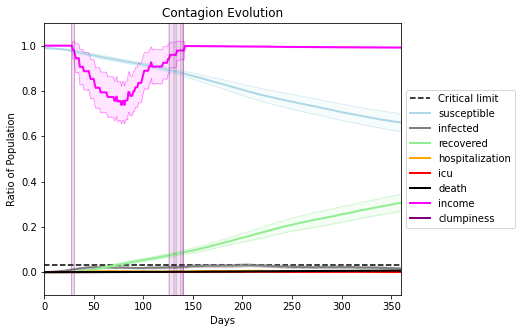

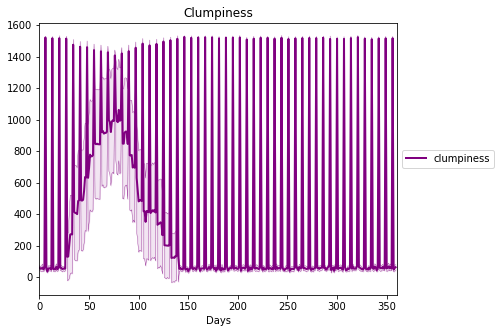

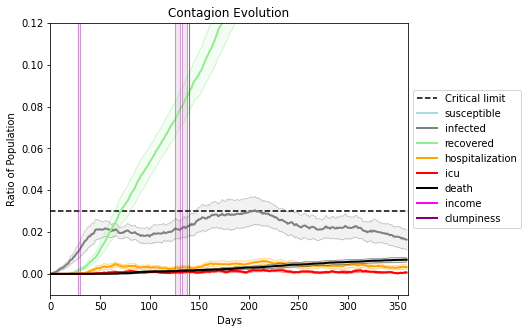

In [24]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = -0.1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[8553, 2807, 1250, 2871, 9726, 5778, 7150, 4977, 9968, 2278, 8653, 1931, 8949, 7285, 8666, 6580, 8264, 5581, 3601, 6307]
Average similarity between family members is 0.15047817541191785 at temperature 0
Average similarity between family and home is 0.999857631831473 at temperature -1
Average similarity between students and their classroom is 0.19478356809161324 at temperature 0
Average classroom occupancy is 1.6206896551724137 and number classrooms is 174
Average similarity between workers is 0.1792026799119138 at temperature 0
Average office occupancy is 3.3523316062176165 and number offices is 193
Average friend similarity for adults: 0.20876443783680754 for kids: 0.22299307616515057
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
Homogen

avg restaurant similarity 0.10126690074765128
avg restaurant similarity 0.10151910067560158
avg restaurant similarity 0.022588755339829944
avg restaurant similarity 0.03324083820315783
avg restaurant similarity 0.023464556392093994
avg restaurant similarity 0.04824963062139477
avg restaurant similarity -0.009075346313294846
avg restaurant similarity 0.07760276746424406
avg restaurant similarity 0.08832927892418754
avg restaurant similarity 0.07025859205532742
avg restaurant similarity 0.23395576181233213
avg restaurant similarity 0.2801246822332067
avg restaurant similarity 0.10295687365399765
avg restaurant similarity 0.09527205067100904
avg restaurant similarity 0.06381679702513647
avg restaurant similarity 0.13118706759120574
avg restaurant similarity 0.1427013538092911
avg restaurant similarity 0.06369881008735162
avg restaurant similarity 0.133255600540887
avg restaurant similarity 0.045717708498667964
avg restaurant similarity 0.15181916436038767
avg restaurant similarity 0.20374

avg restaurant similarity -0.0006861421359927664
avg restaurant similarity 0.25208683406626886
avg restaurant similarity 0.1449318158873272
avg restaurant similarity 0.1852352944073252
avg restaurant similarity 0.0515864748114795
avg restaurant similarity -0.12539529330339816
avg restaurant similarity 0.2891474255258048
avg restaurant similarity 0.25140192475777806
avg restaurant similarity 0.14541196416166954
avg restaurant similarity -0.02544949283385825
avg restaurant similarity 0.02322142327745655
avg restaurant similarity 0.03123297614539738
avg restaurant similarity 0.11145903410225903
avg restaurant similarity -0.011088402692879836
avg restaurant similarity 0.12250544708900045
avg restaurant similarity 0.2097425944768706
avg restaurant similarity 0.22171151411569268
avg restaurant similarity 0.15403102178592004
avg restaurant similarity 0.07318131584222731
avg restaurant similarity 0.06813345932822838
avg restaurant similarity 0.0042677462936729586
avg restaurant similarity -0.0

avg restaurant similarity 0.3060978948460415
avg restaurant similarity 0.061284498099744594
avg restaurant similarity 0.027288306467050286
avg restaurant similarity -0.010659904147748037
avg restaurant similarity 0.10336622114469976
Average similarity between family members is 0.14428145507613677 at temperature 0
Average similarity between family and home is 0.9998492257420055 at temperature -1
Average similarity between students and their classroom is 0.17599584605281093 at temperature 0
Average classroom occupancy is 1.6436170212765957 and number classrooms is 188
Average similarity between workers is 0.14196316931917216 at temperature 0
Average office occupancy is 3.180904522613065 and number offices is 199
Average friend similarity for adults: 0.2158642189610319 for kids: 0.21704258427118442
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in

avg restaurant similarity 0.13239920838688982
avg restaurant similarity 0.07558412495459592
avg restaurant similarity 0.10839130147615503
avg restaurant similarity -0.01319535098894732
avg restaurant similarity -0.10149526375190725
avg restaurant similarity 0.22279279630000803
avg restaurant similarity 0.04647526384598921
avg restaurant similarity 0.10885291384312028
avg restaurant similarity 0.11704540981690194
avg restaurant similarity 0.1513423415551992
avg restaurant similarity 0.0513451716479663
avg restaurant similarity 0.004802697227278391
avg restaurant similarity 0.12025319984003661
avg restaurant similarity 0.2093210374595554
avg restaurant similarity 0.25403780688129285
avg restaurant similarity 0.1694584588136425
avg restaurant similarity 0.16994552388912773
avg restaurant similarity -0.058477158500544205
avg restaurant similarity 0.0922513525880513
avg restaurant similarity -0.020753179569951905
avg restaurant similarity 0.10761908567326853
avg restaurant similarity 0.1393

avg restaurant similarity -0.035218301944673465
avg restaurant similarity 0.1151113703231607
avg restaurant similarity 0.15951617720169128
avg restaurant similarity 0.012250384351513757
avg restaurant similarity 0.1311858734353024
avg restaurant similarity 0.006476901556689618
avg restaurant similarity -0.13371268094178881
avg restaurant similarity 0.23775319050944668
avg restaurant similarity 0.014391516763188126
avg restaurant similarity 0.12003798089485804
avg restaurant similarity 0.1736757505855754
avg restaurant similarity 0.11440449432034244
avg restaurant similarity -0.032163146131431626
avg restaurant similarity 0.20415795754023378
avg restaurant similarity 0.08465273778541862
avg restaurant similarity -0.04681688173545885
avg restaurant similarity 0.12372993727186656
avg restaurant similarity 0.13538527450264615
avg restaurant similarity 0.0226807517950124
avg restaurant similarity 0.13990799104430635
avg restaurant similarity 0.0022476002792654903
avg restaurant similarity 0

avg restaurant similarity 0.3907715531180891
Average similarity between family members is 0.14187001887023987 at temperature 0
Average similarity between family and home is 0.9998604955072422 at temperature -1
Average similarity between students and their classroom is 0.1598597241491378 at temperature 0
Average classroom occupancy is 1.6157894736842104 and number classrooms is 190
Average similarity between workers is 0.1571572559725548 at temperature 0
Average office occupancy is 3.18407960199005 and number offices is 201
Average friend similarity for adults: 0.20558869266372967 for kids: 0.20577561246225984
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 24 people.
Total of 24 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people alloc

avg restaurant similarity 0.007885502403794762
avg restaurant similarity 0.21424989089484503
avg restaurant similarity 0.02620149964676402
avg restaurant similarity 0.07935013184084681
avg restaurant similarity -0.10472070215128813
avg restaurant similarity -0.04838859778099338
avg restaurant similarity 0.13464775744089727
avg restaurant similarity 0.07030918251868717
avg restaurant similarity 0.08346020343910728
avg restaurant similarity -0.0011209902267125225
avg restaurant similarity 0.23243237207467887
avg restaurant similarity -0.09603293623195333
avg restaurant similarity 0.2651250178069387
avg restaurant similarity -0.09657616246781796
avg restaurant similarity 0.05074745412899442
avg restaurant similarity -0.06274523476295171
avg restaurant similarity 0.151801965721456
avg restaurant similarity 0.2146812707557409
avg restaurant similarity 0.024335782941744745
avg restaurant similarity 0.041256311795962126
avg restaurant similarity 0.15910594611495063
avg restaurant similarity 0

avg restaurant similarity -0.021637446099344964
avg restaurant similarity 0.13570857414241552
avg restaurant similarity 0.08939059388034501
avg restaurant similarity -0.030884450726582094
avg restaurant similarity -0.07439277322259286
avg restaurant similarity -0.07614948104647187
avg restaurant similarity 0.07060636471148253
avg restaurant similarity 0.14779914642071085
avg restaurant similarity 0.13770436537942746
avg restaurant similarity -0.013660480879538106
avg restaurant similarity -0.03891475504486282
avg restaurant similarity 0.13196341189484345
avg restaurant similarity 0.02895572555076329
avg restaurant similarity -0.048301694642667065
avg restaurant similarity -0.00927953292881276
avg restaurant similarity -0.03865204768608167
avg restaurant similarity -0.10874043513590032
avg restaurant similarity -0.023965909107794822
avg restaurant similarity 0.3249931805009202
avg restaurant similarity -0.030324636381403716
avg restaurant similarity -0.0893017628151845
avg restaurant si

Average similarity between family and home is 0.999847519604536 at temperature -1
Average similarity between students and their classroom is 0.1497315824499397 at temperature 0
Average classroom occupancy is 1.5154639175257731 and number classrooms is 194
Average similarity between workers is 0.15058873530989578 at temperature 0
Average office occupancy is 3.2364532019704435 and number offices is 203
Average friend similarity for adults: 0.2085944855456691 for kids: 0.21062082269073126
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity 0.09219751697050253
avg restaurant similarity 0.017477334291731213
avg restaurant similarity 0.075096511785826
avg restaurant similarity 0.25434552367846064
avg restaurant similarity 0.1544864639870134
avg restaurant similarity 0.164257723018783
avg restaurant similarity 0.032543901918048325
avg restaurant similarity 0.13576232243318268
avg restaurant similarity 0.2194418210844979
avg restaurant similarity 0.4061726450946718
avg restaurant similarity 0.2065812814505655
avg restaurant similarity 0.03330898401520969
avg restaurant similarity 0.13521580197666927
avg restaurant similarity 0.07123425674400895
avg restaurant similarity 0.08330074097205548
avg restaurant similarity 0.08399155255862922
avg restaurant similarity 0.1445105880466706
avg restaurant similarity 0.15342697427013724
avg restaurant similarity 0.09016394408240326
avg restaurant similarity 0.23928342525295662
avg restaurant similarity 0.0976539233556841
avg restaurant similarity 0.16267890814929

avg restaurant similarity 0.3105620208974334
avg restaurant similarity -0.04823249779072989
avg restaurant similarity 0.17229855745033354
avg restaurant similarity 0.09871333844839066
avg restaurant similarity 0.18487395851917635
avg restaurant similarity 0.08962599426069712
avg restaurant similarity 0.20031609301198913
avg restaurant similarity 0.39478490906982344
avg restaurant similarity 0.3441150017932931
avg restaurant similarity 0.28811269721775573
avg restaurant similarity 0.1568241004080043
avg restaurant similarity 0.16598666427510825
avg restaurant similarity 0.011698762219415222
avg restaurant similarity 0.486381971945008
avg restaurant similarity 0.3340260025463106
avg restaurant similarity 0.26038961823241996
avg restaurant similarity 0.15968104242166234
avg restaurant similarity 0.09992037401818542
avg restaurant similarity -0.06889856642456299
avg restaurant similarity 0.39668963859483447
avg restaurant similarity 0.291221386970468
avg restaurant similarity 0.21178871994

Average similarity between family members is 0.16221672660096043 at temperature 0
Average similarity between family and home is 0.9998522636714077 at temperature -1
Average similarity between students and their classroom is 0.1318578332529989 at temperature 0
Average classroom occupancy is 1.543956043956044 and number classrooms is 182
Average similarity between workers is 0.1730415836206624 at temperature 0
Average office occupancy is 3.32 and number offices is 200
Average friend similarity for adults: 0.20613942004813987 for kids: 0.2118514070930513
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buil

avg restaurant similarity 0.02031040793173208
avg restaurant similarity 0.06582948975171929
avg restaurant similarity 0.023452167017451897
avg restaurant similarity 0.18958640235736385
avg restaurant similarity 0.11756420213439905
avg restaurant similarity 0.12435847308731336
avg restaurant similarity 0.16560661822666015
avg restaurant similarity 0.057516783341904694
avg restaurant similarity 0.008938700197911638
avg restaurant similarity 0.05000461857953673
avg restaurant similarity -0.05598521949902209
avg restaurant similarity -0.034737230999356924
avg restaurant similarity 0.1762017133511363
avg restaurant similarity 0.05048160654403307
avg restaurant similarity 0.0263030915597864
avg restaurant similarity -0.20169636586272394
avg restaurant similarity 0.08615828245885093
avg restaurant similarity 0.04014263933718045
avg restaurant similarity -0.012993842319946968
avg restaurant similarity 0.08326685039386426
avg restaurant similarity 0.08222795568928809
avg restaurant similarity 0

avg restaurant similarity 0.09975761833727362
avg restaurant similarity 0.21564366769853052
avg restaurant similarity 0.20400698086211258
avg restaurant similarity 0.3637230230026431
avg restaurant similarity 0.017027956979018044
avg restaurant similarity -0.28572553699335873
avg restaurant similarity 0.14934366325174486
avg restaurant similarity 0.1527099477170743
avg restaurant similarity -0.03365900472586651
avg restaurant similarity 0.24604952854985318
avg restaurant similarity 0.06440718960853452
avg restaurant similarity 0.045890975304129444
avg restaurant similarity 0.06416266588508893
avg restaurant similarity -0.1085648006133238
avg restaurant similarity 0.1984352511375087
avg restaurant similarity 0.19289944455442717
avg restaurant similarity 0.2520233895778077
avg restaurant similarity 0.23081336708840403
avg restaurant similarity 0.10913503633802143
avg restaurant similarity 0.0916690755186168
avg restaurant similarity -0.0019811281905844566
avg restaurant similarity 0.2022

avg restaurant similarity 0.05251038591602898
Average similarity between family members is 0.17511527017761774 at temperature 0
Average similarity between family and home is 0.9998535671572077 at temperature -1
Average similarity between students and their classroom is 0.14273035520807015 at temperature 0
Average classroom occupancy is 1.5932203389830508 and number classrooms is 177
Average similarity between workers is 0.14572098931621566 at temperature 0
Average office occupancy is 3.317073170731707 and number offices is 205
Average friend similarity for adults: 0.2104429486982568 for kids: 0.2056384911897105
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 people alloc

avg restaurant similarity 0.05712455683196205
avg restaurant similarity 0.049461761745130554
avg restaurant similarity 0.004352266443816433
avg restaurant similarity 0.14176116559172228
avg restaurant similarity 0.2844032152793467
avg restaurant similarity -0.11269130791313334
avg restaurant similarity -0.015476943342290272
avg restaurant similarity 0.06299713631821417
avg restaurant similarity -0.06292712813926342
avg restaurant similarity 0.019998030628569956
avg restaurant similarity 0.014503876404576052
avg restaurant similarity -0.050524739438042816
avg restaurant similarity -0.13490931882503282
avg restaurant similarity 0.05999457360423145
avg restaurant similarity 0.04623917052949042
avg restaurant similarity -0.1631501854663535
avg restaurant similarity -0.038773898422623417
avg restaurant similarity -0.05349616779820941
avg restaurant similarity -0.0614346564506995
avg restaurant similarity 0.10710459360210632
avg restaurant similarity 0.12496318979102224
avg restaurant simila

avg restaurant similarity 0.01757612689402162
avg restaurant similarity 0.0965205934132727
avg restaurant similarity 0.27801706431488055
avg restaurant similarity 0.13117805920003664
avg restaurant similarity 0.03675477900044169
avg restaurant similarity 0.11170380868862015
avg restaurant similarity 0.022139776645559606
avg restaurant similarity 0.08240080938330509
avg restaurant similarity 0.06473031479739436
avg restaurant similarity -0.025147582567102075
avg restaurant similarity 0.3097488046805643
avg restaurant similarity 0.16498058879832989
avg restaurant similarity 0.02560714848932114
avg restaurant similarity 0.081408304781266
avg restaurant similarity 0.07537922178799643
avg restaurant similarity 0.11754550486125981
avg restaurant similarity 0.10585776260979587
avg restaurant similarity 0.18465378320181192
avg restaurant similarity -0.07545307647839548
avg restaurant similarity 0.18460699767820177
avg restaurant similarity 0.01850865944730517
avg restaurant similarity 0.181348

Average similarity between family and home is 0.9998487972381217 at temperature -1
Average similarity between students and their classroom is 0.16535008527951872 at temperature 0
Average classroom occupancy is 1.5977011494252873 and number classrooms is 174
Average similarity between workers is 0.1386396203327156 at temperature 0
Average office occupancy is 3.2955665024630543 and number offices is 203
Average friend similarity for adults: 0.20687911487940358 for kids: 0.21415486282821528
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peo

avg restaurant similarity 0.07505205106114407
avg restaurant similarity 0.09957006070998127
avg restaurant similarity 0.11619974840884842
avg restaurant similarity 0.07979364113151917
avg restaurant similarity 0.165735468561026
avg restaurant similarity 0.19296518630777076
avg restaurant similarity 0.10771135216012712
avg restaurant similarity 0.025343537245216482
avg restaurant similarity -0.026375274599938575
avg restaurant similarity 0.09834287695183137
avg restaurant similarity 0.227346407448259
avg restaurant similarity 0.16940485701222432
avg restaurant similarity 0.11104522525081972
avg restaurant similarity -0.022949787135287985
avg restaurant similarity 0.2188159976219351
avg restaurant similarity -0.03071785218841394
avg restaurant similarity 0.15844448949664805
avg restaurant similarity 0.13325865014138982
avg restaurant similarity 0.20679313386470025
avg restaurant similarity -0.016731056556072668
avg restaurant similarity 0.07861080009424733
avg restaurant similarity 0.106

avg restaurant similarity -0.007522530251505086
avg restaurant similarity -0.019182887118409146
avg restaurant similarity 0.014541795002094753
avg restaurant similarity 0.07167078153835817
avg restaurant similarity 0.02972175880913397
avg restaurant similarity 0.05208844202142506
avg restaurant similarity 0.24737650739219816
avg restaurant similarity 0.41846684872402323
avg restaurant similarity 0.08673072341465515
avg restaurant similarity 0.24797686031497101
avg restaurant similarity 0.1163416629973545
avg restaurant similarity 0.10052489482253683
avg restaurant similarity 0.23881070830813705
avg restaurant similarity -0.01727676803114418
avg restaurant similarity 0.17275743655829878
avg restaurant similarity 0.21588061129724623
avg restaurant similarity 0.02683386466964762
avg restaurant similarity 0.07403482685561706
avg restaurant similarity 0.12696350634894416
avg restaurant similarity 0.02451679640747409
avg restaurant similarity 0.05700681415024306
avg restaurant similarity 0.0

avg restaurant similarity 0.11978269393189415
avg restaurant similarity 0.2886021702953321
Average similarity between family members is 0.16156514400668218 at temperature 0
Average similarity between family and home is 0.9998360576610341 at temperature -1
Average similarity between students and their classroom is 0.17806138743726746 at temperature 0
Average classroom occupancy is 1.6519337016574585 and number classrooms is 181
Average similarity between workers is 0.1387646408267428 at temperature 0
Average office occupancy is 3.308080808080808 and number offices is 198
Average friend similarity for adults: 0.20667677925729977 for kids: 0.21104859273098175
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units wit

avg restaurant similarity 0.14607949641289558
avg restaurant similarity 0.022976880677019643
avg restaurant similarity 0.18019452211327686
avg restaurant similarity 0.0004787630607070367
avg restaurant similarity -0.16395399035902689
avg restaurant similarity 0.009559238298810219
avg restaurant similarity 0.30344647321224205
avg restaurant similarity 0.1754479030579321
avg restaurant similarity 0.23580558522524023
avg restaurant similarity -0.1480169123852537
avg restaurant similarity 0.1086296625329657
avg restaurant similarity 0.12396564482427398
avg restaurant similarity 0.12528849419199223
avg restaurant similarity 0.29128955447892263
avg restaurant similarity 0.20310851349048273
avg restaurant similarity 0.22249541392522568
avg restaurant similarity -0.20391568500904242
avg restaurant similarity 0.11064558772873061
avg restaurant similarity 0.14873544439633027
avg restaurant similarity 0.11345265997897565
avg restaurant similarity 0.17986702010825822
avg restaurant similarity 0.11

avg restaurant similarity -0.05295795961999097
avg restaurant similarity 0.002636272916312595
avg restaurant similarity 0.13018978214579596
avg restaurant similarity 0.14353242760771118
avg restaurant similarity 0.13422276281034362
avg restaurant similarity 0.05245480228826671
avg restaurant similarity -0.013807947170239065
avg restaurant similarity 0.09486373687090423
avg restaurant similarity -0.28712208724001625
avg restaurant similarity 0.036672343683121784
avg restaurant similarity -0.022943188059269204
avg restaurant similarity 0.314038777632231
avg restaurant similarity -0.12257501159508513
avg restaurant similarity 0.12908843328369887
avg restaurant similarity -0.011394299587851226
avg restaurant similarity 0.18156009611840976
avg restaurant similarity 0.05485190275021379
avg restaurant similarity -0.08931531040185332
avg restaurant similarity 0.18819404827739203
avg restaurant similarity 0.03712146608021682
avg restaurant similarity 0.1206591439977776
avg restaurant similarity

avg restaurant similarity 0.13198569697588589
avg restaurant similarity 0.25044131120579705
Average similarity between family members is 0.1486522566593873 at temperature 0
Average similarity between family and home is 0.9998555751118094 at temperature -1
Average similarity between students and their classroom is 0.14686888108681442 at temperature 0
Average classroom occupancy is 1.5895953757225434 and number classrooms is 173
Average similarity between workers is 0.1298816742928007 at temperature 0
Average office occupancy is 3.381188118811881 and number offices is 202
Average friend similarity for adults: 0.20571273511182717 for kids: 0.2055554913550708
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units wi

avg restaurant similarity -0.017072792621348625
avg restaurant similarity 0.07365717571584657
avg restaurant similarity 0.0021121894329799744
avg restaurant similarity 0.3491650271194675
avg restaurant similarity -0.07112880935877544
avg restaurant similarity 0.1570900333891265
avg restaurant similarity -0.08983678947776887
avg restaurant similarity 0.2874481579639609
avg restaurant similarity -0.00040890264017441765
avg restaurant similarity -0.03021176491906862
avg restaurant similarity 0.17452383878183175
avg restaurant similarity 0.17193696067751846
avg restaurant similarity -0.24384864186528984
avg restaurant similarity 0.026567035314674126
avg restaurant similarity 0.10372443299258846
avg restaurant similarity -0.21943390270946678
avg restaurant similarity 0.11887694141976474
avg restaurant similarity 0.19914392227324954
avg restaurant similarity -0.034111977924627675
avg restaurant similarity -0.0018983353239090247
avg restaurant similarity 0.19731084219318998
avg restaurant sim

avg restaurant similarity -0.07966267439799733
avg restaurant similarity -0.06927600471273822
avg restaurant similarity 0.13832386262240964
avg restaurant similarity -0.45212247446903014
avg restaurant similarity 0.17094849743110724
avg restaurant similarity 0.10577074573346296
avg restaurant similarity -0.05214755694202826
avg restaurant similarity 0.12246464597273013
avg restaurant similarity 0.0329904247974003
avg restaurant similarity 0.10430407299564823
avg restaurant similarity 0.11209929702412125
avg restaurant similarity 0.04086280513362778
avg restaurant similarity 0.10208649461477169
avg restaurant similarity 0.049277213555602925
avg restaurant similarity 0.07769209346296316
avg restaurant similarity 0.07272811962925878
avg restaurant similarity -0.32118644989416617
avg restaurant similarity 0.08269973229781559
avg restaurant similarity -0.020494237961045457
avg restaurant similarity 0.02638275923855006
avg restaurant similarity 0.09347259644844437
avg restaurant similarity 0

Average similarity between family and home is 0.9998560481686634 at temperature -1
Average similarity between students and their classroom is 0.14780814914310333 at temperature 0
Average classroom occupancy is 1.5879120879120878 and number classrooms is 182
Average similarity between workers is 0.1652233759095926 at temperature 0
Average office occupancy is 3.179611650485437 and number offices is 206
Average friend similarity for adults: 0.20610157737438295 for kids: 0.21293872079305265
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peop

avg restaurant similarity 0.1709226970007428
avg restaurant similarity -0.1306907510038881
avg restaurant similarity 0.33797225003312303
avg restaurant similarity -0.043959639618499635
avg restaurant similarity 0.06116126548585452
avg restaurant similarity 0.13195377785923804
avg restaurant similarity 0.1902783433446234
avg restaurant similarity 0.12043206188537642
avg restaurant similarity 0.06541212374711572
avg restaurant similarity 0.334642982381447
avg restaurant similarity 0.02707886263765249
avg restaurant similarity 0.057203955252007374
avg restaurant similarity 0.2670579005792273
avg restaurant similarity 0.08627993120775324
avg restaurant similarity 0.006965214833881221
avg restaurant similarity 0.08917077076963233
avg restaurant similarity 0.05504460453655349
avg restaurant similarity -0.06141204266268485
avg restaurant similarity 0.1534544743291438
avg restaurant similarity -0.0003588965784182274
avg restaurant similarity 0.08413314035918923
avg restaurant similarity -0.072

avg restaurant similarity 0.10061503538377385
avg restaurant similarity -0.0342080603663558
avg restaurant similarity 0.007427716901969595
avg restaurant similarity 0.4005715615678642
avg restaurant similarity 0.35742698890455793
avg restaurant similarity 0.0639652141198567
avg restaurant similarity 0.025568163020484563
avg restaurant similarity 0.11803876364424118
avg restaurant similarity -0.020496213277589295
avg restaurant similarity 0.11710128134512328
avg restaurant similarity -0.06074995868115692
avg restaurant similarity 0.06420958093160765
avg restaurant similarity -0.12402401146510632
avg restaurant similarity -0.017914214654453437
avg restaurant similarity -0.0746772307623852
avg restaurant similarity 0.34154108032533476
avg restaurant similarity 0.21076886127726058
avg restaurant similarity 0.19170790353131073
avg restaurant similarity 0.04506228058150339
avg restaurant similarity -0.057613847966580985
avg restaurant similarity -0.055178709957997084
avg restaurant similarit

Average similarity between workers is 0.14558570904906828 at temperature 0
Average office occupancy is 3.2524752475247523 and number offices is 202
Average friend similarity for adults: 0.21167744992603807 for kids: 0.2085538997024359
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 pe

avg restaurant similarity 0.044895880810060906
avg restaurant similarity 0.1778204777982403
avg restaurant similarity 0.023054029703325138
avg restaurant similarity 0.07960967109210945
avg restaurant similarity 0.10538723535674376
avg restaurant similarity 0.11673413753060154
avg restaurant similarity 0.08823278244144137
avg restaurant similarity 0.21786587208151606
avg restaurant similarity 0.0371695354757132
avg restaurant similarity 0.007174940076116905
avg restaurant similarity -0.03061597920969234
avg restaurant similarity 0.15059651068533045
avg restaurant similarity 0.08074597129442505
avg restaurant similarity 0.18254811080466726
avg restaurant similarity 0.23868218650562945
avg restaurant similarity 0.06590787794432394
avg restaurant similarity 0.04636451101135987
avg restaurant similarity 0.10564379928353836
avg restaurant similarity -0.010955033507162633
avg restaurant similarity 0.05738832428166583
avg restaurant similarity -0.06942950210296324
avg restaurant similarity 0.0

avg restaurant similarity 0.21316328137377683
avg restaurant similarity 0.12812471765176217
avg restaurant similarity 0.09610073384308923
avg restaurant similarity 0.15216012276171875
avg restaurant similarity -0.06757676925217239
avg restaurant similarity 0.260812339621984
avg restaurant similarity 0.11758313655151291
avg restaurant similarity -0.0027569976932302898
avg restaurant similarity -0.00984868767379584
avg restaurant similarity 0.040118282634278524
avg restaurant similarity 0.14263664728336406
avg restaurant similarity -9.367473855280417e-05
avg restaurant similarity 0.12533697059145746
avg restaurant similarity 0.044696132685833306
avg restaurant similarity 0.10888048863660783
avg restaurant similarity 0.08767546119310336
avg restaurant similarity 0.06409834547605196
avg restaurant similarity 0.11357936274732147
avg restaurant similarity -0.04582268933940336
avg restaurant similarity -0.013168270116978166
avg restaurant similarity 0.029305453413645304
avg restaurant similar

avg restaurant similarity 0.17007455600506313
avg restaurant similarity -0.031886641623461554
avg restaurant similarity -0.04129952748068376
avg restaurant similarity 0.04090548169366585
avg restaurant similarity 0.039274636933112075
Average similarity between family members is 0.13131349038591736 at temperature 0
Average similarity between family and home is 0.9998484214676965 at temperature -1
Average similarity between students and their classroom is 0.15697810808760104 at temperature 0
Average classroom occupancy is 1.5964912280701755 and number classrooms is 171
Average similarity between workers is 0.15861768898068634 at temperature 0
Average office occupancy is 3.284313725490196 and number offices is 204
Average friend similarity for adults: 0.20167894560421162 for kids: 0.22462811719174566
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 18 people.
Total of 18 people allocate

avg restaurant similarity -0.01660969379486725
avg restaurant similarity -0.00802919890678263
avg restaurant similarity -0.04702783035241859
avg restaurant similarity 0.043958823645643866
avg restaurant similarity -0.07373261605893924
avg restaurant similarity 0.18703093085528055
avg restaurant similarity 0.2973010756447067
avg restaurant similarity -0.049784201275595685
avg restaurant similarity -0.09935011920428301
avg restaurant similarity 0.1431644694040507
avg restaurant similarity 0.001101110251195317
avg restaurant similarity -0.08426977967119109
avg restaurant similarity 0.06831139973619503
avg restaurant similarity -0.03701451187525543
avg restaurant similarity 0.0844452782422956
avg restaurant similarity 0.03497282849774928
avg restaurant similarity 0.1385781294988452
avg restaurant similarity 0.031283567255717015
avg restaurant similarity 0.09583931213344954
avg restaurant similarity 0.05852702105588909
avg restaurant similarity -0.08233623709077129
avg restaurant similarity

avg restaurant similarity 0.29600140351735904
avg restaurant similarity 0.2737127655590678
avg restaurant similarity -0.09459515002049672
avg restaurant similarity 0.1629158244834909
avg restaurant similarity 0.17271521484189822
avg restaurant similarity 0.015111870863331659
avg restaurant similarity 0.03465413047798814
avg restaurant similarity 0.08117380160024362
avg restaurant similarity 0.29167171396046027
avg restaurant similarity -0.020249693508993763
avg restaurant similarity 0.17628474245820636
avg restaurant similarity -0.0202130078275191
avg restaurant similarity 0.11515118113692764
avg restaurant similarity 0.05335384001077438
avg restaurant similarity 0.17028212765144662
avg restaurant similarity 0.0125406595782581
avg restaurant similarity 0.04510830439035775
avg restaurant similarity 0.026984702595366197
avg restaurant similarity 0.19845913314127647
avg restaurant similarity 0.03408679539318295
avg restaurant similarity 0.040637281771865694
avg restaurant similarity 0.043

avg restaurant similarity 0.3789819145107483
avg restaurant similarity 0.12283304531770295
avg restaurant similarity 0.15442926849686167
avg restaurant similarity -0.07336707519651989
avg restaurant similarity -0.02072122457455158
Average similarity between family members is 0.16205808460443416 at temperature 0
Average similarity between family and home is 0.9998559792303875 at temperature -1
Average similarity between students and their classroom is 0.20607718278623124 at temperature 0
Average classroom occupancy is 1.6395348837209303 and number classrooms is 172
Average similarity between workers is 0.1745699290773478 at temperature 0
Average office occupancy is 3.243781094527363 and number offices is 201
Average friend similarity for adults: 0.2092038586515832 for kids: 0.19983755196170436
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in th

avg restaurant similarity -0.03801402590509386
avg restaurant similarity 0.12595924692507052
avg restaurant similarity -0.09376056987419595
avg restaurant similarity 0.18977800353628058
avg restaurant similarity 0.17123672669291365
avg restaurant similarity -0.05653548379347847
avg restaurant similarity 0.27935517835586426
avg restaurant similarity 0.3381885092216152
avg restaurant similarity 0.06316273368006844
avg restaurant similarity 0.09001818882019814
avg restaurant similarity 0.22568439556144207
avg restaurant similarity 0.06229021404558372
avg restaurant similarity -0.17127805743871793
avg restaurant similarity 0.11888448811458989
avg restaurant similarity 0.08512413645095006
avg restaurant similarity 0.02952113852278439
avg restaurant similarity 0.02559079463970015
avg restaurant similarity 0.2059962548512459
avg restaurant similarity 0.13080649594209529
avg restaurant similarity -0.1332220001105095
avg restaurant similarity 0.02582203429836306
avg restaurant similarity 0.1630

avg restaurant similarity 0.24165524153138732
avg restaurant similarity -0.049753523604691124
avg restaurant similarity -0.016033298478971184
avg restaurant similarity 0.03295458036064626
avg restaurant similarity 0.26999386643484447
avg restaurant similarity -0.05076839408336675
avg restaurant similarity -0.021451373410512453
avg restaurant similarity 0.19169548482269216
avg restaurant similarity 0.019321264130289
avg restaurant similarity 0.12312394505201862
avg restaurant similarity 0.059336710427262365
avg restaurant similarity -0.10193747613917584
avg restaurant similarity -0.010227910902573602
avg restaurant similarity -0.03478316183732402
avg restaurant similarity -0.09022762884854824
avg restaurant similarity 0.2800645164679399
avg restaurant similarity 0.16147849053575258
avg restaurant similarity 0.17265890949739368
avg restaurant similarity -0.12763987945333585
avg restaurant similarity 0.24892798738184796
avg restaurant similarity 0.043088681993114525
avg restaurant similar

Average similarity between family and home is 0.9998618012114776 at temperature -1
Average similarity between students and their classroom is 0.1669511145907472 at temperature 0
Average classroom occupancy is 1.7150837988826815 and number classrooms is 179
Average similarity between workers is 0.15992977305014544 at temperature 0
Average office occupancy is 3.142857142857143 and number offices is 203
Average friend similarity for adults: 0.21121306327570213 for kids: 0.21435313785743268
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people

avg restaurant similarity 0.02388906195807239
avg restaurant similarity 0.053337154758040385
avg restaurant similarity 0.16532390901322852
avg restaurant similarity 0.1515401937539693
avg restaurant similarity 0.0561435267486255
avg restaurant similarity 0.3652525716705837
avg restaurant similarity 0.07759645417416958
avg restaurant similarity 0.0718832324411404
avg restaurant similarity 0.20511519768501113
avg restaurant similarity 0.19196355805446266
avg restaurant similarity 0.20534166553793848
avg restaurant similarity -0.07930936999532884
avg restaurant similarity -0.11445560336004812
avg restaurant similarity 0.08927077392810988
avg restaurant similarity 0.13738997527759866
avg restaurant similarity 0.14680020104874653
avg restaurant similarity 0.3212312716963926
avg restaurant similarity -0.03258485807535963
avg restaurant similarity 0.08306666944840597
avg restaurant similarity -0.07274476656152773
avg restaurant similarity 0.1163109466880834
avg restaurant similarity 0.0502026

avg restaurant similarity 0.21995801451832406
avg restaurant similarity 0.3147516019783047
avg restaurant similarity 0.10569822019267168
avg restaurant similarity 0.08107246099508392
avg restaurant similarity 0.08045848155459727
avg restaurant similarity -0.07145558432558628
avg restaurant similarity 0.035190686377878415
avg restaurant similarity 0.17096971996081495
avg restaurant similarity 0.2520472193564007
avg restaurant similarity 0.013159937225403437
avg restaurant similarity 0.26650994858164795
avg restaurant similarity 0.3449394069192593
avg restaurant similarity 0.03859290265912896
avg restaurant similarity -0.0404513993856961
avg restaurant similarity 0.06956814995642832
avg restaurant similarity 0.20122366283495827
avg restaurant similarity -0.04840778277967373
avg restaurant similarity 0.1187079784199935
avg restaurant similarity 0.2863880896330914
avg restaurant similarity 0.04154357298458065
avg restaurant similarity -0.03312500735095324
avg restaurant similarity 0.161503

Average similarity between family and home is 0.9998529736666621 at temperature -1
Average similarity between students and their classroom is 0.17126815295671563 at temperature 0
Average classroom occupancy is 1.6079545454545454 and number classrooms is 176
Average similarity between workers is 0.14648296612749914 at temperature 0
Average office occupancy is 3.2205882352941178 and number offices is 204
Average friend similarity for adults: 0.19759432043498074 for kids: 0.20793940634256536
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 pe

avg restaurant similarity 0.06158010379830209
avg restaurant similarity 0.08963859360256385
avg restaurant similarity 0.09874483239866372
avg restaurant similarity -0.055419359268886643
avg restaurant similarity 0.08088826602525123
avg restaurant similarity 0.07251808799641718
avg restaurant similarity 0.13435222767747443
avg restaurant similarity 0.012857642244086368
avg restaurant similarity 0.16284628701619147
avg restaurant similarity 0.008998893196512177
avg restaurant similarity 0.259372439690464
avg restaurant similarity 0.0032209186146564183
avg restaurant similarity 0.1934871258179386
avg restaurant similarity 0.13241517197023492
avg restaurant similarity 0.1229503524515134
avg restaurant similarity 0.1387531612087361
avg restaurant similarity 0.07118981785664481
avg restaurant similarity 0.09536996854995147
avg restaurant similarity -0.13597211938203946
avg restaurant similarity 0.24708154283772044
avg restaurant similarity 0.3317334969253102
avg restaurant similarity 0.10037

avg restaurant similarity 0.14320927672612446
avg restaurant similarity 0.15646611959090836
avg restaurant similarity 0.10054657962076571
avg restaurant similarity 0.04067769633692775
avg restaurant similarity 0.09174357643550723
avg restaurant similarity 0.03067400580463889
avg restaurant similarity 0.04535324993439205
avg restaurant similarity 0.19323680199160023
avg restaurant similarity -0.02849886065030817
avg restaurant similarity 0.06511643120281602
avg restaurant similarity 0.11419814876112379
avg restaurant similarity 0.06165840343453173
avg restaurant similarity 0.038550313479382745
avg restaurant similarity -0.047206038467911875
avg restaurant similarity 0.2990392392189512
avg restaurant similarity 0.05970046510659898
avg restaurant similarity 0.17107675782279405
avg restaurant similarity 0.23744234266105202
avg restaurant similarity -0.06730939012077894
avg restaurant similarity 0.013327437641977479
avg restaurant similarity -0.04727320265838121
avg restaurant similarity 0.

avg restaurant similarity 0.08408217308183809
avg restaurant similarity 0.06069580117183537
avg restaurant similarity 0.10111703634470395
Average similarity between family members is 0.15888890582485427 at temperature 0
Average similarity between family and home is 0.9998591440778803 at temperature -1
Average similarity between students and their classroom is 0.16467607971973855 at temperature 0
Average classroom occupancy is 1.7098445595854923 and number classrooms is 193
Average similarity between workers is 0.16415052306460065 at temperature 0
Average office occupancy is 3.1055276381909547 and number offices is 199
Average friend similarity for adults: 0.2163565879224867 for kids: 0.21297396919581607
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each 

avg restaurant similarity 0.029115651135395264
avg restaurant similarity -0.010335328023901458
avg restaurant similarity 0.16581781574774557
avg restaurant similarity 0.010147824746528589
avg restaurant similarity 0.05257687162404596
avg restaurant similarity 0.24396336174222263
avg restaurant similarity 0.09949054313819056
avg restaurant similarity 0.16533748424051856
avg restaurant similarity 0.005877390773513111
avg restaurant similarity 0.06047371981287601
avg restaurant similarity 0.04211316644139457
avg restaurant similarity 0.08413402123082896
avg restaurant similarity 0.09606877967883683
avg restaurant similarity 0.2786708179057361
avg restaurant similarity 0.19285881281261857
avg restaurant similarity 0.10020233620536986
avg restaurant similarity 0.16687843361106838
avg restaurant similarity 0.1650294819113838
avg restaurant similarity 0.12480591557148075
avg restaurant similarity 0.13830409083682443
avg restaurant similarity 0.2721625475166004
avg restaurant similarity 0.1580

avg restaurant similarity 0.18567557181289765
avg restaurant similarity 0.4315434060958516
avg restaurant similarity 0.4803263899485968
avg restaurant similarity 0.16032066400074174
avg restaurant similarity 0.00879689111681651
avg restaurant similarity 0.15989352798826378
avg restaurant similarity 0.1232506220817181
avg restaurant similarity 0.13972365793919664
avg restaurant similarity 0.20667127423502016
avg restaurant similarity 0.03592600864910275
avg restaurant similarity 0.0841496615972947
avg restaurant similarity 0.009776683455076528
avg restaurant similarity 0.07532006249278764
avg restaurant similarity 0.09183463144328453
avg restaurant similarity 0.0006182031729427302
avg restaurant similarity 0.040307336517201885
avg restaurant similarity 0.2051788679814629
avg restaurant similarity 0.09018451907779954
avg restaurant similarity 0.002873794017003606
avg restaurant similarity 0.021102601085811502
avg restaurant similarity 0.1612315131786877
avg restaurant similarity 0.006061

avg restaurant similarity 0.036039859835931685
avg restaurant similarity 0.1746015081895949
avg restaurant similarity 0.00437240750934117
avg restaurant similarity 0.08277614952134035
Average similarity between family members is 0.15085187685679374 at temperature 0
Average similarity between family and home is 0.9998514512391168 at temperature -1
Average similarity between students and their classroom is 0.15416229902407383 at temperature 0
Average classroom occupancy is 1.5397727272727273 and number classrooms is 176
Average similarity between workers is 0.16078639277510537 at temperature 0
Average office occupancy is 3.4207920792079207 and number offices is 202
Average friend similarity for adults: 0.2128571118306724 for kids: 0.2281427170119366
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (1,0) district with 1 Bui

avg restaurant similarity -0.10235616700245682
avg restaurant similarity 0.03459791099538358
avg restaurant similarity 0.095366940898703
avg restaurant similarity 0.0550536628423142
avg restaurant similarity 0.19421874624040159
avg restaurant similarity -0.15881127119383392
avg restaurant similarity -0.18640677886270984
avg restaurant similarity -0.010133766740053349
avg restaurant similarity 0.005219319660525008
avg restaurant similarity 0.031037757618829695
avg restaurant similarity 0.04938413025364564
avg restaurant similarity 0.07630034656119318
avg restaurant similarity 0.0657730985419667
avg restaurant similarity -0.17279408739340474
avg restaurant similarity 0.05924526019523178
avg restaurant similarity 0.22214196589596388
avg restaurant similarity 0.1573481416224249
avg restaurant similarity 0.13903898436615955
avg restaurant similarity 0.04524495547895839
avg restaurant similarity 0.15147863068265807
avg restaurant similarity -0.013259434317376107
avg restaurant similarity -0.

avg restaurant similarity 0.11184785009740915
avg restaurant similarity -0.12199847045046608
avg restaurant similarity 0.12763141221342278
avg restaurant similarity -0.002404375428269549
avg restaurant similarity 0.10041046716823487
avg restaurant similarity 0.014626027886609142
avg restaurant similarity 0.01459202117649836
avg restaurant similarity 0.03576487587178399
avg restaurant similarity 0.08264028984646589
avg restaurant similarity -0.02555291224612132
avg restaurant similarity 0.16699737918231236
avg restaurant similarity 0.2841939902770268
avg restaurant similarity 0.22494114364130194
avg restaurant similarity 0.2426028650168606
avg restaurant similarity -0.03168368092209878
avg restaurant similarity 0.6900501956571856
avg restaurant similarity 0.11984460933314806
avg restaurant similarity 0.22805056777278232
avg restaurant similarity -0.05429071561584974
avg restaurant similarity 0.042647086588087926
avg restaurant similarity -0.03689267916858057
avg restaurant similarity 0.

avg restaurant similarity 0.13570652926746501
avg restaurant similarity 0.08468832695072424
avg restaurant similarity -0.19112344204232645
avg restaurant similarity -0.008256083648565019
Average similarity between family members is 0.16055871584540854 at temperature 0
Average similarity between family and home is 0.9998586054898138 at temperature -1
Average similarity between students and their classroom is 0.13342130993716175 at temperature 0
Average classroom occupancy is 1.6685082872928176 and number classrooms is 181
Average similarity between workers is 0.1460221641285823 at temperature 0
Average office occupancy is 3.2562814070351758 and number offices is 199
Average friend similarity for adults: 0.20173156191844785 for kids: 0.20614810030931144
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with

avg restaurant similarity 0.16162136675861916
avg restaurant similarity 0.09829539358913485
avg restaurant similarity -0.008079660012612394
avg restaurant similarity 0.1271277210394855
avg restaurant similarity 0.15887506230602808
avg restaurant similarity 0.12718152443689545
avg restaurant similarity 0.11511174183782014
avg restaurant similarity 0.23929749755648935
avg restaurant similarity 0.27102643110129804
avg restaurant similarity 0.14673264259479882
avg restaurant similarity 0.11584989097950406
avg restaurant similarity 0.14321600128361364
avg restaurant similarity -0.1393803370879541
avg restaurant similarity 0.16545006134735224
avg restaurant similarity 0.12453062171748397
avg restaurant similarity 0.13962025188816185
avg restaurant similarity -0.11895253700999858
avg restaurant similarity 0.12216638633252656
avg restaurant similarity 0.1490590598786269
avg restaurant similarity 0.14868160893589955
avg restaurant similarity 0.0925401501569182
avg restaurant similarity 0.078409

avg restaurant similarity -0.005204388233805722
avg restaurant similarity 0.1471701445444118
avg restaurant similarity 0.0157528098585694
avg restaurant similarity 0.15691501469920666
avg restaurant similarity 0.13015201634699392
avg restaurant similarity 0.0062642983260757295
avg restaurant similarity 0.34655021428976723
avg restaurant similarity -0.03242338617295651
avg restaurant similarity 0.16562983020322103
avg restaurant similarity 0.12268593651755583
avg restaurant similarity 0.012082625230019012
avg restaurant similarity 0.0783315161854113
avg restaurant similarity 0.12660002259545938
avg restaurant similarity 0.318089459391467
avg restaurant similarity 0.08409709316216503
avg restaurant similarity 0.004118846519581673
avg restaurant similarity -0.009904079664220848
avg restaurant similarity 0.10490980307674372
avg restaurant similarity 0.07443252917158215
avg restaurant similarity 0.07671309002154314
avg restaurant similarity 0.0708486750829043
avg restaurant similarity 0.173

Average similarity between students and their classroom is 0.16975833328855353 at temperature 0
Average classroom occupancy is 1.5795454545454546 and number classrooms is 176
Average similarity between workers is 0.12911036017794816 at temperature 0
Average office occupancy is 3.272277227722772 and number offices is 202
Average friend similarity for adults: 0.20633049276296486 for kids: 0.2188331828788453
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 12 people.
Total of 12 people allocated in t

avg restaurant similarity 0.13585332297055216
avg restaurant similarity 0.008288697647495992
avg restaurant similarity 0.16670882492494749
avg restaurant similarity 0.17475546873729764
avg restaurant similarity 0.042166286392114234
avg restaurant similarity 0.1621352937779418
avg restaurant similarity 0.18869850348982925
avg restaurant similarity 0.06937801070144274
avg restaurant similarity 0.007054941365546569
avg restaurant similarity -0.022195434675978107
avg restaurant similarity 0.1357146215462327
avg restaurant similarity -0.22322593466458102
avg restaurant similarity 0.004238891712155728
avg restaurant similarity 0.07166404888289067
avg restaurant similarity 0.0117076022276974
avg restaurant similarity 0.1574037338006729
avg restaurant similarity 0.061657770621594485
avg restaurant similarity 0.14441380467295223
avg restaurant similarity 0.1500408490859752
avg restaurant similarity 0.15791341167001086
avg restaurant similarity 0.06977947285890114
avg restaurant similarity 0.024

avg restaurant similarity -0.005256250445049307
avg restaurant similarity 0.04692936059760104
avg restaurant similarity 0.15446010041350108
avg restaurant similarity -0.1399441798988161
avg restaurant similarity -0.054554590608826344
avg restaurant similarity 0.14727848396683968
avg restaurant similarity 0.10597538231418309
avg restaurant similarity -0.020421401857507678
avg restaurant similarity 0.043208868278502115
avg restaurant similarity 0.0805428571380262
avg restaurant similarity 0.22063507172844662
avg restaurant similarity 0.032950402276726506
avg restaurant similarity 0.030572230288065105
avg restaurant similarity 0.08895793188433068
avg restaurant similarity -0.08150680037270823
avg restaurant similarity 0.4142125277935385
avg restaurant similarity 0.009103511697657815
avg restaurant similarity 0.1690894618915805
avg restaurant similarity 0.18983649532343655
avg restaurant similarity 0.14941512177125102
avg restaurant similarity 0.5519504680306142
avg restaurant similarity 0

Average similarity between family members is 0.13417592670574216 at temperature 0
Average similarity between family and home is 0.9998533839262849 at temperature -1
Average similarity between students and their classroom is 0.1849731772848011 at temperature 0
Average classroom occupancy is 1.5865921787709498 and number classrooms is 179
Average similarity between workers is 0.14856263755837265 at temperature 0
Average office occupancy is 3.2107843137254903 and number offices is 204
Average friend similarity for adults: 0.20341087636537147 for kids: 0.1968729894883561
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) dist

avg restaurant similarity -0.16445733739363336
avg restaurant similarity 0.07417959975988693
avg restaurant similarity 0.027472668211833712
avg restaurant similarity 0.0918959059896141
avg restaurant similarity -0.058523088608690634
avg restaurant similarity 0.0724367156224981
avg restaurant similarity 0.31155424299226236
avg restaurant similarity 0.16846612747139528
avg restaurant similarity 0.12173265851976958
avg restaurant similarity 0.16716614826641768
avg restaurant similarity 0.11251138392122842
avg restaurant similarity 0.08068088618100205
avg restaurant similarity -0.06311146866212719
avg restaurant similarity 0.1784647128765133
avg restaurant similarity -0.013172695278579925
avg restaurant similarity 0.06986434804950935
avg restaurant similarity 0.0802081842427106
avg restaurant similarity 0.09308798767249447
avg restaurant similarity 0.0962693024397511
avg restaurant similarity 0.18799419741645998
avg restaurant similarity 0.2578126490133198
avg restaurant similarity 0.24820

avg restaurant similarity 0.19139969282564429
avg restaurant similarity 0.02283051434539005
avg restaurant similarity 0.2014048937756997
avg restaurant similarity -0.3815274256004065
avg restaurant similarity 0.0651933945544238
avg restaurant similarity 0.05531226666599067
avg restaurant similarity 0.29032914692083095
avg restaurant similarity 0.10773890638584642
avg restaurant similarity 0.22001686134037693
avg restaurant similarity -0.060766817054071935
avg restaurant similarity -0.04623456503541795
avg restaurant similarity -0.10059822815147278
avg restaurant similarity 0.24777885650447887
avg restaurant similarity 0.06313884221743463
avg restaurant similarity 0.0049189474240729225
avg restaurant similarity 0.05984600897929999
avg restaurant similarity 0.2385223256928285
avg restaurant similarity -0.11394493249005735
avg restaurant similarity 0.08348948256840974
avg restaurant similarity -0.05251130367919539
avg restaurant similarity 0.09603235047743541
avg restaurant similarity 0.0

(<function dict.items>, <function dict.items>, <function dict.items>)

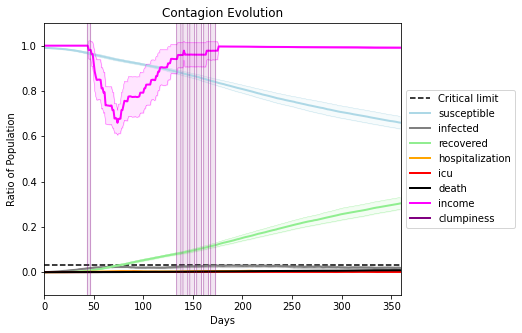

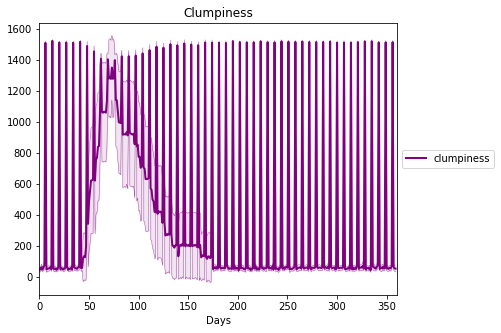

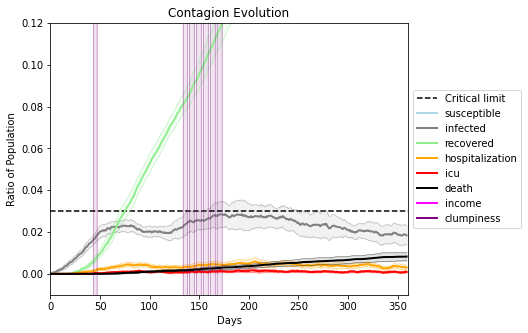

In [25]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[2657, 3028, 5441, 8642, 1905, 2004, 7782, 7170, 3894, 3334, 4039, 5334, 2328, 2686, 5061, 7243, 8596, 3121, 7333, 4519]
Average similarity between family members is 0.08160382835380946 at temperature 0.33
Average similarity between family and home is 0.999859777002541 at temperature -1
Average similarity between students and their classroom is 0.07586214699034581 at temperature 0.33
Average classroom occupancy is 1.7309941520467835 and number classrooms is 171
Average similarity between workers is 0.12471128957588266 at temperature 0.33
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.1678395350221296 for kids: 0.17220026169049873
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousB

avg restaurant similarity 0.07509711628755614
avg restaurant similarity -0.07158563643101226
avg restaurant similarity -0.0034305142399627606
avg restaurant similarity 0.15807282247845467
avg restaurant similarity 0.07115332064028818
avg restaurant similarity 0.13285997430634094
avg restaurant similarity 0.19034287814419223
avg restaurant similarity 0.024579580261047698
avg restaurant similarity -0.08559960375910759
avg restaurant similarity -0.015095694158207015
avg restaurant similarity 0.08623923537328201
avg restaurant similarity -0.0034436089138093597
avg restaurant similarity -0.07659780162112856
avg restaurant similarity 0.2501517352150049
avg restaurant similarity -0.17402174847016966
avg restaurant similarity 0.4129432400805622
avg restaurant similarity -0.11252761381890988
avg restaurant similarity 0.15825500379260285
avg restaurant similarity -0.009362563838723956
avg restaurant similarity 0.2200430221806044
avg restaurant similarity 0.22576088939458638
avg restaurant simila

avg restaurant similarity 0.1563848020386278
avg restaurant similarity 0.09374355314675059
avg restaurant similarity 0.06844720433673544
avg restaurant similarity -0.0003051626830763802
avg restaurant similarity -0.07342391100867417
avg restaurant similarity 0.044653114303616265
avg restaurant similarity 0.4192319804583712
avg restaurant similarity -0.05099551370199377
avg restaurant similarity 0.004539929886118978
avg restaurant similarity 0.07983872194434967
avg restaurant similarity 0.13959502143438626
avg restaurant similarity -0.023449123960822146
avg restaurant similarity -0.0016220690707427997
avg restaurant similarity -0.010543384157799901
avg restaurant similarity 0.10143564357423568
avg restaurant similarity 0.1380376462956798
avg restaurant similarity 0.13828932545868772
avg restaurant similarity -0.1443550361438935
avg restaurant similarity 0.04226822119147068
avg restaurant similarity 0.04976791336090352
avg restaurant similarity -0.013109128171428557
avg restaurant simila

Average similarity between family members is 0.11455645763055543 at temperature 0.33
Average similarity between family and home is 0.9998582209664064 at temperature -1
Average similarity between students and their classroom is 0.06842957665484405 at temperature 0.33
Average classroom occupancy is 1.5956284153005464 and number classrooms is 183
Average similarity between workers is 0.09779541059882677 at temperature 0.33
Average office occupancy is 3.180904522613065 and number offices is 199
Average friend similarity for adults: 0.17052090119790178 for kids: 0.16863804096073423
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2

avg restaurant similarity 0.08884059594557178
avg restaurant similarity -0.09527784581493966
avg restaurant similarity -0.011634520812002001
avg restaurant similarity -0.20503548701652136
avg restaurant similarity 0.0397727361559845
avg restaurant similarity 0.40233792120226236
avg restaurant similarity 0.07093016654536169
avg restaurant similarity 0.1253397656642292
avg restaurant similarity -0.012523712178485111
avg restaurant similarity -0.05616392158250882
avg restaurant similarity 0.12353513577871436
avg restaurant similarity 0.004522185454057405
avg restaurant similarity 0.07274771654145862
avg restaurant similarity 0.21186327987346748
avg restaurant similarity 0.03313206956367259
avg restaurant similarity 0.07387531167288683
avg restaurant similarity -0.03145603191790576
avg restaurant similarity 0.08146214051591341
avg restaurant similarity 0.11585644136407788
avg restaurant similarity 0.08387887264721194
avg restaurant similarity 0.08749058077042224
avg restaurant similarity 0

avg restaurant similarity 0.10833519413570632
avg restaurant similarity 0.26123765504566315
avg restaurant similarity -0.06597077704351208
avg restaurant similarity 0.08014417983873026
avg restaurant similarity -0.058072035667064925
avg restaurant similarity 0.4177800752203865
avg restaurant similarity 0.03557073255364355
avg restaurant similarity 0.10236428104676665
avg restaurant similarity 0.1443238571900572
avg restaurant similarity 0.03572199042271819
avg restaurant similarity 0.12596274065686203
avg restaurant similarity 0.04436260354207467
avg restaurant similarity 0.036670327582779556
avg restaurant similarity 0.18528301423150867
avg restaurant similarity 0.09114938406876806
avg restaurant similarity 0.14139350411522453
avg restaurant similarity 0.029905367466329907
avg restaurant similarity 0.02033414936908302
avg restaurant similarity -0.019143765264113554
avg restaurant similarity 0.11326299279448226
avg restaurant similarity 0.04393027487108358
avg restaurant similarity 0.2

Average similarity between family members is 0.10988372927723675 at temperature 0.33
Average similarity between family and home is 0.9998533991524117 at temperature -1
Average similarity between students and their classroom is 0.13076453856608156 at temperature 0.33
Average classroom occupancy is 1.6685393258426966 and number classrooms is 178
Average similarity between workers is 0.1104101214065482 at temperature 0.33
Average office occupancy is 3.175609756097561 and number offices is 205
Average friend similarity for adults: 0.17199914476620926 for kids: 0.16393460568353224
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity 0.17306936820704502
avg restaurant similarity 0.08270208438302895
avg restaurant similarity 0.14090998450153508
avg restaurant similarity 0.08889100042437785
avg restaurant similarity 0.1487529705781804
avg restaurant similarity -0.0592180554105725
avg restaurant similarity -0.028943839107722243
avg restaurant similarity 0.03063420312195421
avg restaurant similarity 0.17286128504657583
avg restaurant similarity 0.085416267503939
avg restaurant similarity -0.18815257782720407
avg restaurant similarity 0.262678165351318
avg restaurant similarity 0.032361315962700817
avg restaurant similarity 0.0941421037406396
avg restaurant similarity 0.12286869557568499
avg restaurant similarity 0.021519419225761734
avg restaurant similarity 0.028730942204235388
avg restaurant similarity -0.032228163622396985
avg restaurant similarity 0.20473613624548972
avg restaurant similarity 0.0830303375651555
avg restaurant similarity -0.2972129012212643
avg restaurant similarity 0.00154

avg restaurant similarity -0.09717311294016684
avg restaurant similarity 0.2080911188339044
avg restaurant similarity 0.030864660454616746
avg restaurant similarity -0.035122907818748175
avg restaurant similarity 0.13135764223025637
avg restaurant similarity 0.18536083549979054
avg restaurant similarity -0.22136993335087343
avg restaurant similarity -0.08499932859933217
avg restaurant similarity -0.02011742570525339
avg restaurant similarity 0.09246660263261566
avg restaurant similarity 0.24935983657831726
avg restaurant similarity 0.20611880264664958
avg restaurant similarity -0.0026886738569137686
avg restaurant similarity 0.14515770057710942
avg restaurant similarity 0.11320527416217455
avg restaurant similarity 0.03780682565593595
avg restaurant similarity 0.08938491732640916
avg restaurant similarity 0.06350049775342718
avg restaurant similarity 0.5102113328570826
avg restaurant similarity -0.1679901368727048
avg restaurant similarity 0.05447781518282167
avg restaurant similarity 

Average similarity between workers is 0.08415515110382885 at temperature 0.33
Average office occupancy is 3.1951219512195124 and number offices is 205
Average friend similarity for adults: 0.16467863103157446 for kids: 0.16582235026225314
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 1

avg restaurant similarity -0.012359639562066885
avg restaurant similarity 0.04953395015638665
avg restaurant similarity -0.07930411453175684
avg restaurant similarity 0.011986023160778644
avg restaurant similarity 0.13850588732324814
avg restaurant similarity 0.014582419236727852
avg restaurant similarity 0.13208608162073326
avg restaurant similarity 0.14426266380983965
avg restaurant similarity 0.09613464593665942
avg restaurant similarity 0.00830180139998615
avg restaurant similarity 0.0012276951608563235
avg restaurant similarity -0.041434391676526405
avg restaurant similarity -0.041758269324781584
avg restaurant similarity 0.0029423646120268396
avg restaurant similarity 0.03467314697489245
avg restaurant similarity 0.19773748454340426
avg restaurant similarity 0.17463876951804064
avg restaurant similarity -0.02875120104566442
avg restaurant similarity 0.1992156831407695
avg restaurant similarity 0.08304254800812684
avg restaurant similarity 0.10133866624058646
avg restaurant simila

avg restaurant similarity 0.15369201136470897
avg restaurant similarity 0.16858959234387474
avg restaurant similarity 0.018281358072143733
avg restaurant similarity 0.1876236210128892
avg restaurant similarity 0.391235576587246
avg restaurant similarity 0.08245981425454803
avg restaurant similarity 0.09177800860715457
avg restaurant similarity 0.040042411548020594
avg restaurant similarity 0.12616520428809339
avg restaurant similarity 0.15919439100272986
avg restaurant similarity 0.011730317595508353
avg restaurant similarity 0.04263250369583656
avg restaurant similarity 0.17542984163291575
avg restaurant similarity 0.15870693924891263
avg restaurant similarity 0.22940557080408244
avg restaurant similarity 0.16793021967008778
avg restaurant similarity 0.011958993728973688
avg restaurant similarity 0.19896633442725536
avg restaurant similarity -0.1424510461672926
avg restaurant similarity 0.04842422265311159
avg restaurant similarity -0.28805105719300506
avg restaurant similarity 0.0129

avg restaurant similarity 0.11001662470527913
Average similarity between family members is 0.10960269770118568 at temperature 0.33
Average similarity between family and home is 0.9998462111528926 at temperature -1
Average similarity between students and their classroom is 0.15082579453406697 at temperature 0.33
Average classroom occupancy is 1.6703296703296704 and number classrooms is 182
Average similarity between workers is 0.10274405074084571 at temperature 0.33
Average office occupancy is 3.1534653465346536 and number offices is 202
Average friend similarity for adults: 0.16523922519748704 for kids: 0.17196090640446876
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 

avg restaurant similarity 0.020638414562797143
avg restaurant similarity 0.12648064366332093
avg restaurant similarity -0.002978221491334742
avg restaurant similarity 0.16194736994329256
avg restaurant similarity -0.07349966649096053
avg restaurant similarity 0.23115924124424447
avg restaurant similarity 0.007832777461028067
avg restaurant similarity 0.25865994560315636
avg restaurant similarity 0.07540342989336002
avg restaurant similarity -0.2477159996106546
avg restaurant similarity 0.049493909856692414
avg restaurant similarity 0.03331889240108096
avg restaurant similarity -0.017947047726755476
avg restaurant similarity -0.03634755438827104
avg restaurant similarity 0.011202044451449086
avg restaurant similarity -0.38340371682246654
avg restaurant similarity 0.3047861807201212
avg restaurant similarity 0.16711543688799646
avg restaurant similarity 0.09758957438254368
avg restaurant similarity 0.03908059177070088
avg restaurant similarity 0.12054778734251712
avg restaurant similarit

avg restaurant similarity -0.37599685203656447
avg restaurant similarity -0.15311314876756021
avg restaurant similarity 0.17573282646929375
avg restaurant similarity -0.002172613152838752
avg restaurant similarity 0.002742504068833959
avg restaurant similarity -0.19107087276543214
avg restaurant similarity -0.08567738213738946
avg restaurant similarity 0.697556904442469
avg restaurant similarity -0.023932688430722382
avg restaurant similarity 0.1982272238217182
avg restaurant similarity 0.05528632947419496
avg restaurant similarity 0.417491864403859
avg restaurant similarity -0.04532969537360142
avg restaurant similarity -0.1250908965205705
avg restaurant similarity 0.018307845958482394
avg restaurant similarity -0.14247726248631482
avg restaurant similarity -0.042546890404422055
avg restaurant similarity -0.19434707581311575
avg restaurant similarity 0.20399473082693323
avg restaurant similarity -0.3085579064681459
avg restaurant similarity 0.06941320489758218
avg restaurant similarit

avg restaurant similarity 0.10044249557800779
avg restaurant similarity 0.12633666845905553
avg restaurant similarity 0.11556349432371853
avg restaurant similarity 0.05407980300577941
avg restaurant similarity 0.042916571875163054
avg restaurant similarity 0.13536498853447257
avg restaurant similarity 0.08593825115699014
avg restaurant similarity 0.03104956552068521
avg restaurant similarity 0.05615904676449701
avg restaurant similarity 0.14576151760264885
avg restaurant similarity 0.13998632552203027
avg restaurant similarity -0.04736071356723559
avg restaurant similarity -0.026629458840821105
avg restaurant similarity -0.006294815624919421
avg restaurant similarity 0.05225313535111286
avg restaurant similarity -0.08133856538821549
avg restaurant similarity 0.09212651300177047
avg restaurant similarity 0.04699652714459537
avg restaurant similarity 0.06070546442467251
avg restaurant similarity 0.11220552925886348
avg restaurant similarity -0.04423092376891074
avg restaurant similarity 

avg restaurant similarity 0.07624404133572979
avg restaurant similarity 0.13706722200225252
avg restaurant similarity -0.19258124762227202
avg restaurant similarity -0.1087289489982853
avg restaurant similarity 0.09708731755548619
avg restaurant similarity 0.21132368109911104
avg restaurant similarity -0.11003403767983087
avg restaurant similarity 0.027388482514063606
avg restaurant similarity 0.13930050751017706
avg restaurant similarity 0.017711273958518153
avg restaurant similarity 0.2066371868718522
avg restaurant similarity -0.13724325196865922
avg restaurant similarity 0.009047861387618816
avg restaurant similarity -0.012046545215550286
avg restaurant similarity -0.016031179895206703
avg restaurant similarity 0.06532142719541165
avg restaurant similarity -0.022282801093463353
avg restaurant similarity 0.08689755985379935
avg restaurant similarity 0.11913182742712684
avg restaurant similarity -0.021580482354204983
avg restaurant similarity 0.11110767899103122
avg restaurant simila

Average similarity between family and home is 0.9998641966689877 at temperature -1
Average similarity between students and their classroom is 0.10311016617045114 at temperature 0.33
Average classroom occupancy is 1.5243243243243243 and number classrooms is 185
Average similarity between workers is 0.08972746768266701 at temperature 0.33
Average office occupancy is 3.3201970443349755 and number offices is 203
Average friend similarity for adults: 0.17463270003949624 for kids: 0.16283588039212238
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 

avg restaurant similarity 0.06084029017327314
avg restaurant similarity 0.11382698588073131
avg restaurant similarity 0.0034977132189663333
avg restaurant similarity -0.010486630076364245
avg restaurant similarity 0.27234335867504395
avg restaurant similarity 0.061649839388093174
avg restaurant similarity 0.03872565594899459
avg restaurant similarity 0.17454372164401052
avg restaurant similarity 0.13932334123263865
avg restaurant similarity 0.03345568809763781
avg restaurant similarity 0.10297757532501292
avg restaurant similarity -0.029394351586118223
avg restaurant similarity 0.06993817500489088
avg restaurant similarity 0.03287916869172653
avg restaurant similarity -0.09707080688917265
avg restaurant similarity -0.0115989608015441
avg restaurant similarity -0.1924957001076802
avg restaurant similarity -0.011871762776122285
avg restaurant similarity 0.1901915674424465
avg restaurant similarity 0.25103831757076916
avg restaurant similarity 0.11746263876911053
avg restaurant similarity

avg restaurant similarity 0.01372789795446441
avg restaurant similarity -0.1912964060265993
avg restaurant similarity 0.03336823868673883
avg restaurant similarity -0.04144305537899231
avg restaurant similarity 0.38508813191647756
avg restaurant similarity 0.1624316712229744
avg restaurant similarity 0.11583024740771189
avg restaurant similarity 0.23665466474553906
avg restaurant similarity -0.0026014060961714117
avg restaurant similarity 0.0965484082501941
avg restaurant similarity 0.6521809721812913
avg restaurant similarity 0.12986920783070635
avg restaurant similarity -0.08362927774584993
avg restaurant similarity 0.08495880765268318
avg restaurant similarity -0.10488768921451841
avg restaurant similarity 0.2647657580878564
avg restaurant similarity 0.22393861082858738
avg restaurant similarity 0.14507107516242215
avg restaurant similarity 0.13702793622504889
avg restaurant similarity -0.08202301349377028
avg restaurant similarity -0.1314467345171995
avg restaurant similarity -0.13

Average similarity between family and home is 0.9998565604678542 at temperature -1
Average similarity between students and their classroom is 0.11240004283847611 at temperature 0.33
Average classroom occupancy is 1.627027027027027 and number classrooms is 185
Average similarity between workers is 0.11513720711463507 at temperature 0.33
Average office occupancy is 3.17 and number offices is 200
Average friend similarity for adults: 0.16932763113312313 for kids: 0.17479378756837016
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of 0 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 al

avg restaurant similarity 0.2708996301391508
avg restaurant similarity 0.07935783303940593
avg restaurant similarity 0.14828184157878777
avg restaurant similarity 0.19345775602672927
avg restaurant similarity 0.30572249790971584
avg restaurant similarity 0.1958623673466489
avg restaurant similarity -0.13766523594243493
avg restaurant similarity 0.16889503222187385
avg restaurant similarity -0.07356825290805662
avg restaurant similarity 0.018894897707494307
avg restaurant similarity 0.10895706324285279
avg restaurant similarity -0.1272439012200227
avg restaurant similarity 0.22525270654394078
avg restaurant similarity 0.17652898333693412
avg restaurant similarity 0.04926064224423199
avg restaurant similarity 0.1513305831664996
avg restaurant similarity 0.058233676947895184
avg restaurant similarity 0.04271723653957065
avg restaurant similarity 0.2589969974378175
avg restaurant similarity 0.23472189316717157
avg restaurant similarity 0.09239875753344592
avg restaurant similarity 0.032051

avg restaurant similarity 0.08743629393039144
avg restaurant similarity 0.008579479713255003
avg restaurant similarity -0.03168659524826733
avg restaurant similarity -0.09215982671295754
avg restaurant similarity -0.13252065333730062
avg restaurant similarity -0.1110042967122602
avg restaurant similarity 0.058473948840032625
avg restaurant similarity 0.2689095587480898
avg restaurant similarity 0.08196944518246788
avg restaurant similarity 0.4773807241801338
avg restaurant similarity 0.12930108230082554
avg restaurant similarity -0.009636717269377548
avg restaurant similarity 0.21144258590609924
avg restaurant similarity 0.1435476536370738
avg restaurant similarity 0.11399999037579496
avg restaurant similarity 0.1045291393720049
avg restaurant similarity 0.0653232754554141
avg restaurant similarity 0.03964020047847703
avg restaurant similarity 0.16580032720345764
avg restaurant similarity 0.36569411658559536
avg restaurant similarity 0.21293887474221096
avg restaurant similarity 0.2387

Average similarity between students and their classroom is 0.10856350934599675 at temperature 0.33
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.11316009335706934 at temperature 0.33
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.16855411824398134 for kids: 0.17363597319293012
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this di

avg restaurant similarity -0.08151788423676866
avg restaurant similarity 0.08292686956732796
avg restaurant similarity 0.01855759513264238
avg restaurant similarity -0.011698700690098433
avg restaurant similarity -0.06683869867434063
avg restaurant similarity 0.17290633696018548
avg restaurant similarity 0.02078449686557509
avg restaurant similarity 0.02486934404714978
avg restaurant similarity 0.06167593069556416
avg restaurant similarity -0.07929389419747841
avg restaurant similarity -0.07445828073032236
avg restaurant similarity 0.03324551279266398
avg restaurant similarity -0.007049859504702346
avg restaurant similarity -0.04612317643736084
avg restaurant similarity 0.032618903219325646
avg restaurant similarity -0.047372248695521826
avg restaurant similarity -0.02505866523371799
avg restaurant similarity 0.051766204498499925
avg restaurant similarity -0.11462405544524971
avg restaurant similarity 0.040486178962628606
avg restaurant similarity -0.04966807254942882
avg restaurant si

avg restaurant similarity 0.2067327135187402
avg restaurant similarity 0.16693618843593536
avg restaurant similarity 0.12366399039778558
avg restaurant similarity 0.36521168150601174
avg restaurant similarity -0.01769219202561068
avg restaurant similarity -0.14739921377771292
avg restaurant similarity -0.0748621327390803
avg restaurant similarity 0.016319677898427
avg restaurant similarity 0.028732561171299985
avg restaurant similarity 0.034184706246834326
avg restaurant similarity 0.1720753533143301
avg restaurant similarity 0.14387384548734364
avg restaurant similarity 0.09460899725647916
avg restaurant similarity 0.17378953787345006
avg restaurant similarity 0.12843667950114068
avg restaurant similarity 0.16101675769225976
avg restaurant similarity 0.017674307855481748
avg restaurant similarity -0.00895255879729464
avg restaurant similarity 0.017995354863496387
avg restaurant similarity -0.05795828169793176
avg restaurant similarity 0.01900850769016816
avg restaurant similarity 0.12

avg restaurant similarity 0.02104588344309
avg restaurant similarity 0.16012575077670924
avg restaurant similarity 0.19341010732412864
Average similarity between family members is 0.08544282362209041 at temperature 0.33
Average similarity between family and home is 0.9998672039951721 at temperature -1
Average similarity between students and their classroom is 0.1303391026272164 at temperature 0.33
Average classroom occupancy is 1.5932203389830508 and number classrooms is 177
Average similarity between workers is 0.1183429305168027 at temperature 0.33
Average office occupancy is 3.2780487804878047 and number offices is 205
Average friend similarity for adults: 0.16542063737044813 for kids: 0.181494161970244
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each

avg restaurant similarity 0.3133645009477698
avg restaurant similarity -0.06897434954835034
avg restaurant similarity 0.1520131449838133
avg restaurant similarity 0.09320536935951877
avg restaurant similarity 0.2086659300056491
avg restaurant similarity 0.0521531725002639
avg restaurant similarity 0.10094384267640476
avg restaurant similarity 0.09672414728093473
avg restaurant similarity -0.012248029269219793
avg restaurant similarity 0.15192475234097916
avg restaurant similarity -0.0786939159780413
avg restaurant similarity 0.04665047080049163
avg restaurant similarity 0.1044342005478049
avg restaurant similarity 0.0033441191467713147
avg restaurant similarity 0.1771012419130612
avg restaurant similarity 0.015580133475696404
avg restaurant similarity -0.06353906642089413
avg restaurant similarity 0.15274322780837268
avg restaurant similarity -0.003355316371398476
avg restaurant similarity 0.1475427649600529
avg restaurant similarity -0.05649127669581621
avg restaurant similarity 0.162

avg restaurant similarity 0.038479819163831676
avg restaurant similarity 0.019141866184528386
avg restaurant similarity -0.03066846933711596
avg restaurant similarity 0.09957243219637382
avg restaurant similarity 0.16933636571310917
avg restaurant similarity 0.2528332248654188
avg restaurant similarity 0.1398701568152784
avg restaurant similarity 0.048912045765443134
avg restaurant similarity 0.09071209858575383
avg restaurant similarity -0.3254738259139838
avg restaurant similarity -0.04528478563572712
avg restaurant similarity 0.1749880285622839
avg restaurant similarity 0.2360233474329015
avg restaurant similarity 0.056674577207449596
avg restaurant similarity 0.13098612122025022
avg restaurant similarity 0.1783074950408654
avg restaurant similarity -0.1919074594255964
avg restaurant similarity 0.345612107575495
avg restaurant similarity 0.1470153681422367
avg restaurant similarity 0.1987809452218908
avg restaurant similarity 0.19945310322078064
avg restaurant similarity -0.17043865

Average similarity between family and home is 0.9998546212107939 at temperature -1
Average similarity between students and their classroom is 0.1037854018157545 at temperature 0.33
Average classroom occupancy is 1.510752688172043 and number classrooms is 186
Average similarity between workers is 0.11742020531409843 at temperature 0.33
Average office occupancy is 3.242424242424242 and number offices is 198
Average friend similarity for adults: 0.16086332292168912 for kids: 0.17256461048160995
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity -0.17207826417618577
avg restaurant similarity -0.10844014225830009
avg restaurant similarity -0.015854071843888675
avg restaurant similarity -0.1092603173554802
avg restaurant similarity -0.11518672897422666
avg restaurant similarity 0.07289711618452487
avg restaurant similarity -0.049786315489844434
avg restaurant similarity 0.06895832413330726
avg restaurant similarity 0.1603041530972032
avg restaurant similarity 0.14723157722308522
avg restaurant similarity 0.036175463924169655
avg restaurant similarity 0.047484750646245306
avg restaurant similarity 0.0970303336003055
avg restaurant similarity -0.007684023765154999
avg restaurant similarity 0.2313088720702289
avg restaurant similarity 0.1485348392896472
avg restaurant similarity 0.050525932212947
avg restaurant similarity 0.282934611861164
avg restaurant similarity 0.02090323060957634
avg restaurant similarity 0.06198865366665249
avg restaurant similarity 0.14473079515214585
avg restaurant similarity 0.110

avg restaurant similarity 0.12787289981028374
avg restaurant similarity -0.26570371333445303
avg restaurant similarity 0.026920136723607675
avg restaurant similarity 0.14563134066643407
avg restaurant similarity 0.09698017043377631
avg restaurant similarity -0.41074017758124615
avg restaurant similarity 0.1733704637325363
avg restaurant similarity -0.014896212551442758
avg restaurant similarity 0.09346130286231051
avg restaurant similarity 0.04681685547860637
avg restaurant similarity 0.4021177057322628
avg restaurant similarity 0.030282089902987294
avg restaurant similarity -0.1957024750418656
avg restaurant similarity -0.2052049068591745
avg restaurant similarity 0.005391703633038272
avg restaurant similarity 0.26938668942932326
avg restaurant similarity -0.0048230604940971145
avg restaurant similarity 0.3181543144945847
avg restaurant similarity 0.13633645435172875
avg restaurant similarity 0.031539435889525416
avg restaurant similarity 0.10253388106452817
avg restaurant similarity 

avg restaurant similarity 0.11104832062694577
avg restaurant similarity 0.002896188049431339
avg restaurant similarity 0.03138881288254727
Average similarity between family members is 0.10737353622807934 at temperature 0.33
Average similarity between family and home is 0.9998484352090085 at temperature -1
Average similarity between students and their classroom is 0.08773030258179966 at temperature 0.33
Average classroom occupancy is 1.5340909090909092 and number classrooms is 176
Average similarity between workers is 0.10565174230657332 at temperature 0.33
Average office occupancy is 3.3514851485148514 and number offices is 202
Average friend similarity for adults: 0.1662594469989732 for kids: 0.1756659683048419
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity 0.11774158405143788
avg restaurant similarity 0.07199916533481228
avg restaurant similarity 0.06504235908950057
avg restaurant similarity 0.1638213794097397
avg restaurant similarity 0.15618826832282232
avg restaurant similarity 0.18182841181389445
avg restaurant similarity 0.013994554721815426
avg restaurant similarity 0.010682196725546744
avg restaurant similarity 0.02204585912020542
avg restaurant similarity 0.15623765518121185
avg restaurant similarity 0.09478461425068413
avg restaurant similarity 0.01044256741480164
avg restaurant similarity -0.046587357849071115
avg restaurant similarity 0.10784151361760572
avg restaurant similarity 0.0992926521025426
avg restaurant similarity 0.09040713611307373
avg restaurant similarity 0.014568431540808665
avg restaurant similarity 0.04589114482585312
avg restaurant similarity 0.13866488200065913
avg restaurant similarity 0.16688755703101088
avg restaurant similarity 0.046720106120996266
avg restaurant similarity 0.04

avg restaurant similarity -0.025678571461295534
avg restaurant similarity 0.3377349521762749
avg restaurant similarity 0.2662285383385333
avg restaurant similarity 0.14720426157299515
avg restaurant similarity -0.12352326636205106
avg restaurant similarity 0.09773706822547529
avg restaurant similarity 0.06390851767428044
avg restaurant similarity 0.01930021502264055
avg restaurant similarity 0.09484876735865405
avg restaurant similarity 0.16651731767803885
avg restaurant similarity 0.1182367134886529
avg restaurant similarity 0.14416324267620645
avg restaurant similarity 0.0024439863142651395
avg restaurant similarity -0.019383016152315746
avg restaurant similarity 0.1322910057428341
avg restaurant similarity -0.04472104361707141
avg restaurant similarity 0.09261526701581696
avg restaurant similarity 0.14449313026752125
avg restaurant similarity 0.15493141090763815
avg restaurant similarity 0.0364301205376442
avg restaurant similarity 0.01815358451753463
avg restaurant similarity -0.06

avg restaurant similarity 0.09510233457643538
avg restaurant similarity 0.023702009268216737
avg restaurant similarity 0.09643433161508524
avg restaurant similarity -0.04434863635365221
avg restaurant similarity 0.1062035166797966
avg restaurant similarity 0.018713803009545595
Average similarity between family members is 0.09363713375022802 at temperature 0.33
Average similarity between family and home is 0.9998475663726258 at temperature -1
Average similarity between students and their classroom is 0.12204281078511554 at temperature 0.33
Average classroom occupancy is 1.6 and number classrooms is 170
Average similarity between workers is 0.09540291889456003 at temperature 0.33
Average office occupancy is 3.3415841584158414 and number offices is 202
Average friend similarity for adults: 0.1575395945963588 for kids: 0.1550778836107289
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 1

avg restaurant similarity 0.03560997683695105
avg restaurant similarity 0.06079606857010153
avg restaurant similarity 0.19163366546958197
avg restaurant similarity 0.06730085144663837
avg restaurant similarity -0.07781807338557047
avg restaurant similarity 0.18848699541903935
avg restaurant similarity -0.07193699295414432
avg restaurant similarity 0.01985176030889787
avg restaurant similarity 0.04902221237398562
avg restaurant similarity -0.04823527135958237
avg restaurant similarity -0.017546639390324584
avg restaurant similarity -0.14191295673917725
avg restaurant similarity 0.13218232974974134
avg restaurant similarity 0.1681259565637567
avg restaurant similarity -0.13147316457187902
avg restaurant similarity -0.001127527181238841
avg restaurant similarity -0.015311849609524739
avg restaurant similarity 0.08813216234425288
avg restaurant similarity 0.0981153815094421
avg restaurant similarity 0.2224671222534984
avg restaurant similarity 0.09799707051556077
avg restaurant similarity 

avg restaurant similarity 0.15912613231045342
avg restaurant similarity -0.17544669396269222
avg restaurant similarity -0.07122021148703775
avg restaurant similarity 0.02599440393992804
avg restaurant similarity 0.08515353546173046
avg restaurant similarity 0.18536907467505884
avg restaurant similarity 0.09785504399947258
avg restaurant similarity 0.03364092210528161
avg restaurant similarity -0.17211429733394776
avg restaurant similarity -0.08696427823273052
avg restaurant similarity 0.1870584748365787
avg restaurant similarity -0.30520668816115465
avg restaurant similarity -0.03673942962012579
avg restaurant similarity -0.008848529084827675
avg restaurant similarity 0.4044689278802722
avg restaurant similarity 0.054409741902519924
avg restaurant similarity 0.11418294394140338
avg restaurant similarity -0.1331957337828938
avg restaurant similarity 0.21696250796260663
avg restaurant similarity -0.02724771987255963
avg restaurant similarity 0.006115192862263139
avg restaurant similarity

Average similarity between family members is 0.1037775927521671 at temperature 0.33
Average similarity between family and home is 0.9998538400666447 at temperature -1
Average similarity between students and their classroom is 0.16072504977787633 at temperature 0.33
Average classroom occupancy is 1.5402298850574712 and number classrooms is 174
Average similarity between workers is 0.09940548140958322 at temperature 0.33
Average office occupancy is 3.3793103448275863 and number offices is 203
Average friend similarity for adults: 0.1663734230016629 for kids: 0.17635497712428014
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,

avg restaurant similarity -0.07566673263343078
avg restaurant similarity 0.12830519457890013
avg restaurant similarity 0.03525938049564388
avg restaurant similarity 0.02251490171032708
avg restaurant similarity -0.09988856856463013
avg restaurant similarity 0.12182335372289585
avg restaurant similarity -0.10820648066615286
avg restaurant similarity 0.0386205222858253
avg restaurant similarity 0.018946497381800063
avg restaurant similarity 0.23836046299053404
avg restaurant similarity 0.23618738067966746
avg restaurant similarity -0.11765465211735619
avg restaurant similarity 0.06554474768857269
avg restaurant similarity 0.07098710150443233
avg restaurant similarity 0.1683171869930221
avg restaurant similarity 0.14446534097181915
avg restaurant similarity 0.0720533793026593
avg restaurant similarity 0.09091236133824324
avg restaurant similarity 0.21684635890868728
avg restaurant similarity 0.19485505075286985
avg restaurant similarity -0.0022299338914359306
avg restaurant similarity 0.0

avg restaurant similarity 0.07872085063934621
avg restaurant similarity 0.13570420724110796
avg restaurant similarity 0.20511914389311564
avg restaurant similarity -0.005454783835429272
avg restaurant similarity -0.0867173954740459
avg restaurant similarity 0.03858766832016754
avg restaurant similarity -0.02330139824662651
avg restaurant similarity 0.1869494425581347
avg restaurant similarity 0.16999839800251726
avg restaurant similarity 0.10463924013766794
avg restaurant similarity 0.2497687695398335
avg restaurant similarity 0.13755658733582832
avg restaurant similarity -0.005382446650080014
avg restaurant similarity 0.1222915213538195
avg restaurant similarity 0.050532090014240305
avg restaurant similarity -0.010470056130275672
avg restaurant similarity -0.12107866411797295
avg restaurant similarity -0.10231300039011215
avg restaurant similarity 0.004128802461525836
avg restaurant similarity -0.3977761704550063
avg restaurant similarity -0.0889203268914323
avg restaurant similarity 

Average similarity between family members is 0.1211503827847096 at temperature 0.33
Average similarity between family and home is 0.9998488905328881 at temperature -1
Average similarity between students and their classroom is 0.08726814640673015 at temperature 0.33
Average classroom occupancy is 1.576086956521739 and number classrooms is 184
Average similarity between workers is 0.09993927716374386 at temperature 0.33
Average office occupancy is 3.316326530612245 and number offices is 196
Average friend similarity for adults: 0.17177967674404301 for kids: 0.1855143241683328
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,

avg restaurant similarity 0.04436620325912867
avg restaurant similarity 0.06309436297533347
avg restaurant similarity -0.013707388927178456
avg restaurant similarity -0.07476602971308373
avg restaurant similarity 0.22544548302096754
avg restaurant similarity 0.2843093121585244
avg restaurant similarity 0.026635407902383387
avg restaurant similarity 0.15168198291507723
avg restaurant similarity 0.12427633789678952
avg restaurant similarity 0.10480852722720631
avg restaurant similarity 0.08997891753945901
avg restaurant similarity -0.02048448604966457
avg restaurant similarity 0.1979495021414285
avg restaurant similarity 0.0017546222184830914
avg restaurant similarity 0.03472843501566047
avg restaurant similarity -0.17470363049850268
avg restaurant similarity 0.20626369281002843
avg restaurant similarity 0.212193191104917
avg restaurant similarity 0.20185443967149028
avg restaurant similarity 0.05246028856844321
avg restaurant similarity 0.04792113751452079
avg restaurant similarity 0.19

avg restaurant similarity 0.26681816579164347
avg restaurant similarity 0.11028675398817739
avg restaurant similarity 0.08049903722990942
avg restaurant similarity 0.1448518197344274
avg restaurant similarity 0.17015824450619027
avg restaurant similarity 0.3176716736207863
avg restaurant similarity 0.018057377737269314
avg restaurant similarity 0.21033472760200939
avg restaurant similarity -0.01716915242686983
avg restaurant similarity 0.19421601493341403
avg restaurant similarity 0.0904962348060903
avg restaurant similarity 0.0153766182265581
avg restaurant similarity 0.1658427586436913
avg restaurant similarity 0.07271394958612723
avg restaurant similarity 0.01061299992705311
avg restaurant similarity 0.10065106545334901
avg restaurant similarity -0.17031991517242606
avg restaurant similarity 0.24359936681201927
avg restaurant similarity 0.07085901069280445
avg restaurant similarity 0.18820003047132364
avg restaurant similarity 0.1213237966489191
avg restaurant similarity 0.203816076

Average similarity between family and home is 0.9998516384907543 at temperature -1
Average similarity between students and their classroom is 0.07958998290365603 at temperature 0.33
Average classroom occupancy is 1.654970760233918 and number classrooms is 171
Average similarity between workers is 0.11129888822705539 at temperature 0.33
Average office occupancy is 3.348717948717949 and number offices is 195
Average friend similarity for adults: 0.1729337197588427 for kids: 0.16758897509025922
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 p

avg restaurant similarity 0.040720663694567796
avg restaurant similarity 0.15844261230331247
avg restaurant similarity 0.04771504579760913
avg restaurant similarity -0.22303063150004848
avg restaurant similarity 0.09685756424468724
avg restaurant similarity 0.04379642708279651
avg restaurant similarity 0.17385890105117222
avg restaurant similarity 0.0955027399039743
avg restaurant similarity -0.15216467113899051
avg restaurant similarity 0.14864759348040535
avg restaurant similarity -0.0019400729048075992
avg restaurant similarity 0.08158301134016611
avg restaurant similarity -0.01362201300832746
avg restaurant similarity 0.31861610834625065
avg restaurant similarity 0.004029060603185431
avg restaurant similarity 0.16529289962208135
avg restaurant similarity -0.12274616491614981
avg restaurant similarity -0.03728274207319466
avg restaurant similarity 0.2189467924754916
avg restaurant similarity 0.31027007082337227
avg restaurant similarity 0.01652344578061123
avg restaurant similarity 

avg restaurant similarity 0.048047105836786175
avg restaurant similarity 0.10393749825339631
avg restaurant similarity -0.07875418069921687
avg restaurant similarity -0.0011180620107949894
avg restaurant similarity 0.013957157403566126
avg restaurant similarity 0.19534777916465618
avg restaurant similarity 0.07810781438953815
avg restaurant similarity 0.1355685755829963
avg restaurant similarity -0.06372937131495016
avg restaurant similarity -0.06303860549153388
avg restaurant similarity 0.26259060065258466
avg restaurant similarity 0.10753830517649937
avg restaurant similarity -0.010634835830177445
avg restaurant similarity -0.2563642230101002
avg restaurant similarity 0.15769506675375788
avg restaurant similarity 0.5439986459698899
avg restaurant similarity -0.18449213882441062
avg restaurant similarity -0.010302475306560449
avg restaurant similarity -0.08433905516873011
avg restaurant similarity 0.1073091965169876
avg restaurant similarity 0.07126460561007408
avg restaurant similari

Average similarity between students and their classroom is 0.10780725767793618 at temperature 0.33
Average classroom occupancy is 1.583815028901734 and number classrooms is 173
Average similarity between workers is 0.11017352013935482 at temperature 0.33
Average office occupancy is 3.2807881773399017 and number offices is 203
Average friend similarity for adults: 0.16753300749099692 for kids: 0.16325369049721944
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 16 people.
Total of 16 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 7 allocated units with a total of 19 people.
Total of 19 people allocat

avg restaurant similarity 0.2016505669941372
avg restaurant similarity -0.019461349228078177
avg restaurant similarity 0.07311391785643427
avg restaurant similarity 0.0077285017384593245
avg restaurant similarity 0.16035455584909047
avg restaurant similarity 0.11530358548920633
avg restaurant similarity -0.10081176808386587
avg restaurant similarity -0.15995714482596055
avg restaurant similarity 0.09436942107144741
avg restaurant similarity 0.01364977637751109
avg restaurant similarity -0.05358664223183799
avg restaurant similarity 0.022472015362631347
avg restaurant similarity 0.4086690662782022
avg restaurant similarity -0.18779288448933973
avg restaurant similarity 0.14540892110840495
avg restaurant similarity 0.0661480631346628
avg restaurant similarity 0.2224072901035231
avg restaurant similarity -0.07241764122440725
avg restaurant similarity 0.04188911810863623
avg restaurant similarity 0.17331813863903553
avg restaurant similarity -0.21532168554451878
avg restaurant similarity 0

avg restaurant similarity -0.04290466323510543
avg restaurant similarity -0.07541487246750903
avg restaurant similarity -0.21971450842104018
avg restaurant similarity 0.04801363463955766
avg restaurant similarity 0.09754753438967784
avg restaurant similarity 0.2609238228344909
avg restaurant similarity 0.05264974348942581
avg restaurant similarity -0.07709034291661518
avg restaurant similarity 0.16610984264009473
avg restaurant similarity -0.45880749990384007
avg restaurant similarity 0.12461035189271057
avg restaurant similarity -0.1278613259996447
avg restaurant similarity -0.04408569346264826
avg restaurant similarity 0.07244972266973106
avg restaurant similarity 0.23379036499305222
avg restaurant similarity -0.16526717608845157
avg restaurant similarity 0.01414513073924036
avg restaurant similarity 0.30294412996095466
avg restaurant similarity 0.0838998581597861
avg restaurant similarity -0.077068760398477
avg restaurant similarity -0.0028915951283653347
avg restaurant similarity 0

Average similarity between students and their classroom is 0.12262900204509744 at temperature 0.33
Average classroom occupancy is 1.6704545454545454 and number classrooms is 176
Average similarity between workers is 0.09188798992467392 at temperature 0.33
Average office occupancy is 3.275 and number offices is 200
Average friend similarity for adults: 0.15306740296737947 for kids: 0.16470827076611594
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this distr

avg restaurant similarity 0.11928936821830502
avg restaurant similarity 0.10621664959719314
avg restaurant similarity 0.03414494838517719
avg restaurant similarity 0.05287186605916428
avg restaurant similarity 0.11163619929077692
avg restaurant similarity 0.10452143266703906
avg restaurant similarity 0.04395137350848137
avg restaurant similarity 0.16615211028481539
avg restaurant similarity 0.07295783598499476
avg restaurant similarity 0.1200790374568754
avg restaurant similarity 0.2192278430032919
avg restaurant similarity -0.0046901334282877655
avg restaurant similarity 0.04276332108691437
avg restaurant similarity -0.04406524534729985
avg restaurant similarity 0.13913705008381425
avg restaurant similarity -0.0739278999883677
avg restaurant similarity -0.05738827263105635
avg restaurant similarity 0.12491236705089238
avg restaurant similarity -0.047421117122543266
avg restaurant similarity 0.18306545315988454
avg restaurant similarity 0.19545082677946377
avg restaurant similarity 0.1

avg restaurant similarity 0.16499378335827616
avg restaurant similarity 0.21803899992796363
avg restaurant similarity -0.010323997307691263
avg restaurant similarity -0.015019853832981737
avg restaurant similarity 0.04358816286502793
avg restaurant similarity 0.034703393228526086
avg restaurant similarity 0.0006468992565108791
avg restaurant similarity -0.029247367960743183
avg restaurant similarity 0.11712599017076492
avg restaurant similarity 0.03794215860471462
avg restaurant similarity 0.22051883286829366
avg restaurant similarity -0.03241835313116174
avg restaurant similarity -0.14249964640281443
avg restaurant similarity 0.1619131497028615
avg restaurant similarity -0.039135417207204634
avg restaurant similarity 0.07536585111297549
avg restaurant similarity 0.09472546452350945
avg restaurant similarity -0.1950625130982416
avg restaurant similarity -0.054951806489309585
avg restaurant similarity -0.08598692879989726
avg restaurant similarity 0.16552332402359474
avg restaurant simi

Average similarity between workers is 0.09644845324618777 at temperature 0.33
Average office occupancy is 3.3743589743589744 and number offices is 195
Average friend similarity for adults: 0.1574850492203926 for kids: 0.17302522234688966
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 8 allocated units with a total of 23 people.
Total of 23 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3

avg restaurant similarity 0.004624127134419959
avg restaurant similarity 0.016734968229534262
avg restaurant similarity 0.09495635271441781
avg restaurant similarity 0.1147932476003346
avg restaurant similarity -0.05664662105885913
avg restaurant similarity 0.08534366174664576
avg restaurant similarity -0.03619230089281695
avg restaurant similarity -0.05999241105946279
avg restaurant similarity -0.1403923721456879
avg restaurant similarity -0.0037355507257541137
avg restaurant similarity 0.09632145190967321
avg restaurant similarity 0.036623433100434304
avg restaurant similarity 0.01167151396503016
avg restaurant similarity 0.07076424011389114
avg restaurant similarity -0.011658218544389642
avg restaurant similarity 0.037787121082285664
avg restaurant similarity 0.18361224965086784
avg restaurant similarity -0.0025165214889575813
avg restaurant similarity 0.16245175200875211
avg restaurant similarity 0.1387508549228388
avg restaurant similarity 0.27855803326939943
avg restaurant simila

avg restaurant similarity 0.07648355146430479
avg restaurant similarity -0.12615631580930461
avg restaurant similarity 0.22270526438929675
avg restaurant similarity 0.03007696057895575
avg restaurant similarity 0.11704289697087303
avg restaurant similarity 0.22540698341203033
avg restaurant similarity 0.0160111905884811
avg restaurant similarity -0.014839479184311674
avg restaurant similarity -0.104281089997172
avg restaurant similarity 0.10124677879019581
avg restaurant similarity 0.11633445790789078
avg restaurant similarity 0.3423350515796292
avg restaurant similarity 0.08566680170880091
avg restaurant similarity 0.1929134322465888
avg restaurant similarity 0.1440927504533185
avg restaurant similarity -0.039437607699717374
avg restaurant similarity 0.04849579053596516
avg restaurant similarity 0.13393670467453375
avg restaurant similarity 0.22462815203403957
avg restaurant similarity -0.2095160150021877
avg restaurant similarity 0.06485404109740654
avg restaurant similarity 0.067297

Average similarity between family members is 0.10092476782585288 at temperature 0.33
Average similarity between family and home is 0.9998477046784695 at temperature -1
Average similarity between students and their classroom is 0.09702446999440567 at temperature 0.33
Average classroom occupancy is 1.6896551724137931 and number classrooms is 174
Average similarity between workers is 0.0950247350764093 at temperature 0.33
Average office occupancy is 3.27 and number offices is 200
Average friend similarity for adults: 0.17714033475389446 for kids: 0.17470259263419108
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district w

avg restaurant similarity 0.046891933600111346
avg restaurant similarity 0.08244980849073104
avg restaurant similarity 0.11534815334452318
avg restaurant similarity 0.1520448271050425
avg restaurant similarity 0.16469749647228876
avg restaurant similarity 0.038351461763780764
avg restaurant similarity 0.10087673185307429
avg restaurant similarity 0.041885020529547824
avg restaurant similarity 0.21522160276015637
avg restaurant similarity -0.022705206968134082
avg restaurant similarity 0.08545647940962298
avg restaurant similarity -0.08097529700105463
avg restaurant similarity -0.011580751367864843
avg restaurant similarity -0.1336317590252336
avg restaurant similarity 0.15341132209053723
avg restaurant similarity 0.23265282019321454
avg restaurant similarity -0.0341671331529707
avg restaurant similarity 0.06324943865214983
avg restaurant similarity -0.06528253278371042
avg restaurant similarity 0.2181977436495019
avg restaurant similarity -0.0012997182377188744
avg restaurant similarit

avg restaurant similarity -0.13096576830374618
avg restaurant similarity 0.01737357490906158
avg restaurant similarity -0.0558705151606234
avg restaurant similarity 0.1249288971639419
avg restaurant similarity -0.07853216202903882
avg restaurant similarity 0.04644727408320125
avg restaurant similarity -0.09681034978320177
avg restaurant similarity 0.00536416999750135
avg restaurant similarity 0.048068528261737305
avg restaurant similarity 0.058805945313227956
avg restaurant similarity -0.19222210813493198
avg restaurant similarity -0.01070445190508052
avg restaurant similarity 0.13717819522660554
avg restaurant similarity 0.0936755175062186
avg restaurant similarity 0.0028623524091399366
avg restaurant similarity 0.1443581396210582
avg restaurant similarity 0.08525767479814136
avg restaurant similarity -0.18750239968318574
avg restaurant similarity 0.00967767982613077
avg restaurant similarity -0.10189114303852444
avg restaurant similarity 0.16272205453256708
avg restaurant similarity 

avg restaurant similarity 0.1369635946984848
avg restaurant similarity -0.0009165485321721394
avg restaurant similarity -0.01329331324558702
avg restaurant similarity -0.08915083389204063
avg restaurant similarity -0.013057016713797156
using average of time series:
stats on susceptible:
data: [0.8347249999999999, 0.8191833333333335, 0.7360555555555556, 0.792863888888889, 0.8698107448107447, 0.8237666666666668, 0.8137500000000001, 0.7831138888888889, 0.7636472222222223, 0.8865722222222222, 0.7894638888888889, 0.7789111111111111, 0.8215916666666666, 0.8821194444444445, 0.8733833333333334, 0.8275638888888889, 0.8624888888888889, 0.8129805555555556, 0.8694777444777445, 0.7878555555555556]
min:
0.7360555555555556
max:
0.8865722222222222
std:
0.041343058350670696
mean:
0.82146623001998
median:
0.8203875
95% confidence interval for the mean:
(0.801614424155339,0.841318035884621)
using average of time series:
stats on infected:
data: [0.019061111111111112, 0.02145277777777778, 0.03010555555555

(<function dict.items>, <function dict.items>, <function dict.items>)

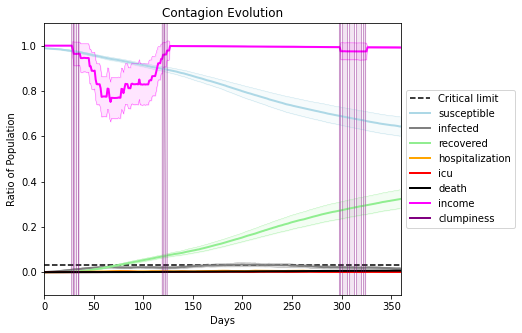

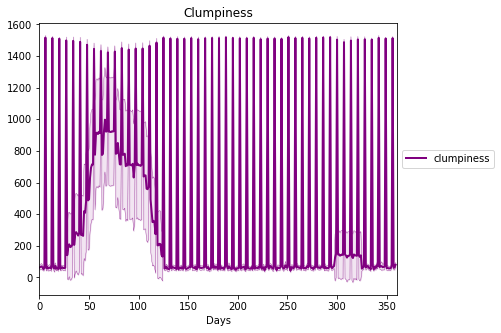

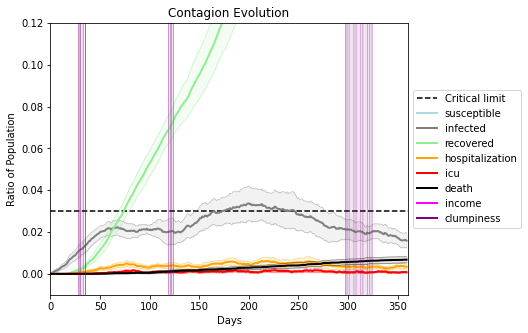

In [26]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.33
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1422, 2355, 3144, 5583, 4764, 1275, 6914, 7304, 5599, 2103, 5508, 3896, 6240, 1353, 4587, 2893, 9037, 1076, 165, 6431]
Average similarity between family members is 0.03978392886337466 at temperature 0.66
Average similarity between family and home is 0.9998537082721862 at temperature -1
Average similarity between students and their classroom is 0.06964114854379214 at temperature 0.66
Average classroom occupancy is 1.7159090909090908 and number classrooms is 176
Average similarity between workers is 0.07271860114279703 at temperature 0.66
Average office occupancy is 3.2475247524752477 and number offices is 202
Average friend similarity for adults: 0.1306392626032462 for kids: 0.1353901596904165
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildin

avg restaurant similarity 0.04264091758537812
avg restaurant similarity -0.05221952957999376
avg restaurant similarity -0.028443268707330233
avg restaurant similarity -0.04872461217499113
avg restaurant similarity -0.09157620032989457
avg restaurant similarity 0.11358403225570467
avg restaurant similarity -0.07298976687869574
avg restaurant similarity -0.010854248785616855
avg restaurant similarity -0.09810553177893788
avg restaurant similarity -0.08434765029128212
avg restaurant similarity -0.028912009532444615
avg restaurant similarity -0.027867464531182936
avg restaurant similarity -0.17407245144219377
avg restaurant similarity -0.17226466399974164
avg restaurant similarity 0.06716182864629028
avg restaurant similarity 0.00986063869222059
avg restaurant similarity -0.16481019693707052
avg restaurant similarity -0.15498388169686556
avg restaurant similarity 0.0467239651327911
avg restaurant similarity -0.06526422726766735
avg restaurant similarity 0.0860293618770345
avg restaurant si

avg restaurant similarity 0.11315949585343629
avg restaurant similarity 0.08159248732091272
avg restaurant similarity 0.0627954507826256
avg restaurant similarity -0.0642973896035244
avg restaurant similarity 0.20733631387759371
avg restaurant similarity 0.1821697841248899
avg restaurant similarity -0.02531008227016623
avg restaurant similarity 0.054271736562419355
avg restaurant similarity -0.006185776718050769
avg restaurant similarity 0.05219219895651287
avg restaurant similarity 0.013579845205571027
avg restaurant similarity 0.013445225416893037
avg restaurant similarity 0.1109559845393827
avg restaurant similarity 0.12446420372369582
avg restaurant similarity -0.07949981967252569
avg restaurant similarity 0.03635517967915704
avg restaurant similarity -0.061128940073227216
avg restaurant similarity 0.006142896425376167
avg restaurant similarity 0.113926453343462
avg restaurant similarity 0.12028374411769742
avg restaurant similarity 0.07325895071605151
avg restaurant similarity -0.

avg restaurant similarity -0.10763669337324229
avg restaurant similarity -0.12602686703271174
avg restaurant similarity 0.06469480569375664
avg restaurant similarity -0.06321320075278182
avg restaurant similarity -0.01174807927414304
avg restaurant similarity -0.005262735749731989
avg restaurant similarity 0.04303070281747431
avg restaurant similarity -0.24794967263916395
Average similarity between family members is 0.08081387536905096 at temperature 0.66
Average similarity between family and home is 0.9998575619881392 at temperature -1
Average similarity between students and their classroom is 0.0789645024202675 at temperature 0.66
Average classroom occupancy is 1.5956284153005464 and number classrooms is 183
Average similarity between workers is 0.06886089185495282 at temperature 0.66
Average office occupancy is 3.2195121951219514 and number offices is 205
Average friend similarity for adults: 0.12487199429855672 for kids: 0.14176188042120855
home_districts
[
Home (0,0) district with

avg restaurant similarity -0.045535670320882154
avg restaurant similarity 0.024784931099315337
avg restaurant similarity 0.003936200268900388
avg restaurant similarity 0.2347458900534147
avg restaurant similarity -0.0639909881932735
avg restaurant similarity 0.13458463691173064
avg restaurant similarity 0.10650422191169394
avg restaurant similarity 0.09298328112922037
avg restaurant similarity 0.05675903694088804
avg restaurant similarity 0.10377489089721684
avg restaurant similarity 0.08825857537829607
avg restaurant similarity 0.08527680143428487
avg restaurant similarity -0.2743632252859448
avg restaurant similarity 0.1961407636189942
avg restaurant similarity -0.008377920199610573
avg restaurant similarity 0.015929683002716404
avg restaurant similarity 0.053796026509987535
avg restaurant similarity 0.00759846932762302
avg restaurant similarity -0.08774795291885817
avg restaurant similarity -0.07063946800154497
avg restaurant similarity 0.10722480512512181
avg restaurant similarity 

avg restaurant similarity -0.0289043863332641
avg restaurant similarity -0.11203873165723723
avg restaurant similarity -0.1059582441377242
avg restaurant similarity 0.006481556957194939
avg restaurant similarity -0.07011598009543246
avg restaurant similarity -0.21321872768613942
avg restaurant similarity -0.05932751617385634
avg restaurant similarity 0.10001183277740316
avg restaurant similarity -0.01687147510456659
avg restaurant similarity 0.052279947221362026
avg restaurant similarity 0.06392621090749451
avg restaurant similarity -0.2198258122380609
avg restaurant similarity 0.19089397916017278
avg restaurant similarity 0.14789140789941277
avg restaurant similarity -0.02595262566017091
avg restaurant similarity 0.06122310420537145
avg restaurant similarity 0.02160384524530548
avg restaurant similarity -0.054735154438246364
avg restaurant similarity 0.13977723707376424
avg restaurant similarity -0.007178223943702172
avg restaurant similarity -0.0689584174935176
avg restaurant similar

Average similarity between workers is 0.07638512069506301 at temperature 0.66
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.13083785739267564 for kids: 0.12733089937202638
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 8 people.
Total of 8 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 pe

avg restaurant similarity -0.05600771523159403
avg restaurant similarity 0.005328484827906327
avg restaurant similarity -0.048990444446583584
avg restaurant similarity -0.01915785753473894
avg restaurant similarity -0.05348722423802976
avg restaurant similarity 0.06465635191322333
avg restaurant similarity 0.045575498572421366
avg restaurant similarity 0.04624315930202836
avg restaurant similarity -0.07679102101386767
avg restaurant similarity -0.14781216676738398
avg restaurant similarity 0.08131920177062696
avg restaurant similarity -0.28515388921563306
avg restaurant similarity -0.09309279073585545
avg restaurant similarity 0.05157603983192136
avg restaurant similarity -0.010915901759833403
avg restaurant similarity 0.23237113750370286
avg restaurant similarity 0.003529257404059724
avg restaurant similarity 0.04912176502175789
avg restaurant similarity 0.07984224392639291
avg restaurant similarity 0.11859765608604994
avg restaurant similarity -0.06339817871407866
avg restaurant simi

avg restaurant similarity -0.031796782865726646
avg restaurant similarity 0.02995269722978966
avg restaurant similarity 0.09844141660751853
avg restaurant similarity -0.08383249976907078
avg restaurant similarity -0.08969795206904076
avg restaurant similarity -0.18428838784488627
avg restaurant similarity 0.08811545814463889
avg restaurant similarity 0.1990689112069072
avg restaurant similarity -0.01699539092122422
avg restaurant similarity 0.20573670638716982
avg restaurant similarity 0.10387939506077548
avg restaurant similarity 0.03602027882576572
avg restaurant similarity -0.07617273321748538
avg restaurant similarity -0.0040968945467747845
avg restaurant similarity -0.054918202419038956
avg restaurant similarity -0.12549020469017483
avg restaurant similarity -0.024377707541966026
avg restaurant similarity -0.05709524891126052
avg restaurant similarity 0.0841091216591259
avg restaurant similarity -0.10503668236970329
avg restaurant similarity 0.03954073501320473
avg restaurant simi

avg restaurant similarity 0.029076019724235035
avg restaurant similarity 0.10417679616111475
avg restaurant similarity 0.0319131931996597
avg restaurant similarity -0.056524725744269956
avg restaurant similarity -0.01817631602349417
avg restaurant similarity 0.08312979094209752
avg restaurant similarity 0.1148493134995366
Average similarity between family members is 0.04501964595451746 at temperature 0.66
Average similarity between family and home is 0.999853454070959 at temperature -1
Average similarity between students and their classroom is 0.04457097609854718 at temperature 0.66
Average classroom occupancy is 1.5519125683060109 and number classrooms is 183
Average similarity between workers is 0.06487264454304667 at temperature 0.66
Average office occupancy is 3.2777777777777777 and number offices is 198
Average friend similarity for adults: 0.12596714260527156 for kids: 0.1264865971974538
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wit

avg restaurant similarity 0.05822923479456934
avg restaurant similarity -0.023262487383088466
avg restaurant similarity 0.13253687420874444
avg restaurant similarity 0.08749785592514725
avg restaurant similarity -0.006193462923437052
avg restaurant similarity 0.013987793368291623
avg restaurant similarity -0.01549359109373006
avg restaurant similarity 0.12681566422810875
avg restaurant similarity 0.1910712520445647
avg restaurant similarity 0.12003666067270376
avg restaurant similarity 0.06879296007383794
avg restaurant similarity 0.24632458319076667
avg restaurant similarity 0.06941184417720324
avg restaurant similarity -0.019805401122701703
avg restaurant similarity 0.30999811075073647
avg restaurant similarity -0.14202452283047606
avg restaurant similarity 0.1310467575007787
avg restaurant similarity 0.09680889864442077
avg restaurant similarity 0.12856710176066707
avg restaurant similarity -0.04553146096991186
avg restaurant similarity 0.16828052075601724
avg restaurant similarity 

avg restaurant similarity 0.23265015430681568
avg restaurant similarity -0.01925315825189435
avg restaurant similarity -0.0011298833848994785
avg restaurant similarity -0.028896279665513655
avg restaurant similarity 0.08729212918529015
avg restaurant similarity -0.20844230620540938
avg restaurant similarity 0.09165441017200542
avg restaurant similarity -0.07017267644746394
avg restaurant similarity 0.38363462348190325
avg restaurant similarity 0.1711618007430916
avg restaurant similarity 0.03932745461966821
avg restaurant similarity 0.17788698421067925
avg restaurant similarity 0.10246333702126509
avg restaurant similarity -0.004613987064534665
avg restaurant similarity -0.14322810221515905
avg restaurant similarity 0.12137013128016219
avg restaurant similarity -0.1340883082066112
avg restaurant similarity 0.2579094274681484
avg restaurant similarity -0.12304126551443177
avg restaurant similarity 0.23178195860994646
avg restaurant similarity 0.12510146913175108
avg restaurant similarit

Average friend similarity for adults: 0.12816181685687245 for kids: 0.142468547792206
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 2 people.
Total of 2 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocat

avg restaurant similarity 0.016250140361512844
avg restaurant similarity 0.14470470617070952
avg restaurant similarity 0.15841445655358466
avg restaurant similarity 0.16956345728491662
avg restaurant similarity -0.1037800237804295
avg restaurant similarity -0.06593151949529671
avg restaurant similarity 0.0988028804428436
avg restaurant similarity 0.03536616833039543
avg restaurant similarity -0.053650023850331637
avg restaurant similarity -0.03528355270790746
avg restaurant similarity 0.14939740782089328
avg restaurant similarity -0.038768134404752935
avg restaurant similarity 0.07488130826222061
avg restaurant similarity 0.0697593906254519
avg restaurant similarity 0.02802856600054713
avg restaurant similarity 0.04681723899461956
avg restaurant similarity 0.03096512149762033
avg restaurant similarity 0.38347725755829176
avg restaurant similarity 0.03198855607657881
avg restaurant similarity 0.058244061551393285
avg restaurant similarity 0.10411598194896822
avg restaurant similarity 0.

avg restaurant similarity -0.012160413121325327
avg restaurant similarity 0.04968077440500221
avg restaurant similarity -0.09891338757130994
avg restaurant similarity 0.19584178209109837
avg restaurant similarity 0.10244604941573571
avg restaurant similarity 0.09665043013180832
avg restaurant similarity 0.09790850711733759
avg restaurant similarity -0.032189657569127846
avg restaurant similarity 0.08671676320475462
avg restaurant similarity -0.12304694911773761
avg restaurant similarity 0.02798733623073607
avg restaurant similarity -0.050562840645722584
avg restaurant similarity 0.005166931105936079
avg restaurant similarity 0.14521478226268283
avg restaurant similarity -0.013283155771206426
avg restaurant similarity 0.09499082807617412
avg restaurant similarity 0.41536716165500187
avg restaurant similarity 0.11819405434285311
avg restaurant similarity -0.09028603789907212
avg restaurant similarity 0.0991789064169946
avg restaurant similarity 0.0012479049523939807
avg restaurant simila

avg restaurant similarity -0.06813318536962856
avg restaurant similarity 0.17200942207505457
Average similarity between family members is 0.07344648614233909 at temperature 0.66
Average similarity between family and home is 0.9998579033305028 at temperature -1
Average similarity between students and their classroom is 0.01819547639606709 at temperature 0.66
Average classroom occupancy is 1.5178571428571428 and number classrooms is 168
Average similarity between workers is 0.019983268746213145 at temperature 0.66
Average office occupancy is 3.395121951219512 and number offices is 205
Average friend similarity for adults: 0.12772467384673408 for kids: 0.11501904144389836
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allo

avg restaurant similarity -0.09182636166868623
avg restaurant similarity 0.12651076347906906
avg restaurant similarity -0.04140873148892711
avg restaurant similarity 0.06084542256938623
avg restaurant similarity 0.009972587786997025
avg restaurant similarity -0.08057650083361247
avg restaurant similarity -0.0977904928333981
avg restaurant similarity -0.05613518806090957
avg restaurant similarity -0.17808989515151957
avg restaurant similarity -0.05194956325791582
avg restaurant similarity -0.028975519704620336
avg restaurant similarity 0.05331832984289198
avg restaurant similarity 0.04289690399998173
avg restaurant similarity -0.18206155954367914
avg restaurant similarity 0.016942888452969023
avg restaurant similarity 0.08785634713571572
avg restaurant similarity -0.07540213539977317
avg restaurant similarity -0.07257201808593673
avg restaurant similarity 0.012867496836141976
avg restaurant similarity 0.08921154618828055
avg restaurant similarity 0.1144634761054191
avg restaurant simila

avg restaurant similarity -0.01356287897451194
avg restaurant similarity 0.11135159856629544
avg restaurant similarity -0.09194873602023593
avg restaurant similarity 0.01875189685502301
avg restaurant similarity -0.013374509374216428
avg restaurant similarity -0.0033124476407918814
avg restaurant similarity -0.034016745748952935
avg restaurant similarity 0.09086513882434046
avg restaurant similarity 0.006893790832002589
avg restaurant similarity -0.03468805961124352
avg restaurant similarity -0.07269285029467391
avg restaurant similarity -0.03321272320863952
avg restaurant similarity -0.08803306898072905
avg restaurant similarity 0.17189322638732552
avg restaurant similarity -0.08832757892772897
avg restaurant similarity 0.12449869409200703
avg restaurant similarity 0.029809007820865867
avg restaurant similarity -0.2089252150814369
avg restaurant similarity -0.13689126852862288
avg restaurant similarity 0.14978012328291496
avg restaurant similarity -0.06206590658821611
avg restaurant s

avg restaurant similarity -0.09515310367262672
avg restaurant similarity -0.04691921410687798
avg restaurant similarity -0.02233324085968011
avg restaurant similarity 0.08537921316684313
avg restaurant similarity -0.14053776452868255
Average similarity between family members is 0.047550884179339586 at temperature 0.66
Average similarity between family and home is 0.9998495344568 at temperature -1
Average similarity between students and their classroom is 0.09465466200252294 at temperature 0.66
Average classroom occupancy is 1.7011494252873562 and number classrooms is 174
Average similarity between workers is 0.060321881902798635 at temperature 0.66
Average office occupancy is 3.313131313131313 and number offices is 198
Average friend similarity for adults: 0.12928476386879842 for kids: 0.13853242608530264
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people 

avg restaurant similarity 0.008590514117980827
avg restaurant similarity -0.03440668907191944
avg restaurant similarity -0.17801659594998134
avg restaurant similarity 0.22955122307633047
avg restaurant similarity -0.11861244200314101
avg restaurant similarity 0.04831573316247106
avg restaurant similarity 0.14733245514397575
avg restaurant similarity -0.003120931527233204
avg restaurant similarity 0.1176058375937703
avg restaurant similarity 0.27538160898209885
avg restaurant similarity 0.10102700431172806
avg restaurant similarity 0.2176265398450288
avg restaurant similarity 0.28748958359327553
avg restaurant similarity 0.19525005050493954
avg restaurant similarity -0.09133391299826382
avg restaurant similarity 0.1874014083041986
avg restaurant similarity 0.05100323934864132
avg restaurant similarity -0.2615727205374693
avg restaurant similarity 0.11418587245072938
avg restaurant similarity 0.15294015711986766
avg restaurant similarity -0.002793913660390802
avg restaurant similarity 0.

avg restaurant similarity 0.14720049788978024
avg restaurant similarity 0.1048844928841683
avg restaurant similarity 0.1108691756067544
avg restaurant similarity 0.12409406194172115
avg restaurant similarity 0.18269392016994113
avg restaurant similarity 0.16663893153639595
avg restaurant similarity 0.197414857956434
avg restaurant similarity 0.16705311824842606
avg restaurant similarity 0.032678128326811565
avg restaurant similarity 0.18725196904085487
avg restaurant similarity 0.08473754943278355
avg restaurant similarity 0.07732005587076284
avg restaurant similarity 0.27284155228227774
avg restaurant similarity 0.1591251208580101
avg restaurant similarity 0.06744849339551474
avg restaurant similarity 0.07221941618748107
avg restaurant similarity 0.12868535359702996
avg restaurant similarity 0.0012515032616510814
avg restaurant similarity 0.2757951751130522
avg restaurant similarity 0.2445675561759647
avg restaurant similarity 0.46843084168840593
avg restaurant similarity 0.1521945836

Average similarity between workers is 0.05533664250911103 at temperature 0.66
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.12183940746868442 for kids: 0.12582788968577033
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocat

avg restaurant similarity 0.009140642575417876
avg restaurant similarity 0.09172330419636059
avg restaurant similarity 0.21887084741510346
avg restaurant similarity -0.06483248696159176
avg restaurant similarity 0.2394205736856104
avg restaurant similarity 0.06200905077476745
avg restaurant similarity 0.07576252276103672
avg restaurant similarity -0.08929442786121132
avg restaurant similarity -0.04992511171604517
avg restaurant similarity 0.058949343060753924
avg restaurant similarity -0.08525102778204001
avg restaurant similarity 0.05777435321663913
avg restaurant similarity -0.21256244817375955
avg restaurant similarity 0.11081738485980702
avg restaurant similarity 0.180731924112706
avg restaurant similarity 0.20172910089544302
avg restaurant similarity -0.07228486023947814
avg restaurant similarity 0.11493561770358417
avg restaurant similarity 0.14837853762437284
avg restaurant similarity 0.2351683714371088
avg restaurant similarity 0.05577567172163765
avg restaurant similarity -0.0

avg restaurant similarity 0.18149851462723637
avg restaurant similarity -0.10508747583171468
avg restaurant similarity 0.37503644328144115
avg restaurant similarity -0.2475020455317055
avg restaurant similarity -0.21373446541372365
avg restaurant similarity 0.00019416562272063972
avg restaurant similarity -0.28180693892034236
avg restaurant similarity 0.05777917414277822
avg restaurant similarity 0.13497590830476913
avg restaurant similarity 0.17046753965641573
avg restaurant similarity 0.01127050708088428
avg restaurant similarity 0.41469943904995454
avg restaurant similarity 0.0044055605848656865
avg restaurant similarity -0.134504724638533
avg restaurant similarity 0.014108903246122649
avg restaurant similarity 0.3017791028230619
avg restaurant similarity -0.012723357262886259
avg restaurant similarity 0.027790598360507266
avg restaurant similarity 0.06706291990103308
avg restaurant similarity 0.053637468291216094
avg restaurant similarity 0.07657988205358071
avg restaurant similari

avg restaurant similarity -0.04595871674867798
avg restaurant similarity -0.08729492426840348
avg restaurant similarity -0.02346665593046404
Average similarity between family members is 0.04569094685946937 at temperature 0.66
Average similarity between family and home is 0.9998539872147731 at temperature -1
Average similarity between students and their classroom is 0.07520707064523836 at temperature 0.66
Average classroom occupancy is 1.5444444444444445 and number classrooms is 180
Average similarity between workers is 0.054739114271760606 at temperature 0.66
Average office occupancy is 3.29 and number offices is 200
Average friend similarity for adults: 0.11427682534024164 for kids: 0.12152865134589279
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each wi

avg restaurant similarity 0.0999014955435474
avg restaurant similarity 0.08805579660187599
avg restaurant similarity 0.014808126925908419
avg restaurant similarity 0.20663221223433834
avg restaurant similarity 0.11784558628520173
avg restaurant similarity 0.05405543809581673
avg restaurant similarity -0.022631181465161066
avg restaurant similarity 0.22949233107336964
avg restaurant similarity 0.06141085350998094
avg restaurant similarity -0.17001980456035906
avg restaurant similarity -0.08806030556672115
avg restaurant similarity 0.09190975945956192
avg restaurant similarity 0.03991078002864587
avg restaurant similarity 0.26430031856748326
avg restaurant similarity 0.12861723182430346
avg restaurant similarity 0.039473789050327036
avg restaurant similarity 0.05306033963604821
avg restaurant similarity 0.000973224027763904
avg restaurant similarity 0.1827409155837479
avg restaurant similarity 0.03778978452584434
avg restaurant similarity 0.09918993560819708
avg restaurant similarity 0.2

avg restaurant similarity -6.937890141400782e-05
avg restaurant similarity 0.22986658191203282
avg restaurant similarity -0.19573883374243503
avg restaurant similarity -0.11740406586571113
avg restaurant similarity -0.11183869262286691
avg restaurant similarity 0.003154690558154779
avg restaurant similarity 0.35198229385198987
avg restaurant similarity 0.03525513656350088
avg restaurant similarity -0.17760884694398119
avg restaurant similarity 0.17813839452924862
avg restaurant similarity 0.1586625542523564
avg restaurant similarity -0.034111623554676083
avg restaurant similarity 0.06930297234063586
avg restaurant similarity 0.1625360295241052
avg restaurant similarity -0.07376941300324649
avg restaurant similarity -0.15270122765275698
avg restaurant similarity 0.08511672849991146
avg restaurant similarity -0.13590869629170535
avg restaurant similarity -0.056843518698765805
avg restaurant similarity 0.08847700643793473
avg restaurant similarity 0.04264030040753402
avg restaurant simila

Average friend similarity for adults: 0.1265726320462196 for kids: 0.12135909698058447
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 9 people.
Total of 9 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (4,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 alloca

avg restaurant similarity 0.07634472428275599
avg restaurant similarity 0.1367761035034382
avg restaurant similarity 0.09417978600464792
avg restaurant similarity -0.04775088880774303
avg restaurant similarity 0.04427573733651103
avg restaurant similarity 0.13415483299288
avg restaurant similarity 0.0081394556343102
avg restaurant similarity 0.09910675592154478
avg restaurant similarity 0.2374507354159554
avg restaurant similarity 0.022855789748916482
avg restaurant similarity 0.025460534994410994
avg restaurant similarity -0.06363747775268547
avg restaurant similarity 0.05173080081617243
avg restaurant similarity -0.08311873014847393
avg restaurant similarity 0.10495124890091603
avg restaurant similarity -0.06890038074376206
avg restaurant similarity -0.06785925285949569
avg restaurant similarity 0.23614616170577252
avg restaurant similarity 0.09988466600717767
avg restaurant similarity 0.12931751303811853
avg restaurant similarity 0.2647136628299675
avg restaurant similarity -0.08185

avg restaurant similarity -0.15579518530828687
avg restaurant similarity -0.09603262949406896
avg restaurant similarity -0.050812089197245745
avg restaurant similarity -0.04611519037103991
avg restaurant similarity 0.032076186740124815
avg restaurant similarity -0.04846569859878791
avg restaurant similarity -0.020102954159900294
avg restaurant similarity 0.20012985552350587
avg restaurant similarity 0.054524447249009476
avg restaurant similarity 0.03592135118049287
avg restaurant similarity 0.035954347145114515
avg restaurant similarity 0.15613529594706904
avg restaurant similarity -0.08072889294344834
avg restaurant similarity 0.04427681499789143
avg restaurant similarity -0.04486804183318452
avg restaurant similarity 0.14253633529370419
avg restaurant similarity 0.039971500009185444
avg restaurant similarity 0.21922297722139647
avg restaurant similarity 0.0275669604875326
avg restaurant similarity -0.23131149216544283
avg restaurant similarity -0.07436067613346772
avg restaurant simi

avg restaurant similarity -0.02952377671790764
avg restaurant similarity 0.019154412466726348
avg restaurant similarity 0.09988274506938111
avg restaurant similarity 0.10415567046244592
avg restaurant similarity 0.004073836341155429
avg restaurant similarity 0.07834409890051859
Average similarity between family members is 0.08901945048624657 at temperature 0.66
Average similarity between family and home is 0.9998418797439531 at temperature -1
Average similarity between students and their classroom is 0.07447626437980595 at temperature 0.66
Average classroom occupancy is 1.5449735449735449 and number classrooms is 189
Average similarity between workers is 0.07054830124558797 at temperature 0.66
Average office occupancy is 3.262376237623762 and number offices is 202
Average friend similarity for adults: 0.12760368370130368 for kids: 0.13092045191256424
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units 

avg restaurant similarity -0.1330799071637366
avg restaurant similarity 0.06745963628579013
avg restaurant similarity 0.006228460865656849
avg restaurant similarity -0.08631079211100937
avg restaurant similarity 0.09836550430782012
avg restaurant similarity 0.034368719699871084
avg restaurant similarity 0.2895055714866484
avg restaurant similarity -0.06145997416696972
avg restaurant similarity -0.07819258584803285
avg restaurant similarity 0.005354683532534061
avg restaurant similarity 0.07228550428360156
avg restaurant similarity -0.13089114948947791
avg restaurant similarity 0.13754989479375382
avg restaurant similarity 0.018927606132008157
avg restaurant similarity 0.07460920042281369
avg restaurant similarity 0.2967876356564673
avg restaurant similarity -0.04011204946953212
avg restaurant similarity 0.03160855495282148
avg restaurant similarity -0.0011112761750240226
avg restaurant similarity 0.16251626744327569
avg restaurant similarity -0.23765652774061494
avg restaurant similari

avg restaurant similarity -0.12188862318991305
avg restaurant similarity 0.06963036001505016
avg restaurant similarity -0.09385096389160731
avg restaurant similarity -0.06300241042231446
avg restaurant similarity -0.2584241412535618
avg restaurant similarity 0.10374875259206473
avg restaurant similarity 0.1737950593125872
avg restaurant similarity 0.08407741865946483
avg restaurant similarity -0.08831923941787408
avg restaurant similarity 0.07381177611069455
avg restaurant similarity 0.047501452987770386
avg restaurant similarity 0.12337069683837756
avg restaurant similarity 0.1867295747955774
avg restaurant similarity 0.1644853382146997
avg restaurant similarity 0.0244747507429399
avg restaurant similarity -0.12262230051316028
avg restaurant similarity 0.04515824924003597
avg restaurant similarity -0.2046319837320461
avg restaurant similarity 0.19234975286423103
avg restaurant similarity -0.02272529455370688
avg restaurant similarity 0.2566710591294601
avg restaurant similarity -0.099

avg restaurant similarity 0.004085706275131255
avg restaurant similarity 0.20487670220626708
Average similarity between family members is 0.02750652177187799 at temperature 0.66
Average similarity between family and home is 0.999855169395912 at temperature -1
Average similarity between students and their classroom is 0.051019660365948294 at temperature 0.66
Average classroom occupancy is 1.739884393063584 and number classrooms is 173
Average similarity between workers is 0.04601832642711868 at temperature 0.66
Average office occupancy is 3.241206030150754 and number offices is 199
Average friend similarity for adults: 0.11827072271237137 for kids: 0.12672710701895687
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 alloca

avg restaurant similarity -0.0036390890097764196
avg restaurant similarity -0.09516269435236967
avg restaurant similarity 0.042302624457916084
avg restaurant similarity -0.22138988369130388
avg restaurant similarity 0.04773749925412582
avg restaurant similarity -0.08632946944091499
avg restaurant similarity 0.013483714059260457
avg restaurant similarity -0.18568697898360745
avg restaurant similarity -0.09183393634745612
avg restaurant similarity -0.12146336901791571
avg restaurant similarity -0.25520108889466625
avg restaurant similarity -0.026368870440027087
avg restaurant similarity 0.020772239581149415
avg restaurant similarity -0.14436865648540878
avg restaurant similarity 0.007402612692313761
avg restaurant similarity 0.12779232031858787
avg restaurant similarity -0.01435232748266604
avg restaurant similarity 0.11536312319509025
avg restaurant similarity -0.012007358830686477
avg restaurant similarity 0.0053520730159581755
avg restaurant similarity -0.09987343484236956
avg restaur

avg restaurant similarity 0.04819628863272243
avg restaurant similarity 0.026176053263304837
avg restaurant similarity -0.014333536217293065
avg restaurant similarity 0.050199253434149285
avg restaurant similarity -0.03014277388309833
avg restaurant similarity -0.0857398846131642
avg restaurant similarity -0.015490021101695554
avg restaurant similarity 0.11571525406648081
avg restaurant similarity 0.35662138081547873
avg restaurant similarity 0.006319253597758995
avg restaurant similarity -0.025101469118593123
avg restaurant similarity 0.019892174112548115
avg restaurant similarity 0.00788970794587393
avg restaurant similarity -0.0850803067120852
avg restaurant similarity 0.044124275470765854
avg restaurant similarity 0.049633929572597886
avg restaurant similarity 0.058370684161865596
avg restaurant similarity -0.10172563532862232
avg restaurant similarity -0.056244302660351624
avg restaurant similarity -0.06555517923301288
avg restaurant similarity -0.059589919932042615
avg restaurant

avg restaurant similarity 0.08598586757053658
avg restaurant similarity -0.044107186740846314
avg restaurant similarity -0.024124730768359137
avg restaurant similarity -0.013568565778219285
avg restaurant similarity -0.05223779754725366
Average similarity between family members is 0.049649206097329354 at temperature 0.66
Average similarity between family and home is 0.9998620972235086 at temperature -1
Average similarity between students and their classroom is 0.06441000410330183 at temperature 0.66
Average classroom occupancy is 1.622093023255814 and number classrooms is 172
Average similarity between workers is 0.04691194180864247 at temperature 0.66
Average office occupancy is 3.2561576354679804 and number offices is 203
Average friend similarity for adults: 0.12508026725206298 for kids: 0.11696729022348147
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 6 people.
Total of 6 peop

avg restaurant similarity 0.05327065453428939
avg restaurant similarity -0.17092237287070447
avg restaurant similarity -0.18431132162406486
avg restaurant similarity -0.01288231991366514
avg restaurant similarity -0.09380524733214757
avg restaurant similarity -0.1107168010521488
avg restaurant similarity -0.16206603405000672
avg restaurant similarity 0.01795729810216216
avg restaurant similarity 0.04924976895765487
avg restaurant similarity -0.1155507822747026
avg restaurant similarity 0.13964160009838086
avg restaurant similarity 0.2147895400702875
avg restaurant similarity 0.23054509101171117
avg restaurant similarity 0.12707198695803884
avg restaurant similarity 0.14230265858046437
avg restaurant similarity -0.08707256992565277
avg restaurant similarity 0.06294056363384369
avg restaurant similarity -0.34003047346537485
avg restaurant similarity 0.19150308099553043
avg restaurant similarity 0.0011701808476077085
avg restaurant similarity 0.003025345097472029
avg restaurant similarity

avg restaurant similarity -0.19458461428248727
avg restaurant similarity -0.25965914533272594
avg restaurant similarity 0.13251529861280975
avg restaurant similarity -0.21367175278487377
avg restaurant similarity 0.010123612877107021
avg restaurant similarity 0.2560307079605803
avg restaurant similarity -0.07621069138882795
avg restaurant similarity 0.04316707303876465
avg restaurant similarity 0.005078082404596951
avg restaurant similarity 0.013610375417555429
avg restaurant similarity -0.009586709314514876
avg restaurant similarity 0.012997068000335586
avg restaurant similarity 0.13516488231335735
avg restaurant similarity 0.04327374141639897
avg restaurant similarity -0.10510019013842982
avg restaurant similarity 0.032709751212888785
avg restaurant similarity -0.007923210161766385
avg restaurant similarity -0.1152151205986985
avg restaurant similarity 0.10657317659794459
avg restaurant similarity 0.2018036004882969
avg restaurant similarity -0.005946645450803048
avg restaurant simil

Average similarity between workers is 0.06255767607597147 at temperature 0.66
Average office occupancy is 3.355 and number offices is 200
Average friend similarity for adults: 0.13521571157753945 for kids: 0.1526491948296936
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 1 people.
Total of 1 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people alloc

avg restaurant similarity -0.15872842554497482
avg restaurant similarity 0.0907957437704933
avg restaurant similarity 0.0670494975069024
avg restaurant similarity 0.11594989749206604
avg restaurant similarity 0.06447504578601977
avg restaurant similarity 0.08448606785039255
avg restaurant similarity -0.008572559148919894
avg restaurant similarity -0.14491226512867011
avg restaurant similarity 0.04491507154127394
avg restaurant similarity 0.008888409076044474
avg restaurant similarity 0.04469256436661227
avg restaurant similarity 0.007965191186059855
avg restaurant similarity 0.2845707065235416
avg restaurant similarity 0.15149898988038935
avg restaurant similarity 0.11627031389331567
avg restaurant similarity 0.25073628325171776
avg restaurant similarity -0.11770960823483854
avg restaurant similarity 0.1429063289203475
avg restaurant similarity 0.13138011884869685
avg restaurant similarity 0.24024744720784277
avg restaurant similarity 0.11822633035617466
avg restaurant similarity 0.031

avg restaurant similarity 0.13316646655745415
avg restaurant similarity 0.03275697871742111
avg restaurant similarity 0.226968494472874
avg restaurant similarity 0.03085086271077761
avg restaurant similarity -0.18514959289354302
avg restaurant similarity 0.12418647353119341
avg restaurant similarity 0.10505158893545907
avg restaurant similarity -0.04659580783226907
avg restaurant similarity 0.006622974167421028
avg restaurant similarity 0.018741378944376677
avg restaurant similarity -0.4054989288447851
avg restaurant similarity 0.035084486340119445
avg restaurant similarity 0.0022313040041554806
avg restaurant similarity 0.08892303774859733
avg restaurant similarity -0.14566696240175248
avg restaurant similarity 0.030099192638107185
avg restaurant similarity -0.0774550853251197
avg restaurant similarity -0.006200016244058526
avg restaurant similarity 0.1324584633732655
avg restaurant similarity -0.07494480318172637
avg restaurant similarity -0.08393120956351506
avg restaurant similarit

Average similarity between family and home is 0.9998624927402933 at temperature -1
Average similarity between students and their classroom is 0.09165930664156173 at temperature 0.66
Average classroom occupancy is 1.5810055865921788 and number classrooms is 179
Average similarity between workers is 0.02756268331514931 at temperature 0.66
Average office occupancy is 3.2935323383084576 and number offices is 201
Average friend similarity for adults: 0.1213300760436935 for kids: 0.12245249504658008
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 19 people.
Total of 19 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for

avg restaurant similarity -0.02492177108290855
avg restaurant similarity -0.015956303703711046
avg restaurant similarity 0.040534784891578544
avg restaurant similarity 0.03531640930821198
avg restaurant similarity -0.023453938373123234
avg restaurant similarity 0.05013133123951217
avg restaurant similarity 0.23204462740489998
avg restaurant similarity 0.0018332000502213745
avg restaurant similarity 0.04081274904338242
avg restaurant similarity 0.10628388996046798
avg restaurant similarity -0.12043408683111523
avg restaurant similarity 0.09542669540164936
avg restaurant similarity 0.07555479271698874
avg restaurant similarity -0.015998182850757724
avg restaurant similarity -0.04895740708119804
avg restaurant similarity -0.08624338356467849
avg restaurant similarity -0.1964940689978713
avg restaurant similarity 0.135473182240048
avg restaurant similarity -0.037852923406866926
avg restaurant similarity -0.2705124880041536
avg restaurant similarity 0.010311701511101695
avg restaurant simil

avg restaurant similarity -0.12447703668560642
avg restaurant similarity -0.003076822405428045
avg restaurant similarity -0.0328591589451209
avg restaurant similarity 0.030114568931305208
avg restaurant similarity 0.1463926667837798
avg restaurant similarity -0.09214879636473734
avg restaurant similarity 0.05894545187814245
avg restaurant similarity 0.054584563003143974
avg restaurant similarity -0.31272718354575424
avg restaurant similarity 0.19358066965341203
avg restaurant similarity 0.033255136760276714
avg restaurant similarity 0.04181279506659665
avg restaurant similarity -0.07272532351700083
avg restaurant similarity 0.07631149940379701
avg restaurant similarity 0.027187651545415206
avg restaurant similarity -0.07974148483750348
avg restaurant similarity -0.1323001807987022
avg restaurant similarity 0.19062814054586563
avg restaurant similarity 0.03992583958054662
avg restaurant similarity 0.0126694234244491
avg restaurant similarity -0.17421013308866776
avg restaurant similarit

Average similarity between family and home is 0.9998462384588223 at temperature -1
Average similarity between students and their classroom is 0.0704710932428724 at temperature 0.66
Average classroom occupancy is 1.7396449704142012 and number classrooms is 169
Average similarity between workers is 0.04474578107211451 at temperature 0.66
Average office occupancy is 3.2039800995024876 and number offices is 201
Average friend similarity for adults: 0.1309405560808322 for kids: 0.13510714187047743
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 

avg restaurant similarity 0.1943538977307513
avg restaurant similarity -0.06194562818984047
avg restaurant similarity -0.0456824574806731
avg restaurant similarity 0.08791806241926833
avg restaurant similarity 0.0800917222847037
avg restaurant similarity 0.08244690521911092
avg restaurant similarity 0.0012252451927733017
avg restaurant similarity 0.04470782638703868
avg restaurant similarity -0.03961408149325931
avg restaurant similarity 0.13808265879607776
avg restaurant similarity -0.030143740376972608
avg restaurant similarity -0.09581182724258469
avg restaurant similarity -0.002754996145047436
avg restaurant similarity 0.17936231915169343
avg restaurant similarity 0.13728865399531692
avg restaurant similarity 0.01833751637450815
avg restaurant similarity 0.008331520381759805
avg restaurant similarity 0.09732501415205012
avg restaurant similarity 0.18117928983839354
avg restaurant similarity 0.1464304177008085
avg restaurant similarity 0.18150600325275335
avg restaurant similarity 0

avg restaurant similarity 0.10455814543878035
avg restaurant similarity 0.0023083104626289972
avg restaurant similarity -0.09320136965161353
avg restaurant similarity 0.11102827955413974
avg restaurant similarity 0.1187246132073979
avg restaurant similarity 0.10602036469313329
avg restaurant similarity -0.025898043897824633
avg restaurant similarity -0.2564385324419196
avg restaurant similarity -0.09545183169860648
avg restaurant similarity 0.2579539476807672
avg restaurant similarity -0.026402522514640314
avg restaurant similarity -0.08841540975984492
avg restaurant similarity 0.10248017229426029
avg restaurant similarity -0.04631492787383141
avg restaurant similarity 0.06534932772754125
avg restaurant similarity 0.14182488384525432
avg restaurant similarity 0.008378611024906644
avg restaurant similarity 0.15971962406080553
avg restaurant similarity 0.1608053870394707
avg restaurant similarity 0.16955080244472237
avg restaurant similarity -0.007838894495172104
avg restaurant similarit

avg restaurant similarity 0.271053884564225
avg restaurant similarity -0.019640207709656403
avg restaurant similarity 0.0035262712452186684
avg restaurant similarity 0.04246809751475439
Average similarity between family members is 0.07653271076858277 at temperature 0.66
Average similarity between family and home is 0.9998480486710776 at temperature -1
Average similarity between students and their classroom is 0.07051102711331712 at temperature 0.66
Average classroom occupancy is 1.633879781420765 and number classrooms is 183
Average similarity between workers is 0.0621736849202103 at temperature 0.66
Average office occupancy is 3.189054726368159 and number offices is 201
Average friend similarity for adults: 0.13312262797127905 for kids: 0.1284216160204829
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 6 people.
Total of 6 people allocated in this district.
, 
Home (1,0) district w

avg restaurant similarity 0.09804878711414257
avg restaurant similarity -0.11339111381966391
avg restaurant similarity 0.09492642379693202
avg restaurant similarity -0.1758132603324527
avg restaurant similarity -0.0662724743684298
avg restaurant similarity -0.049582447157841214
avg restaurant similarity 0.04215867034134701
avg restaurant similarity 0.11784275064622152
avg restaurant similarity 0.027841764211429663
avg restaurant similarity 0.049367402286718286
avg restaurant similarity 0.17301199717344018
avg restaurant similarity 0.15562662860778048
avg restaurant similarity 0.009849579167483101
avg restaurant similarity -0.03885384840403772
avg restaurant similarity -0.015546423182826058
avg restaurant similarity 0.009043108693810054
avg restaurant similarity 0.03736632060769647
avg restaurant similarity 0.006739592162424362
avg restaurant similarity -0.21778736939927704
avg restaurant similarity 0.08637982606313323
avg restaurant similarity -0.041337580103111324
avg restaurant simil

avg restaurant similarity 0.03968312691352208
avg restaurant similarity -0.10100469607406744
avg restaurant similarity -0.11080257427650193
avg restaurant similarity -0.049766982829289284
avg restaurant similarity -0.03057736743225915
avg restaurant similarity -0.0140505831385698
avg restaurant similarity -0.0747801936612734
avg restaurant similarity 0.058712342390191734
avg restaurant similarity -0.08745673616758631
avg restaurant similarity 0.01841776432501175
avg restaurant similarity -0.09314486611272907
avg restaurant similarity -0.11612270977895237
avg restaurant similarity 0.0659428722667342
avg restaurant similarity -0.05452430824103015
avg restaurant similarity -0.036274215520387065
avg restaurant similarity 0.01849760196343832
avg restaurant similarity -0.06402020609786087
avg restaurant similarity 0.038487296215308574
avg restaurant similarity 0.22705944740447137
avg restaurant similarity 0.0973672900234413
avg restaurant similarity 0.17889473206413503
avg restaurant similar

avg restaurant similarity 0.1277797194032563
avg restaurant similarity 0.11634246600591108
avg restaurant similarity -0.14278930527252479
avg restaurant similarity 0.05619015643357906
avg restaurant similarity 0.10846374863014295
avg restaurant similarity -0.04895159775519824
Average similarity between family members is 0.021099264317154386 at temperature 0.66
Average similarity between family and home is 0.9998519766873584 at temperature -1
Average similarity between students and their classroom is 0.0544753723094499 at temperature 0.66
Average classroom occupancy is 1.5968586387434556 and number classrooms is 191
Average similarity between workers is 0.05169052924785996 at temperature 0.66
Average office occupancy is 3.257575757575758 and number offices is 198
Average friend similarity for adults: 0.12718299453532508 for kids: 0.11978767896305559
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units wi

avg restaurant similarity -0.04993004279200578
avg restaurant similarity 0.008800517762270088
avg restaurant similarity -0.07844188095843725
avg restaurant similarity -0.037133652417763924
avg restaurant similarity 0.008259001929034598
avg restaurant similarity 0.03525748876858967
avg restaurant similarity -0.20227298913273054
avg restaurant similarity 0.1683723357833434
avg restaurant similarity 0.05469808950977084
avg restaurant similarity 0.09813000748850181
avg restaurant similarity -0.06600961034683182
avg restaurant similarity 0.0042930534479315085
avg restaurant similarity 0.07221336222055524
avg restaurant similarity -0.14537133323072937
avg restaurant similarity 0.1553341219992247
avg restaurant similarity -0.1262605751733962
avg restaurant similarity -0.05931831741152738
avg restaurant similarity 0.07067025097132368
avg restaurant similarity 0.10373193350478592
avg restaurant similarity 0.21754395359874684
avg restaurant similarity -0.13443822029517766
avg restaurant similari

avg restaurant similarity 0.09157498206001856
avg restaurant similarity 0.09519528437926542
avg restaurant similarity -0.005997160837804646
avg restaurant similarity -0.0026069594080393326
avg restaurant similarity 0.032936882702735995
avg restaurant similarity 0.008631460551921044
avg restaurant similarity -0.03632104843068178
avg restaurant similarity 0.27313168197761184
avg restaurant similarity 0.08302938084133477
avg restaurant similarity -0.22282476224575828
avg restaurant similarity -0.09776435438172205
avg restaurant similarity 0.09718945305711427
avg restaurant similarity 0.047347166949529354
avg restaurant similarity 0.0681618910025682
avg restaurant similarity -0.007683767660626152
avg restaurant similarity 0.19141530237707594
avg restaurant similarity -0.05024728153878646
avg restaurant similarity 0.05450720454972435
avg restaurant similarity -0.06419540632115776
avg restaurant similarity 0.10172936733491378
avg restaurant similarity 0.03702903998153337
avg restaurant simil

avg restaurant similarity 0.1398869424691189
avg restaurant similarity -0.15224183439503894
avg restaurant similarity -0.06240300389302449
Average similarity between family members is 0.03268782095099549 at temperature 0.66
Average similarity between family and home is 0.9998584889769295 at temperature -1
Average similarity between students and their classroom is 0.06857741368206717 at temperature 0.66
Average classroom occupancy is 1.5953757225433527 and number classrooms is 173
Average similarity between workers is 0.0726290706419987 at temperature 0.66
Average office occupancy is 3.328358208955224 and number offices is 201
Average friend similarity for adults: 0.12440185997374928 for kids: 0.13727406145932358
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 uni

avg restaurant similarity -0.005310756597795285
avg restaurant similarity 0.08205414924550883
avg restaurant similarity -0.2903751986942256
avg restaurant similarity -0.0741444456749141
avg restaurant similarity -0.02513825156436737
avg restaurant similarity 0.3329999952278615
avg restaurant similarity -0.0786495551690736
avg restaurant similarity -0.029474453667808577
avg restaurant similarity 0.1395265946530748
avg restaurant similarity 0.05600557816855653
avg restaurant similarity -0.10526536069160503
avg restaurant similarity 0.09720503200270533
avg restaurant similarity -0.2655299769383856
avg restaurant similarity 0.11210198809224815
avg restaurant similarity -0.008308142665381704
avg restaurant similarity 0.17384621795185579
avg restaurant similarity -0.05205767219627653
avg restaurant similarity 0.020744803111462613
avg restaurant similarity -0.03642816851485829
avg restaurant similarity 0.24529507141450485
avg restaurant similarity 0.00888174096182294
avg restaurant similarity

avg restaurant similarity 0.05010118565189839
avg restaurant similarity -0.23128437645882982
avg restaurant similarity -0.11338203577495634
avg restaurant similarity -0.22283777765367752
avg restaurant similarity 0.207591338688057
avg restaurant similarity 0.0007762149271609967
avg restaurant similarity -0.15911971831899618
avg restaurant similarity 0.11742152837730525
avg restaurant similarity 0.0875295118412449
avg restaurant similarity -0.2712158592956028
avg restaurant similarity -0.12368119140830183
avg restaurant similarity -0.03165415175305536
avg restaurant similarity 0.09064136441509772
avg restaurant similarity 0.1545688908395181
avg restaurant similarity -0.02206837728729494
avg restaurant similarity 0.4096234281286091
avg restaurant similarity 0.24361854990953002
avg restaurant similarity -0.08291517419746207
avg restaurant similarity -0.16224235656345132
avg restaurant similarity 0.06964557784764235
avg restaurant similarity 0.10491388424966967
avg restaurant similarity 0.

avg restaurant similarity -0.010286516947795837
Average similarity between family members is 0.055886019801712566 at temperature 0.66
Average similarity between family and home is 0.9998624537451359 at temperature -1
Average similarity between students and their classroom is 0.045150352002902544 at temperature 0.66
Average classroom occupancy is 1.521505376344086 and number classrooms is 186
Average similarity between workers is 0.06842870935692988 at temperature 0.66
Average office occupancy is 3.2524752475247523 and number offices is 202
Average friend similarity for adults: 0.12218366250093547 for kids: 0.13536690261385137
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 0 allocated units with a total of 0 people.
Total of

avg restaurant similarity 0.12948815551155704
avg restaurant similarity 0.13778500149398165
avg restaurant similarity 0.02916356315308457
avg restaurant similarity -0.13596241423299466
avg restaurant similarity -0.01144930521466177
avg restaurant similarity -0.11078444705097039
avg restaurant similarity 0.21390659018054695
avg restaurant similarity 0.12918702679997038
avg restaurant similarity -0.04430315330909781
avg restaurant similarity -0.03215256229178332
avg restaurant similarity 0.1334796436320365
avg restaurant similarity 0.045280374783815344
avg restaurant similarity -0.049220984136352605
avg restaurant similarity 0.10269164582487644
avg restaurant similarity 0.026936039947300445
avg restaurant similarity 0.11942744985863377
avg restaurant similarity 0.04264587255307842
avg restaurant similarity 0.045862364207589754
avg restaurant similarity -0.03011973908766917
avg restaurant similarity -0.015031506454970742
avg restaurant similarity -0.02154890049885249
avg restaurant simila

avg restaurant similarity -0.0043672011960955775
avg restaurant similarity -0.03359662857428594
avg restaurant similarity -0.008526891789998192
avg restaurant similarity 0.1524535532155178
avg restaurant similarity 0.012468846456264537
avg restaurant similarity 0.10638444195821624
avg restaurant similarity -0.13300541775002586
avg restaurant similarity 0.0715403804631031
avg restaurant similarity 0.04824342537119855
avg restaurant similarity 0.049753324911570286
avg restaurant similarity -0.07066731008445522
avg restaurant similarity 0.11299965526987656
avg restaurant similarity -0.23743151049090228
avg restaurant similarity -0.09262533305299699
avg restaurant similarity 0.12594381798152673
avg restaurant similarity 0.007603431346129161
avg restaurant similarity -0.0005465370875821357
avg restaurant similarity 0.059378941094969856
avg restaurant similarity 0.01220104620989791
avg restaurant similarity 0.185299292273016
avg restaurant similarity 0.14900372440811896
avg restaurant simila

avg restaurant similarity 0.09796683059060145
avg restaurant similarity 0.048404520296894814
avg restaurant similarity 0.060026909516534714
avg restaurant similarity -0.029798318114465903
avg restaurant similarity -0.03965205700725523
avg restaurant similarity -0.00134701827963013
avg restaurant similarity 0.1363263195790555
using average of time series:
stats on susceptible:
data: [0.9067527777777779, 0.8389776889776891, 0.7954166666666668, 0.7944916666666667, 0.8802669552669553, 0.7902555555555555, 0.8618048618048618, 0.8344444444444444, 0.7925019425019425, 0.8239527777777778, 0.8235611111111112, 0.8440166666666666, 0.8723527777777779, 0.8150694444444443, 0.8370277777777779, 0.8520000000000001, 0.7920944444444444, 0.799025, 0.7737968507429585, 0.8347083333333334]
min:
0.7737968507429585
max:
0.9067527777777779
std:
0.03413487440677135
mean:
0.8281258871869426
median:
0.8291986111111112
95% confidence interval for the mean:
(0.8117352541043725,0.8445165202695126)
using average of time

(<function dict.items>, <function dict.items>, <function dict.items>)

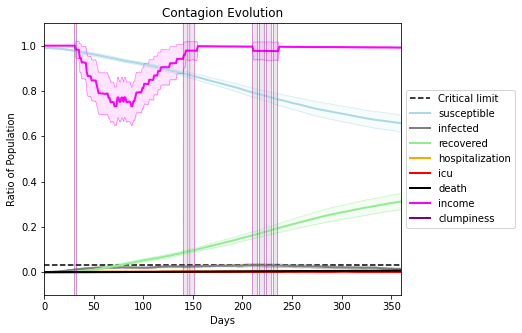

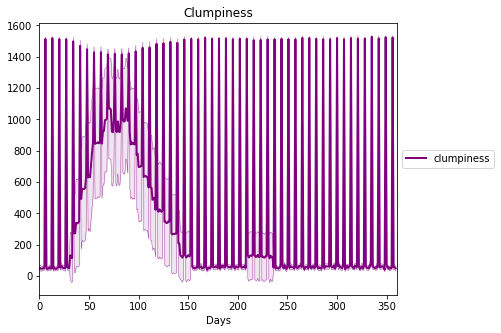

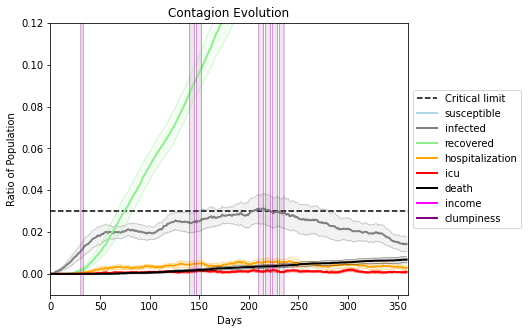

In [27]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 0.66
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)

Save these seeds if you want to rerun a scenario
[1465, 6650, 2112, 7269, 1049, 9954, 7322, 2270, 1861, 6890, 6687, 2769, 1812, 9061, 7780, 5392, 6291, 4293, 7666, 8742]
Average similarity between family members is 0.0008308832696422991 at temperature 1
Average similarity between family and home is 0.9998630717859308 at temperature -1
Average similarity between students and their classroom is 0.006717798444079139 at temperature 1
Average classroom occupancy is 1.6519337016574585 and number classrooms is 181
Average similarity between workers is -0.017563808323051416 at temperature 1
Average office occupancy is 3.228855721393035 and number offices is 201
Average friend similarity for adults: 0.08056765456440121 for kids: 0.08737556432058784
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (1,0) district with 1 Buildings

avg restaurant similarity -0.031585239901940884
avg restaurant similarity 0.15152305321720438
avg restaurant similarity -0.03397546276903374
avg restaurant similarity -0.09116862713787072
avg restaurant similarity 0.031915052027500085
avg restaurant similarity -0.12234624414528103
avg restaurant similarity -0.13350741436688196
avg restaurant similarity -0.113732137986392
avg restaurant similarity -0.054207040176117834
avg restaurant similarity 0.0887849898095417
avg restaurant similarity 0.057328647021116015
avg restaurant similarity 0.11498061304958365
avg restaurant similarity -0.04760629730396268
avg restaurant similarity -0.3316760857060799
avg restaurant similarity -0.01029365254757373
avg restaurant similarity -0.09241067643316818
avg restaurant similarity -0.04205548294340136
avg restaurant similarity 0.12849456768093373
avg restaurant similarity 0.054866773124252116
avg restaurant similarity -0.0624272580868066
avg restaurant similarity -0.09178966643683478
avg restaurant simil

avg restaurant similarity 0.4641277969914324
avg restaurant similarity 0.22202991191306054
avg restaurant similarity 0.12112064636927444
avg restaurant similarity 0.019101570389203106
avg restaurant similarity 0.34420894399290214
avg restaurant similarity 0.24703060411671757
avg restaurant similarity 0.15241554988878728
avg restaurant similarity 0.09032208703717165
avg restaurant similarity -0.2065274378940389
avg restaurant similarity 0.11817260742234037
avg restaurant similarity 0.13585387934149823
avg restaurant similarity 0.0843331829489061
avg restaurant similarity -0.031625764687679275
avg restaurant similarity 0.017017728379538424
avg restaurant similarity -0.13611881469804088
avg restaurant similarity 0.004359908148396398
avg restaurant similarity 0.058247252305545026
avg restaurant similarity -0.05397118333280924
avg restaurant similarity -0.36664491028955243
avg restaurant similarity 0.0709717746574474
avg restaurant similarity -0.023974166485572365
avg restaurant similarity 

Average similarity between family and home is 0.9998626459508253 at temperature -1
Average similarity between students and their classroom is 0.0270958081746284 at temperature 1
Average classroom occupancy is 1.5803108808290156 and number classrooms is 193
Average similarity between workers is 0.012487070067210952 at temperature 1
Average office occupancy is 3.287878787878788 and number offices is 198
Average friend similarity for adults: 0.09079253777937082 for kids: 0.08458392906457084
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of 4 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 peopl

avg restaurant similarity 0.25023541901556573
avg restaurant similarity -0.10852320041441807
avg restaurant similarity 0.09747271708305806
avg restaurant similarity 0.08704915498540322
avg restaurant similarity 0.02985048160767452
avg restaurant similarity 0.07906264029230618
avg restaurant similarity 0.3180212998239339
avg restaurant similarity -0.07004770388625833
avg restaurant similarity -0.024278504755751853
avg restaurant similarity -0.10579112087527265
avg restaurant similarity -0.08832449189626854
avg restaurant similarity 0.06386353824225892
avg restaurant similarity -0.002863666371393004
avg restaurant similarity 0.05273039286703532
avg restaurant similarity -0.18451683277689082
avg restaurant similarity 0.03882163867395874
avg restaurant similarity -0.02531301153526419
avg restaurant similarity -0.1567219498223295
avg restaurant similarity -0.09187121435787267
avg restaurant similarity -0.13848442925218343
avg restaurant similarity -0.018140269768748923
avg restaurant simila

avg restaurant similarity 0.07399677205383688
avg restaurant similarity -0.6317863488041828
avg restaurant similarity -0.07479184535167618
avg restaurant similarity 0.16650215135268387
avg restaurant similarity -0.08567788783383815
avg restaurant similarity -0.006964331187420361
avg restaurant similarity 0.1106549822000387
avg restaurant similarity -0.18385845190992434
avg restaurant similarity -0.030966778723743305
avg restaurant similarity -0.15905902911413428
avg restaurant similarity -0.08806285484352747
avg restaurant similarity -0.08770400861448006
avg restaurant similarity 0.03688738891132956
avg restaurant similarity -0.05197627624312431
avg restaurant similarity 0.17730713893337485
avg restaurant similarity 0.11161554565574905
avg restaurant similarity 0.061043957325666406
avg restaurant similarity 0.14479275055766572
avg restaurant similarity 0.033288370880448635
avg restaurant similarity -0.07980495783451212
avg restaurant similarity -0.050297026840106
avg restaurant similar

Average similarity between family members is 0.017268502755937096 at temperature 1
Average similarity between family and home is 0.9998526542185328 at temperature -1
Average similarity between students and their classroom is 0.007670874219001555 at temperature 1
Average classroom occupancy is 1.5593220338983051 and number classrooms is 177
Average similarity between workers is -0.006191687913130413 at temperature 1
Average office occupancy is 3.271356783919598 and number offices is 199
Average friend similarity for adults: 0.08032749901949887 for kids: 0.10043819414330167
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (2,0)

avg restaurant similarity -0.08357731179756313
avg restaurant similarity -0.009130943620255107
avg restaurant similarity 0.12763819769725893
avg restaurant similarity 0.029182547016143645
avg restaurant similarity -0.07239718648384712
avg restaurant similarity 0.1269732870094239
avg restaurant similarity 0.14243995028689
avg restaurant similarity 0.08568280364078656
avg restaurant similarity -0.01792782156761716
avg restaurant similarity 0.08545755406722344
avg restaurant similarity 0.042398175321820664
avg restaurant similarity 0.18076791325023714
avg restaurant similarity -0.05005549198653937
avg restaurant similarity -0.045747424174101714
avg restaurant similarity -0.14174826016477146
avg restaurant similarity -0.008545716666553294
avg restaurant similarity 0.03158714326802335
avg restaurant similarity -0.16899439722209209
avg restaurant similarity -0.045058798439867265
avg restaurant similarity -0.24023963415547578
avg restaurant similarity -0.08431543505561855
avg restaurant simil

avg restaurant similarity -0.14110555847526143
avg restaurant similarity 0.11394133714499166
avg restaurant similarity -0.040002041841779565
avg restaurant similarity -0.07372511947958588
avg restaurant similarity 0.026716089619790207
avg restaurant similarity -0.293863549152964
avg restaurant similarity -0.19934337072815295
avg restaurant similarity 0.11255667216949554
avg restaurant similarity -0.27297498608239157
avg restaurant similarity 0.0032906028010375823
avg restaurant similarity 0.04207653145517226
avg restaurant similarity -0.0723544347698842
avg restaurant similarity 0.18110708473703901
avg restaurant similarity -0.05808262659454367
avg restaurant similarity 0.054598889193167875
avg restaurant similarity -0.15974467167375495
avg restaurant similarity -0.03121367854083274
avg restaurant similarity 0.08591836467305689
avg restaurant similarity 0.06435732858477057
avg restaurant similarity 0.06518735301115511
avg restaurant similarity -0.013163242416197443
avg restaurant simil

avg restaurant similarity 0.1381984006417137
avg restaurant similarity -0.07474517809611535
avg restaurant similarity 0.20572072178898207
avg restaurant similarity 0.265109059054184
avg restaurant similarity -0.1828253520453222
Average similarity between family members is 0.01612952857259201 at temperature 1
Average similarity between family and home is 0.9998535060196321 at temperature -1
Average similarity between students and their classroom is 0.013628845751181552 at temperature 1
Average classroom occupancy is 1.675977653631285 and number classrooms is 179
Average similarity between workers is -0.0003485092904136374 at temperature 1
Average office occupancy is 3.2487562189054726 and number offices is 201
Average friend similarity for adults: 0.08321070043656356 for kids: 0.08214964456258762
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 15 people.
Total of 15 people allocated 

avg restaurant similarity 0.08499848614584159
avg restaurant similarity -0.3159073521414035
avg restaurant similarity 0.1174177489878713
avg restaurant similarity 0.1617953068023234
avg restaurant similarity 0.19959551268055103
avg restaurant similarity -0.03750587884544868
avg restaurant similarity -0.06482473033781955
avg restaurant similarity 0.08677475112412791
avg restaurant similarity -0.14297881501076717
avg restaurant similarity 0.15043003639555078
avg restaurant similarity -0.16776518994152537
avg restaurant similarity 0.16226247739578326
avg restaurant similarity 0.11015642419815937
avg restaurant similarity -0.26755336139589164
avg restaurant similarity -0.012343893527806895
avg restaurant similarity 0.027140354582117776
avg restaurant similarity 0.02363265515397712
avg restaurant similarity 0.01610064341879463
avg restaurant similarity 0.14654932576090185
avg restaurant similarity -0.1086656275338922
avg restaurant similarity -0.07248301605261868
avg restaurant similarity -

avg restaurant similarity 0.11189931725108805
avg restaurant similarity -0.22895377778716244
avg restaurant similarity 0.003450950838753895
avg restaurant similarity -0.21441794059664307
avg restaurant similarity -0.09389638167776537
avg restaurant similarity -0.07882391413620818
avg restaurant similarity -0.09453521808580781
avg restaurant similarity -0.10405477378782091
avg restaurant similarity -0.023268590937117126
avg restaurant similarity -0.12615244482591823
avg restaurant similarity 0.15595423980157222
avg restaurant similarity -0.025894541212484423
avg restaurant similarity -0.09433916760339148
avg restaurant similarity -0.15823577028340308
avg restaurant similarity -0.05611226559319655
avg restaurant similarity -0.1256471052555619
avg restaurant similarity -0.05813856756952689
avg restaurant similarity -0.010344578817498251
avg restaurant similarity 0.011735212201921481
avg restaurant similarity -0.11840006576128315
avg restaurant similarity -0.07157058388445255
avg restauran

avg restaurant similarity -0.07189772056994237
avg restaurant similarity 0.11601999291014543
avg restaurant similarity 0.02523207201176687
avg restaurant similarity -0.03428473971260737
avg restaurant similarity -0.020904419606368525
avg restaurant similarity -0.026583307965977826
Average similarity between family members is 0.026724766286113366 at temperature 1
Average similarity between family and home is 0.9998522650541263 at temperature -1
Average similarity between students and their classroom is 0.03783640637224413 at temperature 1
Average classroom occupancy is 1.5524861878453038 and number classrooms is 181
Average similarity between workers is 0.010529138939502417 at temperature 1
Average office occupancy is 3.2814070351758793 and number offices is 199
Average friend similarity for adults: 0.08543772883805964 for kids: 0.09871302347097934
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units wit

avg restaurant similarity -0.023866207929910094
avg restaurant similarity 0.10472549431407599
avg restaurant similarity -0.018308046187983314
avg restaurant similarity -0.1311427794840279
avg restaurant similarity -0.033722929719351764
avg restaurant similarity -0.0127113814881172
avg restaurant similarity -0.04132373059624714
avg restaurant similarity -0.01674548220892145
avg restaurant similarity 0.017808302977546646
avg restaurant similarity 0.11271801077707908
avg restaurant similarity 0.053447483895893814
avg restaurant similarity -0.016911068858963887
avg restaurant similarity -0.07230754704020027
avg restaurant similarity -0.003874699553299818
avg restaurant similarity 0.17349717568978393
avg restaurant similarity 0.20429189777194756
avg restaurant similarity 0.12583068440549322
avg restaurant similarity 0.08358351123054145
avg restaurant similarity -0.0641821531217654
avg restaurant similarity 0.06283311207637594
avg restaurant similarity 0.004500263183532555
avg restaurant sim

avg restaurant similarity -0.27222462022828703
avg restaurant similarity -0.11593654673463011
avg restaurant similarity 0.10829107104004318
avg restaurant similarity 0.15339880677940462
avg restaurant similarity -0.028363626768049856
avg restaurant similarity -0.07438547886051479
avg restaurant similarity -0.08408776512526273
avg restaurant similarity 0.12539257521339275
avg restaurant similarity -0.14096407587460755
avg restaurant similarity -0.02539960825468226
avg restaurant similarity 0.0050795898685217925
avg restaurant similarity -0.001966188786669143
avg restaurant similarity -0.015601568001766644
avg restaurant similarity 0.11984023166009361
avg restaurant similarity 0.09195533465770961
avg restaurant similarity 0.010155631184637618
avg restaurant similarity 0.08417892388515412
avg restaurant similarity 0.15381850941054717
avg restaurant similarity 0.21056023696743878
avg restaurant similarity 0.37156006617347176
avg restaurant similarity -0.1008634677418729
avg restaurant simi

avg restaurant similarity 0.19382953292869348
avg restaurant similarity 0.048498639827516045
avg restaurant similarity 0.10331978838033444
avg restaurant similarity -0.07101104435681926
avg restaurant similarity -0.20159832141455308
Average similarity between family members is 0.019131260999778636 at temperature 1
Average similarity between family and home is 0.9998409591356443 at temperature -1
Average similarity between students and their classroom is 0.009666572428716816 at temperature 1
Average classroom occupancy is 1.5621301775147929 and number classrooms is 169
Average similarity between workers is -0.0024447636222201027 at temperature 1
Average office occupancy is 3.3645320197044337 and number offices is 203
Average friend similarity for adults: 0.07266294782195235 for kids: 0.09387028657133555
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 8 people.
Total of 8 people alloc

avg restaurant similarity -0.18171725372323172
avg restaurant similarity 0.14179103152469558
avg restaurant similarity 0.11793248258801313
avg restaurant similarity 0.09245702491038103
avg restaurant similarity 0.055353039614485205
avg restaurant similarity -0.04196852645853346
avg restaurant similarity 0.1836927011563553
avg restaurant similarity -0.031793988137776646
avg restaurant similarity -0.1636299499858926
avg restaurant similarity -0.015815437805959395
avg restaurant similarity 0.05374754723693112
avg restaurant similarity -0.11472998644375579
avg restaurant similarity 0.04749220196140932
avg restaurant similarity -0.05977107653831074
avg restaurant similarity 0.03231985971291719
avg restaurant similarity -0.12136954821440947
avg restaurant similarity -0.14764047042254083
avg restaurant similarity -0.005869609254918896
avg restaurant similarity 0.041220393831966545
avg restaurant similarity -0.060549634688741305
avg restaurant similarity 0.0398245321441271
avg restaurant simil

avg restaurant similarity -0.010492558079571564
avg restaurant similarity -0.28944487976221706
avg restaurant similarity -0.010769522105191753
avg restaurant similarity 0.013219610690094481
avg restaurant similarity -0.051297324789611576
avg restaurant similarity -0.10599136404377067
avg restaurant similarity 0.007179558194127761
avg restaurant similarity 0.1977183911731724
avg restaurant similarity -0.03828369085045399
avg restaurant similarity -0.0789841759035868
avg restaurant similarity 0.24743953911208447
avg restaurant similarity -0.11332164879599249
avg restaurant similarity 0.13072912568594058
avg restaurant similarity 0.015493668702831365
avg restaurant similarity -0.2721744736771329
avg restaurant similarity -0.0014842397722224668
avg restaurant similarity -0.045083096422881795
avg restaurant similarity 0.017680240750784632
avg restaurant similarity -0.1895876384675137
avg restaurant similarity -0.04357045173223872
avg restaurant similarity -0.07085235364584862
avg restaurant

Average similarity between family members is 0.007815953012883082 at temperature 1
Average similarity between family and home is 0.9998542180214995 at temperature -1
Average similarity between students and their classroom is 0.016265266386704197 at temperature 1
Average classroom occupancy is 1.5625 and number classrooms is 176
Average similarity between workers is 0.0192772612140626 at temperature 1
Average office occupancy is 3.3266331658291457 and number offices is 199
Average friend similarity for adults: 0.08434401037064375 for kids: 0.08224846731300804
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 11 people.
Total of 11 people allocated in this district.
, 
Home (2,0) district with

avg restaurant similarity -0.11086052827259892
avg restaurant similarity -0.09291471126557231
avg restaurant similarity -0.10276697341016516
avg restaurant similarity -0.03652089998690711
avg restaurant similarity -0.023809837876759426
avg restaurant similarity 0.009228009537826926
avg restaurant similarity -0.02555314257198854
avg restaurant similarity 0.015979642968356085
avg restaurant similarity 0.04531637402745963
avg restaurant similarity -0.07042704516134374
avg restaurant similarity -0.07750650290631879
avg restaurant similarity -0.15241558721705142
avg restaurant similarity -0.04188458409497935
avg restaurant similarity 0.06280163418815664
avg restaurant similarity 0.10980481172882788
avg restaurant similarity -0.09798081976636146
avg restaurant similarity -0.156969784903683
avg restaurant similarity -0.0946571559307436
avg restaurant similarity 0.10809351070146378
avg restaurant similarity -0.1303930602690393
avg restaurant similarity 0.034887764381045065
avg restaurant simil

avg restaurant similarity -0.0948909973416142
avg restaurant similarity -0.16676253554842616
avg restaurant similarity 0.033356340086176856
avg restaurant similarity -0.029335324524645257
avg restaurant similarity -0.0011328499015851262
avg restaurant similarity 0.09655381930248641
avg restaurant similarity 0.05074318291095287
avg restaurant similarity 0.09631607890491563
avg restaurant similarity -0.0287398302845433
avg restaurant similarity 0.023281254165964757
avg restaurant similarity -0.059692875545894926
avg restaurant similarity -0.3007131267324828
avg restaurant similarity -0.15210835300334408
avg restaurant similarity 0.008411984842106793
avg restaurant similarity 0.24884527135560597
avg restaurant similarity -0.07998515753639696
avg restaurant similarity -0.061548289629089904
avg restaurant similarity -0.02994628211032068
avg restaurant similarity 0.0069279362999622104
avg restaurant similarity -0.052600982744477685
avg restaurant similarity -0.0794382978851187
avg restaurant

avg restaurant similarity -0.009336333469228686
avg restaurant similarity 0.011058894953236698
avg restaurant similarity -0.22906307991705255
avg restaurant similarity 0.12794856153471018
avg restaurant similarity 0.12190919279667092
Average similarity between family members is -0.005856685588377128 at temperature 1
Average similarity between family and home is 0.9998541330886894 at temperature -1
Average similarity between students and their classroom is -0.009929737570892699 at temperature 1
Average classroom occupancy is 1.4734042553191489 and number classrooms is 188
Average similarity between workers is 0.012824446545451904 at temperature 1
Average office occupancy is 3.283582089552239 and number offices is 201
Average friend similarity for adults: 0.08385202181075448 for kids: 0.10079111166279903
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people all

avg restaurant similarity -0.11536693487481402
avg restaurant similarity -0.02387952363003227
avg restaurant similarity -0.06473411818617612
avg restaurant similarity -0.005366248446013538
avg restaurant similarity 0.1840320486570175
avg restaurant similarity 0.1195082270522085
avg restaurant similarity 0.04096842742081668
avg restaurant similarity -0.12587255727087396
avg restaurant similarity 0.11037285257964283
avg restaurant similarity 0.06548033657367976
avg restaurant similarity 0.20021642487306054
avg restaurant similarity -0.11748080671937787
avg restaurant similarity 0.060066274519438634
avg restaurant similarity 0.054132063521891906
avg restaurant similarity -0.07856479349293667
avg restaurant similarity 0.05827445794938447
avg restaurant similarity 0.006396213489608645
avg restaurant similarity 0.09768239599660566
avg restaurant similarity 0.038481074972836565
avg restaurant similarity -0.12240496180818898
avg restaurant similarity 0.02267576395153941
avg restaurant similari

avg restaurant similarity -0.08822943678484527
avg restaurant similarity 0.18832626539668437
avg restaurant similarity -0.04503702237090721
avg restaurant similarity 0.010964969516440822
avg restaurant similarity 0.24467960484453574
avg restaurant similarity -0.07996553909015434
avg restaurant similarity -0.06840412588613204
avg restaurant similarity -0.059801323801111264
avg restaurant similarity 0.27079704216887746
avg restaurant similarity -0.22980262526491624
avg restaurant similarity -0.06371067568770637
avg restaurant similarity -0.2341493197376624
avg restaurant similarity -0.12436213320952316
avg restaurant similarity -0.258872745119668
avg restaurant similarity -0.0442766365679144
avg restaurant similarity -0.009154864589501582
avg restaurant similarity -0.07150448084807619
avg restaurant similarity -0.022253006723200595
avg restaurant similarity -0.04106954050446179
avg restaurant similarity -0.06733582047615881
avg restaurant similarity 0.09169656675648259
avg restaurant sim

Average similarity between family members is -0.0001744800008580244 at temperature 1
Average similarity between family and home is 0.9998484796791457 at temperature -1
Average similarity between students and their classroom is -0.0022289807092959945 at temperature 1
Average classroom occupancy is 1.5112359550561798 and number classrooms is 178
Average similarity between workers is 0.026871654670887618 at temperature 1
Average office occupancy is 3.3448275862068964 and number offices is 203
Average friend similarity for adults: 0.09378912678694505 for kids: 0.09482241804903392
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 5 allocated units with a total of 15 people.
Total of 15 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (2,

avg restaurant similarity -0.09280647537126488
avg restaurant similarity 0.2513685829258309
avg restaurant similarity -0.16127615350747612
avg restaurant similarity 0.14002976579650117
avg restaurant similarity 0.07616512345488795
avg restaurant similarity -0.11245784292021137
avg restaurant similarity 0.07560241561038795
avg restaurant similarity -0.0387921029146549
avg restaurant similarity 0.02776683995815901
avg restaurant similarity -0.15587287138626904
avg restaurant similarity 0.04162229242611185
avg restaurant similarity -0.032462399817082814
avg restaurant similarity 0.008199767384278647
avg restaurant similarity 0.012502088837996007
avg restaurant similarity 0.0611081413679219
avg restaurant similarity 0.14068293837922463
avg restaurant similarity 0.08365602437436859
avg restaurant similarity 0.04975771637535104
avg restaurant similarity 0.22325003356476084
avg restaurant similarity 0.2779088669464616
avg restaurant similarity -0.08656742840965805
avg restaurant similarity 0.

avg restaurant similarity 0.26884939158869525
avg restaurant similarity 0.004806068903967945
avg restaurant similarity 0.046628732266500404
avg restaurant similarity 0.3745506653304794
avg restaurant similarity -0.05971675963471437
avg restaurant similarity 0.1588085871312055
avg restaurant similarity 0.24827415058336494
avg restaurant similarity 0.10717116924132222
avg restaurant similarity 0.11351419903981004
avg restaurant similarity -0.040629594250536256
avg restaurant similarity 0.0695922730830845
avg restaurant similarity -0.038748843177293296
avg restaurant similarity 0.06984827723657618
avg restaurant similarity 0.07858913296966744
avg restaurant similarity 0.07981908045669892
avg restaurant similarity 0.06914143370716665
avg restaurant similarity 0.045508816437995654
avg restaurant similarity 0.14441939124072933
avg restaurant similarity 0.0034955546856505065
avg restaurant similarity -0.0913090204706467
avg restaurant similarity 0.0005885156907649632
avg restaurant similarity

avg restaurant similarity -0.06947744949797387
avg restaurant similarity -0.005157765936543453
avg restaurant similarity 0.017810102042789665
avg restaurant similarity 0.03752603549853993
Average similarity between family members is -0.007586622120711752 at temperature 1
Average similarity between family and home is 0.999847846200672 at temperature -1
Average similarity between students and their classroom is 0.007245636388504774 at temperature 1
Average classroom occupancy is 1.5895953757225434 and number classrooms is 173
Average similarity between workers is 1.15754559484922e-05 at temperature 1
Average office occupancy is 3.3618090452261304 and number offices is 199
Average friend similarity for adults: 0.08869283821834807 for kids: 0.08634783267243133
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 10 people.
Total of 10 people allocated in this district.
, 
Home (1,0) district

avg restaurant similarity 0.030196269542977484
avg restaurant similarity 0.09986120912585876
avg restaurant similarity -0.12103007465473826
avg restaurant similarity -0.018940501421621708
avg restaurant similarity -0.11835185459009631
avg restaurant similarity -0.043081873178624934
avg restaurant similarity -0.08611363571307659
avg restaurant similarity -0.11880170104627555
avg restaurant similarity 0.005023087064261578
avg restaurant similarity 0.03871827263698112
avg restaurant similarity -0.06366719631241927
avg restaurant similarity 0.038590443917183415
avg restaurant similarity -0.12198983210193677
avg restaurant similarity -0.12297514574360906
avg restaurant similarity -0.18282500320322095
avg restaurant similarity -0.16946665590194898
avg restaurant similarity 0.20352353711507024
avg restaurant similarity 0.026490785016499804
avg restaurant similarity 0.22942742841910532
avg restaurant similarity -0.07046636099327051
avg restaurant similarity 0.10855304902254814
avg restaurant s

avg restaurant similarity 0.03223486446467191
avg restaurant similarity -0.03767398235258955
avg restaurant similarity 0.02729866297099789
avg restaurant similarity 0.15256936372212043
avg restaurant similarity -0.34646729886044736
avg restaurant similarity -0.049655079954616786
avg restaurant similarity 0.04161022771488666
avg restaurant similarity -0.15222993060429865
avg restaurant similarity -0.026938492767968506
avg restaurant similarity 0.023867393749613608
avg restaurant similarity 0.004366980409325205
avg restaurant similarity -0.07173762065631868
avg restaurant similarity -0.024420376521114902
avg restaurant similarity 0.023089002247623308
avg restaurant similarity 0.10222783085148177
avg restaurant similarity 0.08570181018214429
avg restaurant similarity -0.0931975250924402
avg restaurant similarity -0.027417549573420897
avg restaurant similarity -0.10638626149683836
avg restaurant similarity 0.30463856349185153
avg restaurant similarity -0.17461701593866188
avg restaurant si

Average similarity between workers is -0.005297836762889594 at temperature 1
Average office occupancy is 3.1393034825870645 and number offices is 201
Average friend similarity for adults: 0.08562960540184834 for kids: 0.08506823353111405
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 14 people.
Total of 14 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 6 allocated units with a total of 17 people.
Total of 17 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 18 people.
Total of 18 people allocated in this district.
, 
Home (3,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 4 people.
Total of

avg restaurant similarity 0.12060293824238104
avg restaurant similarity -0.032719640060156874
avg restaurant similarity 0.1206369670905936
avg restaurant similarity 0.10195680703042533
avg restaurant similarity -0.0414523324992224
avg restaurant similarity 0.01909581687029556
avg restaurant similarity -0.06201226947940219
avg restaurant similarity 0.11619137969110294
avg restaurant similarity -0.019251378076656812
avg restaurant similarity -0.18794482163335216
avg restaurant similarity 0.04053949278706785
avg restaurant similarity 0.04056374850094656
avg restaurant similarity 0.049720168708259384
avg restaurant similarity 0.004770691195579279
avg restaurant similarity 0.022943678394978257
avg restaurant similarity 0.04021975150483746
avg restaurant similarity 0.0687793578474284
avg restaurant similarity -0.057738122336941
avg restaurant similarity -0.04150682313045157
avg restaurant similarity -0.03908482671704648
avg restaurant similarity -0.1407815339884817
avg restaurant similarity 

avg restaurant similarity 0.02055959168692861
avg restaurant similarity 0.028816840381683275
avg restaurant similarity -0.10054813742477085
avg restaurant similarity 0.016105099296393366
avg restaurant similarity 0.30667213545345945
avg restaurant similarity -0.025129507945737296
avg restaurant similarity 0.12893850612591348
avg restaurant similarity 0.041769322361863225
avg restaurant similarity -0.1201326441999966
avg restaurant similarity 0.12135726811435925
avg restaurant similarity 0.03562224423763676
avg restaurant similarity 0.011634692433410294
avg restaurant similarity -0.3021907277067455
avg restaurant similarity -0.11506792977620191
avg restaurant similarity -0.02509656069154405
avg restaurant similarity 0.047424608407481215
avg restaurant similarity -0.06101741985849098
avg restaurant similarity -0.01781731788482081
avg restaurant similarity -0.016353766797299
avg restaurant similarity 0.06037656157647601
avg restaurant similarity 0.023919771262375187
avg restaurant similar

avg restaurant similarity -0.012661397945672278
avg restaurant similarity -0.10279041356848376
avg restaurant similarity -0.0765862603116055
avg restaurant similarity -0.01137010385393683
avg restaurant similarity 0.07276831317372288
avg restaurant similarity -0.09007245828744377
avg restaurant similarity 0.11610879698489174
avg restaurant similarity 0.008532040158066459
Average similarity between family members is -0.01071673138764618 at temperature 1
Average similarity between family and home is 0.9998566126092104 at temperature -1
Average similarity between students and their classroom is 0.022260405431468438 at temperature 1
Average classroom occupancy is 1.638743455497382 and number classrooms is 191
Average similarity between workers is 0.00772083710548061 at temperature 1
Average office occupancy is 3.22 and number offices is 200
Average friend similarity for adults: 0.0848425655992291 for kids: 0.08099995750738338
home_districts
[
Home (0,0) district with 1 Buildings
Homogeneou

avg restaurant similarity -0.08442093628052702
avg restaurant similarity 0.043395062488982006
avg restaurant similarity 0.12318488460830952
avg restaurant similarity 0.08399588210947252
avg restaurant similarity 0.1297014133399517
avg restaurant similarity 0.02402146206610964
avg restaurant similarity -0.2396518630123376
avg restaurant similarity -0.11221199322903745
avg restaurant similarity 0.031028215147421708
avg restaurant similarity -0.10071934888709563
avg restaurant similarity 0.02309280649569379
avg restaurant similarity -0.0412406280850136
avg restaurant similarity 0.0562071542284537
avg restaurant similarity 0.035538026118014335
avg restaurant similarity 0.05387897458210421
avg restaurant similarity -0.07636062489922682
avg restaurant similarity 0.14735030550291003
avg restaurant similarity 0.08854411738933207
avg restaurant similarity 0.042934250631540855
avg restaurant similarity 0.0023902096449769997
avg restaurant similarity -0.07947236515357961
avg restaurant similarity

avg restaurant similarity -0.08243317801158892
avg restaurant similarity 0.180532575171814
avg restaurant similarity 0.08966679031497177
avg restaurant similarity 0.13554440831544906
avg restaurant similarity 0.03066445192688908
avg restaurant similarity 0.06134825595202968
avg restaurant similarity 0.024821940146122844
avg restaurant similarity -0.11651119176760426
avg restaurant similarity -0.06599214863007372
avg restaurant similarity 0.04553507128337262
avg restaurant similarity -0.09712573704374021
avg restaurant similarity 0.1600871599864518
avg restaurant similarity -0.10081867959527019
avg restaurant similarity 0.11304619245383808
avg restaurant similarity -0.012305952324046548
avg restaurant similarity 0.1348940462506572
avg restaurant similarity 0.07082023484040663
avg restaurant similarity 0.16742478700349295
avg restaurant similarity 0.03280258490869366
avg restaurant similarity 0.013849987485631631
avg restaurant similarity 0.01665935918976867
avg restaurant similarity 0.2

avg restaurant similarity 0.04131824057450689
avg restaurant similarity 0.2043449283130087
avg restaurant similarity -0.006905808461638816
avg restaurant similarity 0.006765160731293584
avg restaurant similarity -0.35167817073656504
Average similarity between family members is -0.0022676838704902406 at temperature 1
Average similarity between family and home is 0.9998519298954233 at temperature -1
Average similarity between students and their classroom is 0.007453469911170659 at temperature 1
Average classroom occupancy is 1.5798816568047338 and number classrooms is 169
Average similarity between workers is -0.00019941787410290116 at temperature 1
Average office occupancy is 3.3155339805825244 and number offices is 206
Average friend similarity for adults: 0.0819227156453705 for kids: 0.08659433120353223
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 11 people.
Total of 11 people a

avg restaurant similarity 0.01712423742255207
avg restaurant similarity 0.006793223318075687
avg restaurant similarity -0.13351838093605162
avg restaurant similarity 0.04701522471754059
avg restaurant similarity 0.1382469333294626
avg restaurant similarity -0.09610783059780038
avg restaurant similarity -0.16293313370782683
avg restaurant similarity 0.07106721777905996
avg restaurant similarity -0.2676037615317624
avg restaurant similarity -0.017529323009735757
avg restaurant similarity 0.06342380436648523
avg restaurant similarity 0.023770802360097182
avg restaurant similarity 0.029128093456078703
avg restaurant similarity 0.007449748910562469
avg restaurant similarity 0.004780989241431599
avg restaurant similarity -0.2937109582917749
avg restaurant similarity 0.12728906394180003
avg restaurant similarity -0.13354897403607777
avg restaurant similarity 0.4416418129620878
avg restaurant similarity 0.013218827520337406
avg restaurant similarity 0.01460129071018519
avg restaurant similarit

avg restaurant similarity -0.34275102910869093
avg restaurant similarity -0.12978707954435528
avg restaurant similarity 0.08994162843790782
avg restaurant similarity -0.26019677598231605
avg restaurant similarity 0.060916923174183624
avg restaurant similarity -0.09340051348419807
avg restaurant similarity -0.11692356609443728
avg restaurant similarity -0.24818522832656678
avg restaurant similarity -0.009818774111670153
avg restaurant similarity 0.09058042992815137
avg restaurant similarity -0.10945932291646104
avg restaurant similarity 0.11909464071944123
avg restaurant similarity -0.11782341255752674
avg restaurant similarity 0.0017491736206590215
avg restaurant similarity 0.026550215354842126
avg restaurant similarity 0.05789149801949115
avg restaurant similarity 0.34676377909009126
avg restaurant similarity -0.05461994149834569
avg restaurant similarity -0.33870147728430455
avg restaurant similarity 0.01229167375892247
avg restaurant similarity -0.06704214903032978
avg restaurant si

avg restaurant similarity -0.22289890417567745
avg restaurant similarity -0.022015213254311623
avg restaurant similarity 0.05688285853466163
avg restaurant similarity 0.31974489264826955
avg restaurant similarity 0.15496304946001782
Average similarity between family members is 0.015153404064573849 at temperature 1
Average similarity between family and home is 0.999850020638852 at temperature -1
Average similarity between students and their classroom is 0.02309962510114299 at temperature 1
Average classroom occupancy is 1.5722222222222222 and number classrooms is 180
Average similarity between workers is -0.00500406038893493 at temperature 1
Average office occupancy is 3.3165829145728645 and number offices is 199
Average friend similarity for adults: 0.0878551185032533 for kids: 0.09735486316141341
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 10 people.
Total of 10 people allocate

avg restaurant similarity -0.16386508014127574
avg restaurant similarity 0.0032775469030999482
avg restaurant similarity -0.016262810259542047
avg restaurant similarity -0.044349706470982235
avg restaurant similarity -0.03683090922917371
avg restaurant similarity 0.13972191379657378
avg restaurant similarity -0.038823299806080826
avg restaurant similarity 0.10733315810123699
avg restaurant similarity 0.027453891586996987
avg restaurant similarity 0.07758039915462259
avg restaurant similarity -0.1567251340183982
avg restaurant similarity -0.12260658182588108
avg restaurant similarity 0.09028813443935829
avg restaurant similarity -0.08456554414831494
avg restaurant similarity -0.1510506148786308
avg restaurant similarity 0.0957255590887024
avg restaurant similarity 0.019537925855026866
avg restaurant similarity -0.16180655107071554
avg restaurant similarity 0.010898966848787585
avg restaurant similarity -0.09883154086541635
avg restaurant similarity -0.007413814680933997
avg restaurant s

avg restaurant similarity -0.015512823676014998
avg restaurant similarity -0.05354150149190005
avg restaurant similarity -0.15801155666834438
avg restaurant similarity 0.03517148077055918
avg restaurant similarity 0.051422125436814146
avg restaurant similarity -0.003919022987447121
avg restaurant similarity -0.09776786422113769
avg restaurant similarity 0.19147380761624216
avg restaurant similarity 0.11227644324395049
avg restaurant similarity -0.0693787591649619
avg restaurant similarity 0.00483917825464233
avg restaurant similarity 0.09894051976965641
avg restaurant similarity 0.03202602377473558
avg restaurant similarity -0.06765862516061899
avg restaurant similarity -0.15945134468378203
avg restaurant similarity -0.03948684018509849
avg restaurant similarity 0.02045180958243609
avg restaurant similarity -0.1543815797695396
avg restaurant similarity 0.24171988776041378
avg restaurant similarity -0.1553633031173795
avg restaurant similarity 0.020860718877679214
avg restaurant similar

avg restaurant similarity 0.08634284215371119
avg restaurant similarity -0.03410358852212436
avg restaurant similarity -0.06968307431236452
avg restaurant similarity 0.10279563173050461
avg restaurant similarity 0.14115400105725173
Average similarity between family members is 0.008265490711057236 at temperature 1
Average similarity between family and home is 0.9998404851972088 at temperature -1
Average similarity between students and their classroom is 0.03785553781660867 at temperature 1
Average classroom occupancy is 1.545945945945946 and number classrooms is 185
Average similarity between workers is 0.0066594838804948904 at temperature 1
Average office occupancy is 3.1951219512195124 and number offices is 205
Average friend similarity for adults: 0.07149116431406746 for kids: 0.09308530027417915
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 11 people.
Total of 11 people allocat

avg restaurant similarity 0.16619658807371182
avg restaurant similarity -0.02354066547391487
avg restaurant similarity -0.30416298526397273
avg restaurant similarity -0.03515253842601861
avg restaurant similarity -0.10396432058141726
avg restaurant similarity -0.14419297618821267
avg restaurant similarity -0.25015249923851496
avg restaurant similarity -0.1683631144436178
avg restaurant similarity 0.11691439486806117
avg restaurant similarity -0.050889968116307256
avg restaurant similarity 0.006050146749879047
avg restaurant similarity -0.033578077534886806
avg restaurant similarity -0.0387157429374385
avg restaurant similarity 0.053295906577119224
avg restaurant similarity 0.16662836283584123
avg restaurant similarity 0.07963313947607242
avg restaurant similarity 0.01562945957988226
avg restaurant similarity -0.09053904384600948
avg restaurant similarity -0.6416705440479009
avg restaurant similarity -0.12554279351031172
avg restaurant similarity -0.09530183250233029
avg restaurant simi

avg restaurant similarity 0.021669211255020884
avg restaurant similarity 0.04427209718150665
avg restaurant similarity 0.020161107577741803
avg restaurant similarity 0.2328775008634525
avg restaurant similarity -0.4289484001841828
avg restaurant similarity -0.11065344707866828
avg restaurant similarity 0.05620389457869022
avg restaurant similarity -0.1280563455970737
avg restaurant similarity -0.43375316794912094
avg restaurant similarity 0.11387057391075461
avg restaurant similarity 0.1618051747226358
avg restaurant similarity -0.12343628698720609
avg restaurant similarity 0.1833637213604005
avg restaurant similarity -0.07474392688729219
avg restaurant similarity -0.1242336893694287
avg restaurant similarity 0.08230879370434585
avg restaurant similarity -0.1525696288270547
avg restaurant similarity -0.01643963141980344
avg restaurant similarity 0.07262638068916664
avg restaurant similarity -0.11896448880061017
avg restaurant similarity 0.133472658745075
avg restaurant similarity -0.04

Average similarity between family and home is 0.999859777909191 at temperature -1
Average similarity between students and their classroom is 0.03310813526101239 at temperature 1
Average classroom occupancy is 1.4945652173913044 and number classrooms is 184
Average similarity between workers is 0.007411148736409017 at temperature 1
Average office occupancy is 3.334975369458128 and number offices is 203
Average friend similarity for adults: 0.08606698941641788 for kids: 0.07542587927873508
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 1 allocated units with a total of 3 people.
Total of 3 people allocated in this district.
, 
Home (2,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.

avg restaurant similarity 0.017890324529799814
avg restaurant similarity -0.15930968933289907
avg restaurant similarity -0.048502012358868654
avg restaurant similarity 0.016456934394515014
avg restaurant similarity -0.10996484503937347
avg restaurant similarity -0.12195697744497225
avg restaurant similarity 0.022732766782741734
avg restaurant similarity -0.07280637330709842
avg restaurant similarity -0.10815081549621385
avg restaurant similarity -0.13536562724101264
avg restaurant similarity -0.13103069667887307
avg restaurant similarity -0.11178495975350458
avg restaurant similarity -0.019557795554900538
avg restaurant similarity -0.02207756343001155
avg restaurant similarity -0.015015013011629769
avg restaurant similarity -0.094132517771032
avg restaurant similarity -0.1848436847172692
avg restaurant similarity 0.0931617678909433
avg restaurant similarity -0.10532029331737212
avg restaurant similarity 0.017442715917963664
avg restaurant similarity -0.023428389727793687
avg restaurant

avg restaurant similarity 0.039709926844681984
avg restaurant similarity -0.06354180523680467
avg restaurant similarity -0.12278694255389558
avg restaurant similarity -0.0263376605911501
avg restaurant similarity -0.014819119180183329
avg restaurant similarity -0.2086243899470066
avg restaurant similarity 0.1581524722540698
avg restaurant similarity -0.10885822778591497
avg restaurant similarity 0.12440015821877173
avg restaurant similarity 0.029551124754858993
avg restaurant similarity -0.03757109901330835
avg restaurant similarity 0.02220183841373716
avg restaurant similarity 0.1050382649565511
avg restaurant similarity 0.049992042031625855
avg restaurant similarity -0.1524815517383658
avg restaurant similarity -0.034174935739288856
avg restaurant similarity -0.034220861633404515
avg restaurant similarity -0.08473594626724537
avg restaurant similarity -0.11321468602148364
avg restaurant similarity -0.0020904267301294632
avg restaurant similarity 0.1708031422577387
avg restaurant simi

avg restaurant similarity 0.10153658175968854
avg restaurant similarity -0.013123116176934362
avg restaurant similarity 0.043867597667360106
avg restaurant similarity -0.01634893201226002
avg restaurant similarity -0.22082642300449018
Average similarity between family members is 0.0290857904163174 at temperature 1
Average similarity between family and home is 0.9998586016353388 at temperature -1
Average similarity between students and their classroom is 0.03484248798234734 at temperature 1
Average classroom occupancy is 1.6486486486486487 and number classrooms is 185
Average similarity between workers is 0.007847517195816108 at temperature 1
Average office occupancy is 3.1067961165048543 and number offices is 206
Average friend similarity for adults: 0.0914604419669589 for kids: 0.09833722442352372
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 12 people.
Total of 12 people allocat

avg restaurant similarity -0.26440177029083173
avg restaurant similarity 0.16363425906278797
avg restaurant similarity 0.05817700402269811
avg restaurant similarity -0.008857670532860941
avg restaurant similarity 0.08002857723512774
avg restaurant similarity 0.09934978898485919
avg restaurant similarity 0.07515392734617
avg restaurant similarity 0.05658399860314388
avg restaurant similarity -0.00045530192635029044
avg restaurant similarity 0.04576183548161546
avg restaurant similarity 0.1443921484909297
avg restaurant similarity -0.019474662373412718
avg restaurant similarity -0.06591931828849404
avg restaurant similarity 0.017936798838512624
avg restaurant similarity 0.058333064263531076
avg restaurant similarity 0.03175528855091279
avg restaurant similarity 0.3835628322344
avg restaurant similarity -0.07300124927314408
avg restaurant similarity -0.056833789118672526
avg restaurant similarity -0.006772991461528407
avg restaurant similarity 0.03027189791962666
avg restaurant similarity

avg restaurant similarity 0.049725374998464966
avg restaurant similarity 0.13916371522347826
avg restaurant similarity -0.040089920636912246
avg restaurant similarity 0.055252832273143676
avg restaurant similarity 0.09930329817774505
avg restaurant similarity 0.09450503682351621
avg restaurant similarity 0.09183259433822694
avg restaurant similarity 0.0599869219272984
avg restaurant similarity 0.24040925803376986
avg restaurant similarity 0.13604631014017932
avg restaurant similarity -0.09028784767950476
avg restaurant similarity -0.07714608800220808
avg restaurant similarity 0.13229270980550076
avg restaurant similarity 0.05557148341562917
avg restaurant similarity -0.09553473889973833
avg restaurant similarity 0.05855191171679415
avg restaurant similarity 0.07657694065435013
avg restaurant similarity -0.04512243109813779
avg restaurant similarity 0.16307477925543512
avg restaurant similarity 0.055732663806818586
avg restaurant similarity 0.29522531315528816
avg restaurant similarity 

avg restaurant similarity 0.11356523533956574
avg restaurant similarity 0.3315134493675251
Average similarity between family members is 0.027166749108474924 at temperature 1
Average similarity between family and home is 0.9998457146348971 at temperature -1
Average similarity between students and their classroom is 0.007990580138669923 at temperature 1
Average classroom occupancy is 1.691358024691358 and number classrooms is 162
Average similarity between workers is -0.010712203271307157 at temperature 1
Average office occupancy is 3.3383084577114426 and number offices is 201
Average friend similarity for adults: 0.0770658814463596 for kids: 0.08499510535810557
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 3 allocated units with a total of 7 people.
Total of 7 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units

avg restaurant similarity 0.08574217981558559
avg restaurant similarity 0.0373481075984607
avg restaurant similarity -0.1263300486391674
avg restaurant similarity 0.2885365211167886
avg restaurant similarity 0.15660308704415896
avg restaurant similarity -0.12171762015558775
avg restaurant similarity -0.19250419492790766
avg restaurant similarity -0.03142153041997464
avg restaurant similarity 0.061407818976968946
avg restaurant similarity 0.014955629405468001
avg restaurant similarity 0.05048802823006733
avg restaurant similarity 0.07259668415918667
avg restaurant similarity 0.10559725047793334
avg restaurant similarity -0.14666004834705207
avg restaurant similarity 0.13754974907568443
avg restaurant similarity -0.16462836134488454
avg restaurant similarity -0.09276757851821218
avg restaurant similarity -0.114792015309249
avg restaurant similarity 0.09191171820912121
avg restaurant similarity 0.09828539026162837
avg restaurant similarity 0.06587710485952215
avg restaurant similarity 0.3

avg restaurant similarity 0.08787320833288531
avg restaurant similarity 0.09120859516334212
avg restaurant similarity -0.022803713524750725
avg restaurant similarity -0.12816762398791764
avg restaurant similarity -0.00822910983937707
avg restaurant similarity -0.33925954381981016
avg restaurant similarity 0.07747596506324451
avg restaurant similarity 0.033930212298065546
avg restaurant similarity -0.1746523172003587
avg restaurant similarity -0.21292583626850553
avg restaurant similarity -0.13518993475273794
avg restaurant similarity -0.09740357517965118
avg restaurant similarity -0.011523539228059959
avg restaurant similarity 0.013280200599283698
avg restaurant similarity -0.021780827443436974
avg restaurant similarity -0.19164428916043716
avg restaurant similarity 0.1573838055559727
avg restaurant similarity -0.07307454756429735
avg restaurant similarity -0.17746940789340046
avg restaurant similarity -0.15744401217522294
avg restaurant similarity 0.03987910069964588
avg restaurant si

avg restaurant similarity -0.2551644840267109
avg restaurant similarity 0.10941654893205267
avg restaurant similarity -0.1139340114677905
avg restaurant similarity 0.03128212559162608
Average similarity between family members is 0.013222573734506898 at temperature 1
Average similarity between family and home is 0.9998432165351188 at temperature -1
Average similarity between students and their classroom is 0.020388092751030356 at temperature 1
Average classroom occupancy is 1.5837837837837838 and number classrooms is 185
Average similarity between workers is -0.012004462015307712 at temperature 1
Average office occupancy is 3.2139303482587063 and number offices is 201
Average friend similarity for adults: 0.08933303951852746 for kids: 0.0980449137868342
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (1,0) district wit

avg restaurant similarity -0.025200092785147312
avg restaurant similarity 0.4170915420159213
avg restaurant similarity -0.42227728254427743
avg restaurant similarity 0.04526746736443707
avg restaurant similarity 0.01852774934235756
avg restaurant similarity -0.15822067823425617
avg restaurant similarity -0.05242011526357417
avg restaurant similarity -0.11150392498802746
avg restaurant similarity -0.06551387379361931
avg restaurant similarity -0.14633106291297815
avg restaurant similarity -0.1735000184068544
avg restaurant similarity 0.07998921793108994
avg restaurant similarity 0.017741271808354213
avg restaurant similarity 0.05953265842528201
avg restaurant similarity -0.04449981285731838
avg restaurant similarity 0.05574312545183364
avg restaurant similarity -0.03651420096604463
avg restaurant similarity 0.07796983387339257
avg restaurant similarity 0.13330027067090286
avg restaurant similarity 0.3984127210480293
avg restaurant similarity 0.013243819848835648
avg restaurant similarit

avg restaurant similarity -0.10031782541115794
avg restaurant similarity -0.014381250066515399
avg restaurant similarity -0.0788174782390933
avg restaurant similarity 0.014639159605561987
avg restaurant similarity -0.11737098817009049
avg restaurant similarity -0.057989082209029784
avg restaurant similarity -0.18474495064567978
avg restaurant similarity -0.33891386394692297
avg restaurant similarity -0.2396158306166223
avg restaurant similarity -0.0991256666043972
avg restaurant similarity 0.09741832031742408
avg restaurant similarity 0.02636045573368197
avg restaurant similarity 0.05874885798237753
avg restaurant similarity -0.015796406807656527
avg restaurant similarity 0.06740748676719847
avg restaurant similarity -0.054299253954001585
avg restaurant similarity 0.023357929692492375
avg restaurant similarity -0.09552292502124617
avg restaurant similarity 0.06628869494187815
avg restaurant similarity -0.014109067378235904
avg restaurant similarity -0.04043340614920458
avg restaurant s

Average similarity between family members is 0.002334854637660405 at temperature 1
Average similarity between family and home is 0.9998555095090295 at temperature -1
Average similarity between students and their classroom is -0.005220951266493347 at temperature 1
Average classroom occupancy is 1.5833333333333333 and number classrooms is 180
Average similarity between workers is 0.007776078947966233 at temperature 1
Average office occupancy is 3.3118811881188117 and number offices is 202
Average friend similarity for adults: 0.0884290203571385 for kids: 0.09488869872557101
home_districts
[
Home (0,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 2 allocated units with a total of 5 people.
Total of 5 people allocated in this district.
, 
Home (1,0) district with 1 Buildings
HomogeneousBuilding: 20 units (each with capacity for 5 people.) 4 allocated units with a total of 13 people.
Total of 13 people allocated in this district.
, 
Home (2,0) d

avg restaurant similarity 0.29823149410289673
avg restaurant similarity -0.00504148460848583
avg restaurant similarity 0.014872387631137981
avg restaurant similarity 0.05346520606389975
avg restaurant similarity -0.09932589954902686
avg restaurant similarity -0.17168846847923822
avg restaurant similarity -0.12149855732256953
avg restaurant similarity -0.02816572627614679
avg restaurant similarity 0.024173851003818757
avg restaurant similarity -0.049721268330875895
avg restaurant similarity 0.055866252612404764
avg restaurant similarity 0.042282206309213755
avg restaurant similarity 0.25748096710395146
avg restaurant similarity -0.024925186277031493
avg restaurant similarity 0.15066337817681033
avg restaurant similarity 0.030840431491542745
avg restaurant similarity 0.1313660048515373
avg restaurant similarity 0.22267867821345924
avg restaurant similarity -0.01307448725734956
avg restaurant similarity -0.004766601404269157
avg restaurant similarity 0.05282547125158014
avg restaurant sim

avg restaurant similarity 0.07190731550279224
avg restaurant similarity -0.07812349684550461
avg restaurant similarity 0.020069968670136856
avg restaurant similarity 0.002279271556171747
avg restaurant similarity -0.02924497082463185
avg restaurant similarity 0.09654951219209731
avg restaurant similarity 0.007435497718775221
avg restaurant similarity 0.0772948883965161
avg restaurant similarity 0.08347193714104893
avg restaurant similarity -0.03334259932576217
avg restaurant similarity 0.19642748629852003
avg restaurant similarity 0.10434670310576949
avg restaurant similarity 0.07582365719226622
avg restaurant similarity -0.10361876685151963
avg restaurant similarity 0.2449850264746841
avg restaurant similarity -0.039758427860531236
avg restaurant similarity -0.09929992493182759
avg restaurant similarity 0.07811383850270487
avg restaurant similarity 0.03893287878148044
avg restaurant similarity 0.011274850558293928
avg restaurant similarity 0.04162715793181731
avg restaurant similarity

(<function dict.items>, <function dict.items>, <function dict.items>)

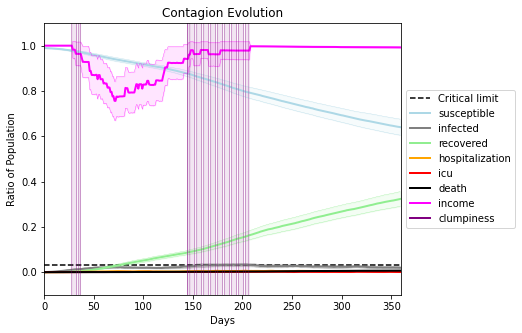

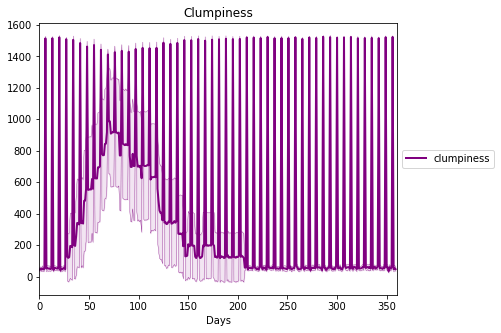

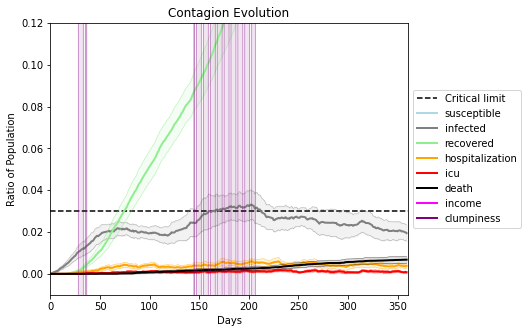

In [28]:
import logging
def setLevel(level):
    logger1 = logging.getLogger()
    logger1.setLevel(level)
params.params['temperature'] = 1
params.params['num_communities'] = 100
seeds = [9675]
setLevel(logging.CRITICAL)
multiple_runs(params,population_size,simulation_cycles,num_runs= 20,fname = "duong10000-1", 
              do_print = True, 
              home_grid_height = 10, home_grid_width = 10, school_home_list = 
             [
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0)],
[(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9)],
[(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5)],
[(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],work_home_list = 
             
[
[(0,0),(0,1),(0,2),(0,3),(0,4),
(1,0),(1,1),(1,2),(1,3),(1,4),
(2,0),(2,1),(2,2),(2,3),(2,4),
(3,0),(3,1),
(4,0),(4,1),
(5,0),(5,1),
(6,0),(6,1),
(7,0),(7,1),
(8,0),(8,1),
(9,0),
(0,5),(0,6),(0,7),(0,8),(0,9),
(1,5),(1,6),(1,7),(1,8),(1,9),
(2,5),(2,6),(2,7),(2,8),(2,9),
(3,9),
(4,9),
(5,6),(5,7),(5,8),(5,9),
(6,6),(6,7),(6,8),(6,9),
(3,2),(3,3),(3,4),(3,5),(3,6),(3,7),(3,8),
(4,2),(4,3),(4,4),(4,5),(4,6),(4,7),(4,8),
(5,2),(5,3),(5,4),(5,5),
(6,2),(6,3),(6,4),(6,5),
(7,2),(7,3),(7,4),(7,5),(7,6),(7,7),(7,8),(7,9),
(8,2),(8,3),(8,4),(8,5),(8,6),(8,7),(8,8),(8,9),
(9,1),(9,2),(9,3),(9,4),(9,5),(9,6),(9,7),(9,8),(9,9)]
],listeners = listeners)